# Separate GS Inversion

In [1]:
%matplotlib inline
from IPython import display
from utils import *
import io_utils as io
import vis_utils as vis
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd
from scipy.stats import beta, expon, truncnorm, norm, uniform
from scipy.sparse.linalg import lsqr
from scipy.optimize import minimize
from time import process_time
from functools import reduce
from pandas import ExcelWriter
from pandas import ExcelFile
import xlrd
import re
import copy
from matplotlib import cm

pd.options.display.float_format = '{:,g}'.format
plt.style.use(['ggplot'])

In [2]:
filename = "./data/colima/colima_real_data.csv"

raw_df, grid = io.import_colima(filename)

grid.to_csv("data/colima/colima_grid.csv", sep=" ", header=False, index=False)

display.display(raw_df)

,Sample no.,Easting,Northing,MassArea,Thickness,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",radius
16,VF0004a,1499,1506,625.8,60,19.2,31,18,11,6,2,1,0.6,0.9,"2,124.86"
18,VF0006a3,1957,1997,417.2,40,6.7,30,25,17,11,5,1,0.8,0.8,"2,796.04"
17,VF0005a3,1787,2173,500.64,48,10.1,30,24,16,9,3,1,0.7,1,"2,813.41"
37,VF0603509,-770,3082,594.51,57,11.3,25,25,19,11,4,1,0.6,0.5,"3,176.73"
31,VF0508a3,-1673,3152,125.16,12,10,22,24,16,10,4,2,0.8,0.8,"3,568.48"
36,VF0518a3,-637,4876,166.88,16,3.1,21,25,22,16,7,2,0.9,0.8,"4,917.43"
35,VF0517a,-1268,5048,125.16,12,9.8,14,17,20,17,10,4,2.1,1.8,"5,204.82"
34,VF0516a3,-2101,5517,93.87,9,4.1,15,19,19,19,12,4,2.6,2.8,"5,903.52"
33,VF0514a3,-2250,5771,62.58,6,0.1,9,13,19,21,14,7,4.6,5.6,"6,194.11"
32,VF0513a,-2272,5925,62.58,6,4.2,9,17,19,17,11,8,5.5,4.2,"6,345.68"


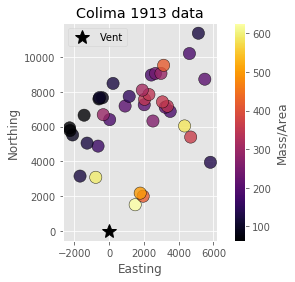

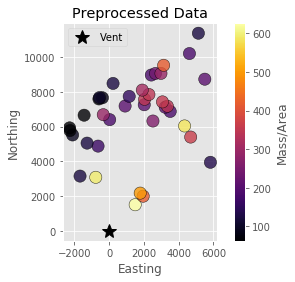

In [3]:
vis.plot_sample(raw_df, vent=(0,0), log=False, title="Colima 1913 data", cbar_label="Mass/Area")
plt.show()
# plt.savefig("colima/all_points.png", dpi=200, format='png')

obs_df = raw_df.copy()

# obs_df = obs_df.drop([16, 18, 17, 37, 31])
#This is going to be 100 across. Just needs to be the same as the other dfs. 
obs_df["Residual"] = obs_df["MassArea"]/obs_df["MassArea"]*100

vis.plot_sample(obs_df, vent=(0,0), log=False, title="Preprocessed Data", cbar_label="Mass/Area")
# plt.savefig("colima/All_trans.png", dpi=200, format='png')
plt.show()

In [4]:
t2_const_df, _, _, _ = io.read_tephra2("data/colima/colima_tephra2_const_wind_sim_data.txt")

t2_const_df["Residual"] = t2_const_df["MassArea"]/obs_df["MassArea"]

display.display(t2_const_df.head())

,Easting,Northing,Elevation,MassArea,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",radius,Residual
16,1499,1506,2500,"1,394.46",17.2005,24.2121,24.7779,18.9162,10.8457,3.58293,0.449327,0.015328,2.84769e-05,"2,124.86",2.22828
18,1957,1997,2500,"1,216.15",14.016,22.3619,24.864,20.2838,12.7356,4.93885,0.76913,0.0307052,6.30498e-05,"2,796.04",2.91503
17,1787,2173,2500,"1,251",13.877,22.2837,24.8861,20.3522,12.8046,4.98427,0.780754,0.0313104,6.44789e-05,"2,813.41",2.4988
37,-770,3082,2500,359.399,14.8025,22.8299,24.5313,19.4545,12.2828,5.13528,0.922533,0.0410962,9.09858e-05,"3,176.73",0.60453
31,-1673,3152,2500,134.301,15.3664,23.3283,24.4813,18.8191,11.7036,5.16746,1.07907,0.054478,0.000131905,"3,568.48",1.07303


In [5]:
config = io.read_tephra2_config("data/colima/colima_config.txt")

globs = {
    "LITHIC_DIAMETER_THRESHOLD": 7.,
    "PUMICE_DIAMETER_THRESHOLD": -1.,
    "AIR_VISCOSITY": 0.000018325,
    "AIR_DENSITY":  1.293,
    "GRAVITY": 9.81,
}






# Update parameters
# COL STEPS need to be small enough so the 
# layer height can be kept for an inversion with a high H
config["COL_STEPS"] = 20
theoretical_max = 45000 #The H value will be as close as possible to this
layer_thickness = ((config["PLUME_HEIGHT"]-config["VENT_ELEVATION"])/config["COL_STEPS"])

inversion_steps = np.round((config["COL_STEPS"]*(theoretical_max - config["VENT_ELEVATION"]))/\
                  (config["PLUME_HEIGHT"]-config["VENT_ELEVATION"]))
closest_H = ((inversion_steps*(config["PLUME_HEIGHT"] - config["VENT_ELEVATION"]))/\
             config["COL_STEPS"]) + config["VENT_ELEVATION"]
print("This number needs to be low enough to invert efficiently:")
print(inversion_steps)
print("If not, decrease COL_STEPS or theoretical max")
print("Closest Possible Theoretical Max Column Height:")
print(closest_H)

config["INV_STEPS"] = int(inversion_steps)
config["THEO_MAX_COL"] = closest_H
config["PART_STEPS"] = 9

config["MAX_GRAINSIZE"] = -5
config["MIN_GRAINSIZE"] = 4

# Additional parameter: Constant wind speed
config["WIND_SPEED"] = 10

# To ensure monotonicity:
# config["DIFFUSION_COEFFICIENT"] = 1.7*config["FALL_TIME_THRESHOLD"]

print("INPUT PARAMETERS:")
display.display(config)
display.display(globs)

This number needs to be low enough to invert efficiently:
40.0
If not, decrease COL_STEPS or theoretical max
Closest Possible Theoretical Max Column Height:
44915.0
INPUT PARAMETERS:


{'VENT_EASTING': 0.0,
 'VENT_NORTHING': 0.0,
 'VENT_ELEVATION': 3085.0,
 'PLUME_HEIGHT': 24000.0,
 'ALPHA': 1.02,
 'BETA': 1.56,
 'ERUPTION_MASS': 55000000000.0,
 'MAX_GRAINSIZE': -5,
 'MIN_GRAINSIZE': 4,
 'MEDIAN_GRAINSIZE': -1.8,
 'STD_GRAINSIZE': 2.4,
 'EDDY_CONST': 0.04,
 'DIFFUSION_COEFFICIENT': 4016.0,
 'FALL_TIME_THRESHOLD': 6458.0,
 'LITHIC_DENSITY': 2700.0,
 'PUMICE_DENSITY': 1024.0,
 'COL_STEPS': 20,
 'PART_STEPS': 9,
 'PLUME_MODEL': 2.0,
 'INV_STEPS': 40,
 'THEO_MAX_COL': 44915.0,
 'WIND_SPEED': 10}

{'LITHIC_DIAMETER_THRESHOLD': 7.0,
 'PUMICE_DIAMETER_THRESHOLD': -1.0,
 'AIR_VISCOSITY': 1.8325e-05,
 'AIR_DENSITY': 1.293,
 'GRAVITY': 9.81}

,centroid,density,interval,lower,probability,upper
0,-4.5,"1,024","[-5,-4)",-5,0.0683375,-4
1,-3.5,"1,024","[-4,-3)",-4,0.109203,-3
2,-2.5,"1,024","[-3,-2)",-3,0.146694,-2
3,-1.5,"1,024","[-2,-1)",-2,0.16565,-1
4,-0.5,"1,024","[-1,0)",-1,0.157243,0
5,0.5,"1,233.5","[0,1)",0,0.125474,1
6,1.5,"1,443","[1,2)",1,0.0841661,2
7,2.5,"1,652.5","[2,3)",2,0.0474595,3
8,3.5,"1,862","[3,4)",3,0.0224962,4


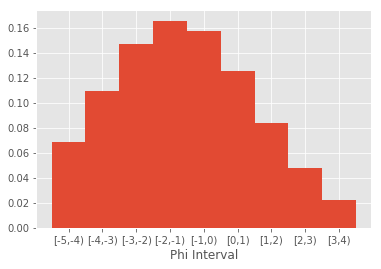

In [6]:
theo_phi_steps = get_phi_steps(config["MIN_GRAINSIZE"], config["MAX_GRAINSIZE"], 
                          config["PART_STEPS"], 
                          config["MEDIAN_GRAINSIZE"], config["STD_GRAINSIZE"],
                          globs["LITHIC_DIAMETER_THRESHOLD"], 
                          globs["PUMICE_DIAMETER_THRESHOLD"], 
                          config["LITHIC_DENSITY"], config["PUMICE_DENSITY"])
step_width = (config["MAX_GRAINSIZE"] - config["MIN_GRAINSIZE"])/config["PART_STEPS"]

display.display(pd.DataFrame(theo_phi_steps))



probs = [phi["probability"].copy() for phi in theo_phi_steps]
x = [phi["centroid"] for phi in theo_phi_steps]
labels = [phi["interval"] for phi in theo_phi_steps]
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, probs, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels)
plt.xlabel("Phi Interval")
plt.show()

[0.05231643 0.16945065 0.20390996 0.20809308 0.19893822 0.12429353
 0.02893896 0.00704844 0.00701073]
[-4.5, -3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


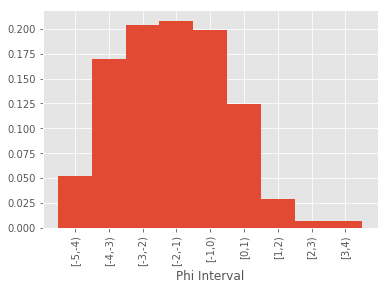

[{'lower': -5, 'upper': -4.0, 'interval': '[-5,-4)', 'centroid': -4.5, 'density': 1024.0, 'probability': 0.052316431318540024}, {'lower': -4.0, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.1694506511837887}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.20390996005463202}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.2080930801364657}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.19893821897376404}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.12429352702169855}, {'lower': 1.0, 'upper': 2.0, 'interval': '[1,2)', 'centroid': 1.5, 'density': 1443.0, 'probability': 0.028938961877603735}, {'lower': 2.0, 'upper': 3.0, 'interval': '[2,3)', 'centroid': 2.5, 'density': 1652.5, 'probability': 0.00704844304499

In [7]:
naive_tgsd = get_tgsd(obs_df, theo_phi_steps)
print(naive_tgsd)
print(x)
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, naive_tgsd, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=90)
plt.xlabel("Phi Interval")
plt.show()

naive_phi_steps = theo_phi_steps.copy()
for i, phi in enumerate(naive_phi_steps):
    phi["probability"] = naive_tgsd[i]
print(naive_phi_steps)

In [8]:

grid = obs_df[["Easting", "Northing"]]
wind_angle = np.radians(55)

u = config["WIND_SPEED"]*np.cos(wind_angle)
v = config["WIND_SPEED"]*np.sin(wind_angle)

forward_df = gaussian_stack_forward(
    grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
    config["PLUME_HEIGHT"], 2500, naive_phi_steps, (config["ALPHA"], config["BETA"]), 
    config["ERUPTION_MASS"], 
    (u,v), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
    config["FALL_TIME_THRESHOLD"]
)

forward_df["radius"] = np.sqrt(forward_df["Easting"]**2 + forward_df["Northing"]**2)
forward_df = forward_df.sort_values(by=['radius'])
forward_df["Residual"] = forward_df["MassArea"].values/obs_df["MassArea"].values
display.display(forward_df.head())

print(u, v)

,Northing,Easting,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",MassArea,radius,Residual
0,1506,1499,10.2913,29.5685,27.288,18.924,10.9616,2.84099,0.123803,0.001825,7.10812e-06,"1,678.84","2,124.86",2.68271
1,1997,1957,8.3142,27.1464,27.2807,20.2572,12.8676,3.91805,0.212099,0.00365928,1.57598e-05,"1,462.8","2,796.04",3.50624
2,2173,1787,8.22952,27.0446,27.2982,20.3207,12.9346,3.95335,0.215267,0.00373077,1.61147e-05,"1,504.98","2,813.41",3.00611
3,3082,-770,8.7488,27.7372,27.0418,19.5747,12.5223,4.11323,0.256923,0.00494637,2.29538e-05,428.027,"3,176.73",0.719966
4,3152,-1673,9.0285,28.313,27.0764,19.0615,12.0333,4.17711,0.303382,0.0066199,3.35645e-05,158.425,"3,568.48",1.26578


5.7357643635104605 8.191520442889917


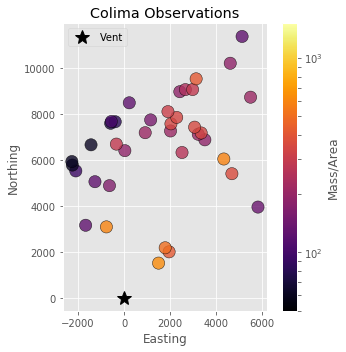

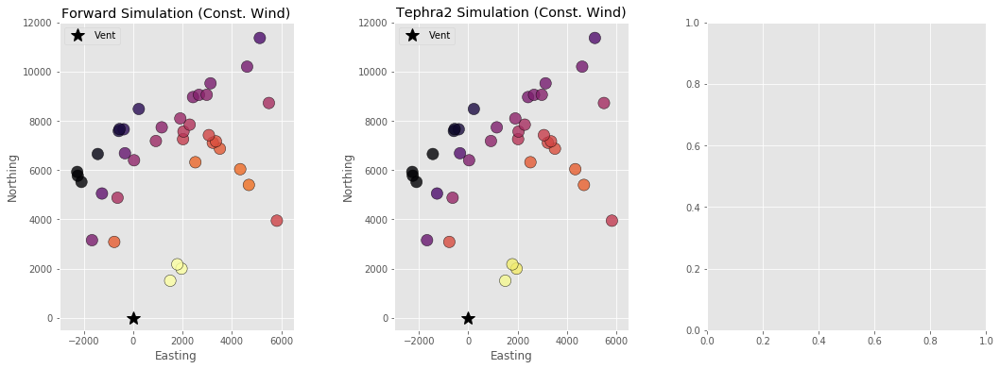

In [9]:

fig, ax = plt.subplots(1, 1, figsize=(5,5))

vis.plot_sample(obs_df, vent=(0,0), log=True, bounds=(50, 1500),
            title="Colima Observations", cbar_label="Mass/Area", ax = ax)
plt.tight_layout()
plt.show()


fig, axs = plt.subplots(1, 3, figsize=(
        18,6), facecolor='w', edgecolor='k')
axs = axs.ravel()

vis.plot_sample(forward_df, vent=(0,0), log=True, bounds=(50, 1500), show_cbar=False,
            title="Forward Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[0])
vis.plot_sample(t2_const_df, vent=(0,0), log=True, bounds=(50, 1500), show_cbar=False,
            title="Tephra2 Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[1])
# vis.plot_sample(t2_df, vent=(0,0), log=True, bounds=(50, 1500),
#             title="Tephra2 Simulation (NOAA Wind)", cbar_label="Mass/Area", ax=axs[2])
axs[0].set_xlim([-3000, 6500])
axs[0].set_ylim([-500, 12000])
axs[1].set_xlim([-3000, 6500])
axs[1].set_ylim([-500, 12000])
plt.show()




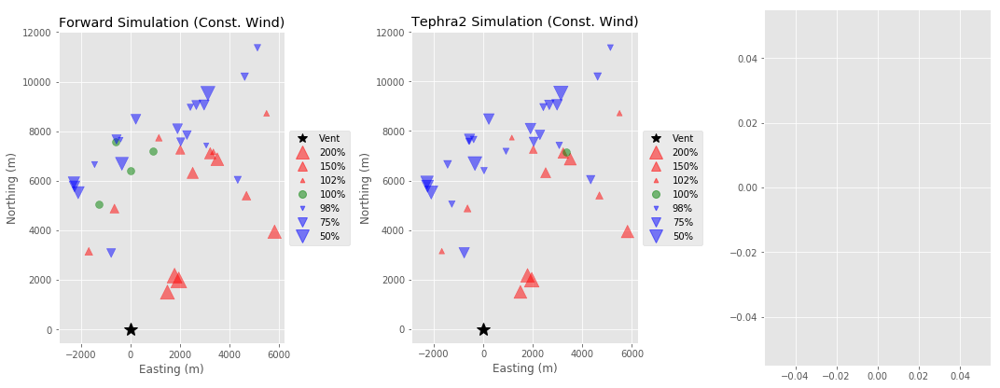

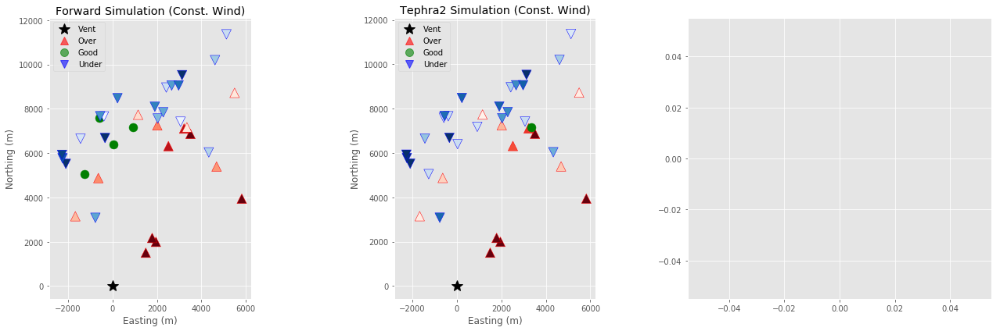

In [10]:
fig, axs = plt.subplots(1, 3, figsize=(
        15,6), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation (Const. Wind)", 
            plot_type = "size", ax=axs[0])
vis.plot_residuals(t2_const_df, vent=(0,0), values="Residual",
            title="Tephra2 Simulation (Const. Wind)", 
             plot_type = "size", ax=axs[1])
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation (NOAA Wind)", 
#              plot_type = "size", ax=axs[2])


plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(
        18,6), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation (Const. Wind)", 
            plot_type = "cmap", ax=axs[0], show_cbar = False)
vis.plot_residuals(t2_const_df, vent=(0,0), values="Residual",
            title="Tephra2 Simulation (Const. Wind)", 
             plot_type = "cmap", ax=axs[1], show_cbar = False)
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation (NOAA Wind)", 
#              plot_type = "cmap", ax=axs[2], show_cbar = True)


# plt.tight_layout()
plt.show()

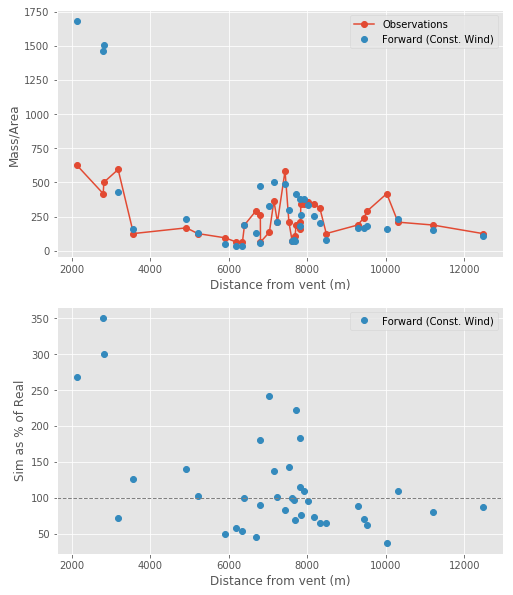

In [11]:
fig, axs = plt.subplots(2,1, figsize=(
        8,10), facecolor='w', edgecolor='k')
axs = axs.ravel()

axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C0o-', label="Observations")
# plt.plot(rotdf["radius"].values, rotdf["MassArea"].values, 'C1o-')
axs[0].plot(forward_df["radius"].values, forward_df["MassArea"].values, 'C1o', label="Forward (Const. Wind)")
# axs[0].plot(t2_const_df["radius"].values, t2_const_df["MassArea"].values, 'C2o', label="Tephra2 (Const. Wind)")
# axs[0].plot(t2_df["radius"].values, t2_df["MassArea"].values, 'C3o', label="Tephra2 (NOAA Wind)")
axs[0].legend()
axs[0].set_xlabel("Distance from vent (m)")
axs[0].set_ylabel("Mass/Area")

axs[1].plot(forward_df["radius"].values, forward_df["Residual"].values*100, 'C1o', label="Forward (Const. Wind)")
# axs[1].plot(t2_const_df["radius"].values, t2_const_df["Residual"].values*100, 'C2o', label="Tephra2 (Const. Wind)")
# axs[1].plot(t2_df["radius"].values, t2_df["Residual"].values*100, 'C3o', label="Tephra2 (NOAA Wind)")
axs[1].axhline(100, linestyle="--", lw=1, c="gray")
axs[1].legend()
axs[1].set_xlabel("Distance from vent (m)")
axs[1].set_ylabel("Sim as % of Real")
plt.show()

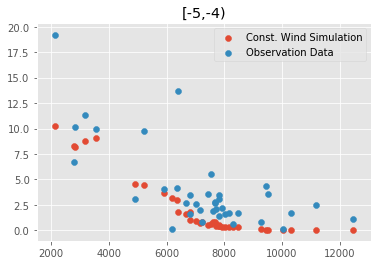

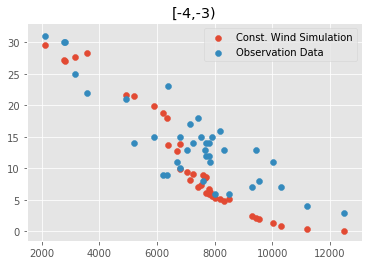

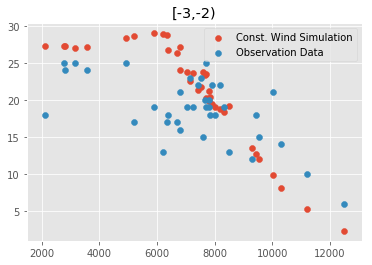

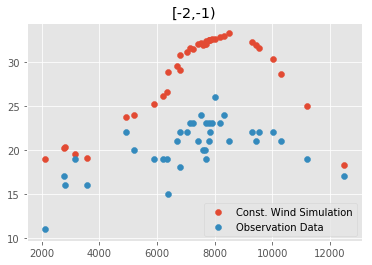

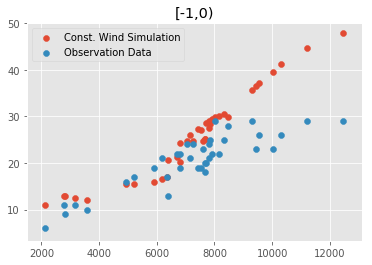

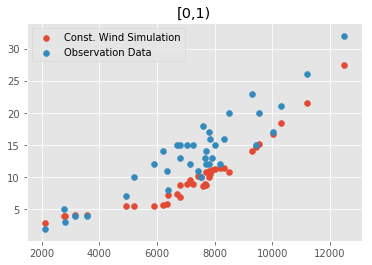

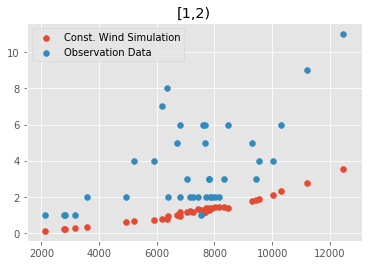

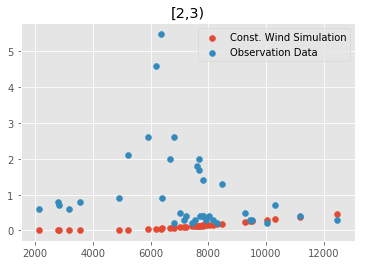

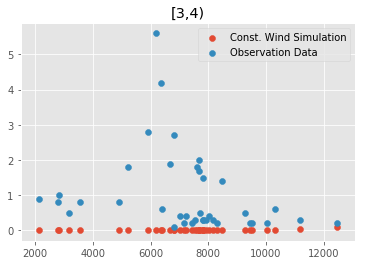

In [12]:
#TGSD calculation?
forward_tgsd = []
# t2_const_tgsd = []
# t2_tgsd = []
obs_tgsd = []
for phi_step in naive_phi_steps:
    plt.scatter(forward_df["radius"], forward_df[phi_step["interval"]], label="Const. Wind Simulation")
#     plt.scatter(t2_const_df["radius"], t2_const_df[phi_step["interval"]], label="T2 Const. Wind Simulation")
#     plt.scatter(t2_df["radius"], t2_df[phi_step["interval"]], label="T2 NOAA Wind Simulation")
    plt.scatter(obs_df["radius"], obs_df[phi_step["interval"]], label="Observation Data")
    plt.legend()
    plt.title(phi_step["interval"])
    plt.show()
    
    forward_tgsd += [forward_df[phi_step["interval"]].sum()/len(forward_df)]
#     t2_const_tgsd += [t2_const_df[phi_step["interval"]].sum()/len(t2_const_df)]
#     t2_tgsd += [t2_df[phi_step["interval"]].sum()/len(t2_df)]
    obs_tgsd += [obs_df[phi_step["interval"]].sum()/len(obs_df)]

In [13]:


def col_truncnorm(mean, top=config["THEO_MAX_COL"]):
    bottom = 5000
    std = (top - bottom)/4
    standard_a, standard_b = (bottom - mean) / std, (top - mean) / std
    return truncnorm.rvs(standard_a, standard_b, loc=mean, scale=std)

def lognorm(prior, bottom=0):
    std_norm = norm.rvs()
    std_lognorm = np.exp(std_norm)
    lognorm = bottom + (prior-bottom)*std_lognorm
    return lognorm

def normal(prior):
    std_norm = norm.rvs()
    normal = prior*std_norm
    return normal

def uninformed(bottom, top):
    unif = uniform.rvs(loc = bottom, scale = (top-bottom))
    return unif


In [14]:
full_inversion_priors = {
    "a": 1.79601,
    "b": 3.57674,
    "h1": 32213.2,
    "u": 7.09778,
    "v": 8.69934,
    "D": 14903.6,
    "ftt": 6458,
    "eta": 0,
    "zeta": 0
}

# phi_probs = [
#     0.058657896918929336,
#     0.15114329504320803,
#     0.15644352749157492,
#     0.15138125134809738,
#     0.17100876050061856,
#     0.1814490666782764,
#     0.06799943098150356,
#     0.01682410991463832,
#     0.045092661123153584
# ]

,invert,sample_function,value
a,True,<function uninformed at 0x00000289C1DF4378>,"[1.00001, 5]"
b,True,<function uninformed at 0x00000289C1DF4378>,"[1.0001, 5]"
h1,True,<function uninformed at 0x00000289C1DF4378>,"[10000, 44915.0]"
u,False,<function uninformed at 0x00000289C1DF4378>,"[7.09778, 10]"
v,False,<function uninformed at 0x00000289C1DF4378>,"[8.69934, 10]"
D,False,<function uninformed at 0x00000289C1DF4378>,"[14903.6, 6000]"
ftt,False,<function uninformed at 0x00000289C1DF4378>,"[6458.0, 10000]"
eta,False,<function uninformed at 0x00000289C1DF4378>,"[0, 0]"
zeta,False,<function uninformed at 0x00000289C1DF4378>,"[0, 0]"


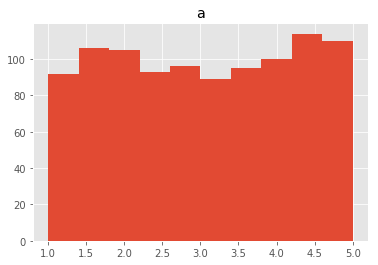

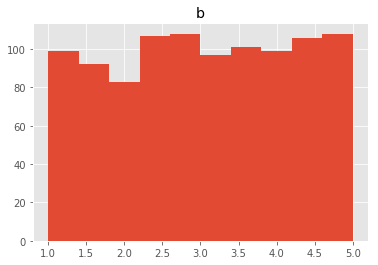

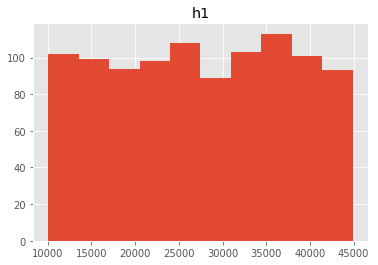

In [15]:
# param_config = {
#     "a": {
#         "value":[1.01, 5],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "b": {
#         "value":[1.01, 5],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "h1": {
#         "value":[5000, config["THEO_MAX_COL"]],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "u": {
#         "value":[full_inversion_priors["u"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "v": {
#         "value":[full_inversion_priors["v"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "D": {
#         "value":[full_inversion_priors["D"], 6000],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "ftt": {
#         "value":[config["FALL_TIME_THRESHOLD"], 10000],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "eta": {
#         "value":[full_inversion_priors["eta"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "zeta": {
#         "value":[0, 0],
#         "invert":False,
#         "sample_function": uninformed
#     },
# }


param_config = {
    "a": {
        "value":[1.00001, 5],
        "invert":True,
        "sample_function": uninformed
    },
    "b": {
        "value":[1.0001, 5],
        "invert":True,
        "sample_function": uninformed
    },
    "h1": {
        "value":[10000, config["THEO_MAX_COL"]],
        "invert":True,
        "sample_function": uninformed
    },
    "u": {
        "value":[full_inversion_priors["u"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "v": {
        "value":[full_inversion_priors["v"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "D": {
        "value":[full_inversion_priors["D"], 6000],
        "invert":False,
        "sample_function": uninformed
    },
    "ftt": {
        "value":[config["FALL_TIME_THRESHOLD"], 10000],
        "invert":False,
        "sample_function": uninformed
    },
    "eta": {
        "value":[0, 0],
        "invert":False,
        "sample_function": uninformed
    },
    "zeta": {
        "value":[0, 0],
        "invert":False,
        "sample_function": uninformed
    },
}

param_config_df = pd.DataFrame(param_config)
display.display(param_config_df.T)

for key, val in param_config.items():
    if val["invert"] == True:
        x = [val["sample_function"](*val["value"]) for i in range(1000)]
        plt.hist(x)
        plt.title(key)
        plt.show()



========[-5,-4)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.28e+02 	4.77e+02 	0.9039 		1.0000


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


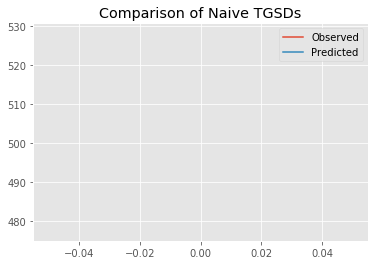

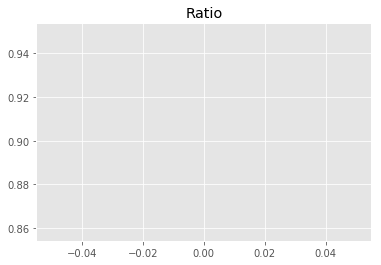

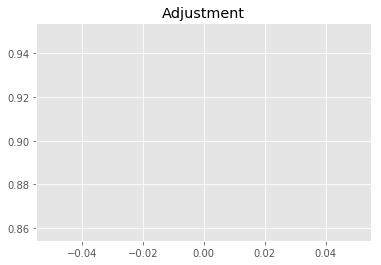

2600976283.538251
1


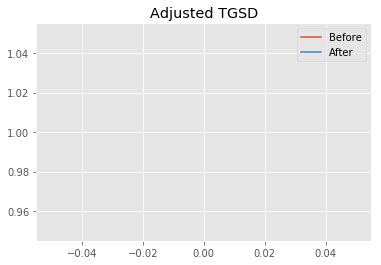

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.11786 	3.35873 	37815.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.14088 	4.32839 	25850.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.7548
New Misfit: 11.9844
Convergence:
0.12870863647315797

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.57e+02 	4.77e+02 	1.0451 		1.0000


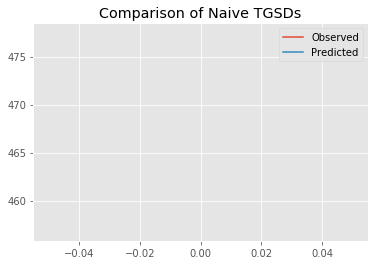

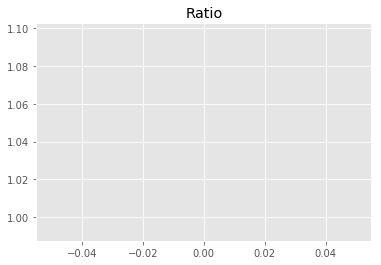

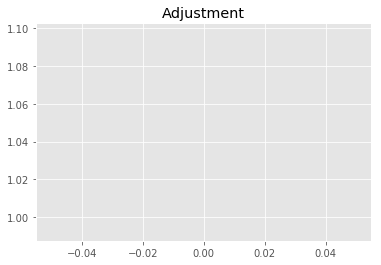

3007053757.075772
1


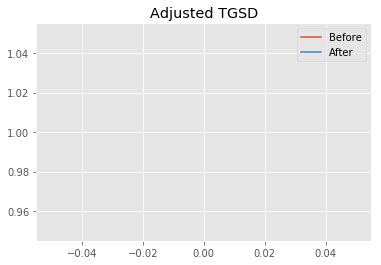

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.14088 	4.32839 	25850.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.29321 	7.63543 	44170.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.9844
New Misfit: 11.4752
Convergence:
0.04249484852185113

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.25e+02 	4.77e+02 	1.1226 		1.0000


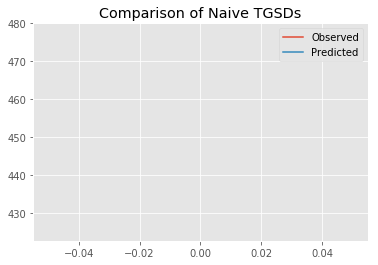

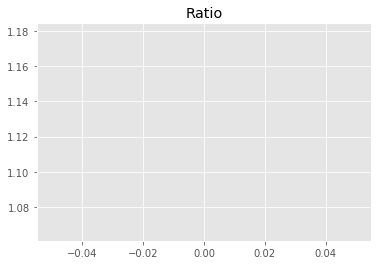

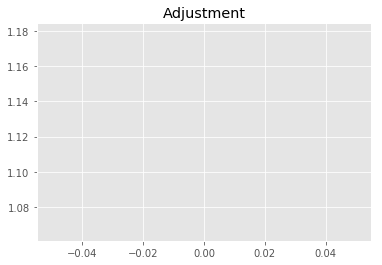

3230152795.114081
1


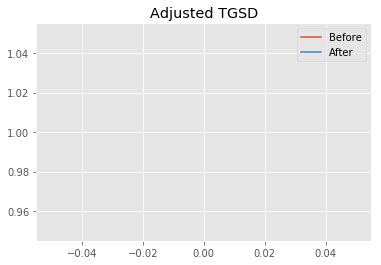

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.29321 	7.63543 	44170.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.01895 	5.24605 	42625.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.4752
New Misfit: 11.2964
Convergence:
0.015580144096801533

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.35e+02 	4.77e+02 	1.0975 		1.0000


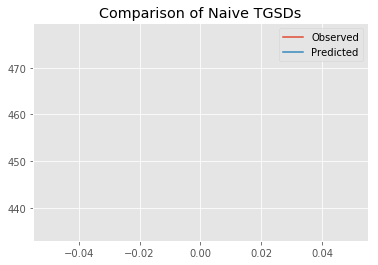

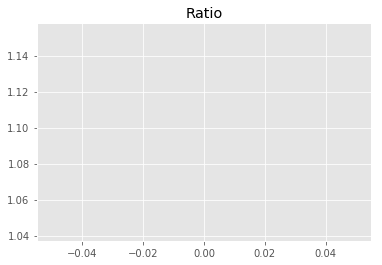

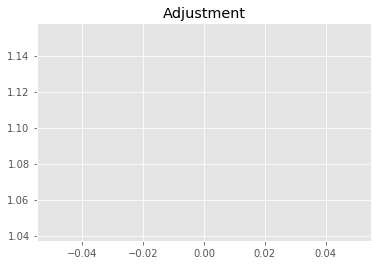

3157905470.2308064
1


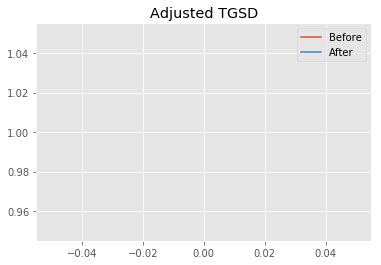

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01895 	5.24605 	42625.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.52901 	44912.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2964
New Misfit: 11.2769
Convergence:
0.0017225372472781456

____________________
a = 1.00000	b = 5.52901	            h1 = 44912.28360	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.276920222373644
Prior Misfit: 250.91,	 Post Misfit: 11.2769


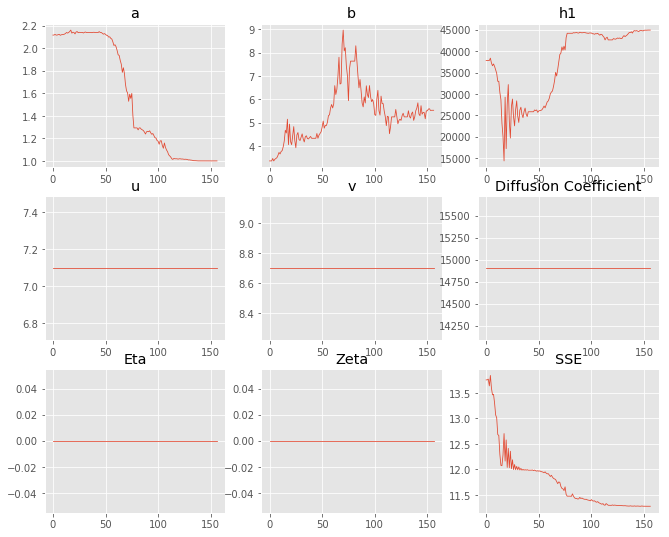

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.11786,1
b,3.35873,5.52901
eta,0,0
ftt,"6,458","6,458"
h1,"37,815.3","44,912.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 1 Time: 0.093 minutes


Estimated remaining run time: 0.834 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.64e+02 	4.77e+02 	0.8460 		1.0000


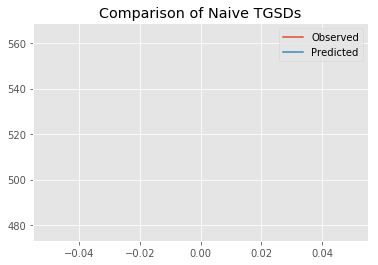

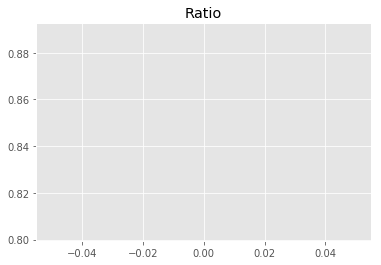

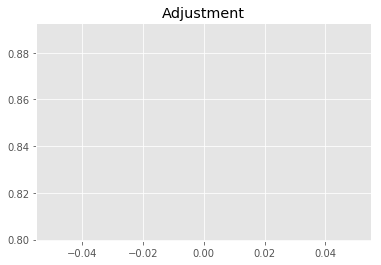

2434371708.2216134
1


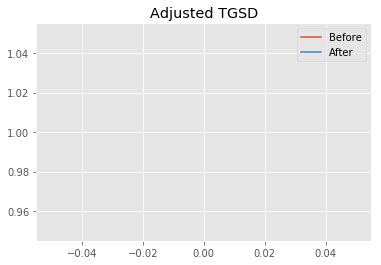

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.04353 	4.91118 	39971.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.83126 	8.24646 	42361.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.0378
New Misfit: 11.7058
Convergence:
0.27010938381772626

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.46e+02 	4.77e+02 	1.0698 		1.0000


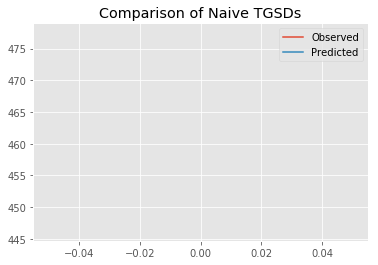

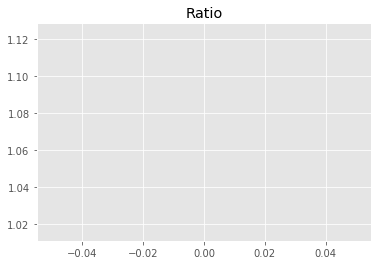

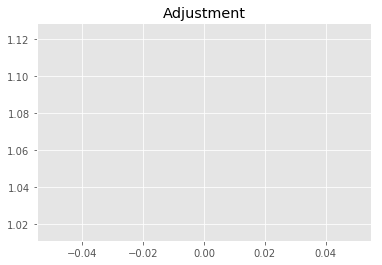

3078359368.4307675
1


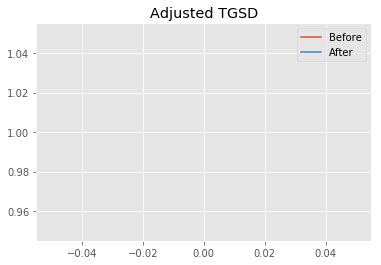

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.83126 	8.24646 	42361.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.1061 	6.70419 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.7058
New Misfit: 11.3586
Convergence:
0.02966359911124784

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.26e+02 	4.77e+02 	1.1213 		1.0000


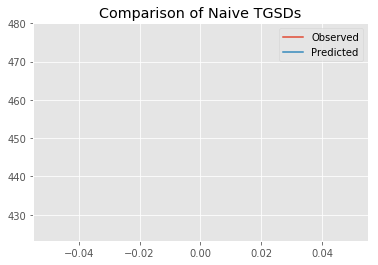

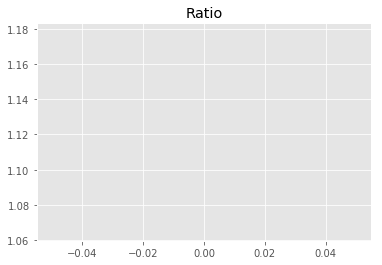

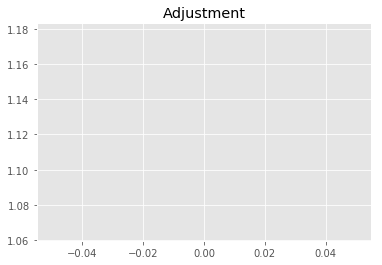

3226543992.2529435
1


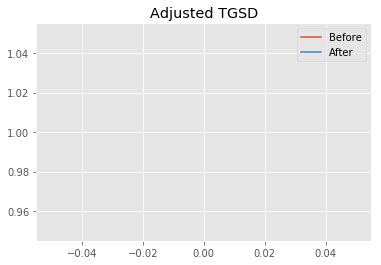

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.1061 	6.70419 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:473: RuntimeWarning: divide by zero encountered in double_scalars
  factor_a = (1/((a-1)*(b-1)*(H-h1)))


New Total Mass: 2.8774e+09
After: 		|1.00063 	5.55382 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3586
New Misfit: 11.2774
Convergence:
0.007151930808689358

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.34e+02 	4.77e+02 	1.0997 		1.0000


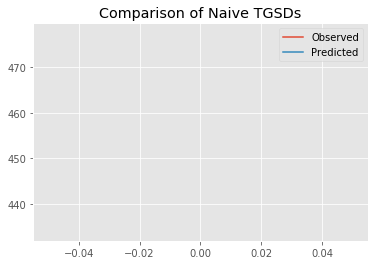

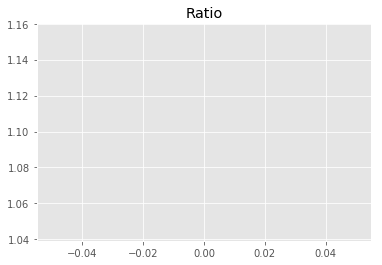

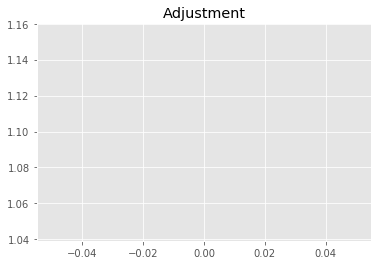

3164269104.027367
1


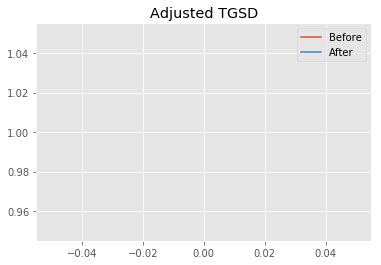

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00063 	5.55382 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:457: RuntimeWarning: divide by zero encountered in log
  h1_star = -np.log(-np.log(h1/H))
c:\users\nmostert\envs\spew\lib\site-packages\scipy\optimize\optimize.py:562: RuntimeWarning: invalid value encountered in subtract
  if (numpy.max(numpy.ravel(numpy.abs(sim[1:] - sim[0]))) <= xatol and
c:\users\nmostert\envs\spew\lib\site-packages\numpy\core\_methods.py:26: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims)
c:\users\nmostert\envs\spew\lib\site-packages\scipy\optimize\optimize.py:567: RuntimeWarning: invalid value encountered in subtract
  xr = (1 + rho) * xbar - rho * sim[-1]
C:\Users\nmostert\Documents\repos\inversion_project\utils.py:439: RuntimeWarning: invalid value encountered in less
  heights = z[(z>=z_min) & (z<h1)]
C:\Users\nmostert\Documents\repos\inversion_project\utils.py:444: RuntimeWarning: invalid value encountered in less
  plume[(z>=z_min) & (z<h1)] = 

New Total Mass: 2.8774e+09
After: 		|1.00043 	5.55382 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2774
New Misfit: 11.2773
Convergence:
9.224174738406352e-06

____________________
a = 1.00043	b = 5.55382	            h1 = 44915.00000	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.277254832339072
Prior Misfit: 352.248,	 Post Misfit: 11.2773


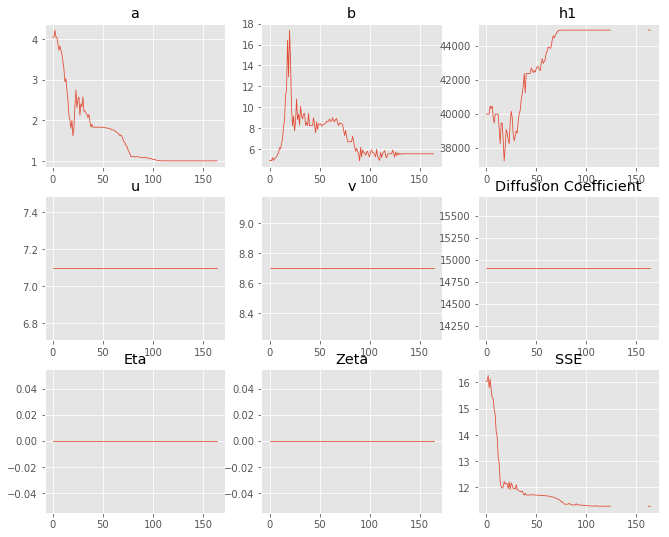

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.04353,1.00043
b,4.91118,5.55382
eta,0,0
ftt,"6,458","6,458"
h1,"39,971.8","44,915"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 2 Time: 0.089 minutes


Estimated remaining run time: 1.030 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.61e+02 	4.77e+02 	1.0346 		1.0000


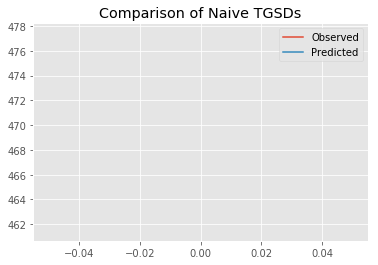

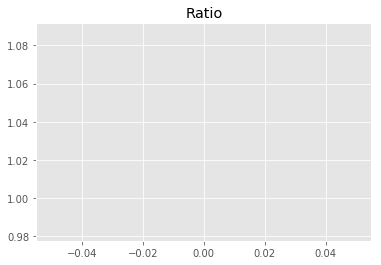

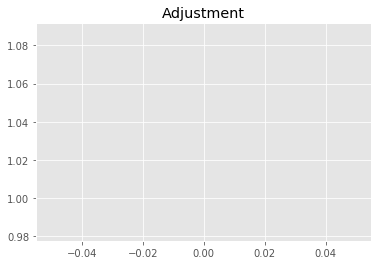

2976934922.577893
1


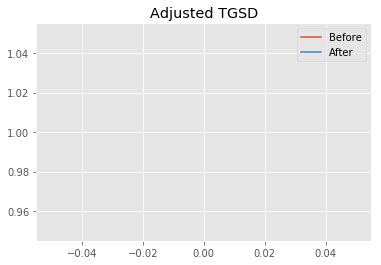

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.10736 	4.02912 	41485.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.01837 	4.41593 	38579.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.5008
New Misfit: 11.3176
Convergence:
0.01592898155940222

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.39e+02 	4.77e+02 	1.0872 		1.0000


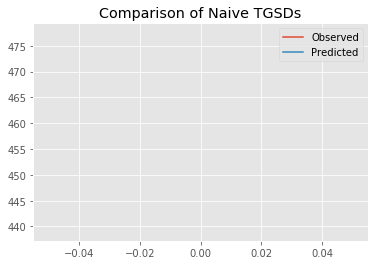

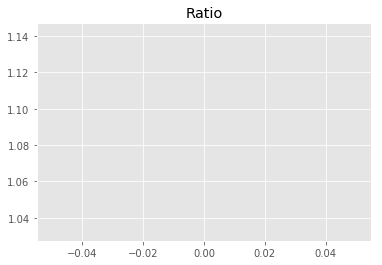

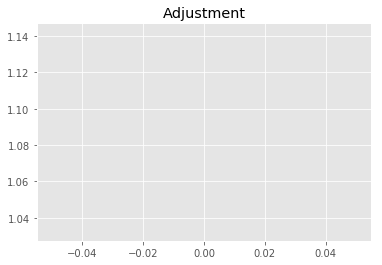

3128228305.970324
1


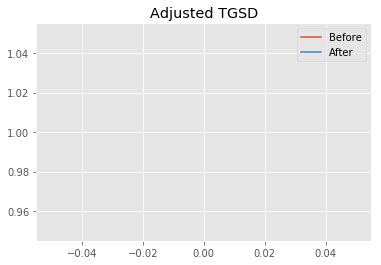

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01837 	4.41593 	38579.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.0005 	5.54229 	44352.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3176
New Misfit: 11.28
Convergence:
0.003316290055577884

____________________
a = 1.00050	b = 5.54229	            h1 = 44352.69308	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.28004959971143
Prior Misfit: 254.746,	 Post Misfit: 11.28


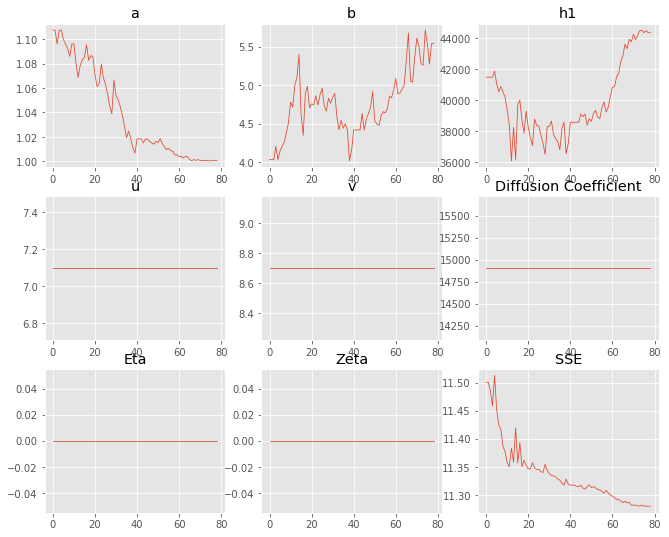

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.10736,1.0005
b,4.02912,5.54229
eta,0,0
ftt,"6,458","6,458"
h1,"41,485.8","44,352.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 3 Time: 0.049 minutes


Estimated remaining run time: 0.923 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.53e+02 	4.77e+02 	0.8632 		1.0000


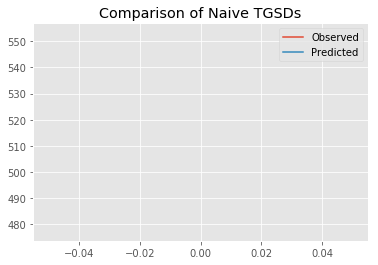

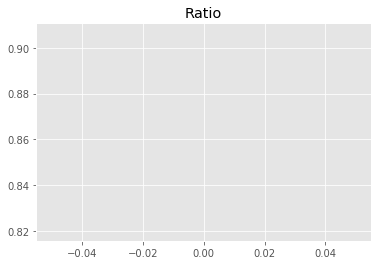

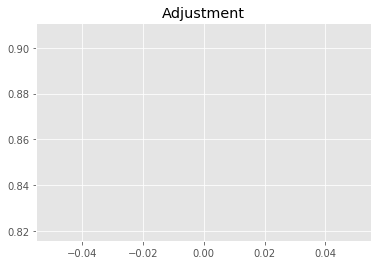

2483660298.7343206
1


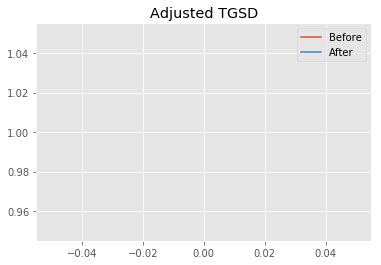

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.94329 	2.48987 	30438.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.41131 	2.92377 	21060.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.0801
New Misfit: 12.2383
Convergence:
0.1884436337056136

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.70e+02 	4.77e+02 	1.0166 		1.0000


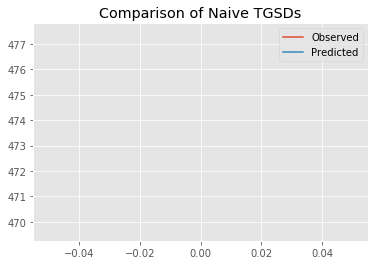

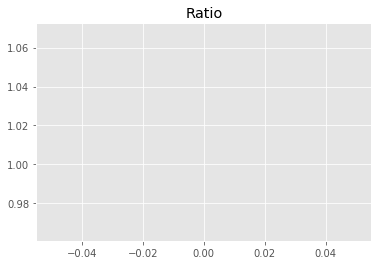

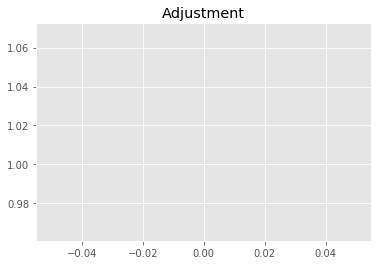

2925069495.480306
1


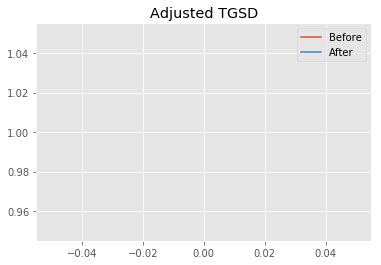

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.41131 	2.92377 	21060.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.10292 	4.70089 	38451.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.2383
New Misfit: 11.3648
Convergence:
0.07137996347009862

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.40e+02 	4.77e+02 	1.0856 		1.0000


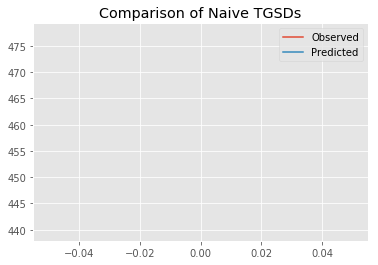

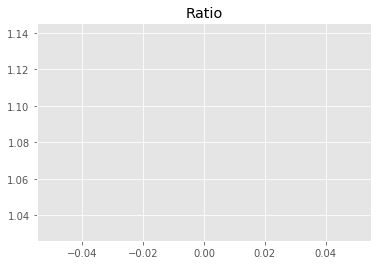

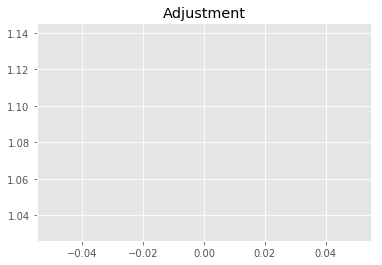

3123742678.360193
1


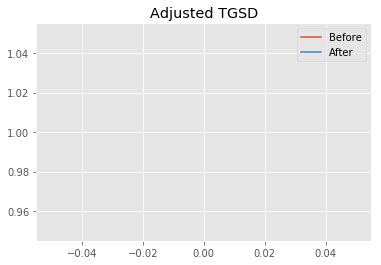

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.10292 	4.70089 	38451.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00143 	5.44929 	43954.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3648
New Misfit: 11.2817
Convergence:
0.007311085727767137

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.34e+02 	4.77e+02 	1.1011 		1.0000


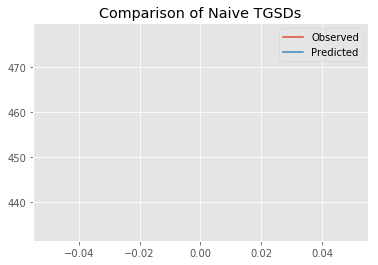

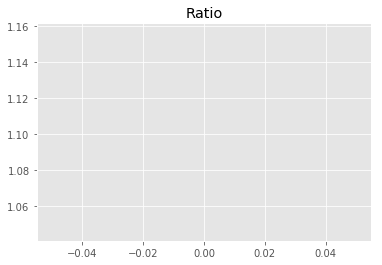

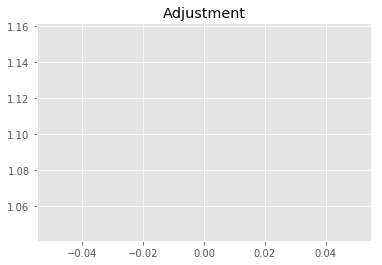

3168186285.1687746
1


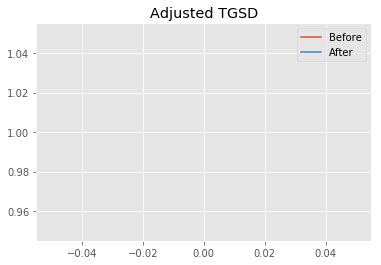

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00143 	5.44929 	43954.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00055 	5.45376 	44883.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2817
New Misfit: 11.2774
Convergence:
0.0003827368097666273

____________________
a = 1.00055	b = 5.45376	            h1 = 44883.35907	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.277360167183039
Prior Misfit: 303.601,	 Post Misfit: 11.2774


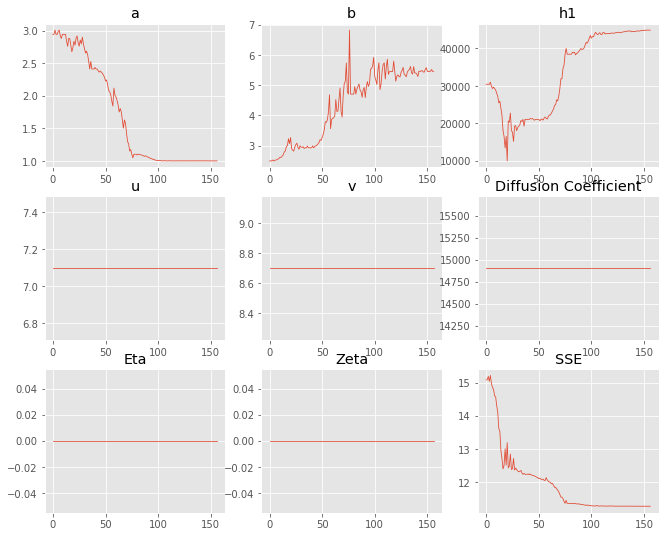

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.94329,1.00055
b,2.48987,5.45376
eta,0,0
ftt,"6,458","6,458"
h1,"30,438.8","44,883.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 4 Time: 0.084 minutes


Estimated remaining run time: 0.944 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.24e+02 	4.77e+02 	0.9106 		1.0000


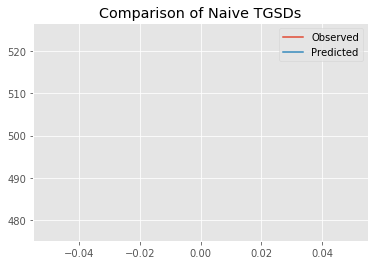

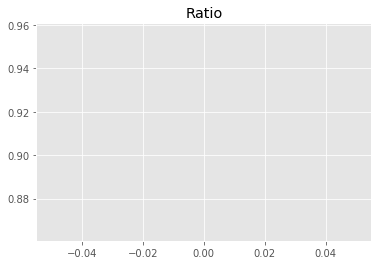

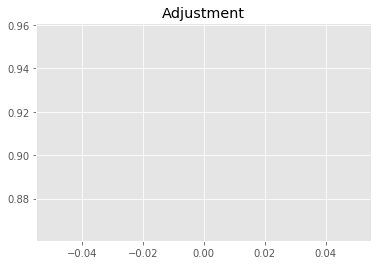

2620302971.5015907
1


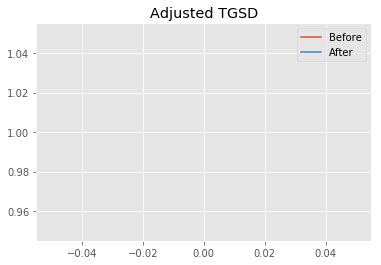

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.81799 	2.42641 	33417.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.78419 	2.69455 	21337.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.5267
New Misfit: 11.932
Convergence:
0.11789226015323695

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.53e+02 	4.77e+02 	1.0542 		1.0000


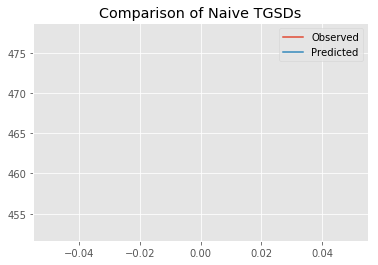

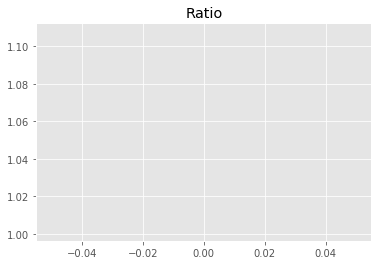

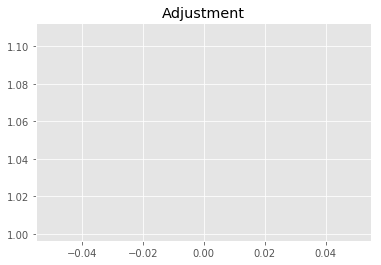

3033449886.793336
1


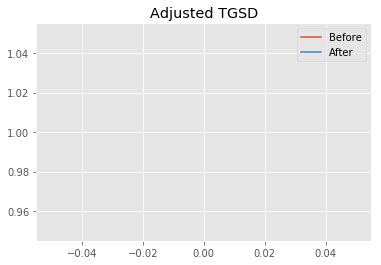

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.78419 	2.69455 	21337.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.26236 	3.98518 	28656.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.932
New Misfit: 11.5453
Convergence:
0.032412769877114535

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.31e+02 	4.77e+02 	1.1078 		1.0000


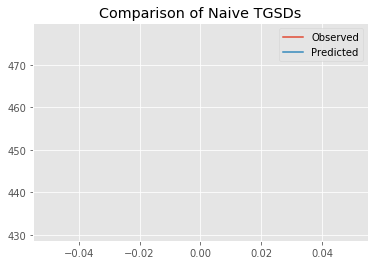

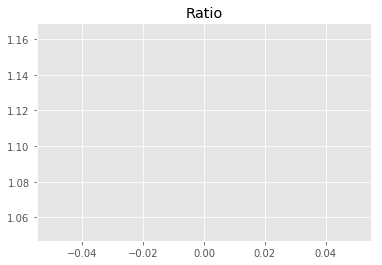

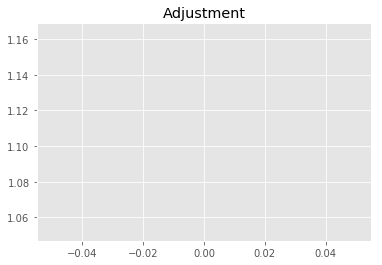

3187647119.4674397
1


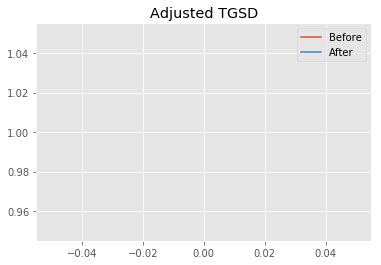

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.26236 	3.98518 	28656.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.02451 	3.69233 	33223.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.5453
New Misfit: 11.3546
Convergence:
0.016517157267494965

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.38e+02 	4.77e+02 	1.0888 		1.0000


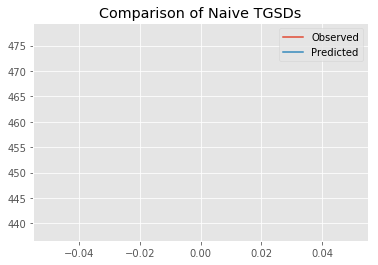

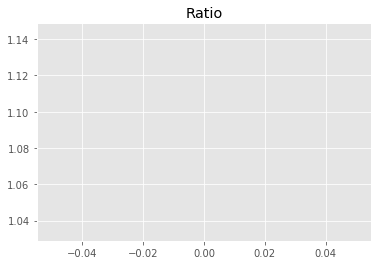

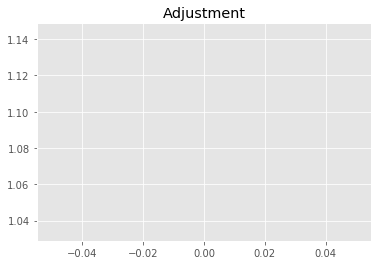

3132835936.585117
1


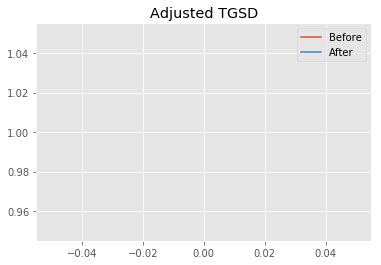

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02451 	3.69233 	33223.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.46047 	44060.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3546
New Misfit: 11.2805
Convergence:
0.006528413229190388

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.34e+02 	4.77e+02 	1.1012 		1.0000


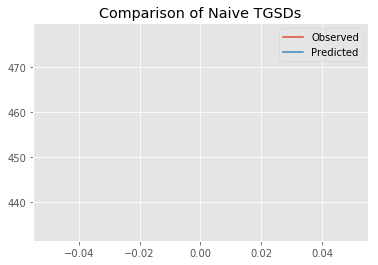

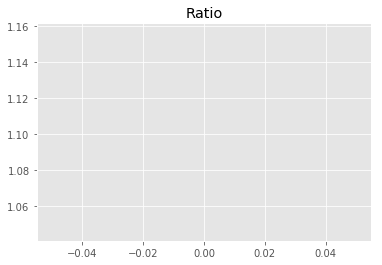

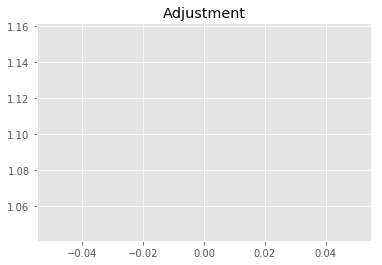

3168464157.8607883
1


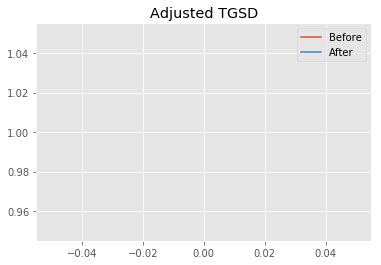

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	5.46047 	44060.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.44382 	44787.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2805
New Misfit: 11.2774
Convergence:
0.00027479121631605733

____________________
a = 1.00000	b = 5.44382	            h1 = 44787.48525	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 11.277375648438957
Prior Misfit: 244.399,	 Post Misfit: 11.2774


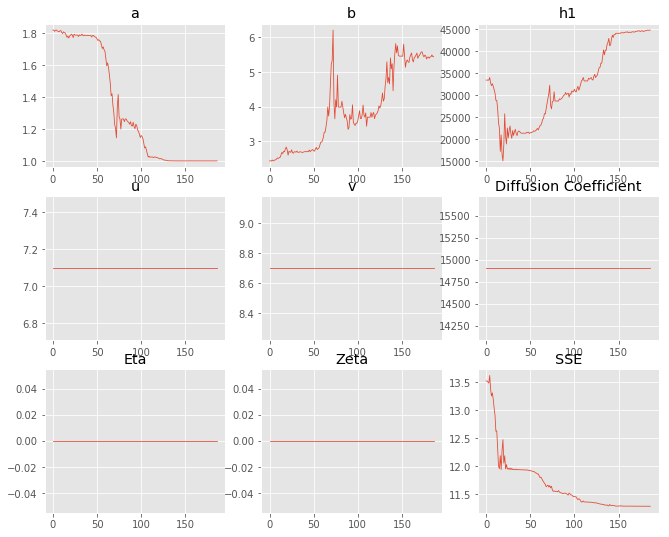

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.81799,1
b,2.42641,5.44382
eta,0,0
ftt,"6,458","6,458"
h1,"33,417.1","44,787.5"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 5 Time: 0.097 minutes


Estimated remaining run time: 0.961 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.68e+02 	4.77e+02 	0.8413 		1.0000


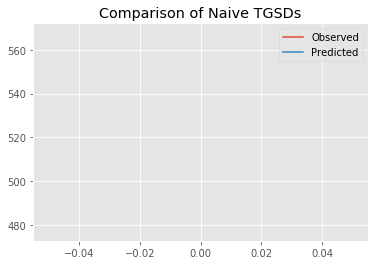

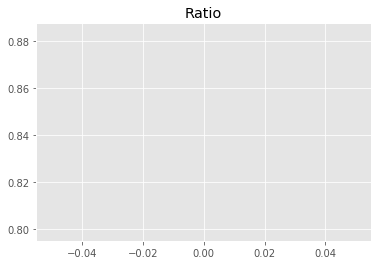

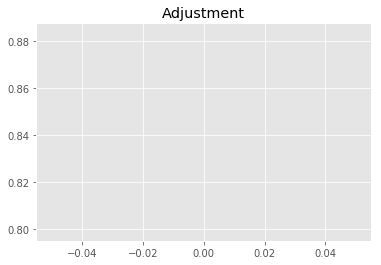

2420618894.4756985
1


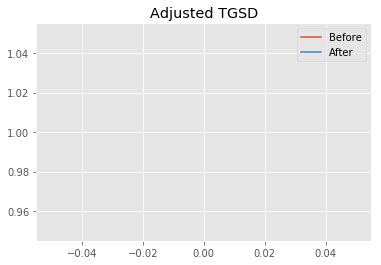

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.62572 	2.77912 	27678.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.02804 	4.35445 	36530.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.905
New Misfit: 11.3325
Convergence:
0.28748966147611743

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.35e+02 	4.77e+02 	1.0970 		1.0000


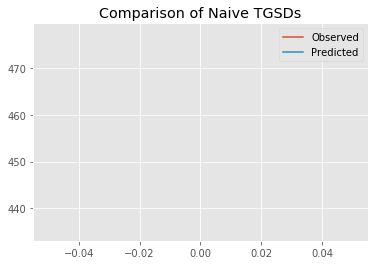

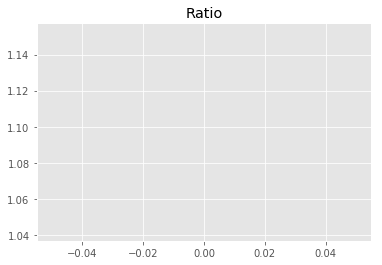

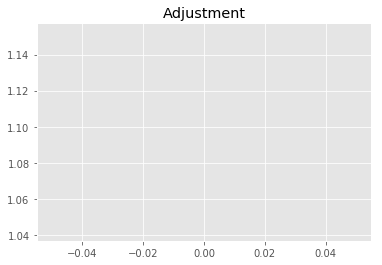

3156547063.40667
1


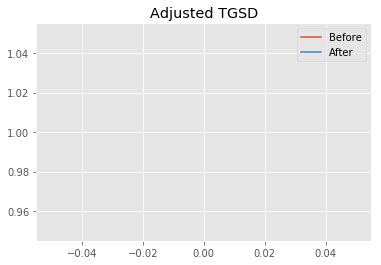

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02804 	4.35445 	36530.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00064 	5.18465 	42634 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3325
New Misfit: 11.2861
Convergence:
0.004094088742041756

____________________
a = 1.00064	b = 5.18465	            h1 = 42634.04334	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.286069601482163
Prior Misfit: 344.864,	 Post Misfit: 11.2861


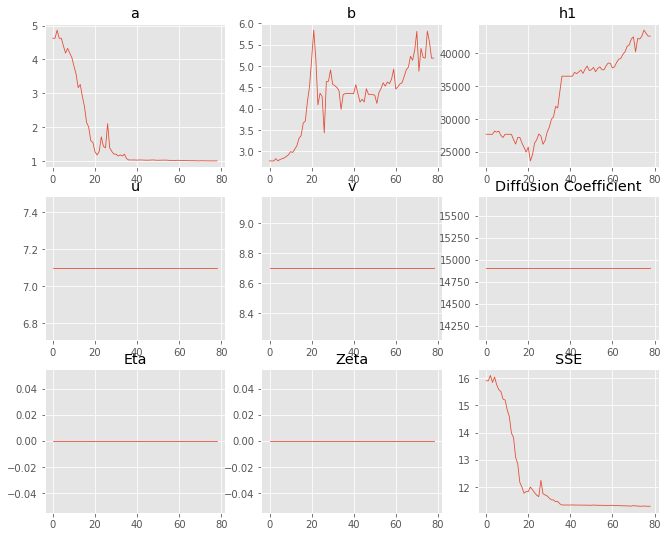

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.62572,1.00064
b,2.77912,5.18465
eta,0,0
ftt,"6,458","6,458"
h1,"27,678.2","42,634"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 6 Time: 0.048 minutes


Estimated remaining run time: 0.855 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.08e+02 	4.77e+02 	0.9407 		1.0000


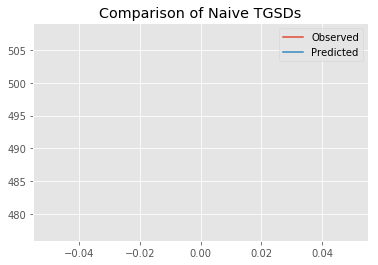

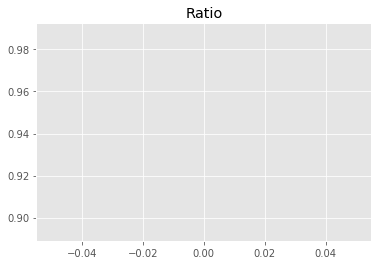

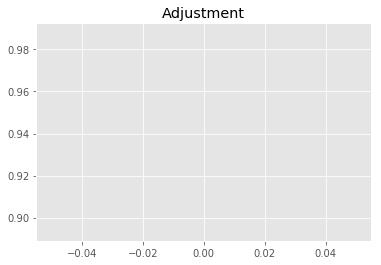

2706712612.107747
1


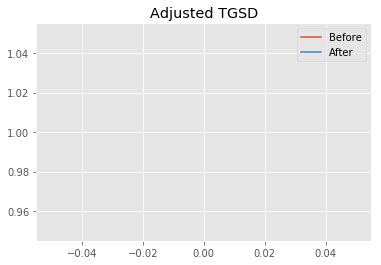

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.53718 	4.32395 	32466.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.14532 	7.83989 	34354.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.8627
New Misfit: 11.8995
Convergence:
0.07487754339467144

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.40e+02 	4.77e+02 	1.0838 		1.0000


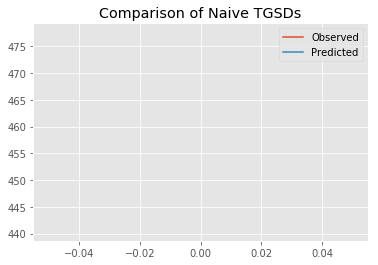

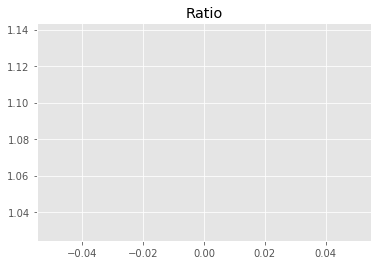

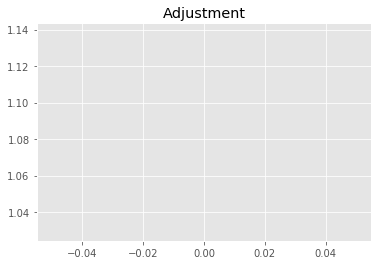

3118637504.6650825
1


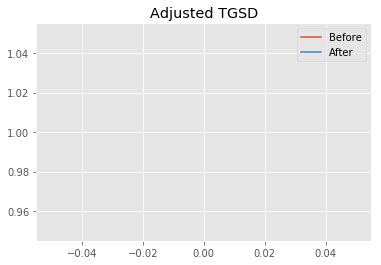

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.14532 	7.83989 	34354.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.66943 	9.09445 	44429.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.8995
New Misfit: 11.6459
Convergence:
0.02131604299144061

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.33e+02 	4.77e+02 	1.1023 		1.0000


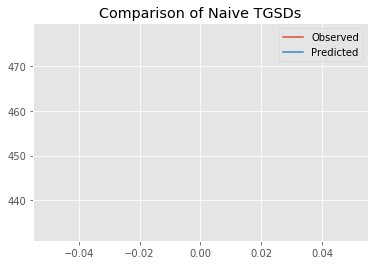

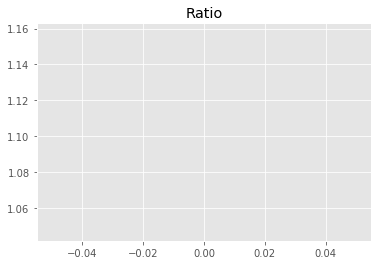

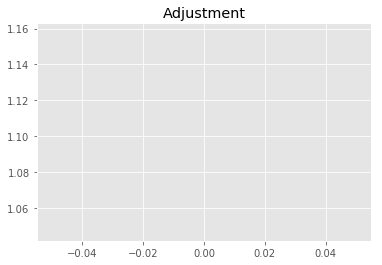

3171797685.736685
1


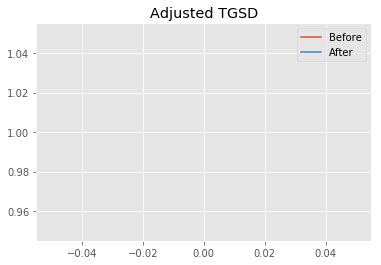

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.66943 	9.09445 	44429.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.37431 	6.36059 	41998.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.6459
New Misfit: 11.4903
Convergence:
0.013358246147723562

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.42e+02 	4.77e+02 	1.0807 		1.0000


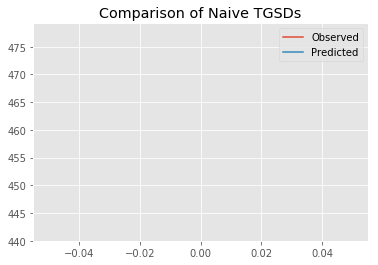

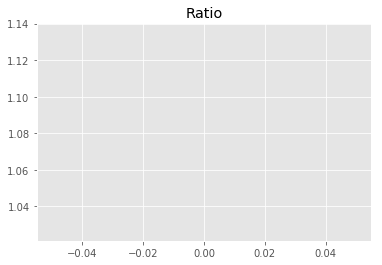

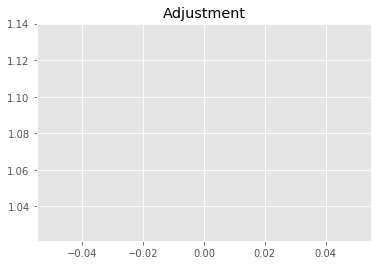

3109497454.1318936
1


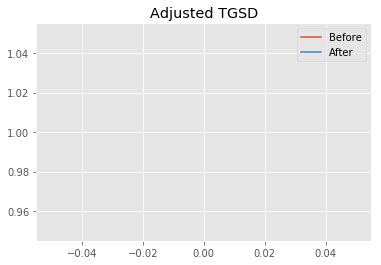

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.37431 	6.36059 	41998.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.01798 	4.22119 	36463.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.4903
New Misfit: 11.3272
Convergence:
0.01419164268283021

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.37e+02 	4.77e+02 	1.0928 		1.0000


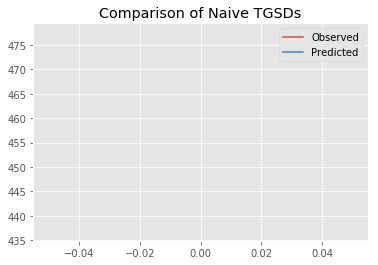

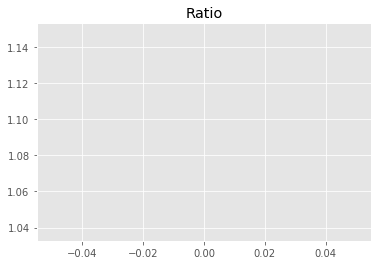

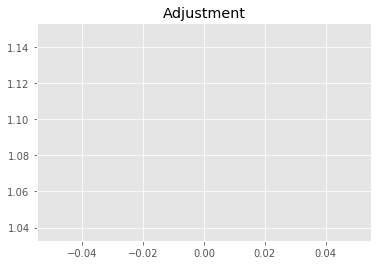

3144371892.271326
1


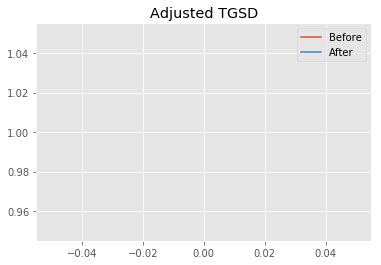

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01798 	4.22119 	36463.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00173 	5.18772 	42466.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3272
New Misfit: 11.2875
Convergence:
0.0035093589594643463

____________________
a = 1.00173	b = 5.18772	            h1 = 42466.61022	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 11.287496041432112
Prior Misfit: 242.914,	 Post Misfit: 11.2875


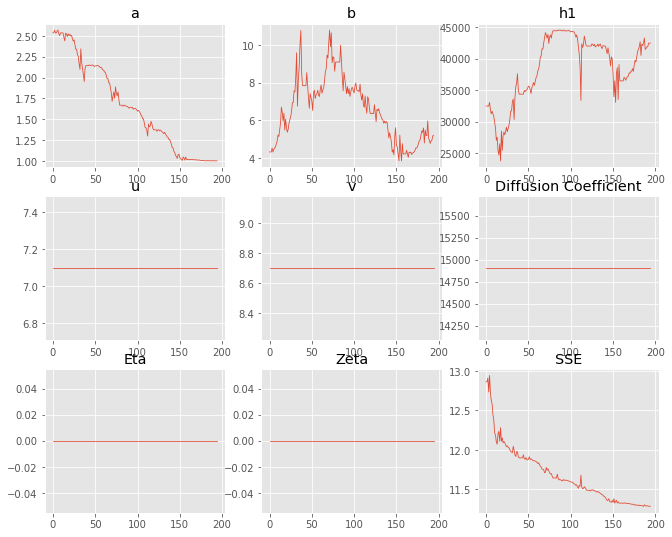

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.53718,1.00173
b,4.32395,5.18772
eta,0,0
ftt,"6,458","6,458"
h1,"32,466.5","42,466.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 7 Time: 0.104 minutes


Estimated remaining run time: 0.846 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.61e+02 	4.77e+02 	0.8512 		1.0000


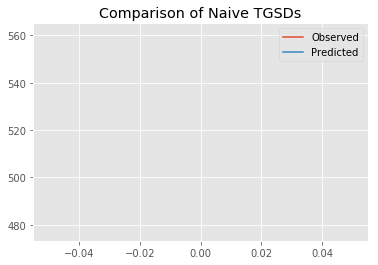

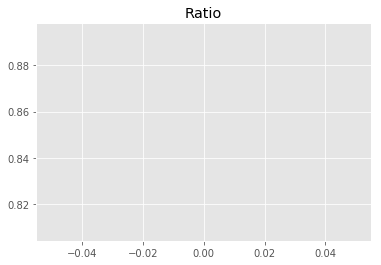

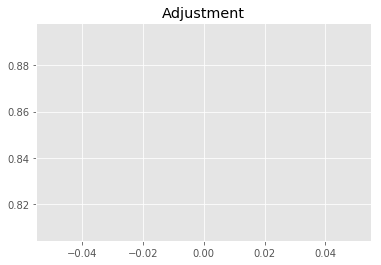

2449121559.981922
1


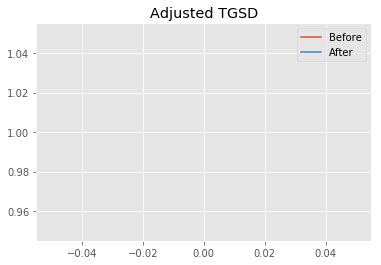

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.12064 	3.10032 	36263.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.26516 	6.26778 	40479.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.8433
New Misfit: 11.4513
Convergence:
0.2772137136688731

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.32e+02 	4.77e+02 	1.1064 		1.0000


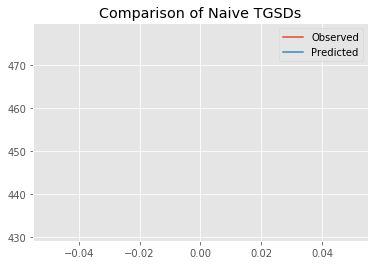

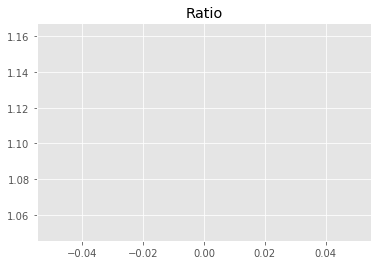

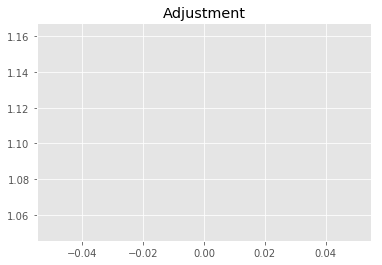

3183442955.680864
1


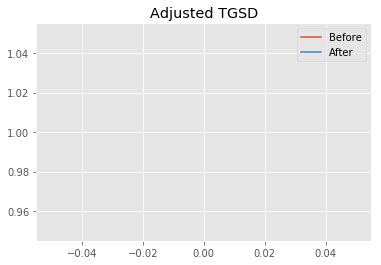

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.26516 	6.26778 	40479.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00823 	5.04001 	42703.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.4513
New Misfit: 11.2914
Convergence:
0.01396539487540657

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.38e+02 	4.77e+02 	1.0905 		1.0000


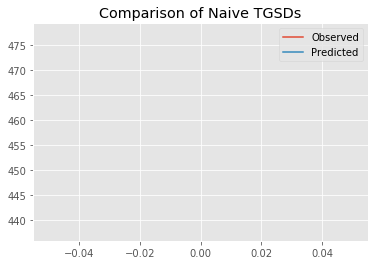

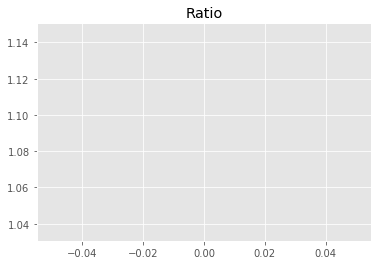

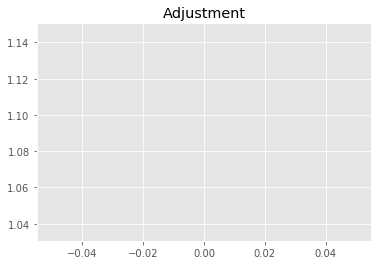

3137903971.778752
1


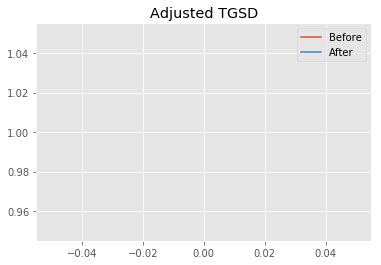

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00823 	5.04001 	42703.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.0006 	5.51872 	44908.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2914
New Misfit: 11.2772
Convergence:
0.0012541374989956632

____________________
a = 1.00060	b = 5.51872	            h1 = 44908.25819	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.27724081508128
Prior Misfit: 341.841,	 Post Misfit: 11.2772


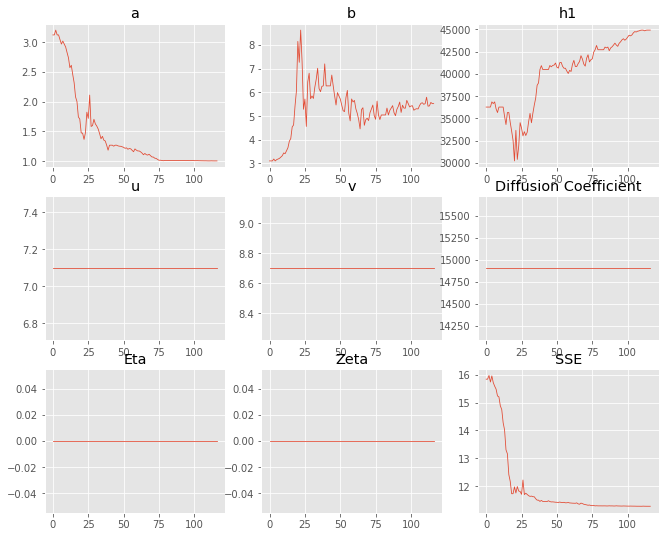

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.12064,1.0006
b,3.10032,5.51872
eta,0,0
ftt,"6,458","6,458"
h1,"36,263.1","44,908.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 8 Time: 0.066 minutes


Estimated remaining run time: 0.770 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.33e+02 	4.77e+02 	0.8951 		1.0000


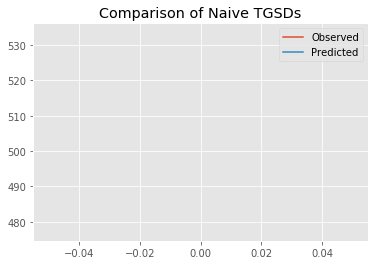

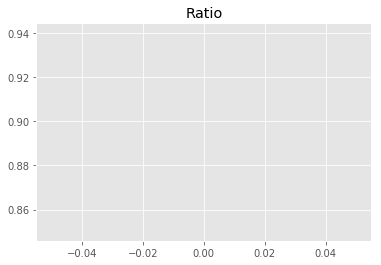

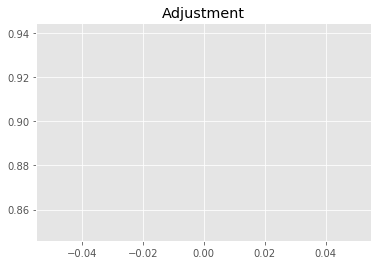

2575622176.367353
1


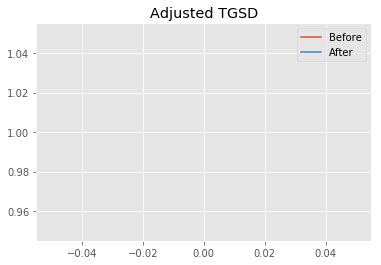

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.38868 	3.03566 	23260.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.0032 	5.02149 	40948.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.046
New Misfit: 11.2956
Convergence:
0.19581788215316626

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.33e+02 	4.77e+02 	1.1017 		1.0000


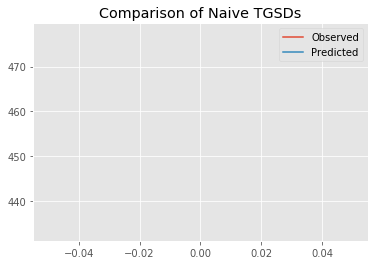

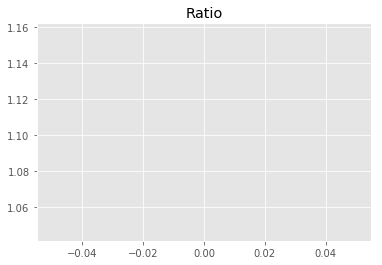

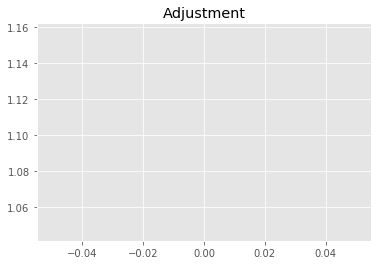

3170024661.465195
1


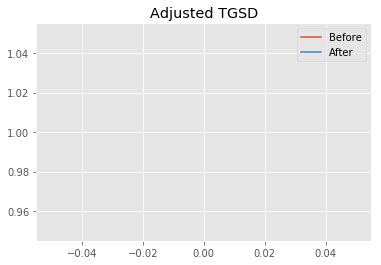

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0032 	5.02149 	40948.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00146 	5.59334 	44784.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2956
New Misfit: 11.2788
Convergence:
0.0014882163002020964

____________________
a = 1.00146	b = 5.59334	            h1 = 44784.56617	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.278764187085315
Prior Misfit: 276.42,	 Post Misfit: 11.2788


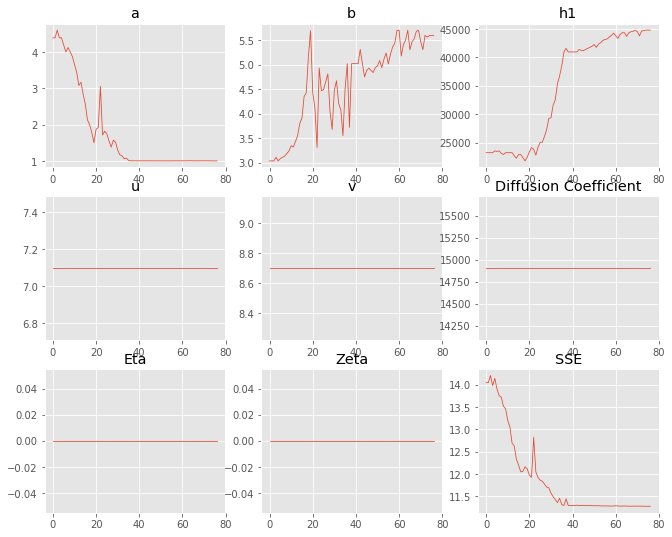

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.38868,1.00146
b,3.03566,5.59334
eta,0,0
ftt,"6,458","6,458"
h1,"23,260.3","44,784.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 9 Time: 0.047 minutes


Estimated remaining run time: 0.677 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.38e+02 	4.77e+02 	0.8866 		1.0000


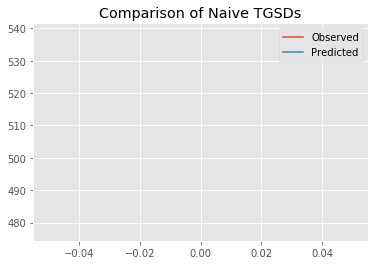

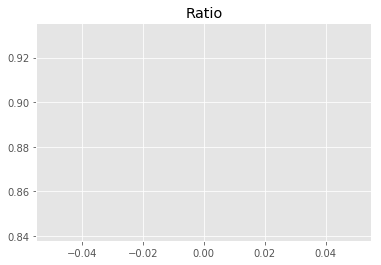

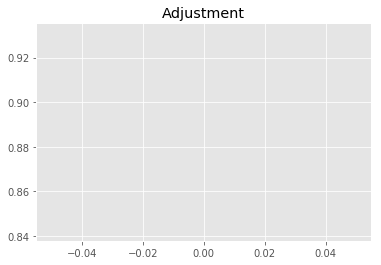

2551143604.9498806
1


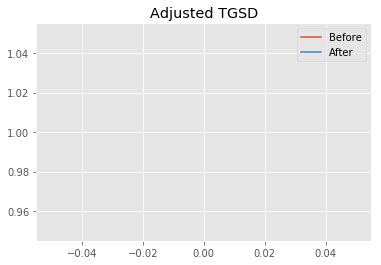

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.14709 	2.98039 	38441.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.2021 	4.50276 	6702.84 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.4091
New Misfit: 11.8149
Convergence:
0.18003653808223896

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.62e+02 	4.77e+02 	1.8253 		1.0000


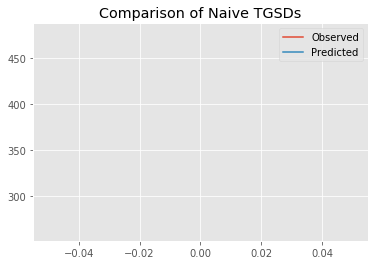

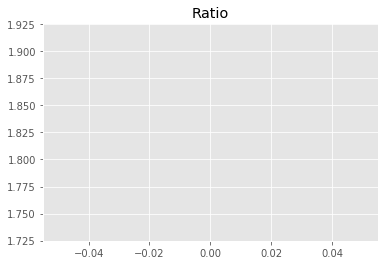

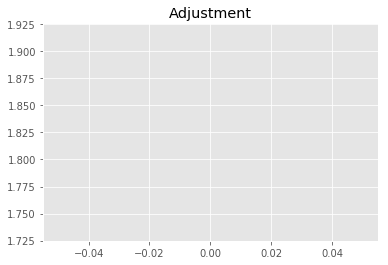

5252008969.759211
1


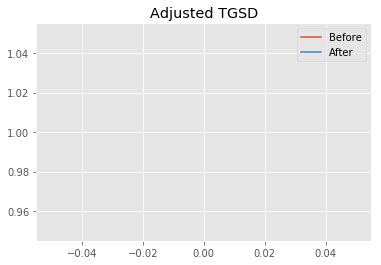

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.2021 	4.50276 	6702.84 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.20839 	4.50575 	6718.29 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.8149
New Misfit: 11.8149
Convergence:
2.4366952604761067e-06

____________________
a = 2.20839	b = 4.50575	            h1 = 6718.28918	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.814888545254856
Prior Misfit: 274.202,	 Post Misfit: 11.8149


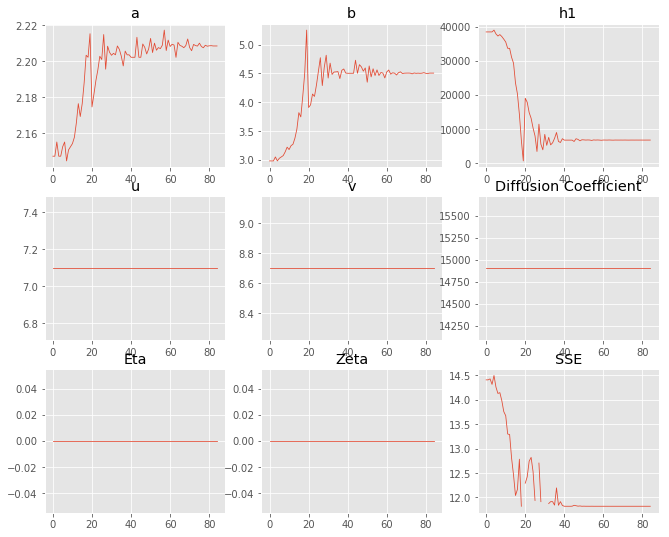

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.14709,2.20839
b,2.98039,4.50575
eta,0,0
ftt,"6,458","6,458"
h1,"38,441.2","6,718.29"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 10 Time: 0.050 minutes


Estimated remaining run time: 0.595 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.54e+02 	4.77e+02 	1.0520 		1.0000


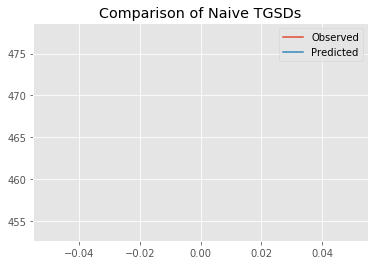

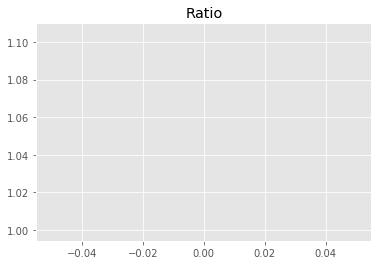

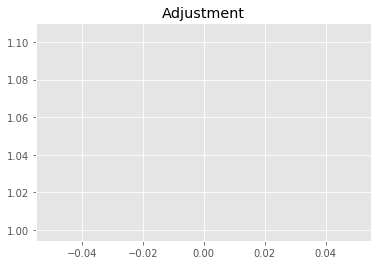

3027140356.331842
1


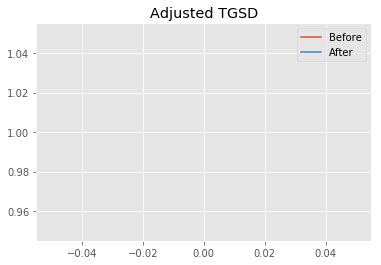

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.516 	3.27019 	26551.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00181 	4.50465 	38943.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.7138
New Misfit: 11.3044
Convergence:
0.03495009487824764

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.37e+02 	4.77e+02 	1.0920 		1.0000


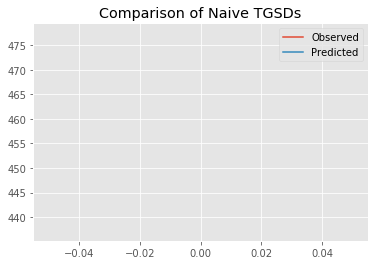

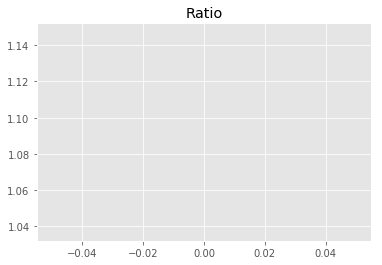

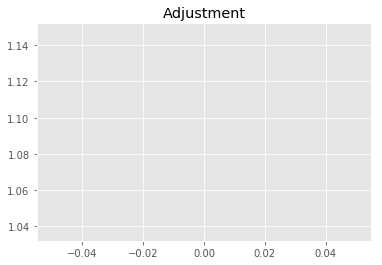

3142238824.300356
1


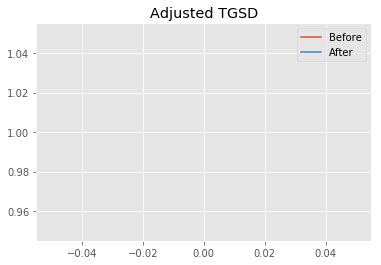

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00181 	4.50465 	38943.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00246 	5.40102 	44415.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3044
New Misfit: 11.2801
Convergence:
0.0021489620447127057

____________________
a = 1.00246	b = 5.40102	            h1 = 44415.21488	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.280114867642894
Prior Misfit: 358.286,	 Post Misfit: 11.2801


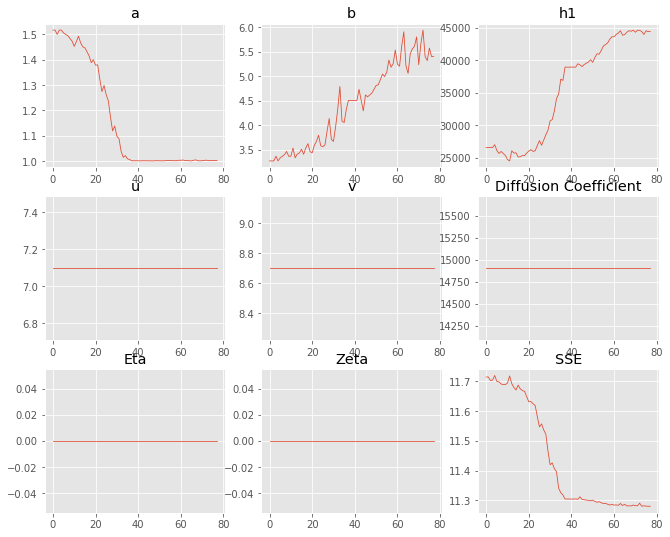

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.516,1.00246
b,3.27019,5.40102
eta,0,0
ftt,"6,458","6,458"
h1,"26,551.2","44,415.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 11 Time: 0.047 minutes


Estimated remaining run time: 0.516 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.02e+02 	4.77e+02 	0.9504 		1.0000


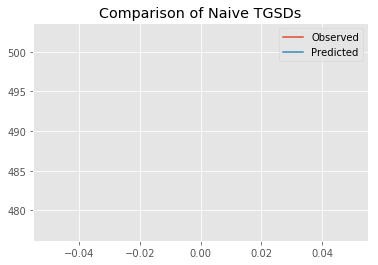

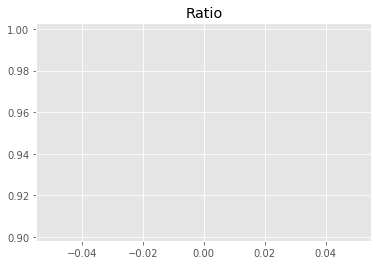

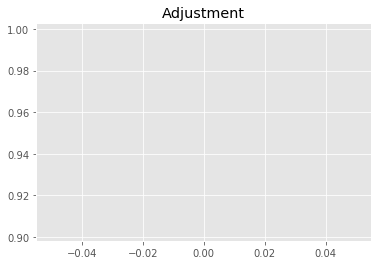

2734744844.8965693
1


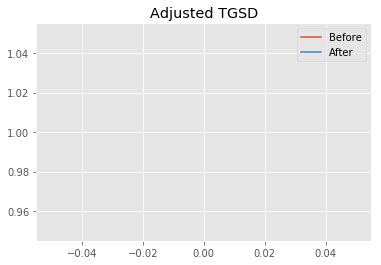

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.18892 	2.50919 	40911.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.066 	2.6089 	26121.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.665
New Misfit: 11.4623
Convergence:
0.09496039323139109

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.42e+02 	4.77e+02 	1.0791 		1.0000


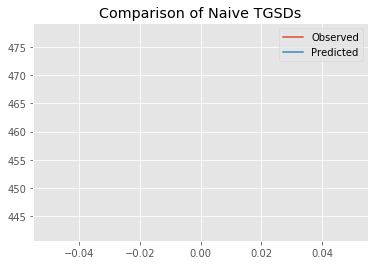

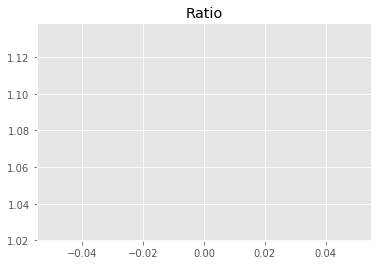

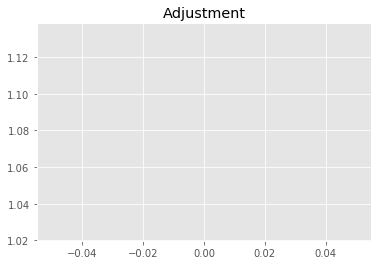

3105040048.9497333
1


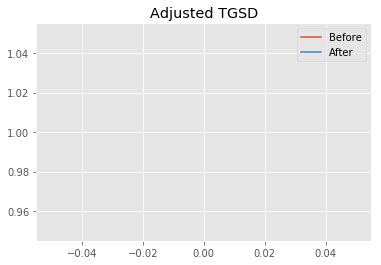

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.066 	2.6089 	26121.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	4.96535 	39942.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.4623
New Misfit: 11.3008
Convergence:
0.014087804142533508

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.31e+02 	4.77e+02 	1.1065 		1.0000


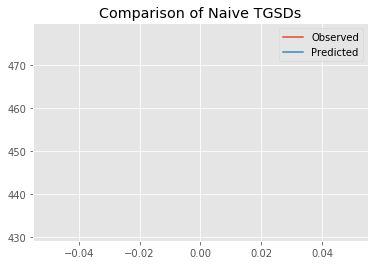

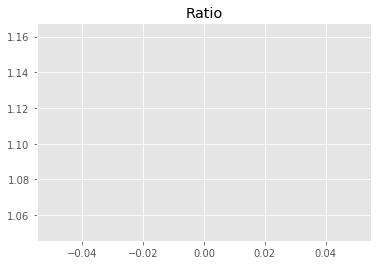

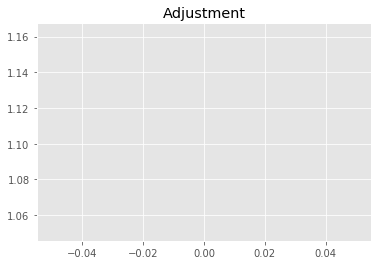

3183917691.126442
1


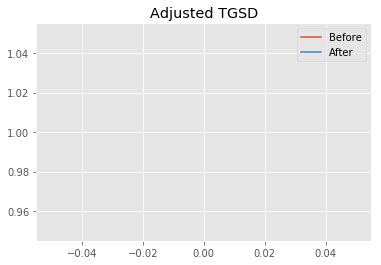

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	4.96535 	39942.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.5768 	44708.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3008
New Misfit: 11.2782
Convergence:
0.0019980272225690577

____________________
a = 1.00000	b = 5.57680	            h1 = 44708.75683	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.278233252807778
Prior Misfit: 220.963,	 Post Misfit: 11.2782


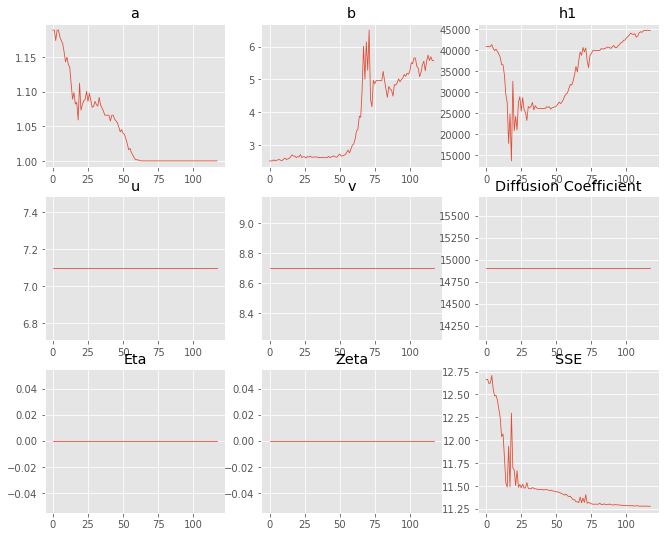

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.18892,1
b,2.50919,5.5768
eta,0,0
ftt,"6,458","6,458"
h1,"40,911.8","44,708.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 12 Time: 0.068 minutes


Estimated remaining run time: 0.453 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.78e+02 	4.77e+02 	0.8263 		1.0000


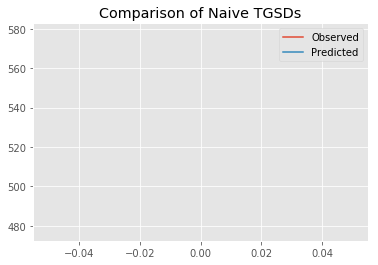

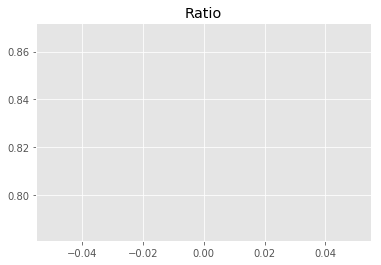

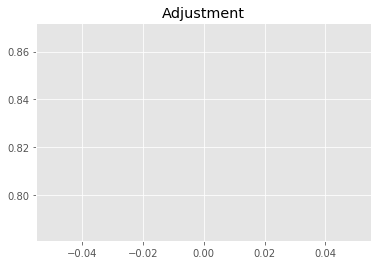

2377726725.5224037
1


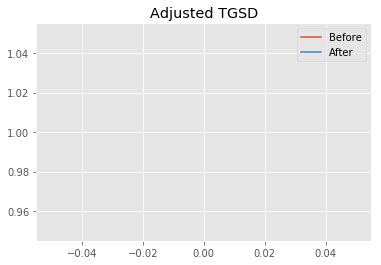

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.74265 	2.07943 	27100.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.04706 	2.19416 	25574.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.6346
New Misfit: 11.506
Convergence:
0.30830816510931464

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.53e+02 	4.77e+02 	1.0548 		1.0000


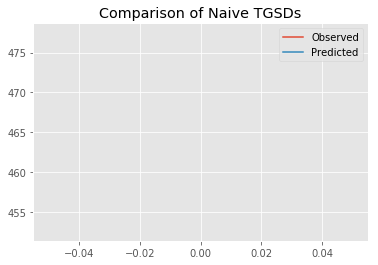

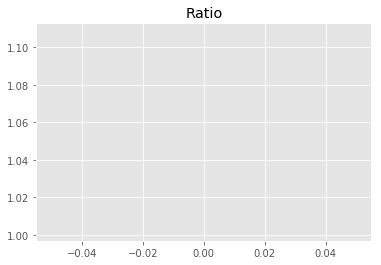

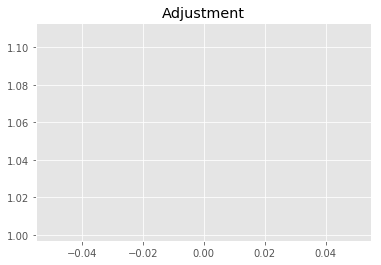

3034978452.466624
1


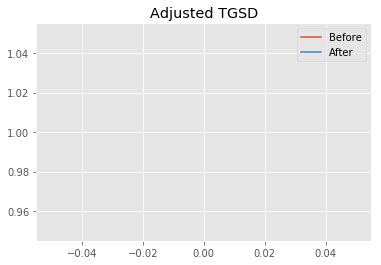

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.04706 	2.19416 	25574.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.01415 	2.24818 	24353.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.506
New Misfit: 11.4647
Convergence:
0.0035929500474469285

____________________
a = 1.01415	b = 2.24818	            h1 = 24353.33638	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.464671873745964
Prior Misfit: 386.822,	 Post Misfit: 11.4647


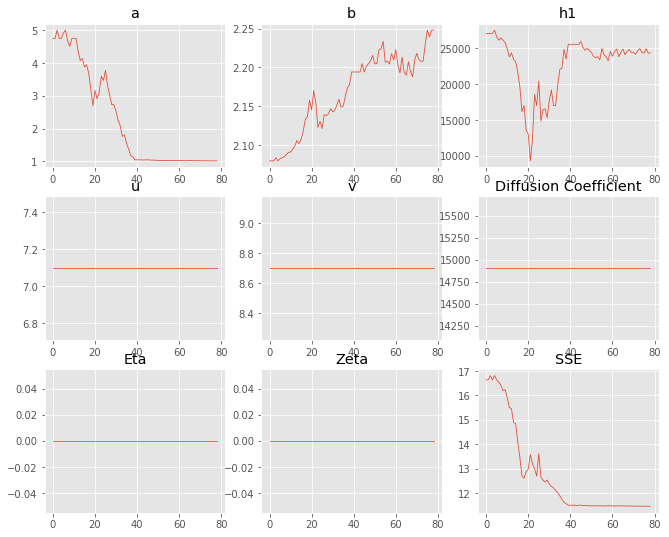

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.74265,1.01415
b,2.07943,2.24818
eta,0,0
ftt,"6,458","6,458"
h1,"27,100.3","24,353.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 13 Time: 0.047 minutes


Estimated remaining run time: 0.381 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.17e+02 	4.77e+02 	0.9235 		1.0000


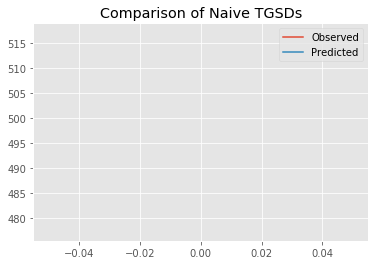

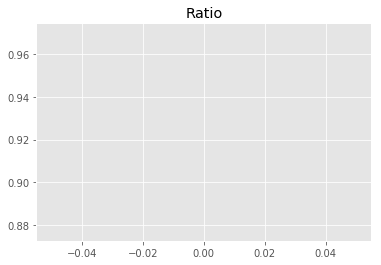

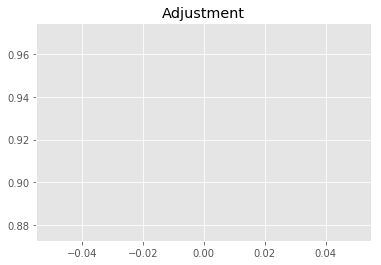

2657396951.245944
1


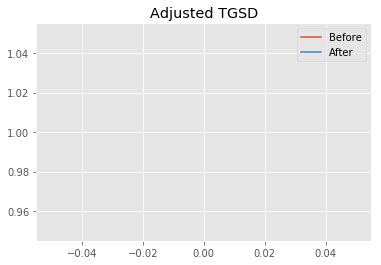

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.73332 	3.93272 	31042.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.87241 	7.04679 	35133.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.2201
New Misfit: 11.7737
Convergence:
0.10940512427512251

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.40e+02 	4.77e+02 	1.0850 		1.0000


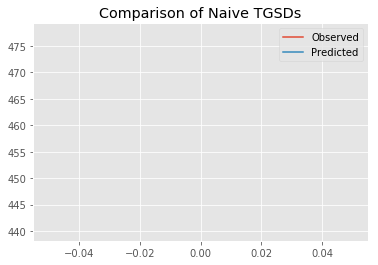

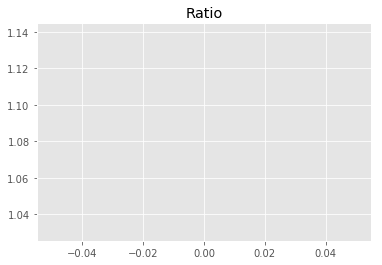

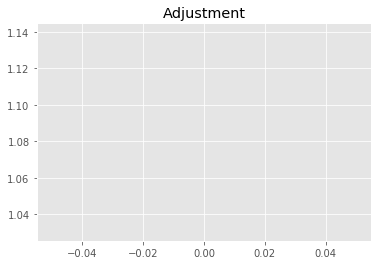

3122118236.193222
1


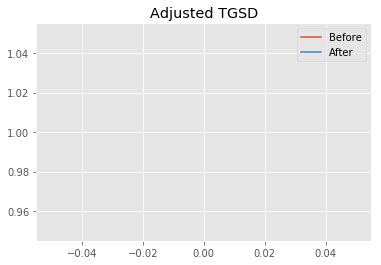

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.87241 	7.04679 	35133.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.58747 	8.0603 	44717 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.7737
New Misfit: 11.5848
Convergence:
0.01604284420537282

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.41e+02 	4.77e+02 	1.0836 		1.0000


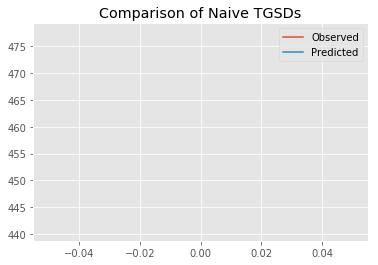

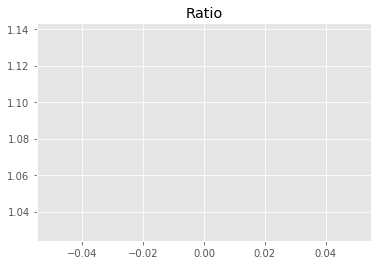

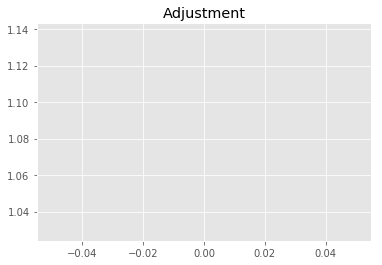

3117840102.9613237
1


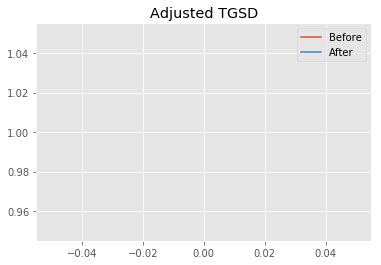

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.58747 	8.0603 	44717 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.03822 	4.70256 	38425.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.5848
New Misfit: 11.3274
Convergence:
0.022226267006725413

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.35e+02 	4.77e+02 	1.0979 		1.0000


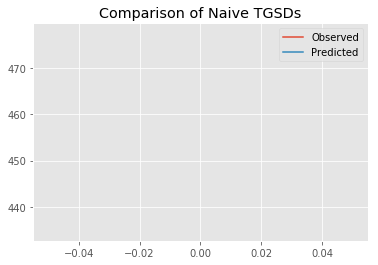

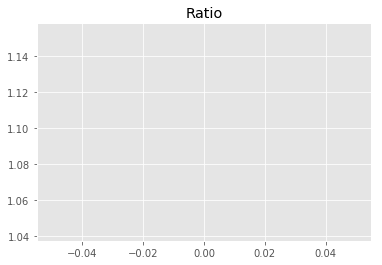

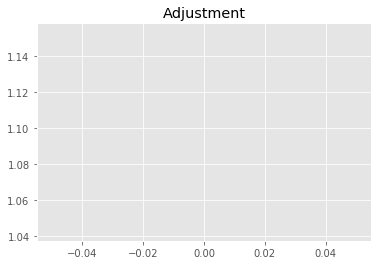

3159042147.5483046
1


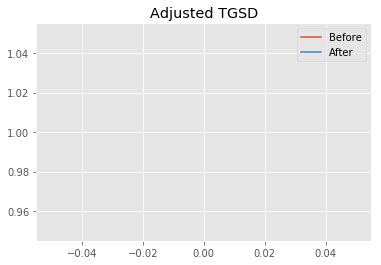

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03822 	4.70256 	38425.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.28671 	44503.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3274
New Misfit: 11.2796
Convergence:
0.0042202673565455645

____________________
a = 1.00000	b = 5.28671	            h1 = 44503.16020	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.279557446593929
Prior Misfit: 246.255,	 Post Misfit: 11.2796


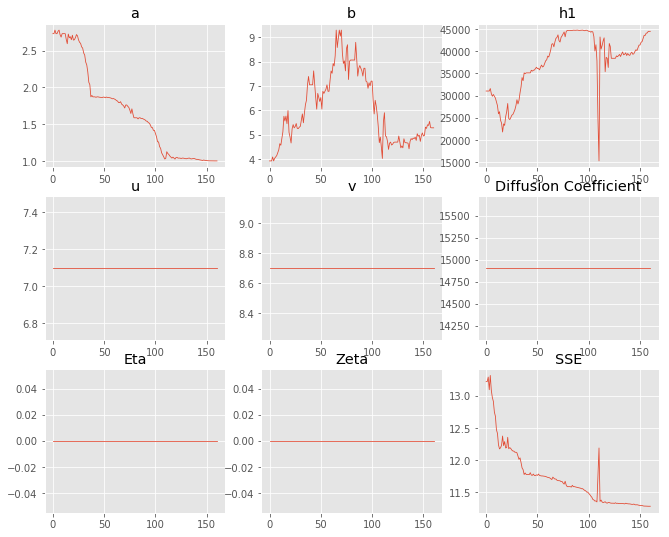

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.73332,1
b,3.93272,5.28671
eta,0,0
ftt,"6,458","6,458"
h1,"31,042.3","44,503.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 14 Time: 0.085 minutes


Estimated remaining run time: 0.325 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.38e+02 	4.77e+02 	0.8876 		1.0000


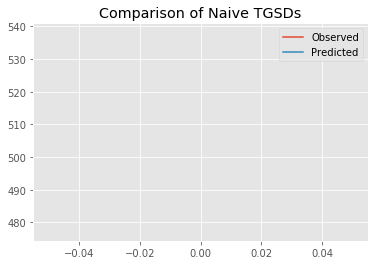

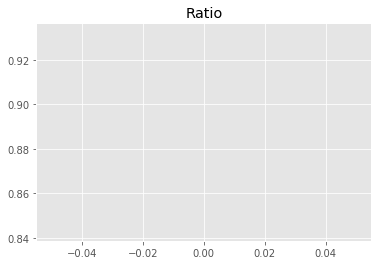

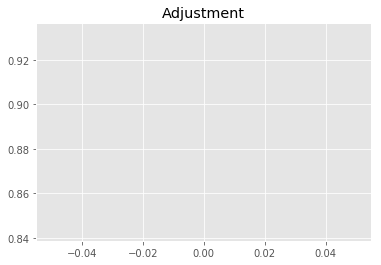

2553912040.034032
1


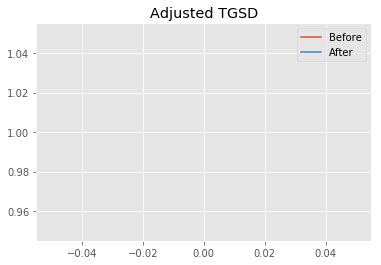

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.17943 	2.77392 	35725.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.20712 	3.47905 	21905.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.2999
New Misfit: 12.0795
Convergence:
0.15526953649348102

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.54e+02 	4.77e+02 	1.0520 		1.0000


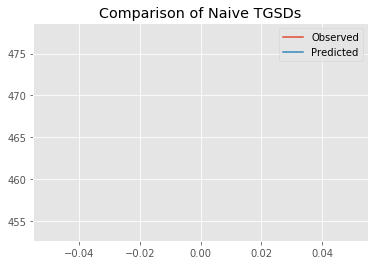

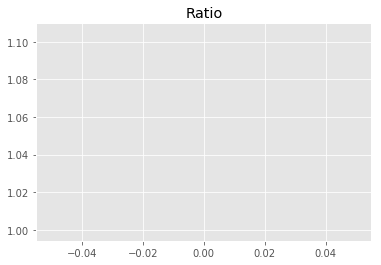

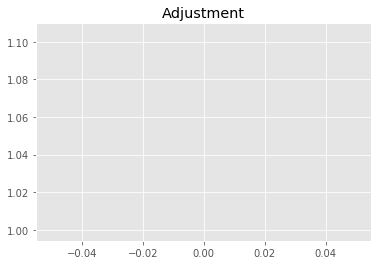

3026957046.257201
1


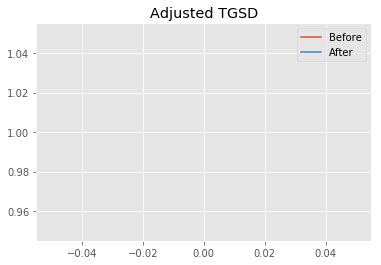

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.20712 	3.47905 	21905.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.26274 	7.07429 	40215.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.0795
New Misfit: 11.5069
Convergence:
0.047407810466448236

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.20e+02 	4.77e+02 	1.1374 		1.0000


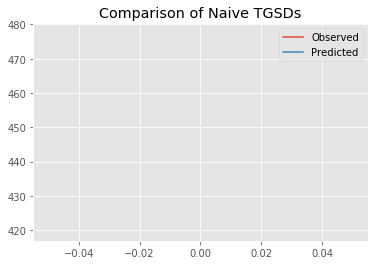

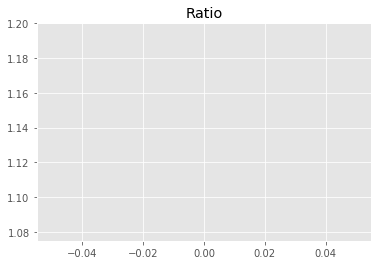

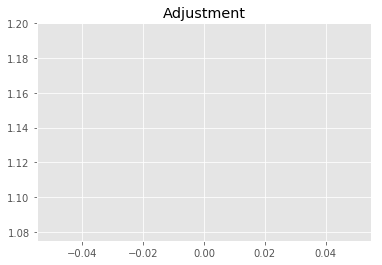

3272738953.3896017
1


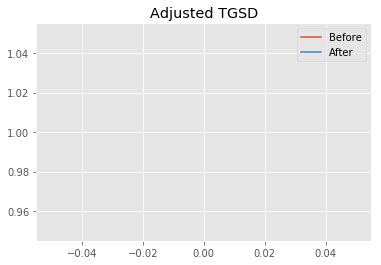

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.26274 	7.07429 	40215.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.09721 	5.32869 	41549.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.5069
New Misfit: 11.3446
Convergence:
0.014104763739927322

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.37e+02 	4.77e+02 	1.0928 		1.0000


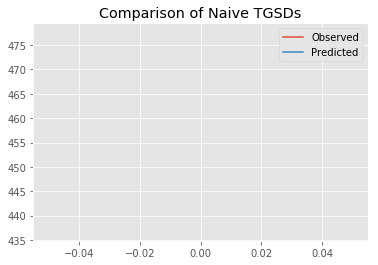

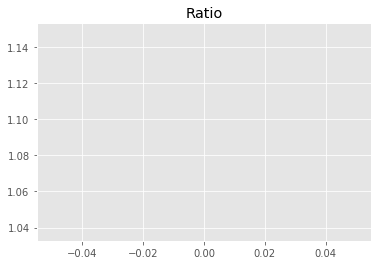

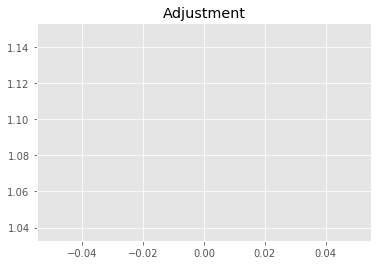

3144502875.264135
1


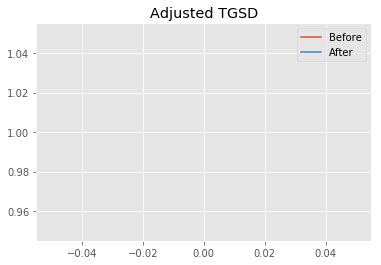

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.09721 	5.32869 	41549.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00024 	5.16819 	42330.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3446
New Misfit: 11.2873
Convergence:
0.005050181041824645

____________________
a = 1.00024	b = 5.16819	            h1 = 42330.31633	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.287272384372486
Prior Misfit: 270.131,	 Post Misfit: 11.2873


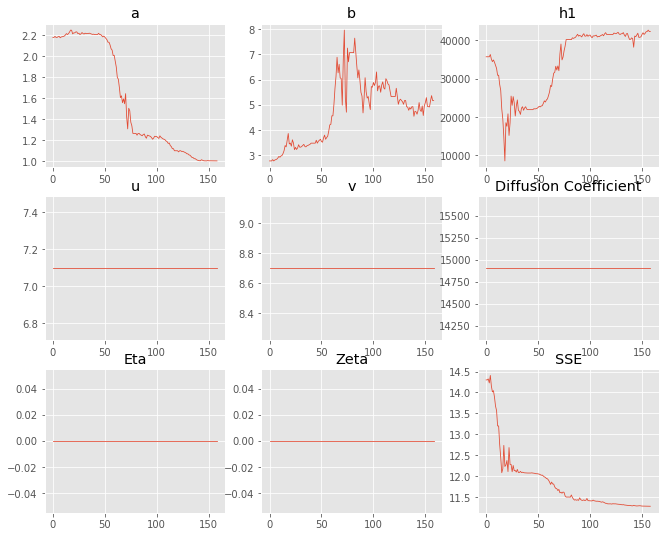

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.17943,1.00024
b,2.77392,5.16819
eta,0,0
ftt,"6,458","6,458"
h1,"35,725.8","42,330.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 15 Time: 0.085 minutes


Estimated remaining run time: 0.265 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.55e+02 	4.77e+02 	1.0482 		1.0000


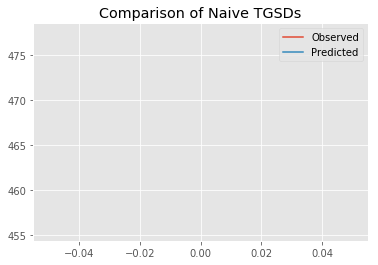

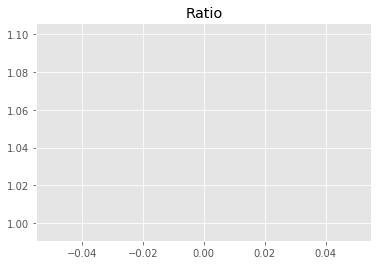

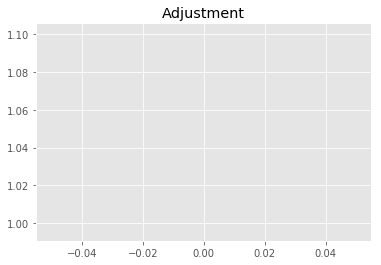

3016174531.2424974
1


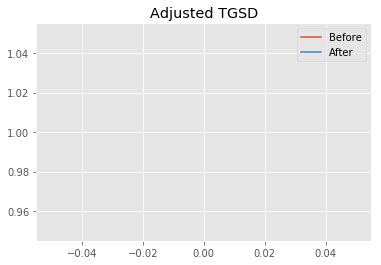

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.5733 	4.49672 	32534 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.11041 	6.12499 	42025 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.6802
New Misfit: 11.3689
Convergence:
0.026653849911601857

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.27e+02 	4.77e+02 	1.1183 		1.0000


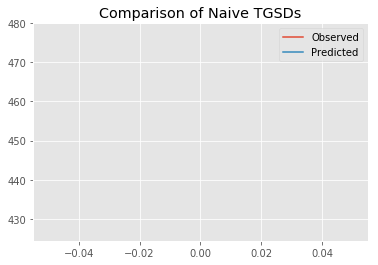

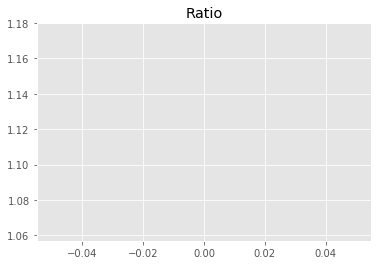

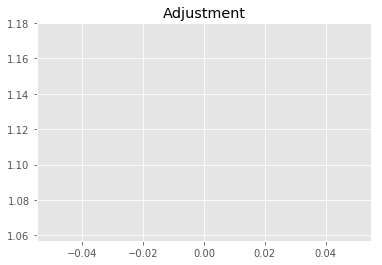

3217942800.91433
1


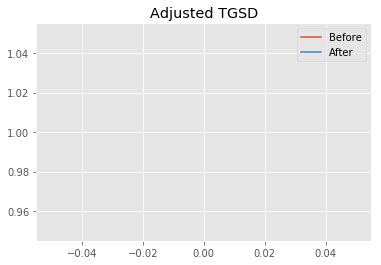

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.11041 	6.12499 	42025 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.0023 	5.57086 	44817.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3689
New Misfit: 11.2788
Convergence:
0.007923809944936687

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.34e+02 	4.77e+02 	1.1006 		1.0000


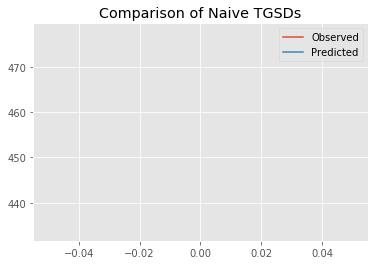

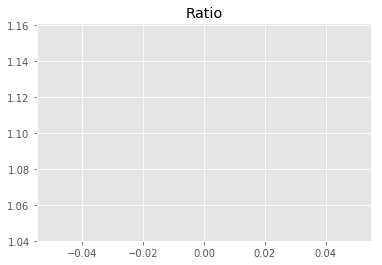

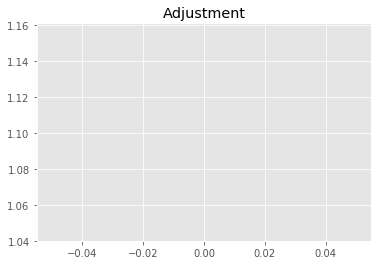

3166845832.1517572
1


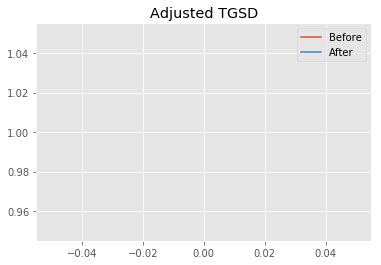

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0023 	5.57086 	44817.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00006 	5.46079 	44877.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2788
New Misfit: 11.2771
Convergence:
0.0001553687481206885

____________________
a = 1.00006	b = 5.46079	            h1 = 44877.68570	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.277071179139094
Prior Misfit: 331.541,	 Post Misfit: 11.2771


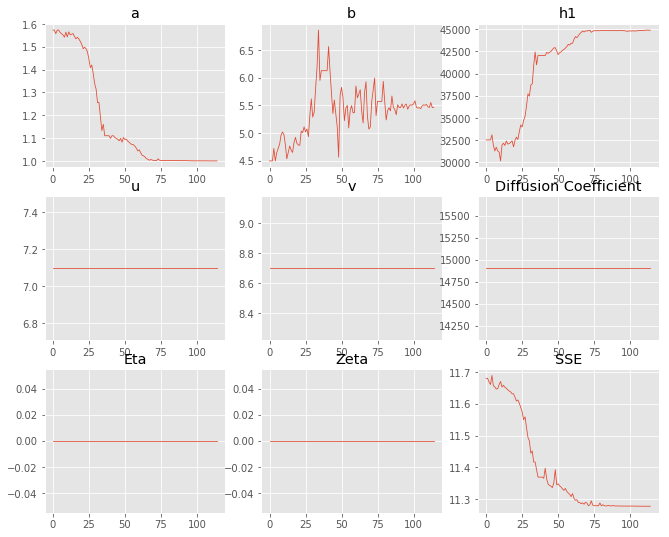

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.5733,1.00006
b,4.49672,5.46079
eta,0,0
ftt,"6,458","6,458"
h1,"32,534","44,877.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 16 Time: 0.066 minutes


Estimated remaining run time: 0.199 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.51e+02 	4.77e+02 	0.8661 		1.0000


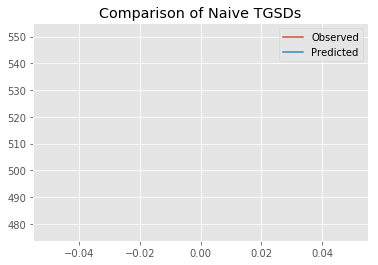

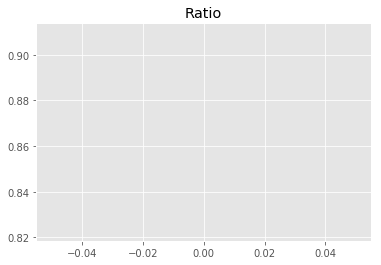

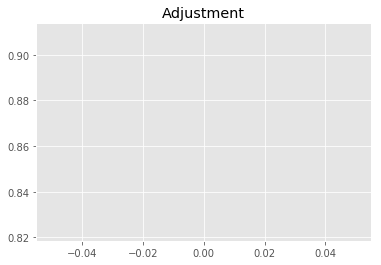

2492196460.937639
1


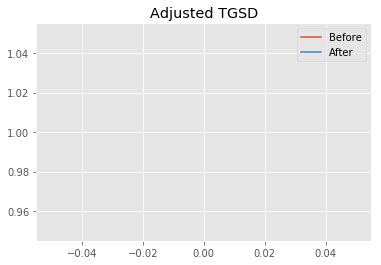

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.58575 	3.35799 	40730.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.22428 	9.91216 	9393.12 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.3249
New Misfit: 11.803
Convergence:
0.2298122839328285

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.67e+02 	4.77e+02 	1.7894 		1.0000


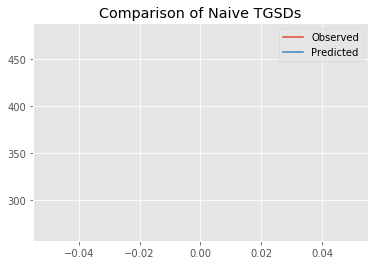

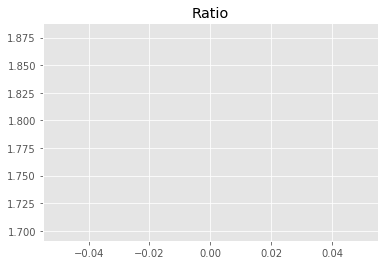

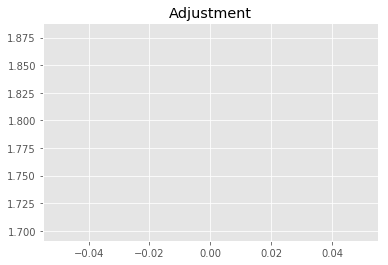

5148925667.455588
1


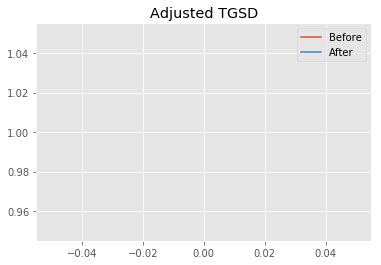

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.22428 	9.91216 	9393.12 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.20584 	13.069 	10689 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.803
New Misfit: 11.7995
Convergence:
0.00029937586821353947

____________________
a = 2.20584	b = 13.06902	            h1 = 10689.04746	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.79948442923317
Prior Misfit: 315.207,	 Post Misfit: 11.7995


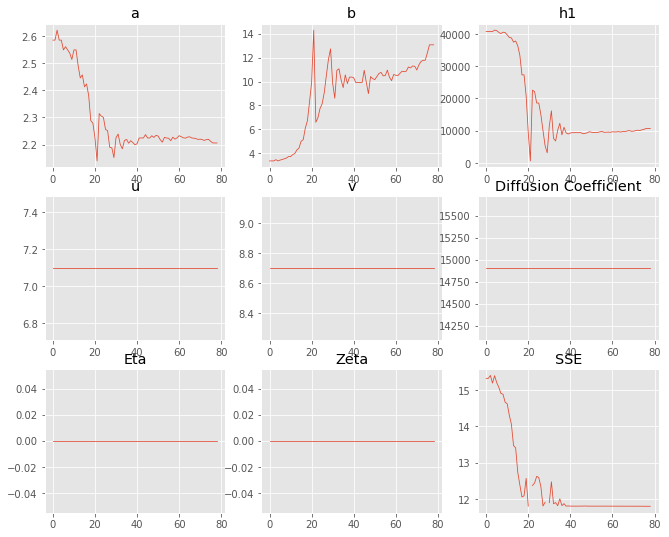

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.58575,2.20584
b,3.35799,13.069
eta,0,0
ftt,"6,458","6,458"
h1,"40,730.5","10,689"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 17 Time: 0.047 minutes


Estimated remaining run time: 0.130 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.93e+02 	4.77e+02 	0.9677 		1.0000


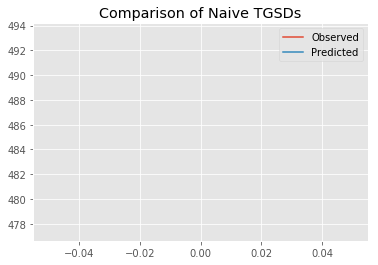

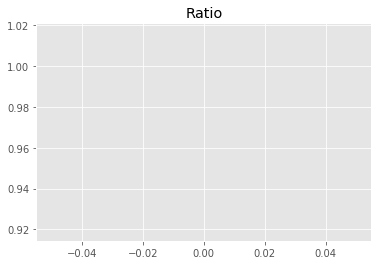

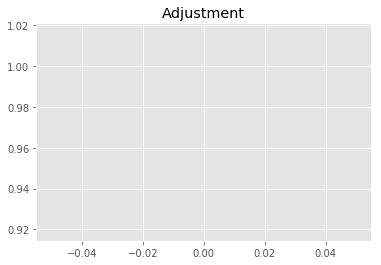

2784321049.7502484
1


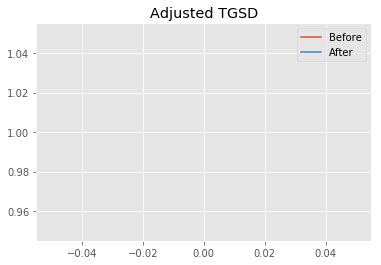

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.31067 	3.30534 	41806 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.15778 	4.61685 	37834.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.2849
New Misfit: 11.404
Convergence:
0.0717075424014579

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.44e+02 	4.77e+02 	1.0763 		1.0000


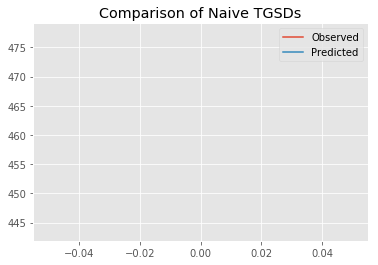

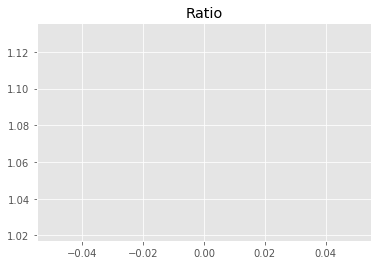

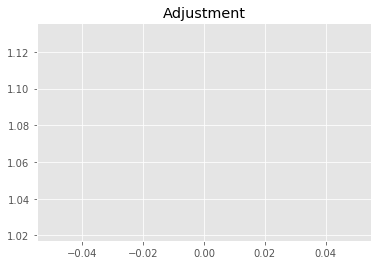

3096948175.7974
1


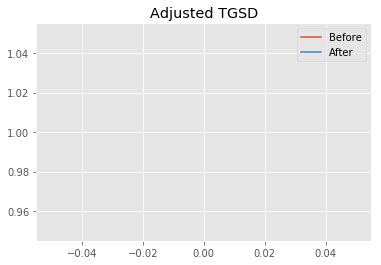

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.15778 	4.61685 	37834.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00558 	5.28004 	42668.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.404
New Misfit: 11.2892
Convergence:
0.010063257392446743

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.34e+02 	4.77e+02 	1.1012 		1.0000


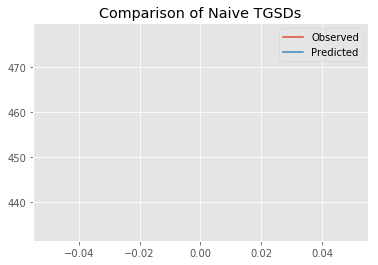

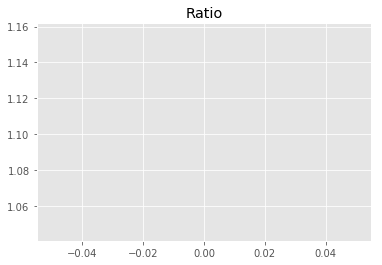

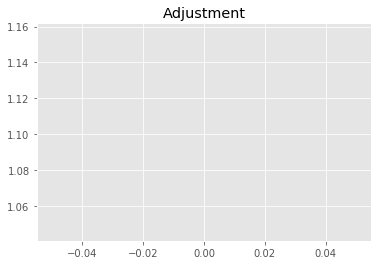

3168616680.2469788
1


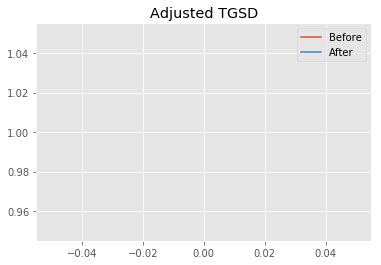

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00558 	5.28004 	42668.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.50181 	44894.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2892
New Misfit: 11.2769
Convergence:
0.0010900317439596578

____________________
a = 1.00000	b = 5.50181	            h1 = 44894.05427	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.276935911070138
Prior Misfit: 219.171,	 Post Misfit: 11.2769


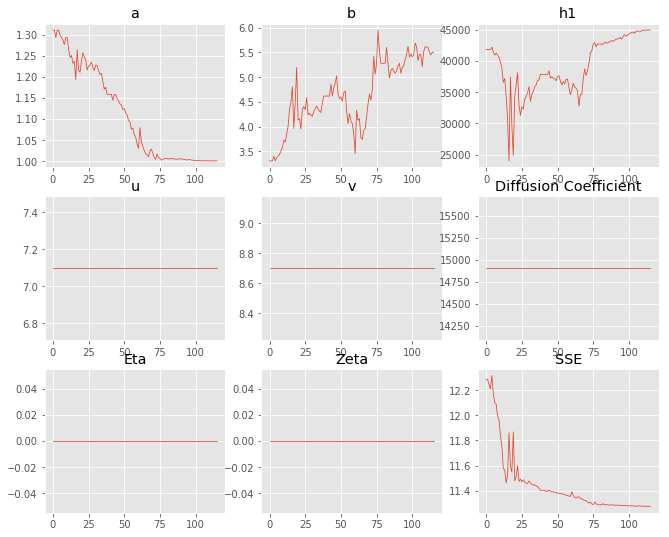

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.31067,1
b,3.30534,5.50181
eta,0,0
ftt,"6,458","6,458"
h1,"41,806","44,894.1"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 18 Time: 0.066 minutes


Estimated remaining run time: 0.065 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.10e+02 	4.77e+02 	0.9366 		1.0000


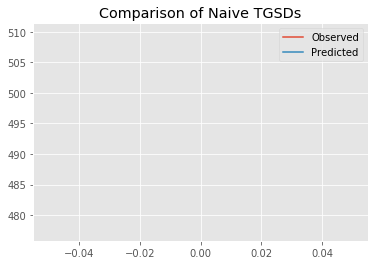

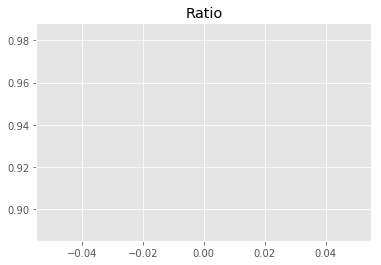

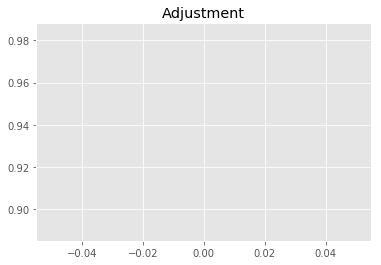

2694921876.6569076
1


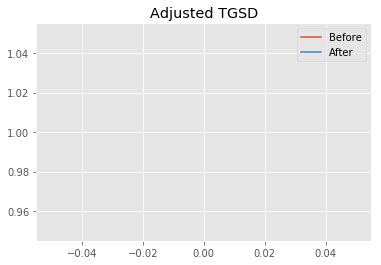

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.72071 	3.34954 	38316.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.68903 	4.20489 	28351.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.8902
New Misfit: 11.7527
Convergence:
0.08823875387967112

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.50e+02 	4.77e+02 	1.0608 		1.0000


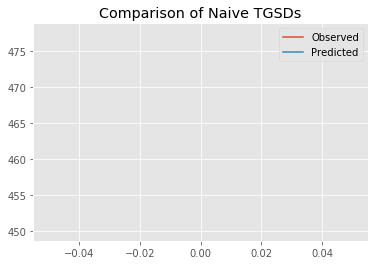

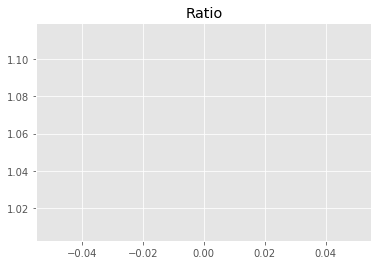

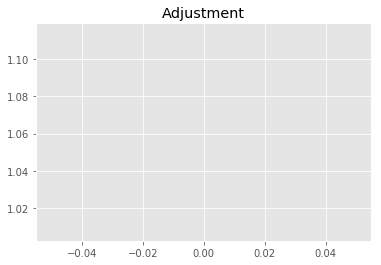

3052254108.7742696
1


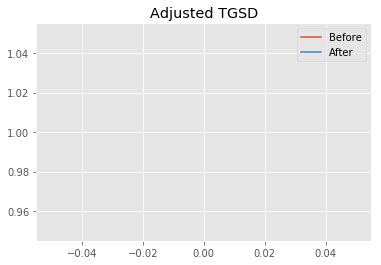

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.68903 	4.20489 	28351.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.19454 	5.96033 	38824.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.7527
New Misfit: 11.437
Convergence:
0.02686885786236696

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.27e+02 	4.77e+02 	1.1193 		1.0000


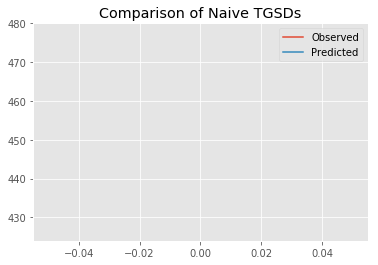

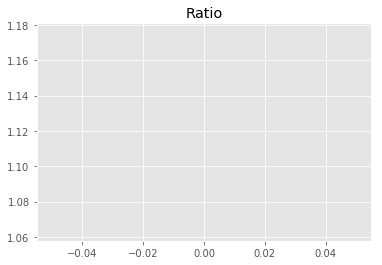

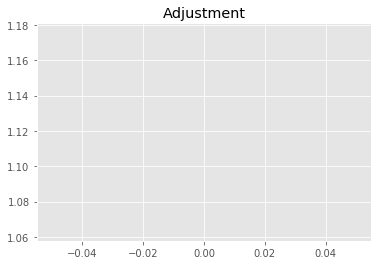

3220734183.6297274
1


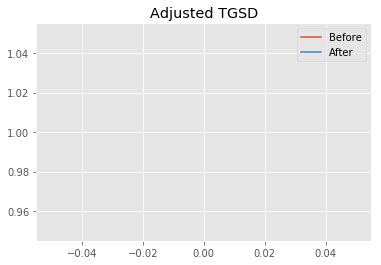

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19454 	5.96033 	38824.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00348 	5.31833 	44635.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.437
New Misfit: 11.2811
Convergence:
0.013632572953241828

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.37e+02 	4.77e+02 	1.0915 		1.0000


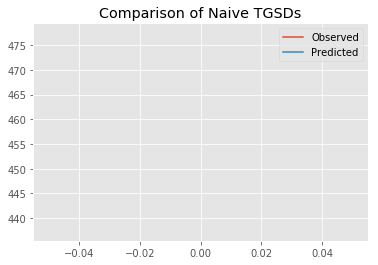

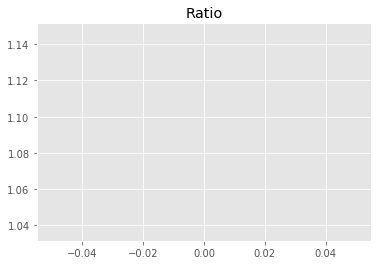

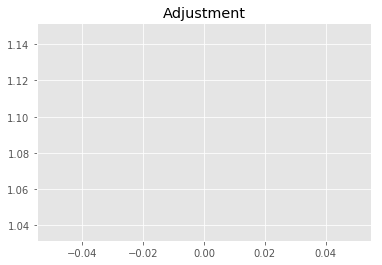

3140652317.9917793
1


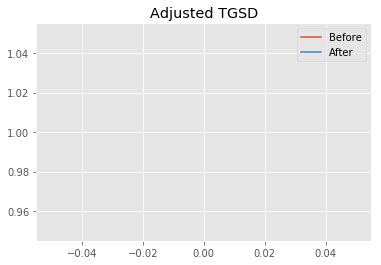

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00348 	5.31833 	44635.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.497 	44914.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.2811
New Misfit: 11.2769
Convergence:
0.00037161690465067193

____________________
a = 1.00000	b = 5.49700	            h1 = 44914.24496	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.276857921952944
Prior Misfit: 228.914,	 Post Misfit: 11.2769


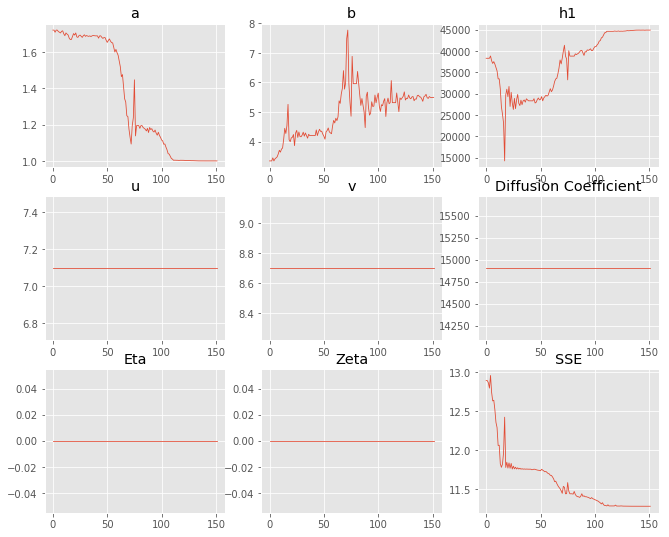

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.72071,1
b,3.34954,5.497
eta,0,0
ftt,"6,458","6,458"
h1,"38,316.2","44,914.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 19 Time: 0.083 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.21e+02 	4.77e+02 	0.9169 		1.0000


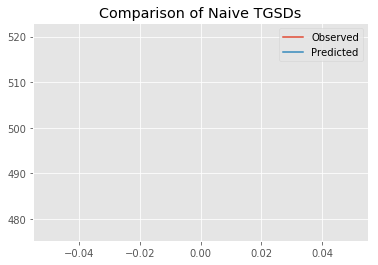

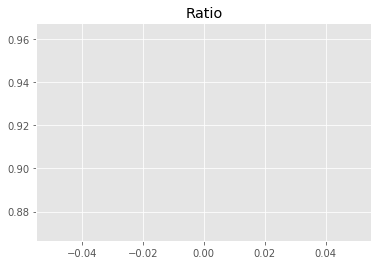

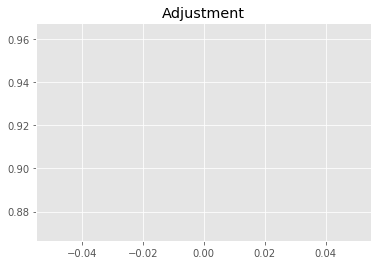

2638157103.1416006
1


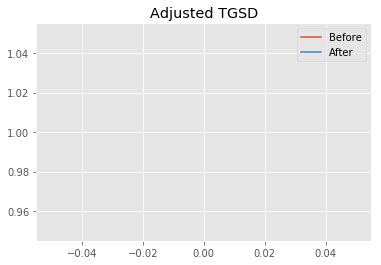

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.76038 	4.99913 	29586 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.05537 	5.63008 	42061.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.4617
New Misfit: 11.3257
Convergence:
0.15866983568613016

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.30e+02 	4.77e+02 	1.1095 		1.0000


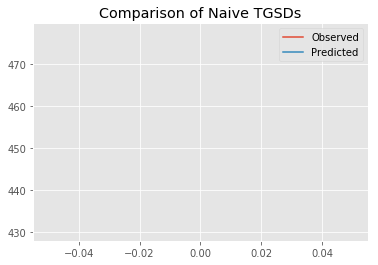

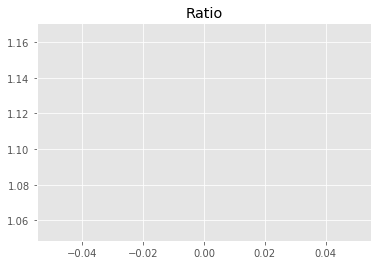

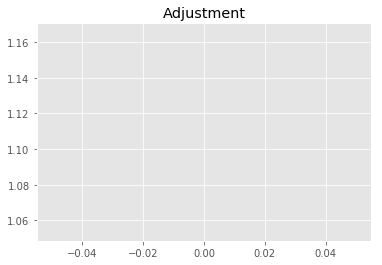

3192517383.2281585
1


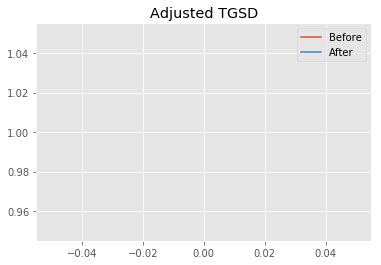

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05537 	5.63008 	42061.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00054 	5.4016 	44505 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 11.3257
New Misfit: 11.2787
Convergence:
0.004148148103120992

____________________
a = 1.00054	b = 5.40160	            h1 = 44504.96784	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.2787221017919
Prior Misfit: 258.6,	 Post Misfit: 11.2787


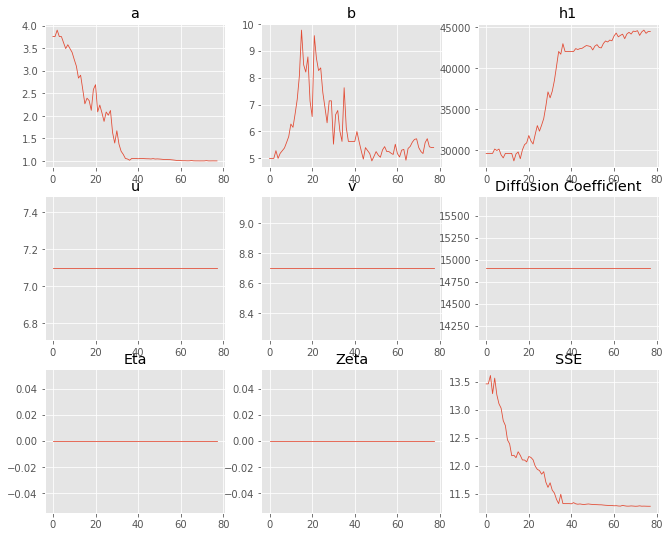

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.76038,1.00054
b,4.99913,5.4016
eta,0,0
ftt,"6,458","6,458"
h1,"29,586","44,505"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 20 Time: 0.048 minutes


Estimated remaining run time: -0.065 minutes


Total Run Time: 1.36953 minutes


[{'a': 1.0000000129667723,
  'b': 5.529014542377192,
  'h1': 44912.283595212386,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.000432539896513,
  'b': 5.55382274667216,
  'h1': 44915.0,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0004992772229158,
  'b': 5.542287342903543,
  'h1': 44352.69308075272,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0005450972726802,
  'b': 5.453761674085236,
  'h1': 44883.359069069564,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0000002691277006,
  'b': 5.443820096568233,
  'h1': 44787.485248383426,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0006441904215115,
  

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
18,1,5.497,"44,914.2",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2769
0,1,5.52901,"44,912.3",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2769
17,1,5.50181,"44,894.1",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2769
15,1.00006,5.46079,"44,877.7",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2771
7,1.0006,5.51872,"44,908.3",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2772
1,1.00043,5.55382,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2773
3,1.00055,5.45376,"44,883.4",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2774
4,1,5.44382,"44,787.5",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2774
11,1,5.5768,"44,708.8",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2782
19,1.00054,5.4016,"44,505",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2787


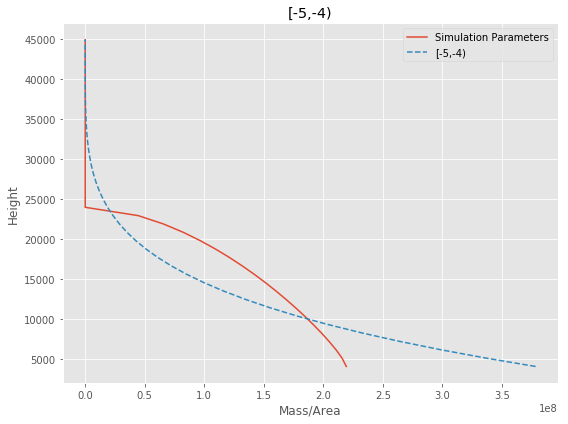

[-5,-4) Run Time: 1.37214 minutes


Mass Test: 2877403722.5197015
========[-4,-3)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.88e+03 	1.55e+03 	0.8226 		1.0000


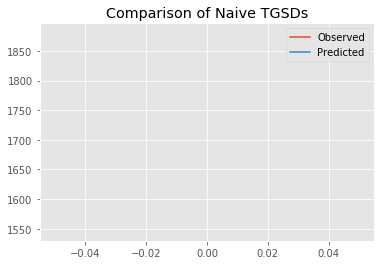

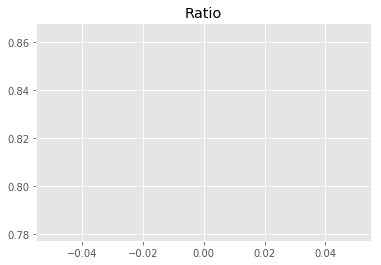

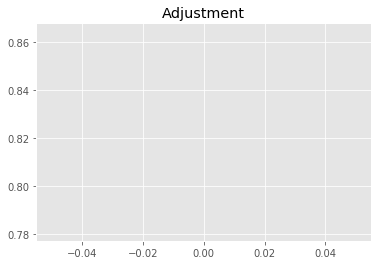

7666343968.054274
1


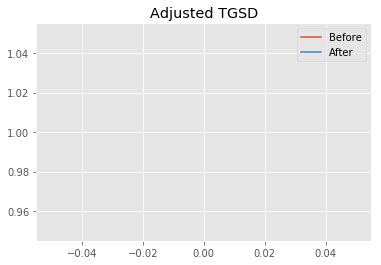

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.82241 	2.72607 	19924.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.78096 	2.76251 	26411.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.5393
New Misfit: 22.2059
Convergence:
0.09509036647306425

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.77e+03 	1.55e+03 	0.8726 		1.0000


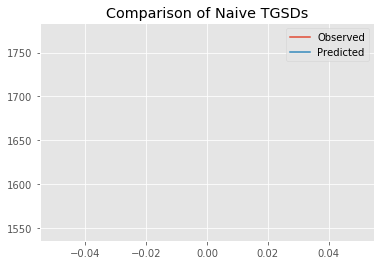

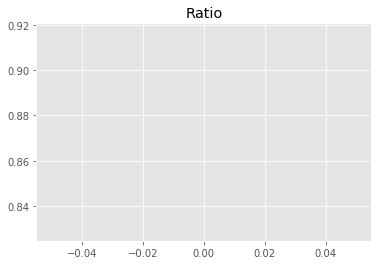

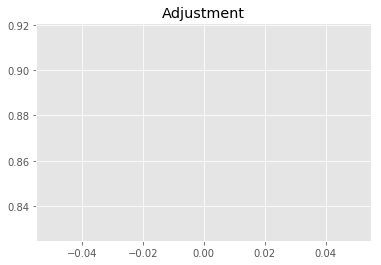

8132642159.139387
1


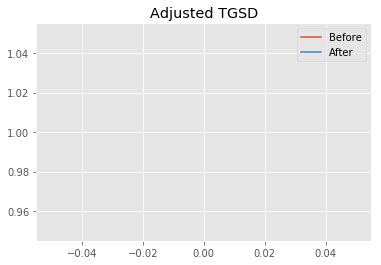

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.78096 	2.76251 	26411.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.46573 	2.68549 	32407.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.2059
New Misfit: 21.5541
Convergence:
0.029348829898750185

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.78e+03 	1.55e+03 	0.8689 		1.0000


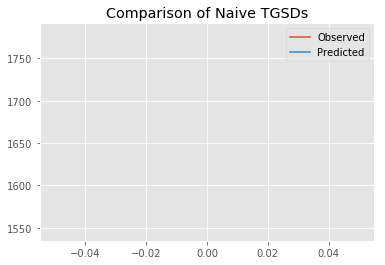

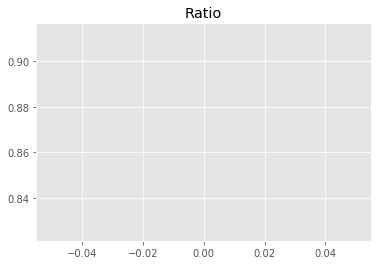

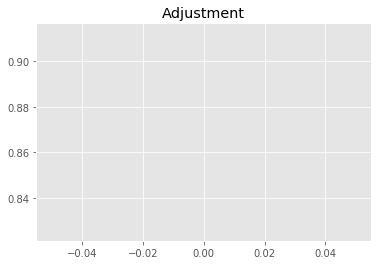

8098274788.824073
1


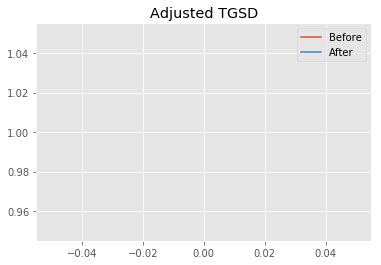

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.46573 	2.68549 	32407.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.04434 	2.22327 	37398.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.5541
New Misfit: 20.9224
Convergence:
0.02931124559706695

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.75e+03 	1.55e+03 	0.8842 		1.0000


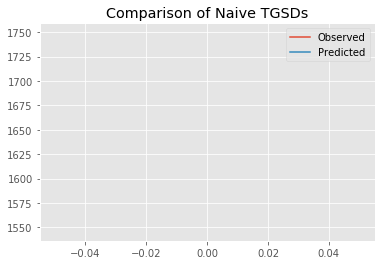

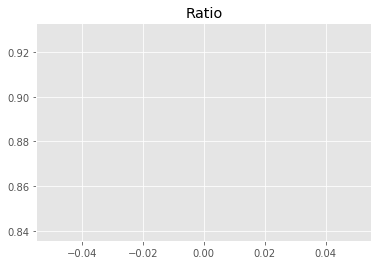

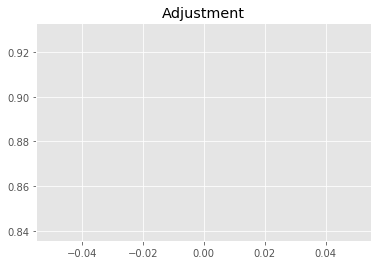

8240429603.250431
1


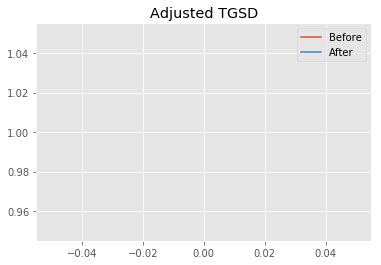

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.04434 	2.22327 	37398.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00021 	2.29969 	38102.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.9224
New Misfit: 20.7985
Convergence:
0.005919927830520206

____________________
a = 1.00021	b = 2.29969	            h1 = 38102.59915	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 20.79850084127896
Prior Misfit: 463.28,	 Post Misfit: 20.7985


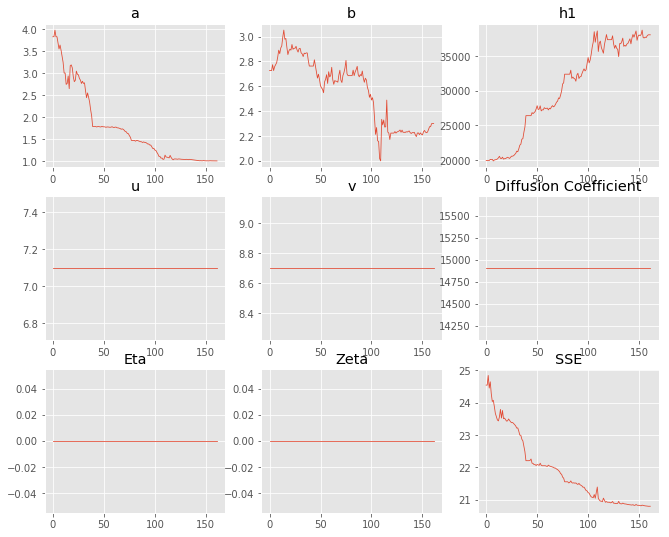

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.82241,1.00021
b,2.72607,2.29969
eta,0,0
ftt,"6,458","6,458"
h1,"19,924.9","38,102.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 1 Time: 0.085 minutes


Estimated remaining run time: 0.769 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.85e+03 	1.55e+03 	0.8367 		1.0000


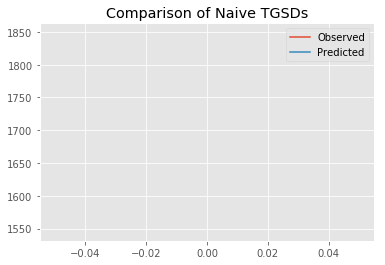

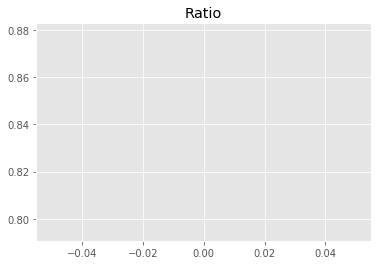

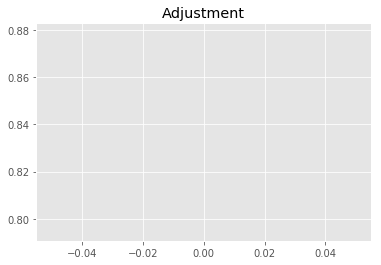

7798253094.723931
1


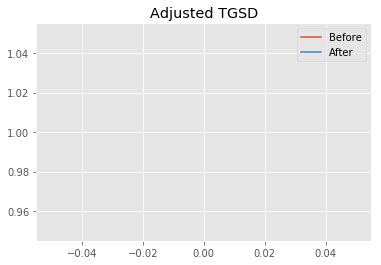

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95999 	1.9116 	24012.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.94548 	1.94147 	22101.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.1329
New Misfit: 22.5939
Convergence:
0.023298408977864903

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.81e+03 	1.55e+03 	0.8521 		1.0000


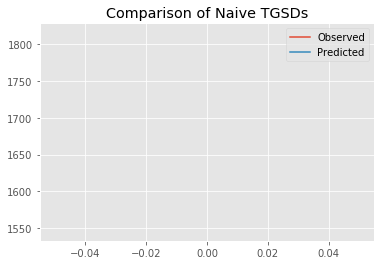

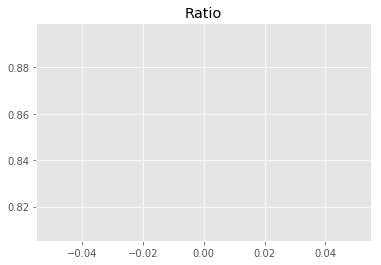

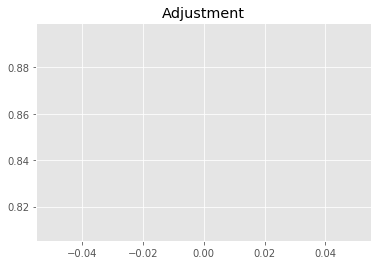

7941533155.316668
1


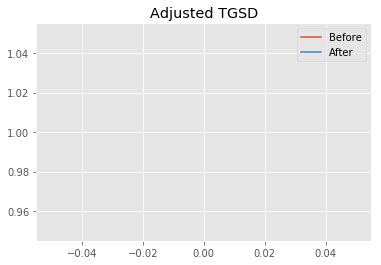

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.94548 	1.94147 	22101.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.84432 	2.10684 	22405.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.5939
New Misfit: 22.4864
Convergence:
0.004759059665882496

____________________
a = 1.84432	b = 2.10684	            h1 = 22405.73152	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.48637485051208
Prior Misfit: 415.335,	 Post Misfit: 22.4864


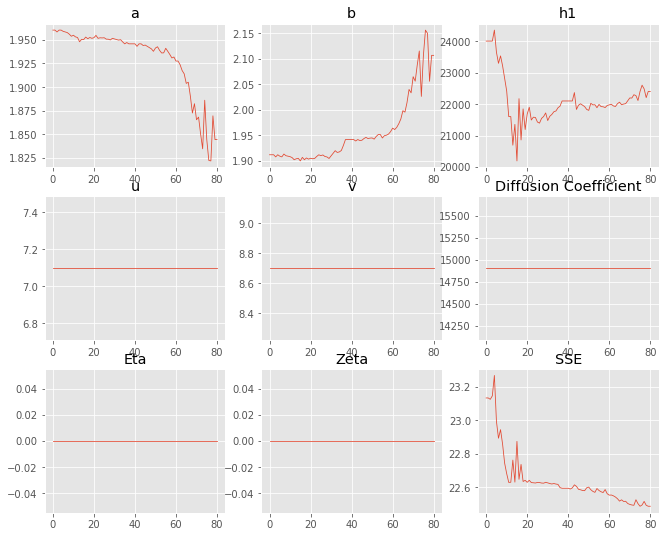

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.95999,1.84432
b,1.9116,2.10684
eta,0,0
ftt,"6,458","6,458"
h1,"24,012.3","22,405.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 2 Time: 0.049 minutes


Estimated remaining run time: 0.763 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.81e+03 	1.55e+03 	0.8523 		1.0000


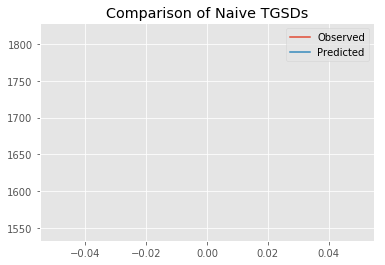

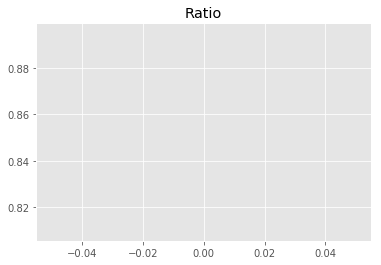

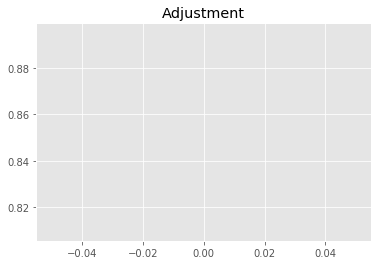

7943508379.289002
1


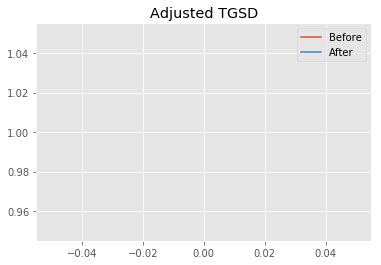

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.87085 	4.08138 	40219.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.86561 	5.00701 	40030.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.5159
New Misfit: 21.769
Convergence:
0.03316943410579376

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.77e+03 	1.55e+03 	0.8714 		1.0000


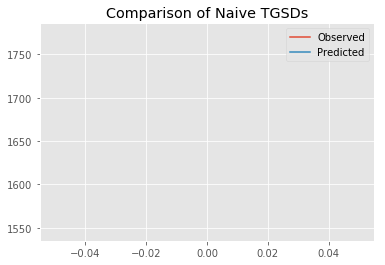

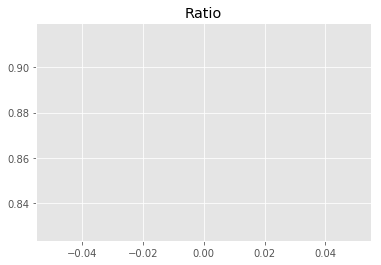

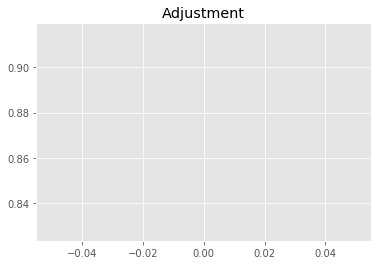

8121606936.098467
1


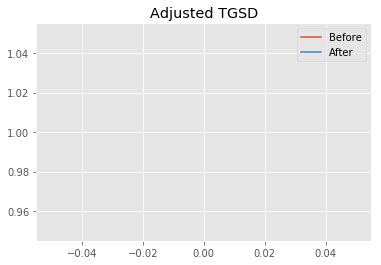

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.86561 	5.00701 	40030.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.67932 	5.15245 	44111.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.769
New Misfit: 21.5281
Convergence:
0.011067117927673457

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8786 		1.0000


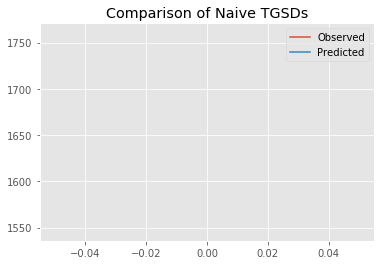

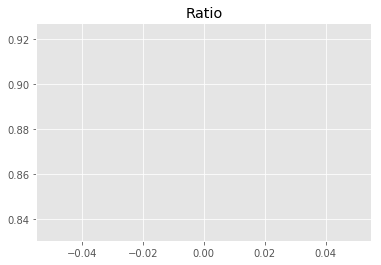

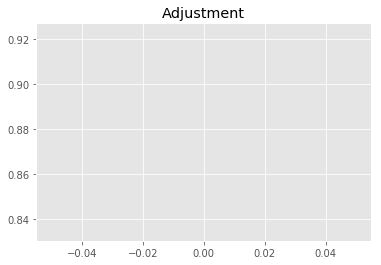

8188073709.256263
1


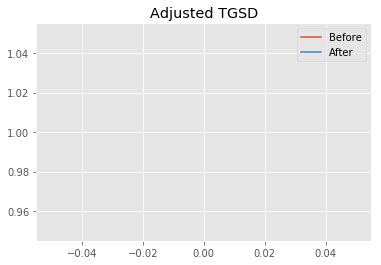

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.67932 	5.15245 	44111.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.25477 	3.59631 	44914.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.5281
New Misfit: 21.0112
Convergence:
0.02400978159335545

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.75e+03 	1.55e+03 	0.8853 		1.0000


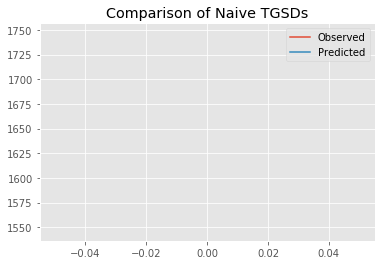

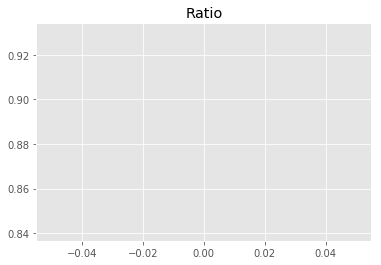

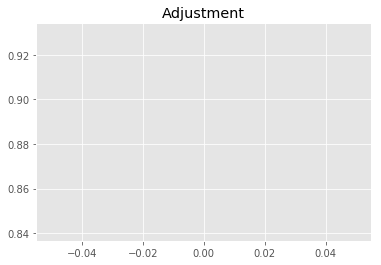

8251068315.789106
1


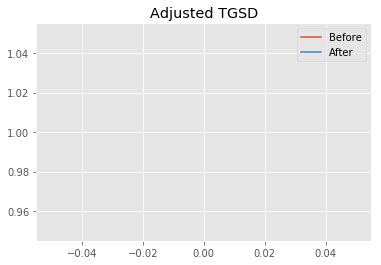

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.25477 	3.59631 	44914.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.05215 	2.97636 	44044.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.0112
New Misfit: 20.7662
Convergence:
0.01166455603984627

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8941 		1.0000


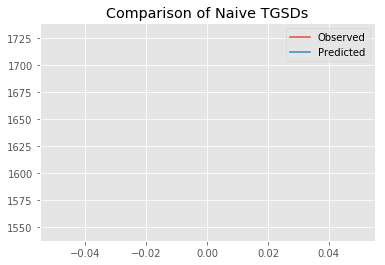

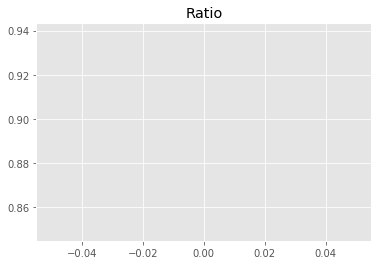

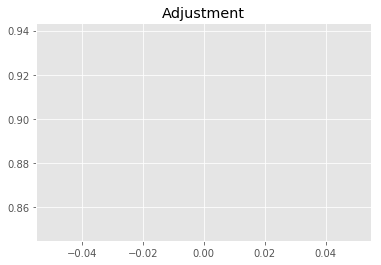

8332518370.785646
1


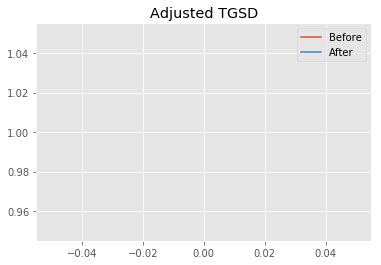

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05215 	2.97636 	44044.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00055 	2.86592 	44841.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7662
New Misfit: 20.6872
Convergence:
0.0038004810363839476

____________________
a = 1.00055	b = 2.86592	            h1 = 44841.88284	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 20.687232980943328
Prior Misfit: 396.272,	 Post Misfit: 20.6872


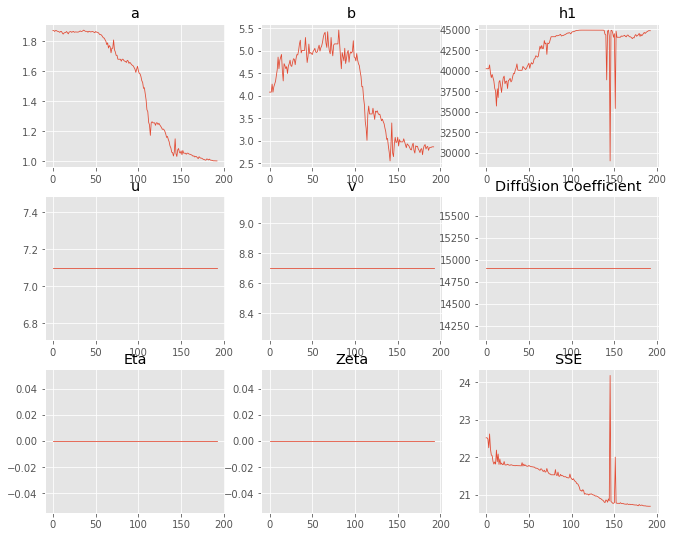

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.87085,1.00055
b,4.08138,2.86592
eta,0,0
ftt,"6,458","6,458"
h1,"40,219.2","44,841.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 3 Time: 0.102 minutes


Estimated remaining run time: 0.947 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8033 		1.0000


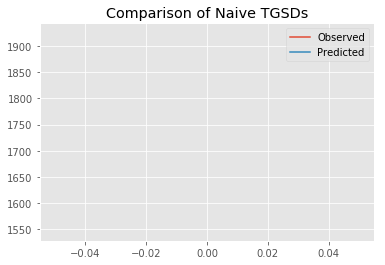

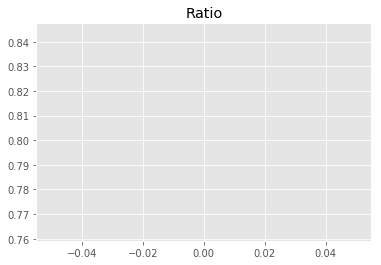

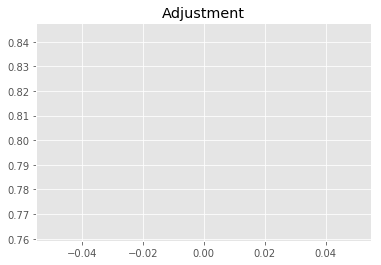

7486726798.036159
1


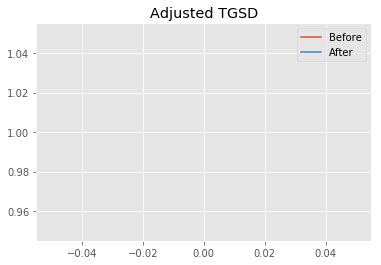

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.17584 	2.7194 	25615.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.48833 	3.29159 	35650.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 26.8081
New Misfit: 21.4564
Convergence:
0.19963182852143738

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.77e+03 	1.55e+03 	0.8756 		1.0000


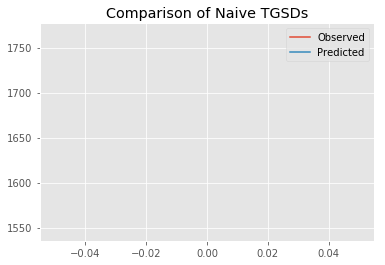

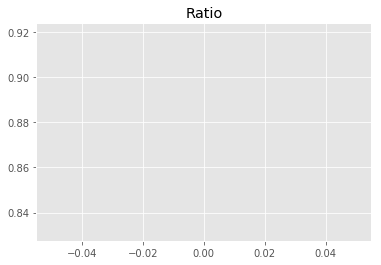

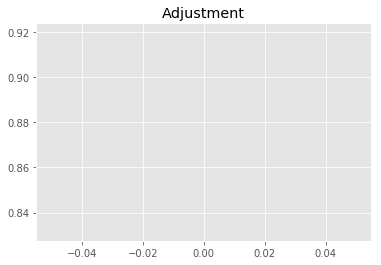

8160747216.902573
1


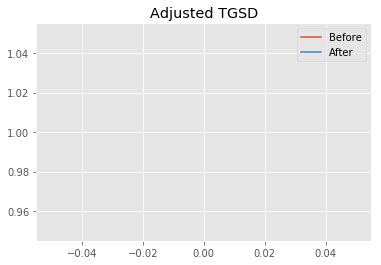

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.48833 	3.29159 	35650.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.02286 	2.49032 	40357.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.4564
New Misfit: 20.7923
Convergence:
0.030951233838375627

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.74e+03 	1.55e+03 	0.8901 		1.0000


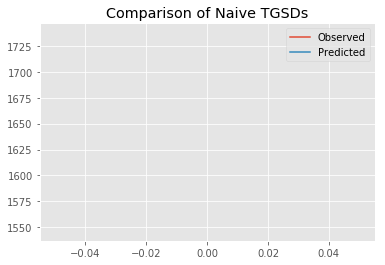

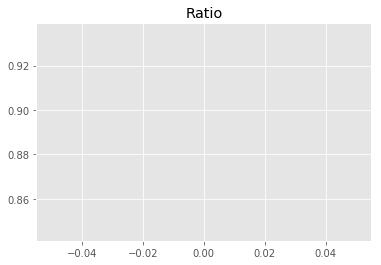

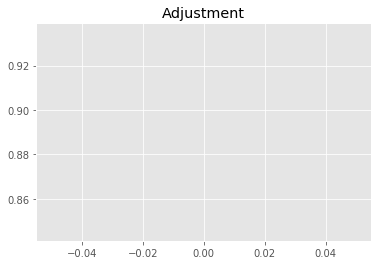

8295238574.401075
1


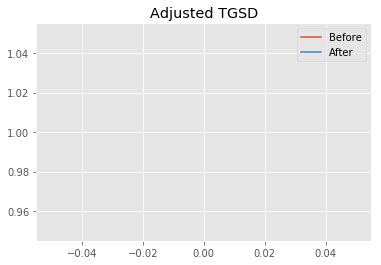

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02286 	2.49032 	40357.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00727 	2.77347 	43192.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7923
New Misfit: 20.7207
Convergence:
0.0034425648360763123

____________________
a = 1.00727	b = 2.77347	            h1 = 43192.90593	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.720707542041815
Prior Misfit: 488.127,	 Post Misfit: 20.7207


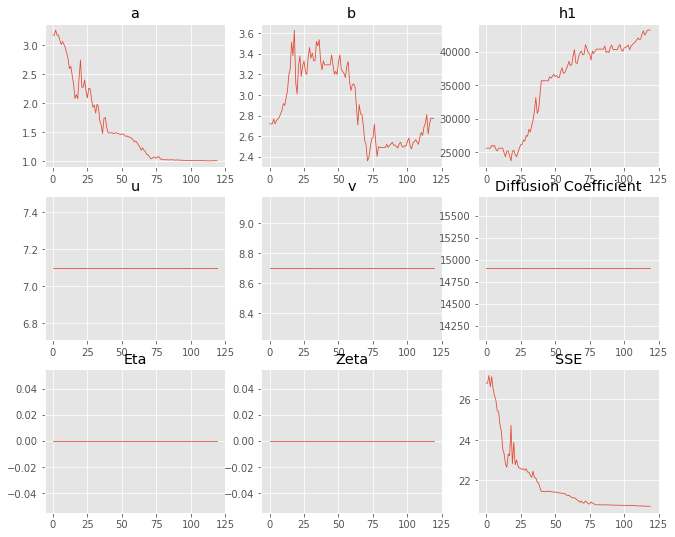

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.17584,1.00727
b,2.7194,2.77347
eta,0,0
ftt,"6,458","6,458"
h1,"25,615.1","43,192.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 4 Time: 0.067 minutes


Estimated remaining run time: 0.911 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8923 		1.0000


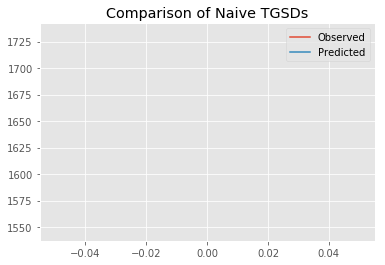

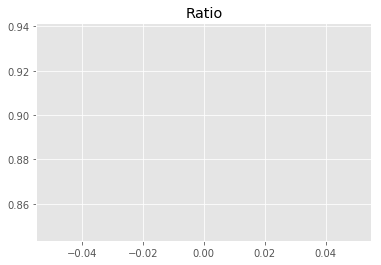

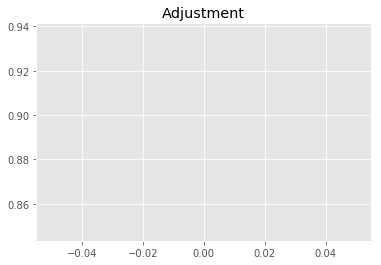

8316368068.019976
1


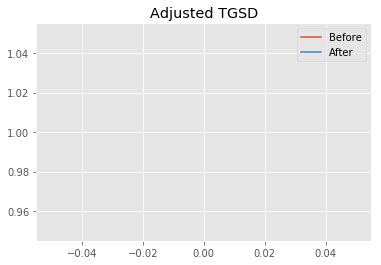

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.5337 	4.39429 	24855.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.07598 	4.35378 	31889.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.9593
New Misfit: 22.2447
Convergence:
0.07156312738134554

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.77e+03 	1.55e+03 	0.8721 		1.0000


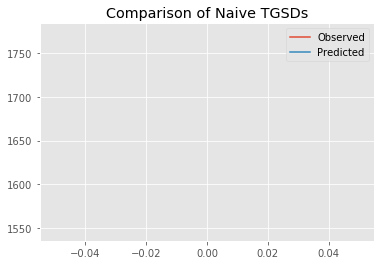

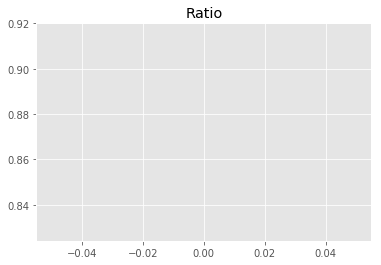

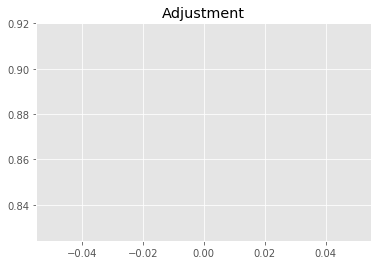

8127527560.017445
1


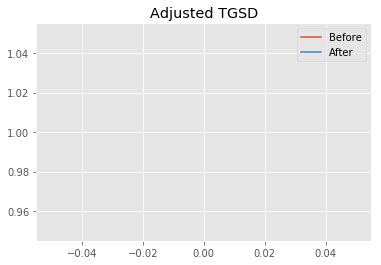

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.07598 	4.35378 	31889.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.05166 	5.02582 	37169 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.2447
New Misfit: 22.0024
Convergence:
0.010889502434451642

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.78e+03 	1.55e+03 	0.8671 		1.0000


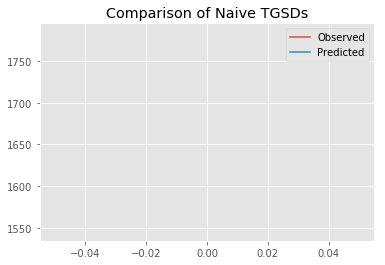

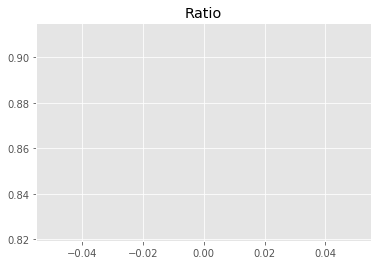

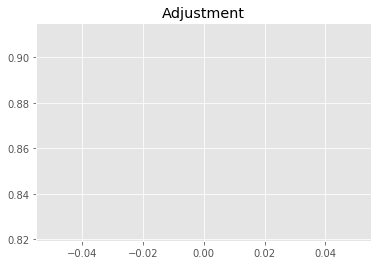

8081363949.087852
1


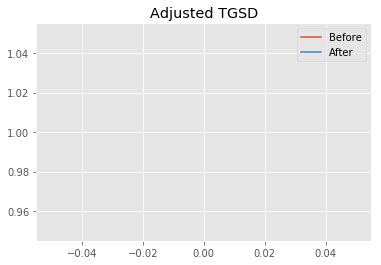

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.05166 	5.02582 	37169 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.99077 	6.00017 	43727.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.0024
New Misfit: 21.8316
Convergence:
0.007765191025320171

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.78e+03 	1.55e+03 	0.8695 		1.0000


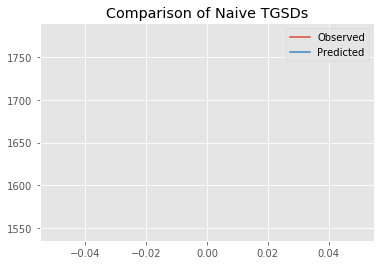

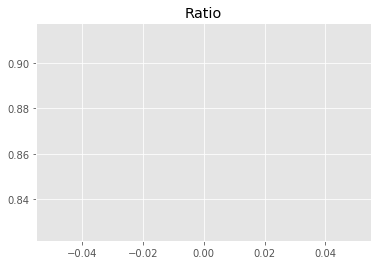

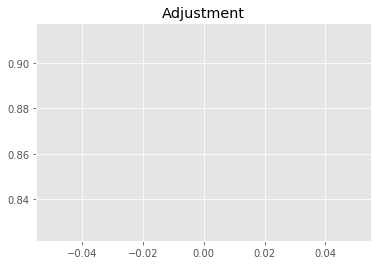

8104015533.351897
1


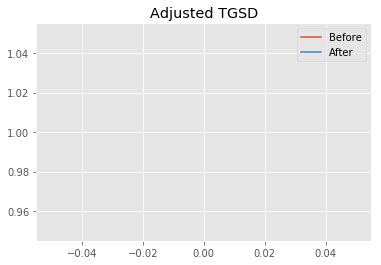

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.99077 	6.00017 	43727.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.99155 	6.20664 	44756.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8316
New Misfit: 21.818
Convergence:
0.000623812361312614

____________________
a = 1.99155	b = 6.20664	            h1 = 44756.87149	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 21.817962058645257
Prior Misfit: 530.474,	 Post Misfit: 21.818


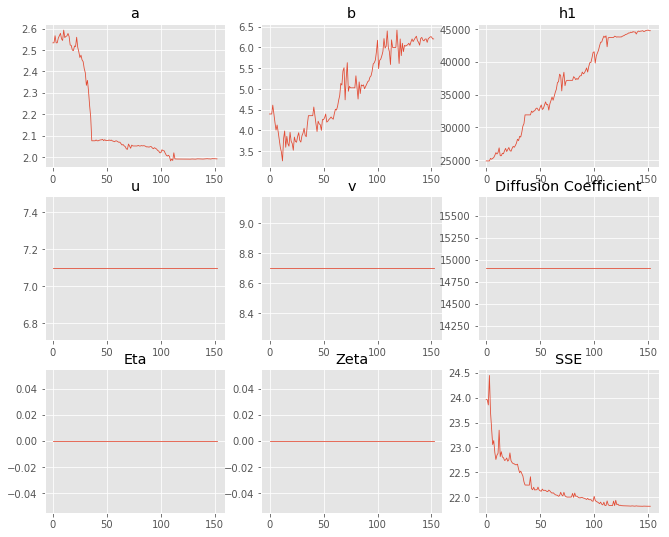

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.5337,1.99155
b,4.39429,6.20664
eta,0,0
ftt,"6,458","6,458"
h1,"24,855.1","44,756.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 5 Time: 0.083 minutes


Estimated remaining run time: 0.903 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.79e+03 	1.55e+03 	0.8631 		1.0000


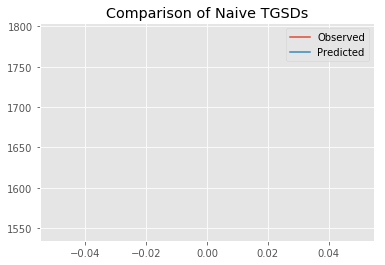

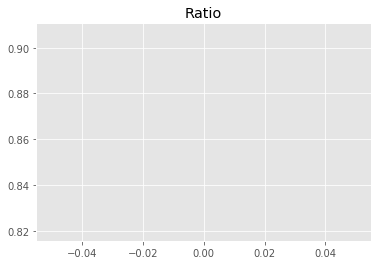

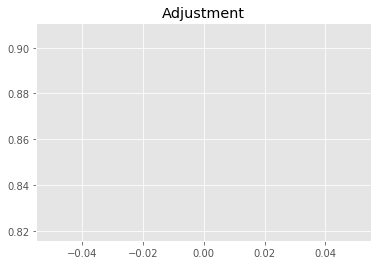

8044313126.897526
1


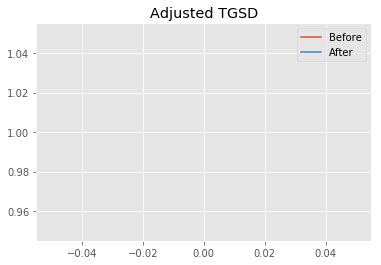

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.45865 	4.52683 	29526.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.07138 	2.98928 	44681.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.5693
New Misfit: 20.7853
Convergence:
0.0790426634483411

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8917 		1.0000


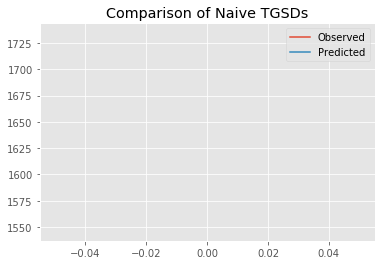

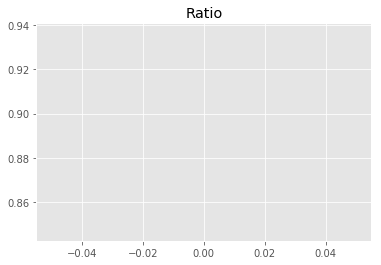

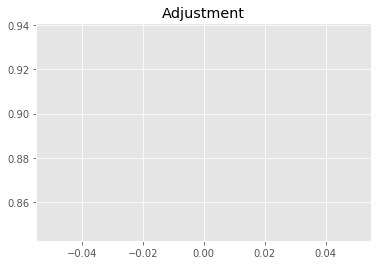

8309988052.092059
1


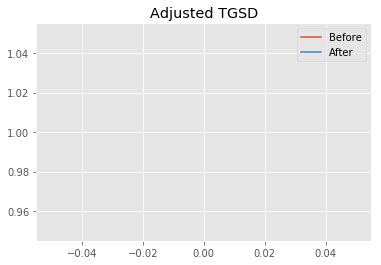

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.07138 	2.98928 	44681.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00444 	2.80776 	44567.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7853
New Misfit: 20.6964
Convergence:
0.004280802573453935

____________________
a = 1.00444	b = 2.80776	            h1 = 44567.29497	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 20.696350971824053
Prior Misfit: 431.479,	 Post Misfit: 20.6964


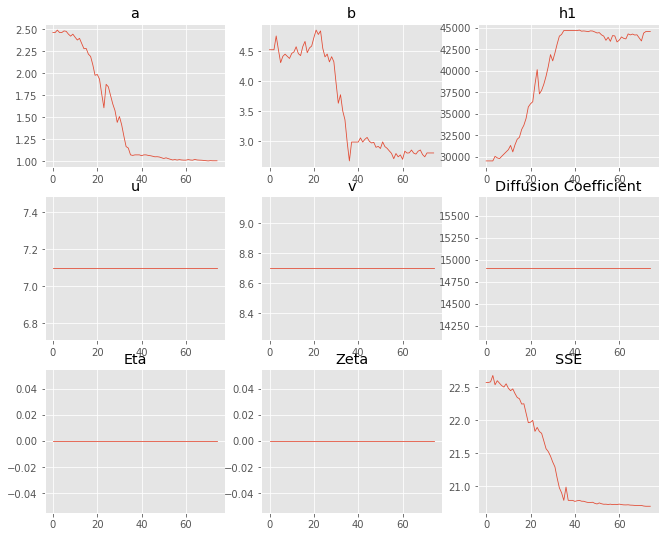

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.45865,1.00444
b,4.52683,2.80776
eta,0,0
ftt,"6,458","6,458"
h1,"29,526.8","44,567.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 6 Time: 0.046 minutes


Estimated remaining run time: 0.804 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.83e+03 	1.55e+03 	0.8459 		1.0000


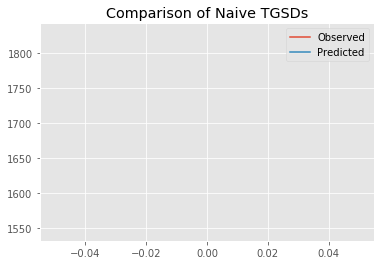

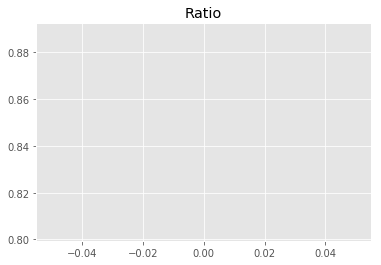

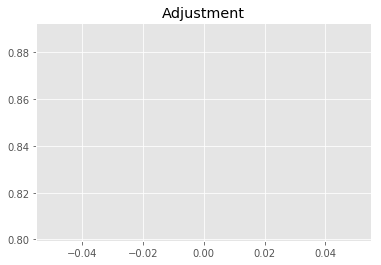

7883947822.307774
1


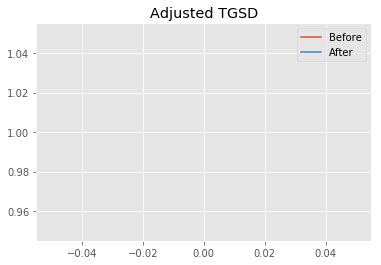

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.56708 	4.154 	29537.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.15552 	3.64675 	43759 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.8442
New Misfit: 21.1319
Convergence:
0.07495590193933403

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.72e+03 	1.55e+03 	0.8987 		1.0000


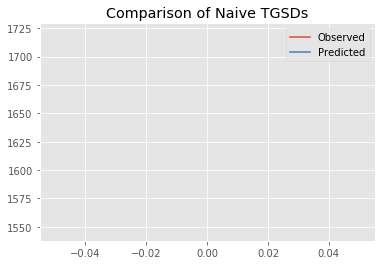

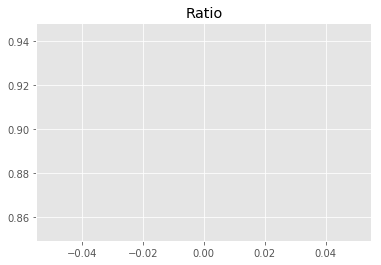

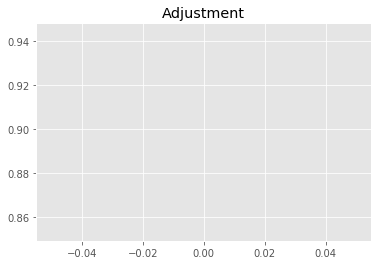

8375889209.494023
1


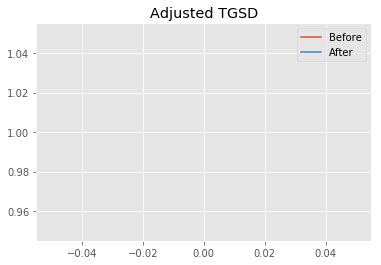

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.15552 	3.64675 	43759 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.01071 	2.71673 	42534.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.1319
New Misfit: 20.7335
Convergence:
0.01885507598997747

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8944 		1.0000


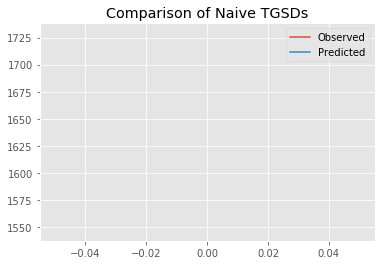

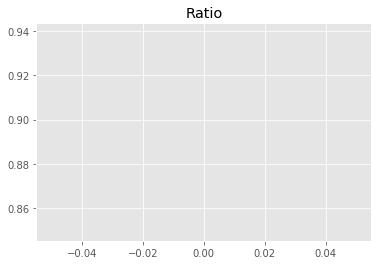

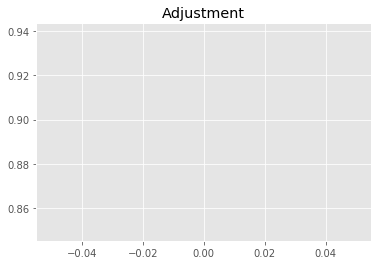

8335222713.118865
1


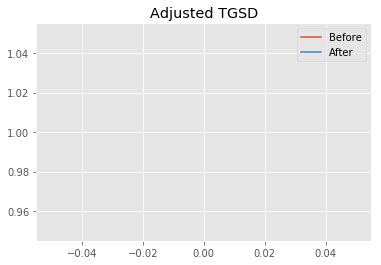

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01071 	2.71673 	42534.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00024 	2.86654 	44847.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7335
New Misfit: 20.6868
Convergence:
0.0022486602043854625

____________________
a = 1.00024	b = 2.86654	            h1 = 44847.85052	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.686837446616288
Prior Misfit: 418.916,	 Post Misfit: 20.6868


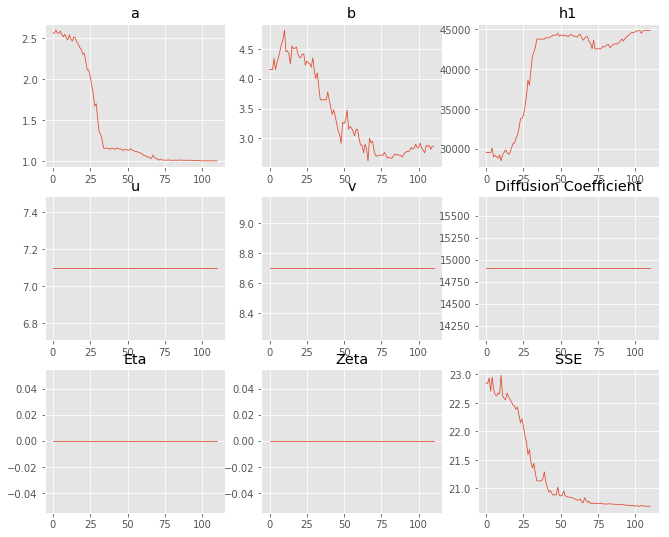

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.56708,1.00024
b,4.154,2.86654
eta,0,0
ftt,"6,458","6,458"
h1,"29,537.2","44,847.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 7 Time: 0.063 minutes


Estimated remaining run time: 0.744 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.94e+03 	1.55e+03 	0.7990 		1.0000


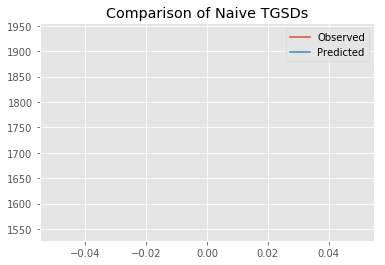

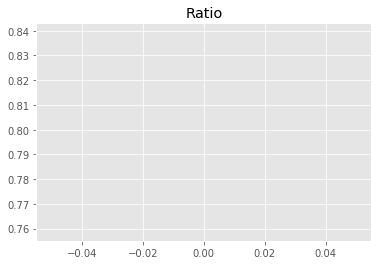

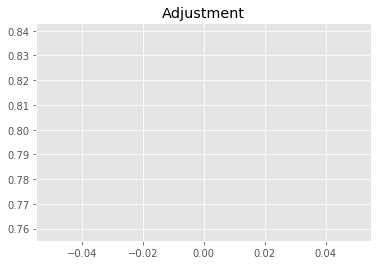

7446778357.055518
1


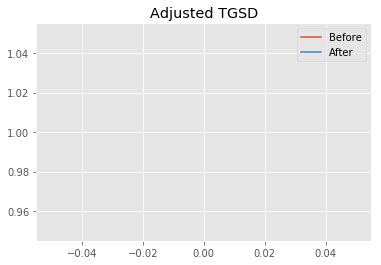

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.30324 	2.76423 	26184 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.23229 	3.49543 	39291.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 27.6595
New Misfit: 21.4149
Convergence:
0.2257673490718487

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.72e+03 	1.55e+03 	0.8968 		1.0000


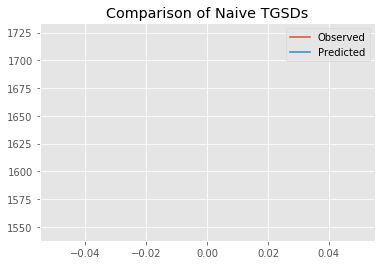

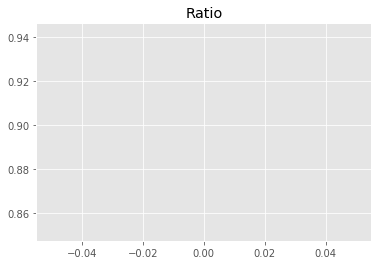

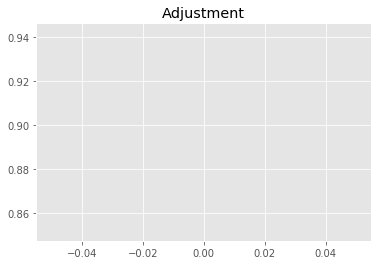

8357691666.4906025
1


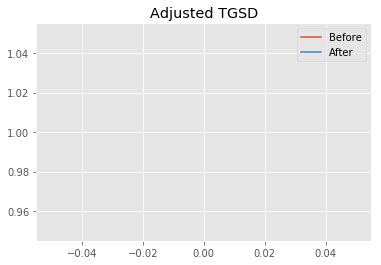

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.23229 	3.49543 	39291.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.02358 	2.70339 	43135.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.4149
New Misfit: 20.7502
Convergence:
0.031041666739272358

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8921 		1.0000


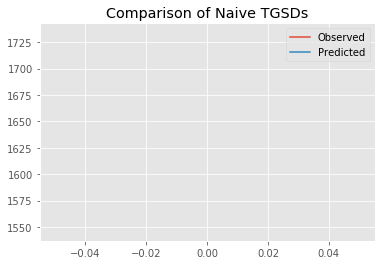

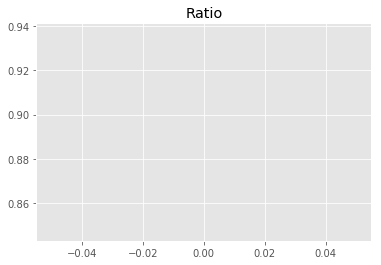

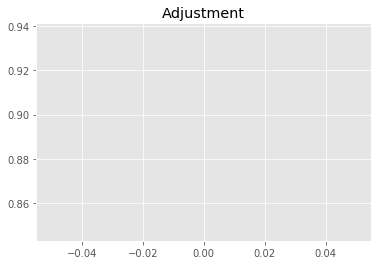

8314179256.805934
1


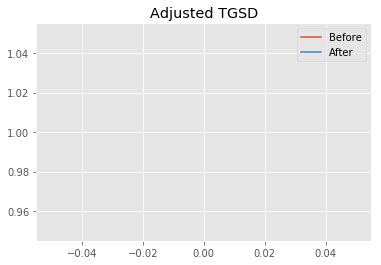

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02358 	2.70339 	43135.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00014 	2.84497 	44856.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7502
New Misfit: 20.6857
Convergence:
0.0031054931711262724

____________________
a = 1.00014	b = 2.84497	            h1 = 44856.62539	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.68572294820208
Prior Misfit: 508.595,	 Post Misfit: 20.6857


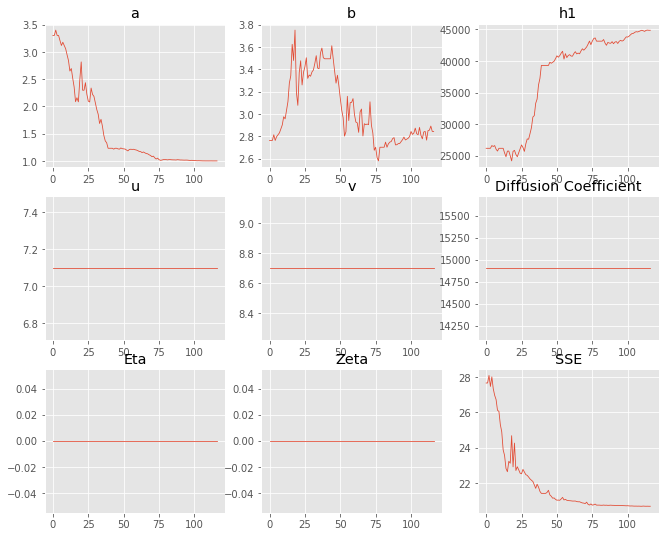

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.30324,1.00014
b,2.76423,2.84497
eta,0,0
ftt,"6,458","6,458"
h1,"26,184","44,856.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 8 Time: 0.065 minutes


Estimated remaining run time: 0.686 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8809 		1.0000


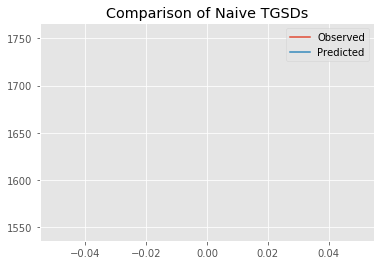

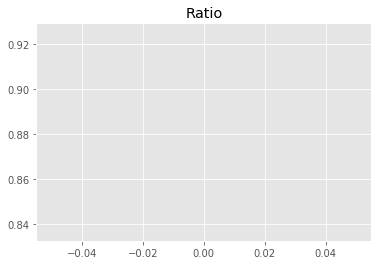

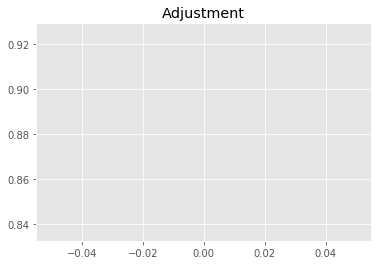

8210064223.388295
1


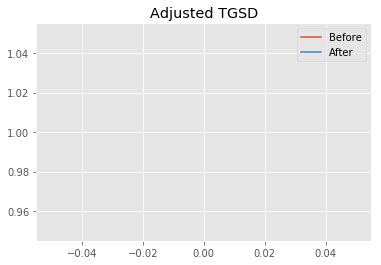

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.4335 	2.11077 	25060.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.08141 	1.88564 	32548.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.0786
New Misfit: 21.1267
Convergence:
0.043113033272836956

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8766 		1.0000


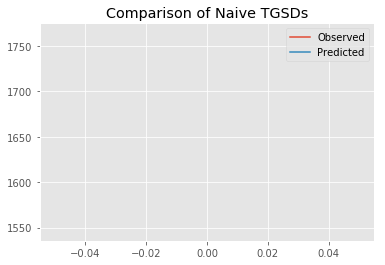

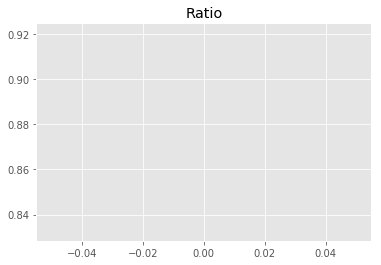

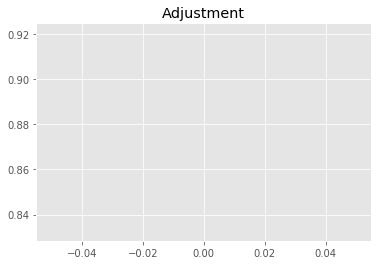

8169419841.458451
1


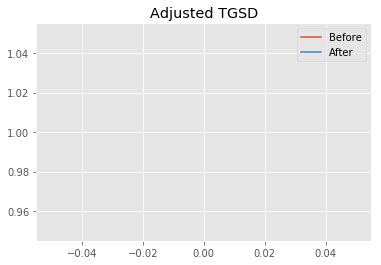

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.08141 	1.88564 	32548.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1 	2.4944 	40320.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.1267
New Misfit: 20.755
Convergence:
0.017594711143296745

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8926 		1.0000


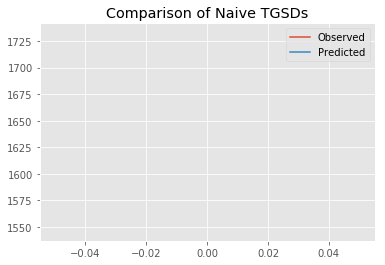

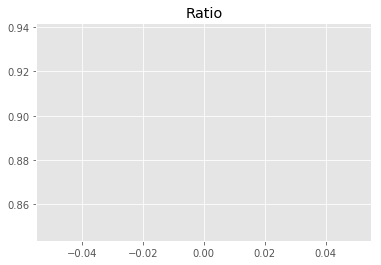

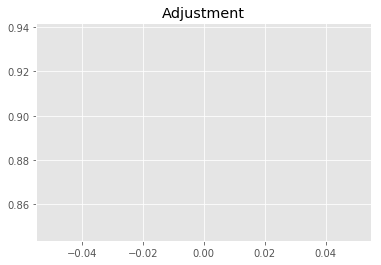

8319031831.551353
1


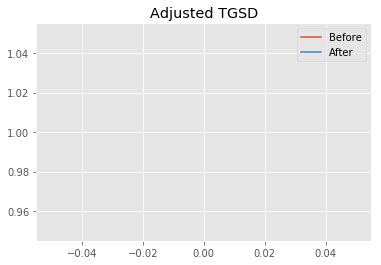

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.4944 	40320.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1 	2.8248 	44318.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.755
New Misfit: 20.6936
Convergence:
0.0029596013726604312

____________________
a = 1.00000	b = 2.82480	            h1 = 44318.39650	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.693599173437608
Prior Misfit: 421.543,	 Post Misfit: 20.6936


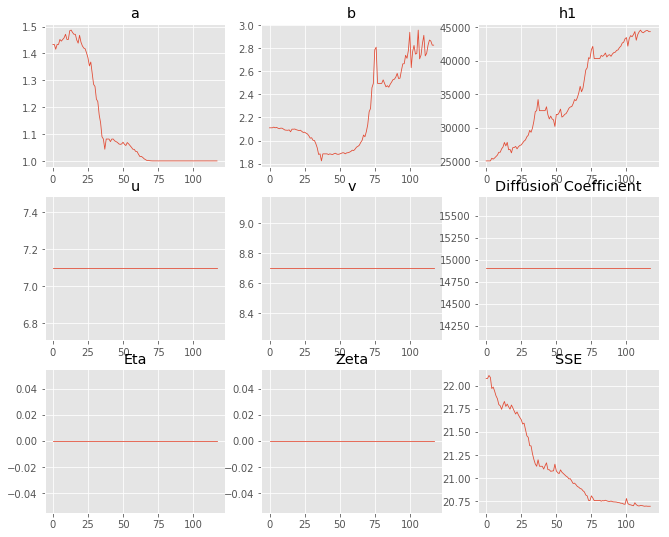

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.4335,1
b,2.11077,2.8248
eta,0,0
ftt,"6,458","6,458"
h1,"25,060.1","44,318.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 9 Time: 0.066 minutes


Estimated remaining run time: 0.627 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.85e+03 	1.55e+03 	0.8380 		1.0000


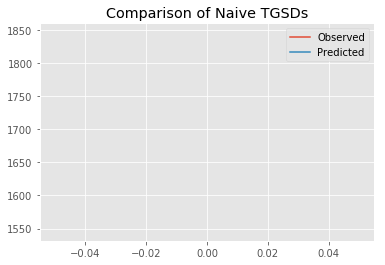

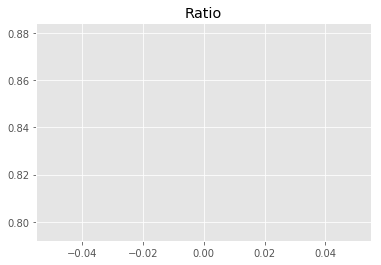

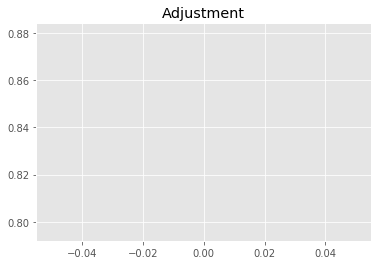

7809919733.080517
1


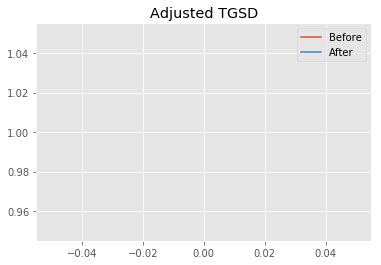

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.99472 	2.92992 	32239.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.9952 	3.30154 	29414.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.4765
New Misfit: 22.2021
Convergence:
0.05428139054651046

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.80e+03 	1.55e+03 	0.8588 		1.0000


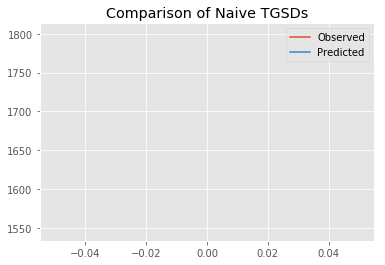

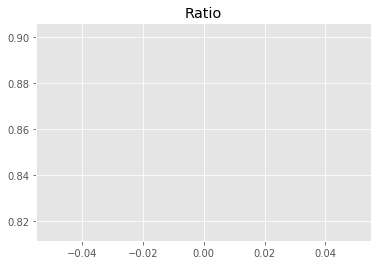

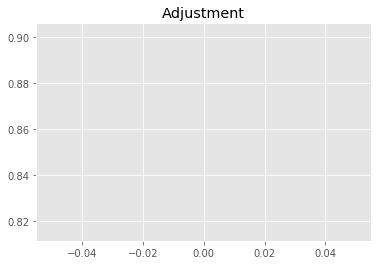

8003478372.58237
1


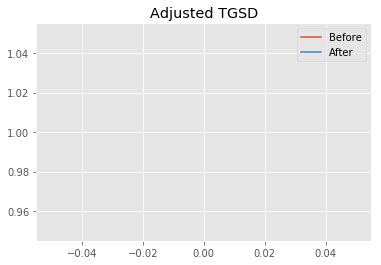

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.9952 	3.30154 	29414.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.99617 	5.06858 	38043.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.2021
New Misfit: 21.9351
Convergence:
0.012026023016851163

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.78e+03 	1.55e+03 	0.8691 		1.0000


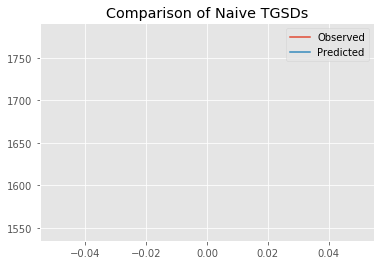

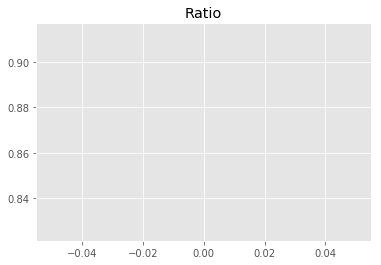

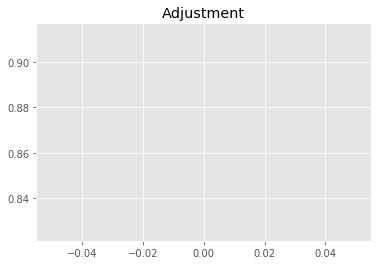

8099941149.062263
1


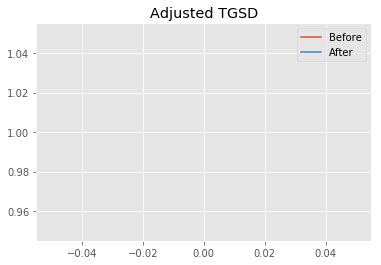

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.99617 	5.06858 	38043.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.99587 	6.0871 	43570.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.9351
New Misfit: 21.8422
Convergence:
0.004235591335561007

____________________
a = 1.99587	b = 6.08710	            h1 = 43570.91575	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 21.84222399271686
Prior Misfit: 414.161,	 Post Misfit: 21.8422


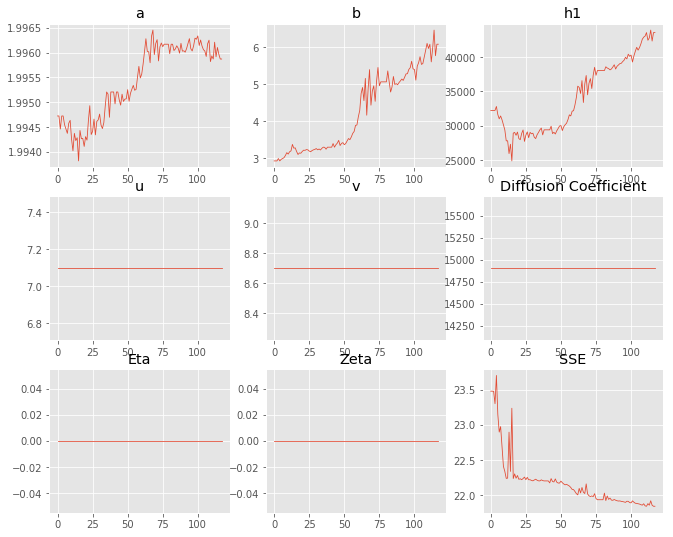

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.99472,1.99587
b,2.92992,6.0871
eta,0,0
ftt,"6,458","6,458"
h1,"32,239.6","43,570.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 10 Time: 0.065 minutes


Estimated remaining run time: 0.566 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.86e+03 	1.55e+03 	0.8299 		1.0000


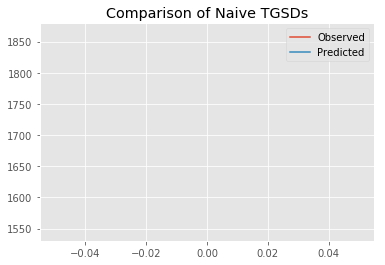

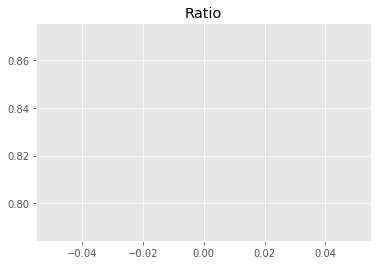

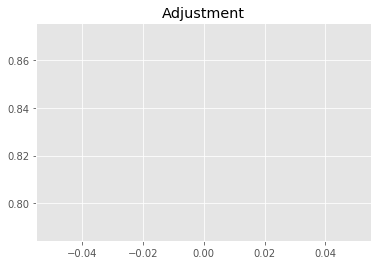

7734063728.154633
1


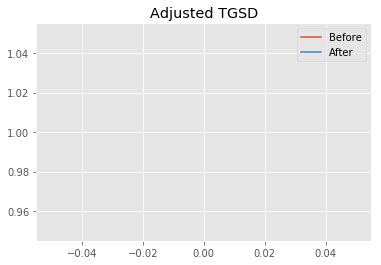

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.58362 	3.9574 	23994.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.11048 	2.92581 	41402.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.9771
New Misfit: 20.8823
Convergence:
0.12907375109848243

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.74e+03 	1.55e+03 	0.8903 		1.0000


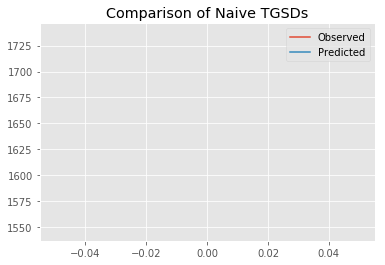

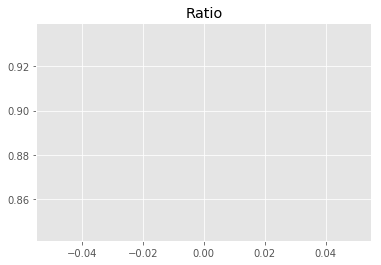

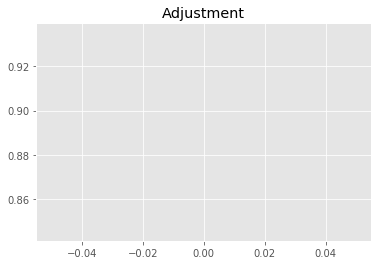

8297419751.923632
1


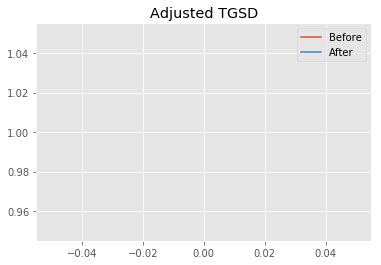

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.11048 	2.92581 	41402.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00825 	2.63519 	42358.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.8823
New Misfit: 20.7344
Convergence:
0.007079317794318493

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8929 		1.0000


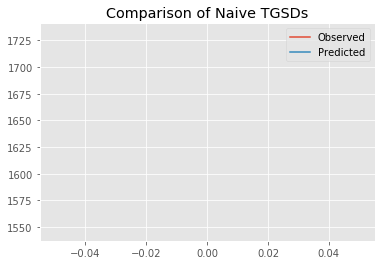

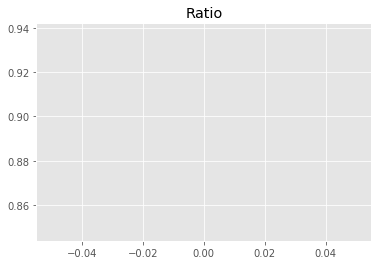

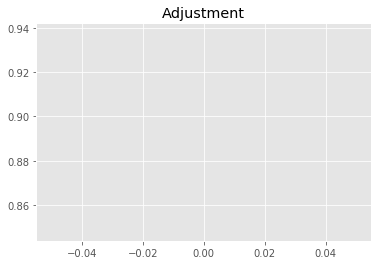

8321937035.29104
1


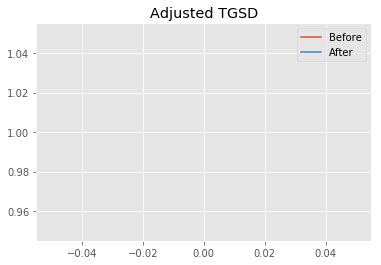

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00825 	2.63519 	42358.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1 	2.8506 	44732.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7344
New Misfit: 20.6876
Convergence:
0.002258571540236708

____________________
a = 1.00000	b = 2.85060	            h1 = 44732.57541	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.687616696112617
Prior Misfit: 447.667,	 Post Misfit: 20.6876


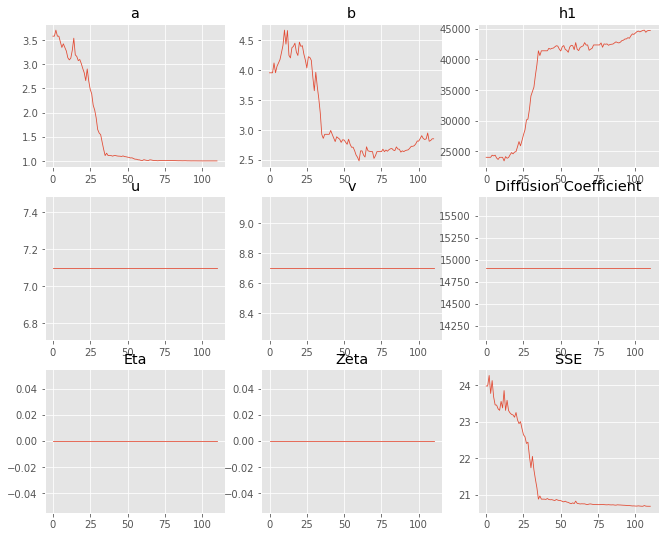

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.58362,1
b,3.9574,2.8506
eta,0,0
ftt,"6,458","6,458"
h1,"23,994.6","44,732.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 11 Time: 0.065 minutes


Estimated remaining run time: 0.505 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.75e+03 	1.55e+03 	0.8847 		1.0000


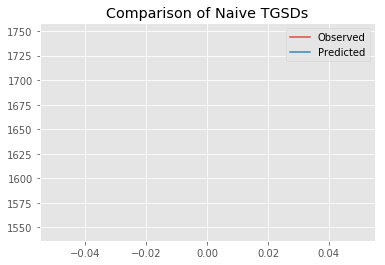

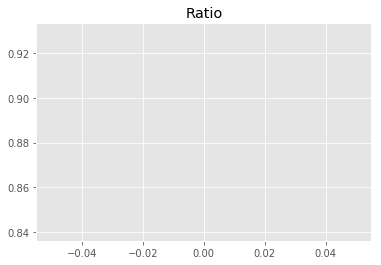

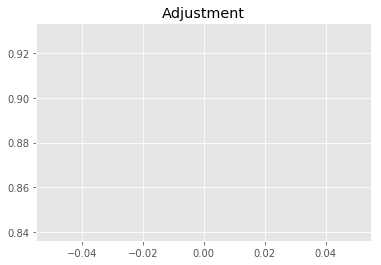

8245439010.89874
1


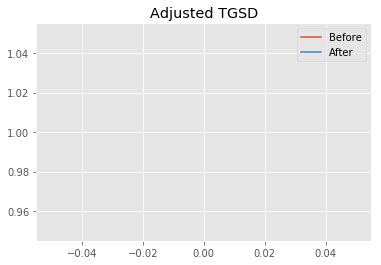

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.42487 	3.91789 	40491 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.10225 	2.60299 	37898 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.339
New Misfit: 20.9407
Convergence:
0.01866935278058403

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.74e+03 	1.55e+03 	0.8883 		1.0000


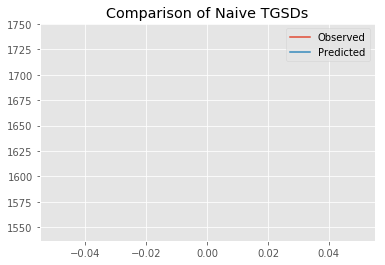

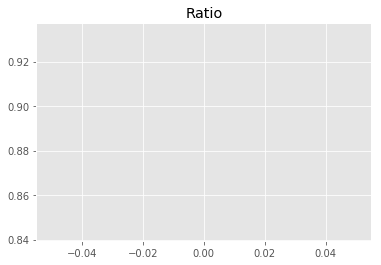

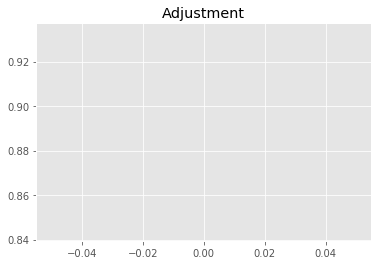

8279068314.933754
1


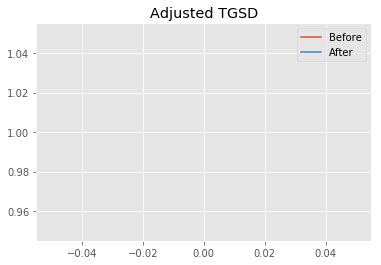

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.10225 	2.60299 	37898 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00504 	2.31947 	38794.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.9407
New Misfit: 20.7994
Convergence:
0.006745075955034446

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.74e+03 	1.55e+03 	0.8893 		1.0000


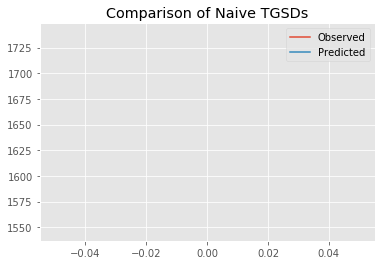

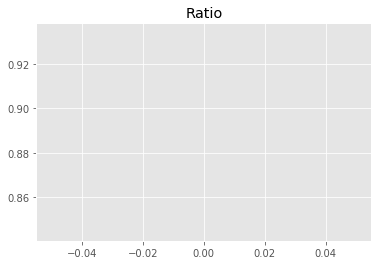

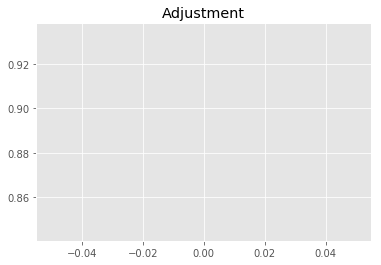

8287826155.021115
1


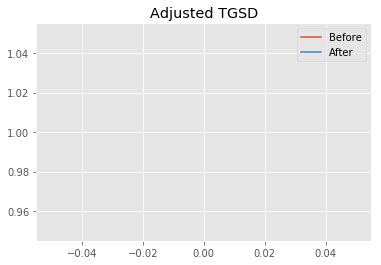

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00504 	2.31947 	38794.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00005 	2.71423 	43355.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7994
New Misfit: 20.7066
Convergence:
0.004464160094374116

____________________
a = 1.00005	b = 2.71423	            h1 = 43355.17973	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.70656156469163
Prior Misfit: 389.562,	 Post Misfit: 20.7066


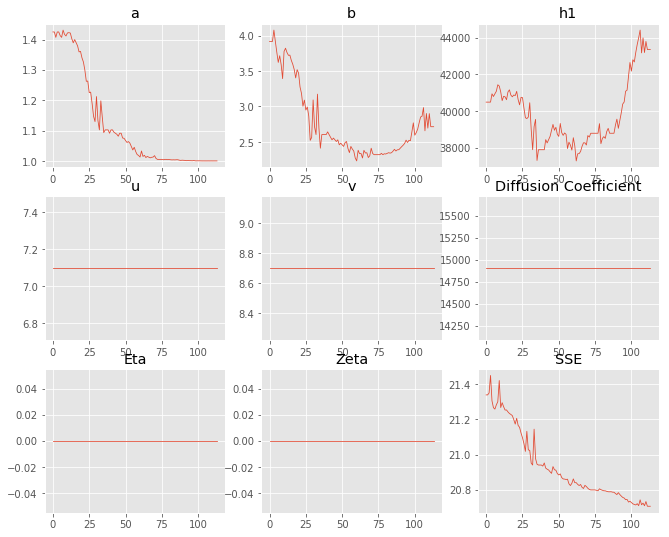

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.42487,1.00005
b,3.91789,2.71423
eta,0,0
ftt,"6,458","6,458"
h1,"40,491","43,355.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 12 Time: 0.064 minutes


Estimated remaining run time: 0.442 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8944 		1.0000


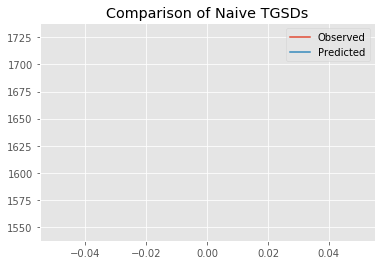

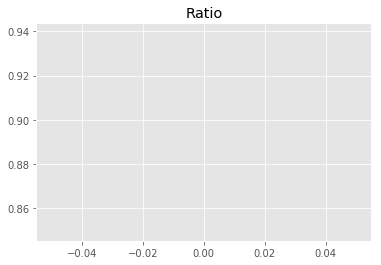

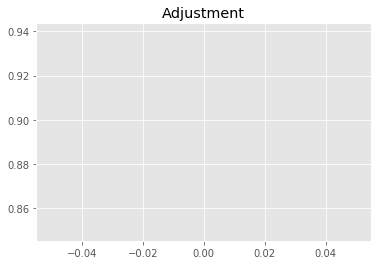

8336023877.882587
1


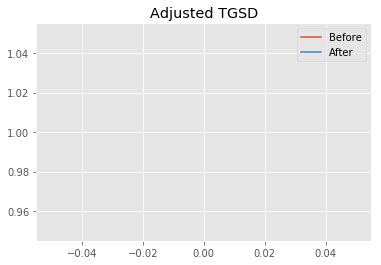

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.07025 	2.89648 	41017.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00024 	2.73805 	43736 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.8816
New Misfit: 20.7018
Convergence:
0.008610456977661161

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8947 		1.0000


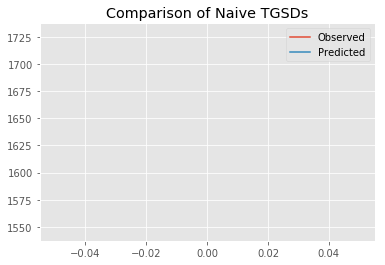

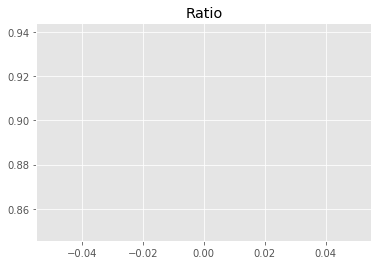

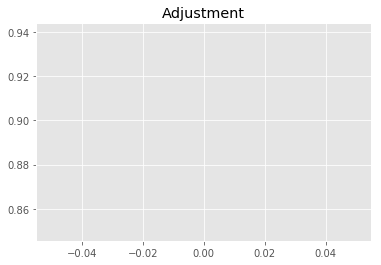

8338462427.457637
1


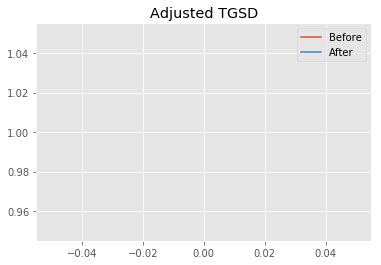

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00024 	2.73805 	43736 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00062 	2.86162 	44831.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7018
New Misfit: 20.6872
Convergence:
0.0007052520917533769

____________________
a = 1.00062	b = 2.86162	            h1 = 44831.13000	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 20.687211955582598
Prior Misfit: 375.964,	 Post Misfit: 20.6872


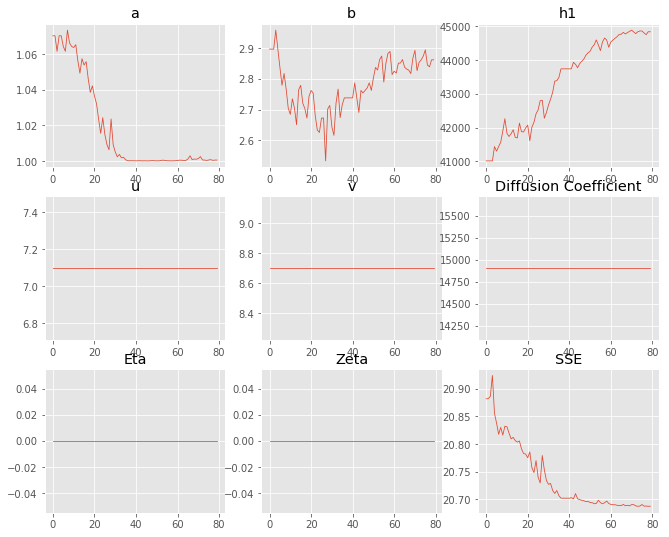

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.07025,1.00062
b,2.89648,2.86162
eta,0,0
ftt,"6,458","6,458"
h1,"41,017.2","44,831.1"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 13 Time: 0.049 minutes


Estimated remaining run time: 0.373 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.80e+03 	1.55e+03 	0.8590 		1.0000


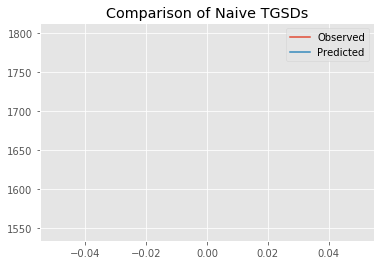

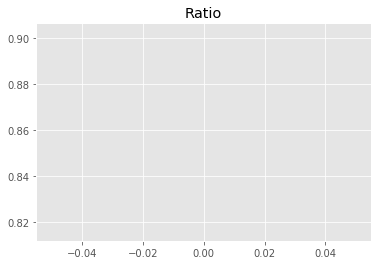

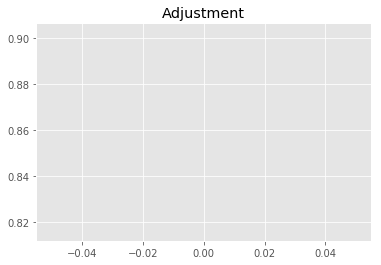

8005853916.861848
1


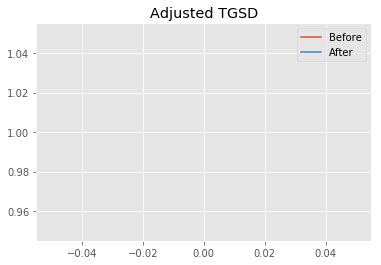

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19612 	1.09 	36627.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.02994 	1.42124 	27028.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 27.9256
New Misfit: 21.2588
Convergence:
0.23873421339892917

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.77e+03 	1.55e+03 	0.8733 		1.0000


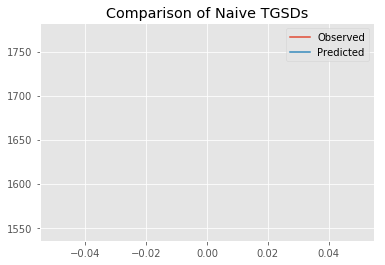

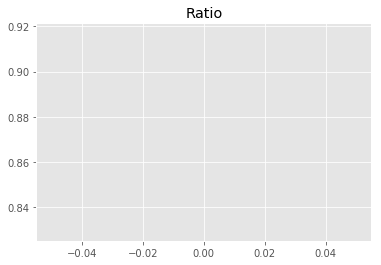

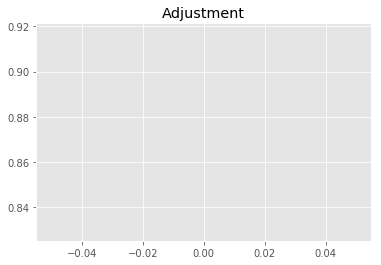

8138792699.522288
1


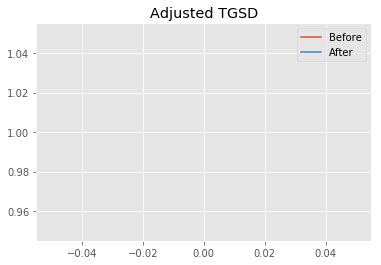

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02994 	1.42124 	27028.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.03002 	2.11798 	34187.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.2588
New Misfit: 20.9415
Convergence:
0.014923694004212874

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.74e+03 	1.55e+03 	0.8873 		1.0000


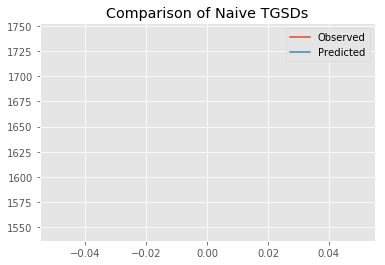

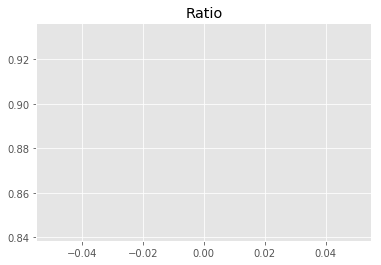

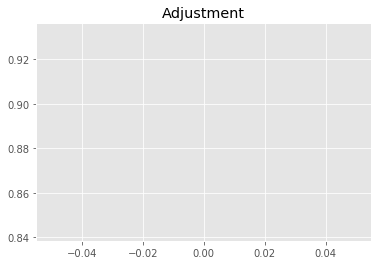

8269599379.804222
1


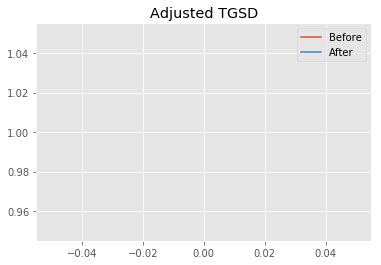

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03002 	2.11798 	34187.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00012 	2.13433 	36473.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.9415
New Misfit: 20.8429
Convergence:
0.004710237320632822

____________________
a = 1.00012	b = 2.13433	            h1 = 36473.41569	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.842904698306768
Prior Misfit: 520.939,	 Post Misfit: 20.8429


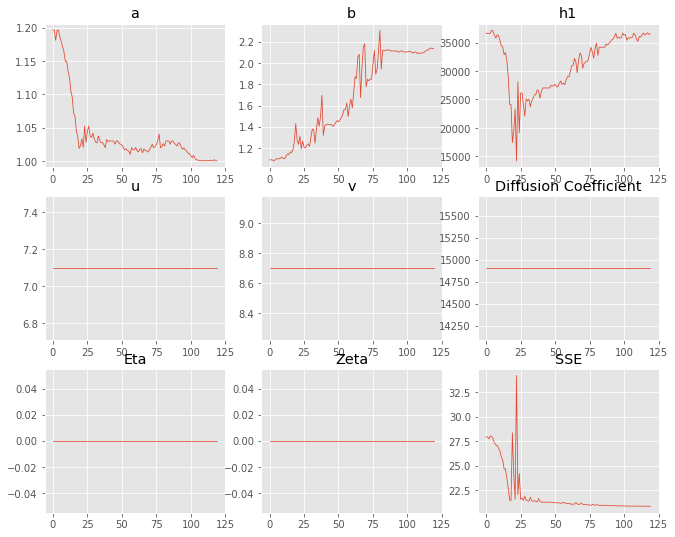

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.19612,1.00012
b,1.09,2.13433
eta,0,0
ftt,"6,458","6,458"
h1,"36,627.7","36,473.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 14 Time: 0.067 minutes


Estimated remaining run time: 0.313 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.93e+03 	1.55e+03 	0.8011 		1.0000


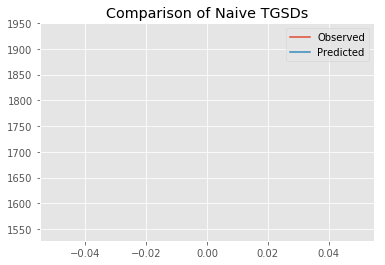

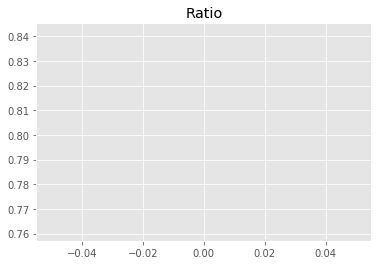

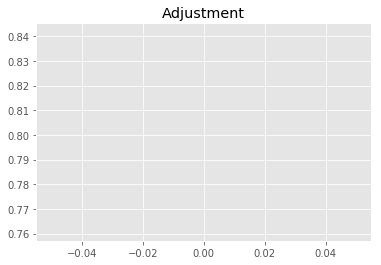

7466489736.830626
1


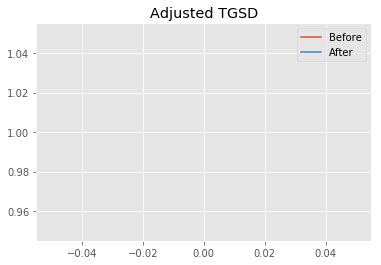

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.29914 	3.71624 	33177.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.28761 	5.19703 	34772.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 29.2291
New Misfit: 22.2641
Convergence:
0.23828890947058065

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.79e+03 	1.55e+03 	0.8638 		1.0000


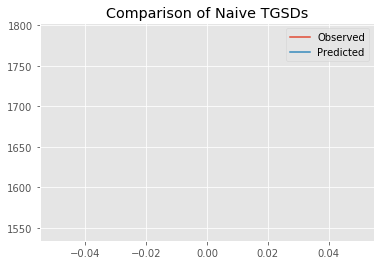

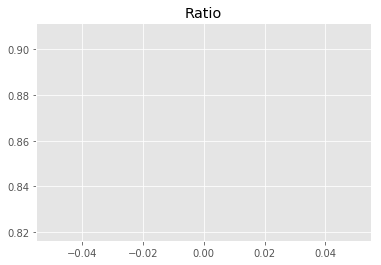

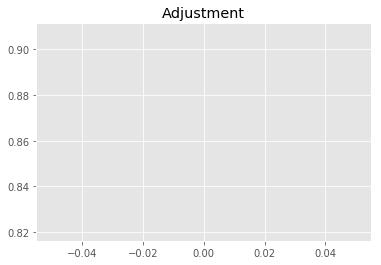

8049998005.280576
1


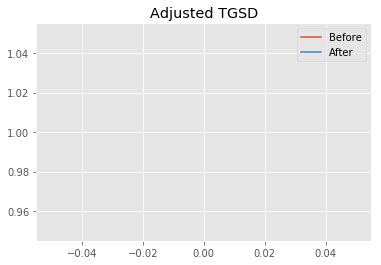

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.28761 	5.19703 	34772.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.76094 	5.51431 	44234 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.2641
New Misfit: 21.6269
Convergence:
0.02862208512820032

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8781 		1.0000


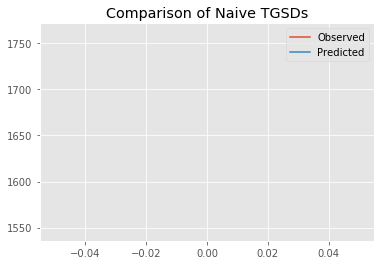

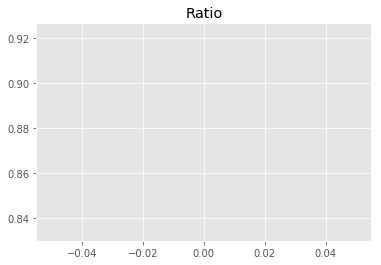

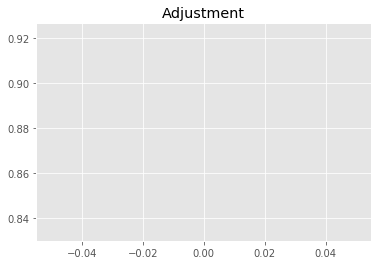

8183857334.522832
1


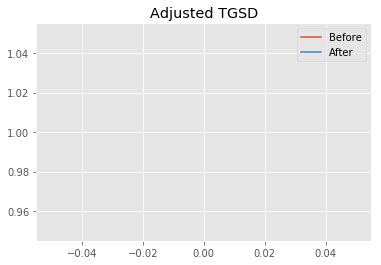

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.76094 	5.51431 	44234 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.39524 	3.5212 	41139.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.6269
New Misfit: 21.2678
Convergence:
0.016603599406451855

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8768 		1.0000


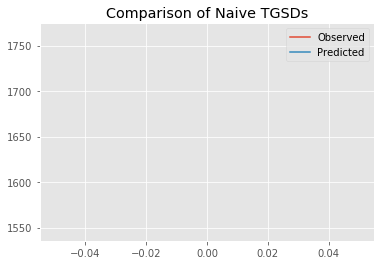

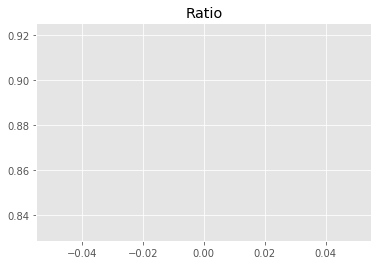

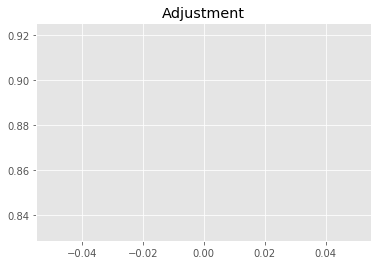

8171815165.911431
1


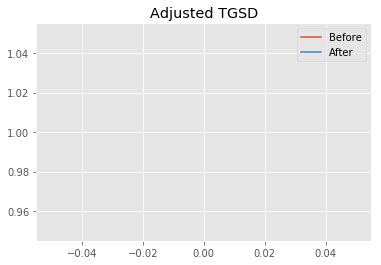

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.39524 	3.5212 	41139.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.05048 	2.50691 	37900.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.2678
New Misfit: 20.8845
Convergence:
0.01802251940099343

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.74e+03 	1.55e+03 	0.8910 		1.0000


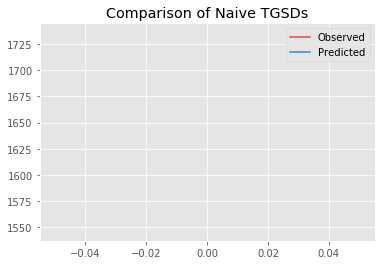

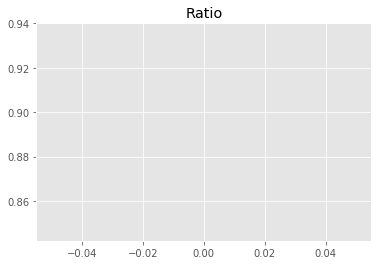

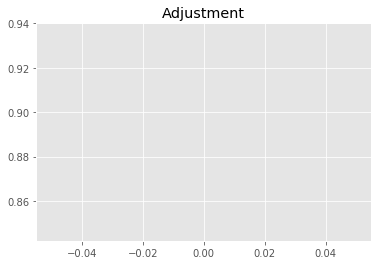

8304182510.002995
1


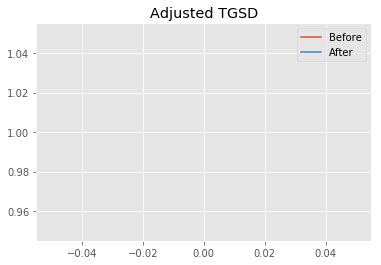

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05048 	2.50691 	37900.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00006 	2.65269 	43121.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.8845
New Misfit: 20.7156
Convergence:
0.00808721760425669

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8935 		1.0000


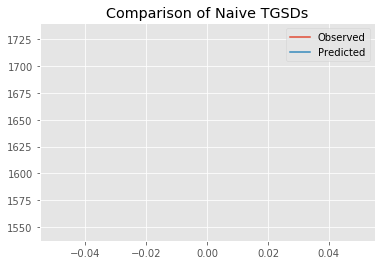

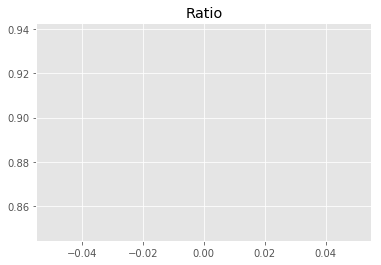

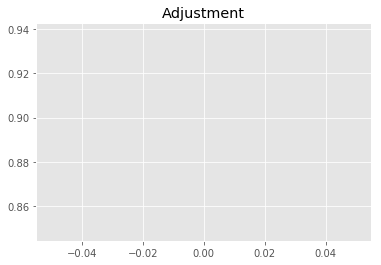

8326787747.881837
1


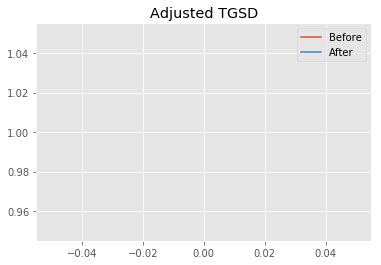

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00006 	2.65269 	43121.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00004 	2.85661 	44907.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7156
New Misfit: 20.6851
Convergence:
0.001474318211115968

____________________
a = 1.00004	b = 2.85661	            h1 = 44907.35285	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 20.68506968428757
Prior Misfit: 552.149,	 Post Misfit: 20.6851


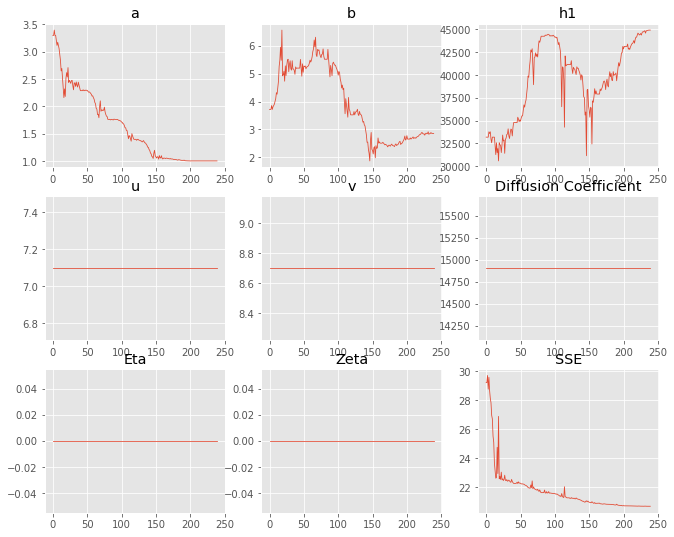

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.29914,1.00004
b,3.71624,2.85661
eta,0,0
ftt,"6,458","6,458"
h1,"33,177.7","44,907.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 15 Time: 0.125 minutes


Estimated remaining run time: 0.266 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.85e+03 	1.55e+03 	0.8341 		1.0000


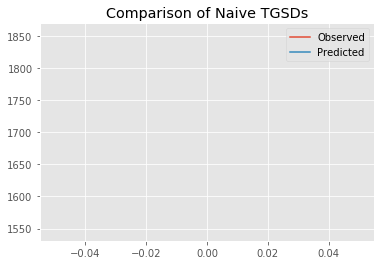

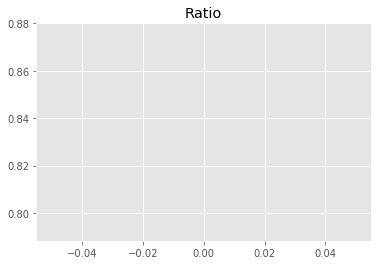

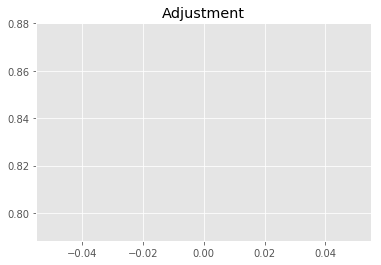

7773822002.132909
1


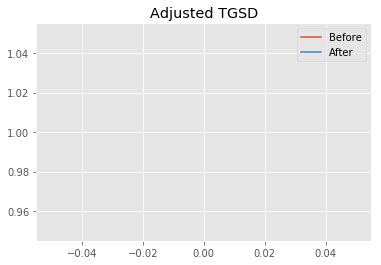

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.36264 	2.60092 	25254.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.86099 	3.05473 	28688.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.4031
New Misfit: 22.0752
Convergence:
0.056739702256813046

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.79e+03 	1.55e+03 	0.8642 		1.0000


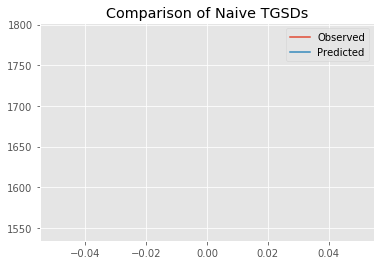

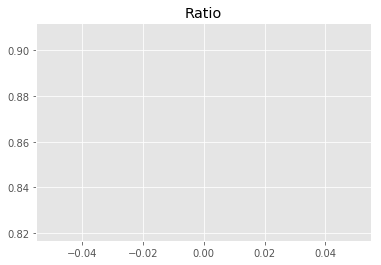

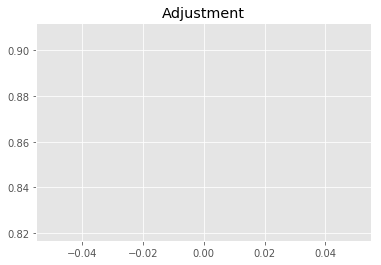

8054323996.398304
1


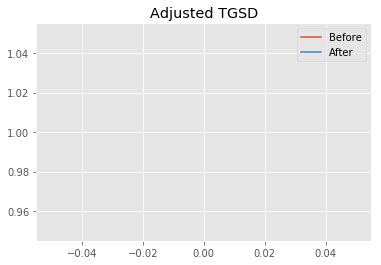

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.86099 	3.05473 	28688.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.46505 	3.89748 	41743.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.0752
New Misfit: 21.3113
Convergence:
0.034603910619053525

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8775 		1.0000


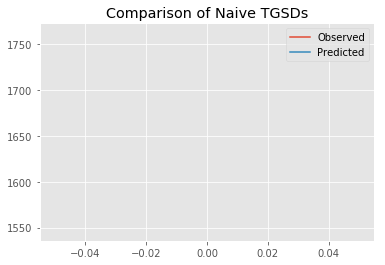

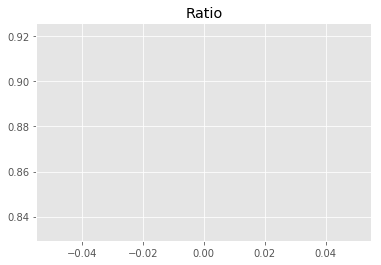

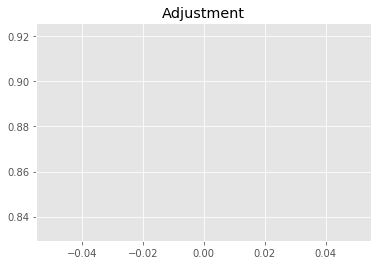

8178151134.384394
1


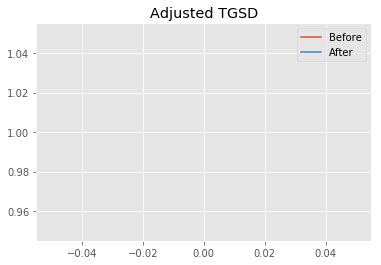

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.46505 	3.89748 	41743.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.03441 	2.78204 	44460 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.3113
New Misfit: 20.7667
Convergence:
0.025555439199736702

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8915 		1.0000


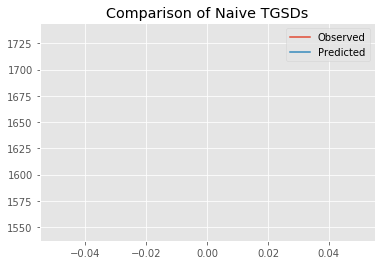

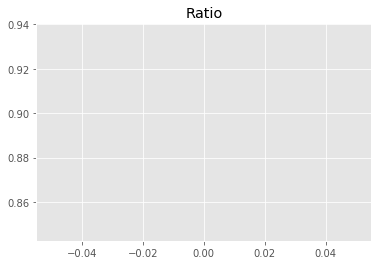

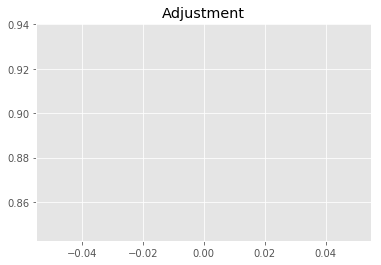

8308266997.352953
1


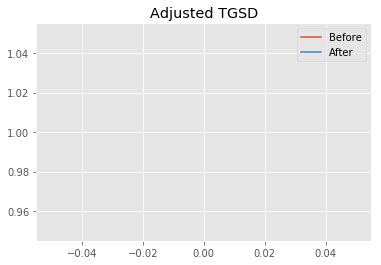

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03441 	2.78204 	44460 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00011 	2.82804 	44898.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7667
New Misfit: 20.6858
Convergence:
0.0038956194317950553

____________________
a = 1.00011	b = 2.82804	            h1 = 44898.72363	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 20.685808108404956
Prior Misfit: 422.576,	 Post Misfit: 20.6858


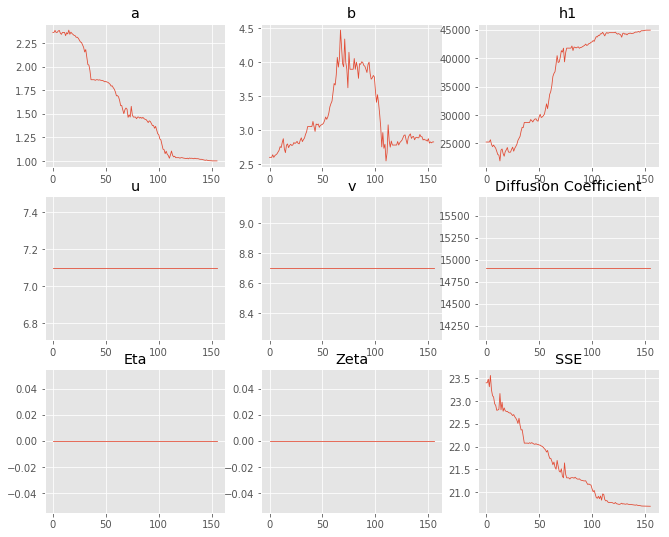

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.36264,1.00011
b,2.60092,2.82804
eta,0,0
ftt,"6,458","6,458"
h1,"25,254.3","44,898.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 16 Time: 0.084 minutes


Estimated remaining run time: 0.202 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.88e+03 	1.55e+03 	0.8245 		1.0000


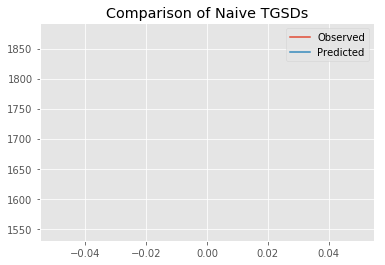

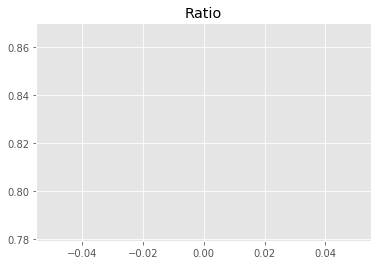

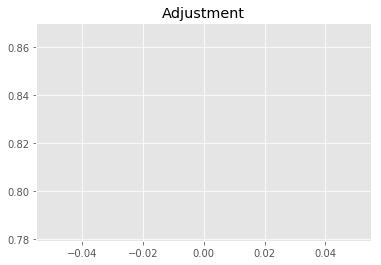

7684172621.255382
1


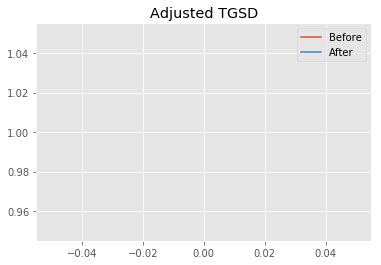

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.76224 	4.31133 	24998.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.5453 	3.22663 	33910.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.3118
New Misfit: 21.5695
Convergence:
0.11279566354968378

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.77e+03 	1.55e+03 	0.8741 		1.0000


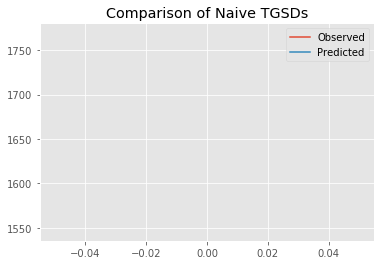

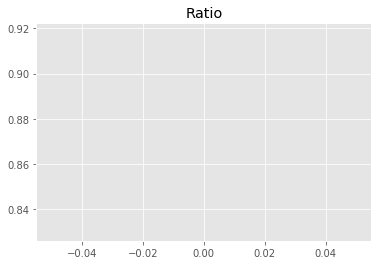

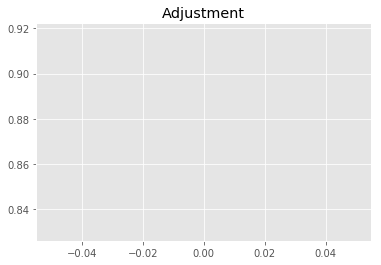

8146722863.048866
1


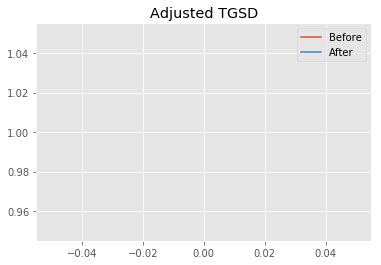

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.5453 	3.22663 	33910.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.03398 	2.73205 	41617.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.5695
New Misfit: 20.7814
Convergence:
0.03653661710140592

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8933 		1.0000


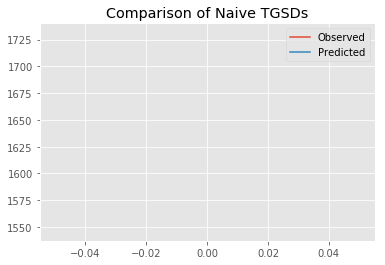

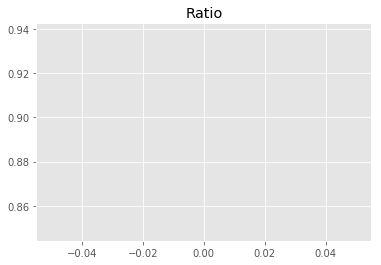

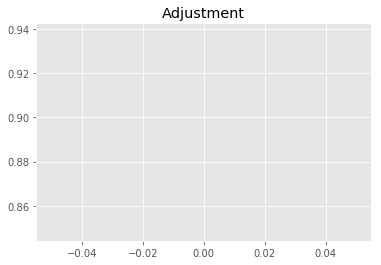

8325715120.606461
1


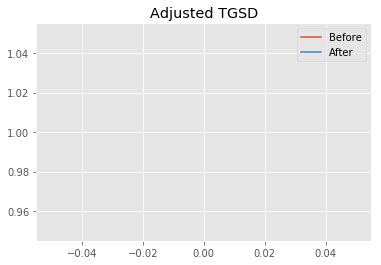

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03398 	2.73205 	41617.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00029 	2.8322 	44530.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7814
New Misfit: 20.6905
Convergence:
0.00437622653570657

____________________
a = 1.00029	b = 2.83220	            h1 = 44530.55285	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.690479042631104
Prior Misfit: 449.318,	 Post Misfit: 20.6905


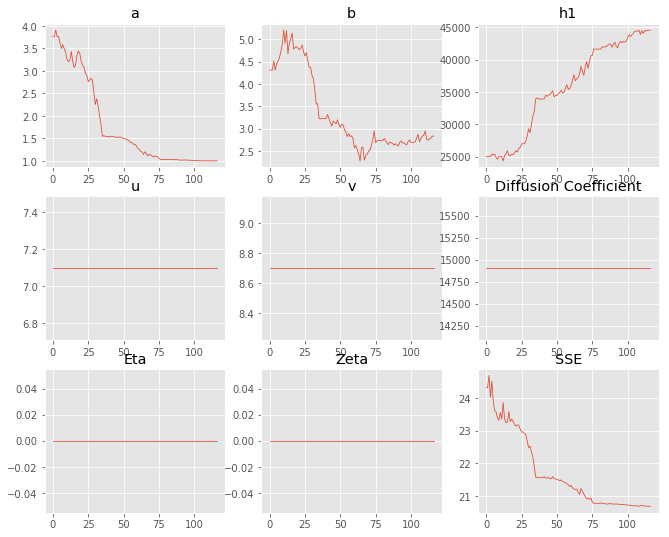

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.76224,1.00029
b,4.31133,2.8322
eta,0,0
ftt,"6,458","6,458"
h1,"24,998.2","44,530.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 17 Time: 0.066 minutes


Estimated remaining run time: 0.135 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.81e+03 	1.55e+03 	0.8560 		1.0000


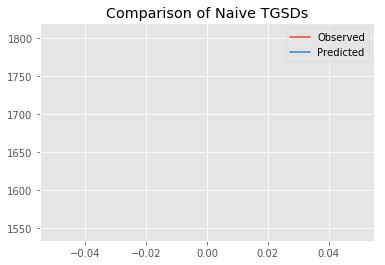

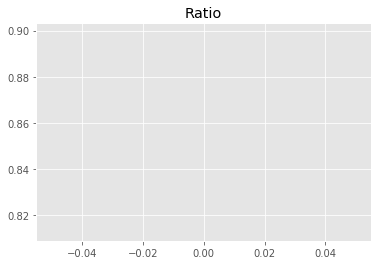

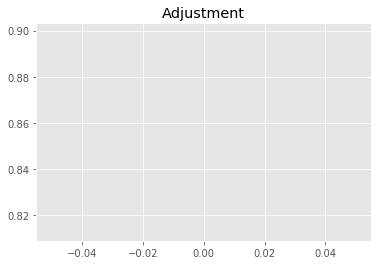

7977932865.40836
1


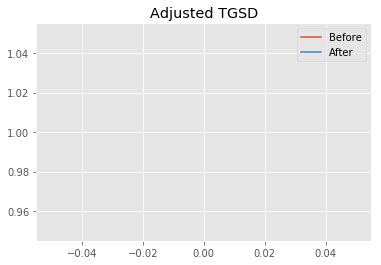

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.29984 	1.90323 	35337.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.21379 	1.89767 	29323.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.0428
New Misfit: 21.3631
Convergence:
0.07289538801400401

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.77e+03 	1.55e+03 	0.8717 		1.0000


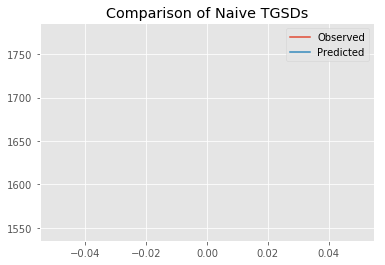

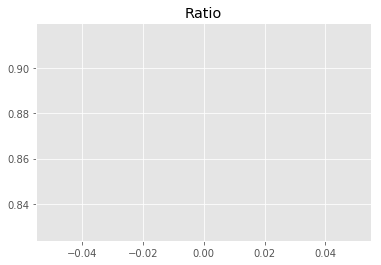

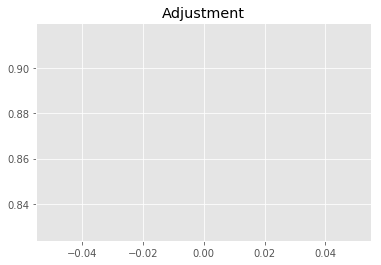

8123628575.114817
1


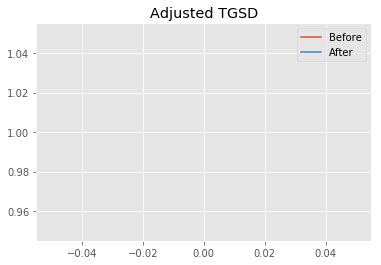

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.21379 	1.89767 	29323.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00001 	2.74856 	43587.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.3631
New Misfit: 20.703
Convergence:
0.030900850181768667

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8951 		1.0000


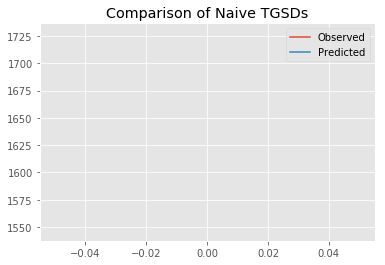

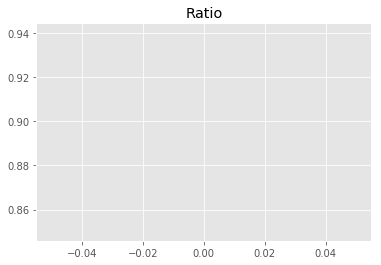

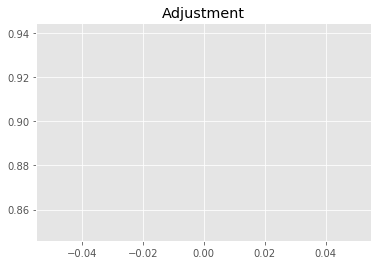

8342173438.383844
1


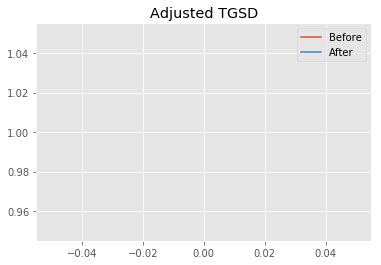

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00001 	2.74856 	43587.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00003 	2.85669 	44894 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.703
New Misfit: 20.6853
Convergence:
0.000854546912560387

____________________
a = 1.00003	b = 2.85669	            h1 = 44894.04868	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.685261270487292
Prior Misfit: 400.999,	 Post Misfit: 20.6853


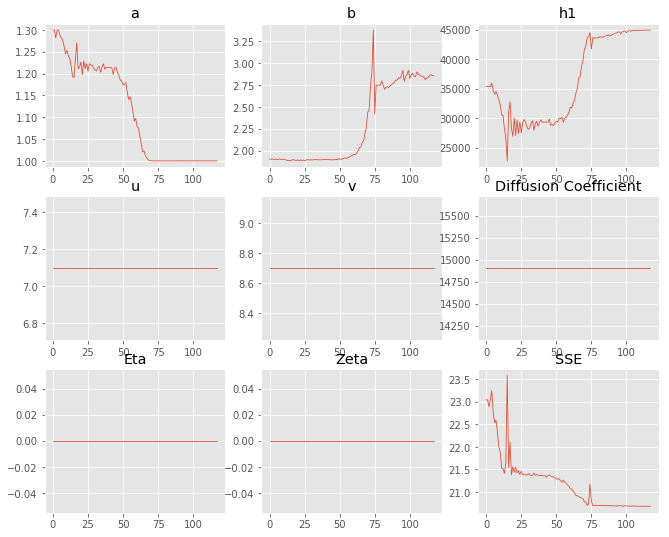

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.29984,1.00003
b,1.90323,2.85669
eta,0,0
ftt,"6,458","6,458"
h1,"35,337.9","44,894"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 18 Time: 0.065 minutes


Estimated remaining run time: 0.067 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.82e+03 	1.55e+03 	0.8506 		1.0000


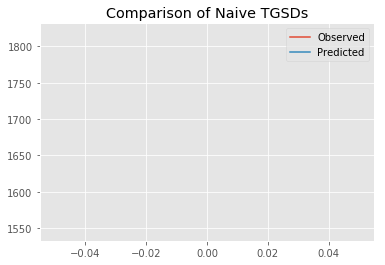

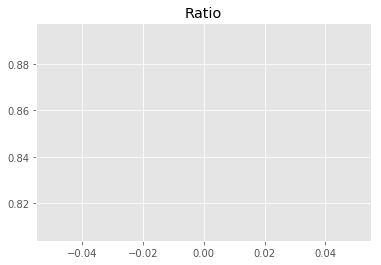

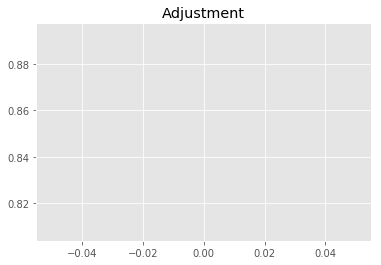

7927196122.255323
1


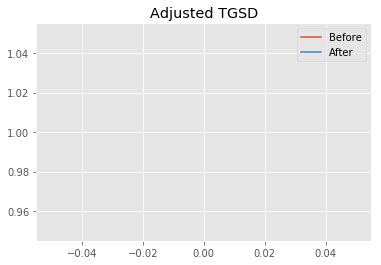

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.97706 	3.10095 	21641.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.13861 	2.09083 	33549.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.2963
New Misfit: 21.157
Convergence:
0.0918300882827387

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8765 		1.0000


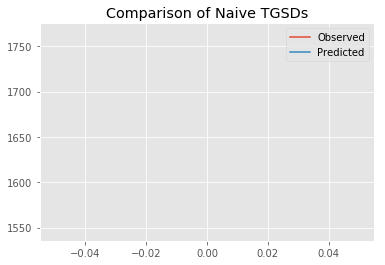

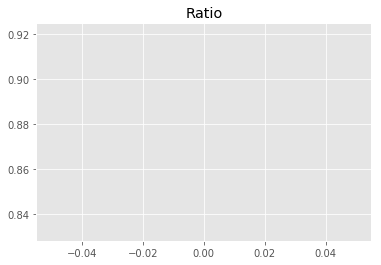

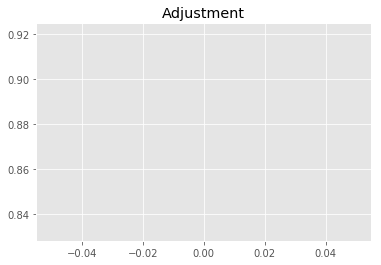

8168351813.477562
1


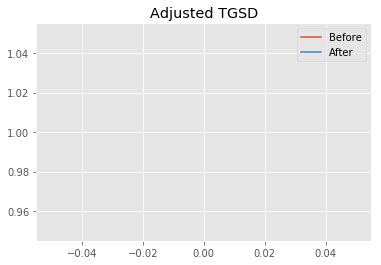

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.13861 	2.09083 	33549.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00158 	2.04655 	35678 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.157
New Misfit: 20.875
Convergence:
0.013327612520761051

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.75e+03 	1.55e+03 	0.8855 		1.0000


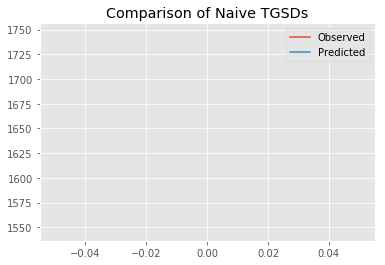

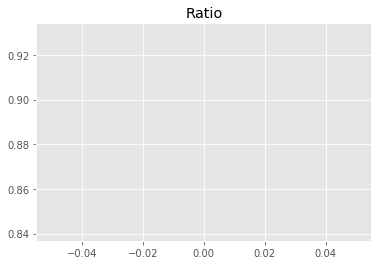

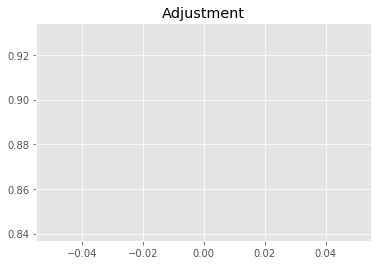

8252405450.951816
1


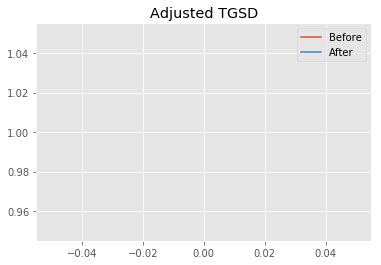

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00158 	2.04655 	35678 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00005 	2.09622 	35609.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.875
New Misfit: 20.8563
Convergence:
0.0008989868632471457

____________________
a = 1.00005	b = 2.09622	            h1 = 35609.67365	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.856267758289253
Prior Misfit: 457.84,	 Post Misfit: 20.8563


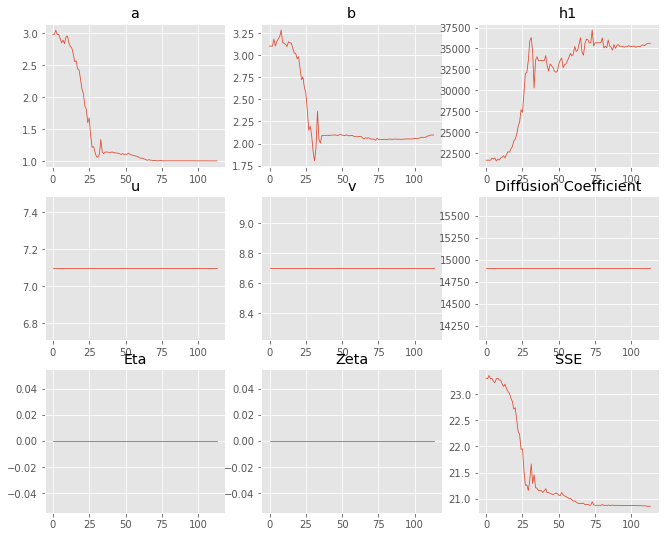

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.97706,1.00005
b,3.10095,2.09622
eta,0,0
ftt,"6,458","6,458"
h1,"21,641.3","35,609.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 19 Time: 0.065 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.70e+03 	1.55e+03 	0.9105 		1.0000


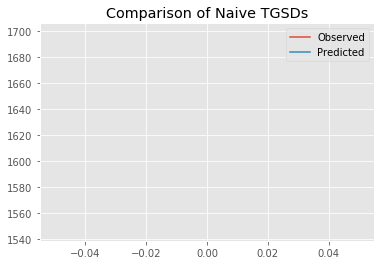

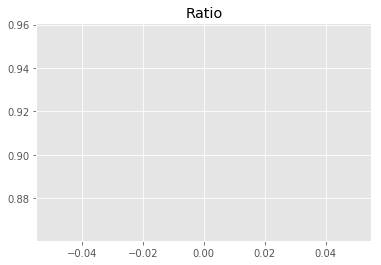

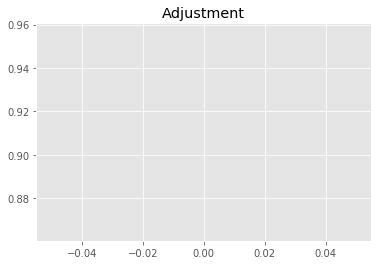

8485846811.653414
1


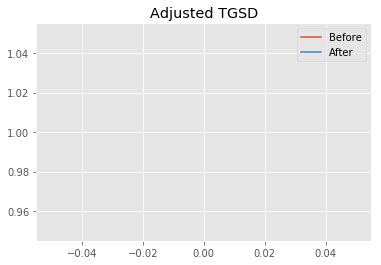

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.1258 	3.63255 	40159.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00382 	2.82596 	44600.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.9327
New Misfit: 20.694
Convergence:
0.05647696545000838

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8954 		1.0000


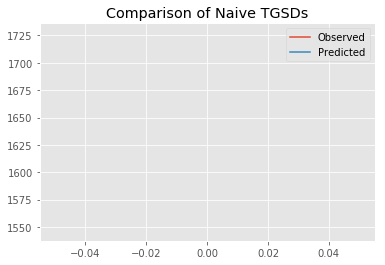

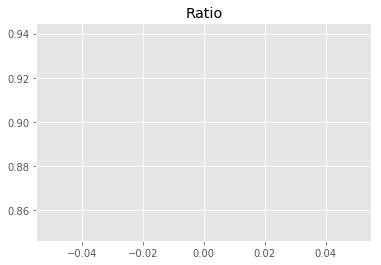

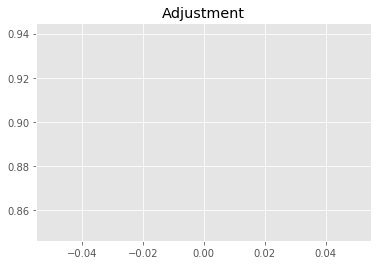

8344738639.080145
1


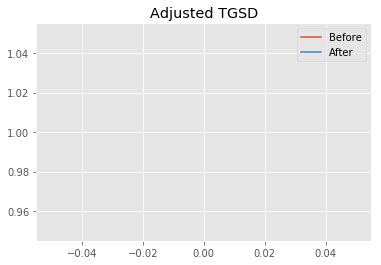

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00382 	2.82596 	44600.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1 	2.84532 	44911.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.694
New Misfit: 20.6848
Convergence:
0.0004415617906837318

____________________
a = 1.00000	b = 2.84532	            h1 = 44911.79870	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 20.684848826118554
Prior Misfit: 420.487,	 Post Misfit: 20.6848


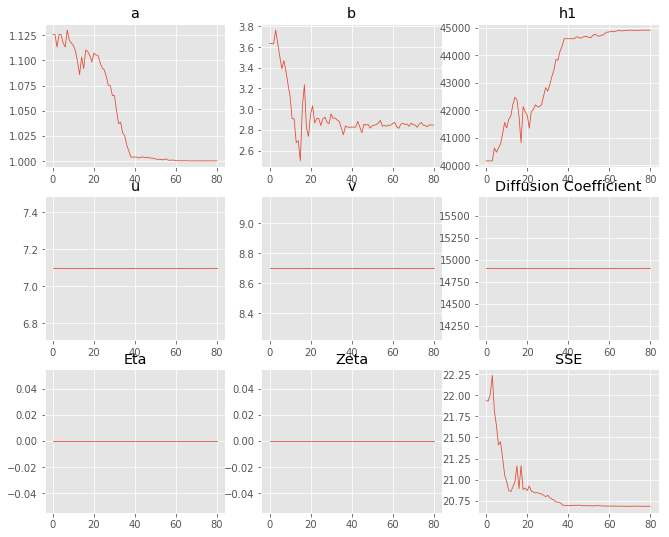

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.1258,1
b,3.63255,2.84532
eta,0,0
ftt,"6,458","6,458"
h1,"40,159.8","44,911.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 20 Time: 0.049 minutes


Estimated remaining run time: -0.066 minutes


Total Run Time: 1.39062 minutes


[{'a': 1.0002106716331713,
  'b': 2.2996857870729044,
  'h1': 38102.59915092556,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.8443236861922365,
  'b': 2.1068406979856285,
  'h1': 22405.731518059543,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0005549479494045,
  'b': 2.865917573024336,
  'h1': 44841.8828442505,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.007266650270147,
  'b': 2.7734675631464847,
  'h1': 43192.905930008754,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.991546831792624,
  'b': 6.206635625212703,
  'h1': 44756.87149381012,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.004440122

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
19,1,2.84532,"44,911.8",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6848
14,1.00004,2.85661,"44,907.4",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6851
17,1.00003,2.85669,"44,894",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6853
7,1.00014,2.84497,"44,856.6",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6857
15,1.00011,2.82804,"44,898.7",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6858
6,1.00024,2.86654,"44,847.9",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6868
12,1.00062,2.86162,"44,831.1",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6872
2,1.00055,2.86592,"44,841.9",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6872
10,1,2.8506,"44,732.6",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6876
16,1.00029,2.8322,"44,530.6",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6905


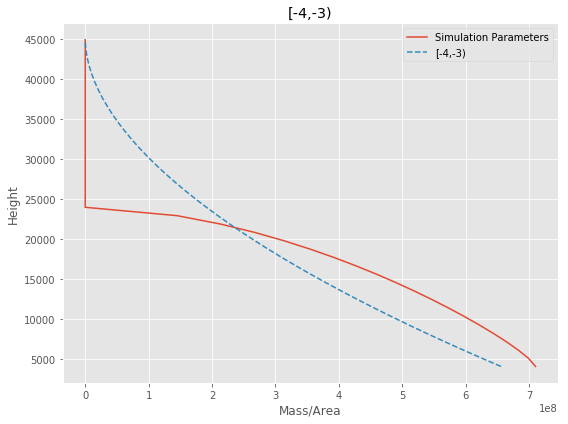

[-4,-3) Run Time: 1.39349 minutes


Mass Test: 12197189537.628078
========[-3,-2)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.20e+03 	1.86e+03 	0.8459 		1.0000


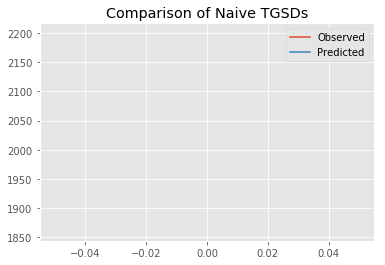

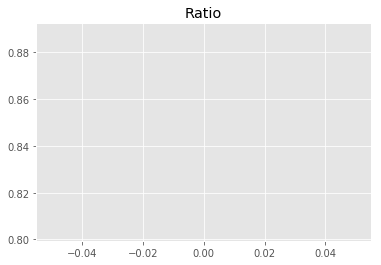

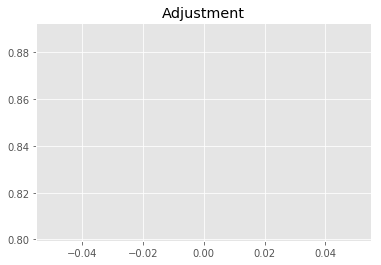

9487163079.606428
1


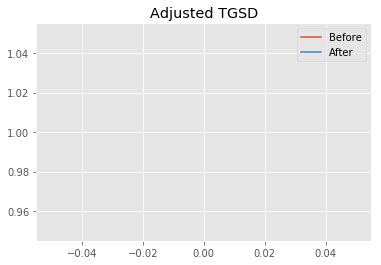

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.55427 	3.14708 	29427.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.38753 	2.01756 	34643.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 28.0693
New Misfit: 24.2845
Convergence:
0.13483636381863567

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.12e+03 	1.86e+03 	0.8781 		1.0000


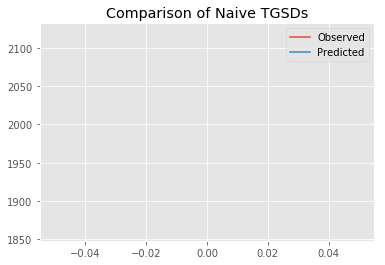

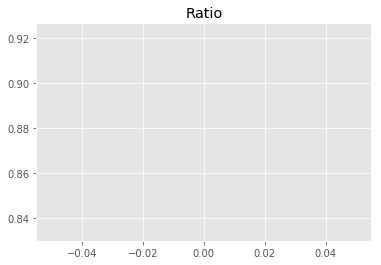

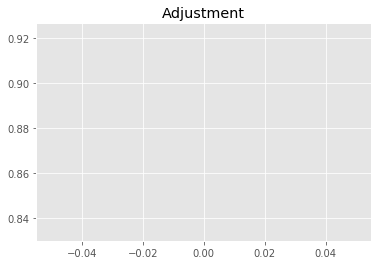

9847524481.390074
1


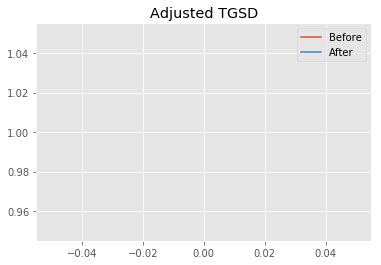

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.38753 	2.01756 	34643.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1 	1.90606 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.2845
New Misfit: 23.6025
Convergence:
0.02808302405699619

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.00e+03 	1.86e+03 	0.9299 		1.0000


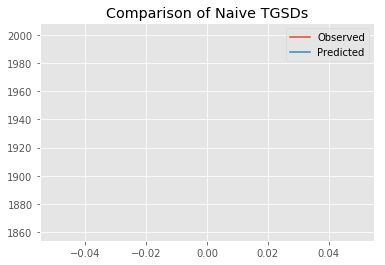

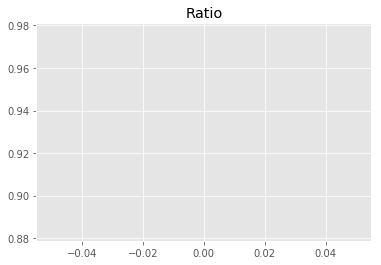

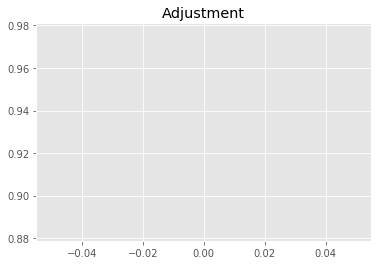

10428376079.054024
1


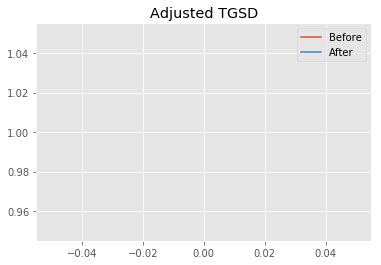

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	1.90606 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1 	1.9015 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6025
New Misfit: 23.6025
Convergence:
2.4278446053777824e-06

____________________
a = 1.00000	b = 1.90150	            h1 = 44914.98217	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.60246730481119
Prior Misfit: 493.84,	 Post Misfit: 23.6025


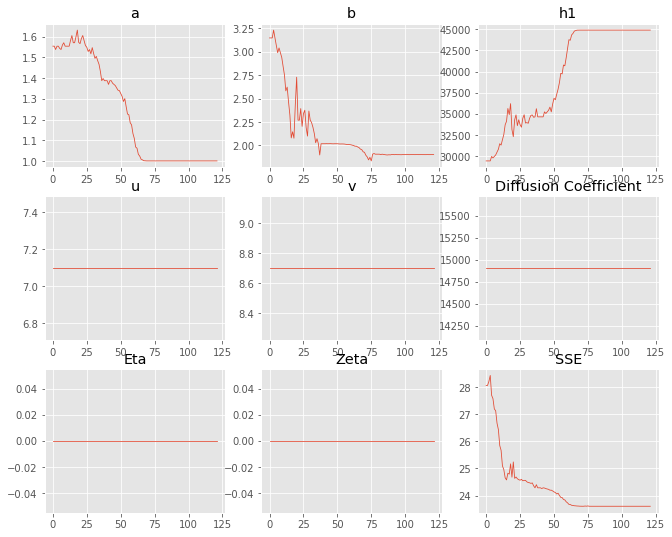

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.55427,1
b,3.14708,1.9015
eta,0,0
ftt,"6,458","6,458"
h1,"29,427.4","44,915"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 1 Time: 0.072 minutes


Estimated remaining run time: 0.645 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.11e+03 	1.86e+03 	0.8810 		1.0000


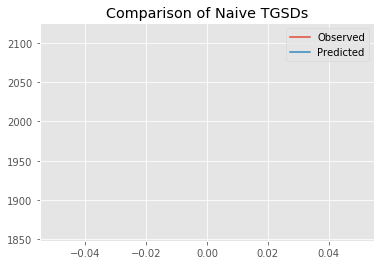

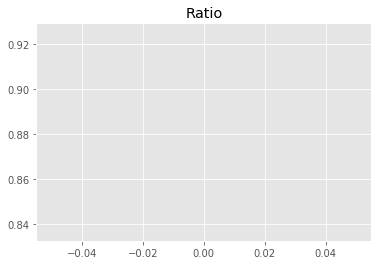

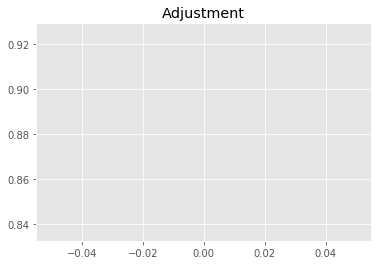

9879998720.198048
1


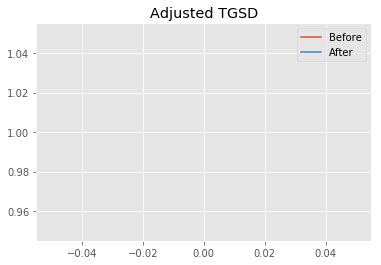

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.2076 	1.50012 	31545.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.034 	1.94471 	42842.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.162
New Misfit: 23.6664
Convergence:
0.020514470500238042

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9191 		1.0000


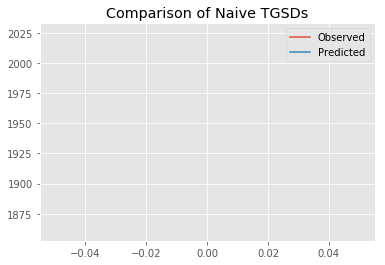

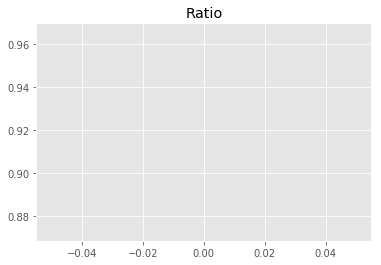

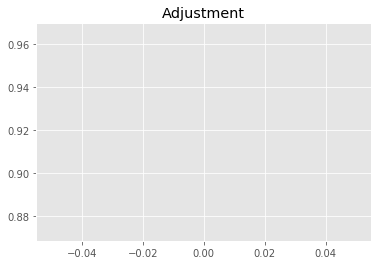

10307594012.642641
1


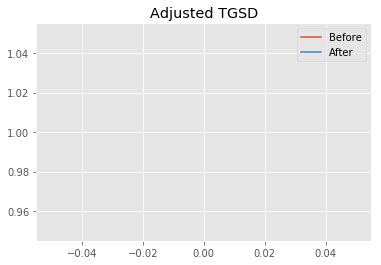

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.034 	1.94471 	42842.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00002 	1.9047 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6664
New Misfit: 23.6025
Convergence:
0.00269871634742665

____________________
a = 1.00002	b = 1.90470	            h1 = 44914.99986	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.602505844481815
Prior Misfit: 417.099,	 Post Misfit: 23.6025


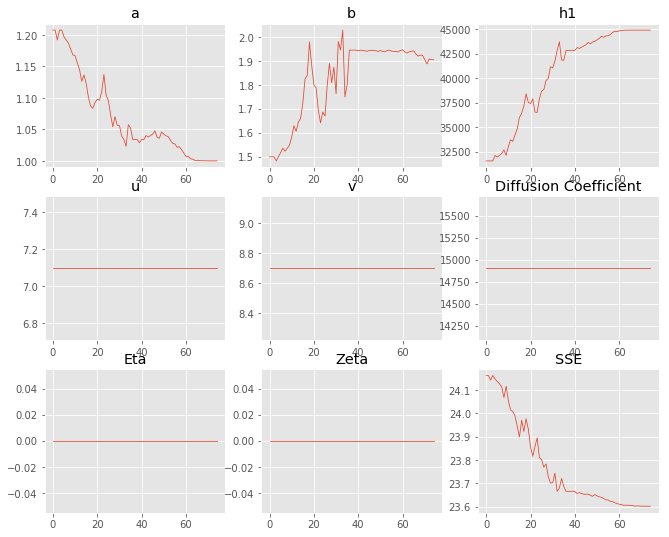

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.2076,1.00002
b,1.50012,1.9047
eta,0,0
ftt,"6,458","6,458"
h1,"31,545.2","44,915"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 2 Time: 0.049 minutes


Estimated remaining run time: 0.682 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.16e+03 	1.86e+03 	0.8626 		1.0000


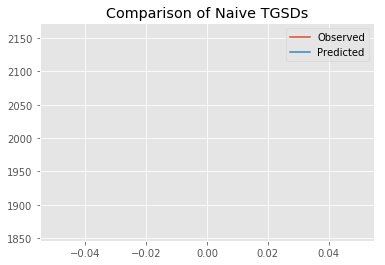

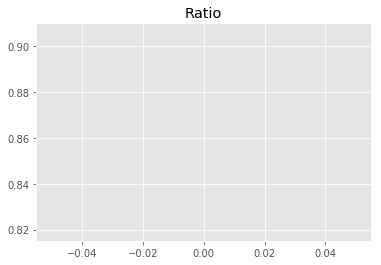

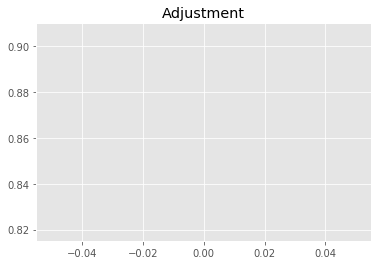

9673695382.659155
1


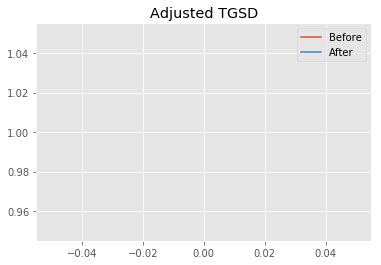

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.38649 	3.92578 	38248.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.27345 	2.26624 	40685.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 27.5731
New Misfit: 23.9534
Convergence:
0.13127627970445835

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.07e+03 	1.86e+03 	0.8978 		1.0000


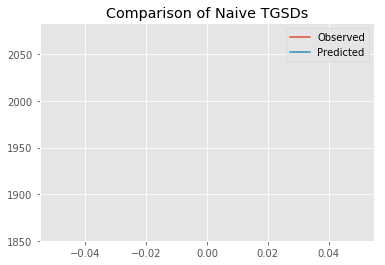

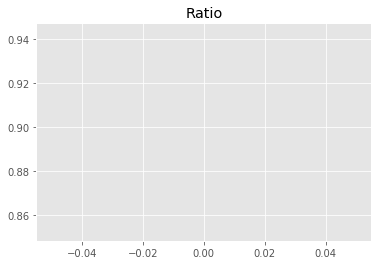

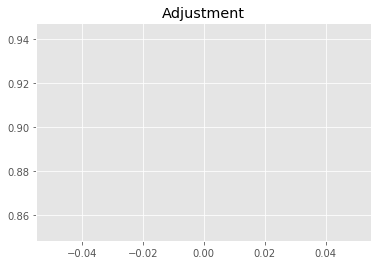

10069405284.267908
1


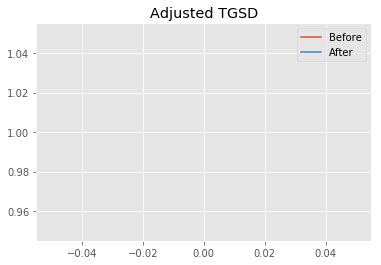

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.27345 	2.26624 	40685.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.01054 	1.91099 	44897.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.9534
New Misfit: 23.6115
Convergence:
0.014272938672790772

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.00e+03 	1.86e+03 	0.9298 		1.0000


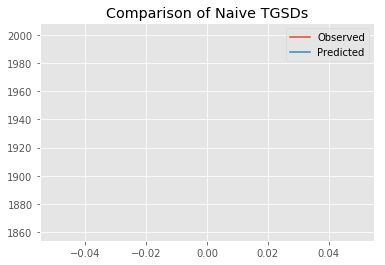

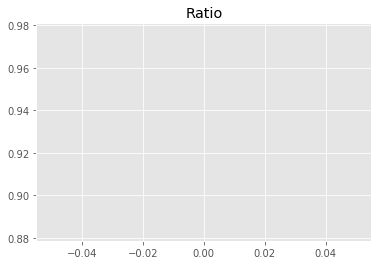

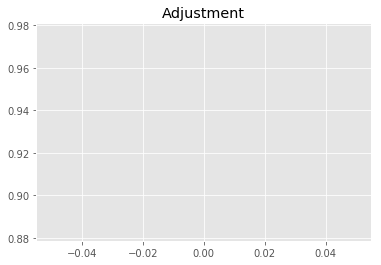

10427944761.896864
1


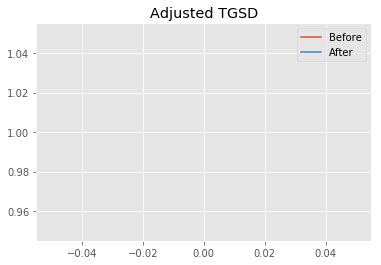

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01054 	1.91099 	44897.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00001 	1.90624 	44910.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6115
New Misfit: 23.6026
Convergence:
0.000380065634529106

____________________
a = 1.00001	b = 1.90624	            h1 = 44910.83847	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.602564526782558
Prior Misfit: 481.871,	 Post Misfit: 23.6026


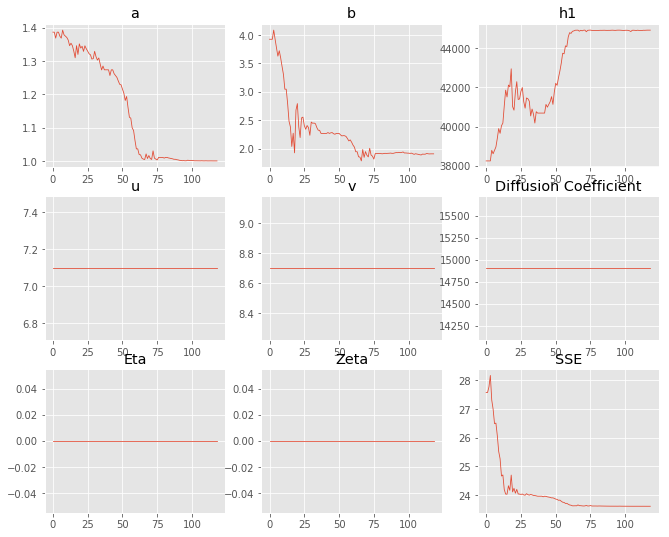

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.38649,1.00001
b,3.92578,1.90624
eta,0,0
ftt,"6,458","6,458"
h1,"38,248.8","44,910.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 3 Time: 0.068 minutes


Estimated remaining run time: 0.753 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.33e+03 	1.86e+03 	0.7994 		1.0000


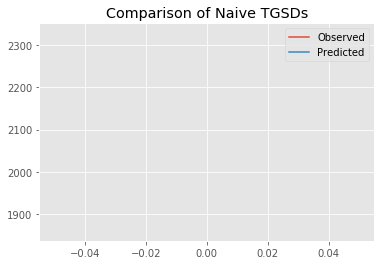

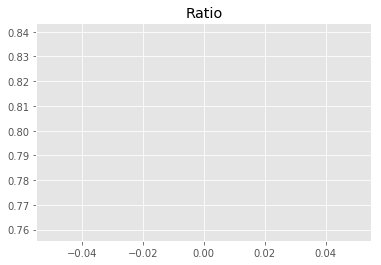

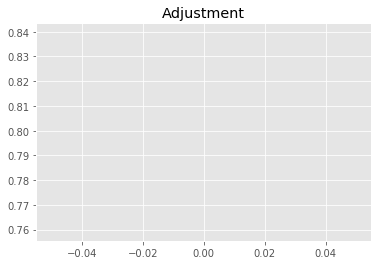

8965652097.42717
1


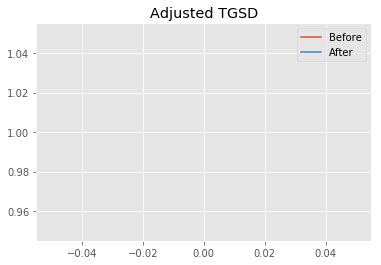

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.45369 	4.49697 	28057.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.20228 	1.80047 	41172.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 27.2631
New Misfit: 24.1345
Convergence:
0.11475782764013048

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9233 		1.0000


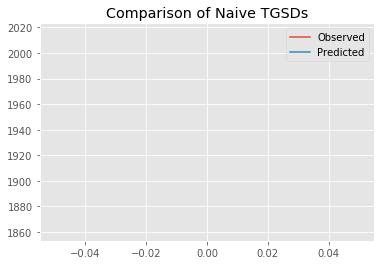

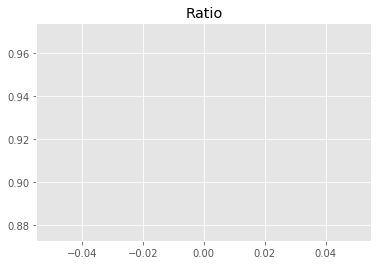

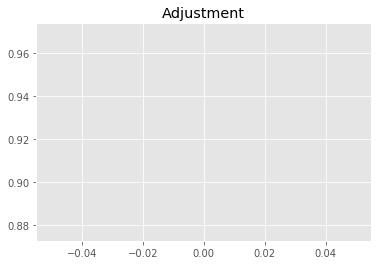

10354567801.416237
1


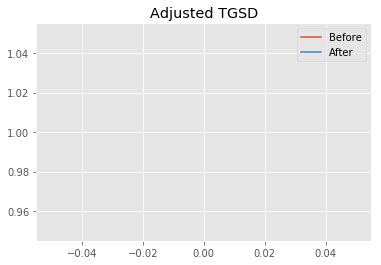

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.20228 	1.80047 	41172.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.02163 	1.95166 	44057.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.1345
New Misfit: 23.632
Convergence:
0.020817684213068594

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.01e+03 	1.86e+03 	0.9241 		1.0000


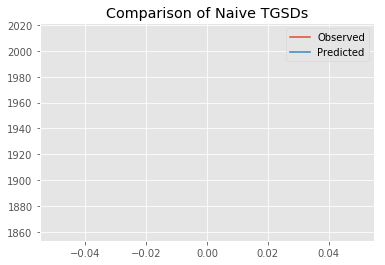

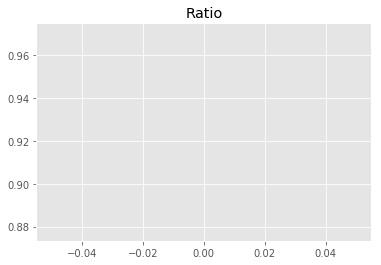

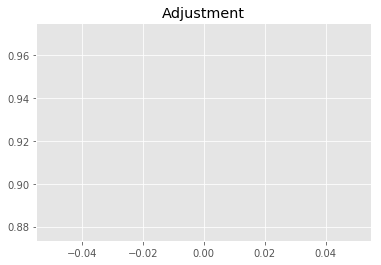

10364367274.87829
1


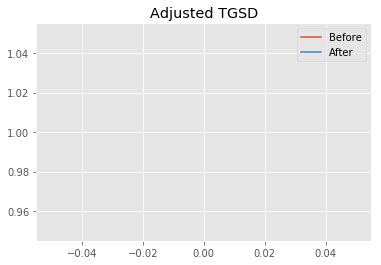

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02163 	1.95166 	44057.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1 	1.90333 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.632
New Misfit: 23.6025
Convergence:
0.0012510559855875728

____________________
a = 1.00000	b = 1.90333	            h1 = 44915.00000	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.602478048603647
Prior Misfit: 486.405,	 Post Misfit: 23.6025


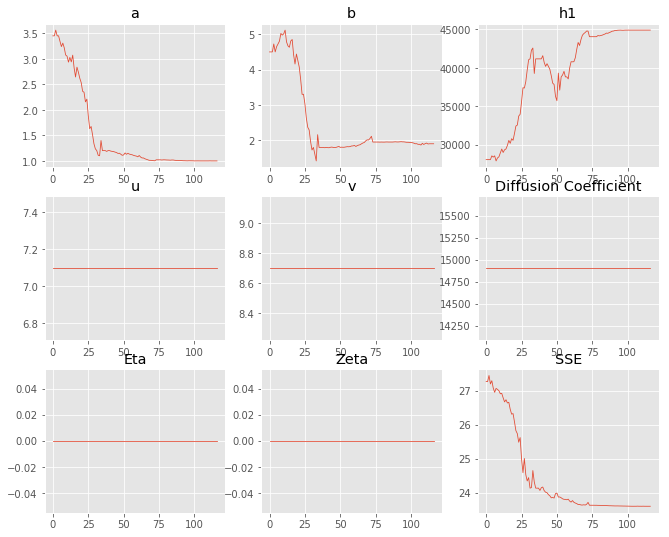

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.45369,1
b,4.49697,1.90333
eta,0,0
ftt,"6,458","6,458"
h1,"28,057.5","44,915"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 4 Time: 0.067 minutes


Estimated remaining run time: 0.766 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.41e+03 	1.86e+03 	0.7716 		1.0000


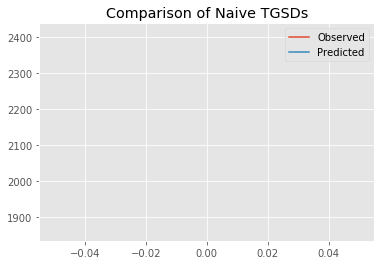

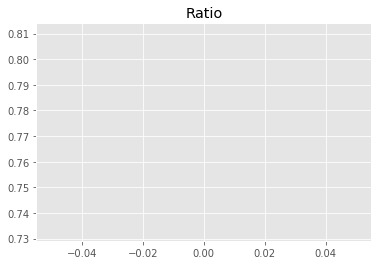

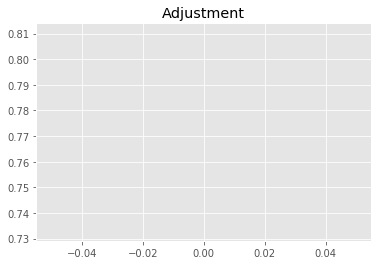

8653028837.402025
1


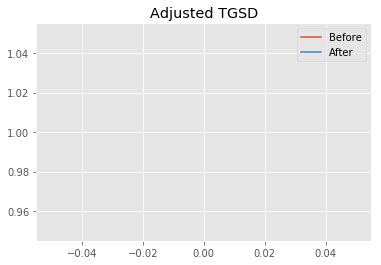

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.54994 	3.18606 	18117.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00063 	1.00057 	29820 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 28.9843
New Misfit: 24.0237
Convergence:
0.17114922213382444

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.09e+03 	1.86e+03 	0.8923 		1.0000


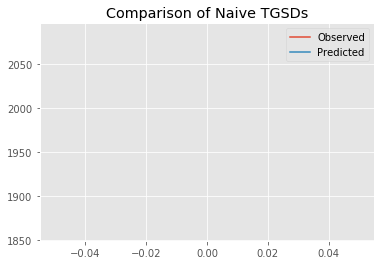

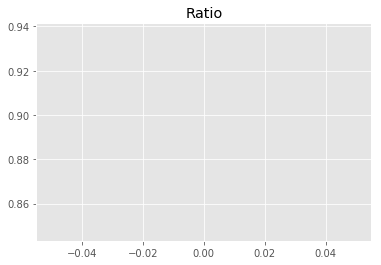

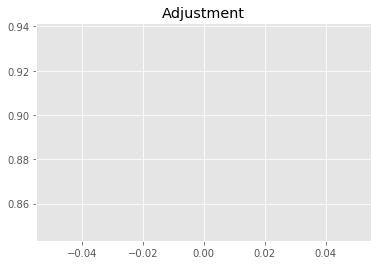

10007208101.477982
1


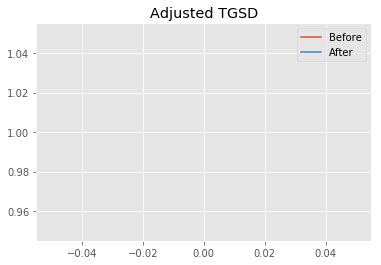

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00063 	1.00057 	29820 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00002 	1.33524 	33893.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.0237
New Misfit: 23.7985
Convergence:
0.009373797524127078

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.06e+03 	1.86e+03 	0.9031 		1.0000


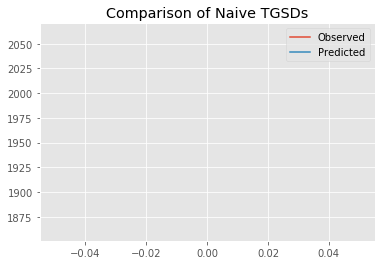

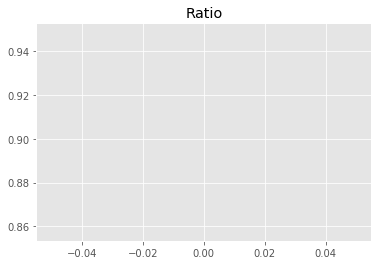

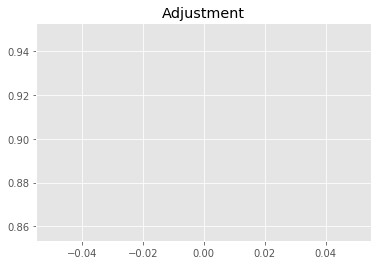

10127918324.250534
1


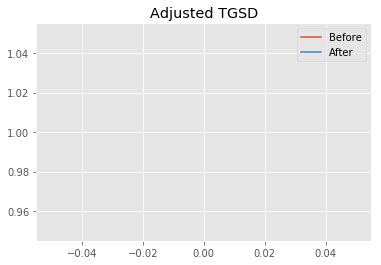

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.33524 	33893.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1 	1.70398 	41085.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.7985
New Misfit: 23.6413
Convergence:
0.006605651710994105

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9229 		1.0000


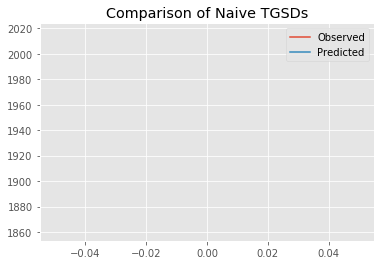

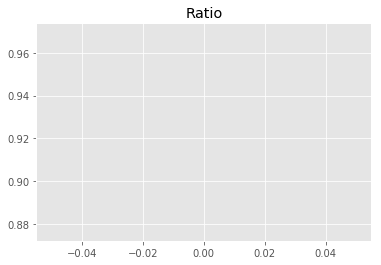

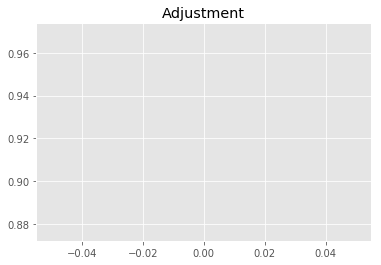

10350889507.04569
1


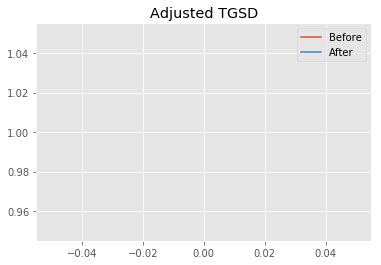

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	1.70398 	41085.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1 	1.90214 	44828.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6413
New Misfit: 23.6031
Convergence:
0.001614495302070639

____________________
a = 1.00000	b = 1.90214	            h1 = 44828.78543	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.60311790477567
Prior Misfit: 530.839,	 Post Misfit: 23.6031


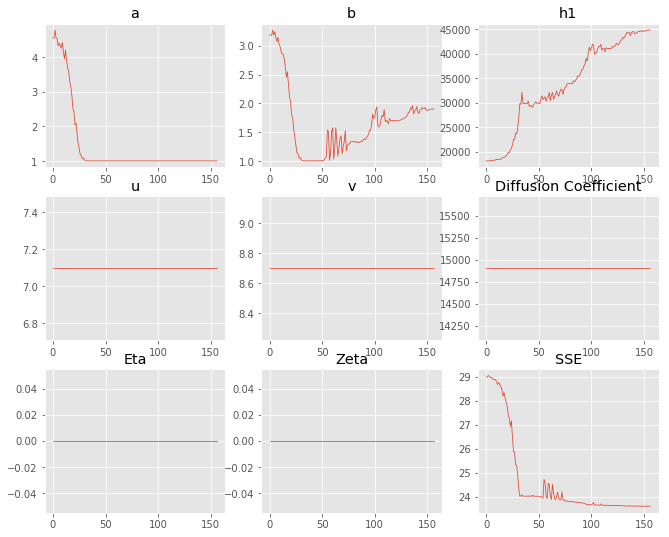

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.54994,1
b,3.18606,1.90214
eta,0,0
ftt,"6,458","6,458"
h1,"18,117.6","44,828.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 5 Time: 0.087 minutes


Estimated remaining run time: 0.800 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.43e+03 	1.86e+03 	0.7657 		1.0000


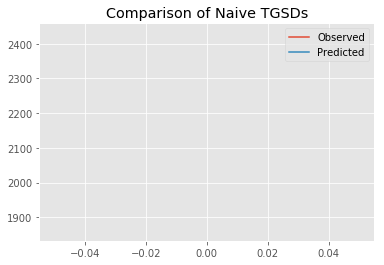

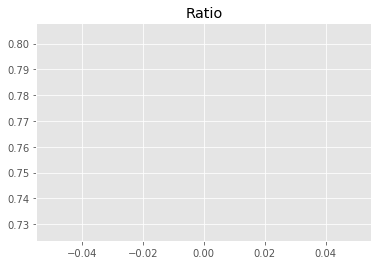

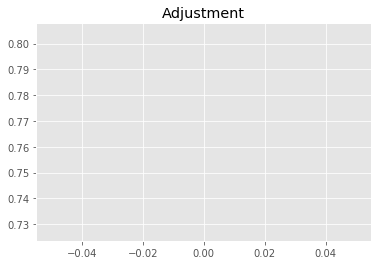

8587505400.38831
1


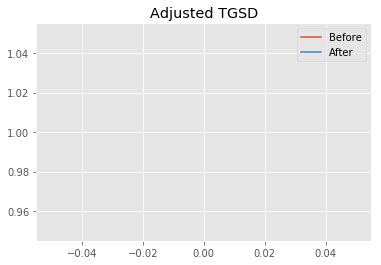

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.84173 	2.7739 	17823.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.5247 	1.52535 	21950 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 29.1891
New Misfit: 26.4067
Convergence:
0.09532286954527132

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.25e+03 	1.86e+03 	0.8255 		1.0000


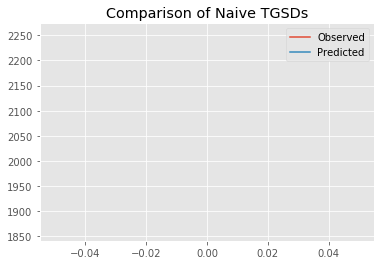

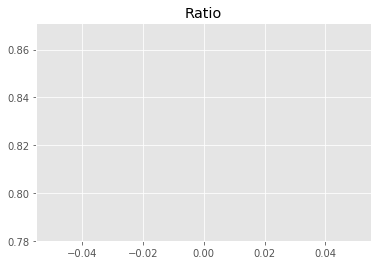

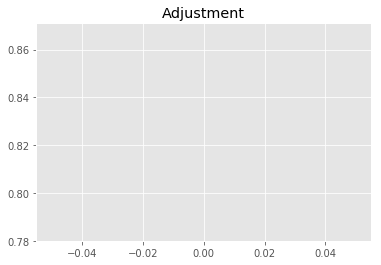

9258238402.479153
1


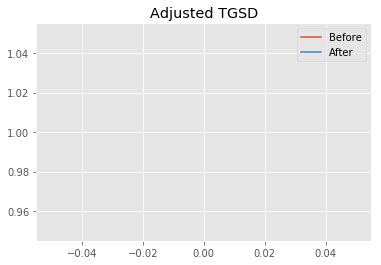

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.5247 	1.52535 	21950 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.28187 	1.5856 	29971.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 26.4067
New Misfit: 24.4078
Convergence:
0.07569885157226529

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.15e+03 	1.86e+03 	0.8670 		1.0000


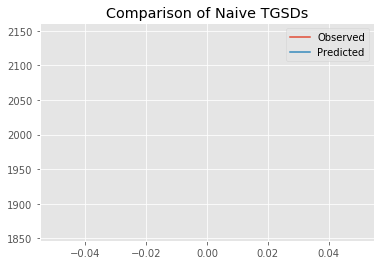

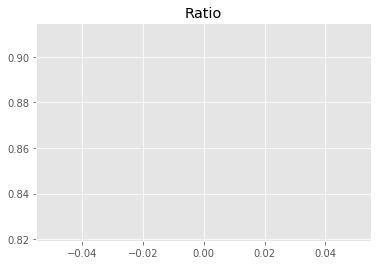

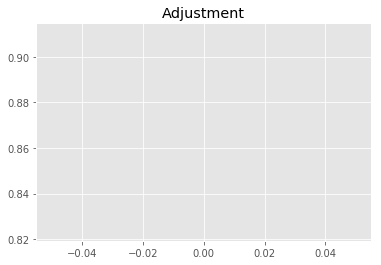

9723167063.993057
1


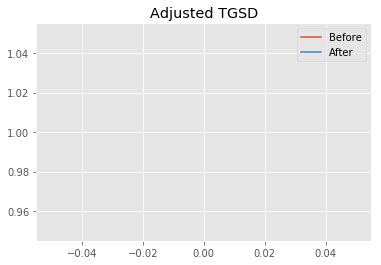

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.28187 	1.5856 	29971.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00848 	1.8354 	43684 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.4078
New Misfit: 23.6213
Convergence:
0.0322218625505057

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.00e+03 	1.86e+03 	0.9283 		1.0000


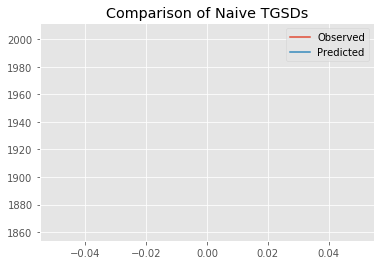

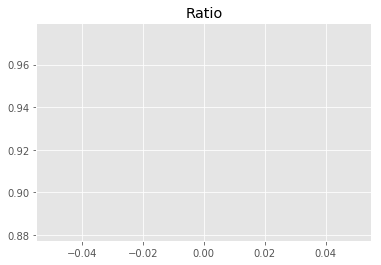

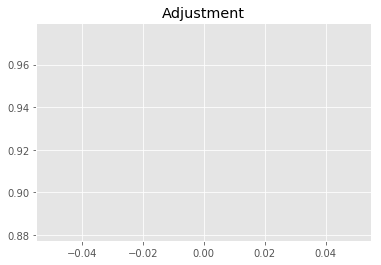

10411110771.52614
1


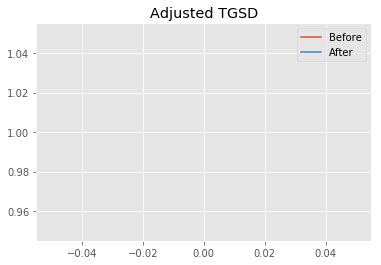

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00848 	1.8354 	43684 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00007 	1.91218 	44884.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6213
New Misfit: 23.6031
Convergence:
0.0007697416440549525

____________________
a = 1.00007	b = 1.91218	            h1 = 44884.22887	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.603111340186565
Prior Misfit: 531.664,	 Post Misfit: 23.6031


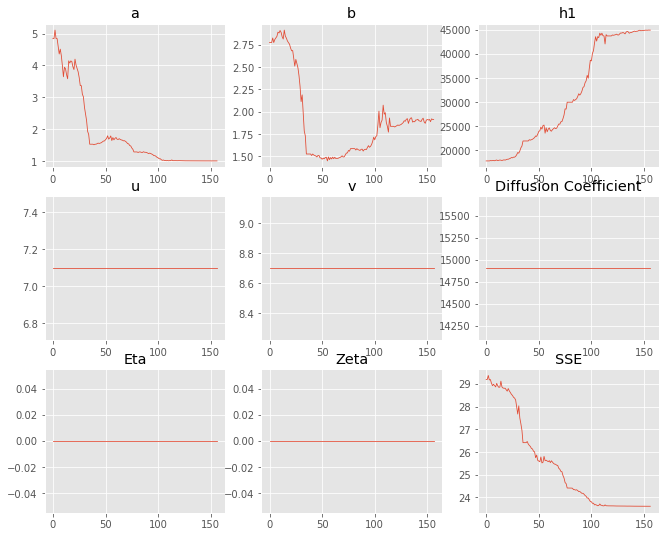

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.84173,1.00007
b,2.7739,1.91218
eta,0,0
ftt,"6,458","6,458"
h1,"17,823.7","44,884.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 6 Time: 0.087 minutes


Estimated remaining run time: 0.799 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.17e+03 	1.86e+03 	0.8578 		1.0000


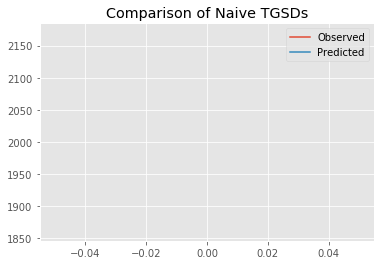

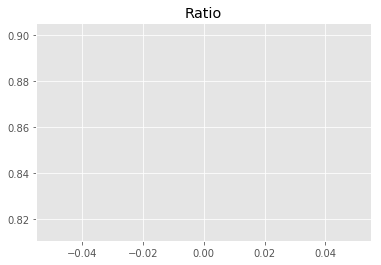

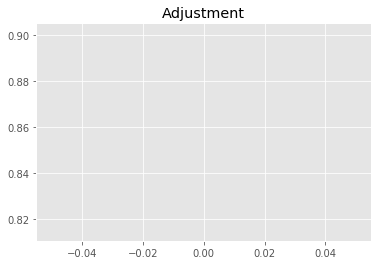

9619929914.893253
1


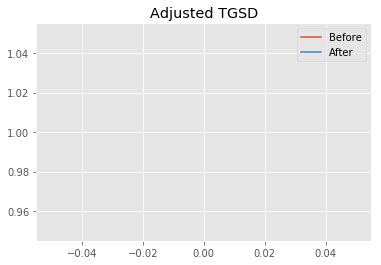

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.35944 	2.76301 	32636.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.09577 	1.5584 	38188.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 26.2813
New Misfit: 23.8801
Convergence:
0.09136412495042626

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.03e+03 	1.86e+03 	0.9175 		1.0000


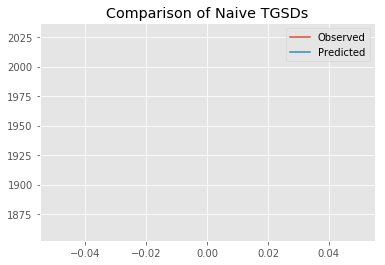

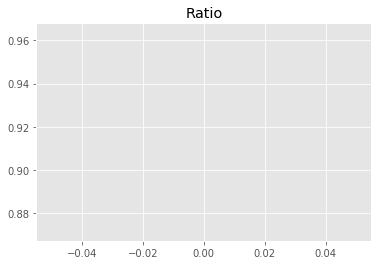

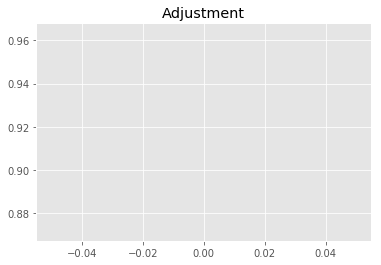

10289651346.85552
1


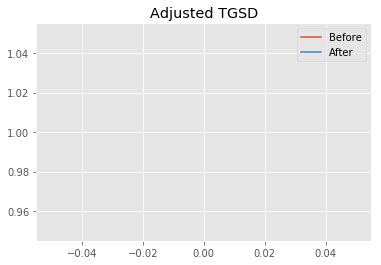

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.09577 	1.5584 	38188.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.04152 	1.88567 	42517 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.8801
New Misfit: 23.6634
Convergence:
0.009074932098698498

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9206 		1.0000


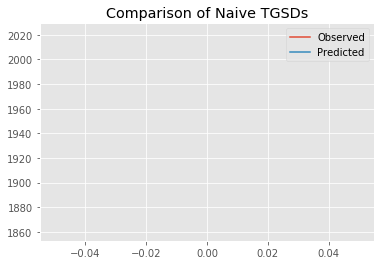

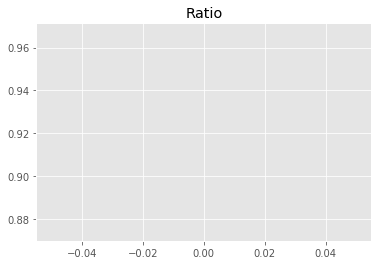

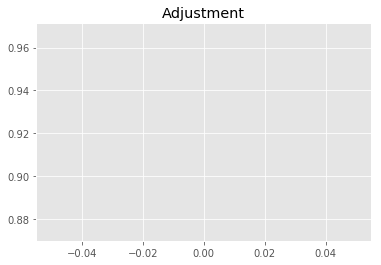

10324707162.99669
1


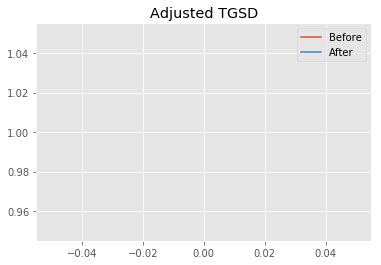

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.04152 	1.88567 	42517 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00003 	1.89403 	44914.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6634
New Misfit: 23.6026
Convergence:
0.0025682200106459715

____________________
a = 1.00003	b = 1.89403	            h1 = 44914.06686	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.60264005443987
Prior Misfit: 454.432,	 Post Misfit: 23.6026


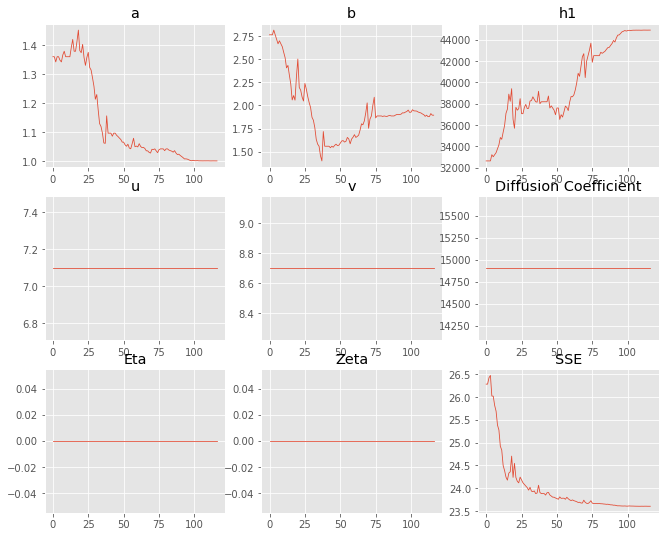

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.35944,1.00003
b,2.76301,1.89403
eta,0,0
ftt,"6,458","6,458"
h1,"32,636.5","44,914.1"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 7 Time: 0.070 minutes


Estimated remaining run time: 0.750 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.13e+03 	1.86e+03 	0.8746 		1.0000


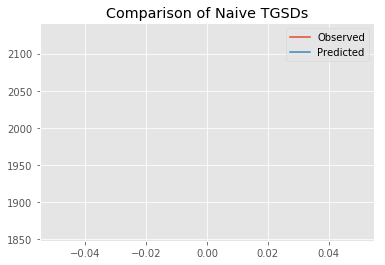

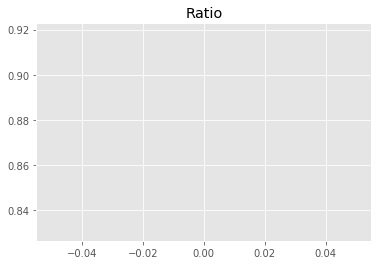

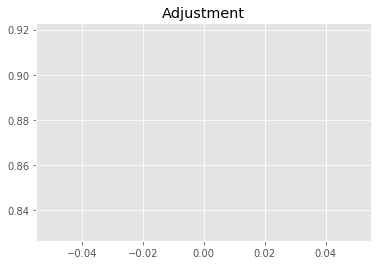

9809106738.463243
1


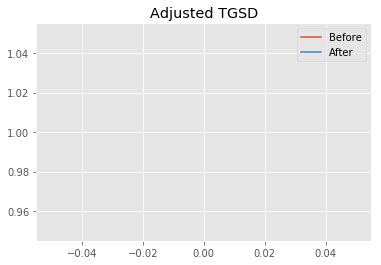

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.20968 	3.09431 	39291.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.05583 	1.82198 	41597.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 25.9688
New Misfit: 23.6898
Convergence:
0.08775597339826609

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9197 		1.0000


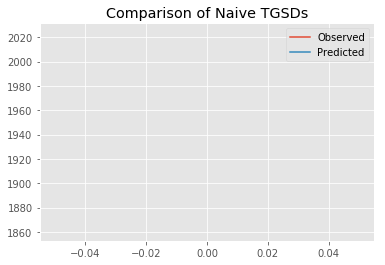

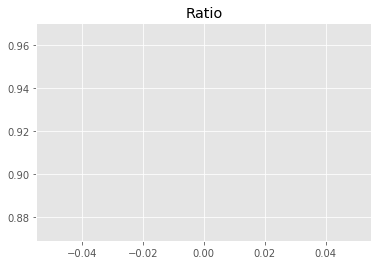

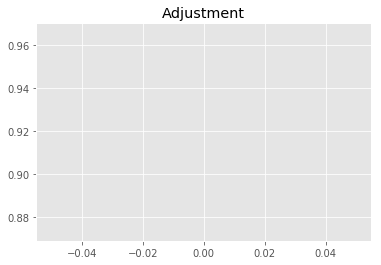

10314633293.24405
1


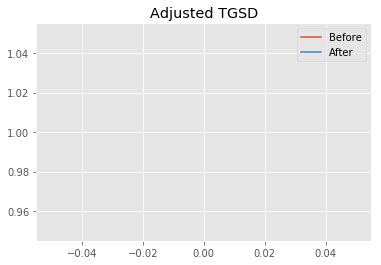

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05583 	1.82198 	41597.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.0053 	1.93419 	44859.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6898
New Misfit: 23.6084
Convergence:
0.003438608595097434

____________________
a = 1.00530	b = 1.93419	            h1 = 44859.67770	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.608380870580564
Prior Misfit: 448.56,	 Post Misfit: 23.6084


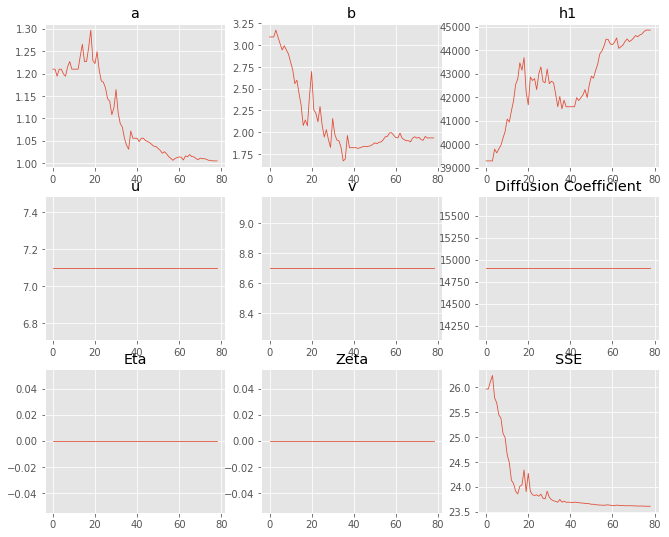

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.20968,1.0053
b,3.09431,1.93419
eta,0,0
ftt,"6,458","6,458"
h1,"39,291.1","44,859.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 8 Time: 0.052 minutes


Estimated remaining run time: 0.674 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.04e+03 	1.86e+03 	0.9140 		1.0000


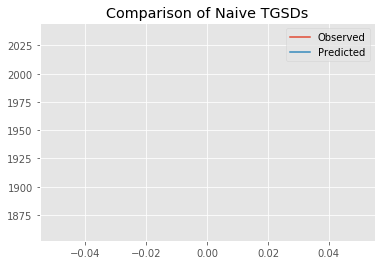

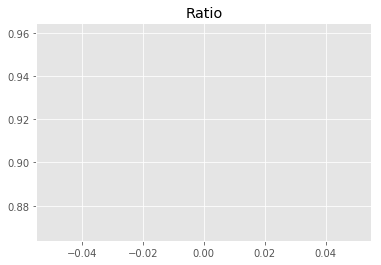

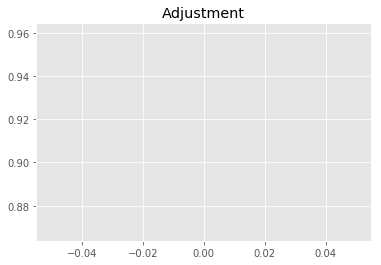

10250907920.265673
1


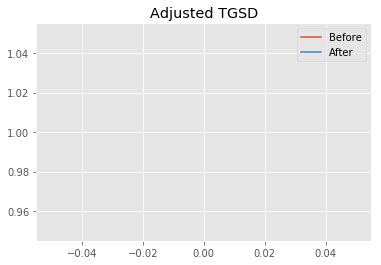

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.80905 	2.16291 	39626.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.74672 	2.19284 	30855.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 26.534
New Misfit: 25.045
Convergence:
0.056116914300352025

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.19e+03 	1.86e+03 	0.8516 		1.0000


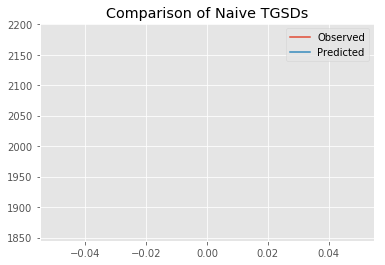

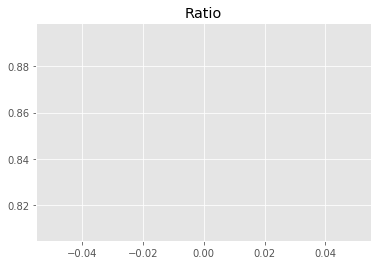

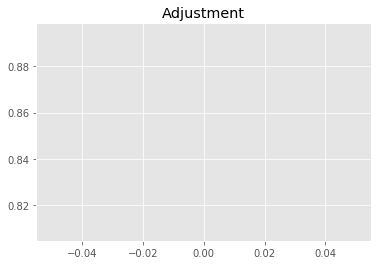

9550387358.263945
1


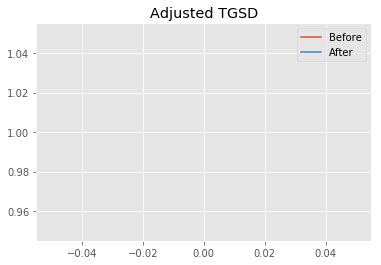

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.74672 	2.19284 	30855.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.01348 	1.82494 	44856.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 25.045
New Misfit: 23.6428
Convergence:
0.055986277709965025

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.99e+03 	1.86e+03 	0.9350 		1.0000


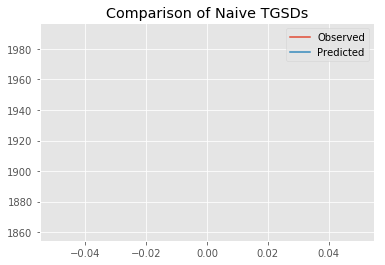

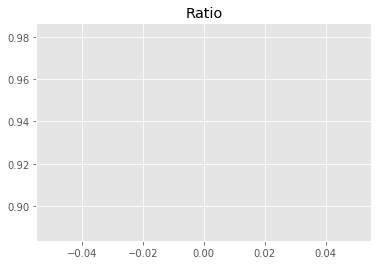

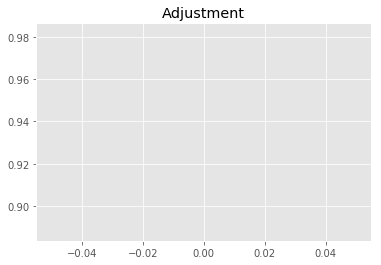

10485517165.860626
1


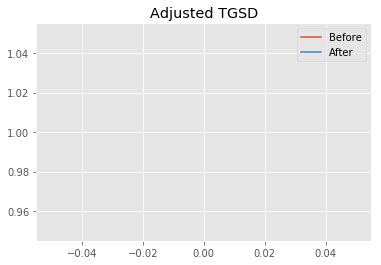

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01348 	1.82494 	44856.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.0004 	1.90862 	44874.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6428
New Misfit: 23.6032
Convergence:
0.0016727886402852776

____________________
a = 1.00040	b = 1.90862	            h1 = 44874.43444	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.60323332259098
Prior Misfit: 499.653,	 Post Misfit: 23.6032


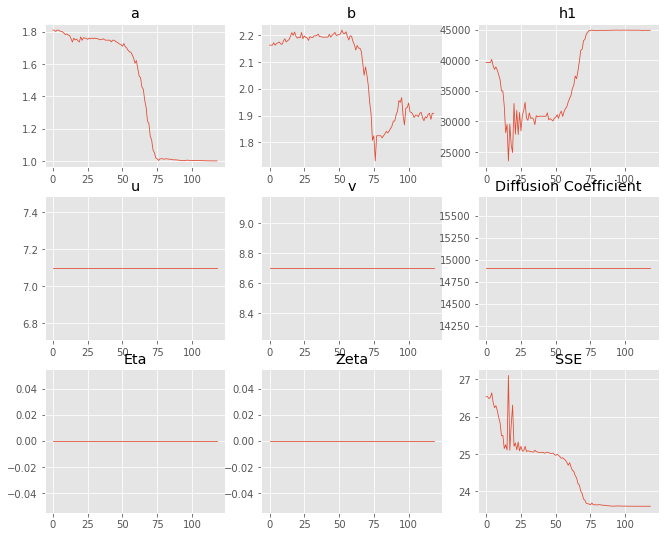

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.80905,1.0004
b,2.16291,1.90862
eta,0,0
ftt,"6,458","6,458"
h1,"39,626.5","44,874.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 9 Time: 0.069 minutes


Estimated remaining run time: 0.621 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.44e+03 	1.86e+03 	0.7617 		1.0000


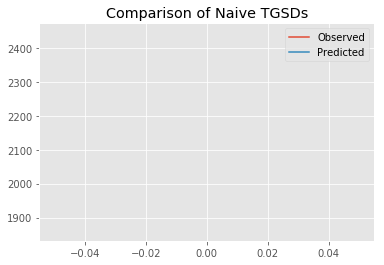

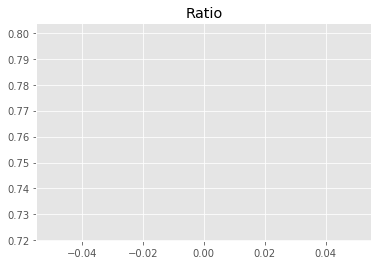

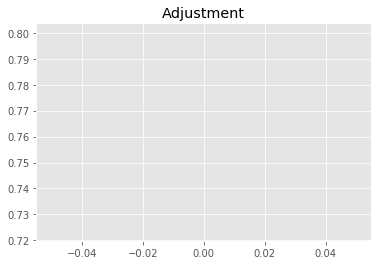

8542814364.505686
1


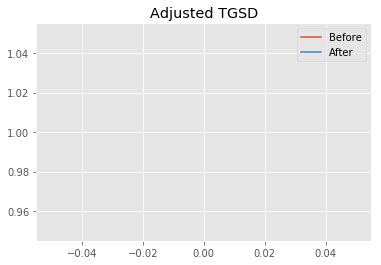

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.13645 	1.52684 	15879.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|2.41827 	1.22607 	16068.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 29.4408
New Misfit: 28.6536
Convergence:
0.026740428694205468

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.37e+03 	1.86e+03 	0.7841 		1.0000


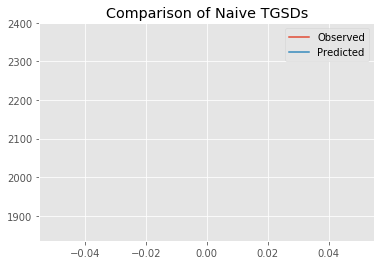

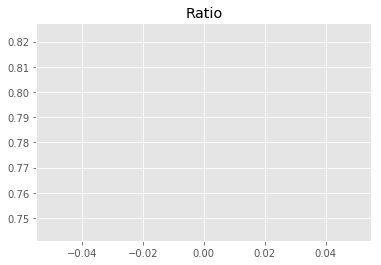

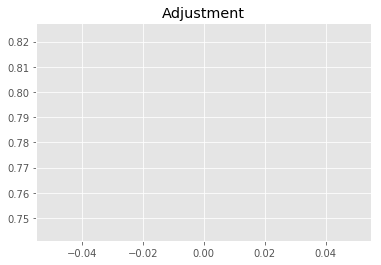

8793638754.545803
1


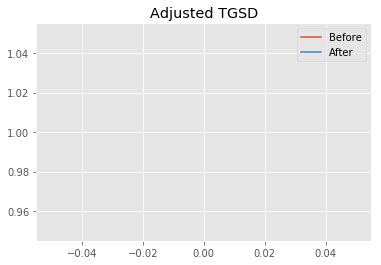

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.41827 	1.22607 	16068.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.92137 	1.0007 	17075.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 28.6536
New Misfit: 27.711
Convergence:
0.03289653247156844

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.35e+03 	1.86e+03 	0.7911 		1.0000


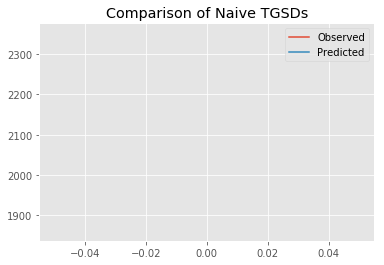

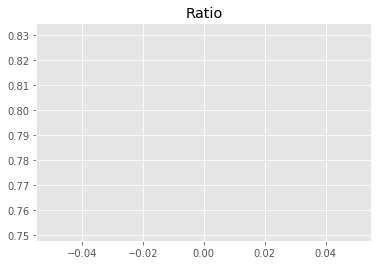

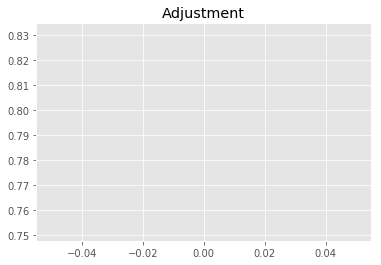

8872458297.235422
1


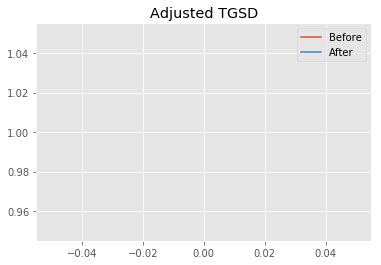

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.92137 	1.0007 	17075.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.95742 	1.00005 	17116 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 27.711
New Misfit: 27.7066
Convergence:
0.00015880995954428454

____________________
a = 1.95742	b = 1.00005	            h1 = 17116.00011	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 27.706550445942643
Prior Misfit: 537.274,	 Post Misfit: 27.7066


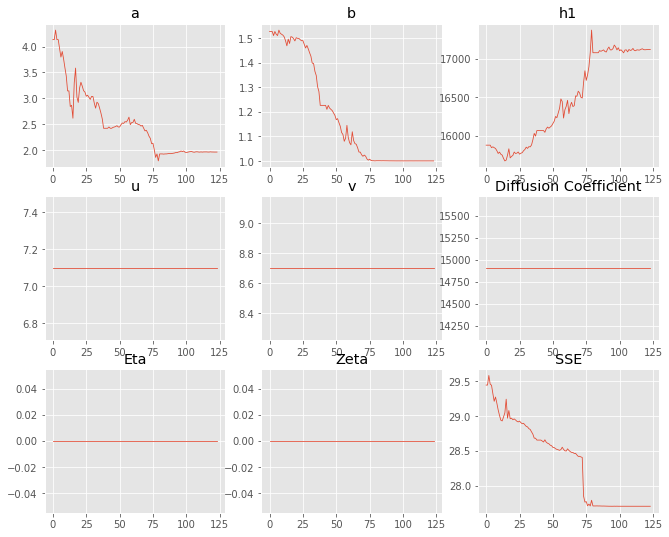

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.13645,1.95742
b,1.52684,1.00005
eta,0,0
ftt,"6,458","6,458"
h1,"15,879.5","17,116"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 10 Time: 0.075 minutes


Estimated remaining run time: 0.569 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.35e+03 	1.86e+03 	0.7920 		1.0000


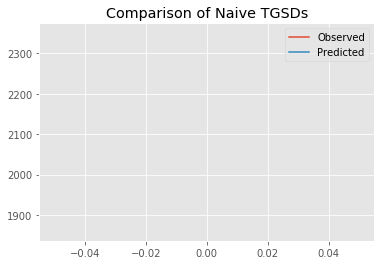

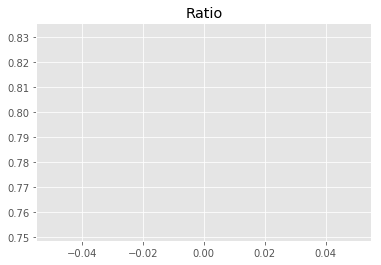

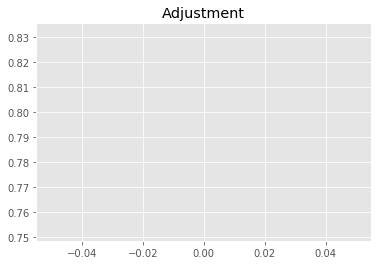

8882421193.761608
1


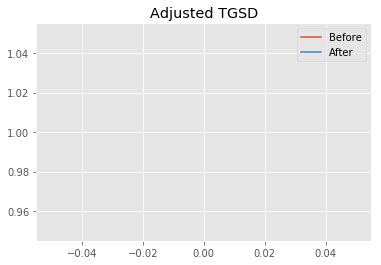

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.4923 	4.2161 	22360.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.13053 	1.39697 	37321 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 28.2098
New Misfit: 24.2321
Convergence:
0.14100351855235055

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9235 		1.0000


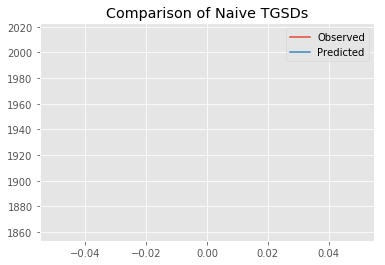

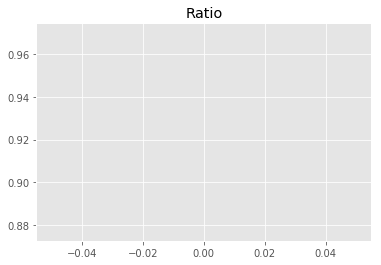

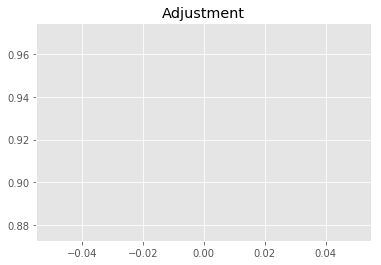

10356789848.755802
1


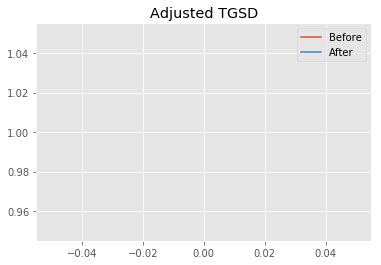

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.13053 	1.39697 	37321 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.04068 	1.85045 	42269.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.2321
New Misfit: 23.6641
Convergence:
0.0234406777327154

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9214 		1.0000


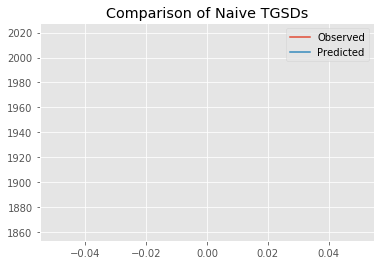

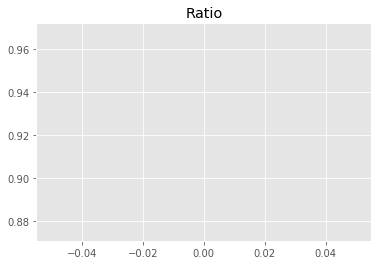

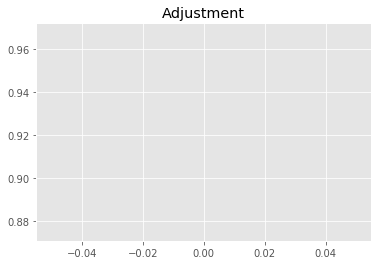

10333822526.263885
1


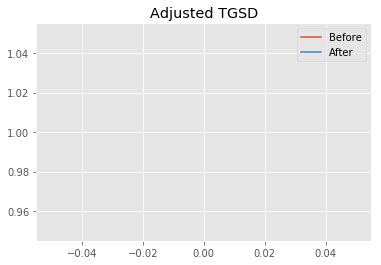

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.04068 	1.85045 	42269.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00032 	1.89087 	44903.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6641
New Misfit: 23.6031
Convergence:
0.00257733062028734

____________________
a = 1.00032	b = 1.89087	            h1 = 44903.20777	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.603097122146092
Prior Misfit: 512.52,	 Post Misfit: 23.6031


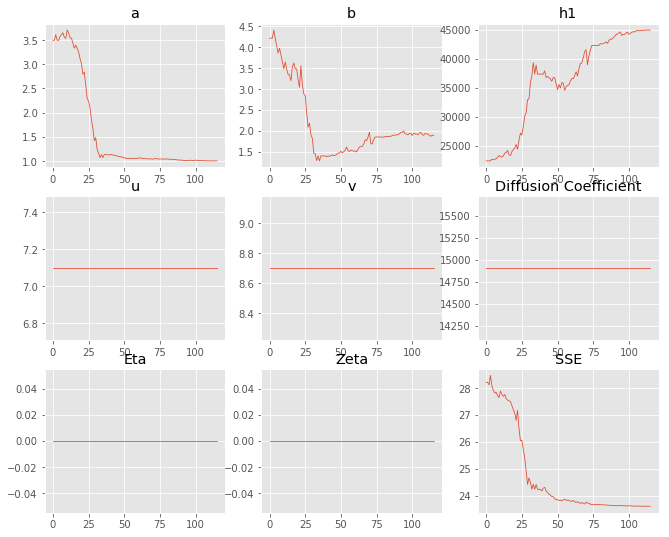

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.4923,1.00032
b,4.2161,1.89087
eta,0,0
ftt,"6,458","6,458"
h1,"22,360.5","44,903.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 11 Time: 0.070 minutes


Estimated remaining run time: 0.510 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.18e+03 	1.86e+03 	0.8546 		1.0000


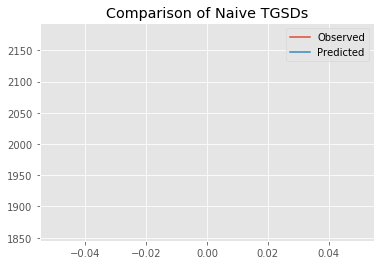

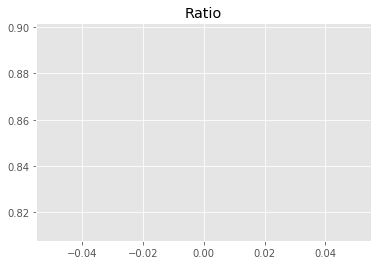

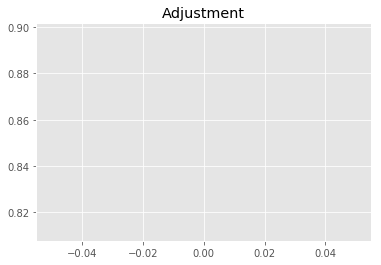

9584879757.985249
1


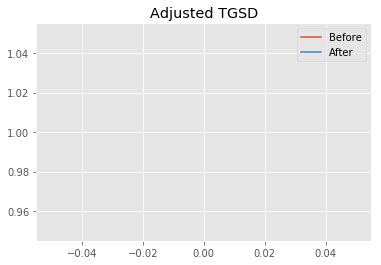

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.80723 	4.07006 	40634.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.17491 	2.06099 	44639.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.8526
New Misfit: 23.9013
Convergence:
0.03827776901976727

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.01e+03 	1.86e+03 	0.9255 		1.0000


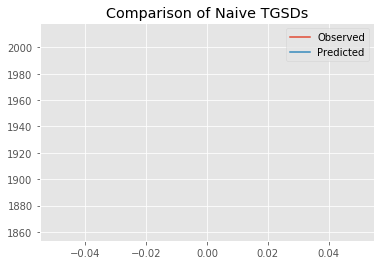

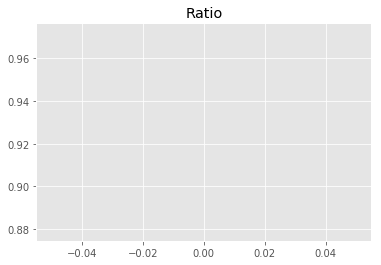

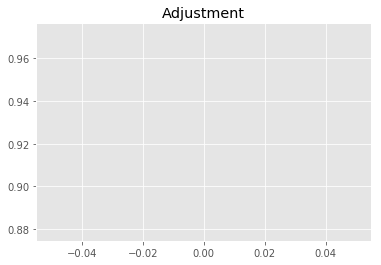

10379186730.646076
1


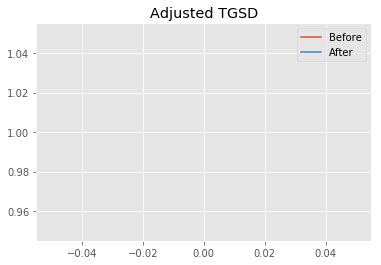

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.17491 	2.06099 	44639.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00948 	1.90337 	44904.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.9013
New Misfit: 23.6111
Convergence:
0.012141058098034825

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.00e+03 	1.86e+03 	0.9303 		1.0000


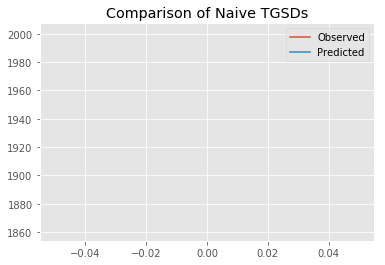

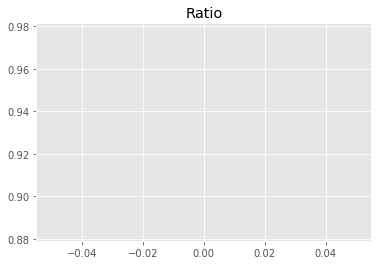

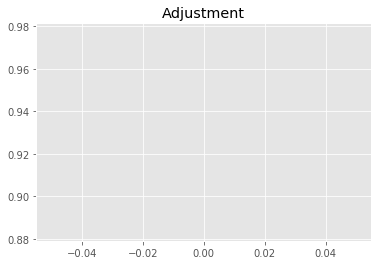

10432874629.389475
1


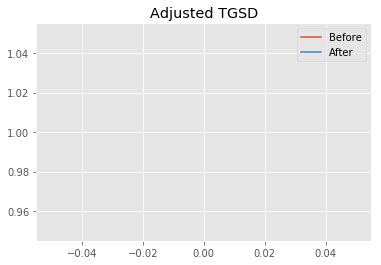

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00948 	1.90337 	44904.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00025 	1.90231 	44898.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6111
New Misfit: 23.6028
Convergence:
0.00035358581975021433

____________________
a = 1.00025	b = 1.90231	            h1 = 44898.86509	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.60277364504784
Prior Misfit: 430.846,	 Post Misfit: 23.6028


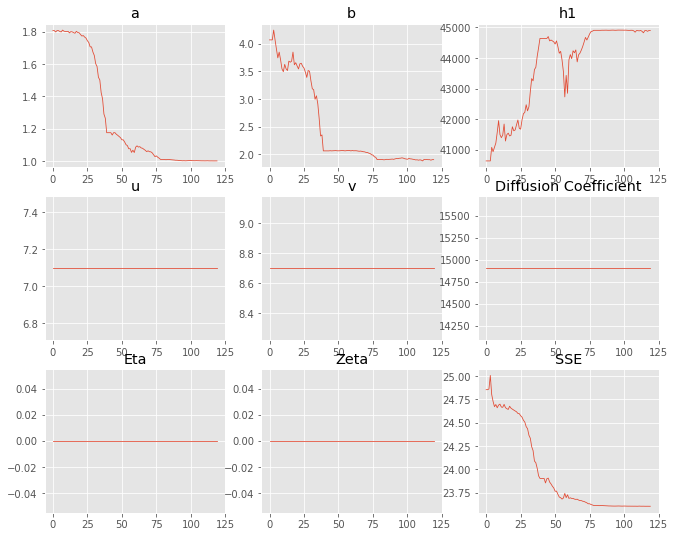

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.80723,1.00025
b,4.07006,1.90231
eta,0,0
ftt,"6,458","6,458"
h1,"40,634.8","44,898.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 12 Time: 0.071 minutes


Estimated remaining run time: 0.450 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.15e+03 	1.86e+03 	0.8644 		1.0000


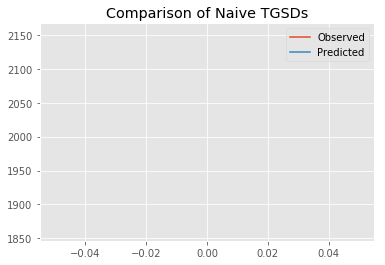

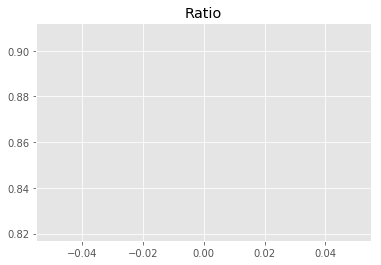

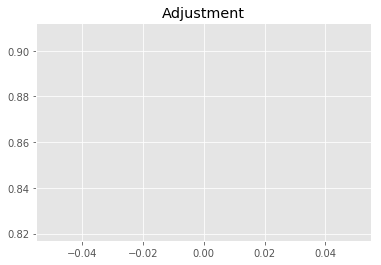

9694453011.989464
1


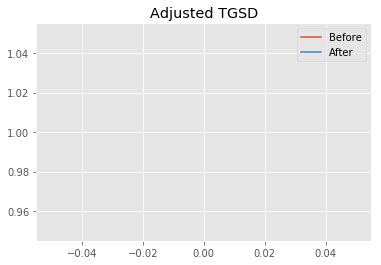

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.08461 	3.46884 	39613.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|2.05856 	4.45647 	40862.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 25.5154
New Misfit: 25.0368
Convergence:
0.018758754809646182

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.19e+03 	1.86e+03 	0.8486 		1.0000


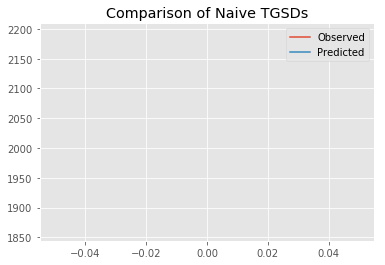

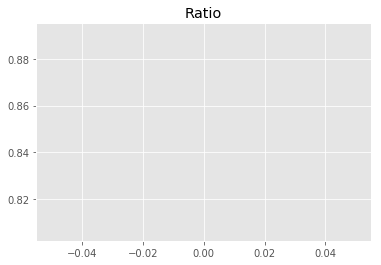

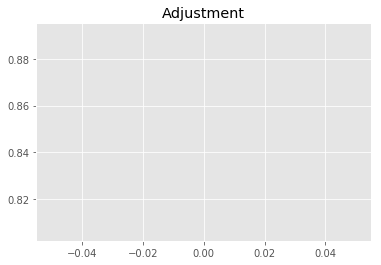

9517532964.400978
1


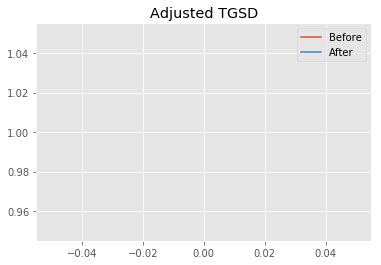

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.05856 	4.45647 	40862.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.73708 	4.07878 	44914.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 25.0368
New Misfit: 24.5063
Convergence:
0.02118844880890729

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.14e+03 	1.86e+03 	0.8679 		1.0000


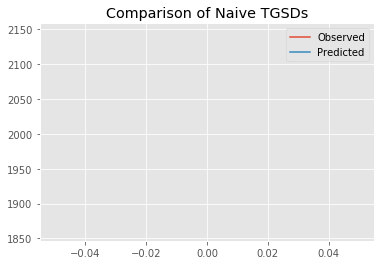

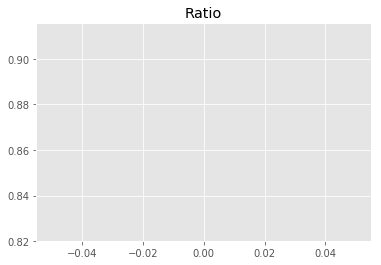

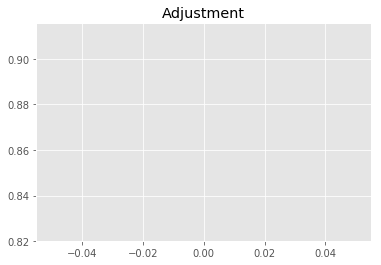

9733063523.669134
1


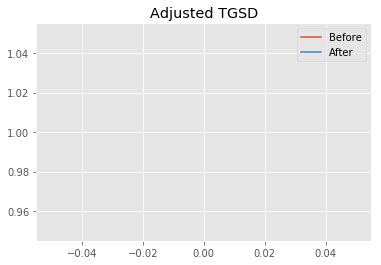

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.73708 	4.07878 	44914.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.11501 	2.14681 	44899.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.5063
New Misfit: 23.708
Convergence:
0.03257689202298774

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9201 		1.0000


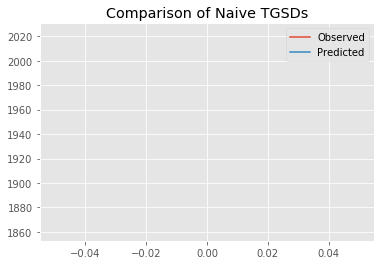

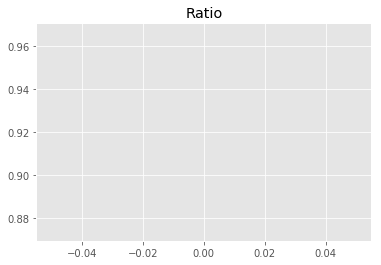

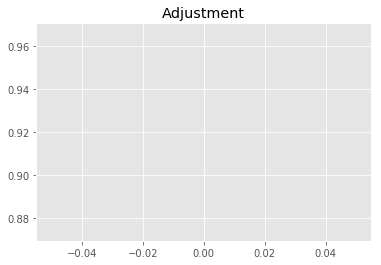

10318835561.18571
1


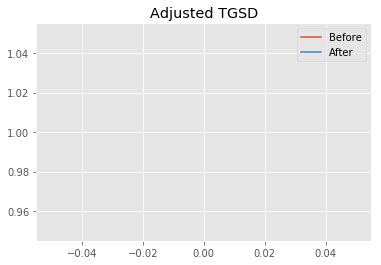

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.11501 	2.14681 	44899.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00147 	1.92131 	44911 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.708
New Misfit: 23.6044
Convergence:
0.004370241085794792

____________________
a = 1.00147	b = 1.92131	            h1 = 44911.04623	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.604356175499714
Prior Misfit: 453.356,	 Post Misfit: 23.6044


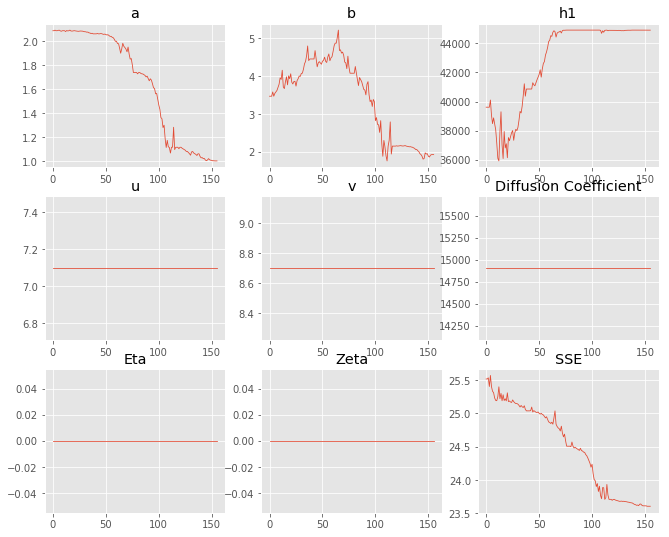

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.08461,1.00147
b,3.46884,1.92131
eta,0,0
ftt,"6,458","6,458"
h1,"39,613.7","44,911"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 13 Time: 0.086 minutes


Estimated remaining run time: 0.396 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.31e+03 	1.86e+03 	0.8048 		1.0000


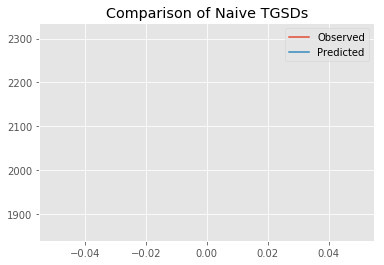

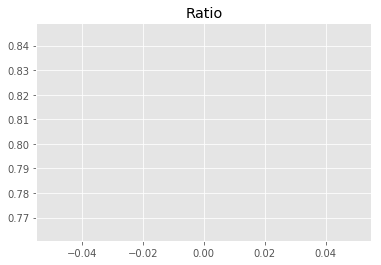

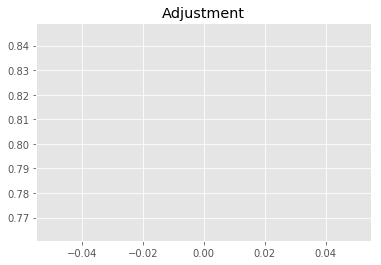

9025846692.80456
1


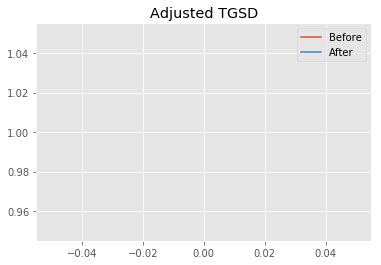

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.56572 	2.72518 	19923.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.69135 	2.52726 	29434.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 28.8659
New Misfit: 25.3964
Convergence:
0.1201945008159313

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.21e+03 	1.86e+03 	0.8406 		1.0000


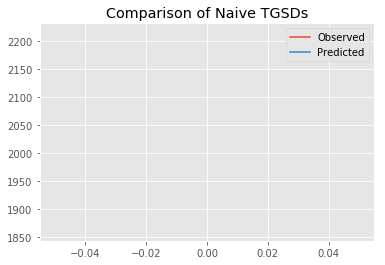

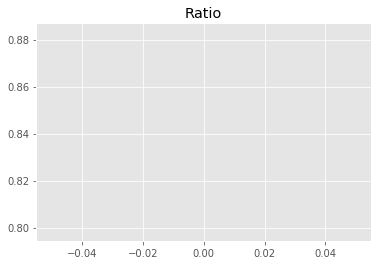

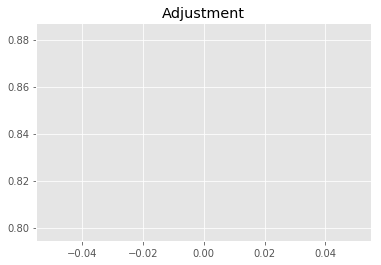

9427729752.812307
1


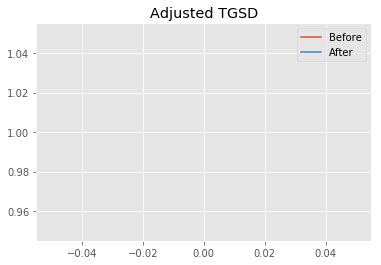

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.69135 	2.52726 	29434.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.31463 	1.86495 	35022.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 25.3964
New Misfit: 24.1786
Convergence:
0.04795071454842672

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.10e+03 	1.86e+03 	0.8857 		1.0000


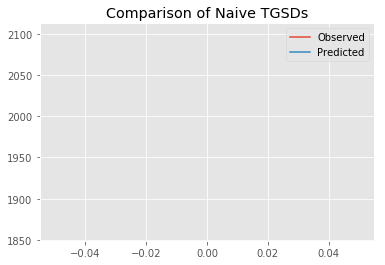

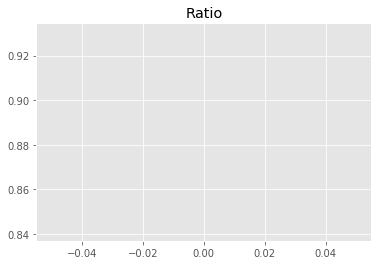

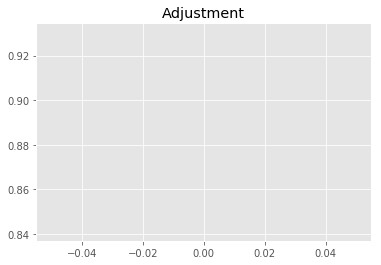

9933230921.242617
1


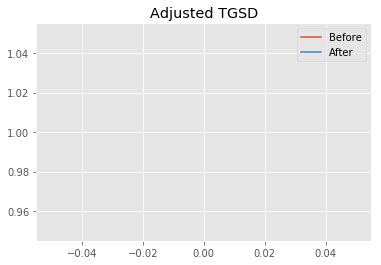

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.31463 	1.86495 	35022.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.04428 	2.02781 	44494.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.1786
New Misfit: 23.6471
Convergence:
0.021982498032522273

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9226 		1.0000


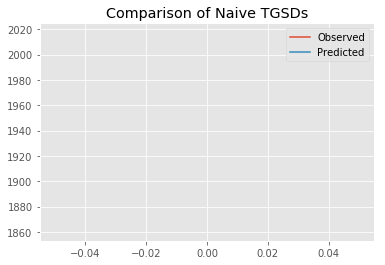

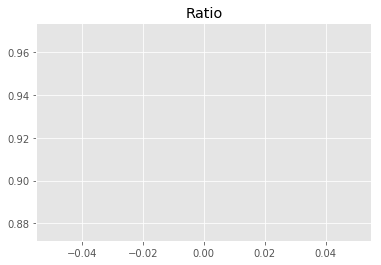

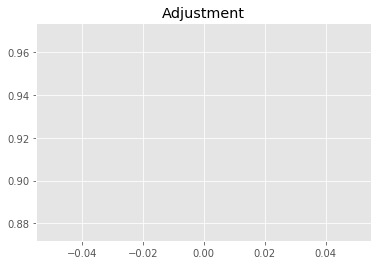

10347102113.202671
1


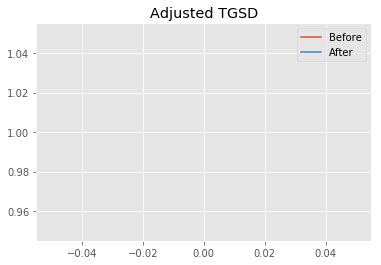

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.04428 	2.02781 	44494.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00006 	1.90413 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6471
New Misfit: 23.6025
Convergence:
0.001885222670603625

____________________
a = 1.00006	b = 1.90413	            h1 = 44914.99990	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.602530618729993
Prior Misfit: 528.165,	 Post Misfit: 23.6025


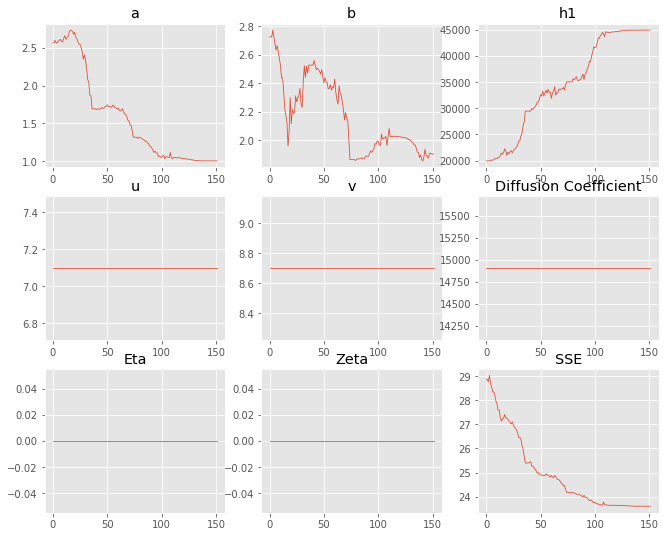

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.56572,1.00006
b,2.72518,1.90413
eta,0,0
ftt,"6,458","6,458"
h1,"19,923.1","44,915"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 14 Time: 0.085 minutes


Estimated remaining run time: 0.336 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.19e+03 	1.86e+03 	0.8497 		1.0000


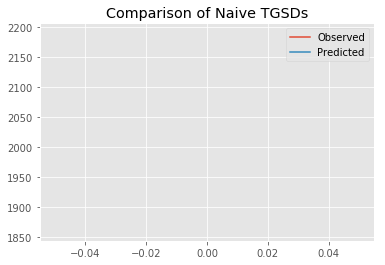

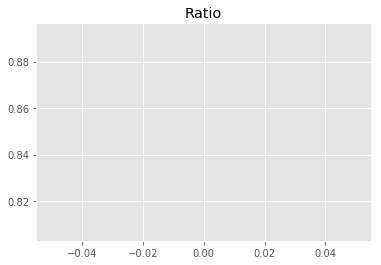

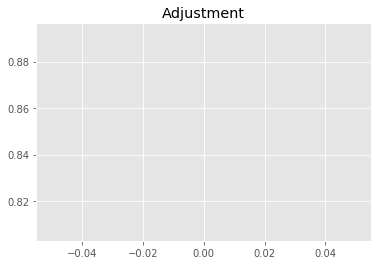

9529375467.665829
1


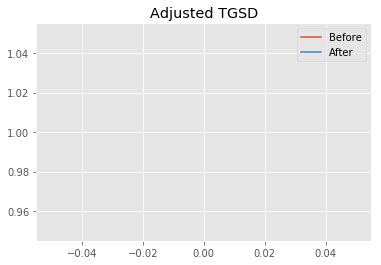

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.55144 	1.88047 	28774.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.20509 	2.38925 	43275.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.8764
New Misfit: 23.8377
Convergence:
0.041753173715912716

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.06e+03 	1.86e+03 	0.9038 		1.0000


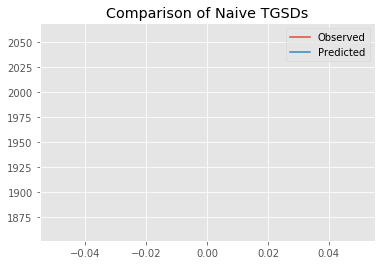

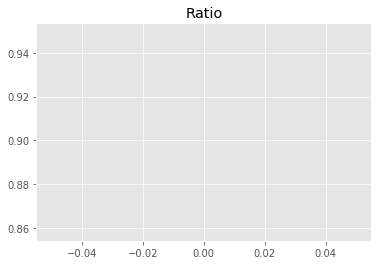

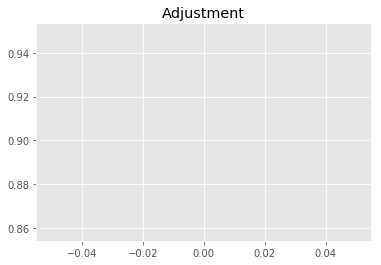

10136124517.66992
1


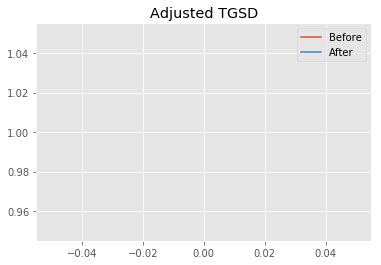

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.20509 	2.38925 	43275.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.01799 	1.88485 	44627 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.8377
New Misfit: 23.6242
Convergence:
0.008956423335038747

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.00e+03 	1.86e+03 	0.9304 		1.0000


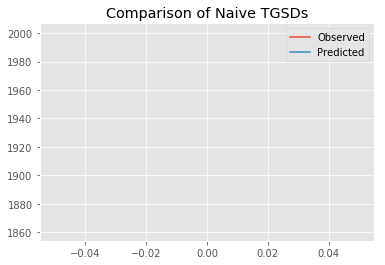

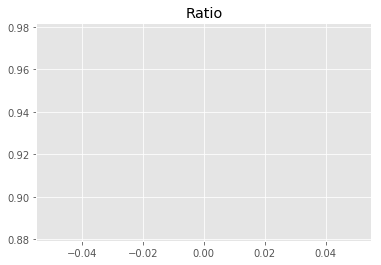

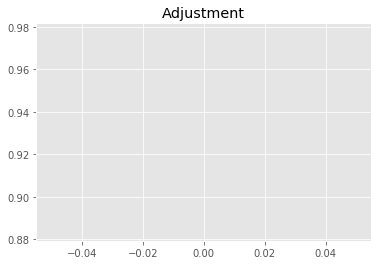

10434654898.998583
1


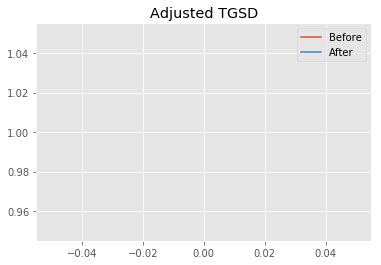

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01799 	1.88485 	44627 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00288 	1.90271 	44831.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6242
New Misfit: 23.6053
Convergence:
0.0008006002304347852

____________________
a = 1.00288	b = 1.90271	            h1 = 44831.71128	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.605311778595553
Prior Misfit: 430.502,	 Post Misfit: 23.6053


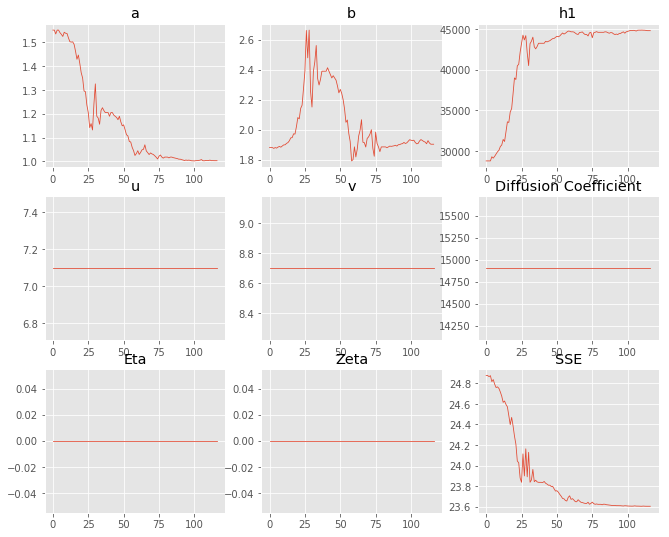

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.55144,1.00288
b,1.88047,1.90271
eta,0,0
ftt,"6,458","6,458"
h1,"28,774.5","44,831.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 15 Time: 0.067 minutes


Estimated remaining run time: 0.269 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.39e+03 	1.86e+03 	0.7785 		1.0000


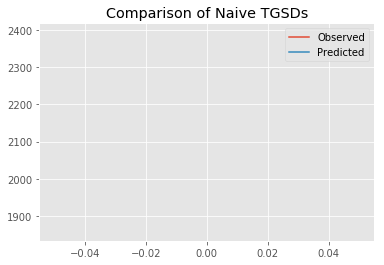

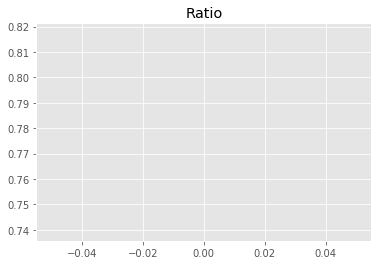

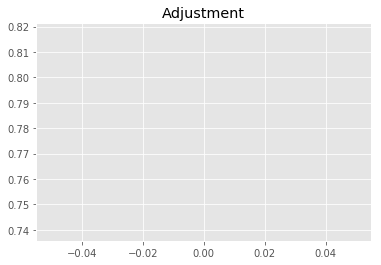

8730373518.015299
1


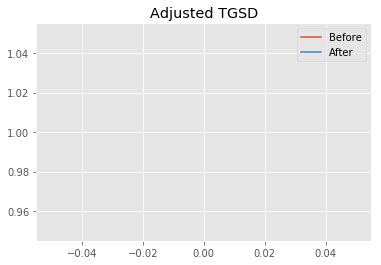

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.4153 	4.50713 	21903.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.16518 	1.48134 	35336.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 28.3693
New Misfit: 24.0792
Convergence:
0.15122142688485876

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.06e+03 	1.86e+03 	0.9047 		1.0000


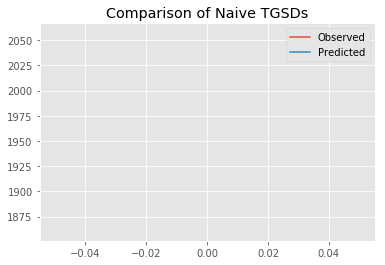

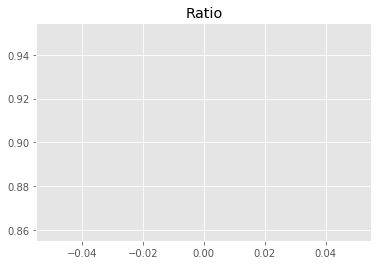

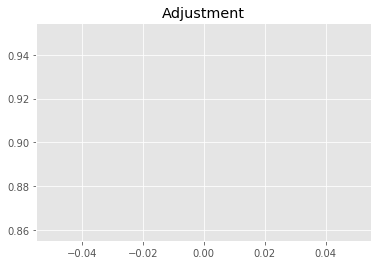

10145799581.627811
1


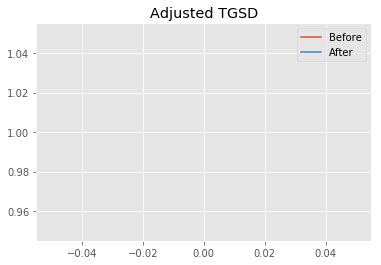

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.16518 	1.48134 	35336.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.0617 	1.94476 	42219.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.0792
New Misfit: 23.6915
Convergence:
0.016100351650772542

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.03e+03 	1.86e+03 	0.9166 		1.0000


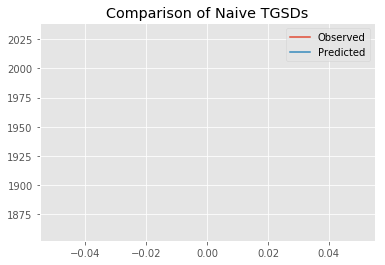

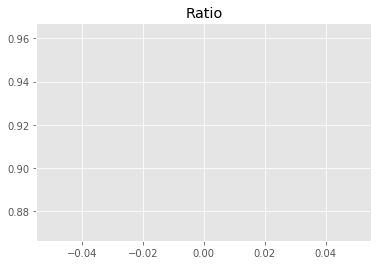

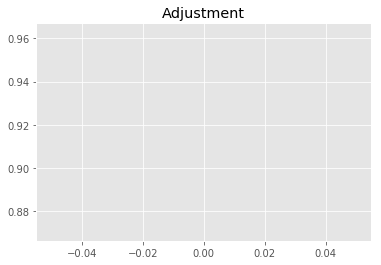

10279691634.283054
1


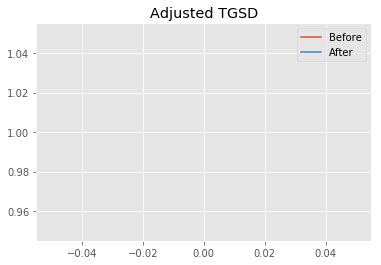

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0617 	1.94476 	42219.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.0007 	1.91195 	44914.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6915
New Misfit: 23.6032
Convergence:
0.0037281309739011443

____________________
a = 1.00070	b = 1.91195	            h1 = 44914.82958	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.60321716583126
Prior Misfit: 513.432,	 Post Misfit: 23.6032


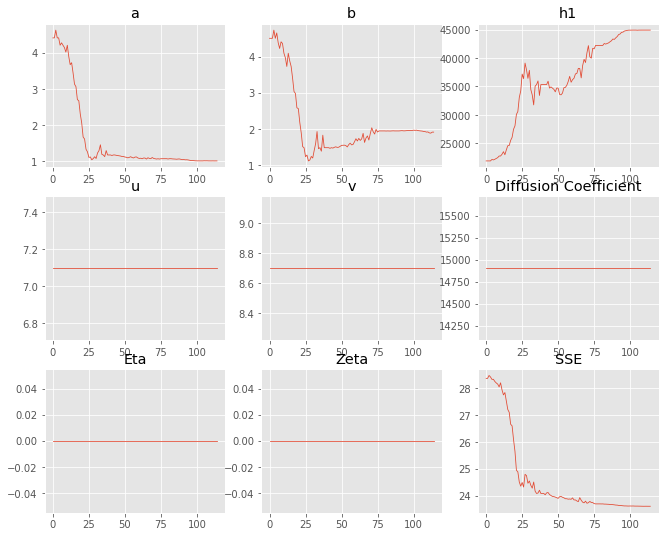

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.4153,1.0007
b,4.50713,1.91195
eta,0,0
ftt,"6,458","6,458"
h1,"21,903.4","44,914.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 16 Time: 0.068 minutes


Estimated remaining run time: 0.202 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.33e+03 	1.86e+03 	0.8000 		1.0000


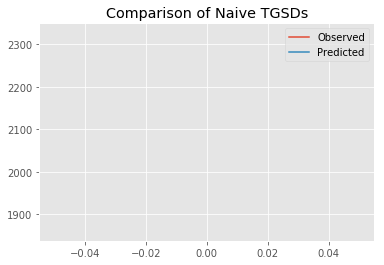

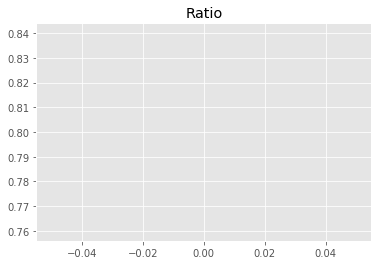

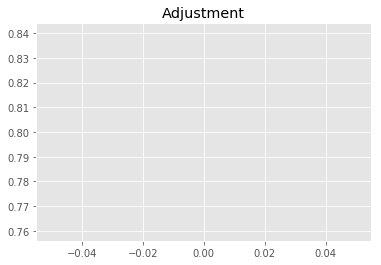

8971756447.622162
1


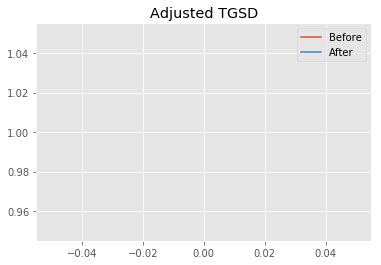

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.09671 	1.93905 	21915.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.30724 	1.89596 	30167.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 30.115
New Misfit: 24.8052
Convergence:
0.17631553349364734

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.16e+03 	1.86e+03 	0.8601 		1.0000


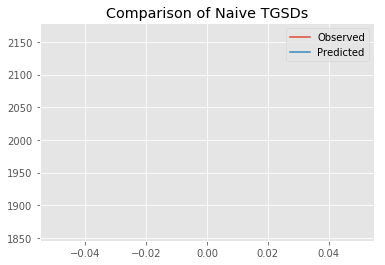

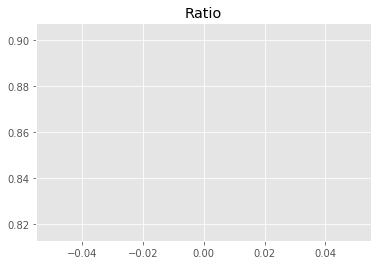

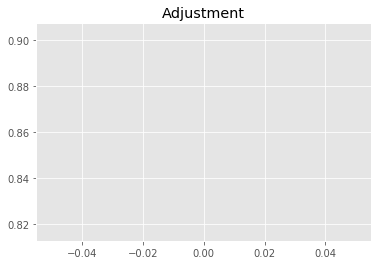

9646514121.585453
1


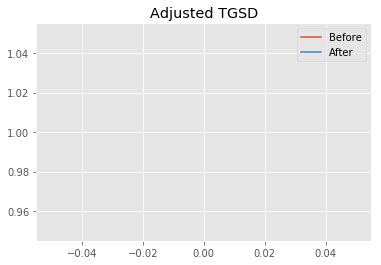

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.30724 	1.89596 	30167.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.01595 	2.04813 	44320.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.8052
New Misfit: 23.6691
Convergence:
0.04580158581513739

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9202 		1.0000


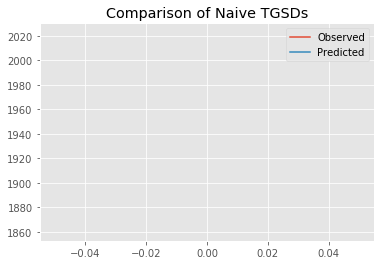

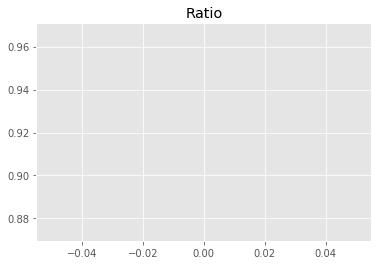

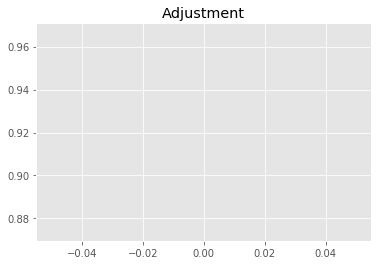

10320143210.94189
1


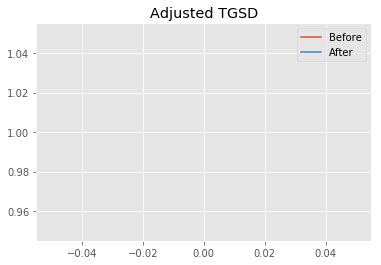

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01595 	2.04813 	44320.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.002 	1.91516 	44915 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6691
New Misfit: 23.6042
Convergence:
0.0027410239816195226

____________________
a = 1.00200	b = 1.91516	            h1 = 44914.99989	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.604248450141768
Prior Misfit: 580.95,	 Post Misfit: 23.6042


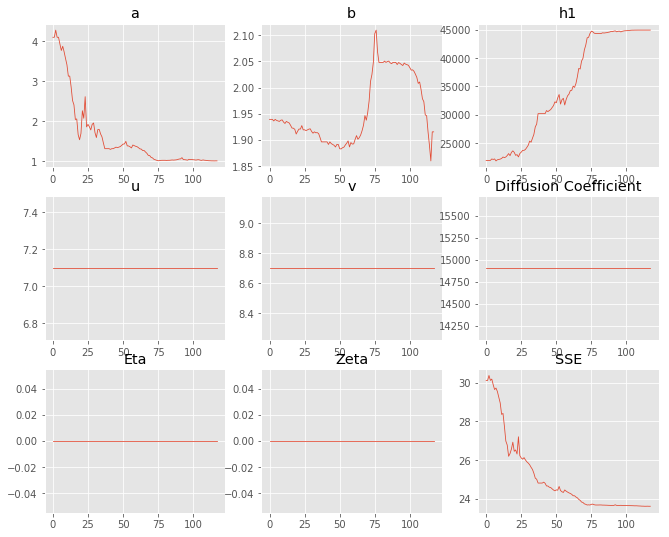

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.09671,1.002
b,1.93905,1.91516
eta,0,0
ftt,"6,458","6,458"
h1,"21,915.4","44,915"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 17 Time: 0.069 minutes


Estimated remaining run time: 0.135 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.08e+03 	1.86e+03 	0.8947 		1.0000


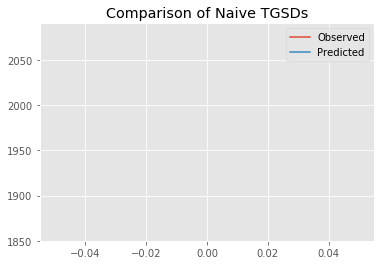

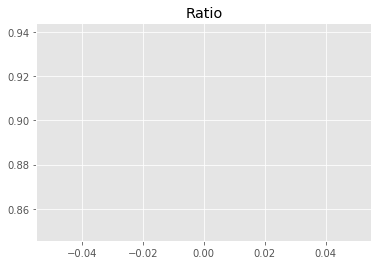

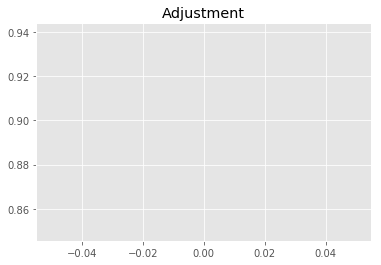

10034136730.75595
1


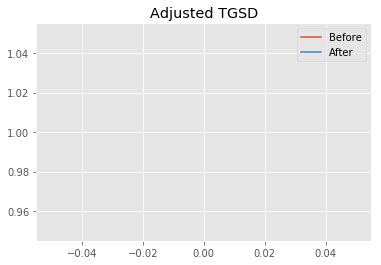

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.50851 	1.33841 	31802.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.30377 	1.79767 	35053.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 25.7536
New Misfit: 24.1872
Convergence:
0.06082409590294606

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.09e+03 	1.86e+03 	0.8887 		1.0000


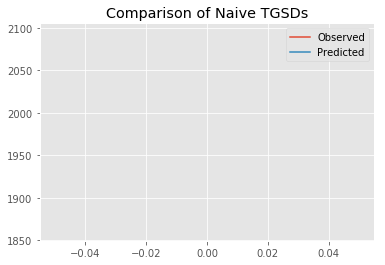

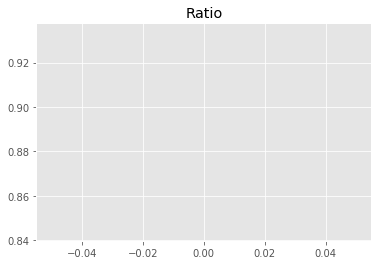

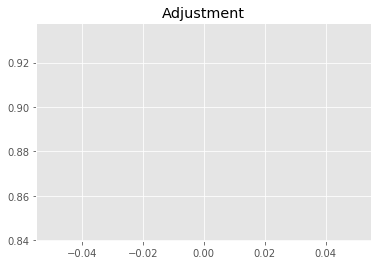

9967098948.03931
1


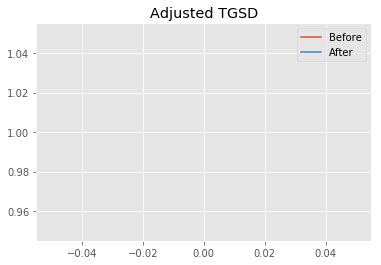

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.30377 	1.79767 	35053.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.10682 	2.09434 	41305.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.1872
New Misfit: 23.803
Convergence:
0.01588280193733678

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.05e+03 	1.86e+03 	0.9060 		1.0000


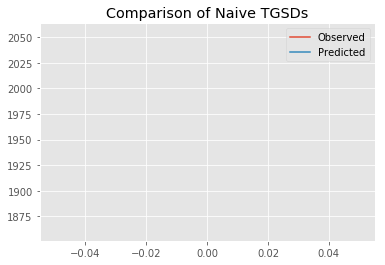

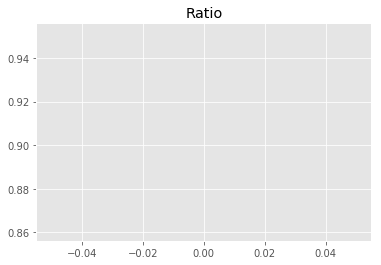

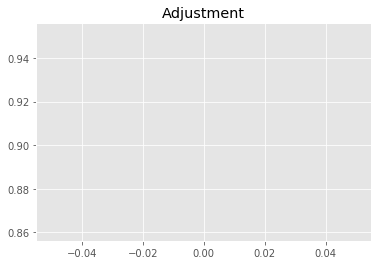

10160673508.747253
1


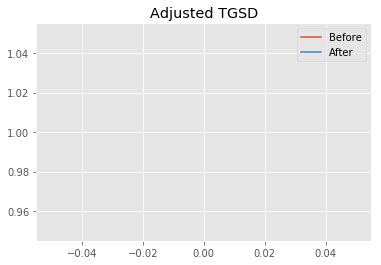

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.10682 	2.09434 	41305.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00995 	1.8835 	44805.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.803
New Misfit: 23.6145
Convergence:
0.007917183919488901

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.00e+03 	1.86e+03 	0.9310 		1.0000


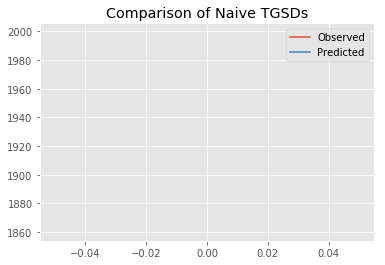

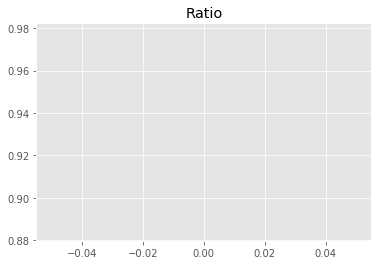

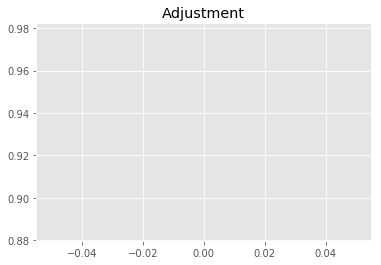

10441388709.383224
1


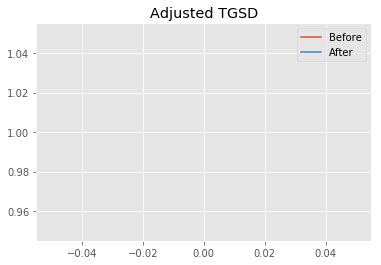

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00995 	1.8835 	44805.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00005 	1.90442 	44907.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6145
New Misfit: 23.6026
Convergence:
0.0005062780066198599

____________________
a = 1.00005	b = 1.90442	            h1 = 44907.67710	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.602584008786
Prior Misfit: 467.761,	 Post Misfit: 23.6026


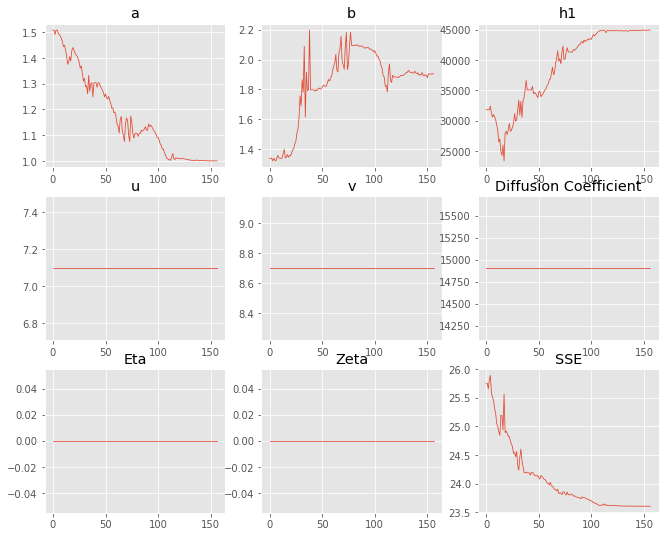

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.50851,1.00005
b,1.33841,1.90442
eta,0,0
ftt,"6,458","6,458"
h1,"31,802.8","44,907.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 18 Time: 0.085 minutes


Estimated remaining run time: 0.068 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.19e+03 	1.86e+03 	0.8484 		1.0000


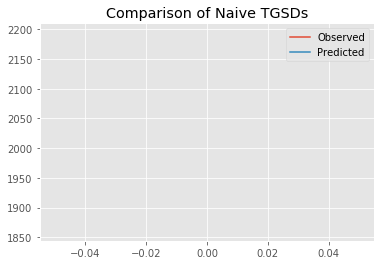

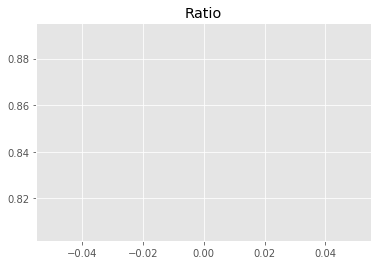

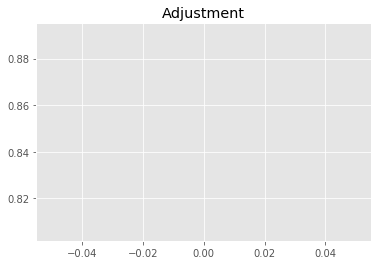

9515152862.690207
1


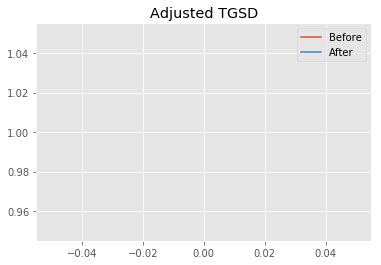

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.86832 	1.54216 	24988.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00071 	1.1056 	31618.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 31.2862
New Misfit: 23.9166
Convergence:
0.23555243343455395

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.06e+03 	1.86e+03 	0.9019 		1.0000


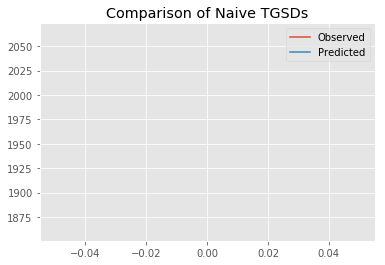

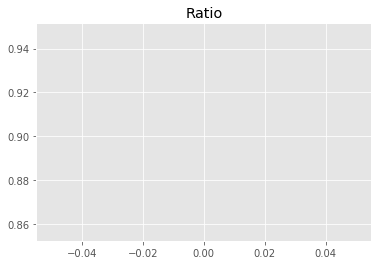

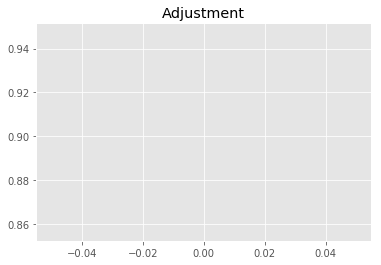

10114876673.108973
1


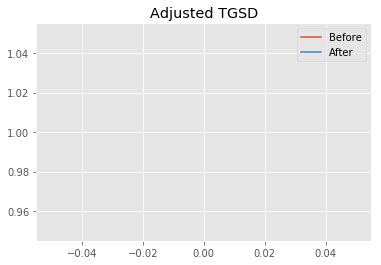

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00071 	1.1056 	31618.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00013 	1.35818 	36157.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.9166
New Misfit: 23.7517
Convergence:
0.006894523727954098

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.03e+03 	1.86e+03 	0.9155 		1.0000


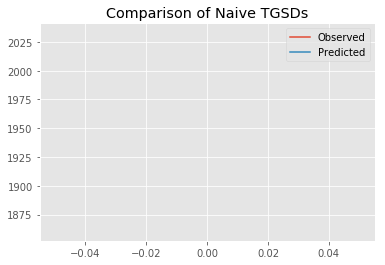

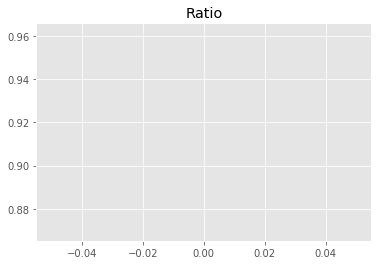

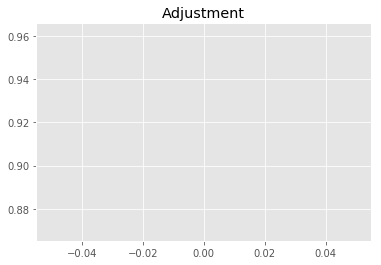

10267723617.1411
1


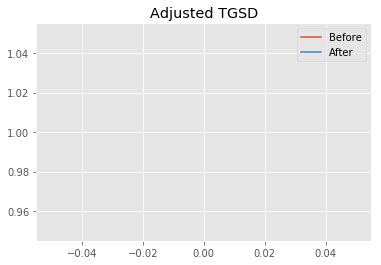

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00013 	1.35818 	36157.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1 	1.87305 	43898.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.7517
New Misfit: 23.6119
Convergence:
0.005886072252961221

____________________
a = 1.00000	b = 1.87305	            h1 = 43898.56592	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.611944344229425
Prior Misfit: 678.086,	 Post Misfit: 23.6119


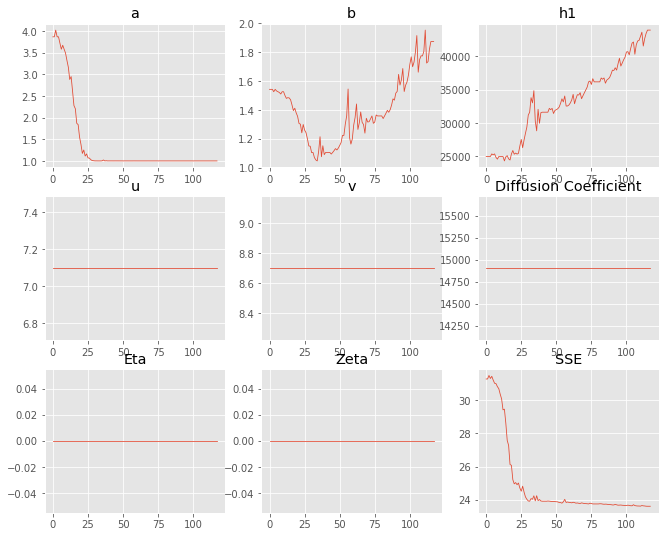

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.86832,1
b,1.54216,1.87305
eta,0,0
ftt,"6,458","6,458"
h1,"24,988.4","43,898.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 19 Time: 0.068 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.30e+03 	1.86e+03 	0.8082 		1.0000


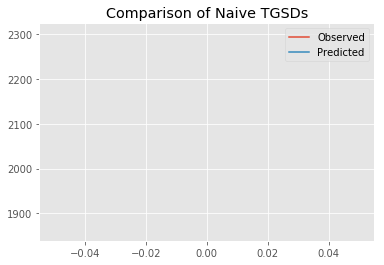

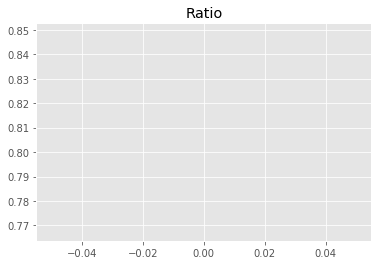

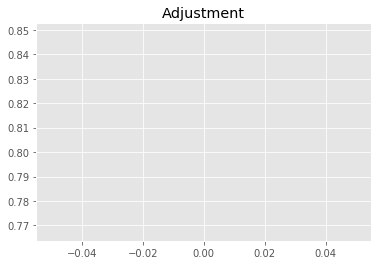

9063803824.59707
1


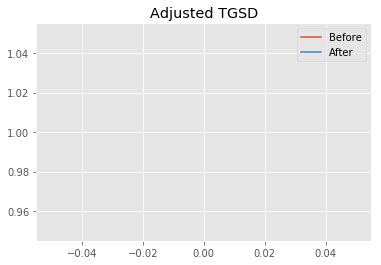

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.83955 	4.20892 	28611.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.03218 	1.87597 	44443.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 26.5812
New Misfit: 23.648
Convergence:
0.11034940160595762

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.00e+03 	1.86e+03 	0.9306 		1.0000


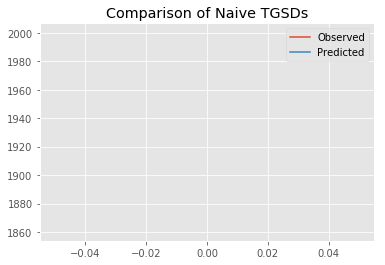

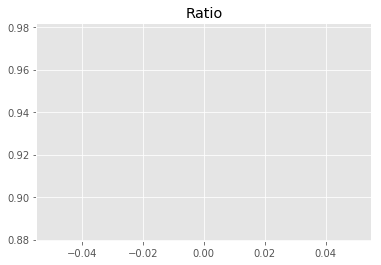

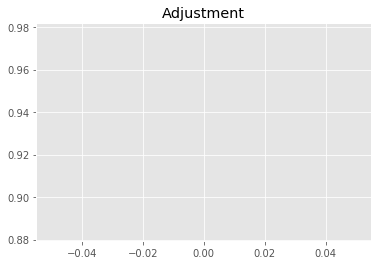

10436556729.950624
1


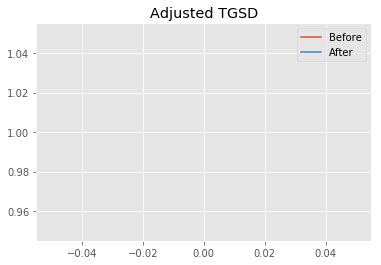

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03218 	1.87597 	44443.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00477 	1.9204 	44882.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.648
New Misfit: 23.6067
Convergence:
0.0017458325198238351

____________________
a = 1.00477	b = 1.92040	            h1 = 44882.09442	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.60668311970562
Prior Misfit: 469.569,	 Post Misfit: 23.6067


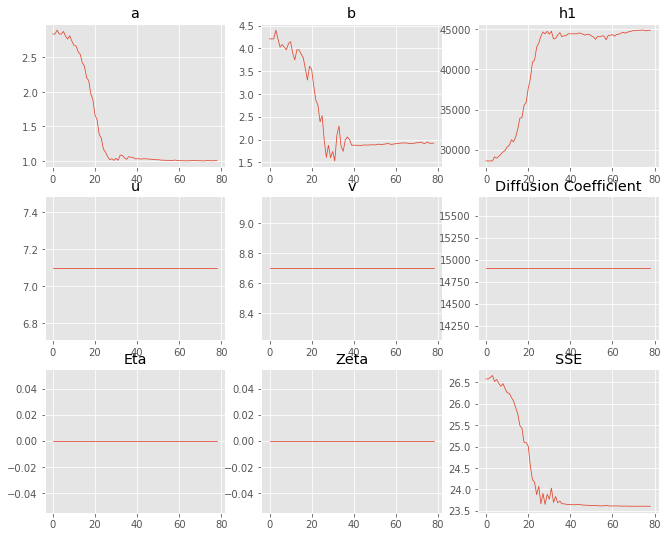

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.83955,1.00477
b,4.20892,1.9204
eta,0,0
ftt,"6,458","6,458"
h1,"28,611.7","44,882.1"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 20 Time: 0.047 minutes


Estimated remaining run time: -0.067 minutes


Total Run Time: 1.41172 minutes


[{'a': 1.0000000359547347,
  'b': 1.9015020336314756,
  'h1': 44914.982169746865,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0000151505076398,
  'b': 1.90469502084408,
  'h1': 44914.999861253935,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.000006385091294,
  'b': 1.9062352146243866,
  'h1': 44910.838472550044,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0000021908862586,
  'b': 1.9033304523997412,
  'h1': 44914.999999919026,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0000004804081966,
  'b': 1.9021359854018713,
  'h1': 44828.78543188033,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.00007

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
0,1,1.9015,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6025
3,1,1.90333,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6025
1,1.00002,1.9047,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6025
13,1.00006,1.90413,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6025
2,1.00001,1.90624,"44,910.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6026
17,1.00005,1.90442,"44,907.7",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6026
6,1.00003,1.89403,"44,914.1",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6026
11,1.00025,1.90231,"44,898.9",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6028
10,1.00032,1.89087,"44,903.2",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6031
5,1.00007,1.91218,"44,884.2",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6031


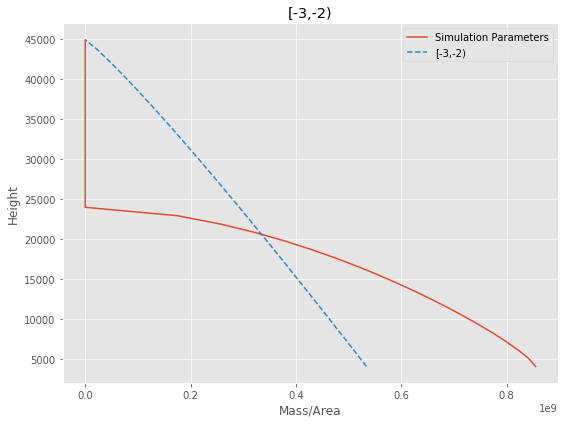

[-3,-2) Run Time: 1.41458 minutes


Mass Test: 23412237340.63284
========[-2,-1)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.30e+03 	1.90e+03 	0.8243 		1.0000


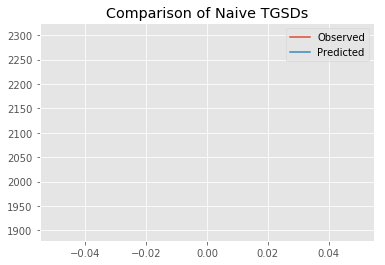

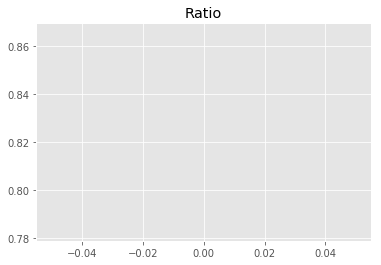

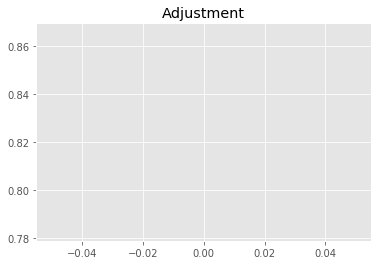

9433887917.170935
1


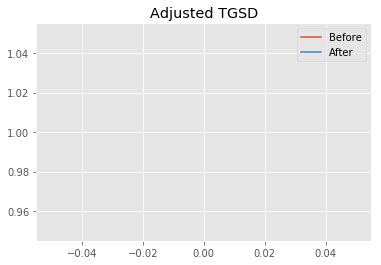

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.55338 	3.87566 	20751.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.58915 	2.28867 	23078.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 28.1181
New Misfit: 22.2542
Convergence:
0.20854481763682503

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.07e+03 	1.90e+03 	0.9193 		1.0000


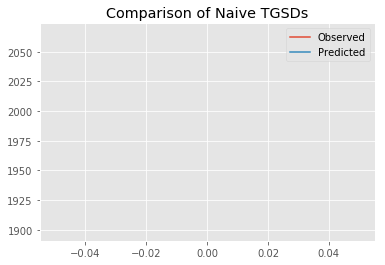

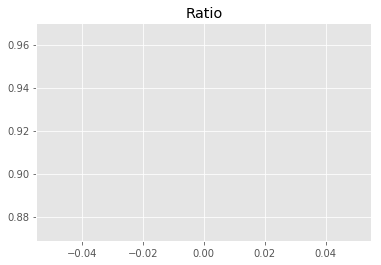

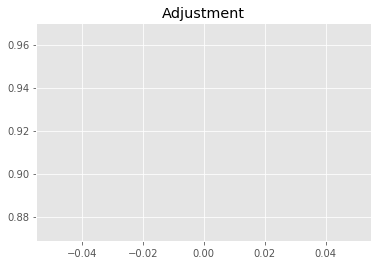

10521493328.00397
1


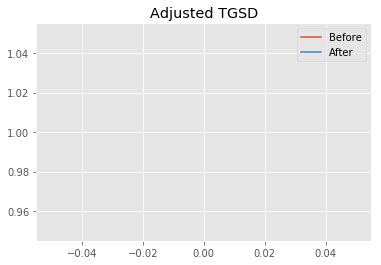

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.58915 	2.28867 	23078.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.83182 	2.24206 	28835.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.2542
New Misfit: 21.7513
Convergence:
0.022598468976880767

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.94e+03 	1.90e+03 	0.9806 		1.0000


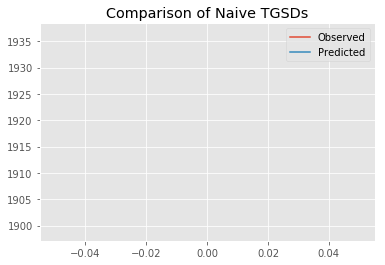

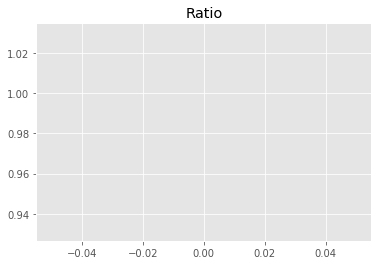

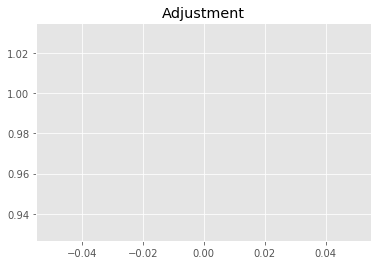

11223283909.632376
1


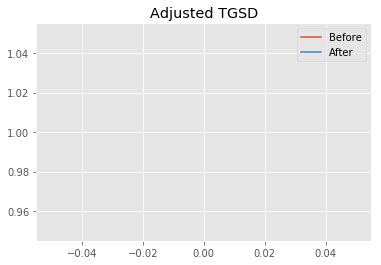

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.83182 	2.24206 	28835.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.66257 	1.91339 	27934.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7513
New Misfit: 21.7414
Convergence:
0.0004529632008594457

____________________
a = 1.66257	b = 1.91339	            h1 = 27934.60424	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 21.741414970427257
Prior Misfit: 463.859,	 Post Misfit: 21.7414


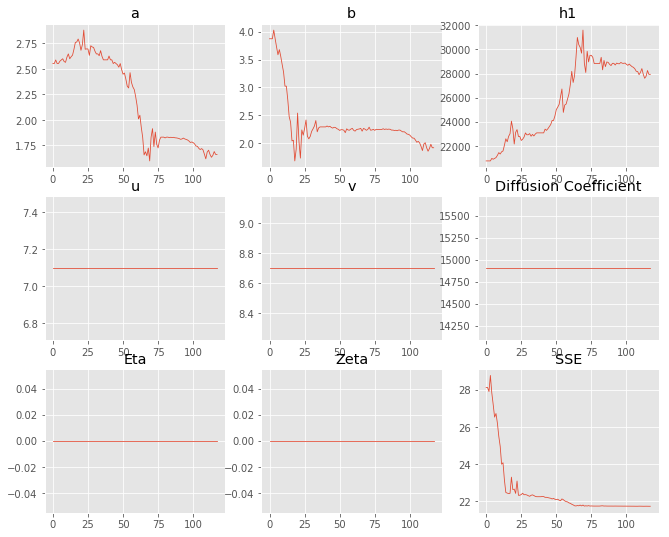

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.55338,1.66257
b,3.87566,1.91339
eta,0,0
ftt,"6,458","6,458"
h1,"20,751.5","27,934.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 1 Time: 0.067 minutes


Estimated remaining run time: 0.602 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.94e+03 	1.90e+03 	0.9811 		1.0000


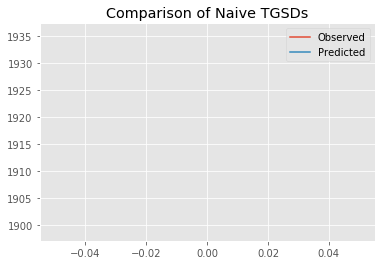

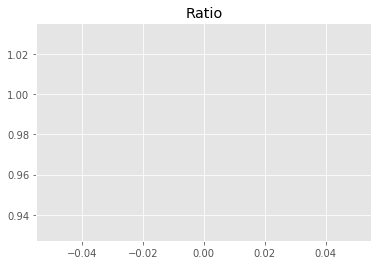

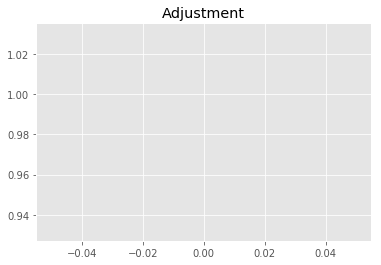

11229179022.784975
1


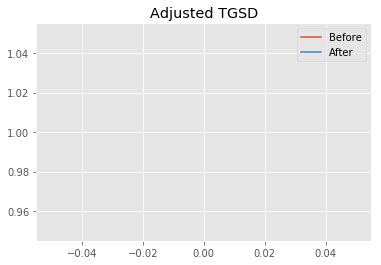

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0715 	2.56589 	29456.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.99325 	3.07358 	32826 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8182
New Misfit: 21.7764
Convergence:
0.00191373847895105

____________________
a = 1.99325	b = 3.07358	            h1 = 32826.04468	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 21.77642579119901
Prior Misfit: 358.606,	 Post Misfit: 21.7764


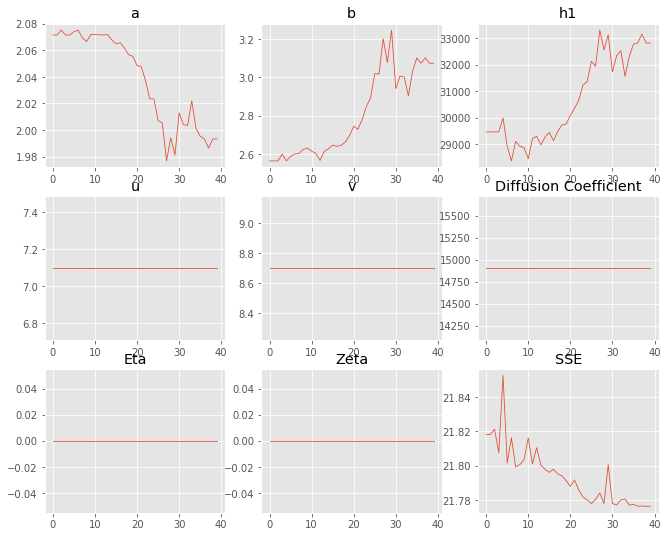

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.0715,1.99325
b,2.56589,3.07358
eta,0,0
ftt,"6,458","6,458"
h1,"29,456.7","32,826"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 2 Time: 0.030 minutes


Estimated remaining run time: 0.552 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.69e+03 	1.90e+03 	1.1225 		1.0000


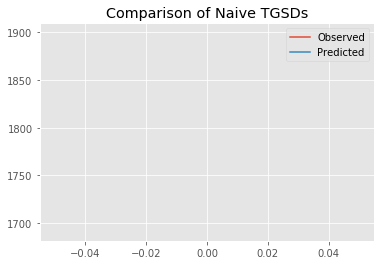

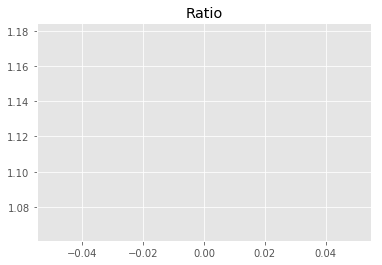

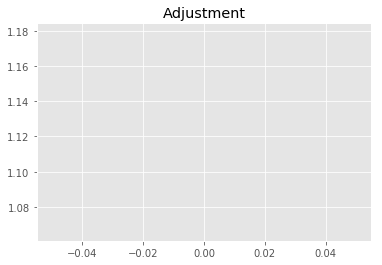

12847062208.05798
1


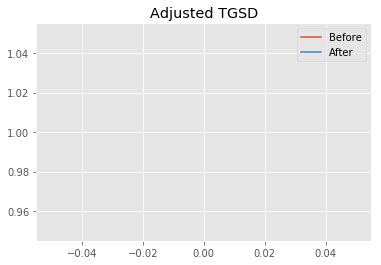

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97153 	3.15204 	42696.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.96996 	3.63322 	36666.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.277
New Misfit: 21.789
Convergence:
0.06392598573435235

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.92e+03 	1.90e+03 	0.9865 		1.0000


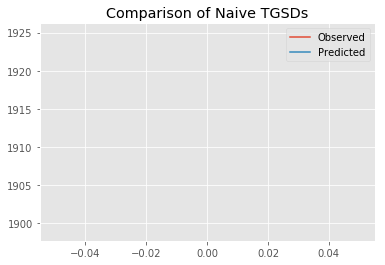

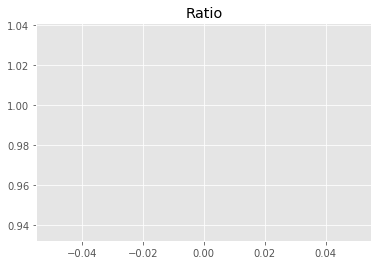

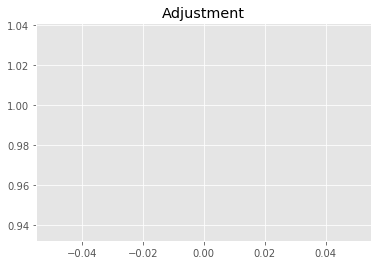

11290954037.116154
1


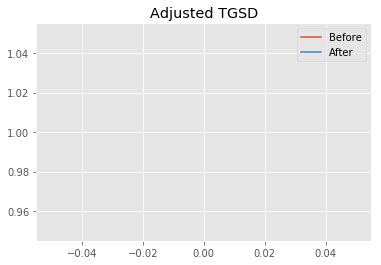

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96996 	3.63322 	36666.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.99899 	3.10219 	32847.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.789
New Misfit: 21.7773
Convergence:
0.0005376364399552213

____________________
a = 1.99899	b = 3.10219	            h1 = 32847.23155	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.77725278923991
Prior Misfit: 451.911,	 Post Misfit: 21.7773


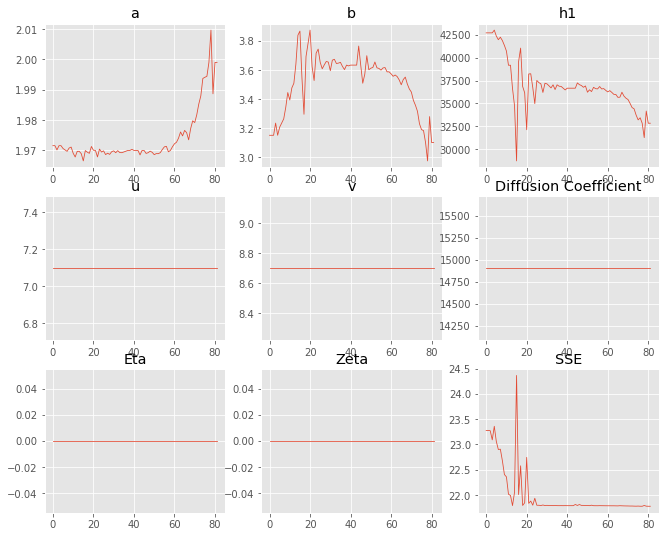

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.97153,1.99899
b,3.15204,3.10219
eta,0,0
ftt,"6,458","6,458"
h1,"42,696.3","32,847.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 3 Time: 0.049 minutes


Estimated remaining run time: 0.586 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.97e+03 	1.90e+03 	0.9661 		1.0000


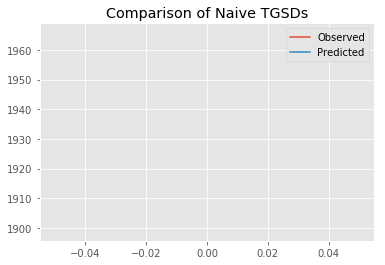

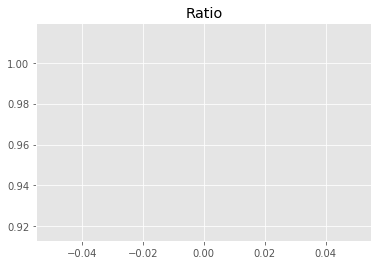

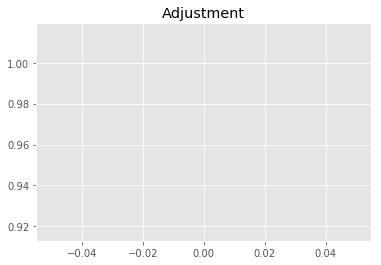

11057222932.294859
1


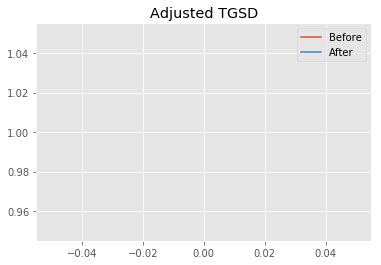

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.13245 	3.95831 	35590.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.11025 	3.48381 	33940.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8211
New Misfit: 21.7928
Convergence:
0.0012979445879598033

____________________
a = 2.11025	b = 3.48381	            h1 = 33940.29942	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 21.792812787595945
Prior Misfit: 352.866,	 Post Misfit: 21.7928


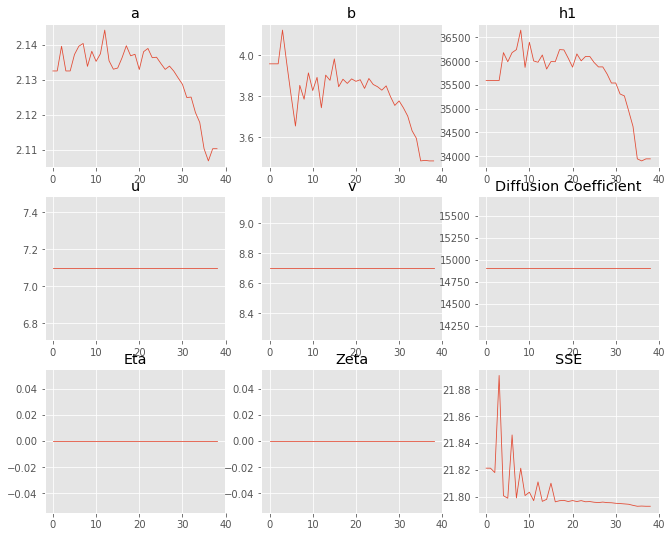

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.13245,2.11025
b,3.95831,3.48381
eta,0,0
ftt,"6,458","6,458"
h1,"35,590.9","33,940.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 4 Time: 0.028 minutes


Estimated remaining run time: 0.524 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.92e+03 	1.90e+03 	0.9910 		1.0000


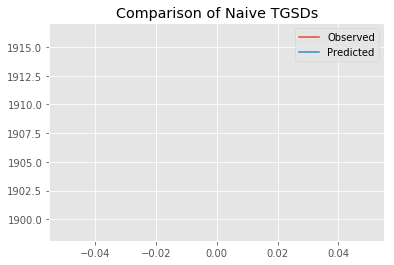

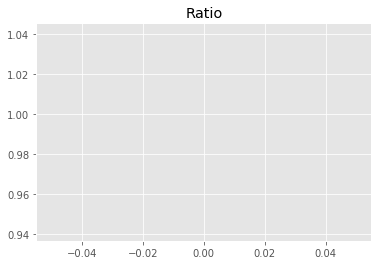

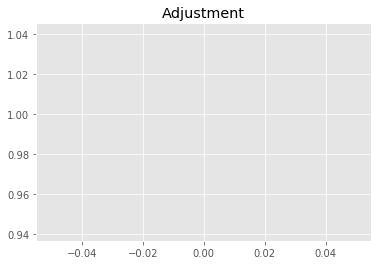

11342378730.487322
1


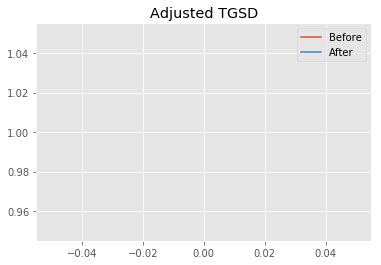

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.95281 	3.62752 	30753.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.01485 	3.72597 	36442.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.4742
New Misfit: 21.7902
Convergence:
0.03043574848620922

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.93e+03 	1.90e+03 	0.9815 		1.0000


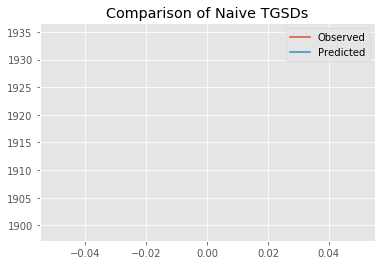

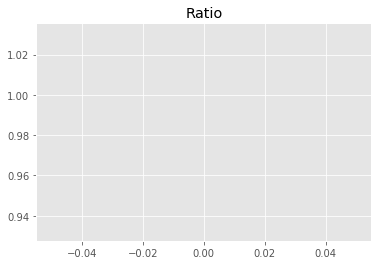

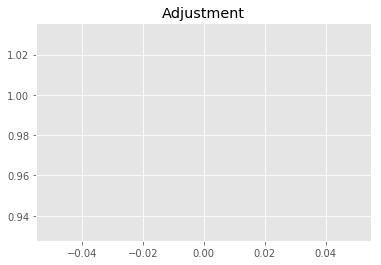

11233386931.384138
1


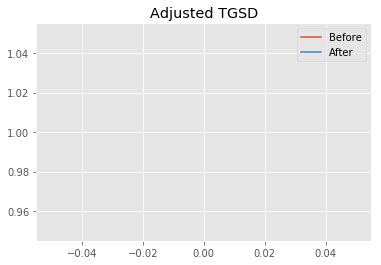

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01485 	3.72597 	36442.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.0184 	3.29038 	33861.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7902
New Misfit: 21.7807
Convergence:
0.0004342339257843592

____________________
a = 2.01840	b = 3.29038	            h1 = 33861.64583	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.78073143391362
Prior Misfit: 393.481,	 Post Misfit: 21.7807


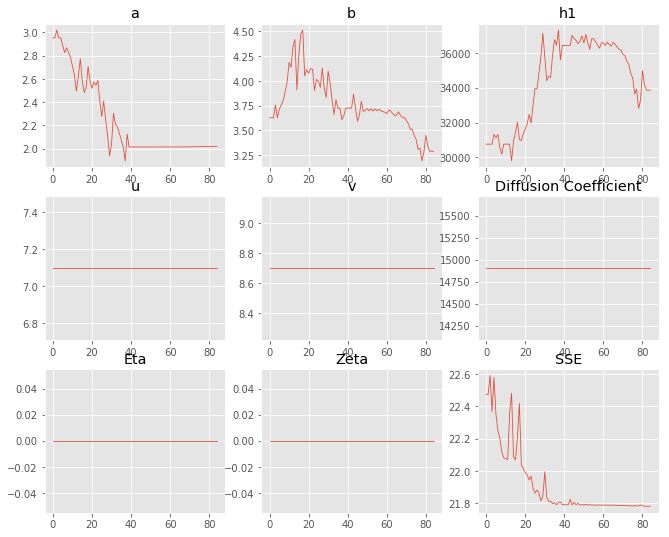

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.95281,2.0184
b,3.62752,3.29038
eta,0,0
ftt,"6,458","6,458"
h1,"30,753.2","33,861.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 5 Time: 0.053 minutes


Estimated remaining run time: 0.530 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.99e+03 	1.90e+03 	0.9550 		1.0000


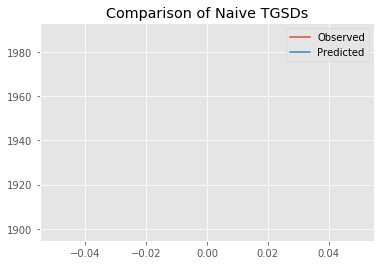

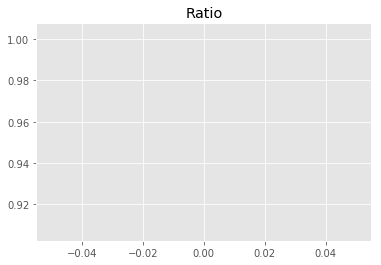

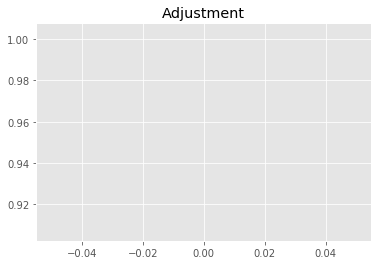

10929735959.706478
1


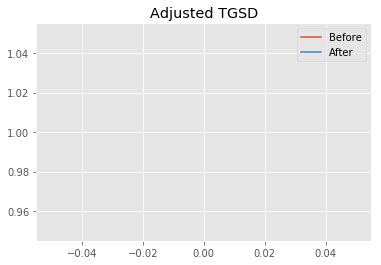

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.03168 	3.78619 	29169.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.01245 	3.59314 	35688.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.2939
New Misfit: 21.7867
Convergence:
0.02275068336735735

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.94e+03 	1.90e+03 	0.9814 		1.0000


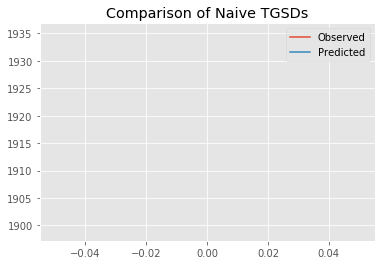

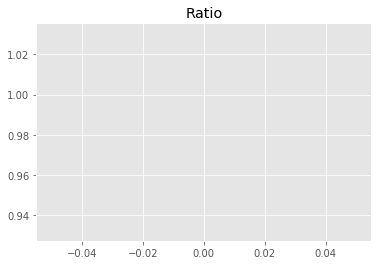

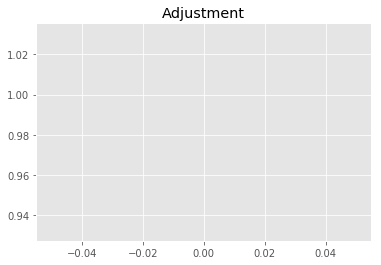

11231982676.370766
1


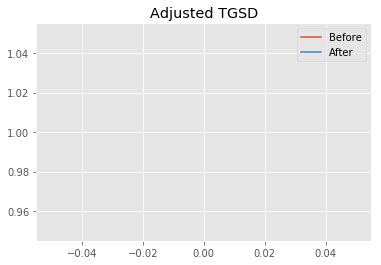

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01245 	3.59314 	35688.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.01488 	3.31349 	34189 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7867
New Misfit: 21.781
Convergence:
0.000260510978257191

____________________
a = 2.01488	b = 3.31349	            h1 = 34188.96921	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.781009898225424
Prior Misfit: 373.343,	 Post Misfit: 21.781


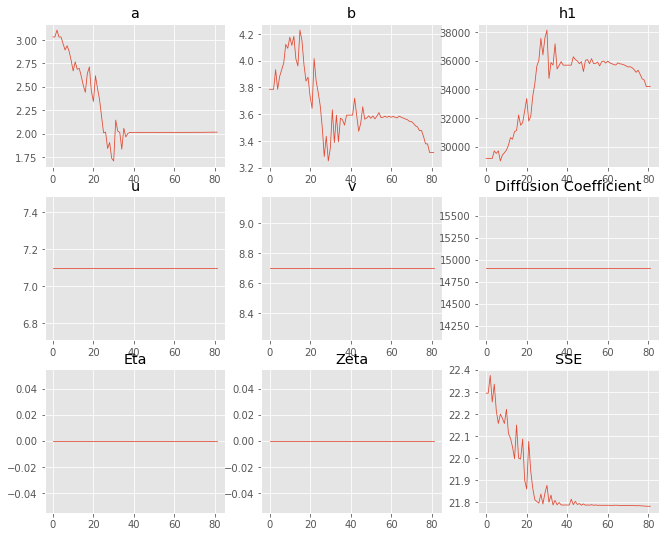

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.03168,2.01488
b,3.78619,3.31349
eta,0,0
ftt,"6,458","6,458"
h1,"29,169.6","34,189"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 6 Time: 0.058 minutes


Estimated remaining run time: 0.530 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.26e+03 	1.90e+03 	0.8414 		1.0000


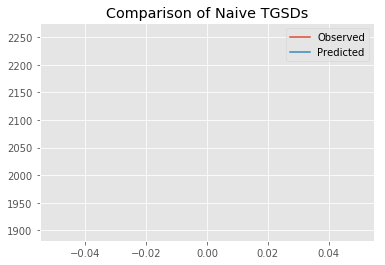

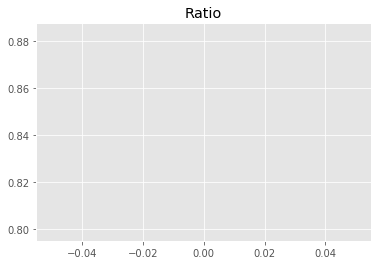

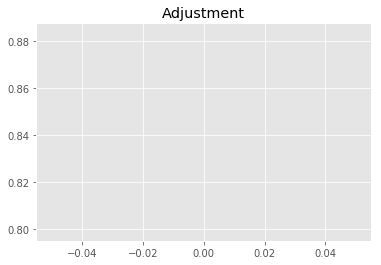

9630006583.07327
1


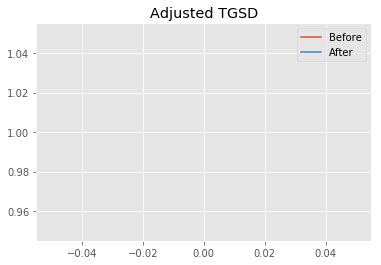

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.6257 	4.94624 	25434.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.4439 	2.77365 	27752.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 26.0258
New Misfit: 21.9972
Convergence:
0.15479092680974565

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.97e+03 	1.90e+03 	0.9625 		1.0000


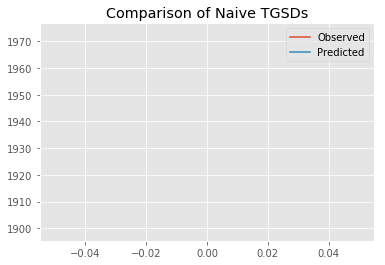

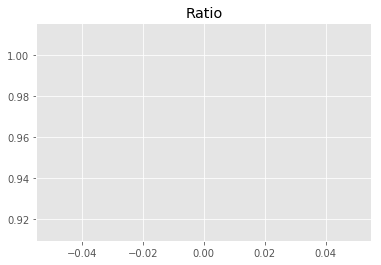

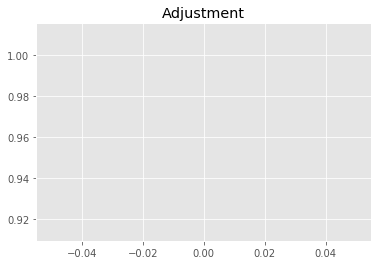

11015595360.610867
1


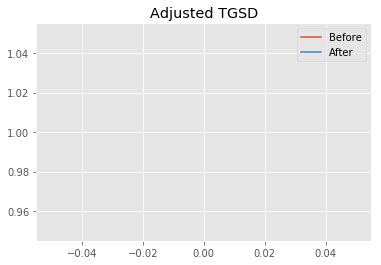

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.4439 	2.77365 	27752.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.03792 	3.29995 	33519.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.9972
New Misfit: 21.7836
Convergence:
0.009712581546273424

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.94e+03 	1.90e+03 	0.9771 		1.0000


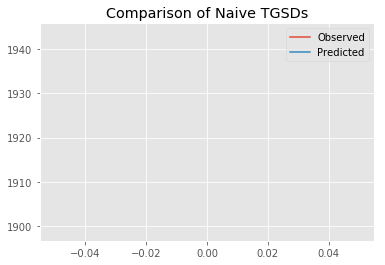

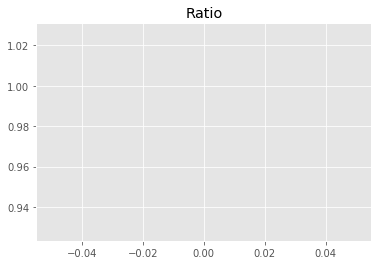

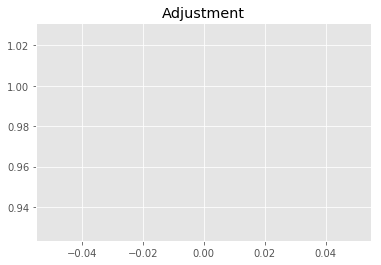

11182886948.225245
1


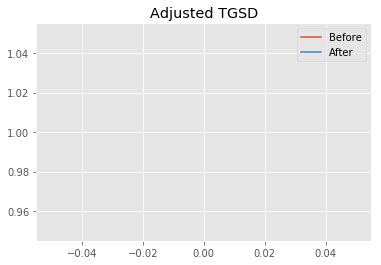

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03792 	3.29995 	33519.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.03912 	3.22952 	33260.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7836
New Misfit: 21.7822
Convergence:
6.557719668327576e-05

____________________
a = 2.03912	b = 3.22952	            h1 = 33260.63833	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 21.782152030484216
Prior Misfit: 419.769,	 Post Misfit: 21.7822


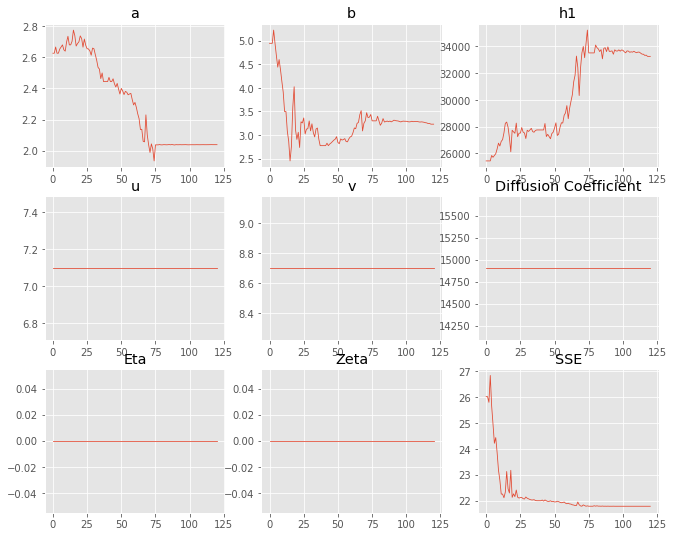

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.6257,2.03912
b,4.94624,3.22952
eta,0,0
ftt,"6,458","6,458"
h1,"25,434.2","33,260.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 7 Time: 0.070 minutes


Estimated remaining run time: 0.532 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.17e+03 	1.90e+03 	0.8761 		1.0000


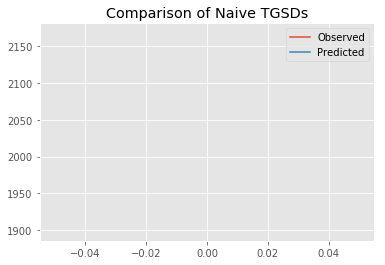

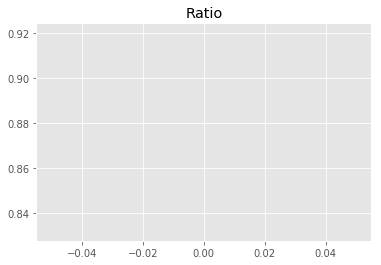

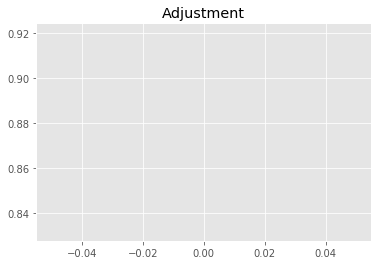

10026796638.732666
1


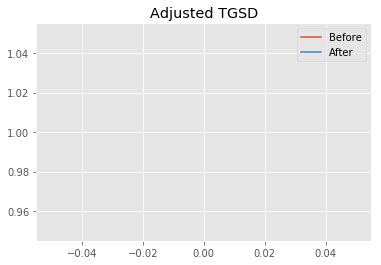

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.255 	1.19962 	17767.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.55286 	1.00001 	22236.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.8367
New Misfit: 21.7478
Convergence:
0.047680697014046036

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.94e+03 	1.90e+03 	0.9796 		1.0000


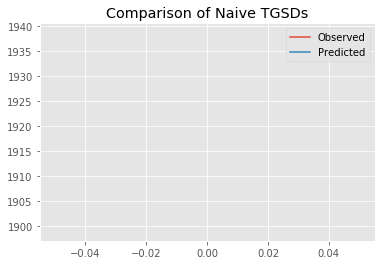

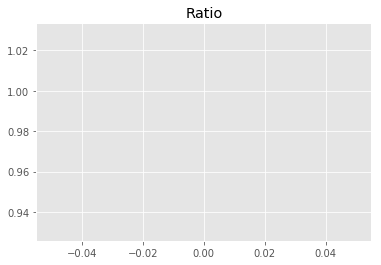

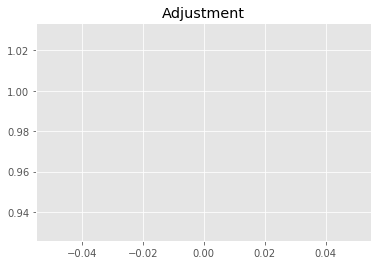

11211289492.860195
1


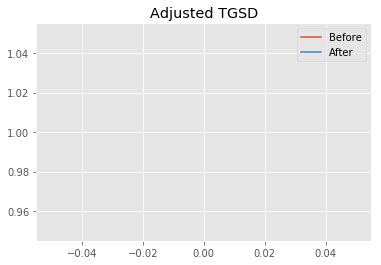

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.55286 	1.00001 	22236.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.42486 	1.00011 	22356.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7478
New Misfit: 21.6808
Convergence:
0.003083950139967047

____________________
a = 1.42486	b = 1.00011	            h1 = 22356.48801	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.6807650721337
Prior Misfit: 359.651,	 Post Misfit: 21.6808


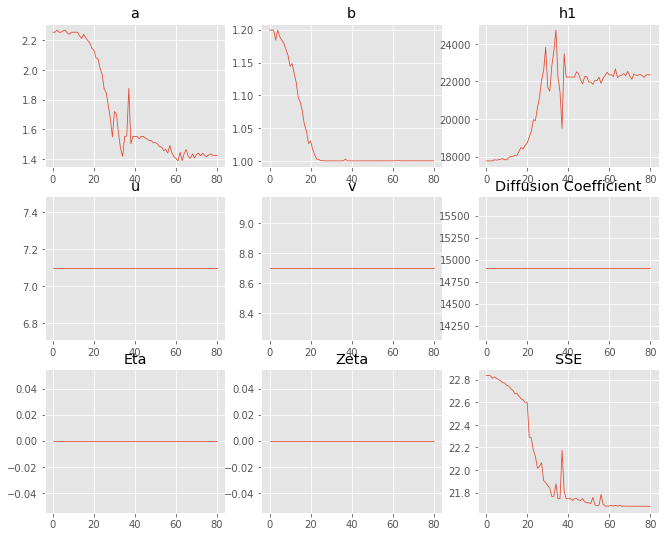

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.255,1.42486
b,1.19962,1.00011
eta,0,0
ftt,"6,458","6,458"
h1,"17,767.5","22,356.5"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 8 Time: 0.050 minutes


Estimated remaining run time: 0.495 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.92e+03 	1.90e+03 	0.9904 		1.0000


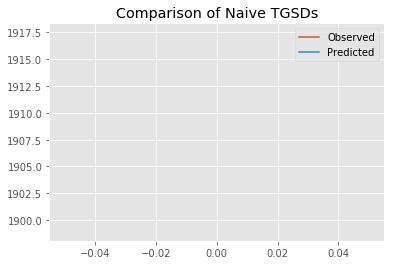

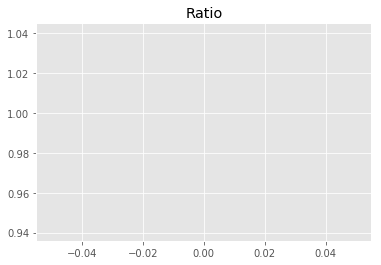

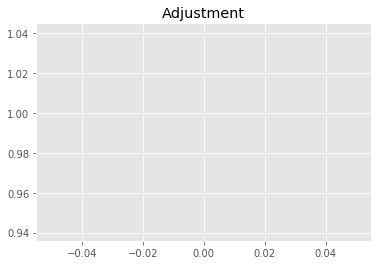

11335072940.408915
1


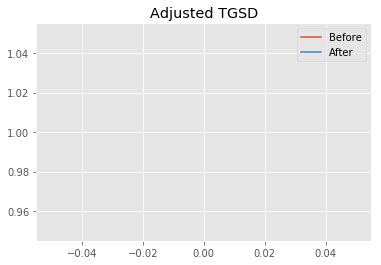

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.05913 	4.84039 	43222.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.0874 	4.56984 	40886.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.809
New Misfit: 21.8015
Convergence:
0.0003432766680300322

____________________
a = 2.08740	b = 4.56984	            h1 = 40886.31332	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 21.801473891398853
Prior Misfit: 358.376,	 Post Misfit: 21.8015


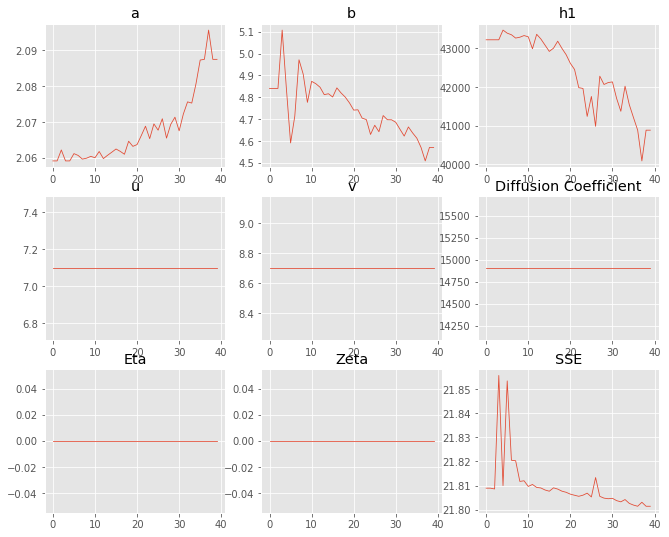

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.05913,2.0874
b,4.84039,4.56984
eta,0,0
ftt,"6,458","6,458"
h1,"43,222.7","40,886.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 9 Time: 0.030 minutes


Estimated remaining run time: 0.434 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.84e+03 	1.90e+03 	1.0323 		1.0000


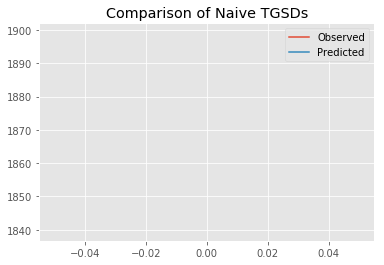

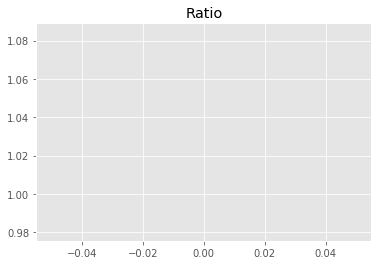

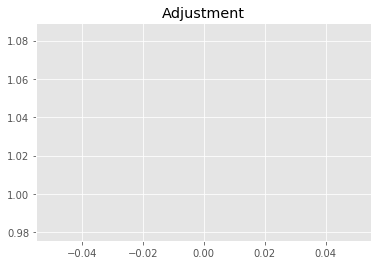

11814294939.285269
1


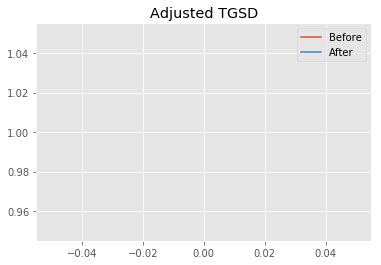

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.16076 	1.98851 	35531.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.74703 	1.97973 	27617.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.3996
New Misfit: 21.74
Convergence:
0.029444645674851916

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.94e+03 	1.90e+03 	0.9801 		1.0000


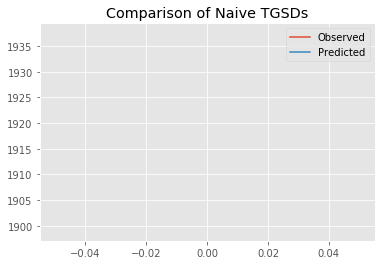

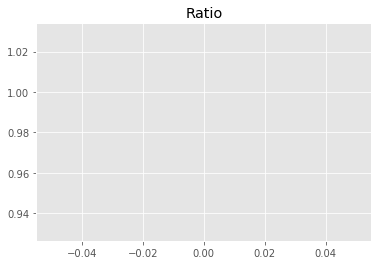

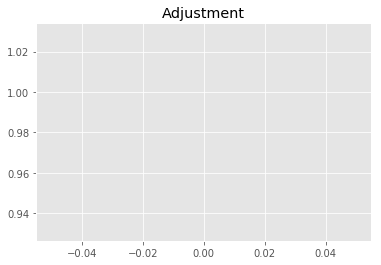

11217637643.195997
1


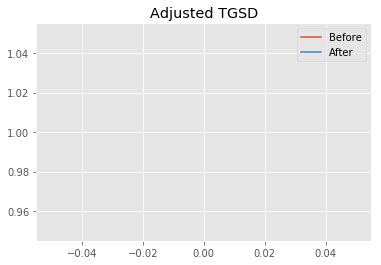

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.74703 	1.97973 	27617.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.73403 	1.97918 	27872.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.74
New Misfit: 21.7393
Convergence:
3.466652207541755e-05

____________________
a = 1.73403	b = 1.97918	            h1 = 27872.11191	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.73927640550765
Prior Misfit: 382.93,	 Post Misfit: 21.7393


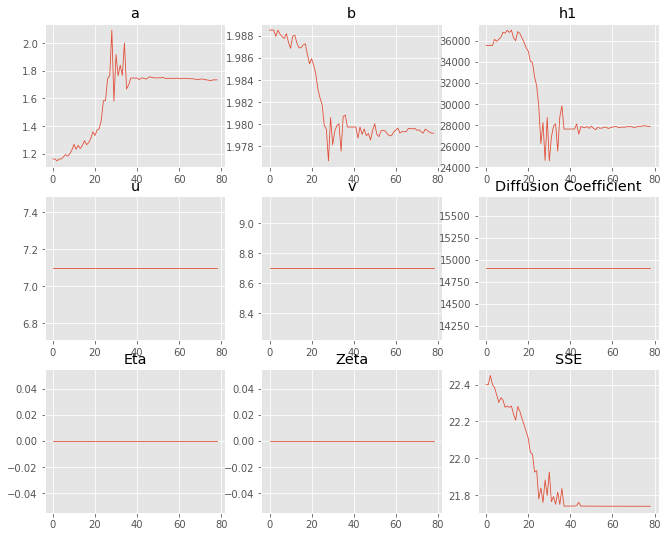

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.16076,1.73403
b,1.98851,1.97918
eta,0,0
ftt,"6,458","6,458"
h1,"35,531.5","27,872.1"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 10 Time: 0.052 minutes


Estimated remaining run time: 0.398 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.11e+03 	1.90e+03 	0.9010 		1.0000


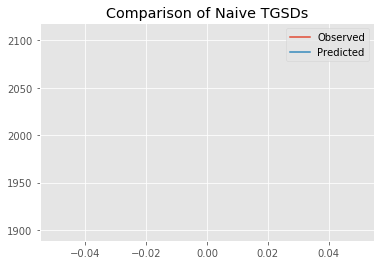

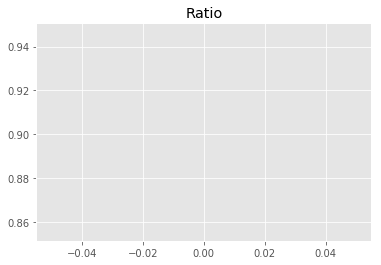

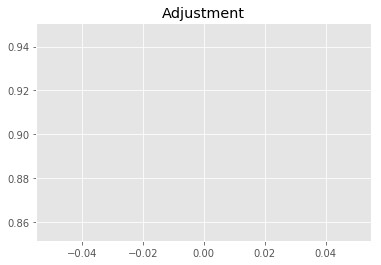

10312435286.654152
1


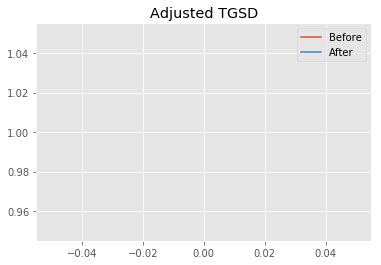

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.5232 	3.43735 	23785.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.85059 	2.57082 	31314.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.7664
New Misfit: 21.7648
Convergence:
0.04399397834562556

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.92e+03 	1.90e+03 	0.9897 		1.0000


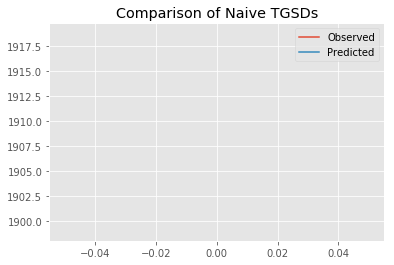

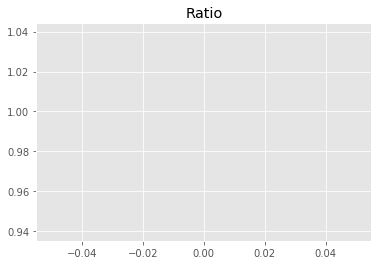

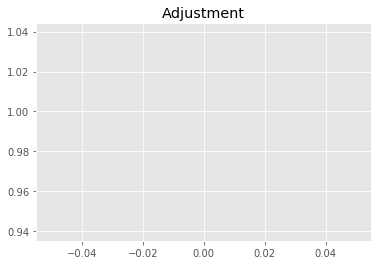

11327000089.287846
1


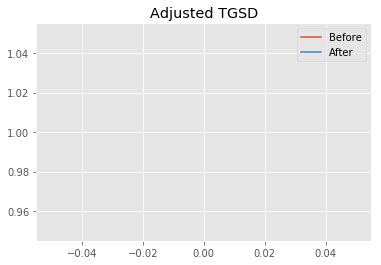

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.85059 	2.57082 	31314.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.79523 	1.94771 	26934 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7648
New Misfit: 21.7443
Convergence:
0.0009431645376037619

____________________
a = 1.79523	b = 1.94771	            h1 = 26934.03374	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.74425869083692
Prior Misfit: 370.558,	 Post Misfit: 21.7443


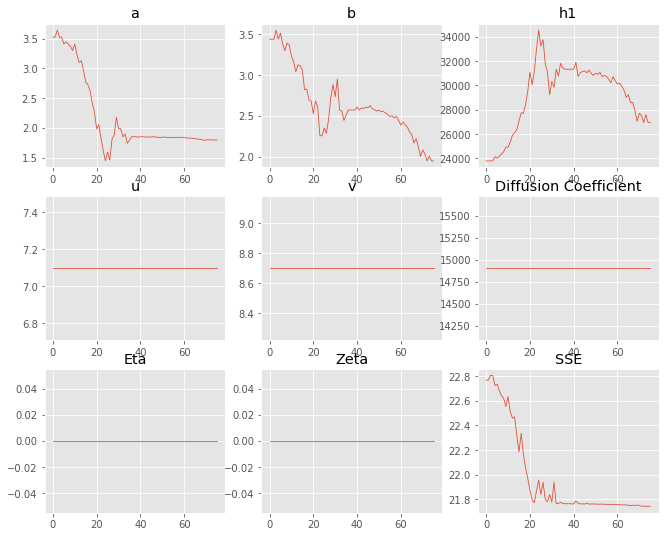

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.5232,1.79523
b,3.43735,1.94771
eta,0,0
ftt,"6,458","6,458"
h1,"23,785.9","26,934"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 11 Time: 0.052 minutes


Estimated remaining run time: 0.359 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.22e+03 	1.90e+03 	0.8551 		1.0000


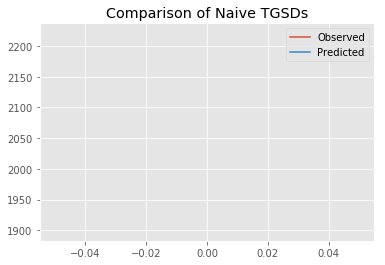

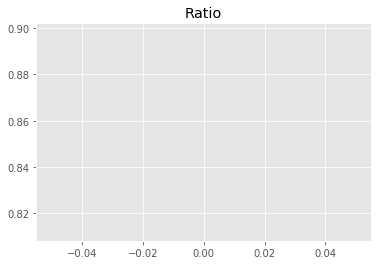

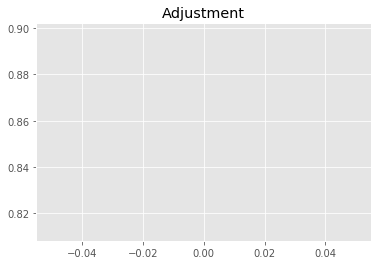

9786355043.720146
1


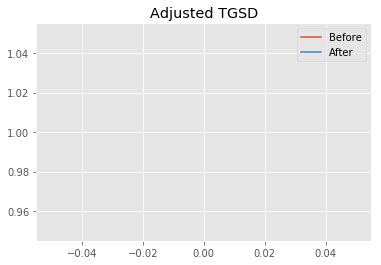

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.10547 	2.05467 	19791.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.10776 	1.99633 	25053.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.2199
New Misfit: 21.8749
Convergence:
0.0968195731806061

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.98e+03 	1.90e+03 	0.9584 		1.0000


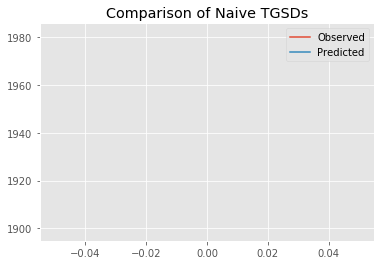

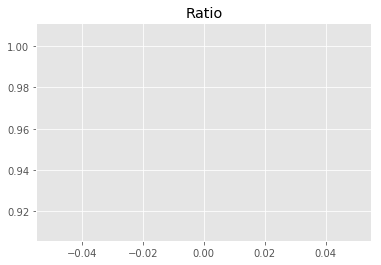

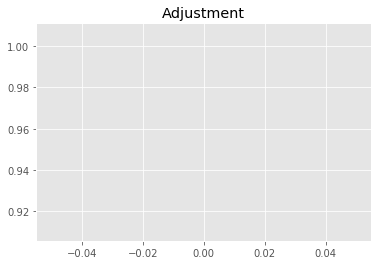

10968463572.732052
1


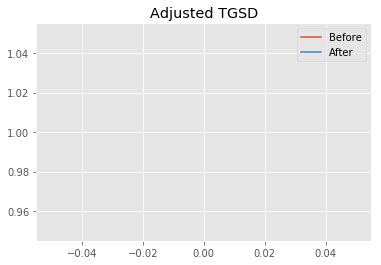

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.10776 	1.99633 	25053.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.70112 	1.99279 	28866.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8749
New Misfit: 21.7554
Convergence:
0.005467161744383716

____________________
a = 1.70112	b = 1.99279	            h1 = 28866.80678	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.75535159596561
Prior Misfit: 381.155,	 Post Misfit: 21.7554


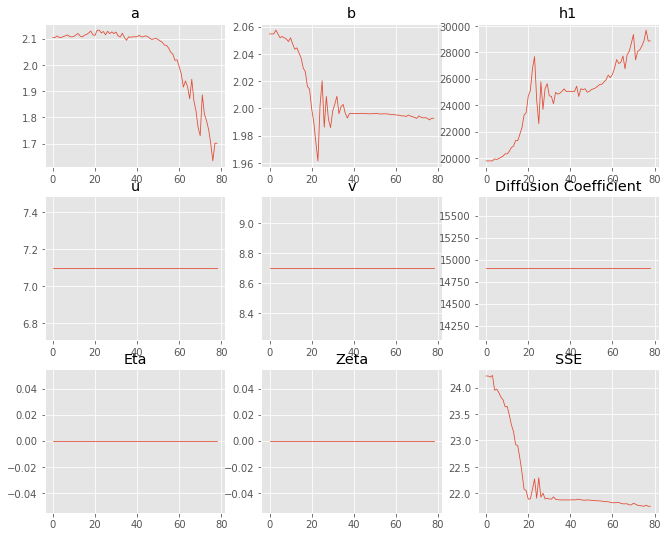

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.10547,1.70112
b,2.05467,1.99279
eta,0,0
ftt,"6,458","6,458"
h1,"19,791.3","28,866.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 12 Time: 0.055 minutes


Estimated remaining run time: 0.319 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.99e+03 	1.90e+03 	0.9523 		1.0000


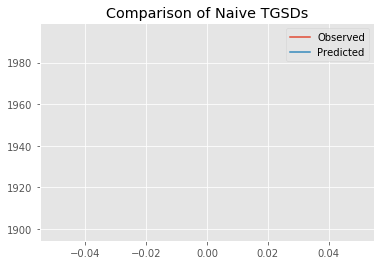

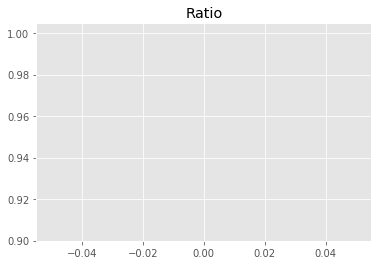

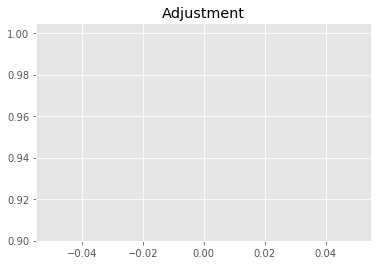

10898920187.165762
1


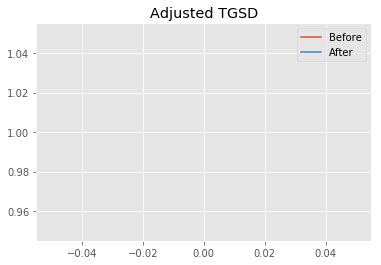

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.87926 	3.68578 	34860.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.8752 	3.27788 	35799.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.0956
New Misfit: 21.7903
Convergence:
0.013820381180556675

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.91e+03 	1.90e+03 	0.9932 		1.0000


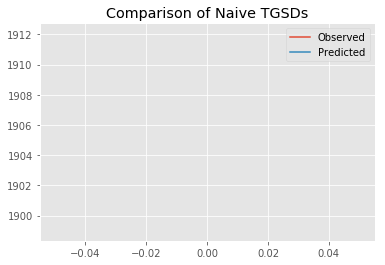

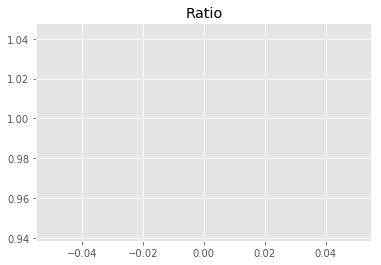

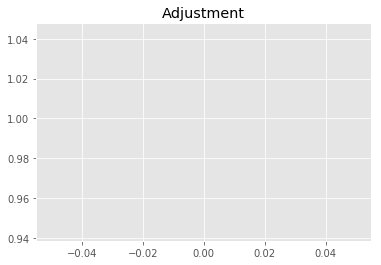

11366830048.652435
1


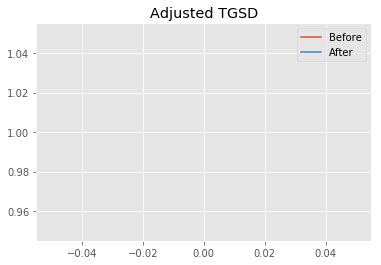

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.8752 	3.27788 	35799.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.88422 	2.67173 	31058.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7903
New Misfit: 21.7661
Convergence:
0.0011087383847286935

____________________
a = 1.88422	b = 2.67173	            h1 = 31058.29087	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.76611073670679
Prior Misfit: 354.353,	 Post Misfit: 21.7661


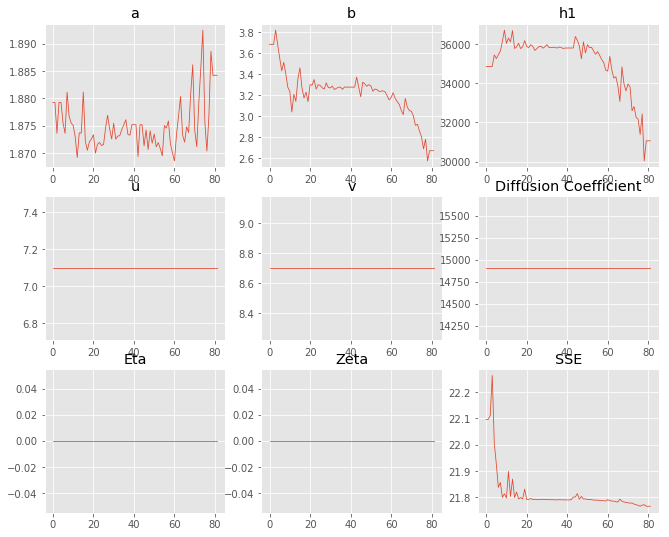

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.87926,1.88422
b,3.68578,2.67173
eta,0,0
ftt,"6,458","6,458"
h1,"34,860.2","31,058.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 13 Time: 0.059 minutes


Estimated remaining run time: 0.280 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.21e+03 	1.90e+03 	0.8596 		1.0000


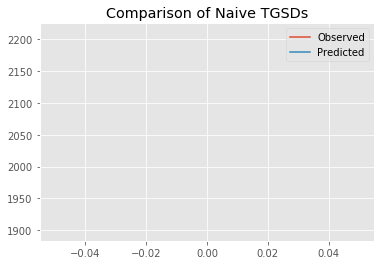

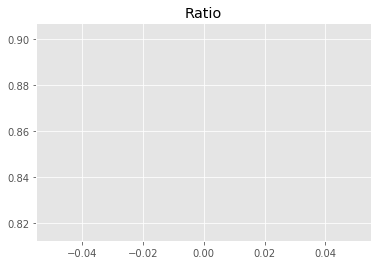

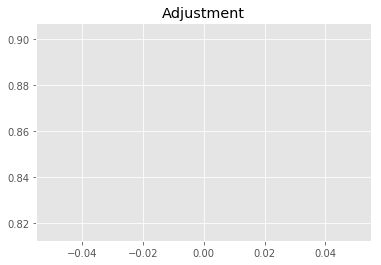

9838266678.378366
1


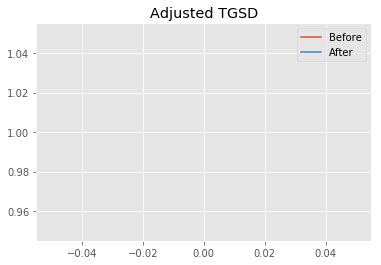

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.54712 	2.7547 	21447.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.94387 	2.21812 	27484.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.6278
New Misfit: 21.7745
Convergence:
0.07843815327999885

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.96e+03 	1.90e+03 	0.9694 		1.0000


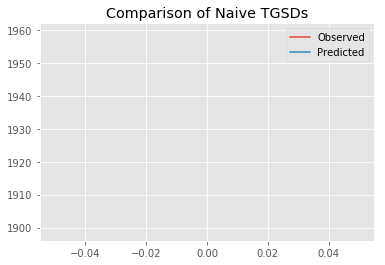

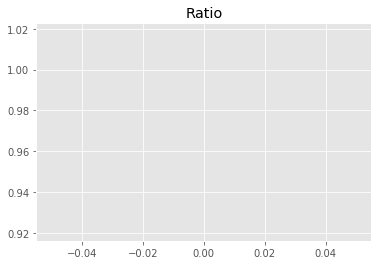

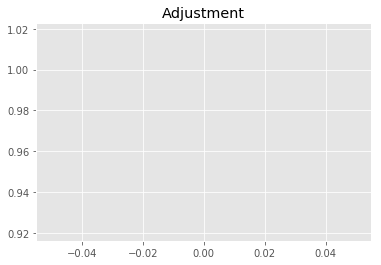

11094530704.851414
1


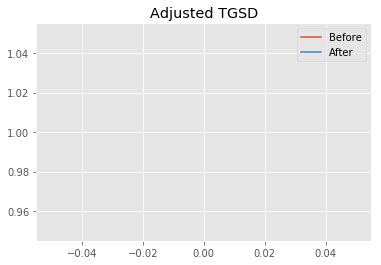

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.94387 	2.21812 	27484.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.6537 	1.7057 	26276.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7745
New Misfit: 21.7276
Convergence:
0.0021553485474652832

____________________
a = 1.65370	b = 1.70570	            h1 = 26276.92236	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.727564599635162
Prior Misfit: 371.041,	 Post Misfit: 21.7276


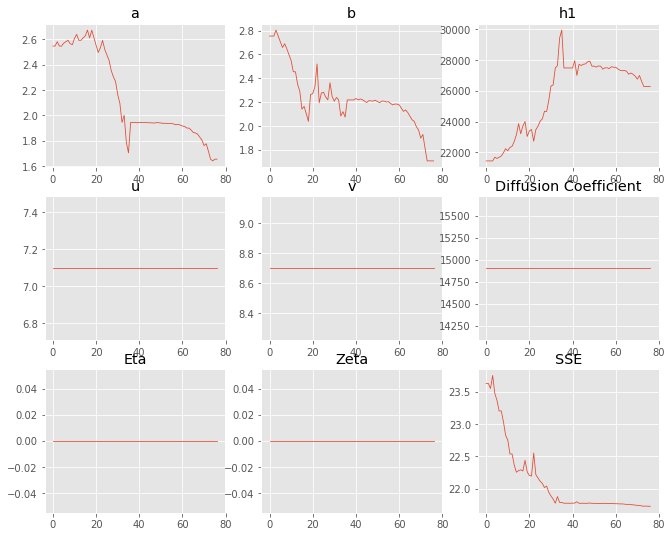

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.54712,1.6537
b,2.7547,1.7057
eta,0,0
ftt,"6,458","6,458"
h1,"21,447.6","26,276.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 14 Time: 0.053 minutes


Estimated remaining run time: 0.235 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.01e+03 	1.90e+03 	0.9453 		1.0000


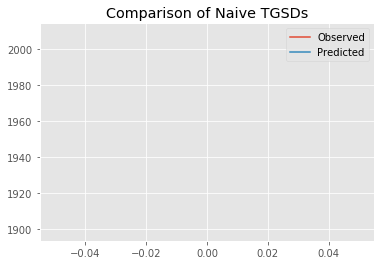

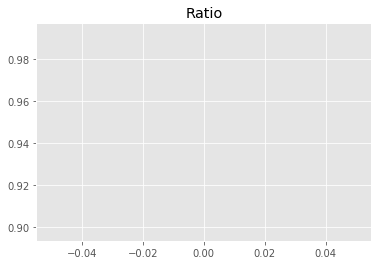

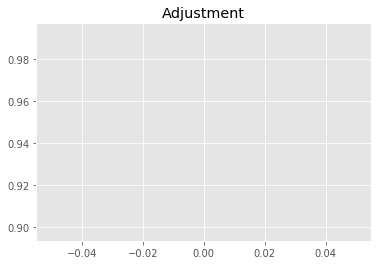

10818901662.434118
1


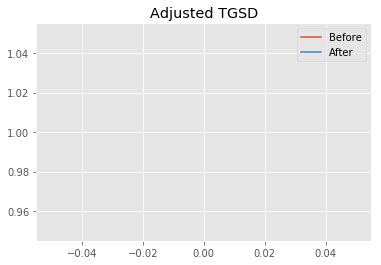

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.96751 	4.91679 	29021.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.85685 	3.63321 	38130.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.7877
New Misfit: 21.8156
Convergence:
0.04265972893621613

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.91e+03 	1.90e+03 	0.9922 		1.0000


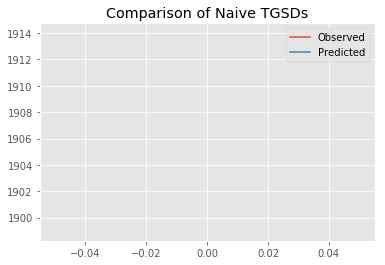

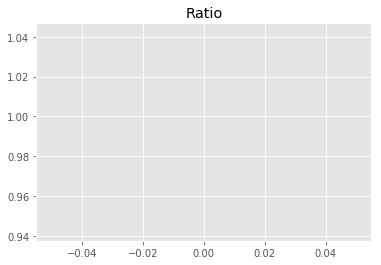

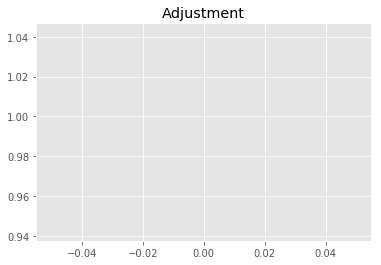

11355425881.662819
1


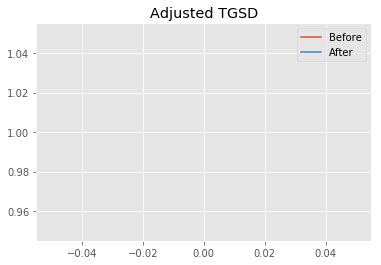

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.85685 	3.63321 	38130.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.84948 	2.96638 	33467.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8156
New Misfit: 21.7825
Convergence:
0.0015177690284394658

____________________
a = 1.84948	b = 2.96638	            h1 = 33467.79748	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.782472480343127
Prior Misfit: 393.431,	 Post Misfit: 21.7825


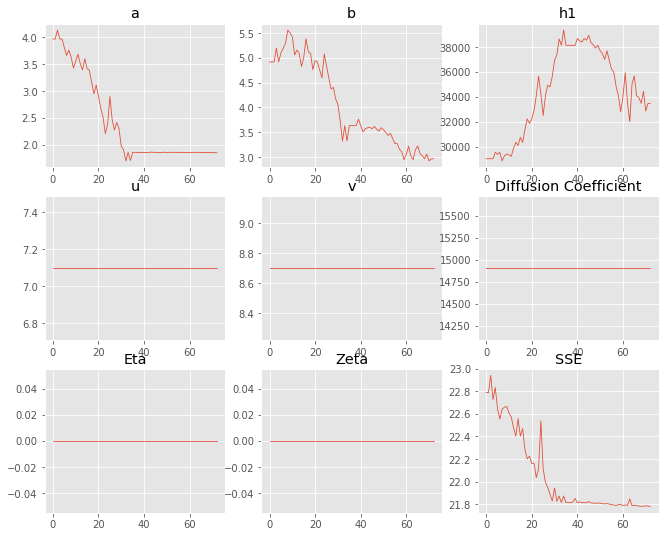

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.96751,1.84948
b,4.91679,2.96638
eta,0,0
ftt,"6,458","6,458"
h1,"29,021.4","33,467.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 15 Time: 0.048 minutes


Estimated remaining run time: 0.188 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.17e+03 	1.90e+03 	0.8742 		1.0000


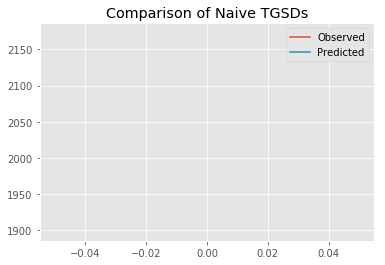

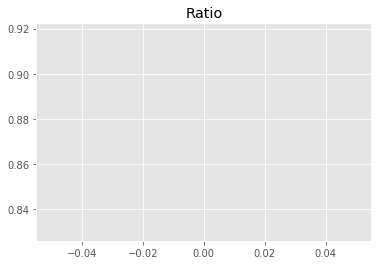

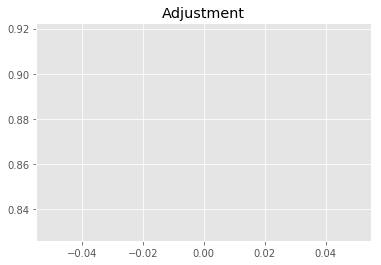

10005272499.859142
1


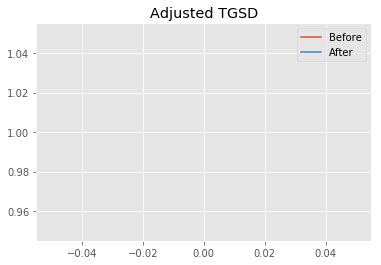

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.19404 	4.68436 	29729.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.17522 	3.32824 	32264 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.5885
New Misfit: 21.8107
Convergence:
0.11297404320236192

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.96e+03 	1.90e+03 	0.9696 		1.0000


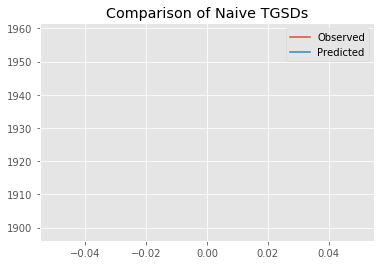

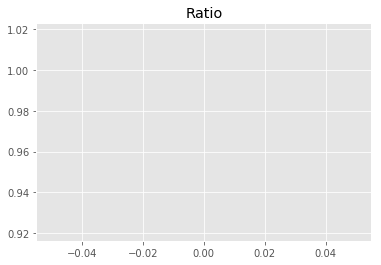

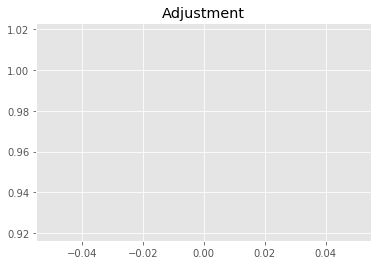

11097165798.897318
1


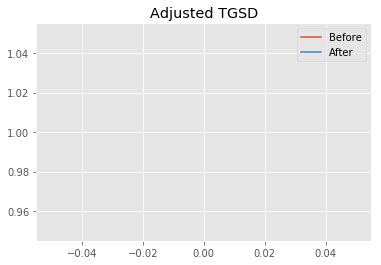

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.17522 	3.32824 	32264 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.03474 	3.47451 	34881.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8107
New Misfit: 21.7839
Convergence:
0.0012273638777133876

____________________
a = 2.03474	b = 3.47451	            h1 = 34881.30558	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.783910409384607
Prior Misfit: 392.629,	 Post Misfit: 21.7839


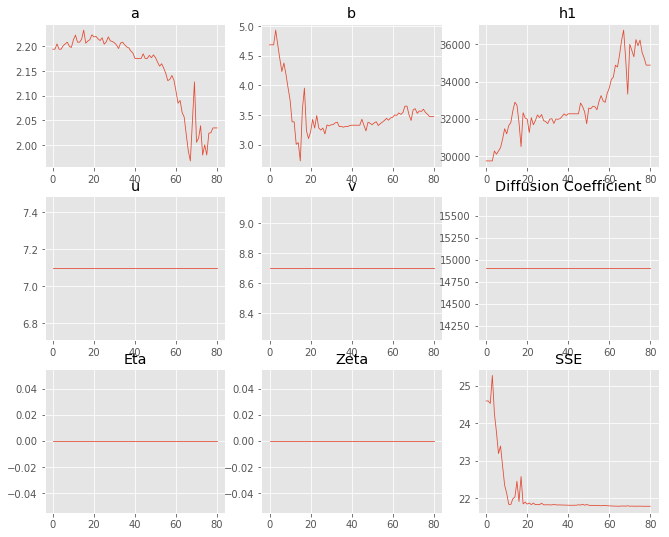

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.19404,2.03474
b,4.68436,3.47451
eta,0,0
ftt,"6,458","6,458"
h1,"29,729.1","34,881.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 16 Time: 0.046 minutes


Estimated remaining run time: 0.141 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.05e+03 	1.90e+03 	0.9275 		1.0000


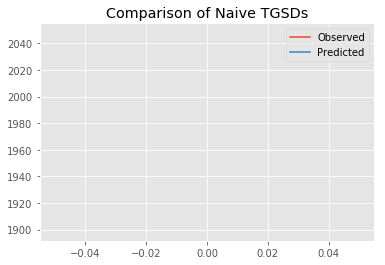

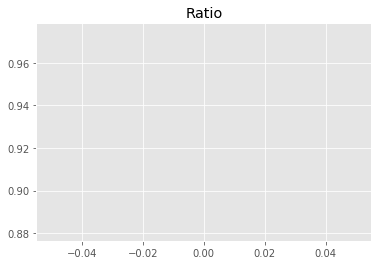

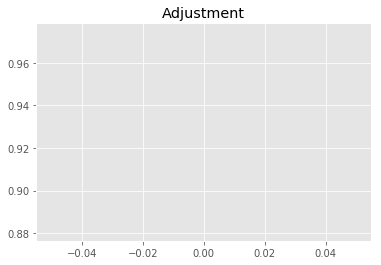

10614794284.800873
1


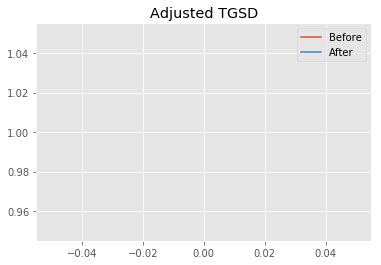

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.9469 	3.6682 	22807.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.01844 	2.61032 	29295.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.4407
New Misfit: 21.7851
Convergence:
0.07062809357996842

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.96e+03 	1.90e+03 	0.9693 		1.0000


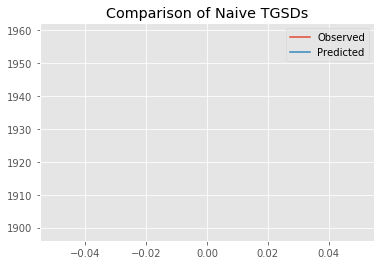

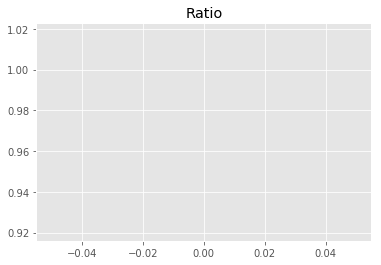

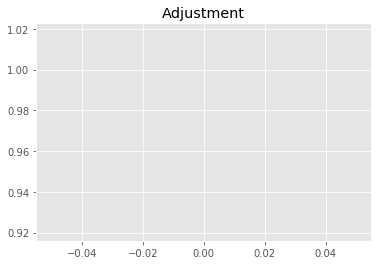

11093949016.158278
1


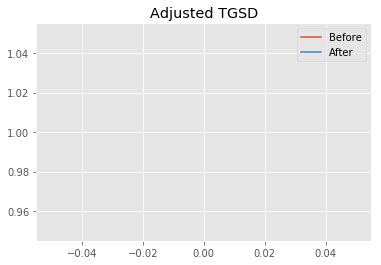

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01844 	2.61032 	29295.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.00985 	2.90495 	31393.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7851
New Misfit: 21.778
Convergence:
0.0003287365378722145

____________________
a = 2.00985	b = 2.90495	            h1 = 31393.26966	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.77798338168637
Prior Misfit: 418.633,	 Post Misfit: 21.778


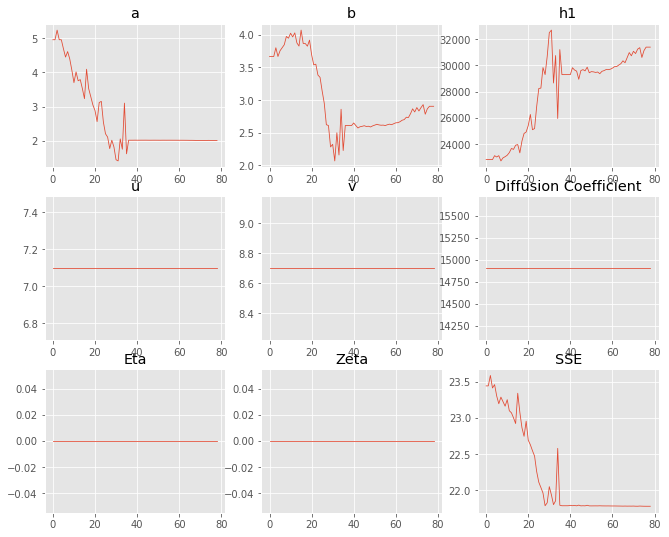

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.9469,2.00985
b,3.6682,2.90495
eta,0,0
ftt,"6,458","6,458"
h1,"22,807.4","31,393.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 17 Time: 0.047 minutes


Estimated remaining run time: 0.094 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.97e+03 	1.90e+03 	0.9647 		1.0000


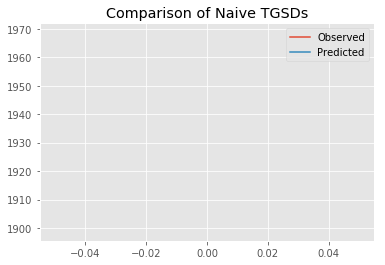

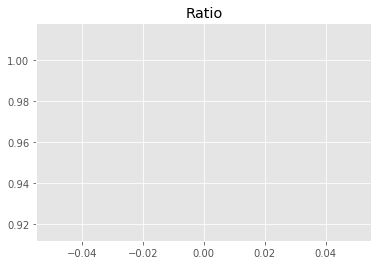

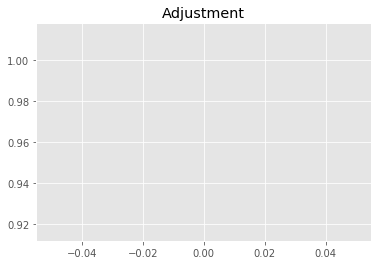

11041366942.931307
1


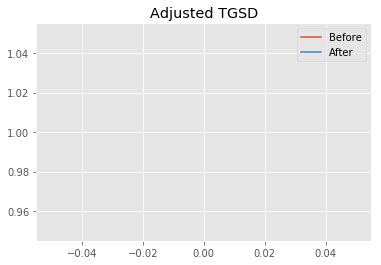

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.67963 	3.94419 	39276.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.74754 	3.17859 	36778.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.3247
New Misfit: 21.8288
Convergence:
0.02221240795944088

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.90e+03 	1.90e+03 	0.9997 		1.0000


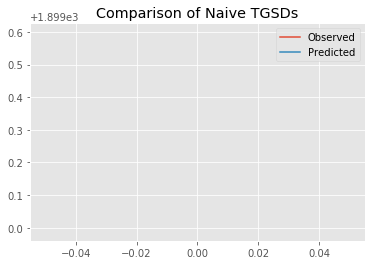

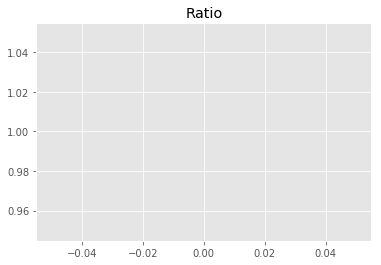

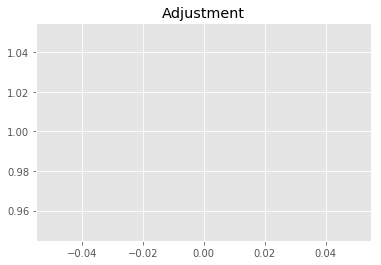

11441467025.014076
1


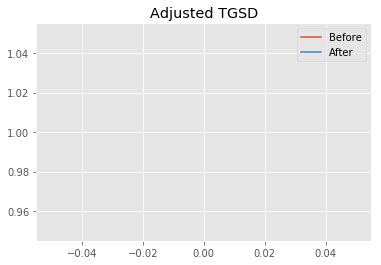

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.74754 	3.17859 	36778.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.88538 	2.68305 	31058.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8288
New Misfit: 21.7676
Convergence:
0.0028063144914908405

____________________
a = 1.88538	b = 2.68305	            h1 = 31058.85175	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.767579210627172
Prior Misfit: 362.401,	 Post Misfit: 21.7676


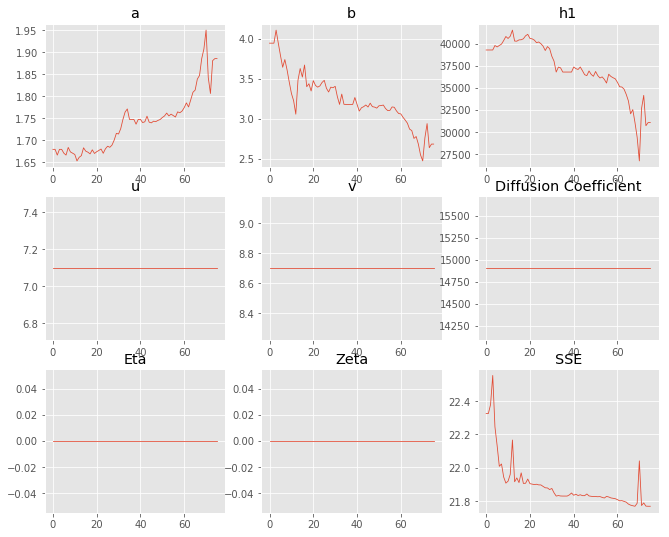

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.67963,1.88538
b,3.94419,2.68305
eta,0,0
ftt,"6,458","6,458"
h1,"39,276.8","31,058.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 18 Time: 0.047 minutes


Estimated remaining run time: 0.047 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.01e+03 	1.90e+03 	0.9437 		1.0000


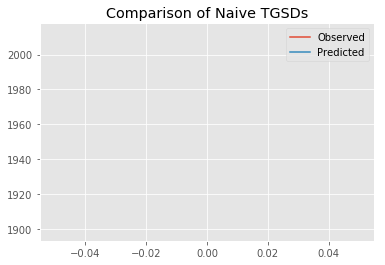

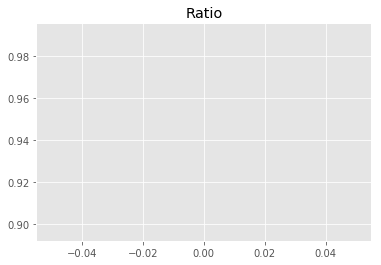

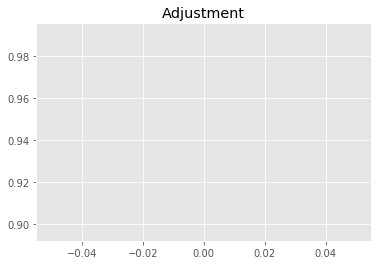

10801129166.130785
1


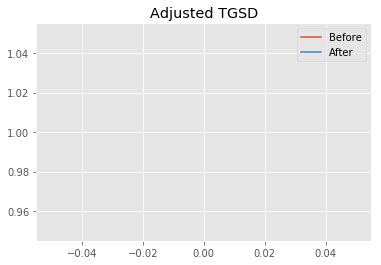

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.15877 	3.67769 	24919.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.88315 	2.63159 	30896.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.08
New Misfit: 21.7637
Convergence:
0.057033065557834085

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.94e+03 	1.90e+03 	0.9807 		1.0000


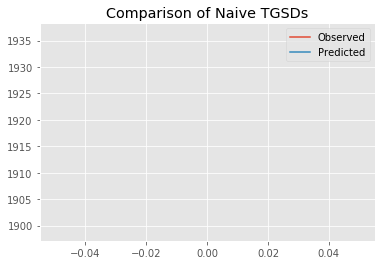

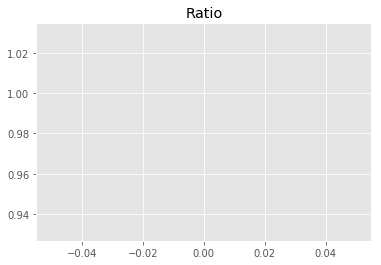

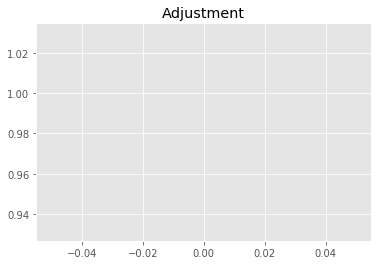

11224024061.970747
1


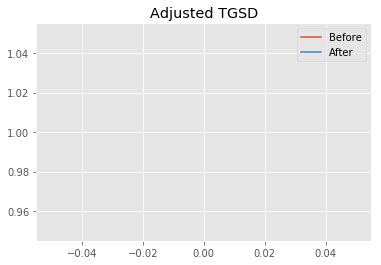

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.88315 	2.63159 	30896.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.84685 	2.38491 	29742.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7637
New Misfit: 21.7557
Convergence:
0.000368553606824591

____________________
a = 1.84685	b = 2.38491	            h1 = 29742.65023	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.755678265797183
Prior Misfit: 408.105,	 Post Misfit: 21.7557


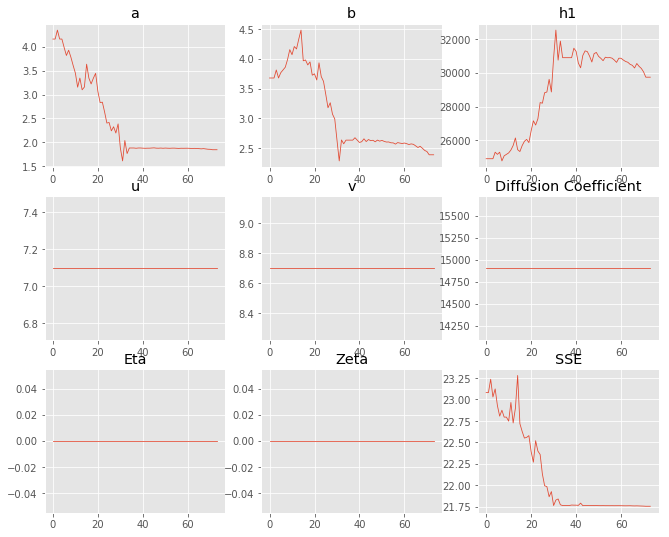

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.15877,1.84685
b,3.67769,2.38491
eta,0,0
ftt,"6,458","6,458"
h1,"24,919.7","29,742.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 19 Time: 0.045 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.95e+03 	1.90e+03 	0.9757 		1.0000


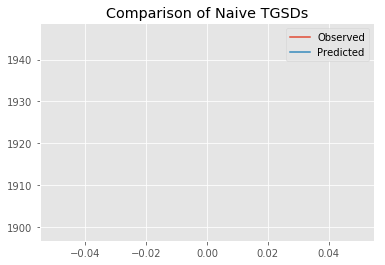

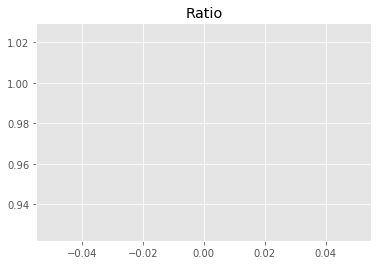

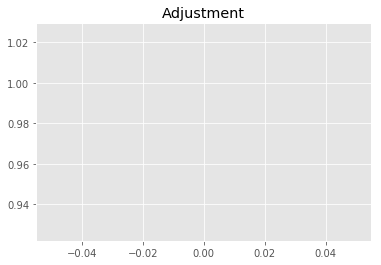

11166919466.41369
1


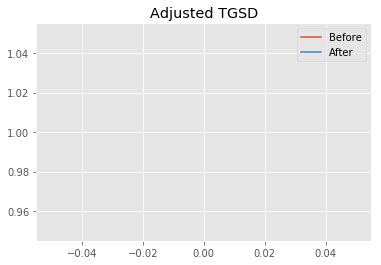

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.45793 	1.93333 	28602 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.69999 	1.90294 	27672.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.9847
New Misfit: 21.7369
Convergence:
0.011275040629611988

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.93e+03 	1.90e+03 	0.9856 		1.0000


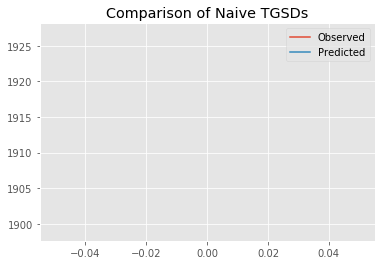

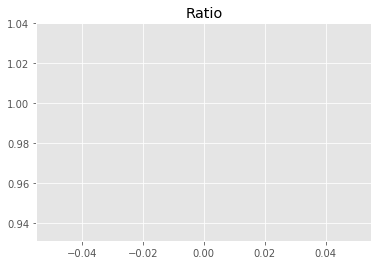

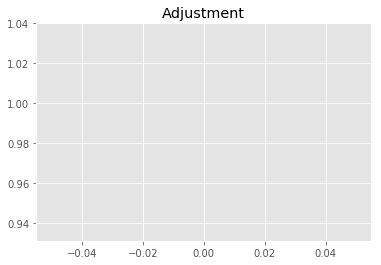

11280026622.185518
1


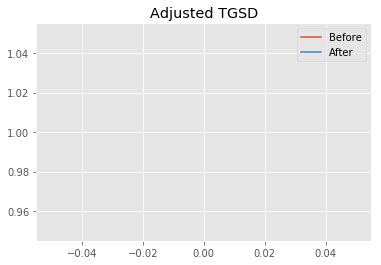

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.69999 	1.90294 	27672.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.6872 	1.79456 	26818.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.7369
New Misfit: 21.7306
Convergence:
0.0002883648341775847

____________________
a = 1.68720	b = 1.79456	            h1 = 26818.41222	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.730586155807153
Prior Misfit: 356.12,	 Post Misfit: 21.7306


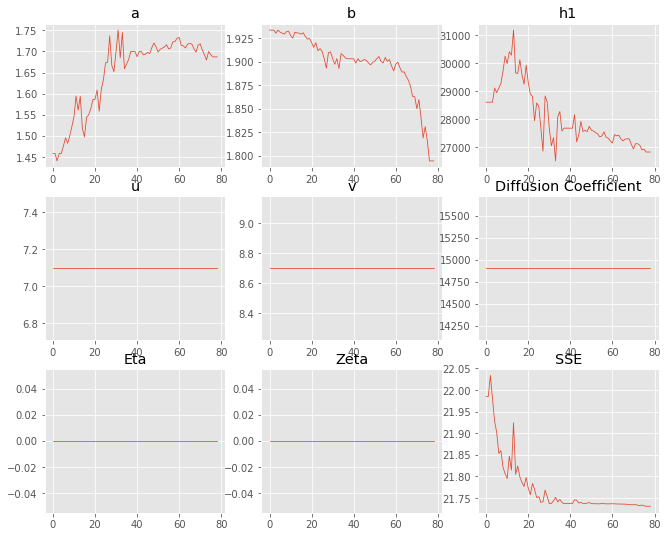

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.45793,1.6872
b,1.93333,1.79456
eta,0,0
ftt,"6,458","6,458"
h1,"28,602","26,818.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 20 Time: 0.047 minutes


Estimated remaining run time: -0.047 minutes


Total Run Time: 0.98620 minutes


[{'a': 1.6625653109156322,
  'b': 1.913394531020781,
  'h1': 27934.604239673972,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.9932533271545334,
  'b': 3.073580621210667,
  'h1': 32826.04468270594,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.998987953667704,
  'b': 3.1021895346883874,
  'h1': 32847.2315519984,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.11024971069161,
  'b': 3.4838079741745993,
  'h1': 33940.29942450029,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.0184049923401073,
  'b': 3.2903814289405404,
  'h1': 33861.64583450466,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.01488122084

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
7,1.42486,1.00011,"22,356.5",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.6808
13,1.6537,1.7057,"26,276.9",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7276
19,1.6872,1.79456,"26,818.4",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7306
9,1.73403,1.97918,"27,872.1",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7393
0,1.66257,1.91339,"27,934.6",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7414
10,1.79523,1.94771,"26,934",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7443
11,1.70112,1.99279,"28,866.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7554
18,1.84685,2.38491,"29,742.7",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7557
12,1.88422,2.67173,"31,058.3",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7661
17,1.88538,2.68305,"31,058.9",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7676


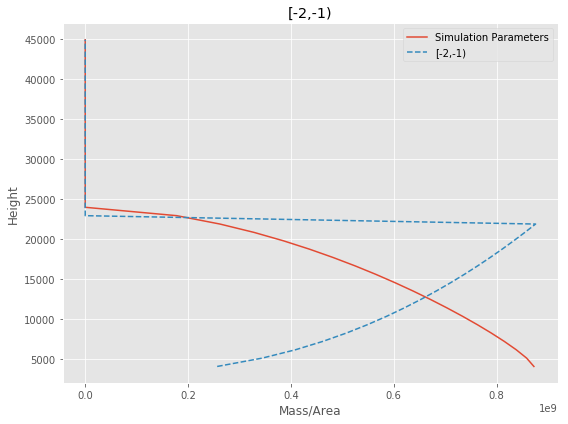

[-2,-1) Run Time: 0.98854 minutes


Mass Test: 34857356748.13845
========[-1,0)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.81e+03 	1.82e+03 	1.0024 		1.0000


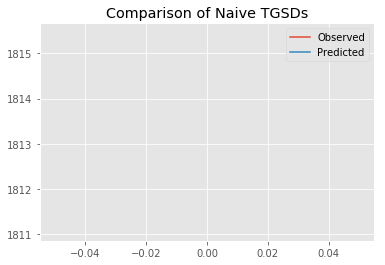

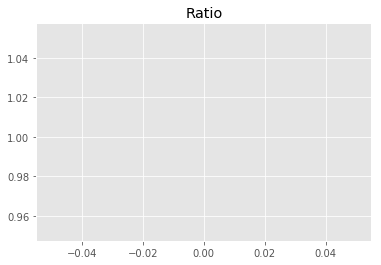

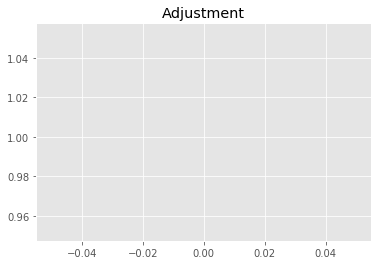

10968040753.226719
1


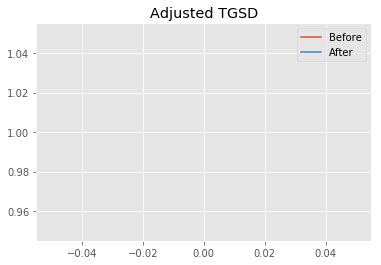

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.926 	1.54312 	15186.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.19141 	2.41013 	14924.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.8907
New Misfit: 19.4362
Convergence:
0.022849927966417383

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.78e+03 	1.82e+03 	1.0175 		1.0000


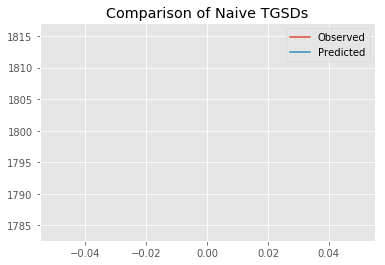

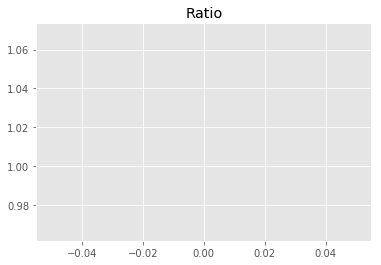

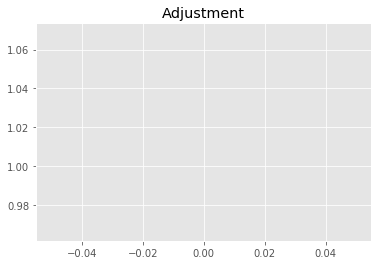

11133592352.856276
1


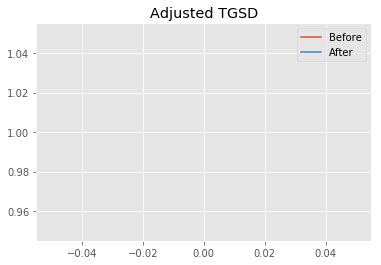

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.19141 	2.41013 	14924.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|10.0043 	2.29927 	12776.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.4362
New Misfit: 19.2646
Convergence:
0.008829023955884946

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.84e+03 	1.82e+03 	0.9870 		1.0000


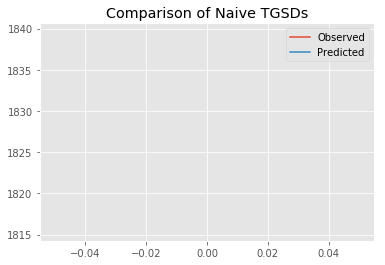

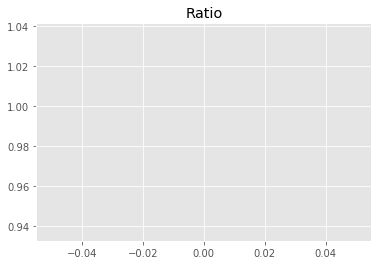

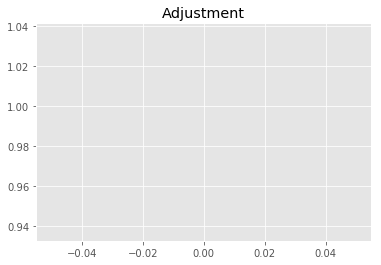

10798858464.263033
1


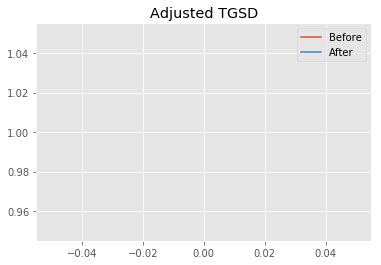

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.0043 	2.29927 	12776.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|12.1268 	2.2859 	12503.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2646
New Misfit: 19.2481
Convergence:
0.0008550795120317561

____________________
a = 12.12682	b = 2.28590	            h1 = 12503.42948	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.24812684756712
Prior Misfit: 304.681,	 Post Misfit: 19.2481


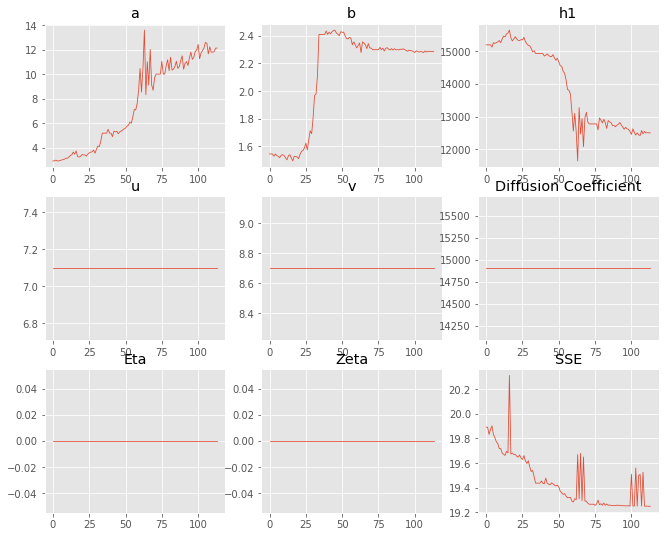

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.926,12.1268
b,1.54312,2.2859
eta,0,0
ftt,"6,458","6,458"
h1,"15,186.6","12,503.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 1 Time: 0.064 minutes


Estimated remaining run time: 0.572 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.56e+03 	1.82e+03 	1.1647 		1.0000


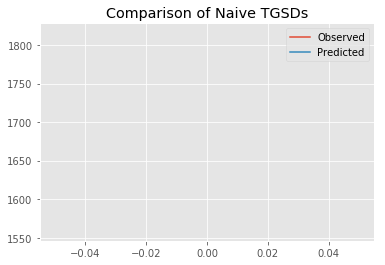

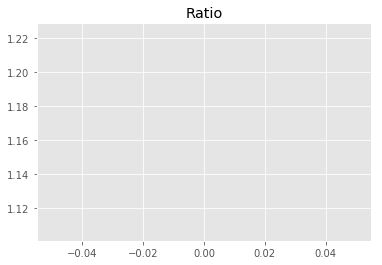

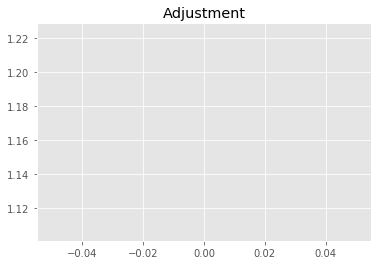

12743292879.622454
1


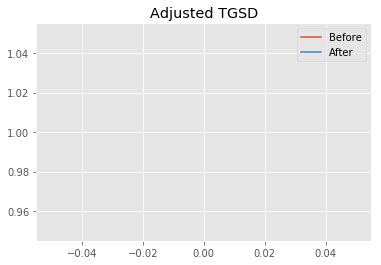

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.80203 	1.39525 	17191 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.64983 	2.42083 	17186.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.9582
New Misfit: 19.9141
Convergence:
0.049817368399036326

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.70e+03 	1.82e+03 	1.0662 		1.0000


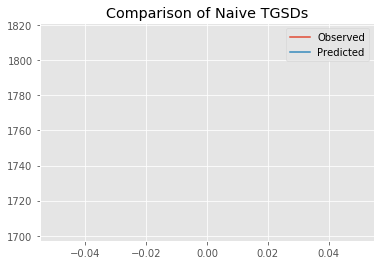

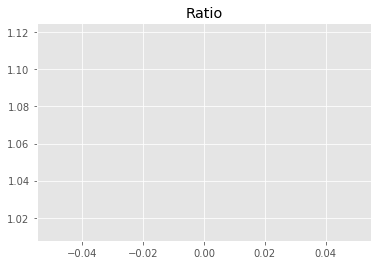

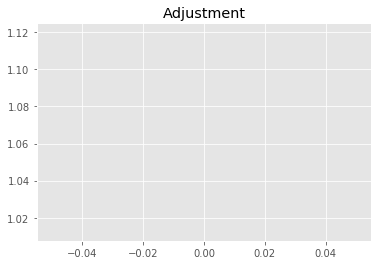

11665791066.724752
1


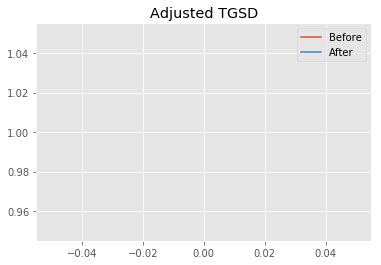

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.64983 	2.42083 	17186.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|12.556 	5.05053 	14245.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.9141
New Misfit: 19.2726
Convergence:
0.03221501783046455

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9997 		1.0000


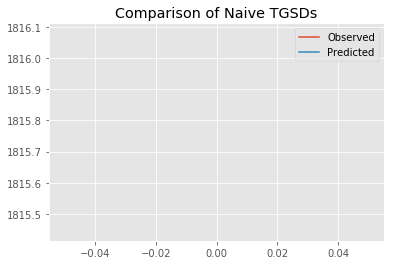

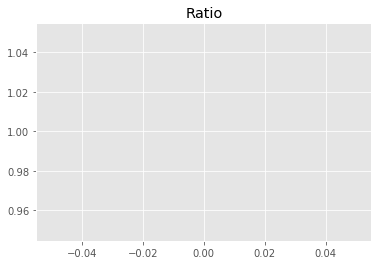

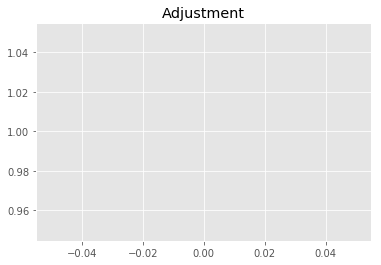

10937783531.976505
1


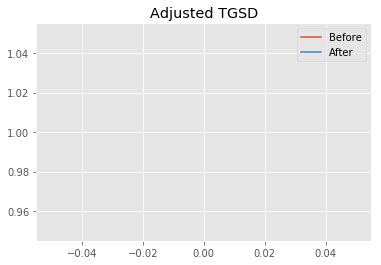

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|12.556 	5.05053 	14245.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|32.6358 	7.69278 	12844.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2726
New Misfit: 19.2338
Convergence:
0.0020133259277071206

____________________
a = 32.63580	b = 7.69278	            h1 = 12844.19953	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.233802035271644
Prior Misfit: 376.798,	 Post Misfit: 19.2338


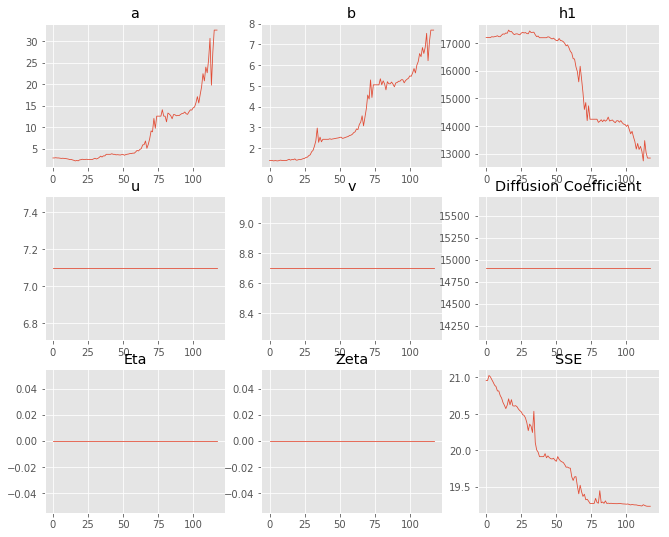

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.80203,32.6358
b,1.39525,7.69278
eta,0,0
ftt,"6,458","6,458"
h1,"17,191","12,844.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 2 Time: 0.066 minutes


Estimated remaining run time: 0.735 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.15e+03 	1.82e+03 	0.8458 		1.0000


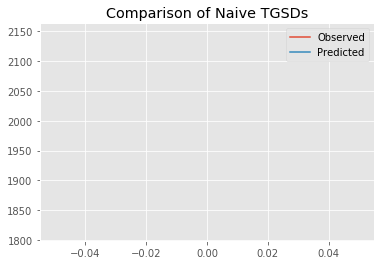

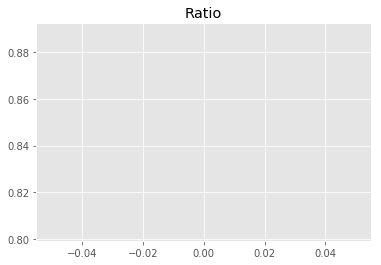

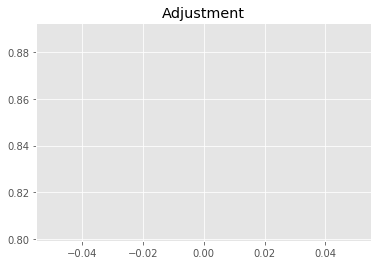

9253934506.228792
1


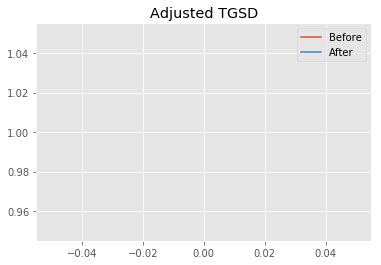

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.05215 	2.48402 	13477.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|4.22272 	2.4321 	15947.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 25.6293
New Misfit: 19.6119
Convergence:
0.23478648005262603

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0303 		1.0000


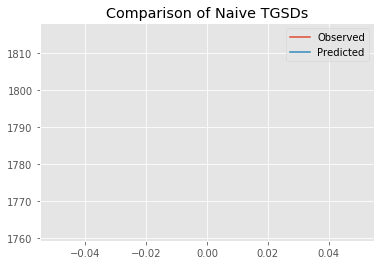

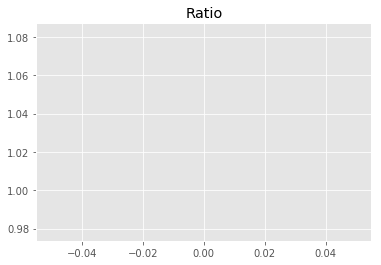

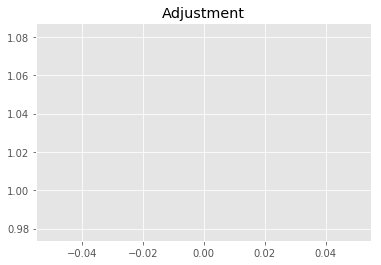

11273313482.671438
1


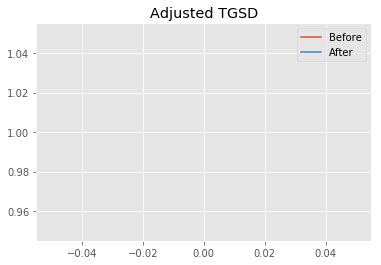

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.22272 	2.4321 	15947.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|12.5525 	4.26334 	13711.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.6119
New Misfit: 19.2655
Convergence:
0.017659476541931344

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9977 		1.0000


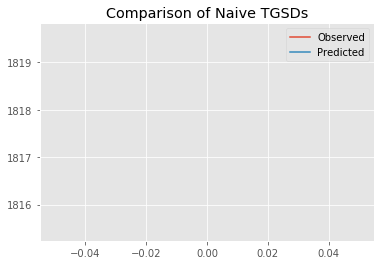

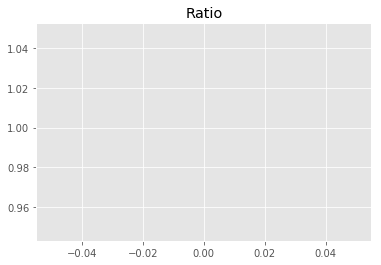

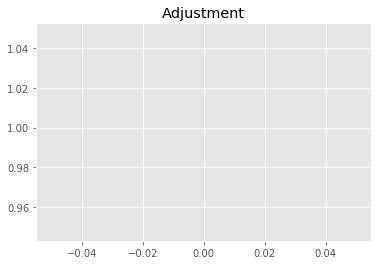

10916521929.029898
1


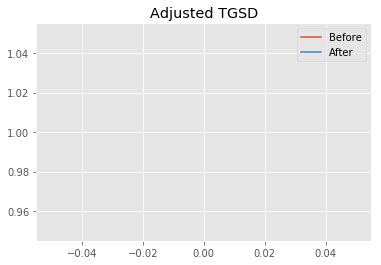

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|12.5525 	4.26334 	13711.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|15.247 	3.8612 	13091.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2655
New Misfit: 19.2472
Convergence:
0.0009539457632098224

____________________
a = 15.24697	b = 3.86120	            h1 = 13091.55363	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.247158010874124
Prior Misfit: 429.487,	 Post Misfit: 19.2472


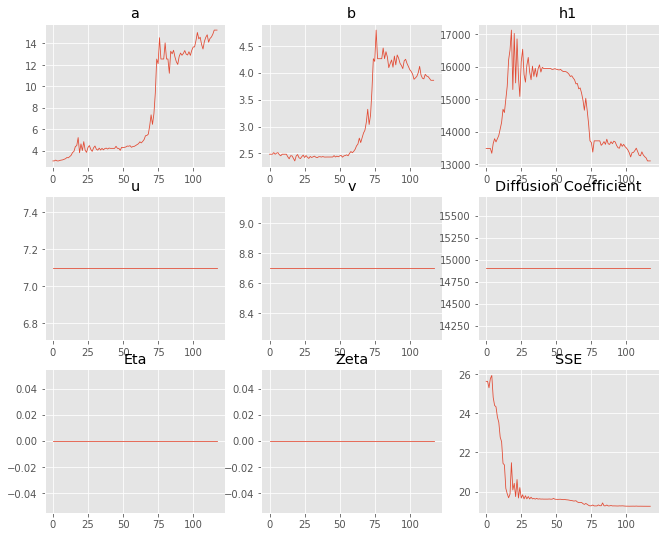

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.05215,15.247
b,2.48402,3.8612
eta,0,0
ftt,"6,458","6,458"
h1,"13,477.3","13,091.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 3 Time: 0.066 minutes


Estimated remaining run time: 0.781 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.62e+03 	1.82e+03 	1.1212 		1.0000


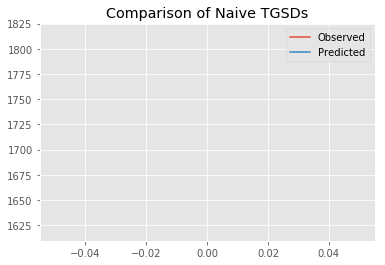

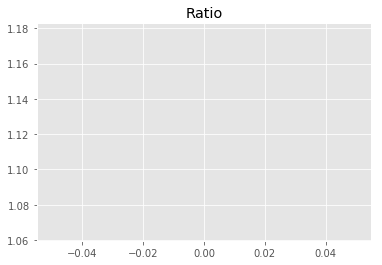

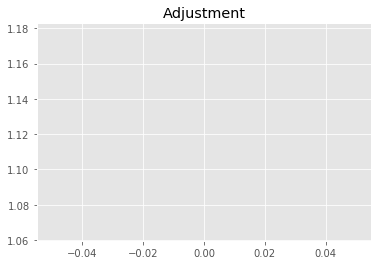

12267491405.809998
1


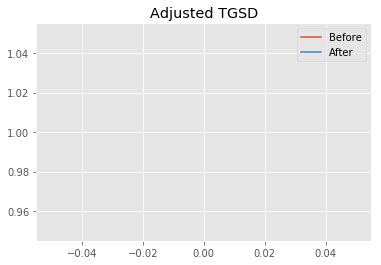

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.18885 	2.1729 	26259.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.65148 	2.49915 	15362.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.5301
New Misfit: 19.577
Convergence:
0.20191848533117687

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.72e+03 	1.82e+03 	1.0567 		1.0000


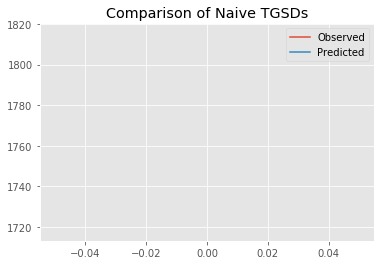

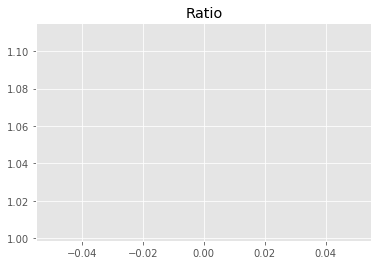

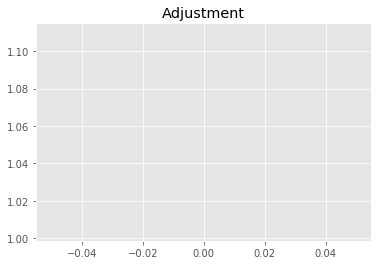

11562241636.230438
1


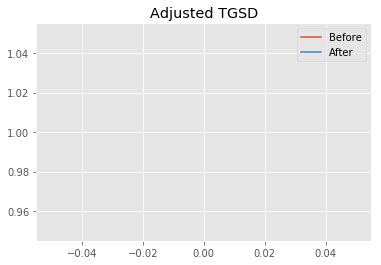

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.65148 	2.49915 	15362.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.55881 	2.65666 	15001 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.577
New Misfit: 19.4171
Convergence:
0.00816855705657769

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.79e+03 	1.82e+03 	1.0142 		1.0000


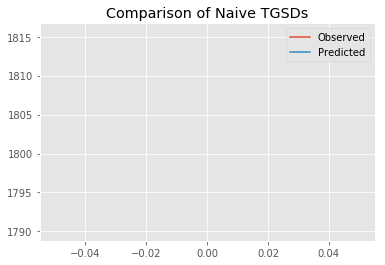

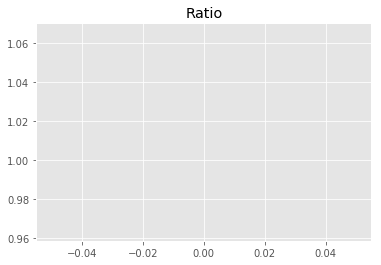

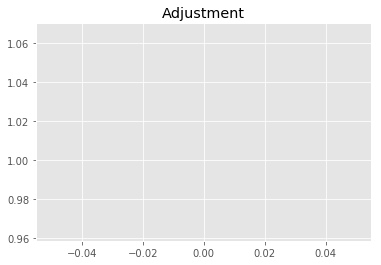

11096752443.736256
1


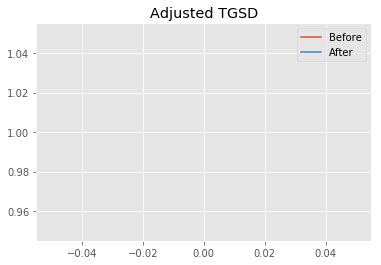

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.55881 	2.65666 	15001 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|13.3555 	3.00365 	12793.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.4171
New Misfit: 19.248
Convergence:
0.008705470567772655

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.83e+03 	1.82e+03 	0.9945 		1.0000


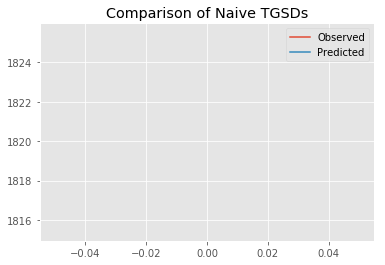

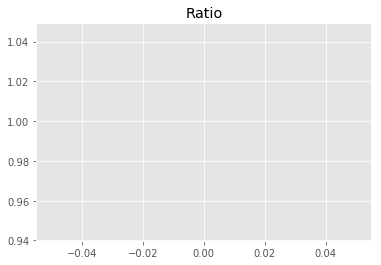

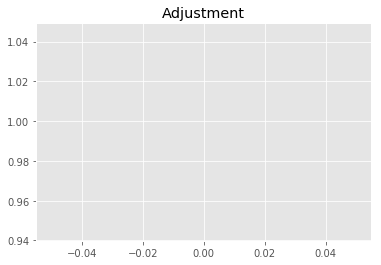

10881516741.824408
1


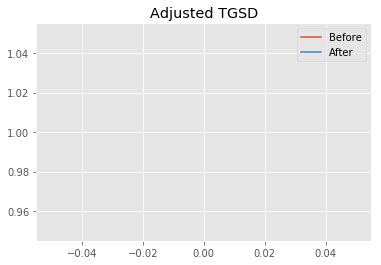

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|13.3555 	3.00365 	12793.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|17.5969 	3.42265 	12522.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.248
New Misfit: 19.2405
Convergence:
0.00039335253332267007

____________________
a = 17.59689	b = 3.42265	            h1 = 12522.51983	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.240460107513254
Prior Misfit: 511.776,	 Post Misfit: 19.2405


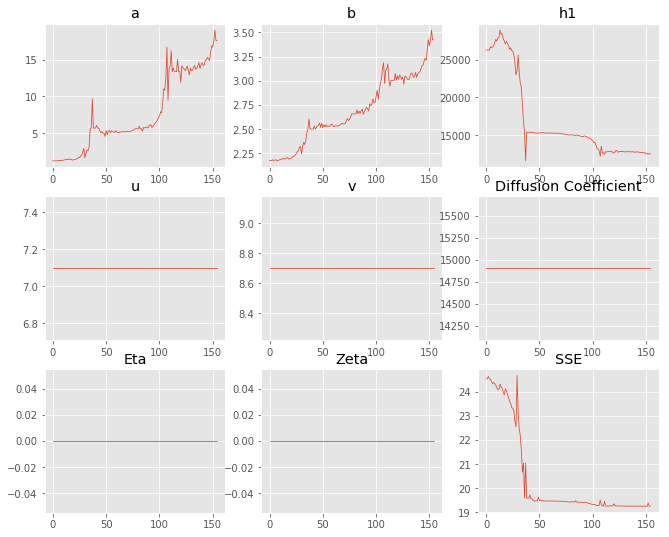

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.18885,17.5969
b,2.1729,3.42265
eta,0,0
ftt,"6,458","6,458"
h1,"26,259.6","12,522.5"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 4 Time: 0.083 minutes


Estimated remaining run time: 0.835 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.28e+03 	1.82e+03 	0.7958 		1.0000


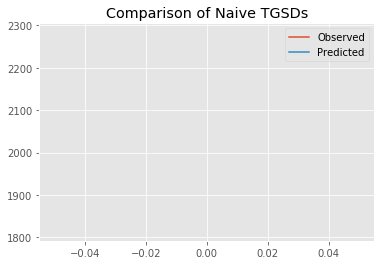

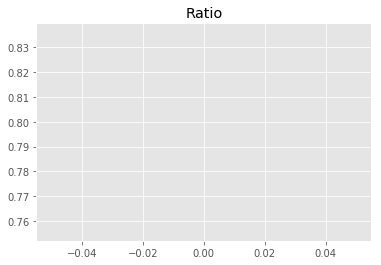

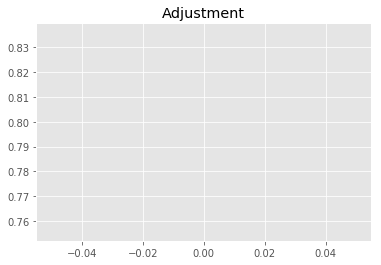

8707567915.035614
1


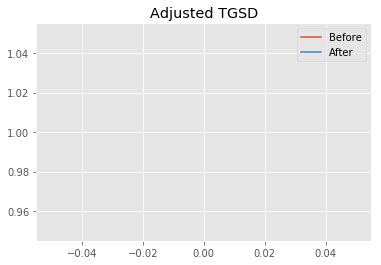

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.63435 	3.33597 	11723.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.81711 	2.96453 	14029.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 28.8659
New Misfit: 19.3109
Convergence:
0.3310128573198291

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9963 		1.0000


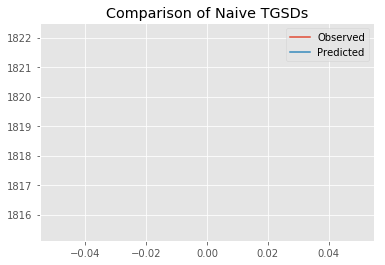

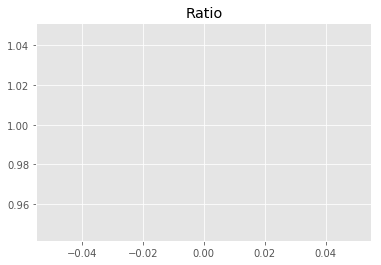

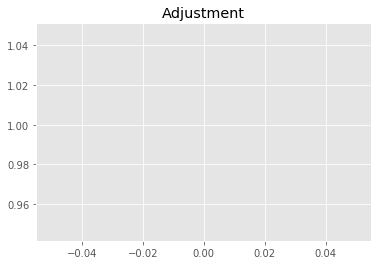

10901375767.413082
1


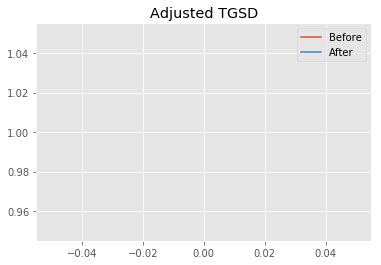

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.81711 	2.96453 	14029.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|8.7039 	2.77108 	13558.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.3109
New Misfit: 19.2874
Convergence:
0.0012195452110985872

____________________
a = 8.70390	b = 2.77108	            h1 = 13558.50407	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 19.28736671607579
Prior Misfit: 511.459,	 Post Misfit: 19.2874


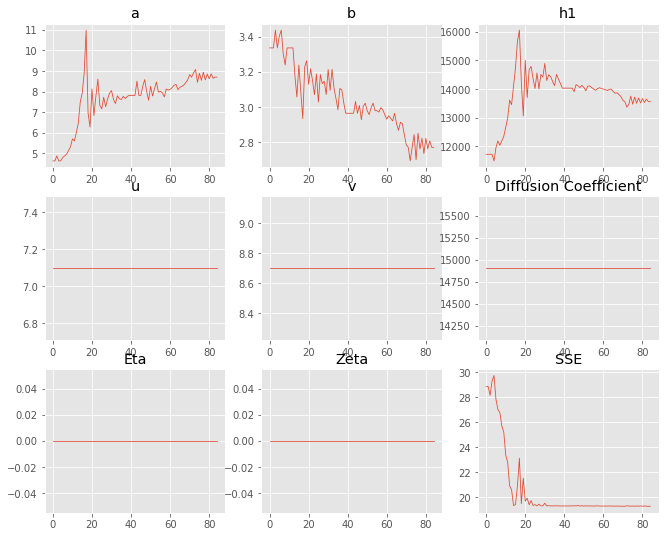

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.63435,8.7039
b,3.33597,2.77108
eta,0,0
ftt,"6,458","6,458"
h1,"11,723.7","13,558.5"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 5 Time: 0.048 minutes


Estimated remaining run time: 0.763 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.89e+03 	1.82e+03 	0.9627 		1.0000


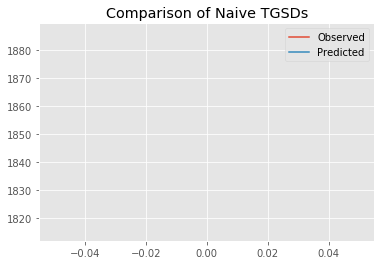

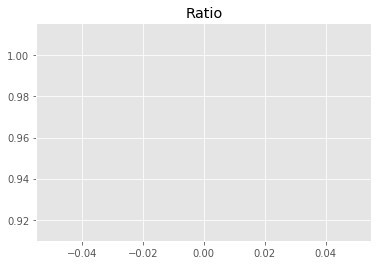

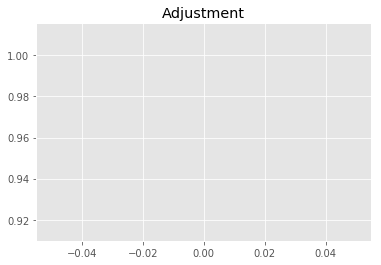

10532973236.949074
1


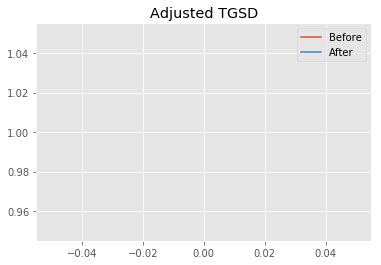

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.21086 	2.93983 	19213.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.47886 	1.87067 	18651.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.8001
New Misfit: 20.7305
Convergence:
0.09077066291349163

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.63e+03 	1.82e+03 	1.1108 		1.0000


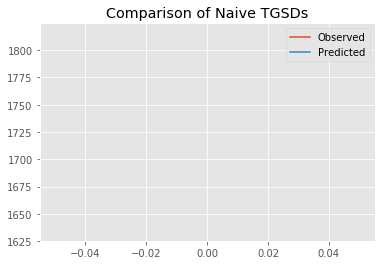

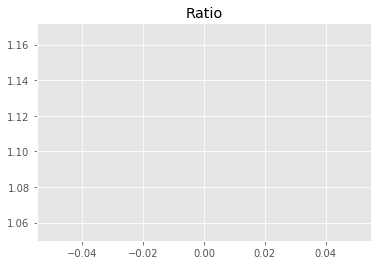

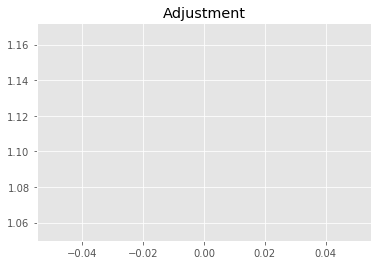

12154227009.872702
1


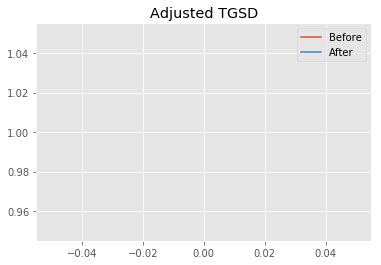

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.47886 	1.87067 	18651.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.49606 	1.79987 	14946.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.7305
New Misfit: 19.7135
Convergence:
0.04905831934542007

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9975 		1.0000


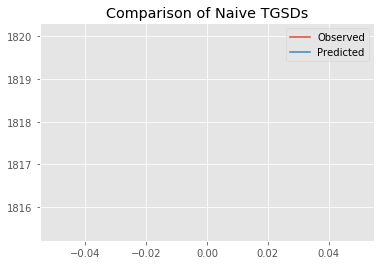

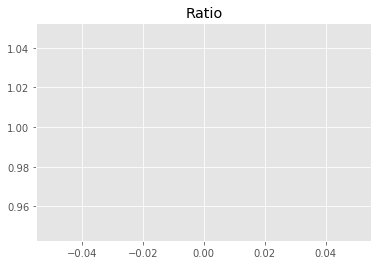

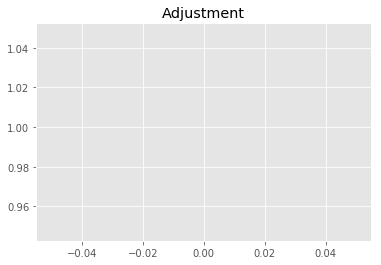

10913807093.800785
1


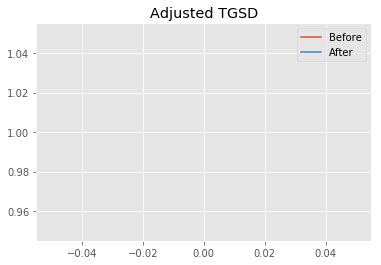

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.49606 	1.79987 	14946.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.72288 	1.95911 	13717.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.7135
New Misfit: 19.3476
Convergence:
0.01856089775819303

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9979 		1.0000


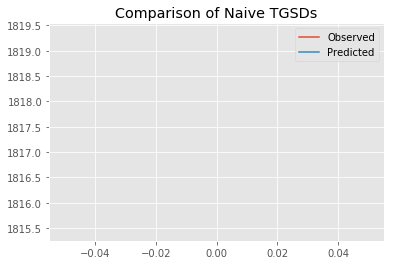

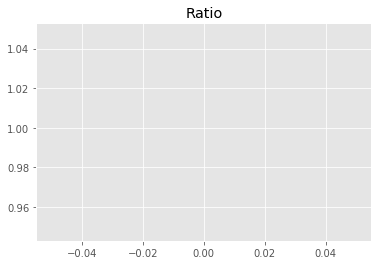

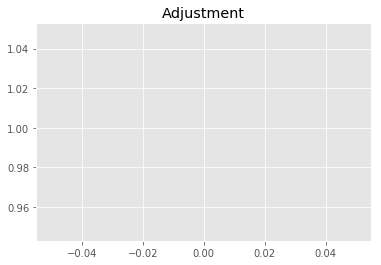

10918143519.959286
1


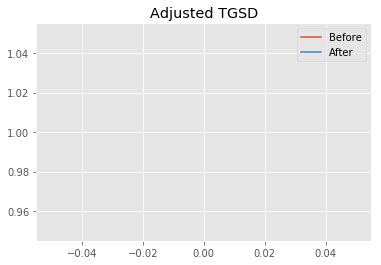

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.72288 	1.95911 	13717.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|6.40129 	1.96106 	13543.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.3476
New Misfit: 19.3207
Convergence:
0.0013912164393636173

____________________
a = 6.40129	b = 1.96106	            h1 = 13543.29902	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.320723245493113
Prior Misfit: 385.663,	 Post Misfit: 19.3207


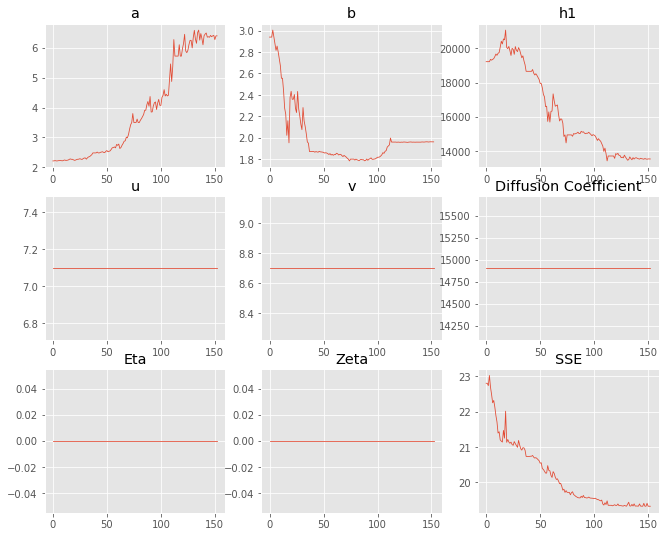

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.21086,6.40129
b,2.93983,1.96106
eta,0,0
ftt,"6,458","6,458"
h1,"19,213.6","13,543.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 6 Time: 0.090 minutes


Estimated remaining run time: 0.774 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.87e+03 	1.82e+03 	0.9691 		1.0000


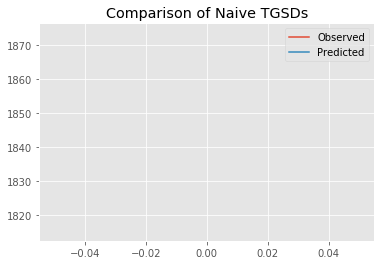

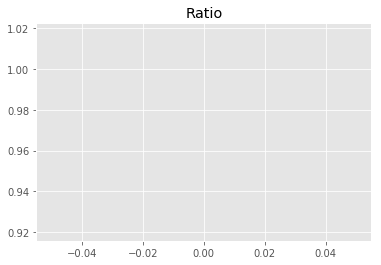

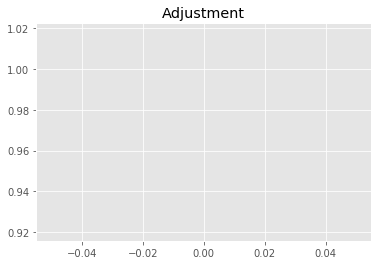

10603366440.442518
1


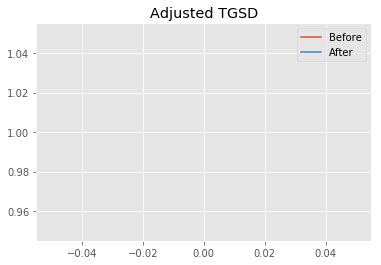

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.00497 	4.76195 	21851.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|6.45238 	4.83469 	16754.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.5699
New Misfit: 19.4955
Convergence:
0.09617290549519494

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.84e+03 	1.82e+03 	0.9881 		1.0000


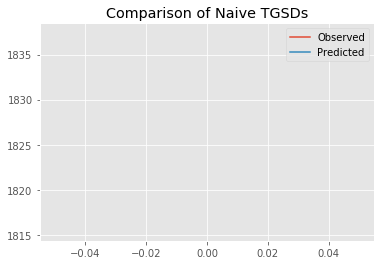

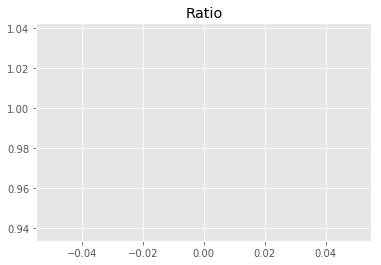

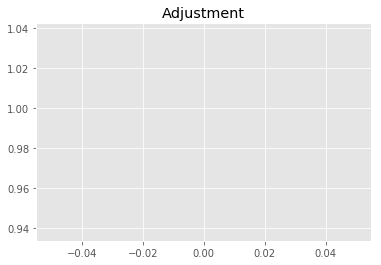

10811117583.568932
1


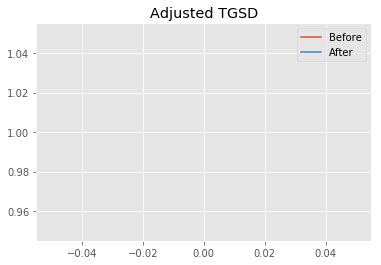

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.45238 	4.83469 	16754.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|17.7585 	12.6598 	16513.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.4955
New Misfit: 19.2834
Convergence:
0.010877412926151384

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.84e+03 	1.82e+03 	0.9864 		1.0000


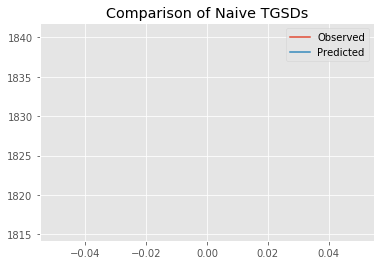

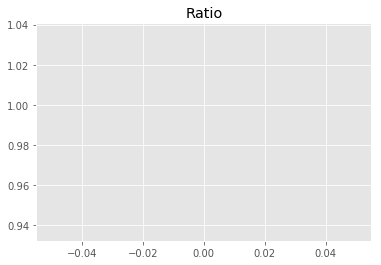

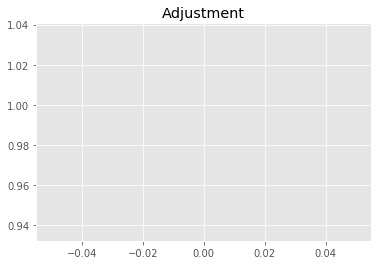

10792556335.830637
1


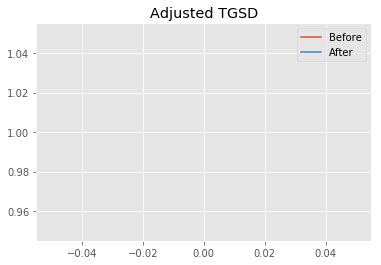

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|17.7585 	12.6598 	16513.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|19.1161 	13.1718 	16513.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2834
New Misfit: 19.2685
Convergence:
0.0007732643825047682

____________________
a = 19.11608	b = 13.17184	            h1 = 16513.52514	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.26849491117763
Prior Misfit: 350.328,	 Post Misfit: 19.2685


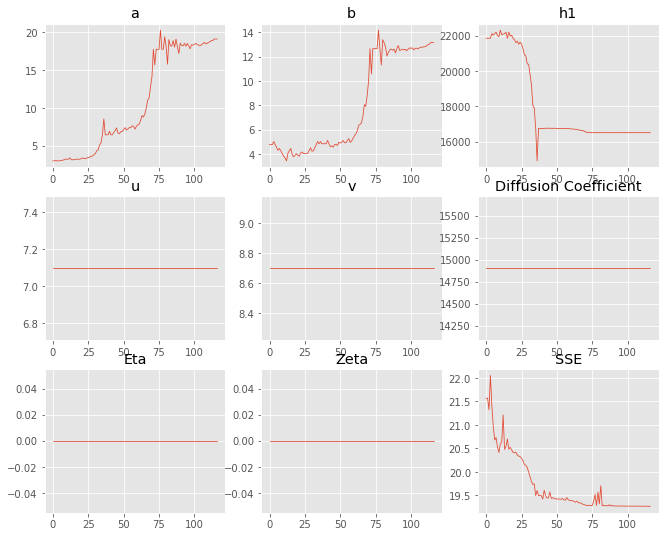

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.00497,19.1161
b,4.76195,13.1718
eta,0,0
ftt,"6,458","6,458"
h1,"21,851.4","16,513.5"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 7 Time: 0.069 minutes


Estimated remaining run time: 0.728 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.64e+03 	1.82e+03 	1.1038 		1.0000


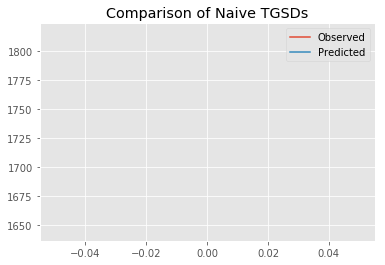

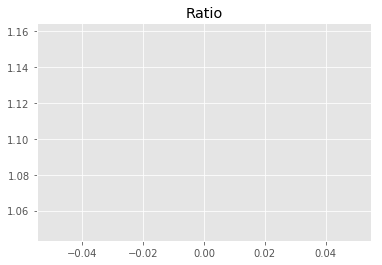

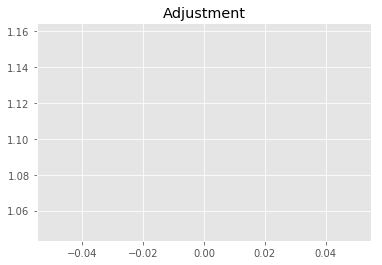

12077328393.354347
1


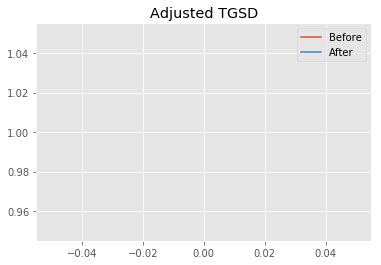

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.72972 	3.85053 	21065.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.707 	4.99071 	16121.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.3584
New Misfit: 19.3831
Convergence:
0.04790678794436691

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9965 		1.0000


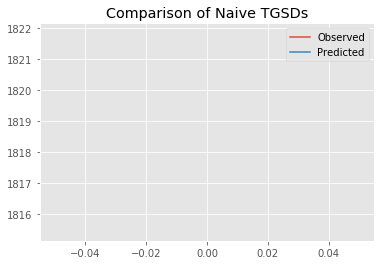

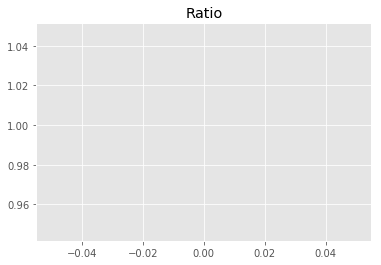

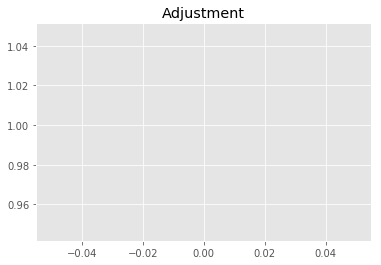

10903205913.773455
1


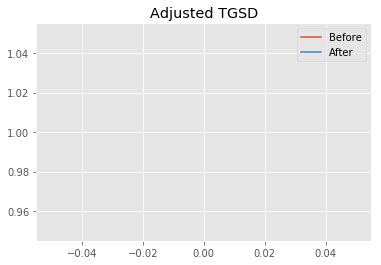

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.707 	4.99071 	16121.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|10.9667 	7.06574 	16195.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.3831
New Misfit: 19.3142
Convergence:
0.0035569305576683276

____________________
a = 10.96674	b = 7.06574	            h1 = 16195.18269	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 19.314173176991087
Prior Misfit: 341.224,	 Post Misfit: 19.3142


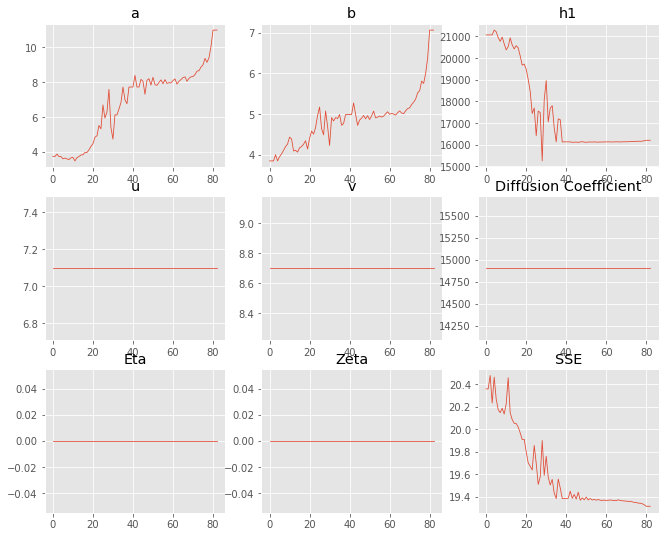

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.72972,10.9667
b,3.85053,7.06574
eta,0,0
ftt,"6,458","6,458"
h1,"21,065.5","16,195.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 8 Time: 0.050 minutes


Estimated remaining run time: 0.655 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.29e+03 	1.82e+03 	1.4054 		1.0000


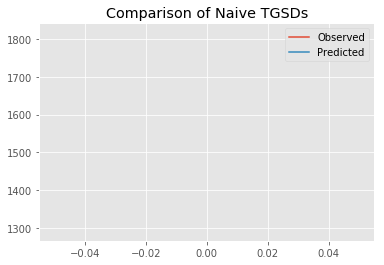

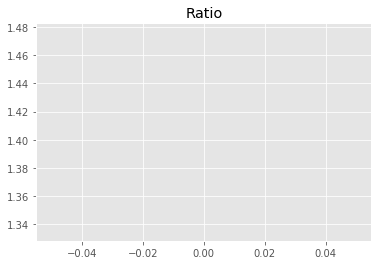

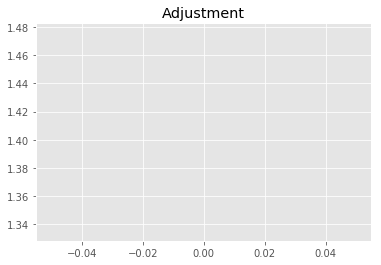

15377617173.374708
1


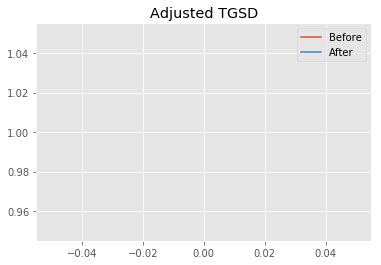

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.07972 	2.40414 	23178.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.89586 	2.45811 	13473.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 24.694
New Misfit: 19.3533
Convergence:
0.21627770761390566

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.87e+03 	1.82e+03 	0.9693 		1.0000


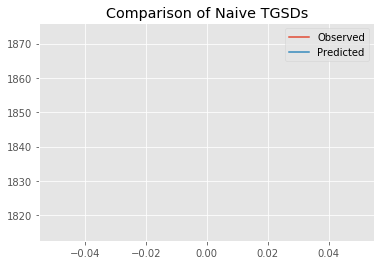

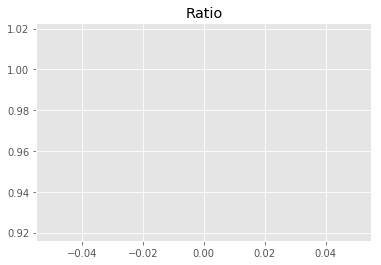

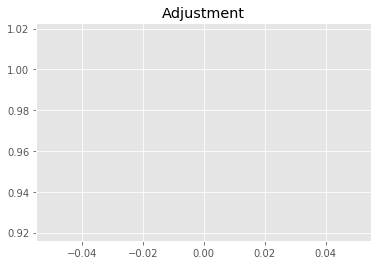

10605340338.099667
1


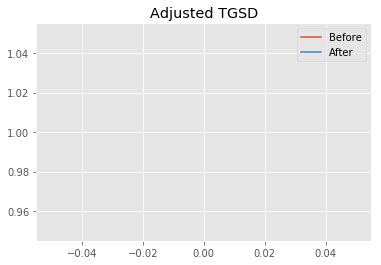

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.89586 	2.45811 	13473.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|10.3525 	2.4752 	13156 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.3533
New Misfit: 19.2569
Convergence:
0.004976290907045709

____________________
a = 10.35247	b = 2.47520	            h1 = 13156.03867	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 19.256947760527346
Prior Misfit: 618.62,	 Post Misfit: 19.2569


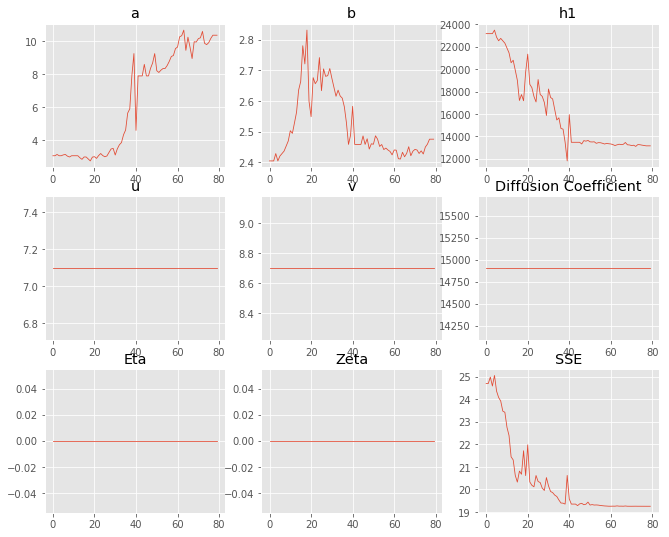

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.07972,10.3525
b,2.40414,2.4752
eta,0,0
ftt,"6,458","6,458"
h1,"23,178.9","13,156"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 9 Time: 0.048 minutes


Estimated remaining run time: 0.583 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.38e+03 	1.82e+03 	1.3183 		1.0000


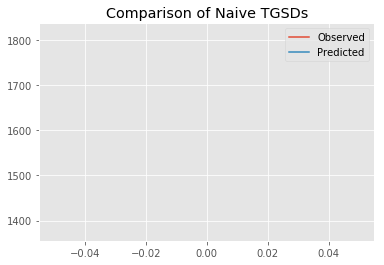

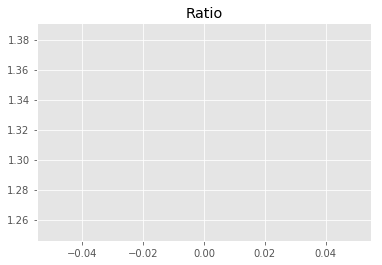

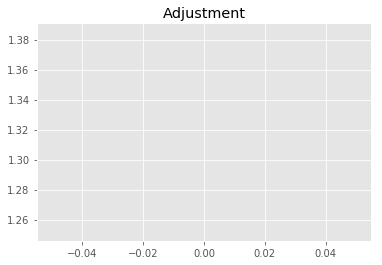

14424508118.765024
1


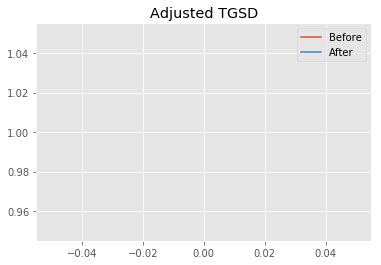

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.49833 	4.25548 	23737.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|8.65531 	6.66488 	16872.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.2253
New Misfit: 19.4136
Convergence:
0.16411574559414338

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.85e+03 	1.82e+03 	0.9827 		1.0000


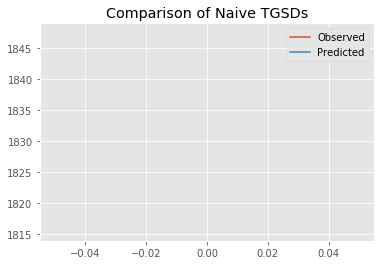

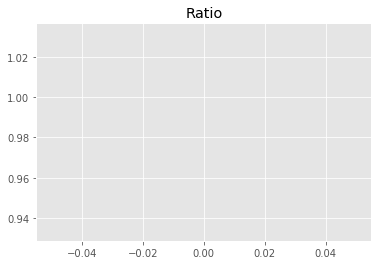

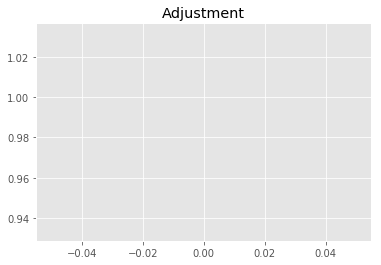

10752163807.482956
1


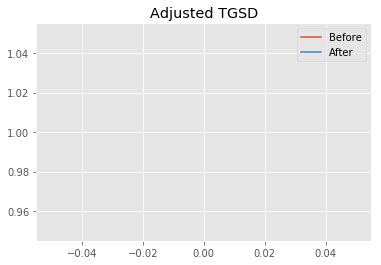

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.65531 	6.66488 	16872.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|26.5509 	18.9901 	16647 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.4136
New Misfit: 19.2538
Convergence:
0.008233863558857406

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.83e+03 	1.82e+03 	0.9942 		1.0000


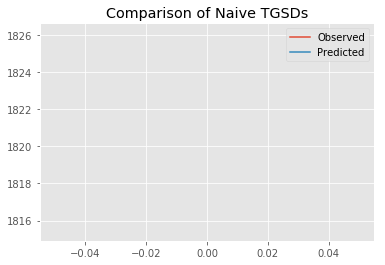

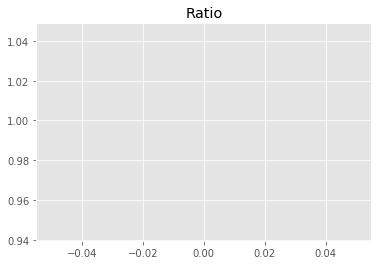

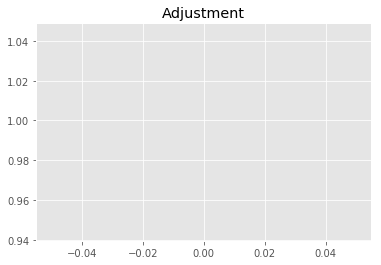

10877848886.220499
1


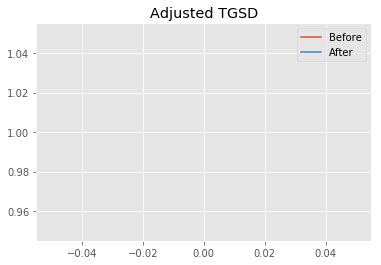

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|26.5509 	18.9901 	16647 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|33.062 	23.5244 	16614.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2538
New Misfit: 19.2466
Convergence:
0.00037229126960316994

____________________
a = 33.06199	b = 23.52438	            h1 = 16614.72282	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.246613797310946
Prior Misfit: 526.109,	 Post Misfit: 19.2466


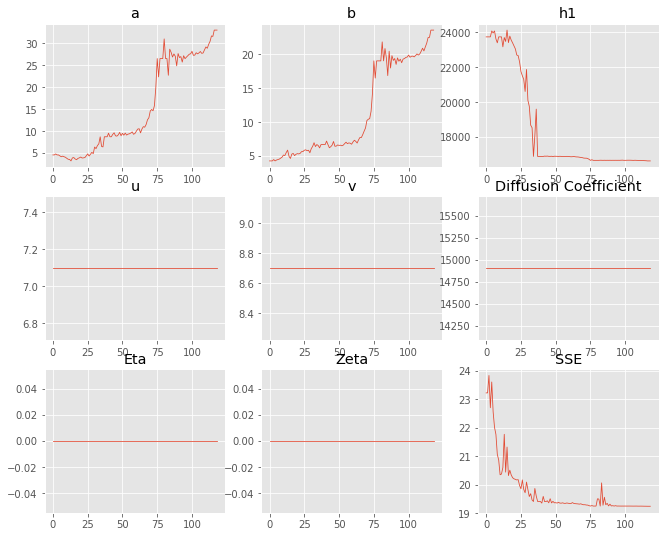

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.49833,33.062
b,4.25548,23.5244
eta,0,0
ftt,"6,458","6,458"
h1,"23,737.7","16,614.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 10 Time: 0.066 minutes


Estimated remaining run time: 0.531 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.48e+03 	1.82e+03 	1.2289 		1.0000


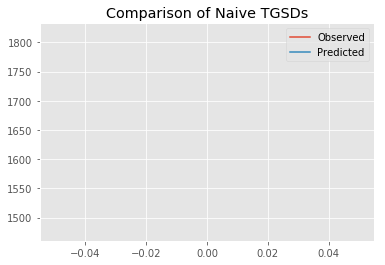

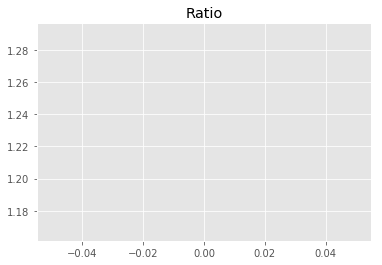

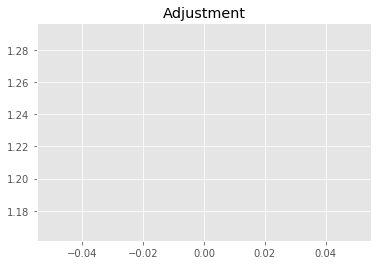

13446154396.050594
1


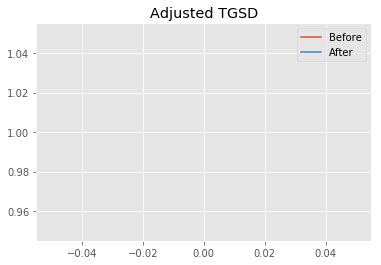

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.75984 	2.5986 	22355.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.73414 	2.89371 	16565.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.1053
New Misfit: 20.0547
Convergence:
0.09276111625315811

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.86e+03 	1.82e+03 	0.9776 		1.0000


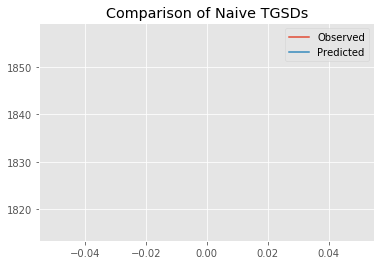

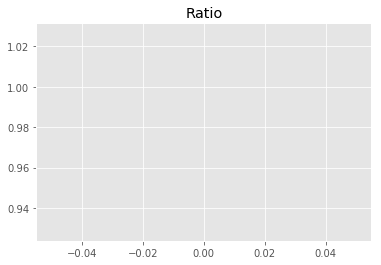

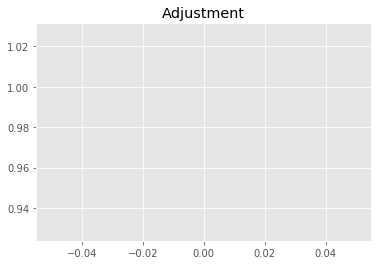

10696192875.090424
1


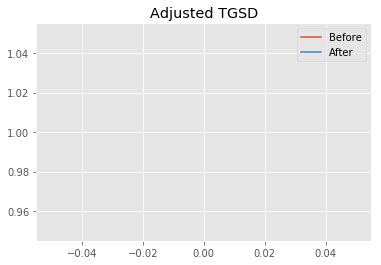

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.73414 	2.89371 	16565.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.62539 	3.73746 	16534.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.0547
New Misfit: 19.4868
Convergence:
0.028320547840165272

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.79e+03 	1.82e+03 	1.0162 		1.0000


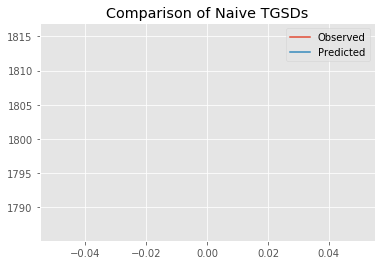

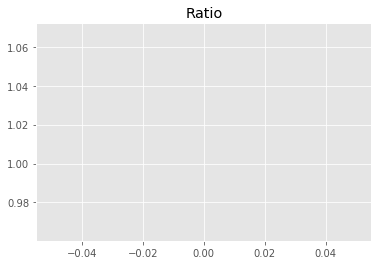

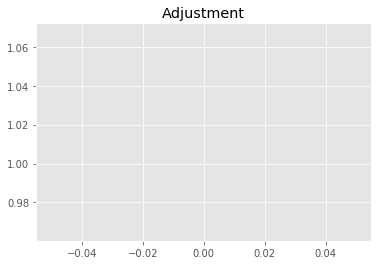

11118544352.083519
1


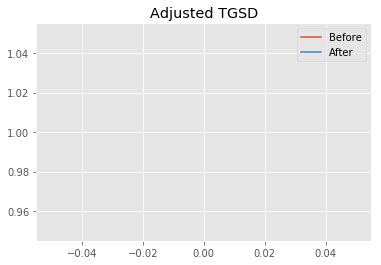

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.62539 	3.73746 	16534.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|463.717 	321.673 	16459.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.4868
New Misfit: 19.223
Convergence:
0.013538708981608744

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.83e+03 	1.82e+03 	0.9901 		1.0000


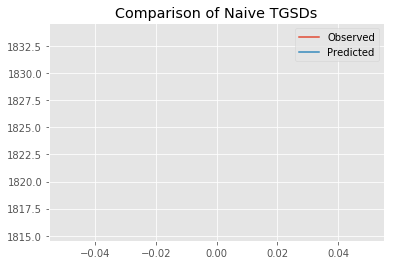

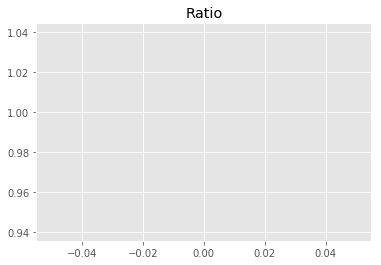

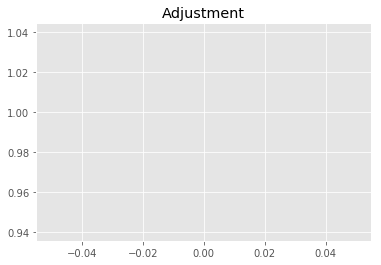

10832822797.735859
1


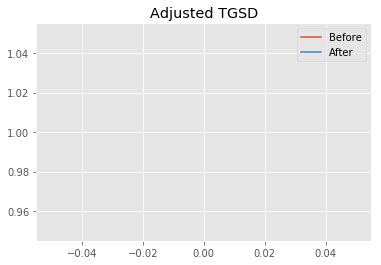

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|463.717 	321.673 	16459.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|639.707 	436.644 	16452.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.223
New Misfit: 19.2226
Convergence:
1.6212169274536045e-05

____________________
a = 639.70678	b = 436.64365	            h1 = 16452.58184	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.222646203769596
Prior Misfit: 434.605,	 Post Misfit: 19.2226


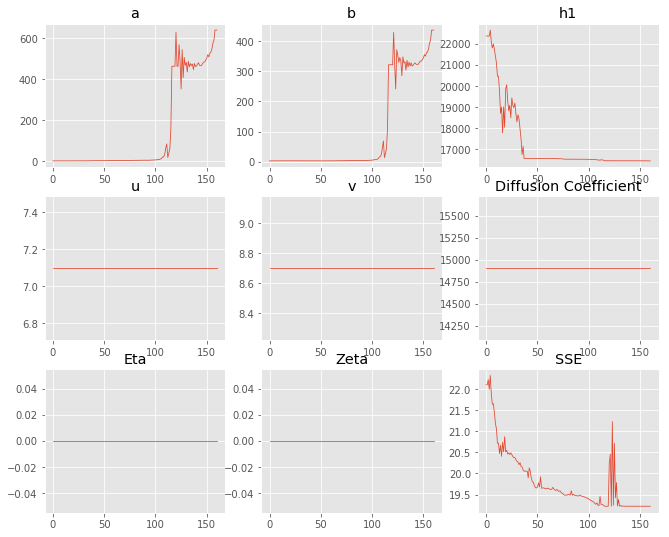

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.75984,639.707
b,2.5986,436.644
eta,0,0
ftt,"6,458","6,458"
h1,"22,355.6","16,452.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 11 Time: 0.084 minutes


Estimated remaining run time: 0.489 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.94e+03 	1.82e+03 	0.9364 		1.0000


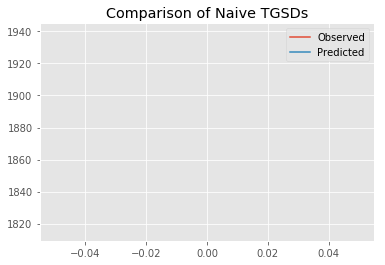

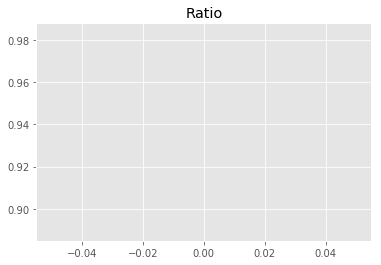

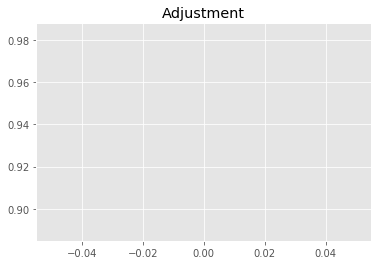

10245174991.882164
1


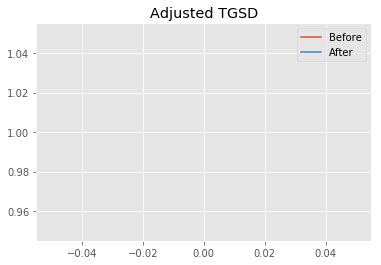

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.1722 	1.93847 	13639.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|6.0677 	1.96296 	13561.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.1048
New Misfit: 19.3308
Convergence:
0.03849847181822839

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9986 		1.0000


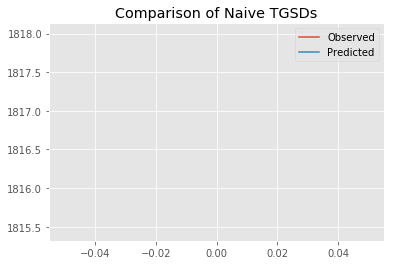

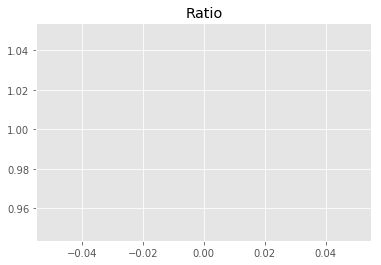

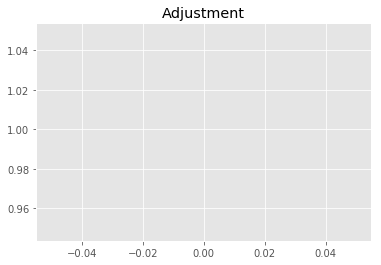

10926203899.270979
1


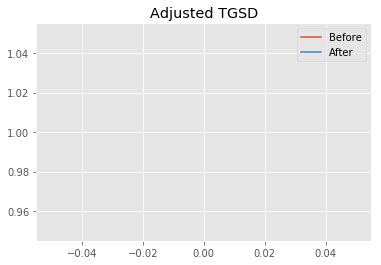

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.0677 	1.96296 	13561.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|6.38758 	1.96275 	13543.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.3308
New Misfit: 19.3206
Convergence:
0.0005260271535875047

____________________
a = 6.38758	b = 1.96275	            h1 = 13543.50315	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 19.320599958921328
Prior Misfit: 296.554,	 Post Misfit: 19.3206


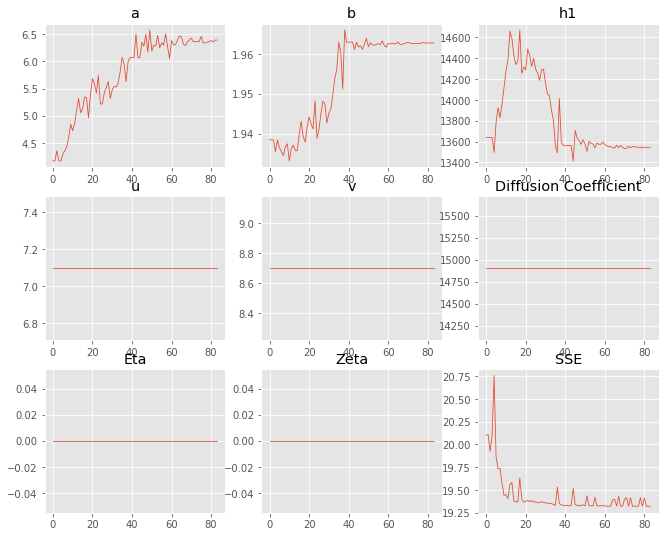

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.1722,6.38758
b,1.93847,1.96275
eta,0,0
ftt,"6,458","6,458"
h1,"13,639.1","13,543.5"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 12 Time: 0.051 minutes


Estimated remaining run time: 0.422 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.50e+03 	1.82e+03 	1.2120 		1.0000


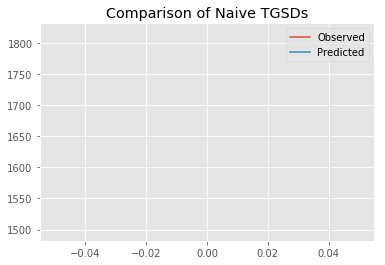

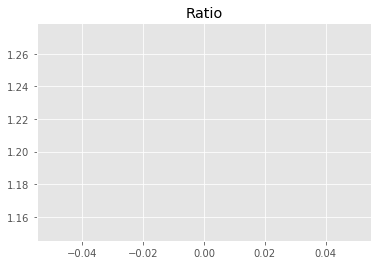

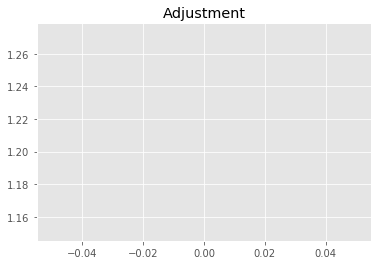

13260983622.464945
1


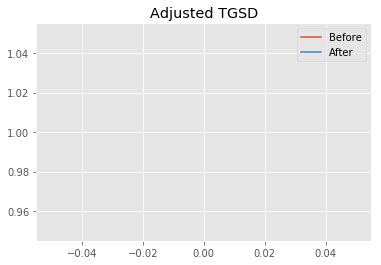

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.3118 	4.4074 	31872.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.81498 	3.83174 	22295.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.5675
New Misfit: 20.8137
Convergence:
0.07771245778750208

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.74e+03 	1.82e+03 	1.0443 		1.0000


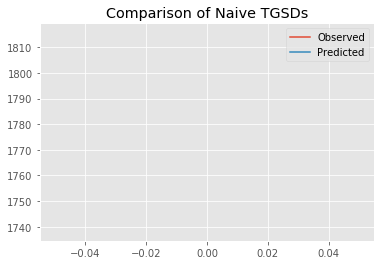

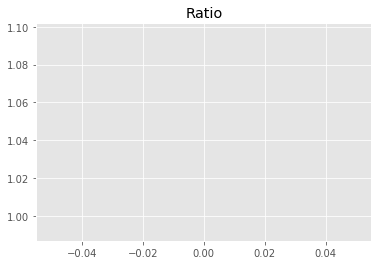

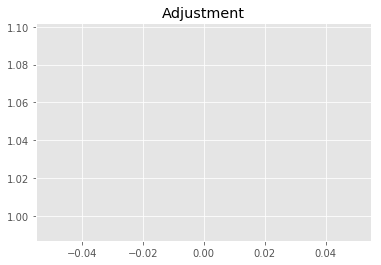

11426657109.229439
1


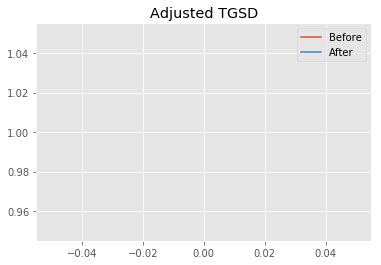

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.81498 	3.83174 	22295.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.5982 	3.84716 	16112.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.8137
New Misfit: 19.5787
Convergence:
0.059334137815168546

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.85e+03 	1.82e+03 	0.9807 		1.0000


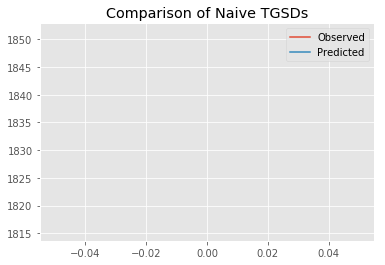

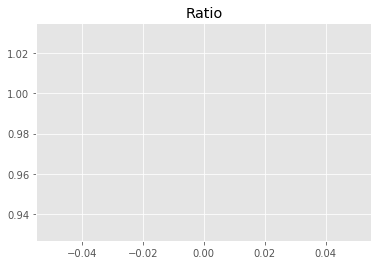

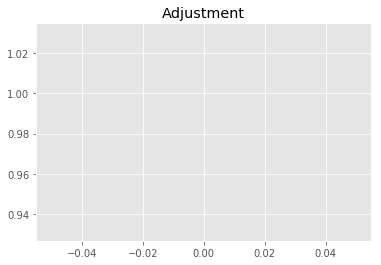

10730941621.544258
1


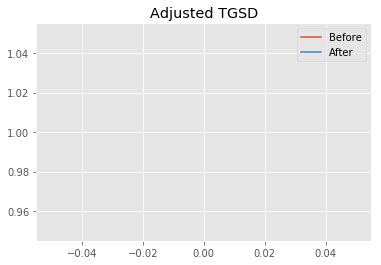

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.5982 	3.84716 	16112.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|20.8524 	16.6912 	17306.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.5787
New Misfit: 19.2689
Convergence:
0.015822565486625962

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.83e+03 	1.82e+03 	0.9929 		1.0000


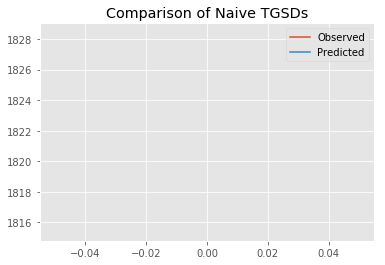

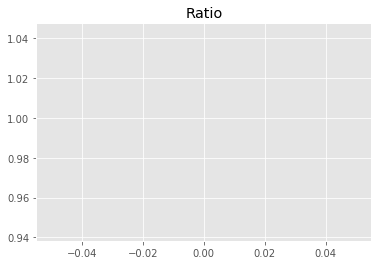

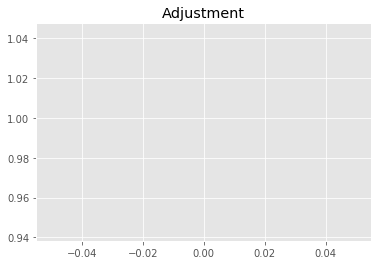

10864220965.175072
1


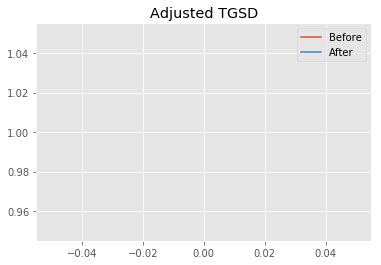

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|20.8524 	16.6912 	17306.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|42.1924 	33.256 	17170.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2689
New Misfit: 19.2427
Convergence:
0.0013596499253509492

____________________
a = 42.19237	b = 33.25599	            h1 = 17170.75151	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.242738163139386
Prior Misfit: 451.261,	 Post Misfit: 19.2427


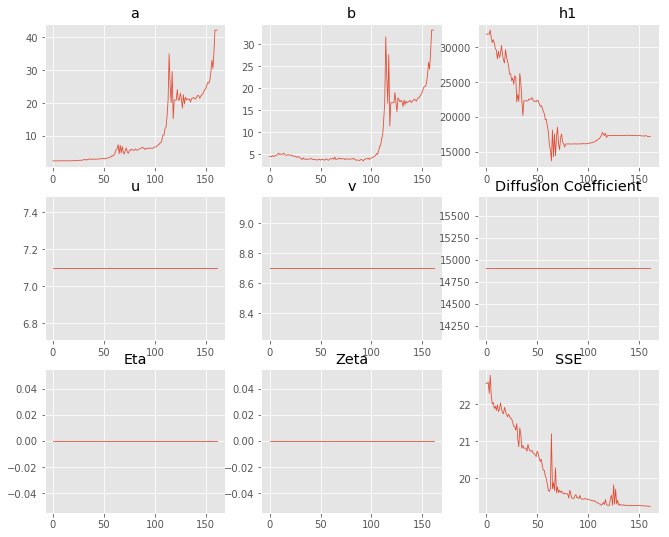

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.3118,42.1924
b,4.4074,33.256
eta,0,0
ftt,"6,458","6,458"
h1,"31,872.6","17,170.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 13 Time: 0.086 minutes


Estimated remaining run time: 0.373 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.88e+03 	1.82e+03 	0.9637 		1.0000


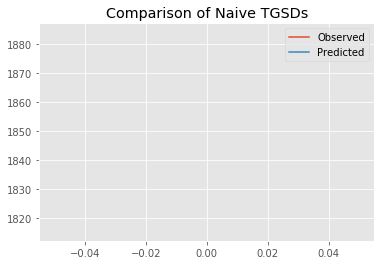

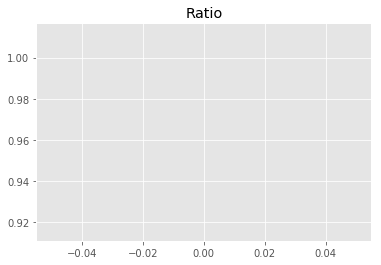

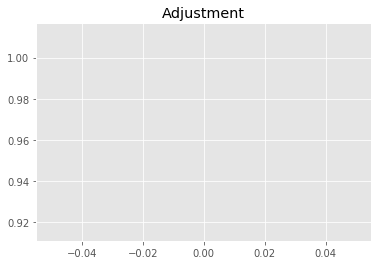

10544549962.55823
1


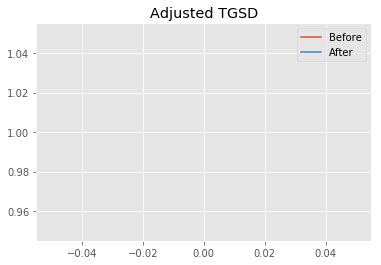

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.82867 	1.25465 	15143.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.15401 	1.00862 	16484.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8232
New Misfit: 20.4196
Convergence:
0.06431304941300281

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.66e+03 	1.82e+03 	1.0965 		1.0000


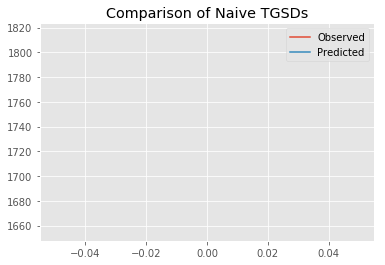

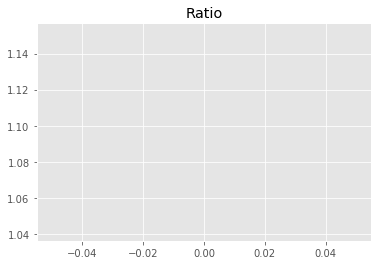

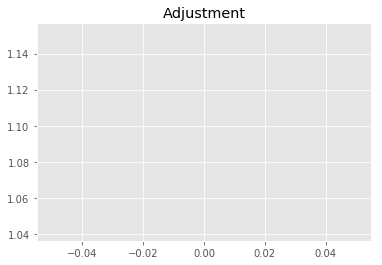

11997007906.91311
1


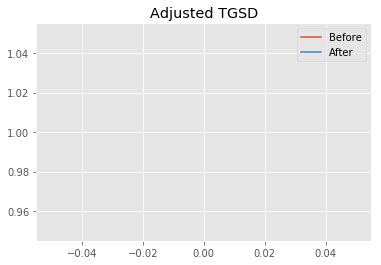

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.15401 	1.00862 	16484.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.23646 	1.24004 	16483 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.4196
New Misfit: 20.3155
Convergence:
0.005100917564974568

____________________
a = 2.23646	b = 1.24004	            h1 = 16482.95990	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 20.315486172382624
Prior Misfit: 354.415,	 Post Misfit: 20.3155


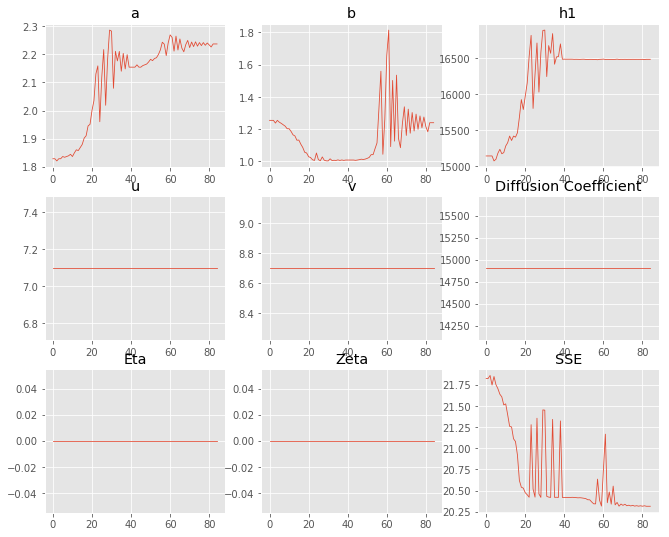

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.82867,2.23646
b,1.25465,1.24004
eta,0,0
ftt,"6,458","6,458"
h1,"15,143.7","16,483"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 14 Time: 0.051 minutes


Estimated remaining run time: 0.307 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.12e+03 	1.82e+03 	0.8580 		1.0000


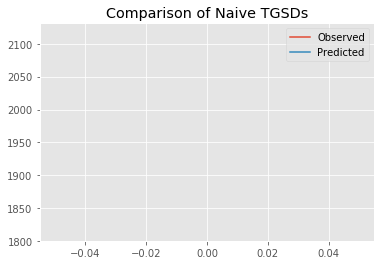

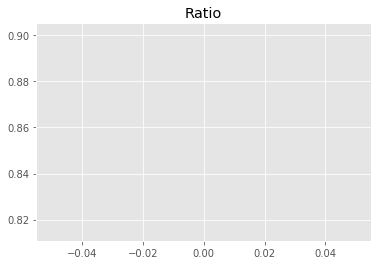

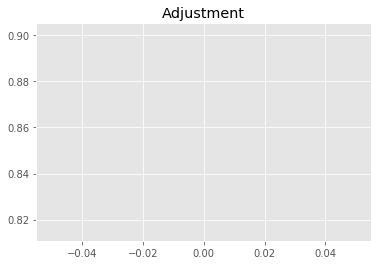

9387692015.106176
1


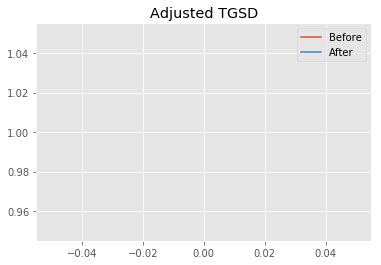

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.80428 	4.61692 	18641.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|1.77113 	1.73942 	20087.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 35.4314
New Misfit: 21.8229
Convergence:
0.384080543944657

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.63e+03 	1.82e+03 	1.1135 		1.0000


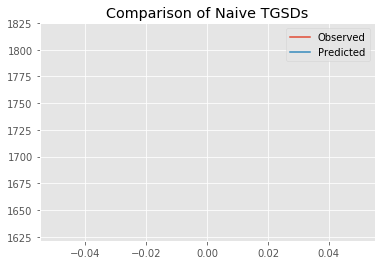

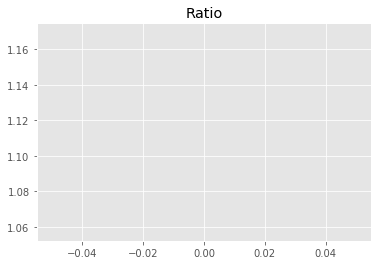

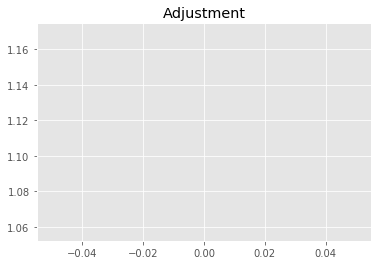

12182989865.890144
1


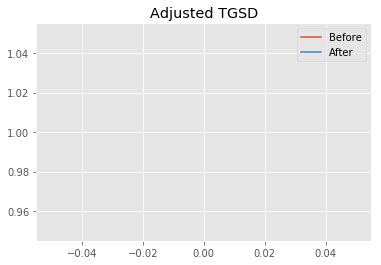

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.77113 	1.73942 	20087.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.65149 	1.54737 	15104.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.8229
New Misfit: 20.3018
Convergence:
0.06970213092528849

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.85e+03 	1.82e+03 	0.9811 		1.0000


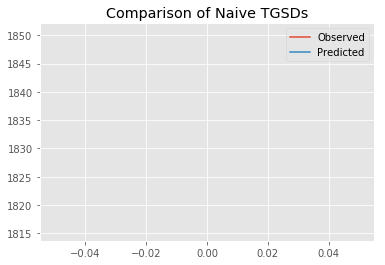

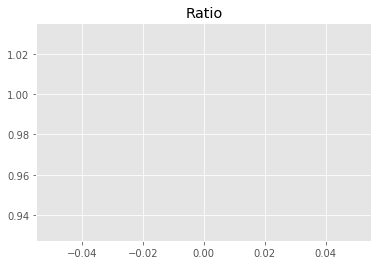

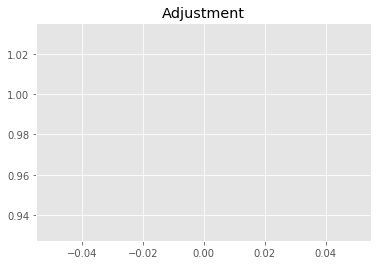

10735214191.616667
1


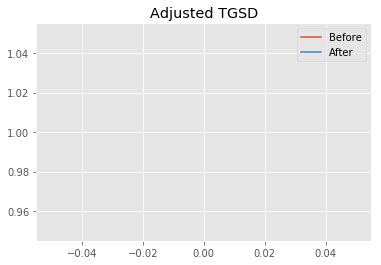

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.65149 	1.54737 	15104.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.12445 	1.45838 	15633.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.3018
New Misfit: 19.7102
Convergence:
0.029137303845438608

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.75e+03 	1.82e+03 	1.0368 		1.0000


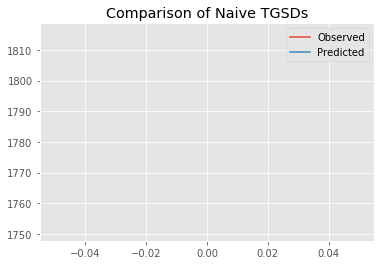

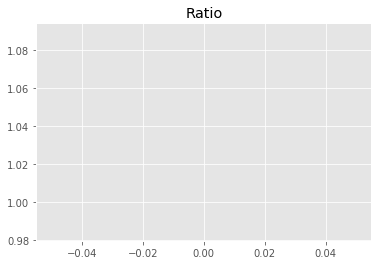

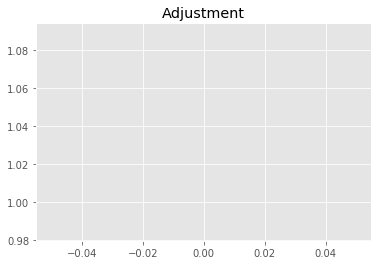

11344284268.982872
1


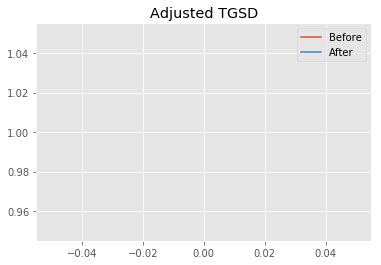

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.12445 	1.45838 	15633.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.7605 	3.15696 	14404.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.7102
New Misfit: 19.3143
Convergence:
0.020087964645028118

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.81e+03 	1.82e+03 	1.0031 		1.0000


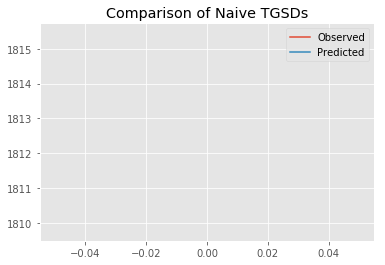

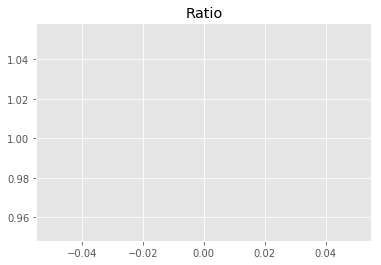

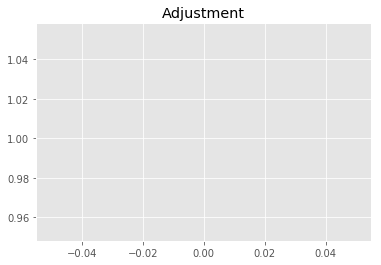

10975947069.37868
1


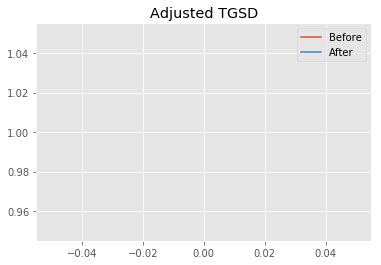

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.7605 	3.15696 	14404.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|11.2336 	2.51534 	12842.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.3143
New Misfit: 19.2524
Convergence:
0.0032029571353745906

____________________
a = 11.23365	b = 2.51534	            h1 = 12842.66544	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 19.252443755438755
Prior Misfit: 729.596,	 Post Misfit: 19.2524


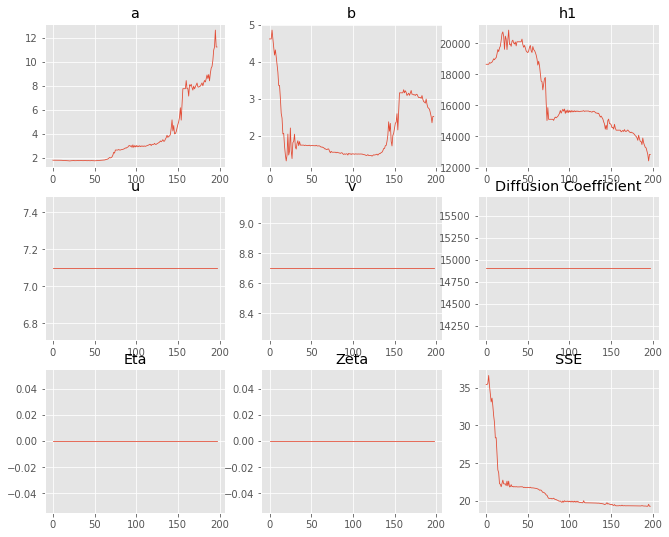

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.80428,11.2336
b,4.61692,2.51534
eta,0,0
ftt,"6,458","6,458"
h1,"18,641.6","12,842.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 15 Time: 0.103 minutes


Estimated remaining run time: 0.256 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.96e+03 	1.82e+03 	0.9265 		1.0000


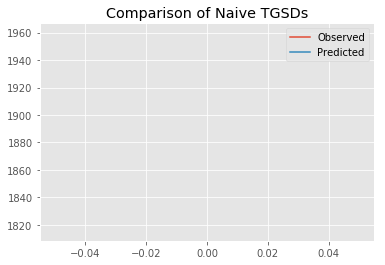

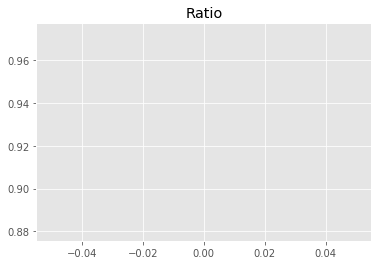

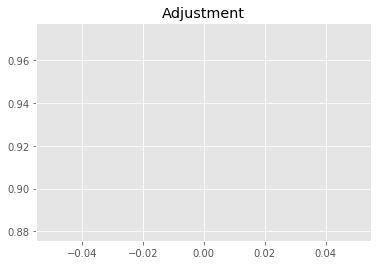

10136851700.743137
1


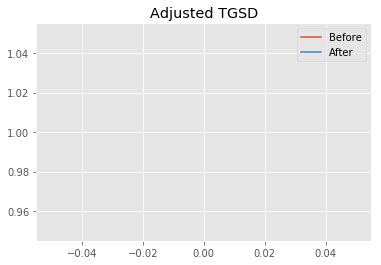

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.7242 	4.36192 	20195.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.84953 	2.95004 	16667.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.3455
New Misfit: 19.9415
Convergence:
0.14580897907552146

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.84e+03 	1.82e+03 	0.9844 		1.0000


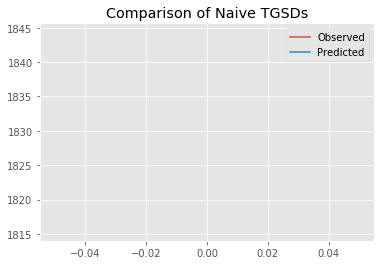

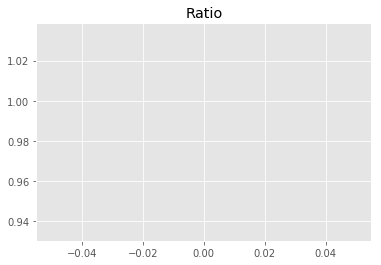

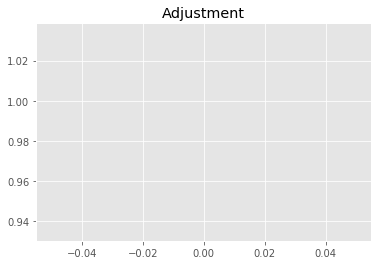

10771022184.800558
1


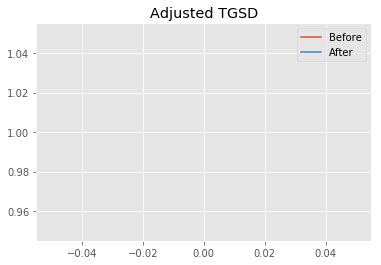

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.84953 	2.95004 	16667.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|4.90004 	3.20426 	16656.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.9415
New Misfit: 19.5638
Convergence:
0.018940631163559603

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0291 		1.0000


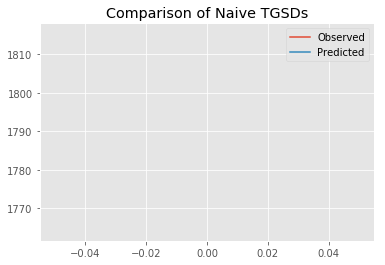

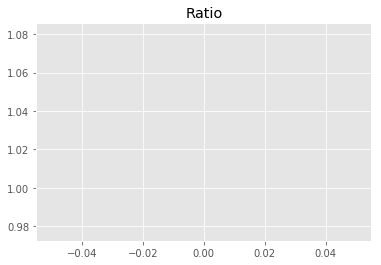

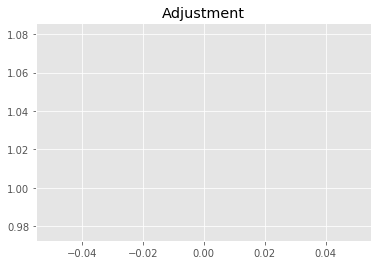

11259593904.495386
1


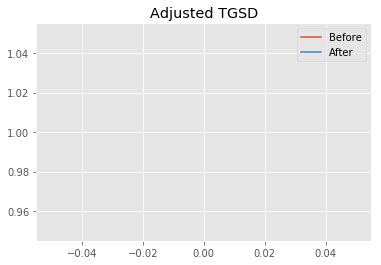

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.90004 	3.20426 	16656.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|25.4571 	16.2069 	16053.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.5638
New Misfit: 19.2529
Convergence:
0.0158936934791554

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9962 		1.0000


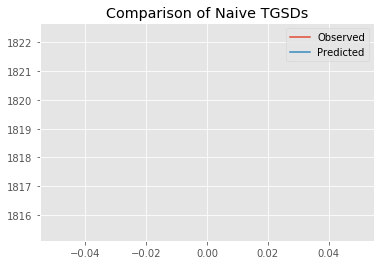

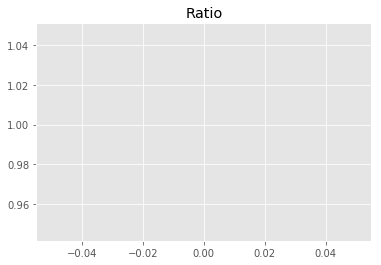

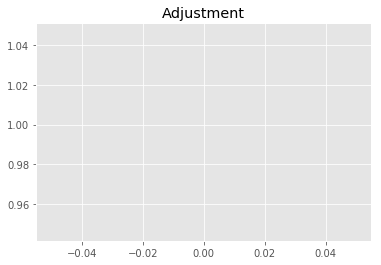

10900338169.545235
1


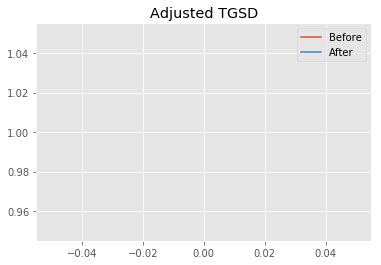

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|25.4571 	16.2069 	16053.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|54.0679 	30.1413 	15341.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2529
New Misfit: 19.2353
Convergence:
0.0009138631717227667

____________________
a = 54.06793	b = 30.14134	            h1 = 15341.09625	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.23527104397425
Prior Misfit: 390.901,	 Post Misfit: 19.2353


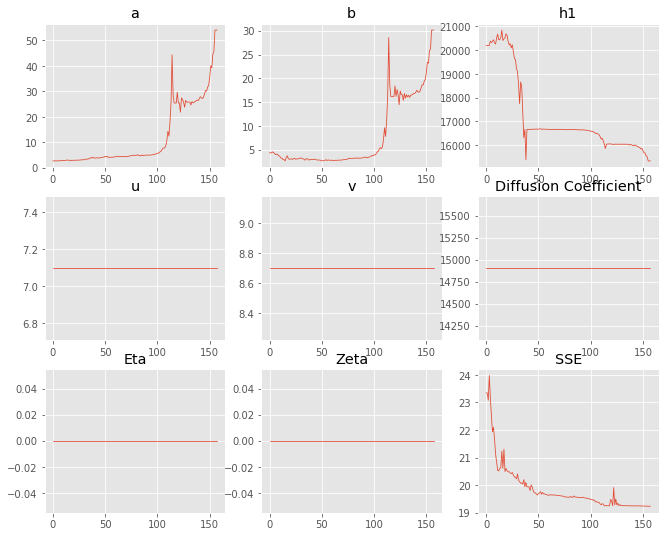

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.7242,54.0679
b,4.36192,30.1413
eta,0,0
ftt,"6,458","6,458"
h1,"20,195.3","15,341.1"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 16 Time: 0.084 minutes


Estimated remaining run time: 0.196 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.56e+03 	1.82e+03 	1.1642 		1.0000


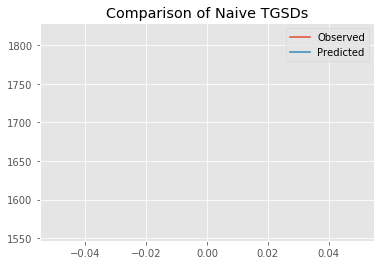

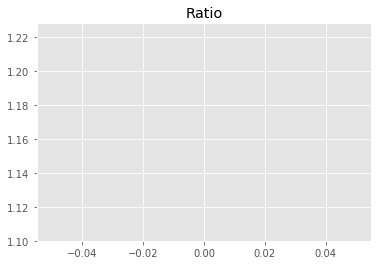

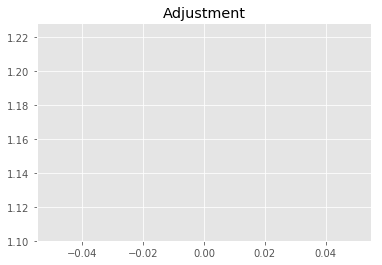

12737952750.228462
1


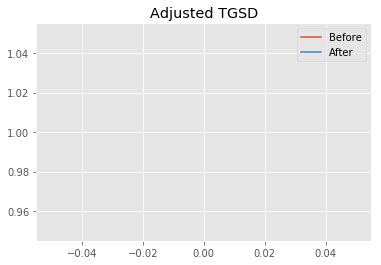

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.52129 	3.86904 	35461.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|49.438 	191.969 	42362.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 23.9289
New Misfit: 19.2703
Convergence:
0.19468528639293012

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.80e+03 	1.82e+03 	1.0095 		1.0000


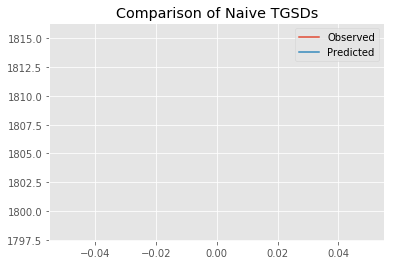

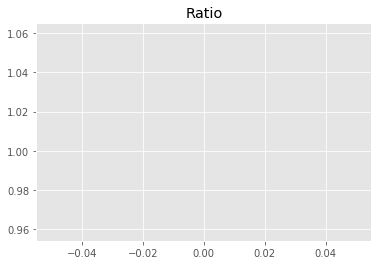

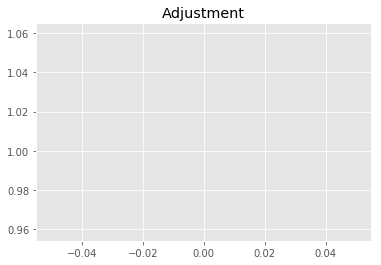

11046080636.093493
1


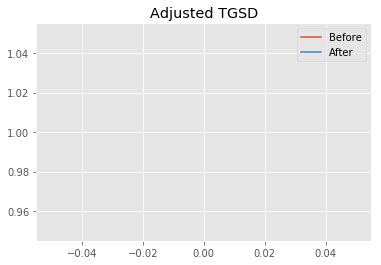

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|49.438 	191.969 	42362.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|49.5151 	196.907 	42472.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2703
New Misfit: 19.2543
Convergence:
0.0008316287792387706

____________________
a = 49.51509	b = 196.90694	            h1 = 42472.84134	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 19.254295886229418
Prior Misfit: 504.363,	 Post Misfit: 19.2543


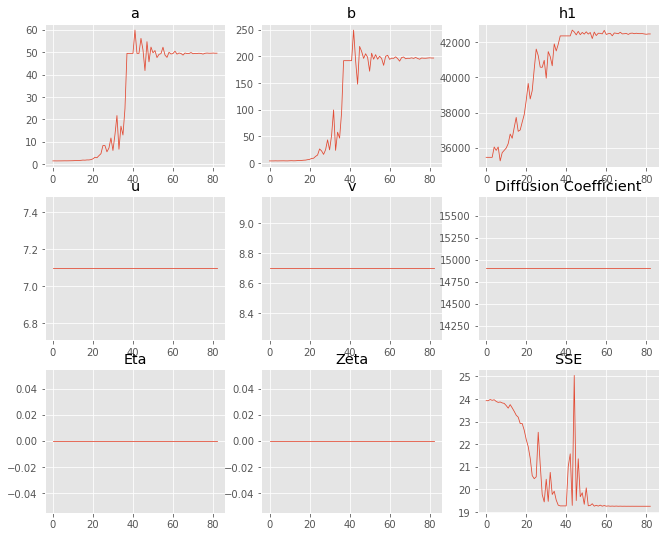

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.52129,49.5151
b,3.86904,196.907
eta,0,0
ftt,"6,458","6,458"
h1,"35,461.3","42,472.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 17 Time: 0.051 minutes


Estimated remaining run time: 0.129 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.61e+03 	1.82e+03 	1.1280 		1.0000


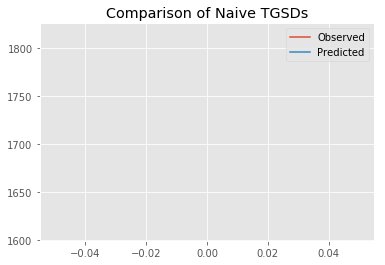

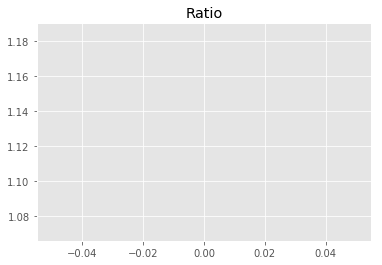

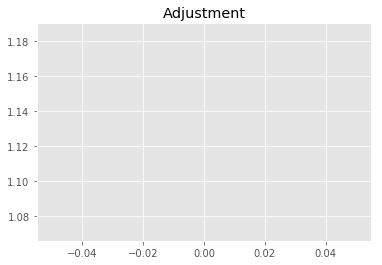

12342184860.479593
1


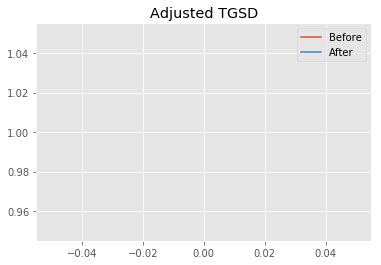

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.983 	4.44556 	31949.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|1.97692 	2.09864 	19161.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 22.5729
New Misfit: 21.6346
Convergence:
0.04156814249321644

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.75e+03 	1.82e+03 	1.0365 		1.0000


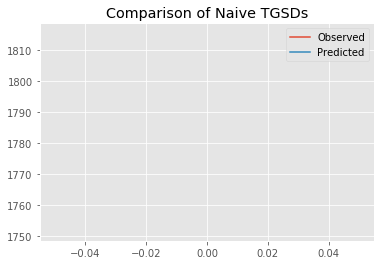

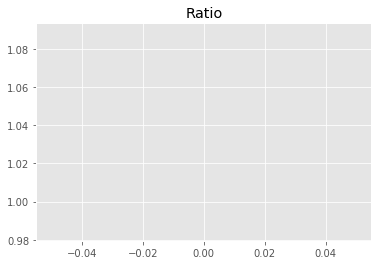

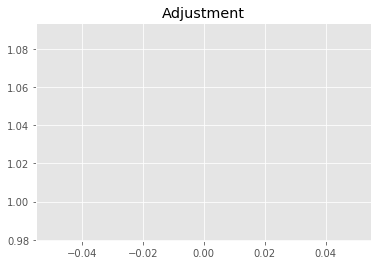

11340600083.824932
1


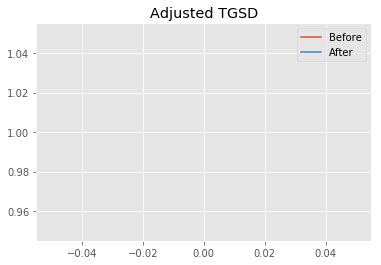

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97692 	2.09864 	19161.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|1.981 	2.08048 	19810.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.6346
New Misfit: 21.4832
Convergence:
0.006998140447751472

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.71e+03 	1.82e+03 	1.0621 		1.0000


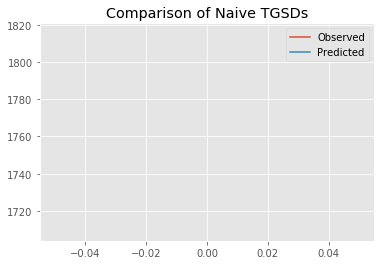

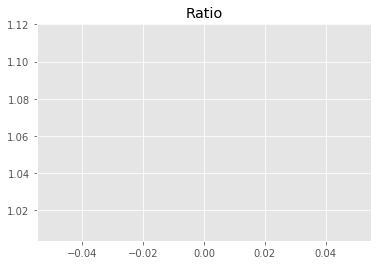

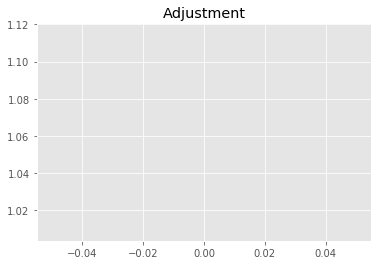

11621284650.001207
1


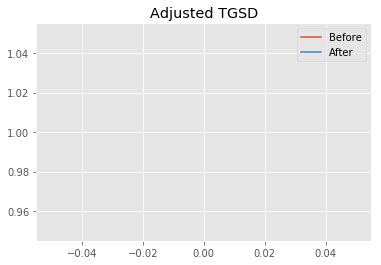

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.981 	2.08048 	19810.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|1.96247 	1.83494 	19675.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.4832
New Misfit: 21.3785
Convergence:
0.004870564494177478

____________________
a = 1.96247	b = 1.83494	            h1 = 19675.28780	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 21.378549107960207
Prior Misfit: 432.985,	 Post Misfit: 21.3785


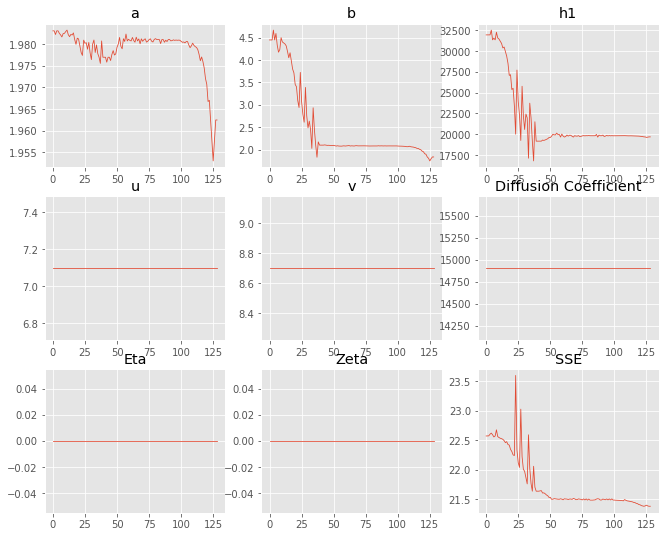

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.983,1.96247
b,4.44556,1.83494
eta,0,0
ftt,"6,458","6,458"
h1,"31,949.8","19,675.3"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 18 Time: 0.069 minutes


Estimated remaining run time: 0.065 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.61e+03 	1.82e+03 	1.1270 		1.0000


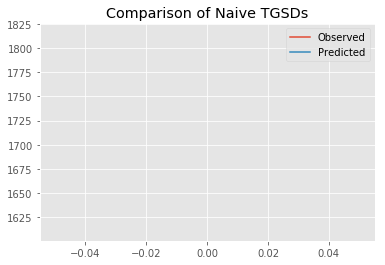

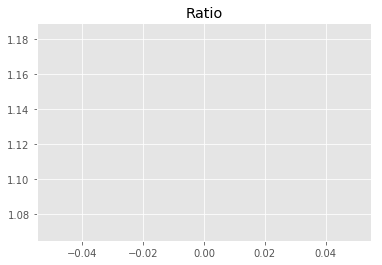

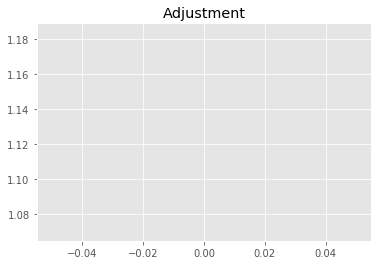

12330886594.415596
1


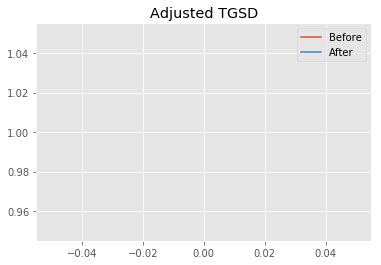

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.97362 	2.93543 	17489.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|9.34575 	6.35484 	16740.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 20.3182
New Misfit: 19.3654
Convergence:
0.04689240650359616

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.78e+03 	1.82e+03 	1.0190 		1.0000


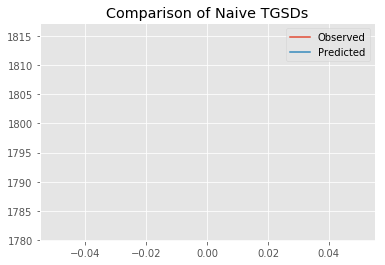

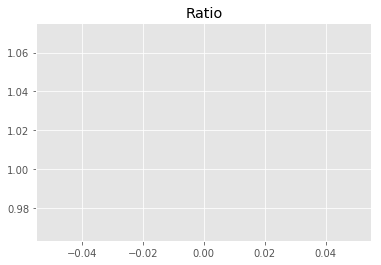

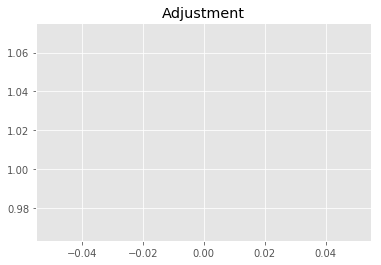

11149569761.76328
1


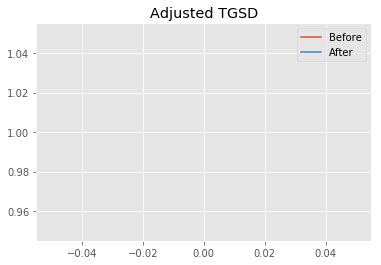

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.34575 	6.35484 	16740.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|15.8264 	11.2992 	16646.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.3654
New Misfit: 19.2833
Convergence:
0.004240984043613628

____________________
a = 15.82637	b = 11.29921	            h1 = 16646.83059	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 19.283260984933957
Prior Misfit: 352.354,	 Post Misfit: 19.2833


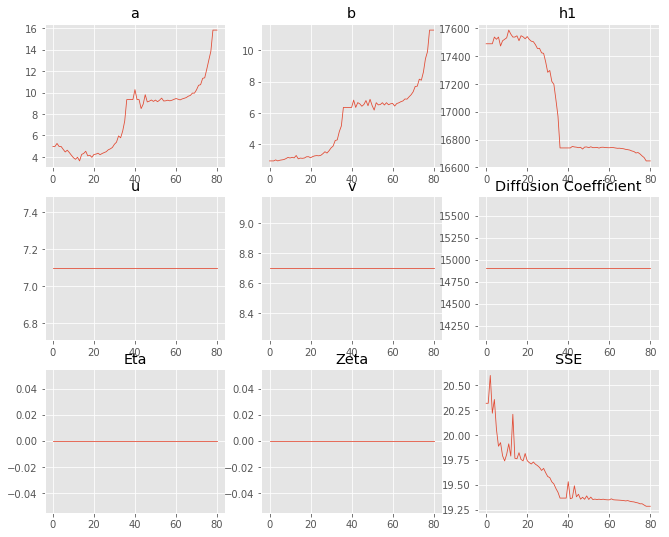

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.97362,15.8264
b,2.93543,11.2992
eta,0,0
ftt,"6,458","6,458"
h1,"17,489.9","16,646.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 19 Time: 0.047 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.80e+03 	1.82e+03 	1.0111 		1.0000


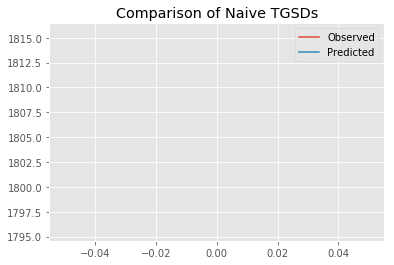

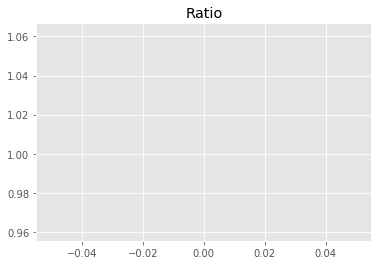

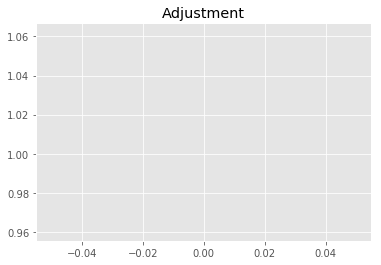

11062715420.737232
1


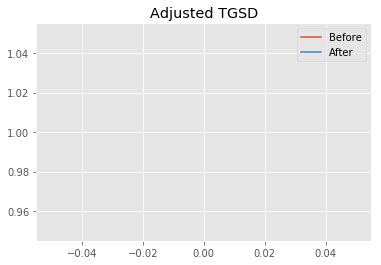

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.66558 	3.50265 	20933.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|4.25535 	2.67263 	16095.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.1296
New Misfit: 19.6253
Convergence:
0.07119488971488645

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.79e+03 	1.82e+03 	1.0124 		1.0000


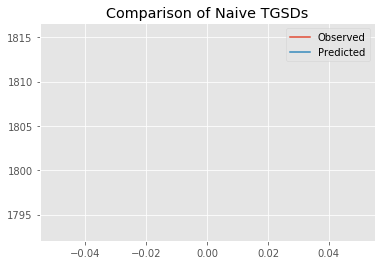

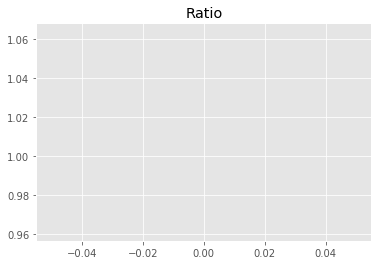

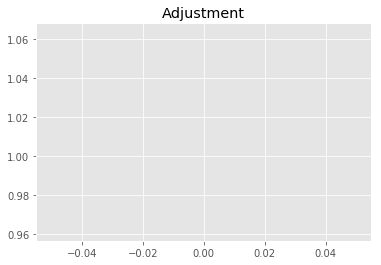

11077600614.718464
1


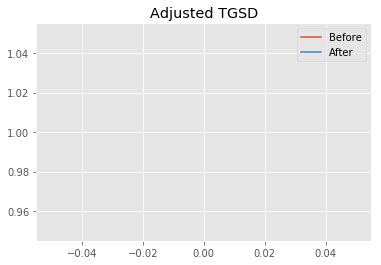

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.25535 	2.67263 	16095.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|16.7067 	12.0508 	16496.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.6253
New Misfit: 19.3015
Convergence:
0.016499892211564615

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.85e+03 	1.82e+03 	0.9811 		1.0000


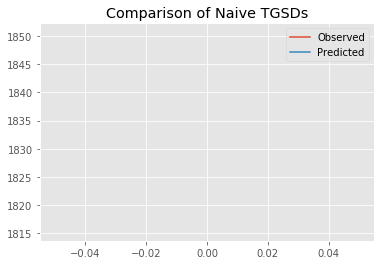

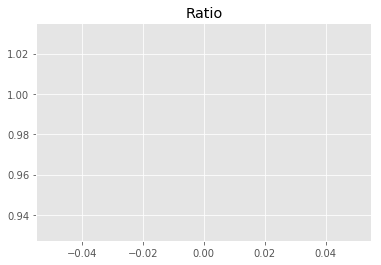

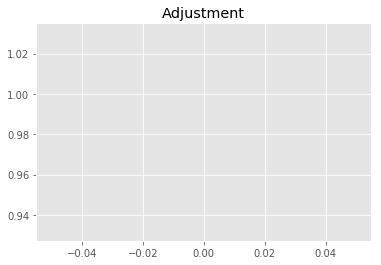

10734444667.881287
1


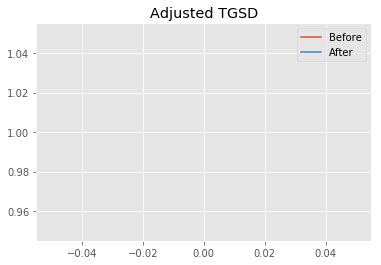

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|16.7067 	12.0508 	16496.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|17.3636 	11.9225 	16495.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.3015
New Misfit: 19.2742
Convergence:
0.001414297997206267

____________________
a = 17.36357	b = 11.92251	            h1 = 16495.77687	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.274202927654972
Prior Misfit: 347.142,	 Post Misfit: 19.2742


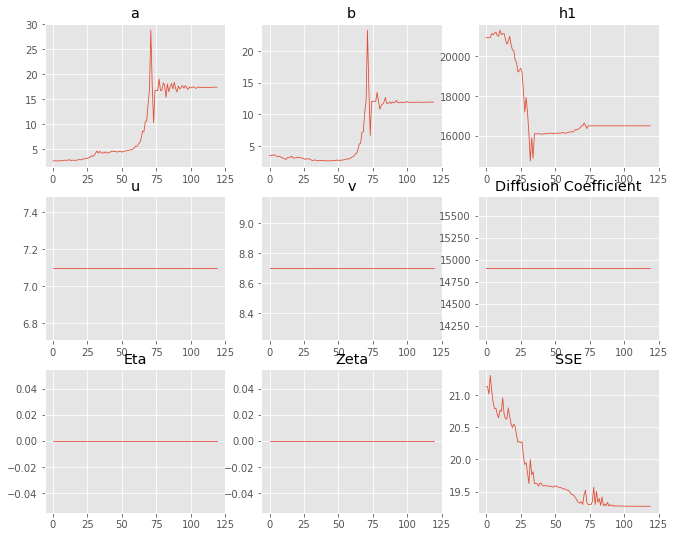

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.66558,17.3636
b,3.50265,11.9225
eta,0,0
ftt,"6,458","6,458"
h1,"20,933.4","16,495.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 20 Time: 0.065 minutes


Estimated remaining run time: -0.064 minutes


Total Run Time: 1.34036 minutes


[{'a': 12.126824774571276,
  'b': 2.285904787238586,
  'h1': 12503.429478509193,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 32.63579527075653,
  'b': 7.692778034803564,
  'h1': 12844.199530640237,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 15.246973778093372,
  'b': 3.8612008094679964,
  'h1': 13091.553630014208,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 17.59689168233658,
  'b': 3.4226489348017513,
  'h1': 12522.519833093871,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 8.703902379330371,
  'b': 2.7710773535039825,
  'h1': 13558.504068609836,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 6.401287

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
10,639.707,436.644,"16,452.6",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2226
1,32.6358,7.69278,"12,844.2",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2338
15,54.0679,30.1413,"15,341.1",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2353
3,17.5969,3.42265,"12,522.5",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2405
12,42.1924,33.256,"17,170.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2427
9,33.062,23.5244,"16,614.7",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2466
2,15.247,3.8612,"13,091.6",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2472
0,12.1268,2.2859,"12,503.4",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2481
14,11.2336,2.51534,"12,842.7",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2524
16,49.5151,196.907,"42,472.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2543


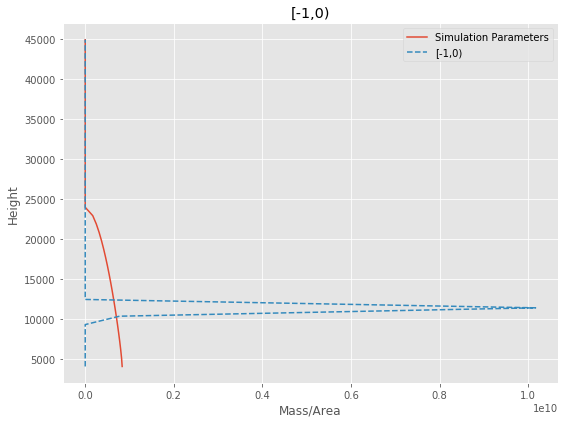

[-1,0) Run Time: 1.34297 minutes


Mass Test: 45798958791.69547
========[0,1)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	7.49e+02 	1.13e+03 	1.5149 		1.0000


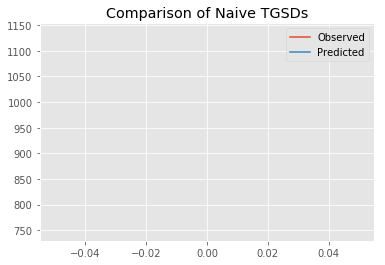

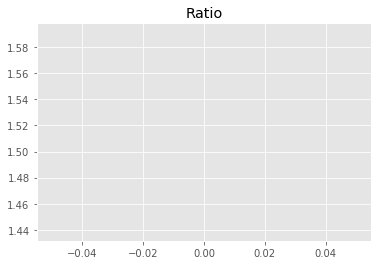

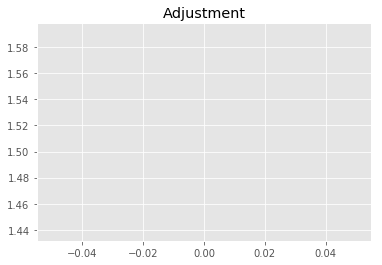

10356042036.919678
1


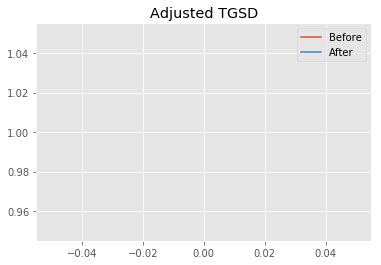

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.56925 	2.81384 	13409.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.78746 	3.04879 	10990.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.5703
New Misfit: 13.7242
Convergence:
0.1717580539366165

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.05e+03 	1.13e+03 	1.0845 		1.0000


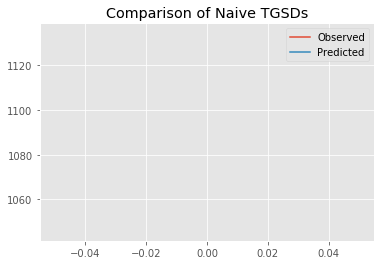

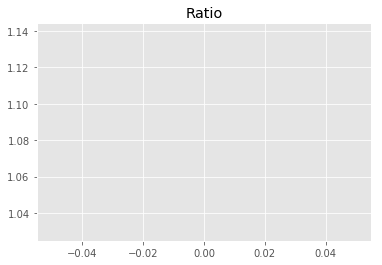

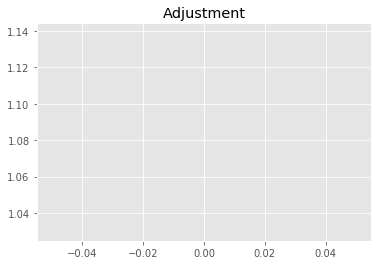

7413464138.579638
1


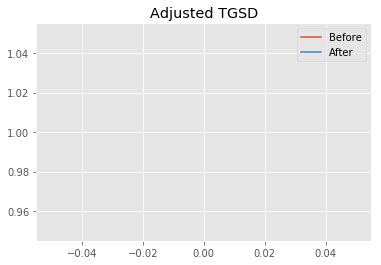

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.78746 	3.04879 	10990.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.76162 	2.4342 	9452.61 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.7242
New Misfit: 12.9686
Convergence:
0.05505463189213335

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0882 		1.0000


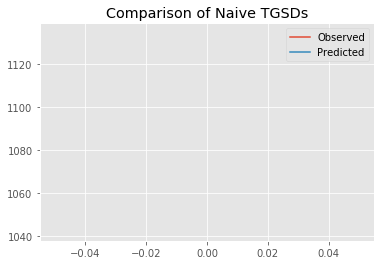

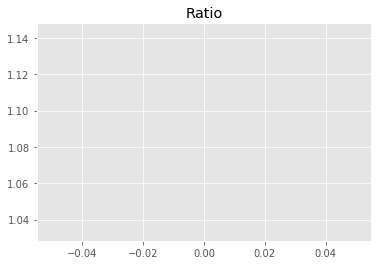

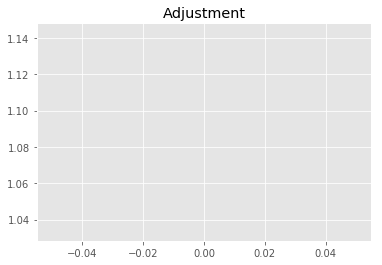

7439066815.142278
1


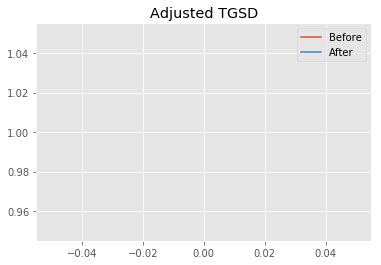

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.76162 	2.4342 	9452.61 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|8.63112 	2.41367 	9361.13 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.9686
New Misfit: 12.9271
Convergence:
0.0031975839102902992

____________________
a = 8.63112	b = 2.41367	            h1 = 9361.12571	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 12.927140974149069
Prior Misfit: 447.179,	 Post Misfit: 12.9271


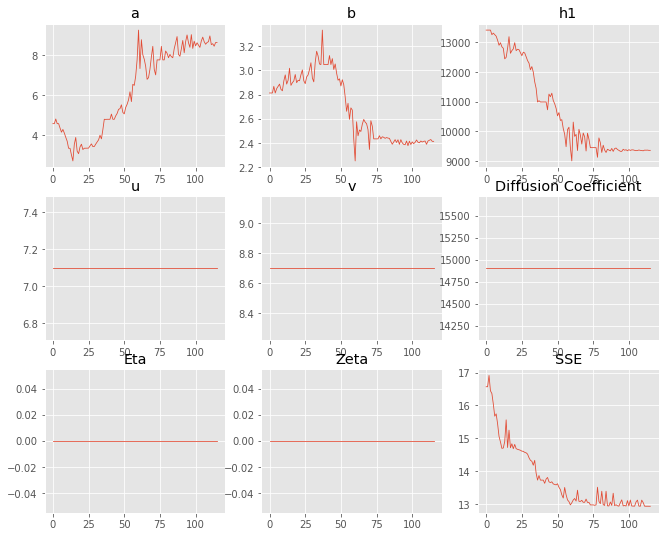

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.56925,8.63112
b,2.81384,2.41367
eta,0,0
ftt,"6,458","6,458"
h1,"13,409.4","9,361.13"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 1 Time: 0.064 minutes


Estimated remaining run time: 0.574 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	8.60e+02 	1.13e+03 	1.3196 		1.0000


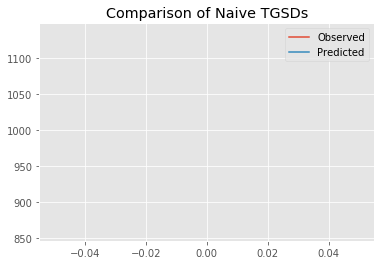

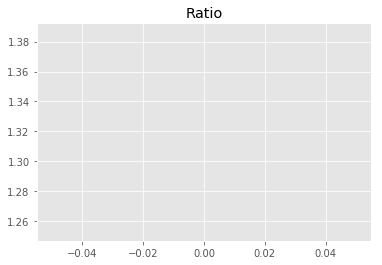

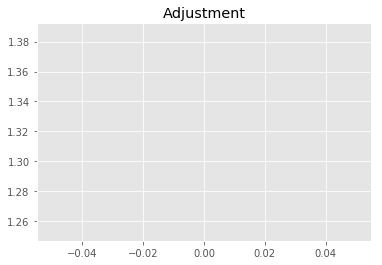

9020728245.59755
1


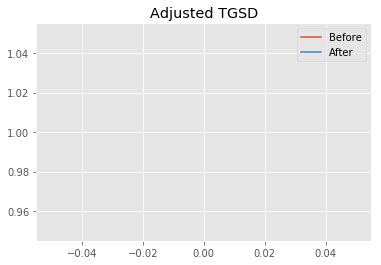

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.30202 	3.98899 	15887.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.12023 	10.8576 	16004.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.7033
New Misfit: 13.8125
Convergence:
0.1204126473278021

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.89e+02 	1.13e+03 	1.1474 		1.0000


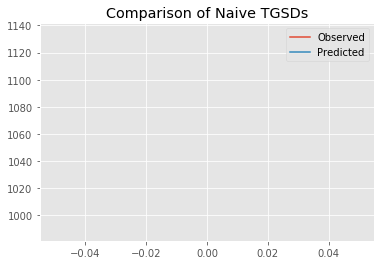

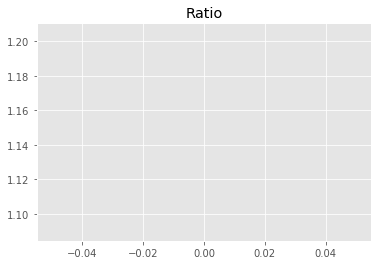

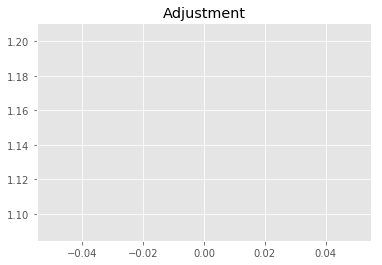

7843613628.004205
1


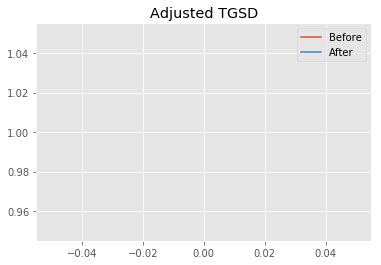

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.12023 	10.8576 	16004.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|8.75977 	13.0684 	15826.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.8125
New Misfit: 13.5911
Convergence:
0.0160272179780528

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.89e+02 	1.13e+03 	1.1473 		1.0000


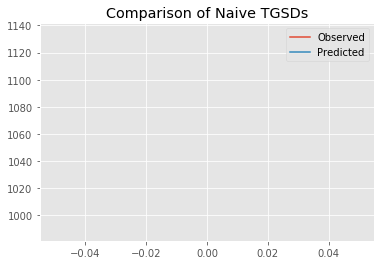

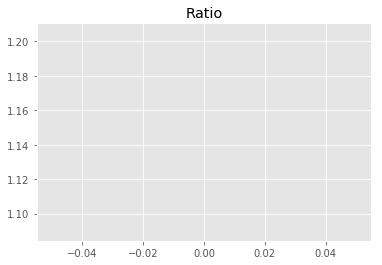

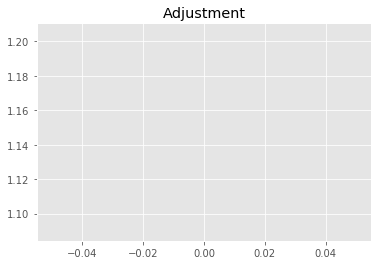

7843448304.608703
1


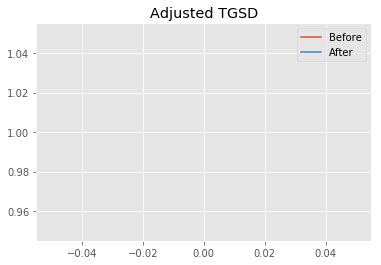

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.75977 	13.0684 	15826.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|31.3352 	57.1252 	16496.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.5911
New Misfit: 12.7846
Convergence:
0.05933764122296393

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0616 		1.0000


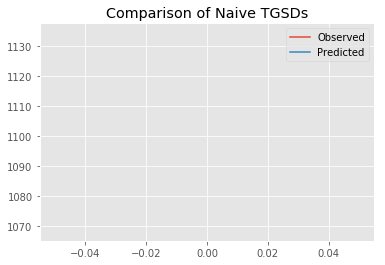

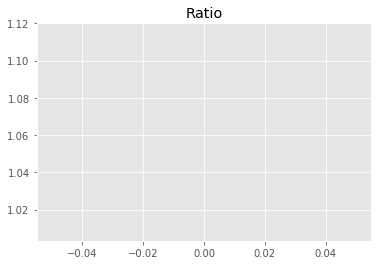

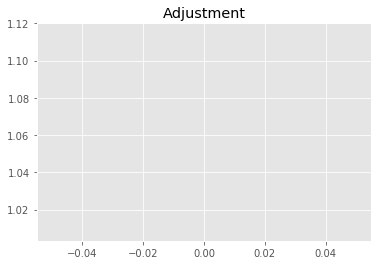

7257189742.647784
1


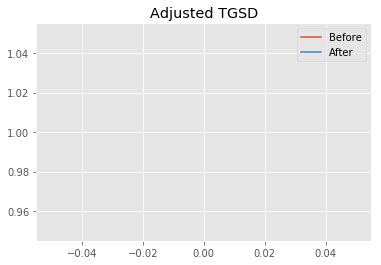

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|31.3352 	57.1252 	16496.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|76.1754 	135.41 	16532.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.7846
New Misfit: 12.6237
Convergence:
0.012583965979815448

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0865 		1.0000


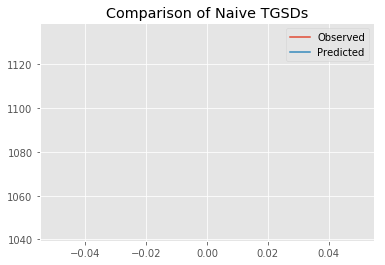

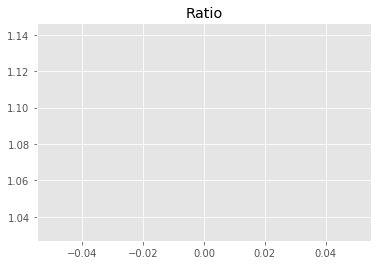

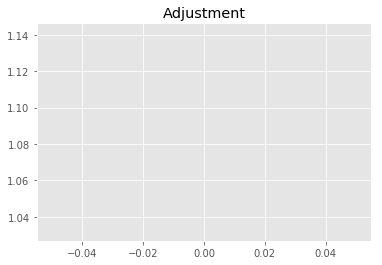

7427788236.301239
1


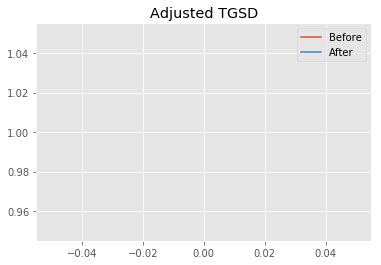

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|76.1754 	135.41 	16532.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1766.12 	3224.84 	16521.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.6237
New Misfit: 12.4556
Convergence:
0.013320784970483779

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0553 		1.0000


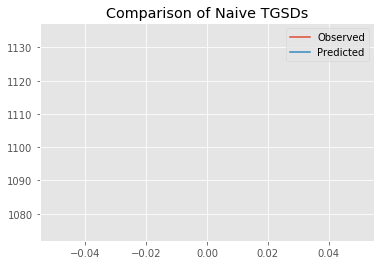

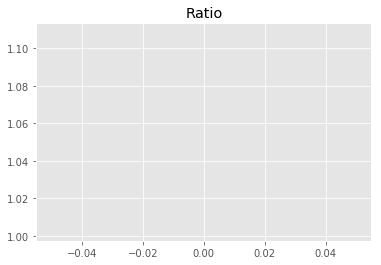

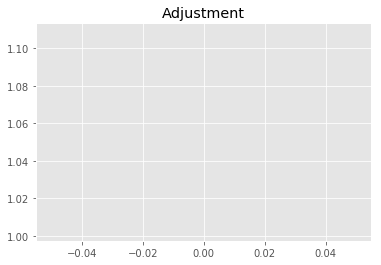

7214220300.279836
1


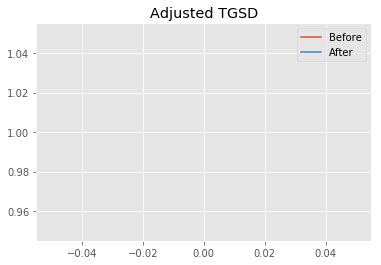

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1766.12 	3224.84 	16521.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3041.85 	5629.87 	16521.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.4556
New Misfit: 12.4556
Convergence:
4.412426344986506e-09

____________________
a = 3041.85042	b = 5629.86725	            h1 = 16521.41661	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 12.455582405334608
Prior Misfit: 369.765,	 Post Misfit: 12.4556


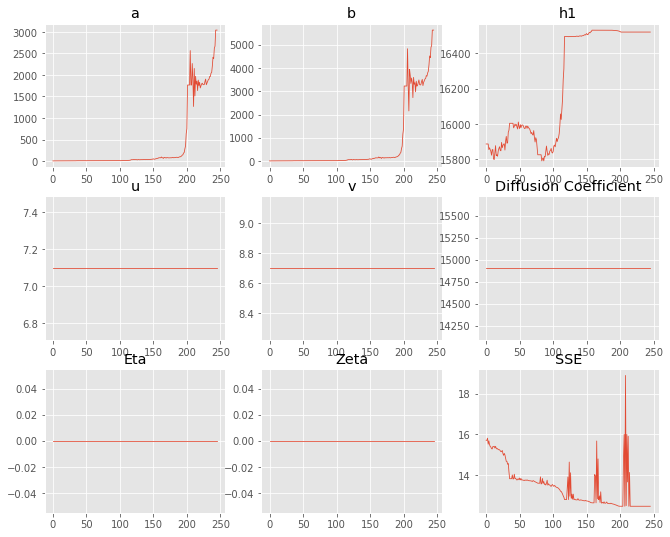

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.30202,"3,041.85"
b,3.98899,"5,629.87"
eta,0,0
ftt,"6,458","6,458"
h1,"15,887.4","16,521.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 2 Time: 0.142 minutes


Estimated remaining run time: 1.166 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	7.73e+02 	1.13e+03 	1.4677 		1.0000


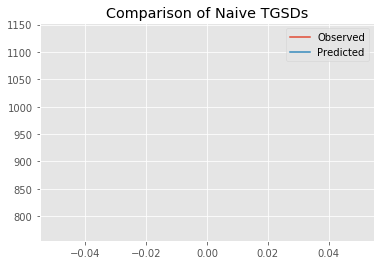

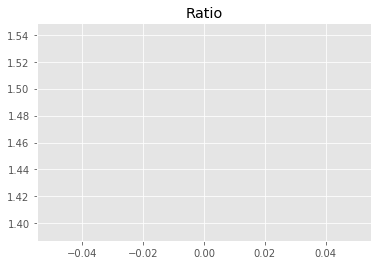

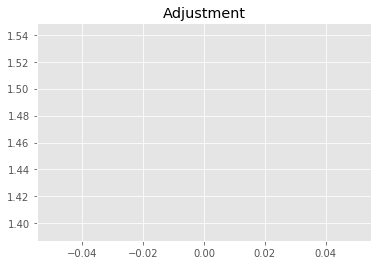

10033711544.846565
1


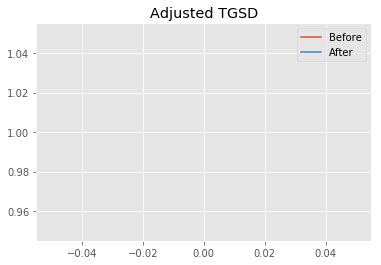

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.55785 	2.07048 	12962.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.25942 	1.99122 	9778.27 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.357
New Misfit: 13.8495
Convergence:
0.15329714682274143

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.12e+03 	1.13e+03 	1.0151 		1.0000


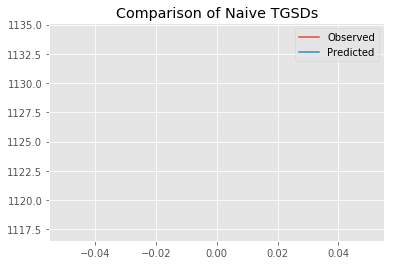

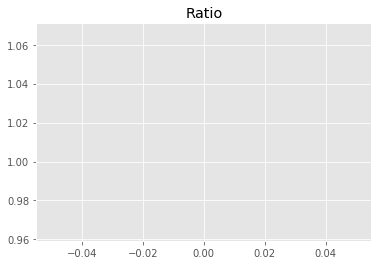

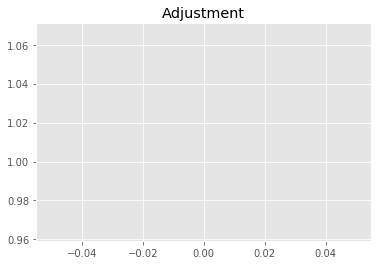

6939534960.841885
1


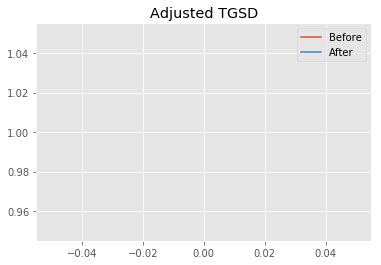

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.25942 	1.99122 	9778.27 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|6.7018 	1.98791 	9401.68 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.8495
New Misfit: 13.0287
Convergence:
0.05927043376100125

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0947 		1.0000


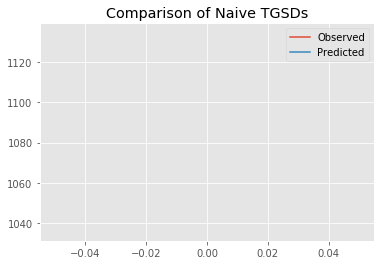

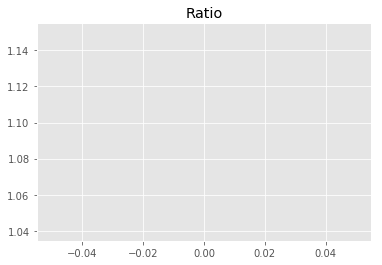

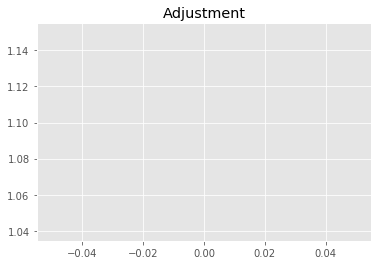

7483654933.064
1


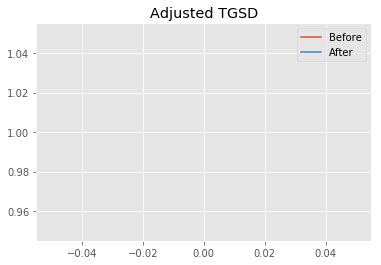

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.7018 	1.98791 	9401.68 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.29238 	1.98837 	9359.68 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.0287
New Misfit: 12.9976
Convergence:
0.0023872105997031624

____________________
a = 7.29238	b = 1.98837	            h1 = 9359.67688	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 12.997563546032882
Prior Misfit: 425.786,	 Post Misfit: 12.9976


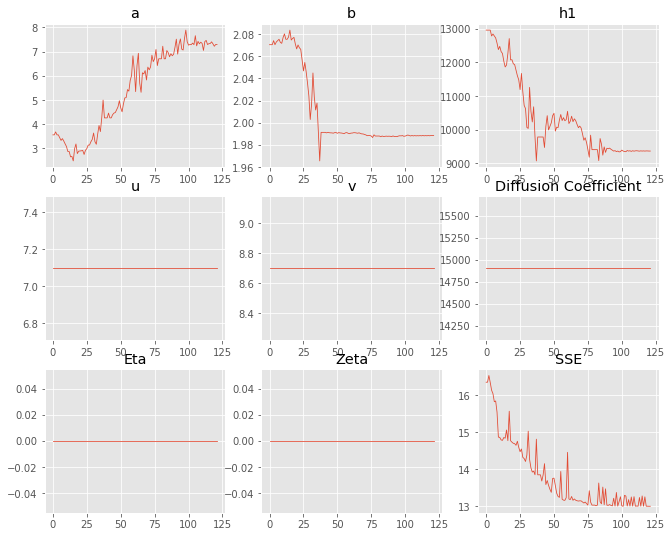

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.55785,7.29238
b,2.07048,1.98837
eta,0,0
ftt,"6,458","6,458"
h1,"12,962.5","9,359.68"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 3 Time: 0.070 minutes


Estimated remaining run time: 1.102 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.66e+02 	1.13e+03 	1.1745 		1.0000


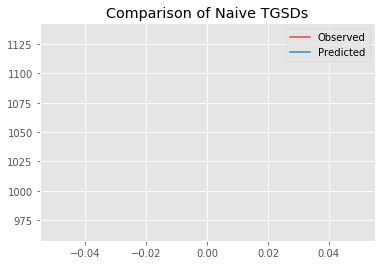

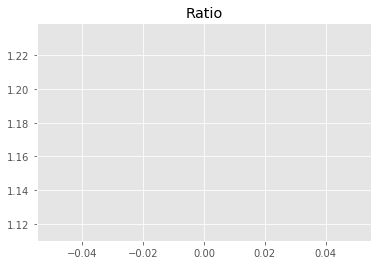

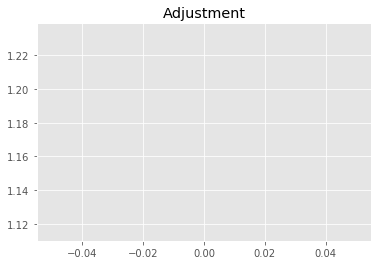

8028962083.90942
1


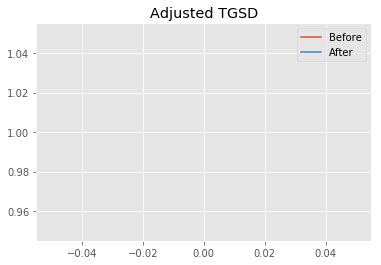

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.64982 	4.46472 	21485.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.8295 	15.2413 	25368.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 17.191
New Misfit: 14.8472
Convergence:
0.1363384428464721

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.48e+02 	1.13e+03 	1.1960 		1.0000


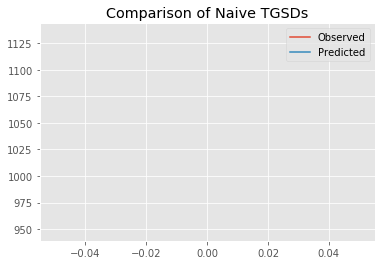

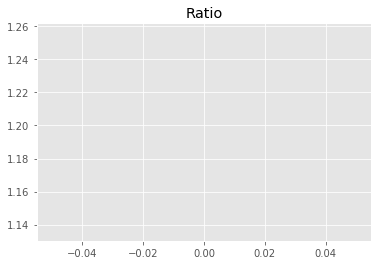

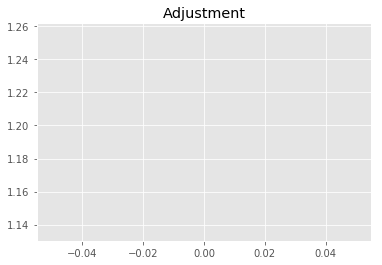

8175978364.079841
1


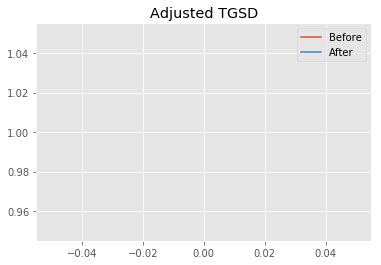

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.8295 	15.2413 	25368.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|28.8609 	63.7156 	17664.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.8472
New Misfit: 12.9851
Convergence:
0.12541569447131637

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.12e+03 	1.13e+03 	1.0122 		1.0000


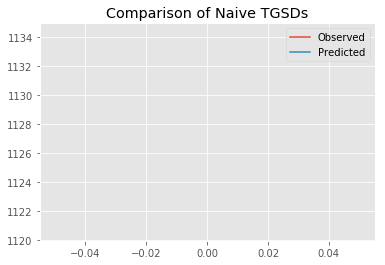

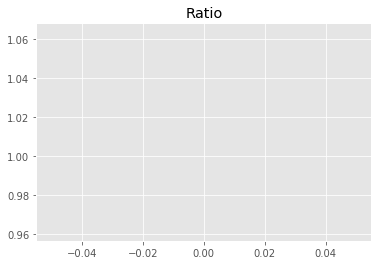

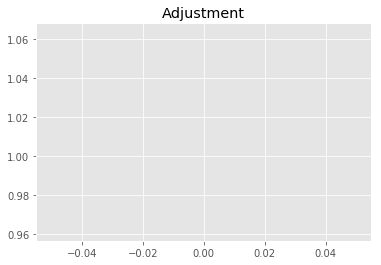

6919372253.45303
1


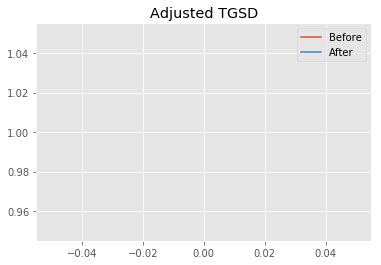

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|28.8609 	63.7156 	17664.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|31.7361 	64.4182 	17677.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.9851
New Misfit: 12.7921
Convergence:
0.014862835817029147

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.05e+03 	1.13e+03 	1.0780 		1.0000


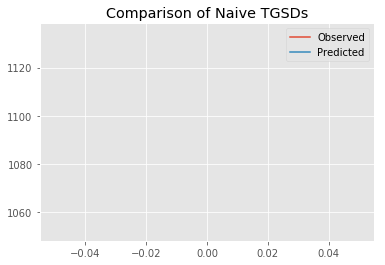

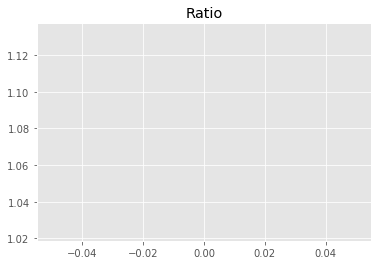

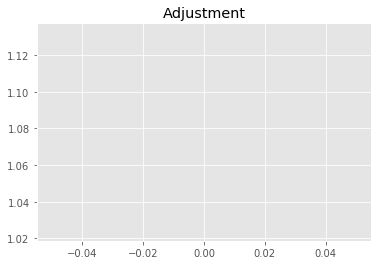

7369554662.776777
1


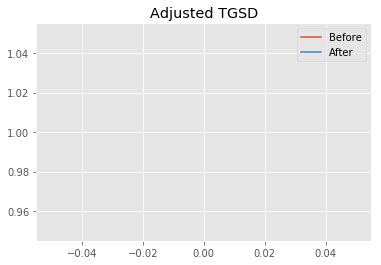

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|31.7361 	64.4182 	17677.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|161.181 	285.489 	15985.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.7921
New Misfit: 12.5158
Convergence:
0.021602056138028215

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.08e+03 	1.13e+03 	1.0478 		1.0000


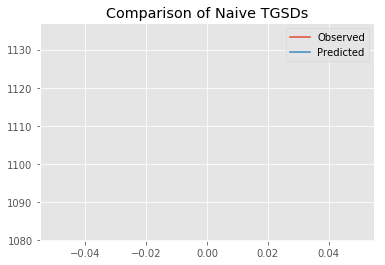

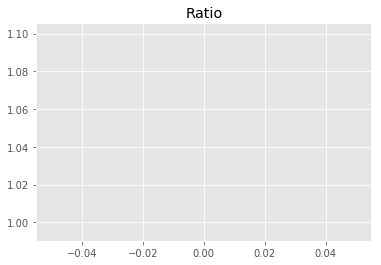

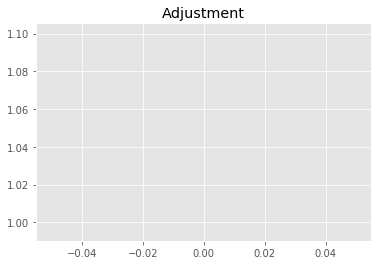

7163013311.986023
1


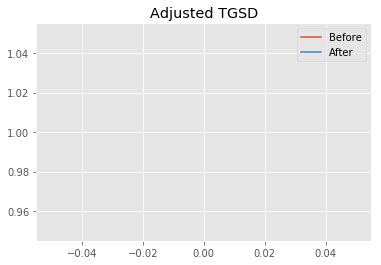

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|161.181 	285.489 	15985.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|219.269 	375.418 	15982.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.5158
New Misfit: 12.4802
Convergence:
0.0028430180217063304

____________________
a = 219.26862	b = 375.41754	            h1 = 15982.62092	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 12.480206068532917
Prior Misfit: 441.565,	 Post Misfit: 12.4802


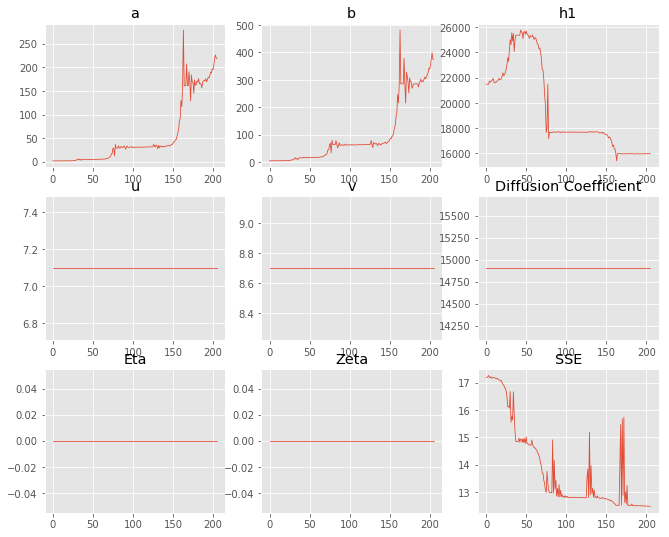

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.64982,219.269
b,4.46472,375.418
eta,0,0
ftt,"6,458","6,458"
h1,"21,485.3","15,982.6"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 4 Time: 0.107 minutes


Estimated remaining run time: 1.148 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.03e+03 	1.13e+03 	1.1042 		1.0000


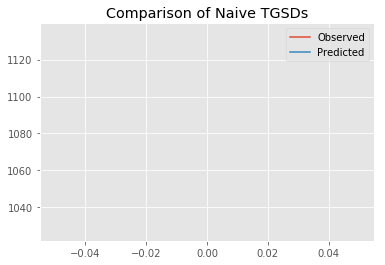

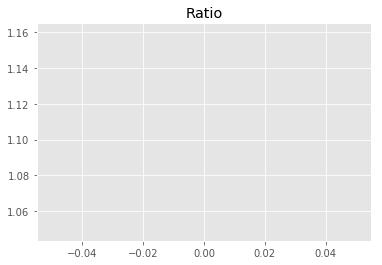

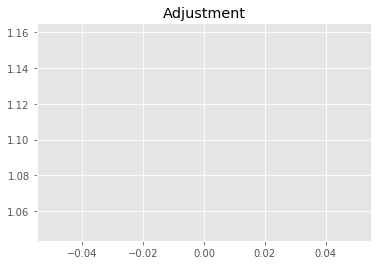

7548456805.076646
1


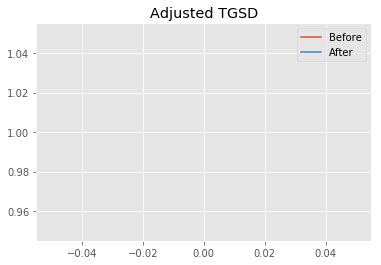

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.47752 	2.02142 	10844 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|5.55294 	2.01567 	10243.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.0705
New Misfit: 13.1691
Convergence:
0.06406439510461459

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1092 		1.0000


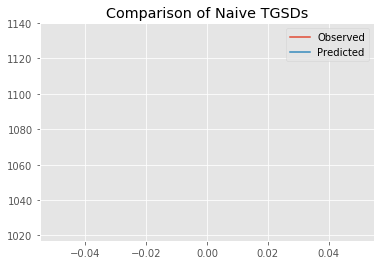

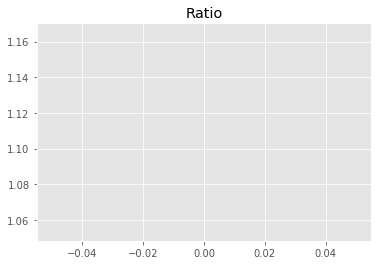

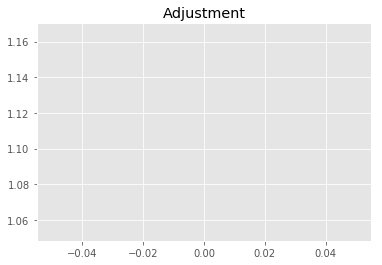

7582856766.718843
1


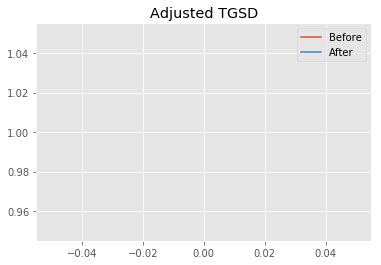

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.55294 	2.01567 	10243.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.07079 	2.01128 	9363.34 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.1691
New Misfit: 13.0002
Convergence:
0.01282835272507984

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.03e+03 	1.13e+03 	1.0999 		1.0000


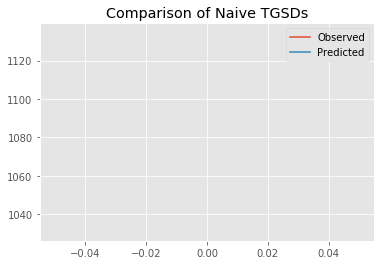

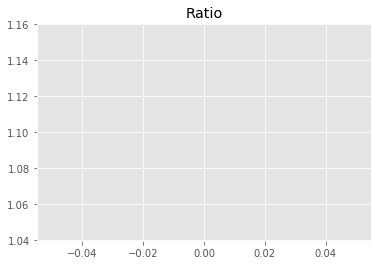

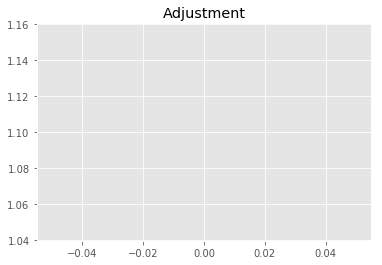

7519410965.52408
1


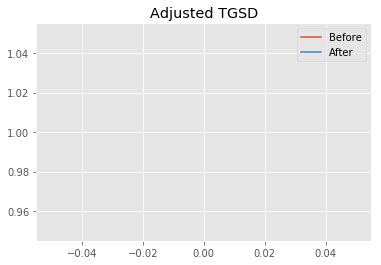

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.07079 	2.01128 	9363.34 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.36032 	2.01143 	9360.11 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.0002
New Misfit: 12.9933
Convergence:
0.0005289782958126173

____________________
a = 7.36032	b = 2.01143	            h1 = 9360.11211	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 12.993303670197092
Prior Misfit: 260.178,	 Post Misfit: 12.9933


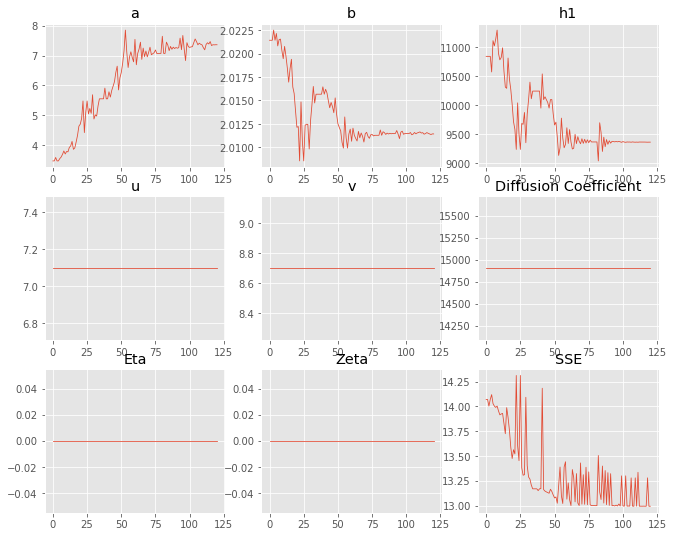

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.47752,7.36032
b,2.02142,2.01143
eta,0,0
ftt,"6,458","6,458"
h1,"10,844","9,360.11"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 5 Time: 0.071 minutes


Estimated remaining run time: 1.058 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	7.94e+02 	1.13e+03 	1.4286 		1.0000


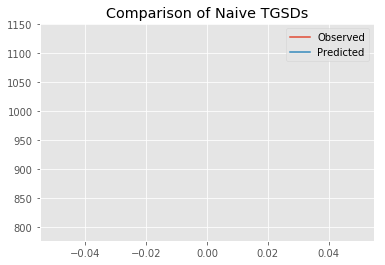

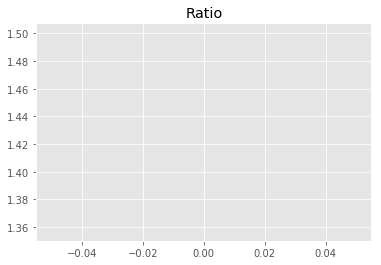

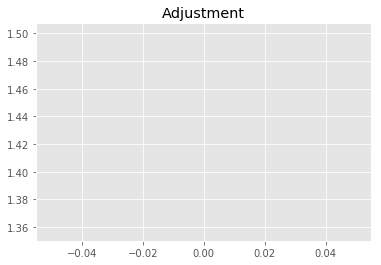

9766392494.612692
1


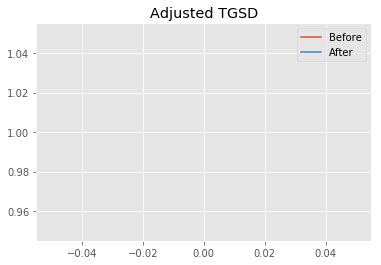

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.38253 	3.52 	14111.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.46235 	3.40403 	12143.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.9841
New Misfit: 14.0719
Convergence:
0.11963433614764499

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.78e+02 	1.13e+03 	1.1599 		1.0000


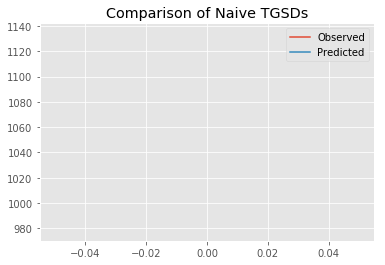

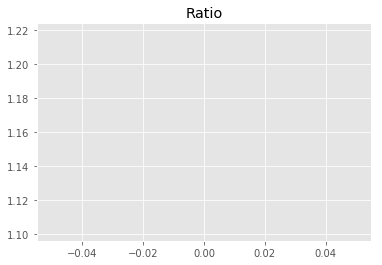

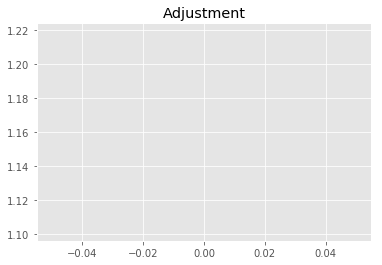

7929347730.785023
1


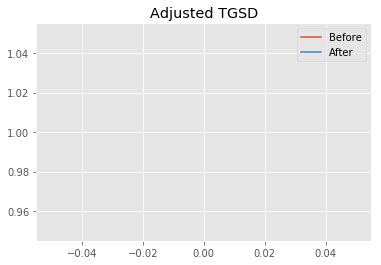

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.46235 	3.40403 	12143.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|8.62993 	2.93808 	9470.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.0719
New Misfit: 12.9415
Convergence:
0.08032849450168657

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.06e+03 	1.13e+03 	1.0679 		1.0000


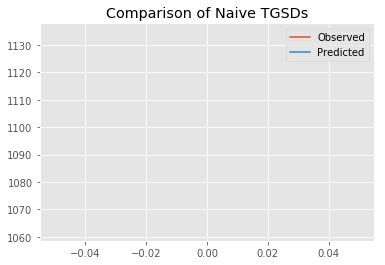

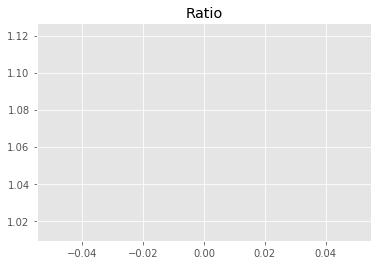

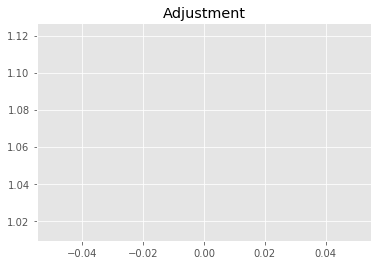

7300103494.835881
1


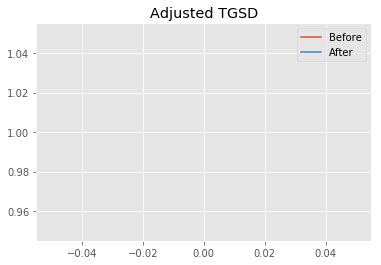

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.62993 	2.93808 	9470.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|9.75303 	2.87504 	9372.27 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.9415
New Misfit: 12.8728
Convergence:
0.005309318152135736

____________________
a = 9.75303	b = 2.87504	            h1 = 9372.26684	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 12.87277097323403
Prior Misfit: 396.839,	 Post Misfit: 12.8728


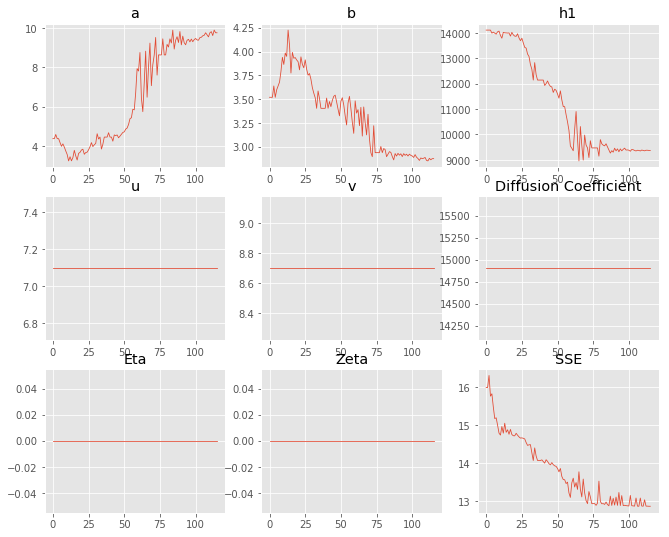

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.38253,9.75303
b,3.52,2.87504
eta,0,0
ftt,"6,458","6,458"
h1,"14,111.5","9,372.27"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 6 Time: 0.067 minutes


Estimated remaining run time: 0.967 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	8.40e+02 	1.13e+03 	1.3505 		1.0000


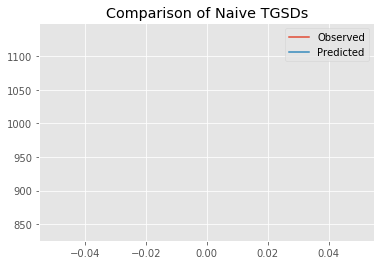

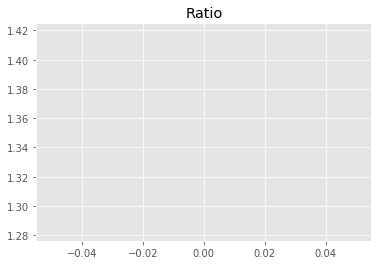

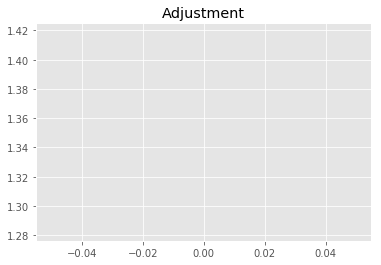

9232439603.30277
1


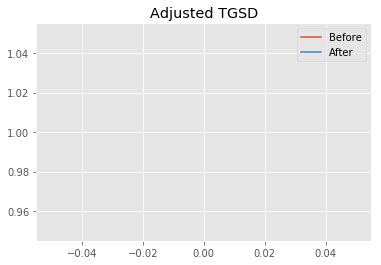

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.5747 	4.79871 	15136.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|55.9074 	51.8986 	11884.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.4172
New Misfit: 12.7052
Convergence:
0.175907223085993

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.11e+03 	1.13e+03 	1.0200 		1.0000


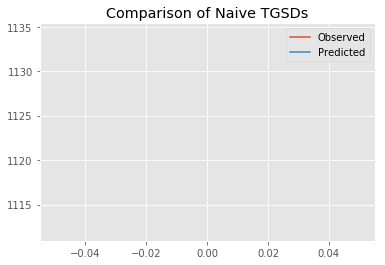

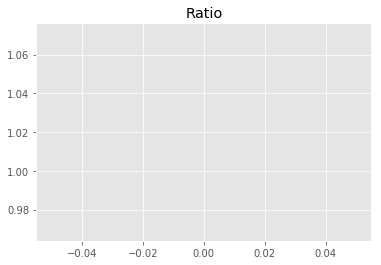

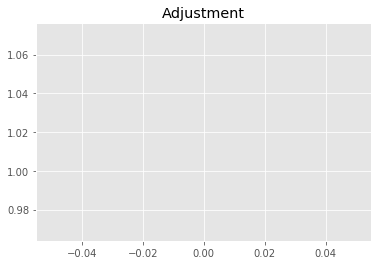

6972783519.048737
1


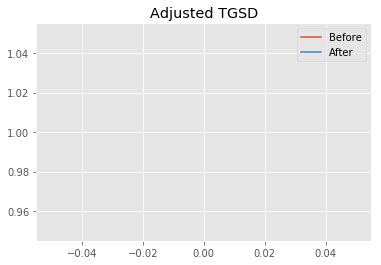

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|55.9074 	51.8986 	11884.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|60.7997 	50.7409 	11813.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.7052
New Misfit: 12.5845
Convergence:
0.009499486753199738

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0649 		1.0000


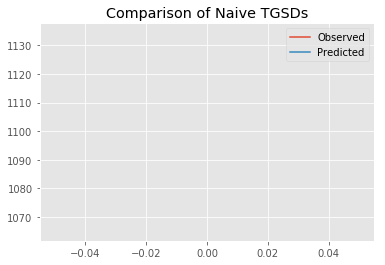

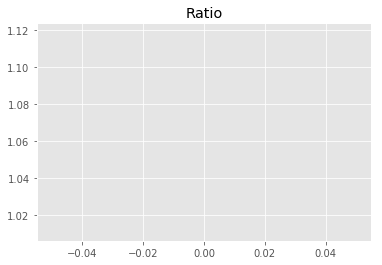

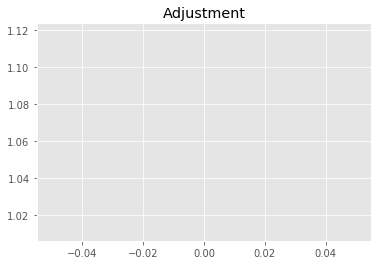

7279580407.852189
1


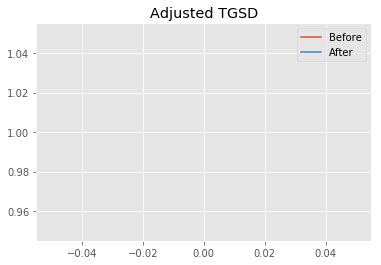

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|60.7997 	50.7409 	11813.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|221.232 	99.9219 	9787.45 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.5845
New Misfit: 12.4623
Convergence:
0.009713463632859423

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.08e+03 	1.13e+03 	1.0533 		1.0000


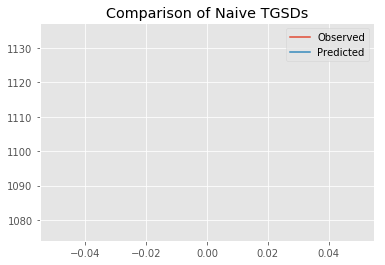

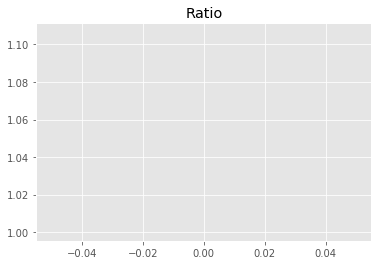

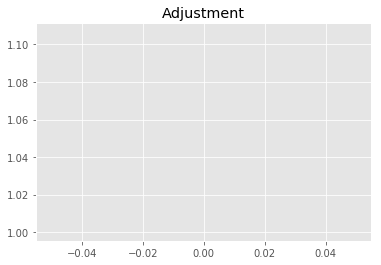

7200575359.99678
1


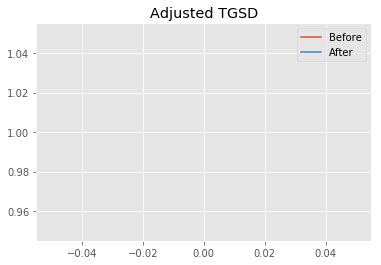

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|221.232 	99.9219 	9787.45 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|279.812 	84.2446 	9254.17 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.4623
New Misfit: 12.4556
Convergence:
0.0005345455988495687

____________________
a = 279.81201	b = 84.24458	            h1 = 9254.16576	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 12.455640075013347
Prior Misfit: 354.106,	 Post Misfit: 12.4556


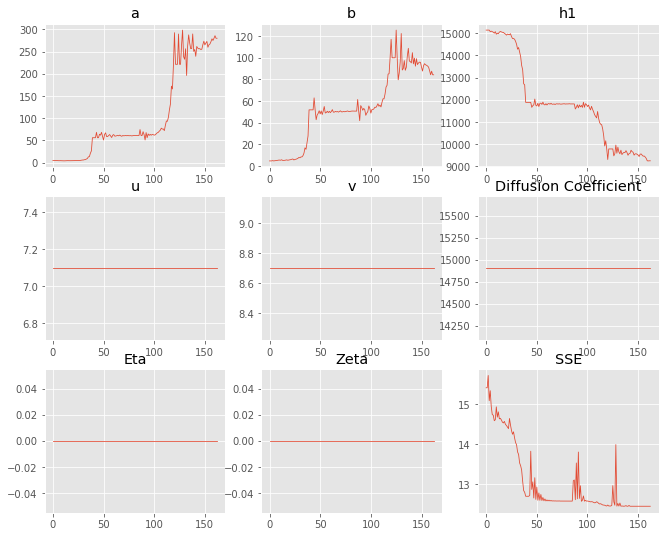

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.5747,279.812
b,4.79871,84.2446
eta,0,0
ftt,"6,458","6,458"
h1,"15,136.1","9,254.17"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 7 Time: 0.091 minutes


Estimated remaining run time: 0.917 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	8.44e+02 	1.13e+03 	1.3434 		1.0000


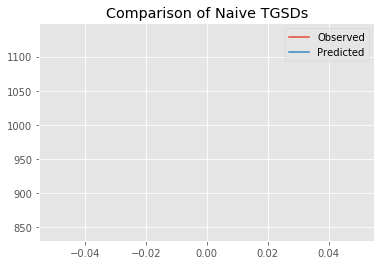

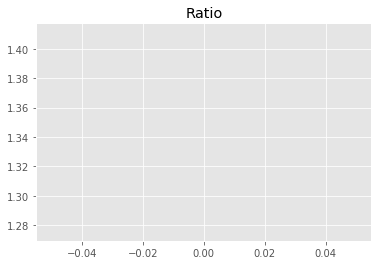

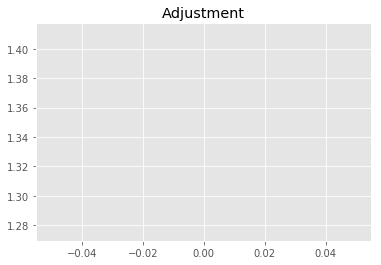

9183422485.806267
1


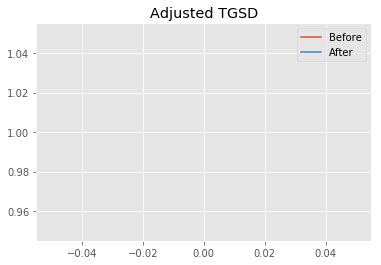

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.55214 	4.38369 	19248.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.29281 	5.76619 	17421 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.518
New Misfit: 15.2584
Convergence:
0.07625386496823398

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.63e+02 	1.13e+03 	1.1774 		1.0000


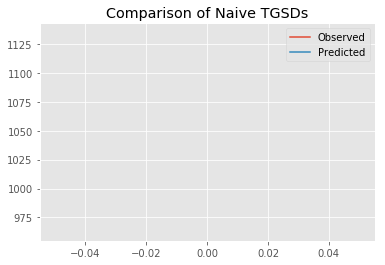

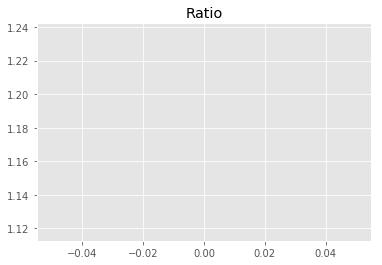

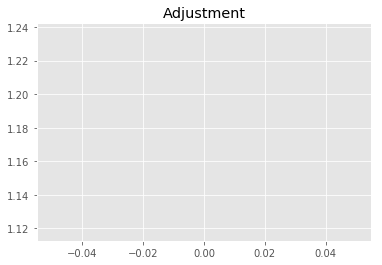

8048925716.849348
1


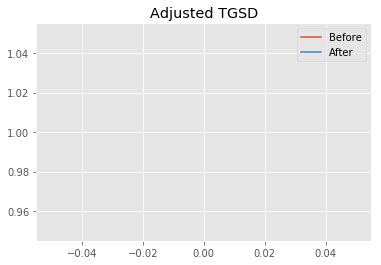

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.29281 	5.76619 	17421 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1100.95 	373.713 	9436.61 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.2584
New Misfit: 12.4556
Convergence:
0.18369145808905848

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0553 		1.0000


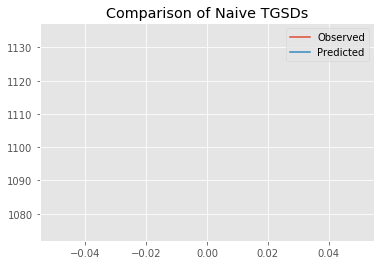

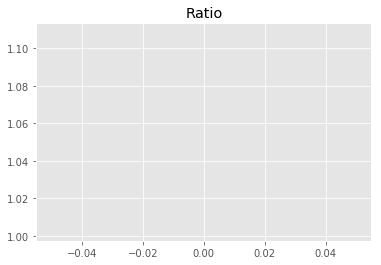

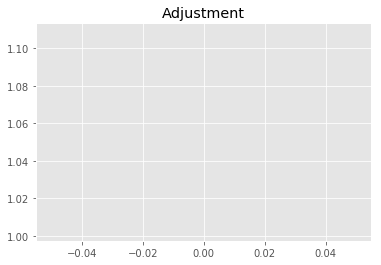

7214220068.813329
1


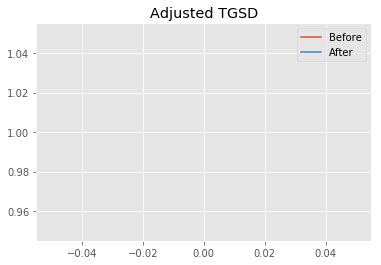

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1100.95 	373.713 	9436.61 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1237.13 	287.478 	9183.19 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.4556
New Misfit: 12.4556
Convergence:
1.2692763257614497e-14

____________________
a = 1237.12992	b = 287.47824	            h1 = 9183.18656	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 12.455582405334575
Prior Misfit: 427.62,	 Post Misfit: 12.4556


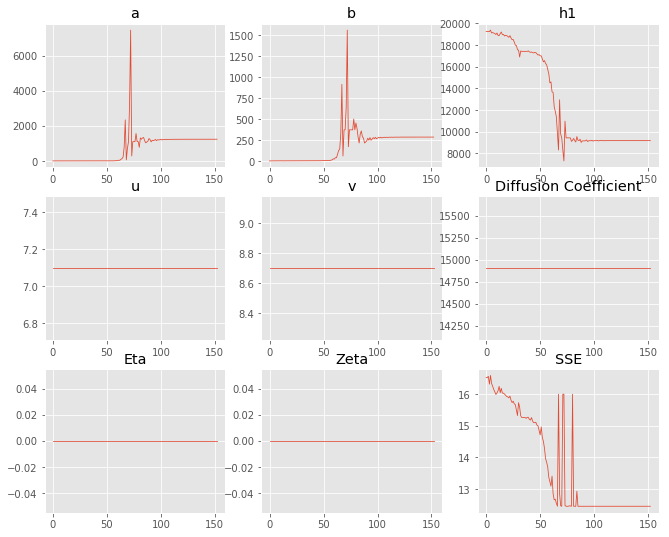

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.55214,"1,237.13"
b,4.38369,287.478
eta,0,0
ftt,"6,458","6,458"
h1,"19,248.4","9,183.19"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 8 Time: 0.077 minutes


Estimated remaining run time: 0.842 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.05e+03 	1.13e+03 	1.0786 		1.0000


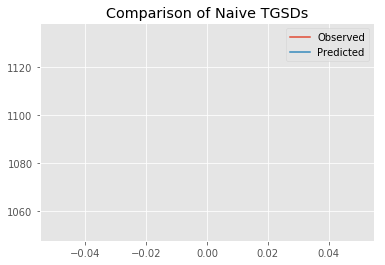

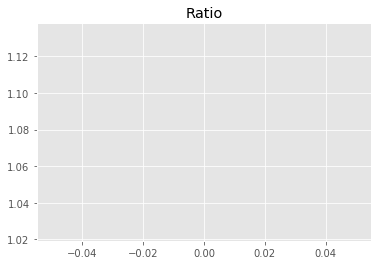

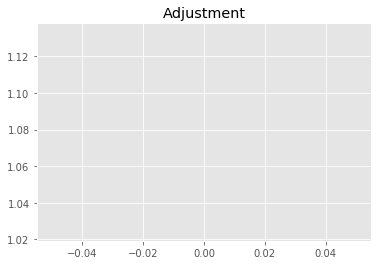

7373459267.8006
1


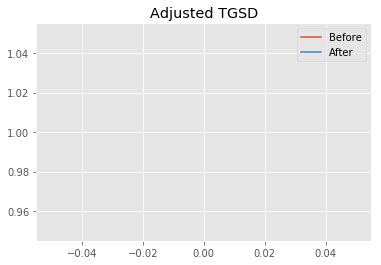

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.7112 	2.57188 	12220.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.42383 	1.53334 	9479.45 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.0976
New Misfit: 13.3871
Convergence:
0.11329409760070014

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0623 		1.0000


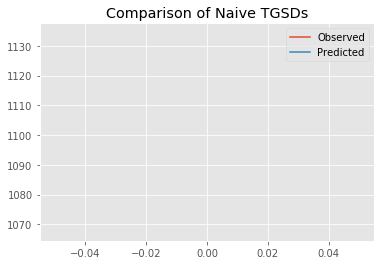

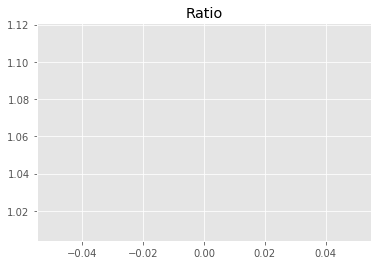

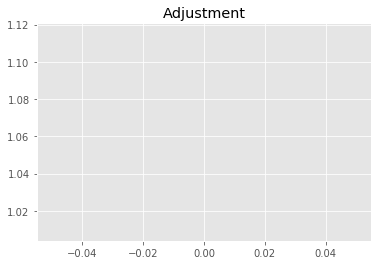

7261821000.452008
1


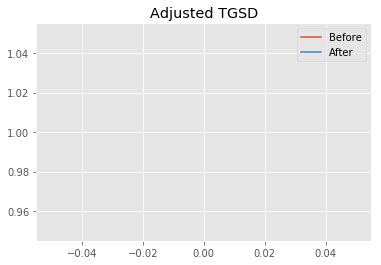

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.42383 	1.53334 	9479.45 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|6.14103 	1.5169 	9377.87 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.3871
New Misfit: 13.1209
Convergence:
0.019890489104160657

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.97e+02 	1.13e+03 	1.1374 		1.0000


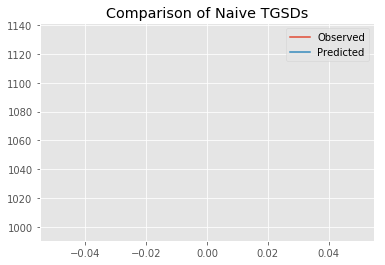

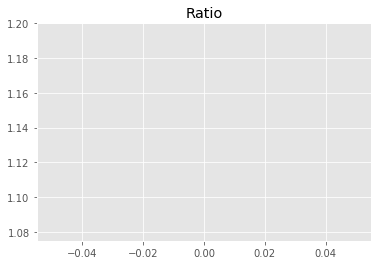

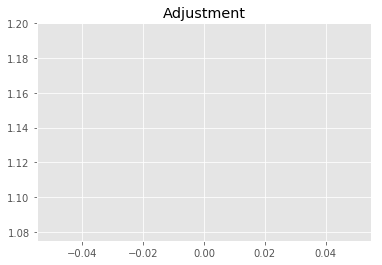

7775636070.92876
1


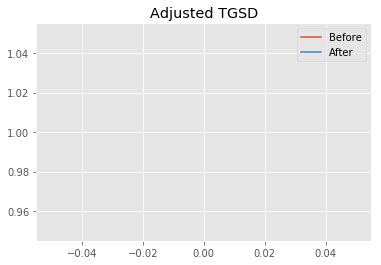

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.14103 	1.5169 	9377.87 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|5.97439 	1.54454 	9360.92 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.1209
New Misfit: 13.1007
Convergence:
0.0015390016141041982

____________________
a = 5.97439	b = 1.54454	            h1 = 9360.91883	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 13.100659772578934
Prior Misfit: 303.536,	 Post Misfit: 13.1007


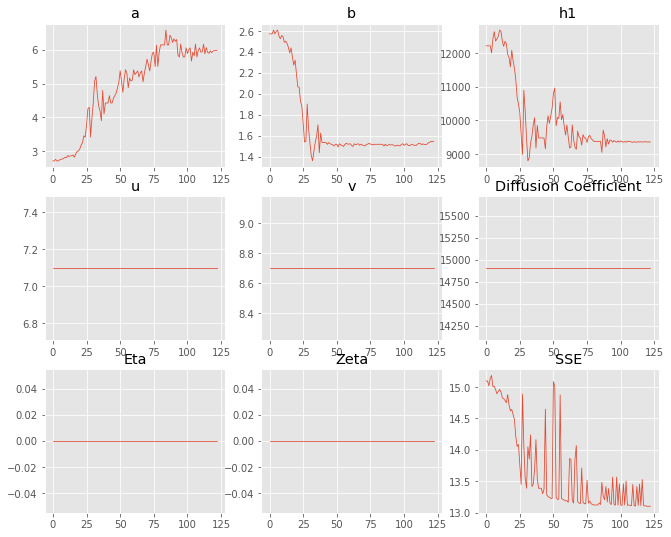

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.7112,5.97439
b,2.57188,1.54454
eta,0,0
ftt,"6,458","6,458"
h1,"12,220.6","9,360.92"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 9 Time: 0.069 minutes


Estimated remaining run time: 0.758 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	6.37e+02 	1.13e+03 	1.7801 		1.0000


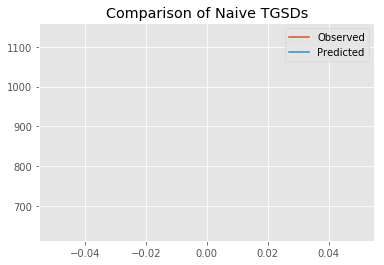

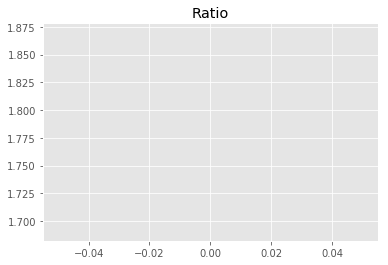

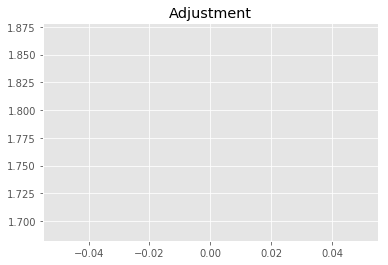

12169299162.372364
1


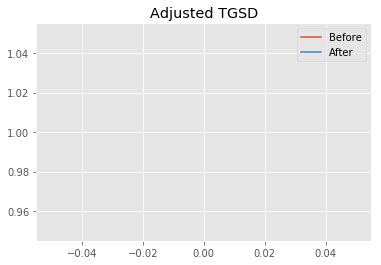

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.46822 	1.95703 	16290 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.48343 	1.95253 	15670.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 19.2792
New Misfit: 17.0001
Convergence:
0.11821486174455746

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	8.83e+02 	1.13e+03 	1.2846 		1.0000


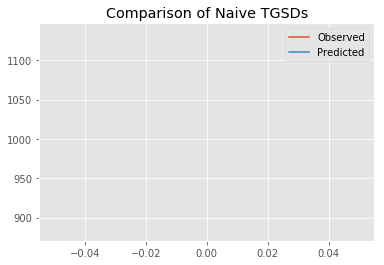

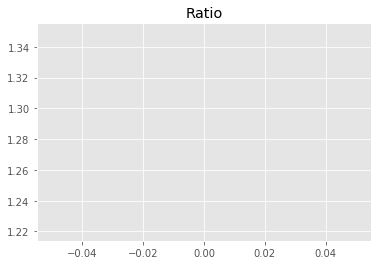

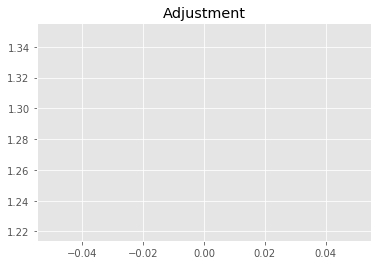

8781590862.408327
1


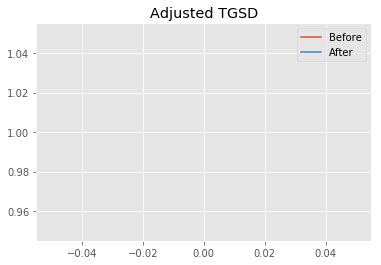

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.48343 	1.95253 	15670.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.88053 	2.04249 	12274.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 17.0001
New Misfit: 15.3696
Convergence:
0.09591169350084569

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	8.29e+02 	1.13e+03 	1.3683 		1.0000


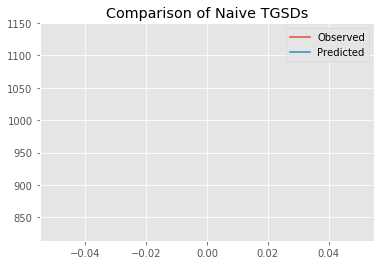

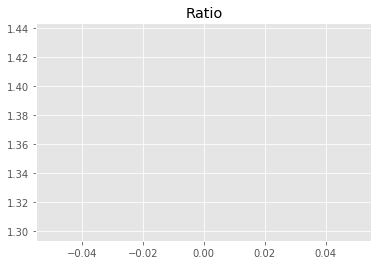

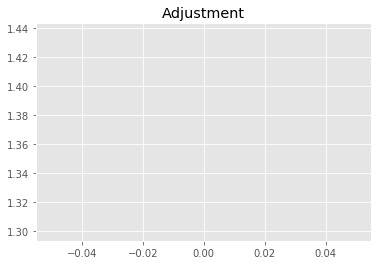

9353779412.42093
1


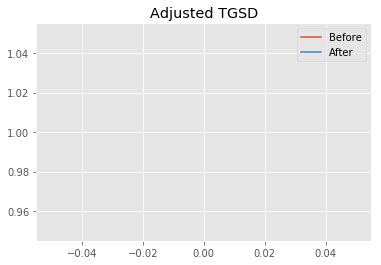

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.88053 	2.04249 	12274.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.11178 	2.03973 	10568.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.3696
New Misfit: 13.7873
Convergence:
0.10295439835307527

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.00e+03 	1.13e+03 	1.1321 		1.0000


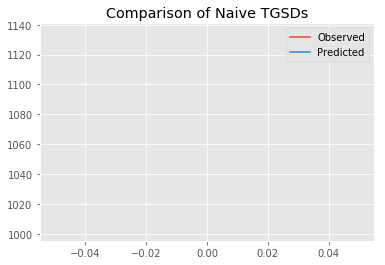

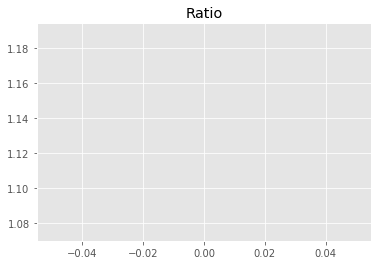

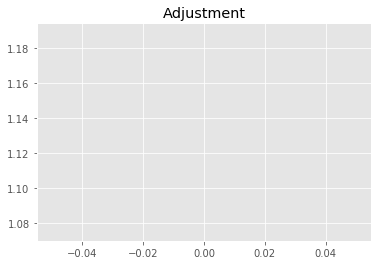

7739263672.984801
1


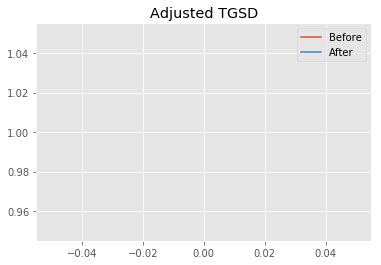

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.11178 	2.03973 	10568.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|255.775 	2.02976 	8626.07 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.7873
New Misfit: 12.4556
Convergence:
0.09658689599491158

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0553 		1.0000


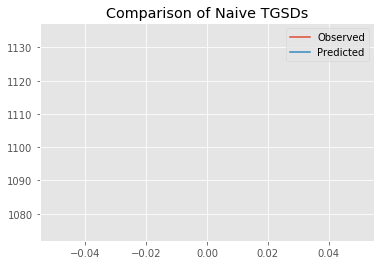

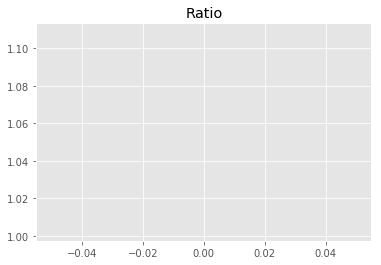

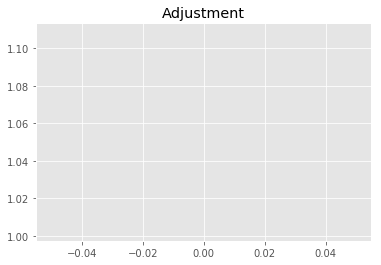

7214220068.81338
1


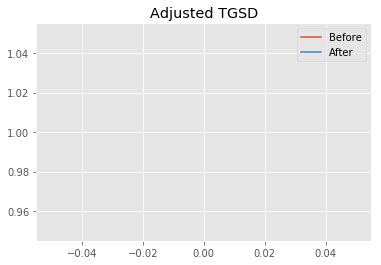

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|255.775 	2.02976 	8626.07 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Optimization terminated successfully.
         Current function value: 12.455582
         Iterations: 14
         Function evaluations: 66
New Total Mass: 6.83614e+09
After: 		|255.775 	2.02976 	8626.07 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.4556
New Misfit: 12.4556
Convergence:
4.2784595250386505e-16

____________________
a = 255.77452	b = 2.02976	            h1 = 8626.07415	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 12.455582405334575
Prior Misfit: 718.014,	 Post Misfit: 12.4556


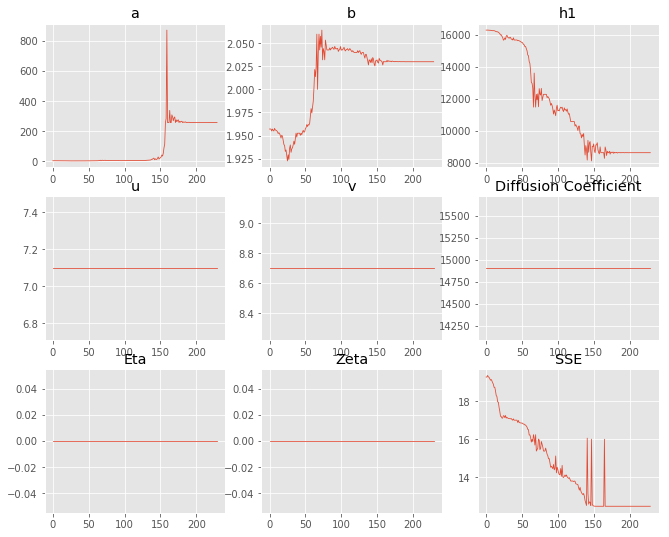

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.46822,255.775
b,1.95703,2.02976
eta,0,0
ftt,"6,458","6,458"
h1,"16,290","8,626.07"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 10 Time: 0.123 minutes


Estimated remaining run time: 0.721 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.90e+02 	1.13e+03 	1.1453 		1.0000


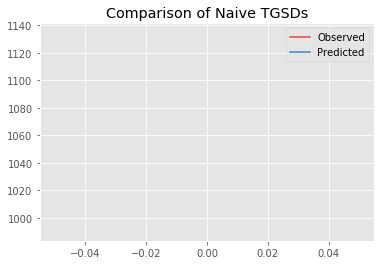

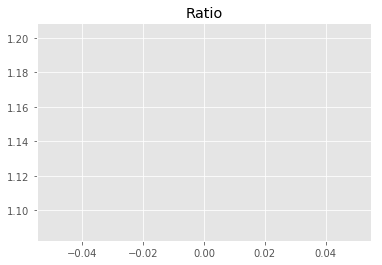

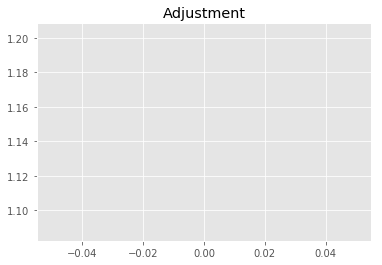

7829503947.396876
1


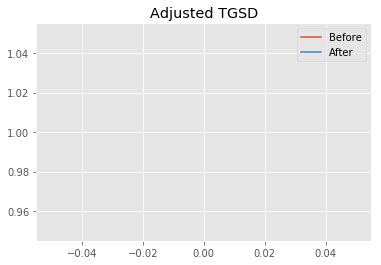

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.98022 	3.03518 	12010.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|30.8929 	1.96759 	8742.76 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.1886
New Misfit: 12.458
Convergence:
0.1219720239099643

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.08e+03 	1.13e+03 	1.0546 		1.0000


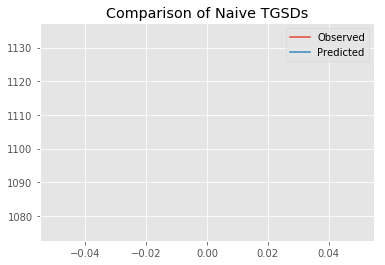

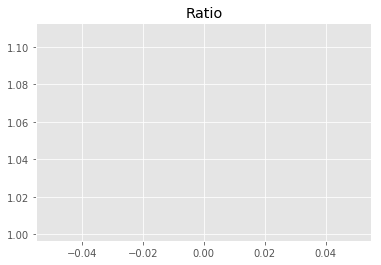

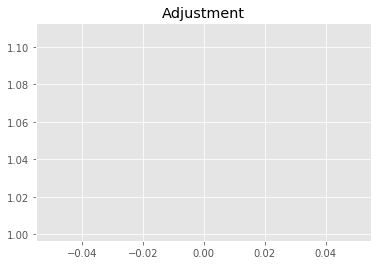

7209194465.838635
1


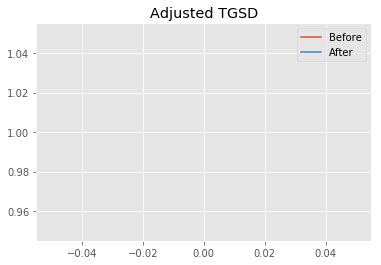

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|30.8929 	1.96759 	8742.76 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|196.742 	1.96885 	8755.81 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.458
New Misfit: 12.4556
Convergence:
0.00019248898920490242

____________________
a = 196.74228	b = 1.96885	            h1 = 8755.81175	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 12.455582405334575
Prior Misfit: 270.252,	 Post Misfit: 12.4556


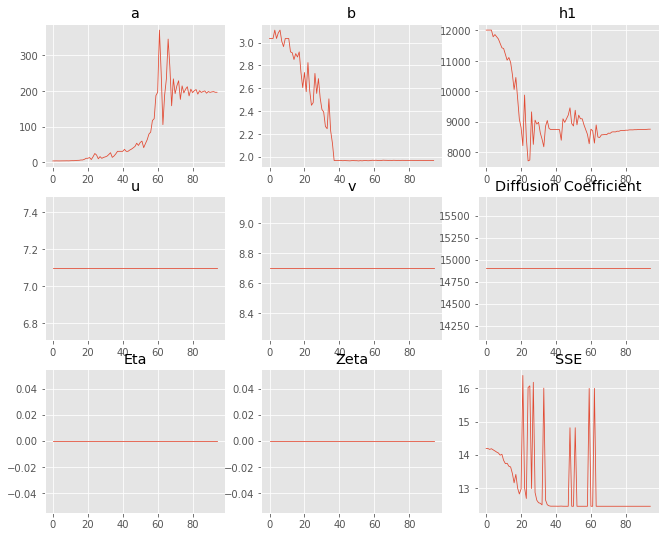

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.98022,196.742
b,3.03518,1.96885
eta,0,0
ftt,"6,458","6,458"
h1,"12,010.9","8,755.81"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 11 Time: 0.054 minutes


Estimated remaining run time: 0.623 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.32e+03 	1.13e+03 	0.8593 		1.0000


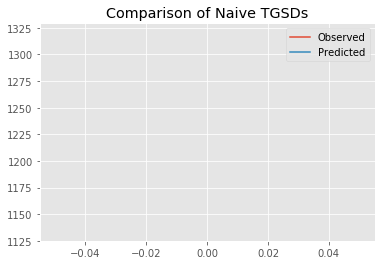

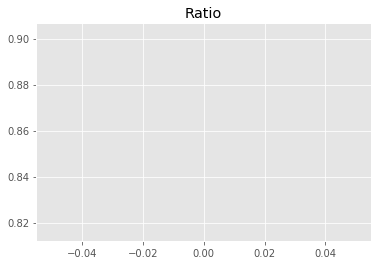

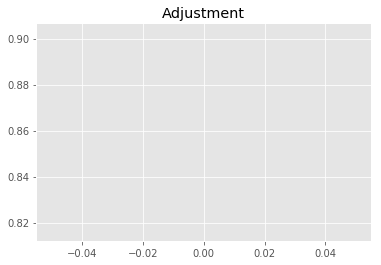

5874606069.9237385
1


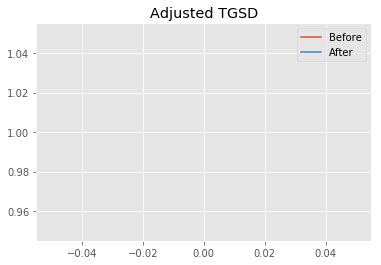

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.2076 	3.07839 	10319.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.33744 	3.25464 	15053.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.2495
New Misfit: 15.7834
Convergence:
0.25723593270902856

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.81e+02 	1.13e+03 	1.1568 		1.0000


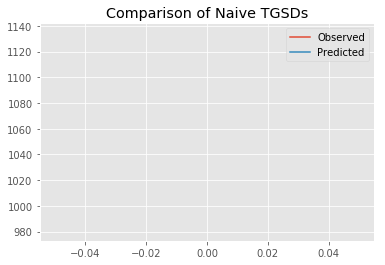

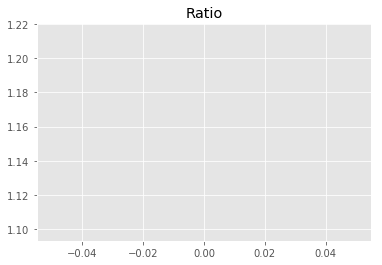

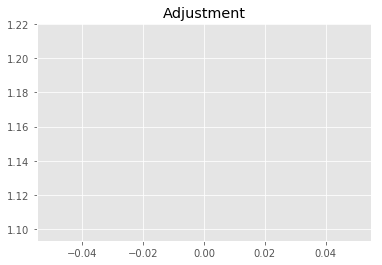

7907969928.842128
1


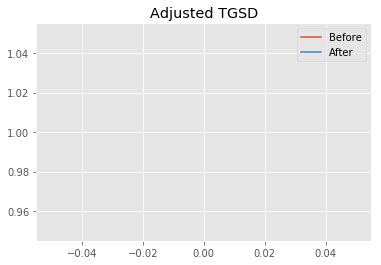

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.33744 	3.25464 	15053.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.67959 	4.46798 	10422 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.7834
New Misfit: 13.2894
Convergence:
0.1580091628034028

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.09e+03 	1.13e+03 	1.0389 		1.0000


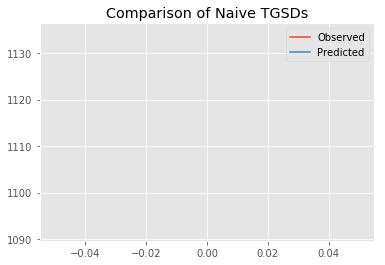

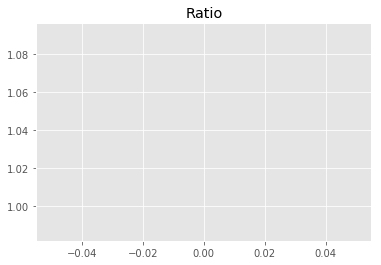

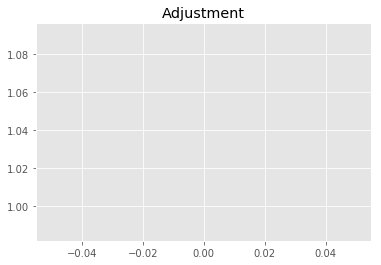

7102351493.126836
1


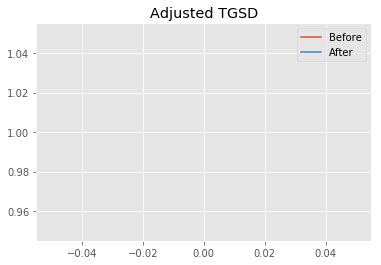

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.67959 	4.46798 	10422 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|11.2432 	3.4023 	9377.62 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.2894
New Misfit: 12.8234
Convergence:
0.035067367799936404

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0859 		1.0000


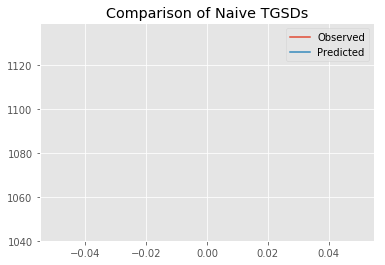

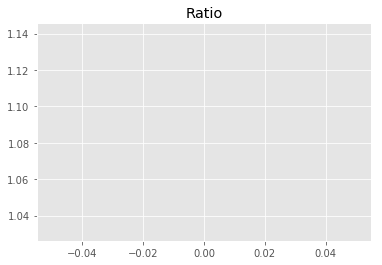

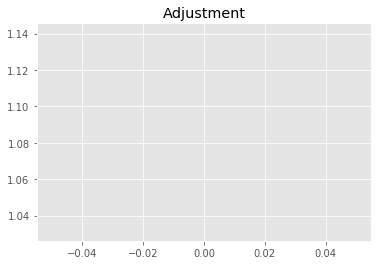

7423262402.533705
1


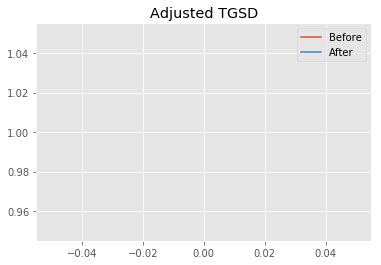

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|11.2432 	3.4023 	9377.62 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|46.5437 	18.1016 	9544.36 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.8234
New Misfit: 12.5779
Convergence:
0.019142737145586737

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.09e+03 	1.13e+03 	1.0392 		1.0000


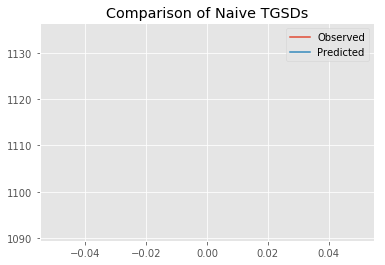

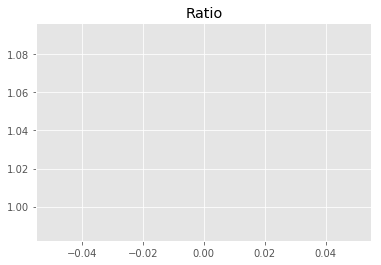

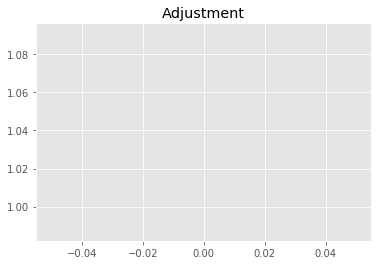

7103836039.906557
1


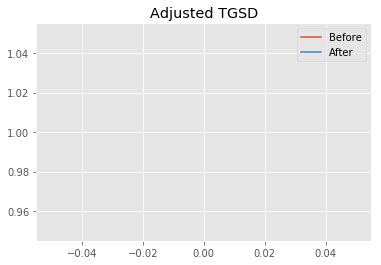

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|46.5437 	18.1016 	9544.36 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|116.718 	14.3202 	8455.74 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.5779
New Misfit: 12.4559
Convergence:
0.009704508788714282

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0552 		1.0000


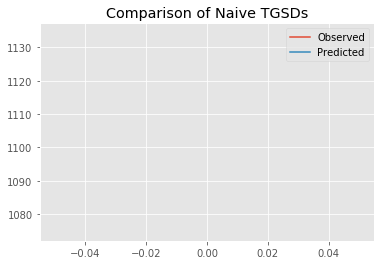

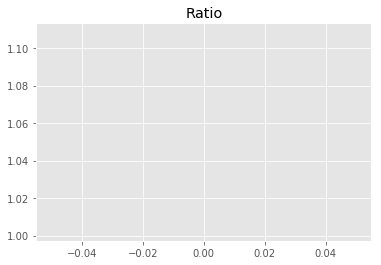

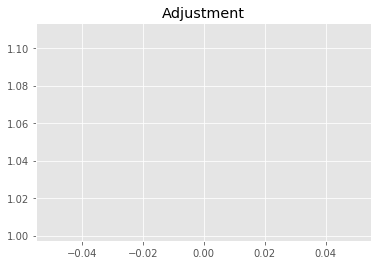

7213583483.626468
1


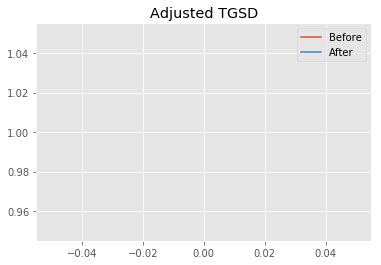

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|116.718 	14.3202 	8455.74 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|238.33 	10.0331 	9046.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.4559
New Misfit: 12.4556
Convergence:
2.4157828809373775e-05

____________________
a = 238.32984	b = 10.03305	            h1 = 9046.50321	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 12.455582405334575
Prior Misfit: 497.509,	 Post Misfit: 12.4556


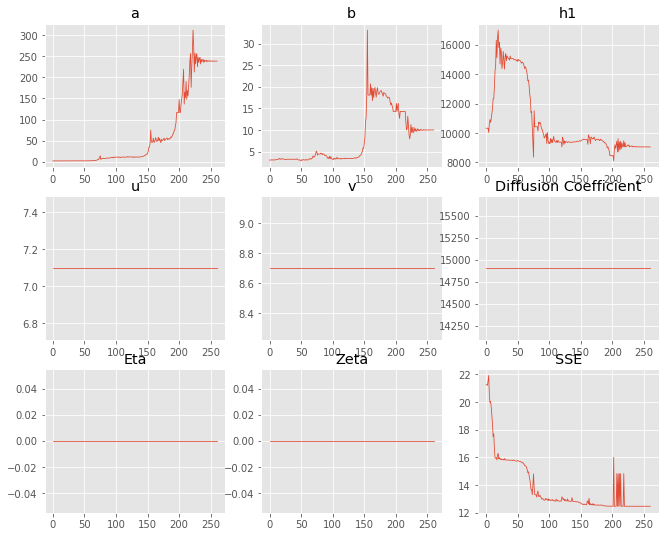

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.2076,238.33
b,3.07839,10.0331
eta,0,0
ftt,"6,458","6,458"
h1,"10,319.6","9,046.5"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 12 Time: 0.133 minutes


Estimated remaining run time: 0.575 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.27e+02 	1.13e+03 	1.2232 		1.0000


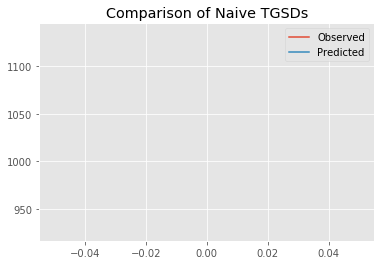

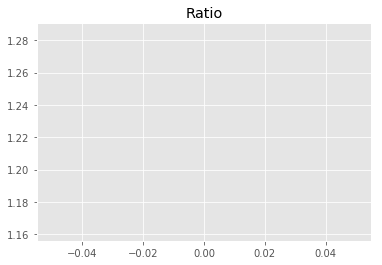

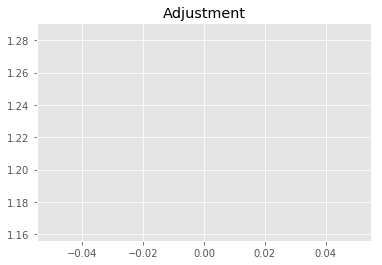

8361794502.88443
1


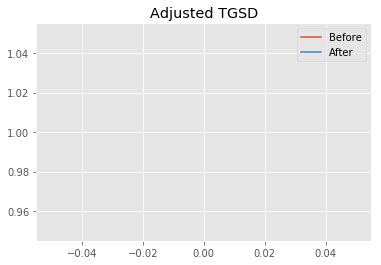

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.99435 	3.31665 	17195.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.96749 	2.14158 	13619.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.4209
New Misfit: 15.9006
Convergence:
0.03168972125882236

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.60e+02 	1.13e+03 	1.1812 		1.0000


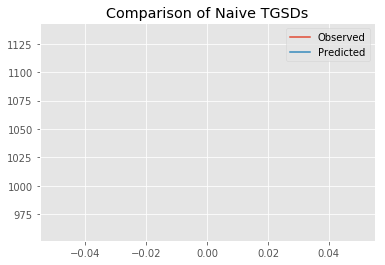

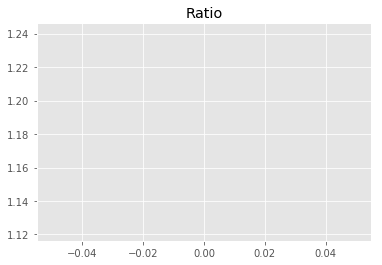

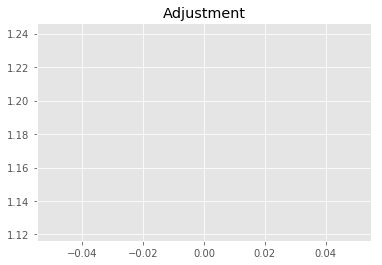

8074685631.390095
1


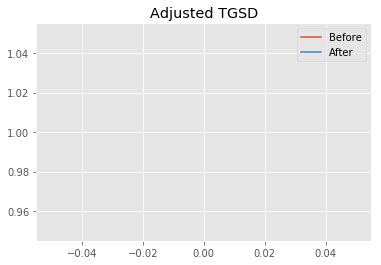

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96749 	2.14158 	13619.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.03059 	1.80786 	11899.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.9006
New Misfit: 15.5426
Convergence:
0.022512740913960393

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0937 		1.0000


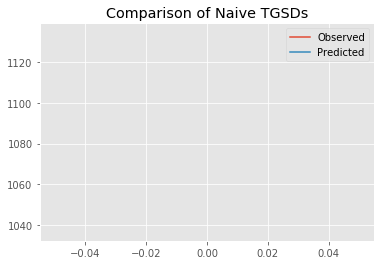

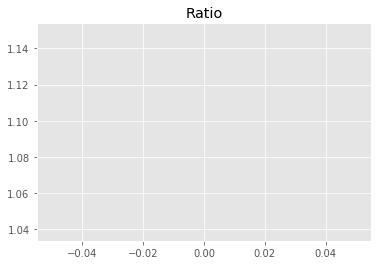

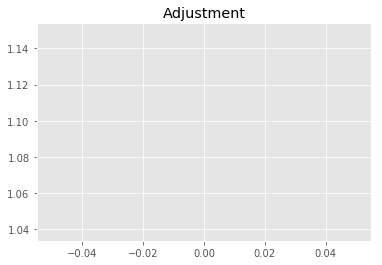

7476647577.839758
1


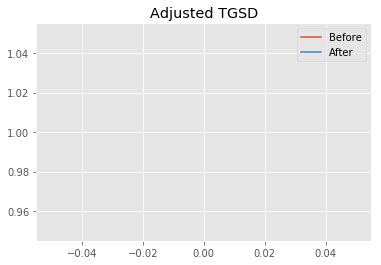

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03059 	1.80786 	11899.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.03078 	1.78765 	12492 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.5426
New Misfit: 15.4204
Convergence:
0.007862920567631724

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.00e+03 	1.13e+03 	1.1300 		1.0000


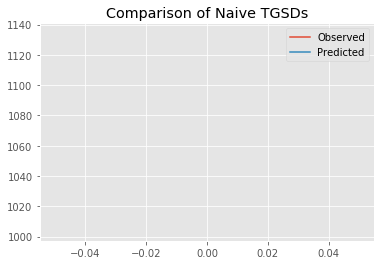

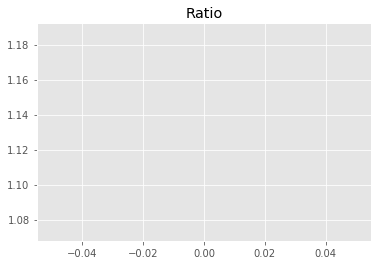

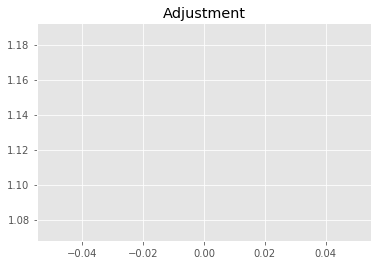

7724837555.020362
1


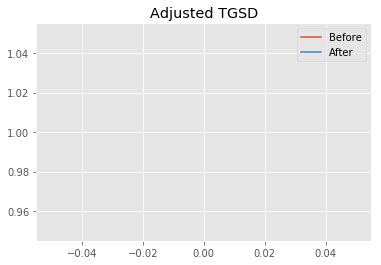

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03078 	1.78765 	12492 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.99936 	1.45177 	12176.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.4204
New Misfit: 15.3142
Convergence:
0.006883286709051316

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.59e+02 	1.13e+03 	1.1833 		1.0000


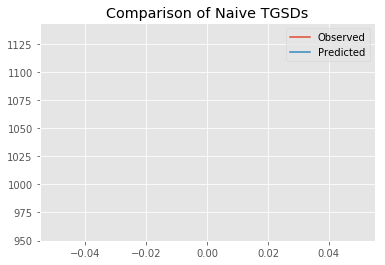

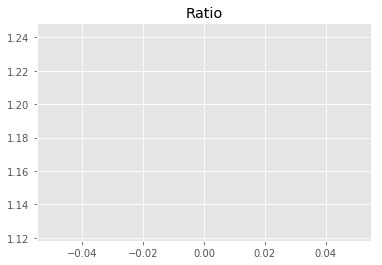

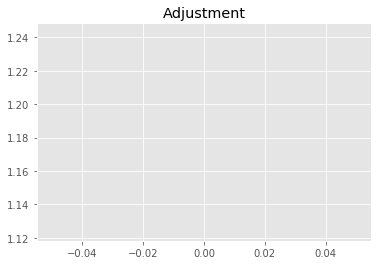

8089084702.573505
1


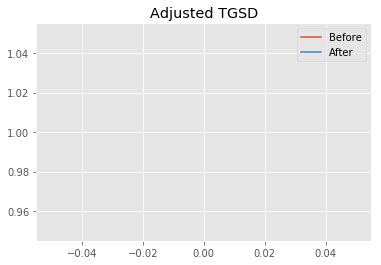

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.99936 	1.45177 	12176.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.99822 	1.04413 	10960.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.3142
New Misfit: 14.7718
Convergence:
0.035417714531131385

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.00e+03 	1.13e+03 	1.1299 		1.0000


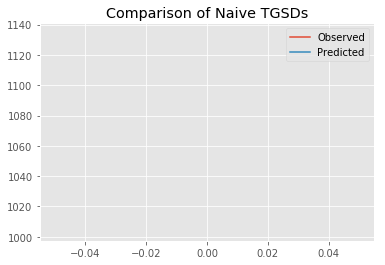

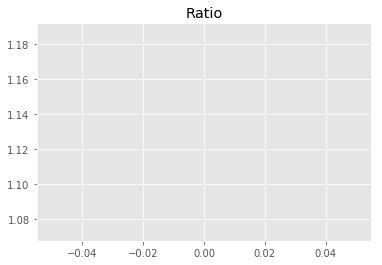

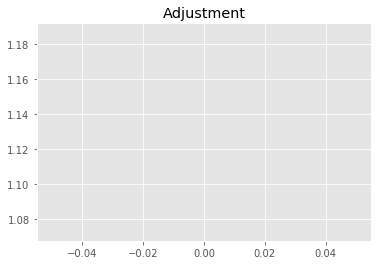

7724092641.575821
1


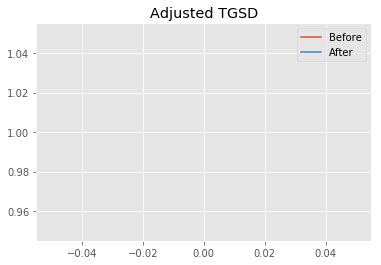

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.99822 	1.04413 	10960.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.0107 	1 	10422.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.7718
New Misfit: 14.7258
Convergence:
0.0031194874448401497

____________________
a = 2.01070	b = 1.00000	            h1 = 10422.89154	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 14.72575842749211
Prior Misfit: 404.193,	 Post Misfit: 14.7258


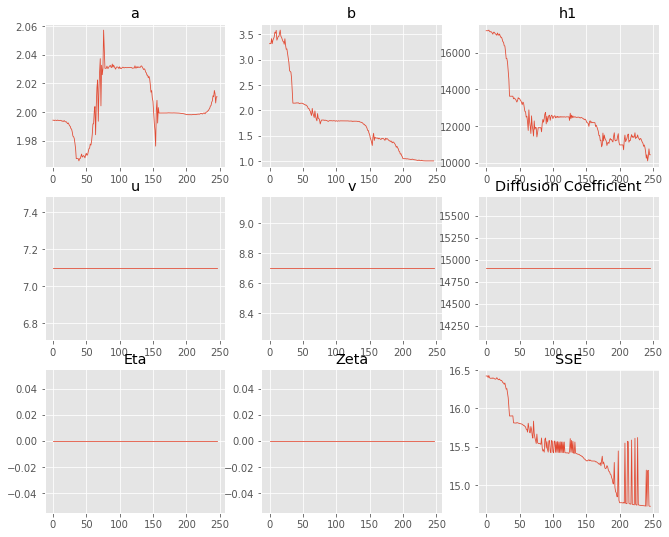

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.99435,2.0107
b,3.31665,1
eta,0,0
ftt,"6,458","6,458"
h1,"17,195.1","10,422.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 13 Time: 0.127 minutes


Estimated remaining run time: 0.512 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.14e+03 	1.13e+03 	0.9952 		1.0000


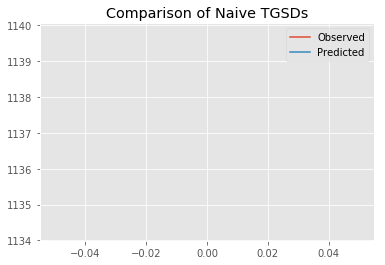

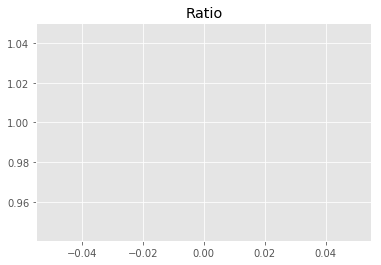

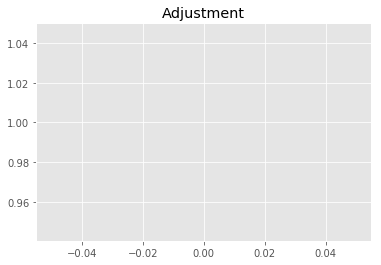

6803029287.637484
1


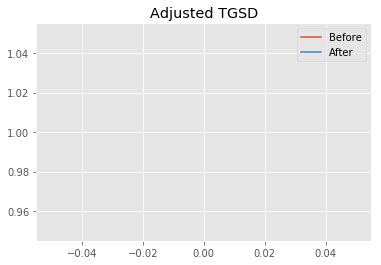

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.50049 	2.64709 	13489.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|5.28738 	2.51782 	11243.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 18.1191
New Misfit: 13.9932
Convergence:
0.22771305446464693

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.20e+02 	1.13e+03 	1.2323 		1.0000


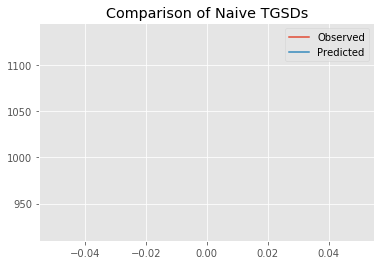

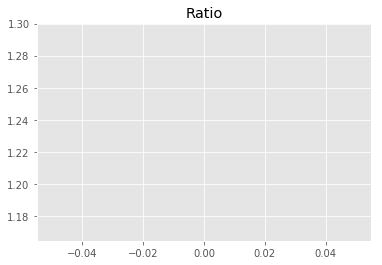

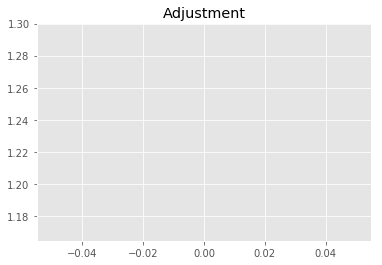

8424426881.197133
1


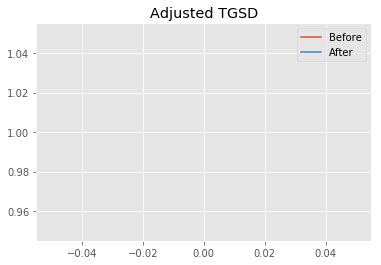

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.28738 	2.51782 	11243.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|16.4023 	2.50874 	8791.85 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.9932
New Misfit: 12.5595
Convergence:
0.10245585361628899

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.10e+03 	1.13e+03 	1.0321 		1.0000


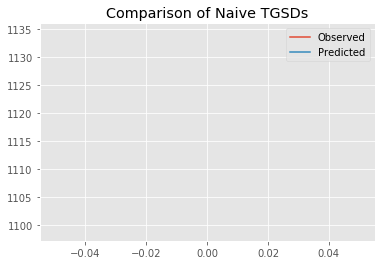

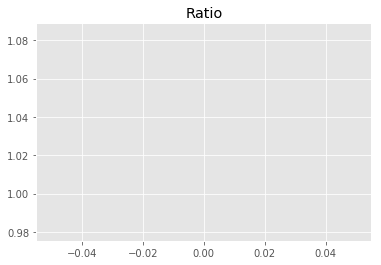

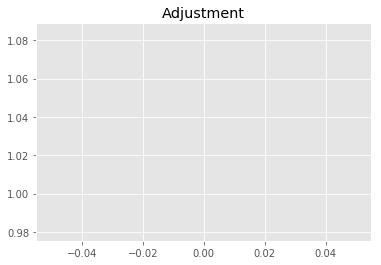

7055629085.368783
1


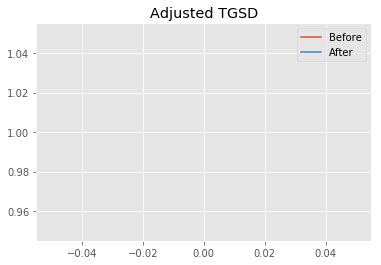

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|16.4023 	2.50874 	8791.85 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|180.636 	1.97513 	9202.71 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.5595
New Misfit: 12.4556
Convergence:
0.008273678221230376

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0553 		1.0000


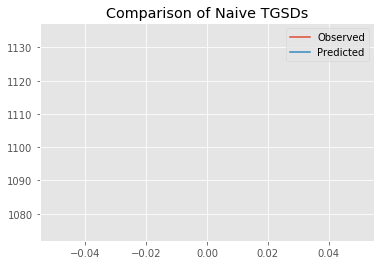

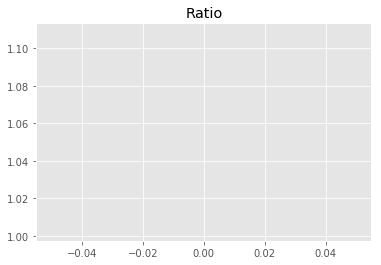

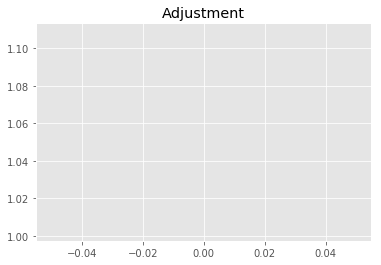

7214220068.81338
1


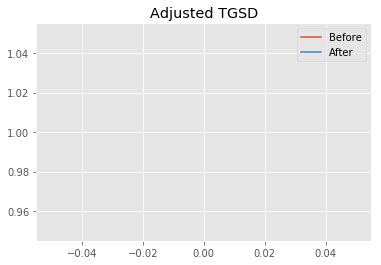

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|180.636 	1.97513 	9202.71 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Optimization terminated successfully.
         Current function value: 12.455582
         Iterations: 13
         Function evaluations: 64
New Total Mass: 6.83614e+09
After: 		|180.636 	1.97513 	9202.71 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.4556
New Misfit: 12.4556
Convergence:
4.2784595250386505e-16

____________________
a = 180.63623	b = 1.97513	            h1 = 9202.70586	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 12.455582405334575
Prior Misfit: 420.405,	 Post Misfit: 12.4556


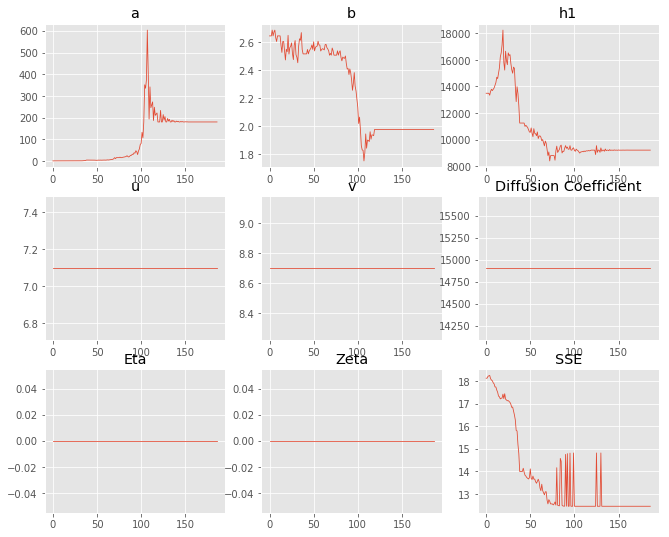

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.50049,180.636
b,2.64709,1.97513
eta,0,0
ftt,"6,458","6,458"
h1,"13,489.1","9,202.71"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 14 Time: 0.092 minutes


Estimated remaining run time: 0.429 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.33e+03 	1.13e+03 	0.8513 		1.0000


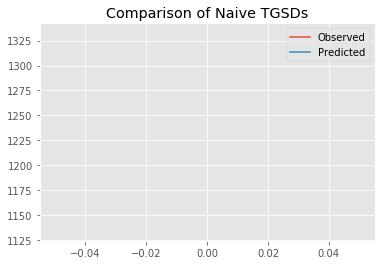

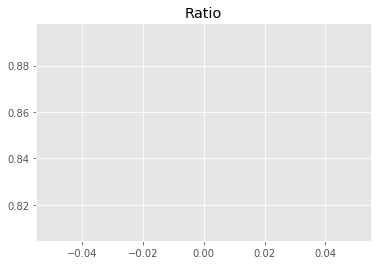

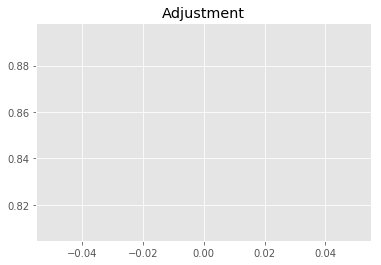

5819891744.3402195
1


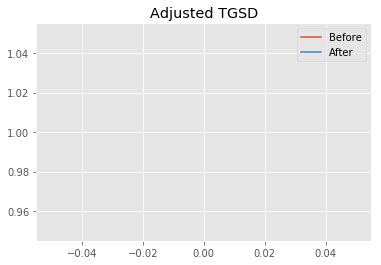

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19288 	4.33147 	12789.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.02526 	1.03662 	12092.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 25.4207
New Misfit: 16.7458
Convergence:
0.34125182480379773

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.03e+03 	1.13e+03 	1.1003 		1.0000


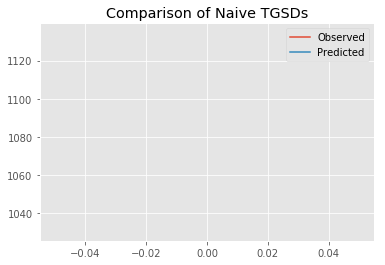

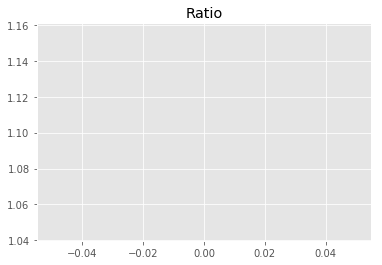

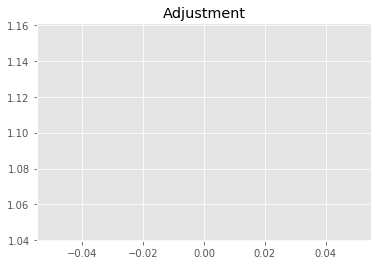

7521864502.054965
1


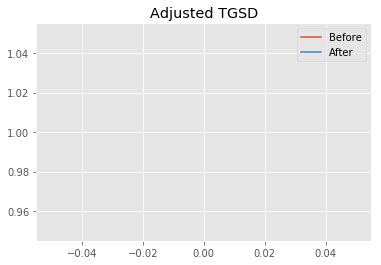

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02526 	1.03662 	12092.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.63632 	1.00363 	11135.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.7458
New Misfit: 14.4652
Convergence:
0.1361901063621127

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.28e+02 	1.13e+03 	1.2224 		1.0000


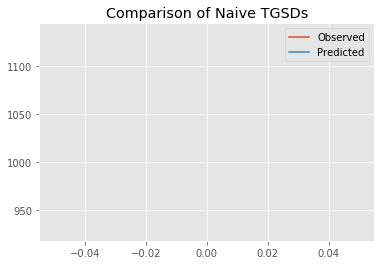

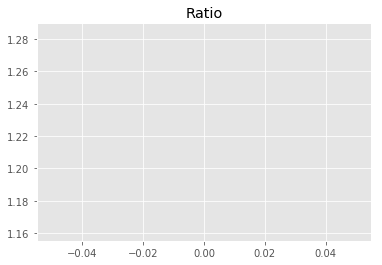

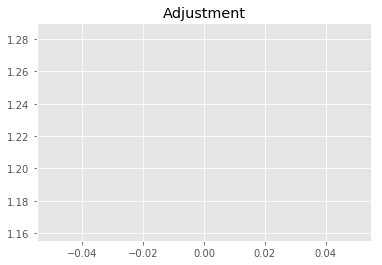

8356824223.202158
1


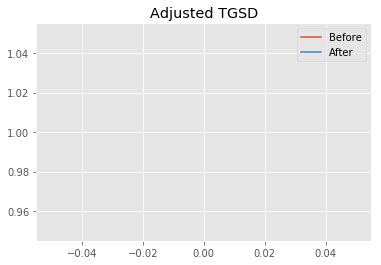

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.63632 	1.00363 	11135.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.87043 	1.10723 	9614.63 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.4652
New Misfit: 14.0083
Convergence:
0.03158917521514647

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.09e+03 	1.13e+03 	1.0407 		1.0000


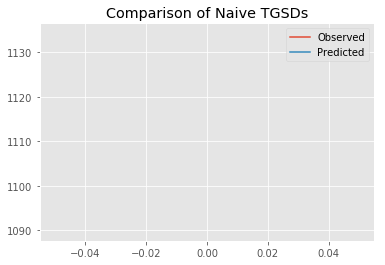

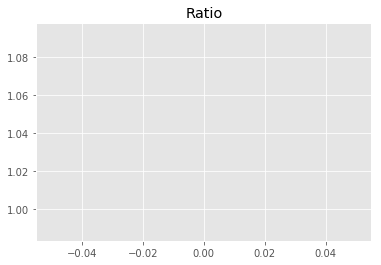

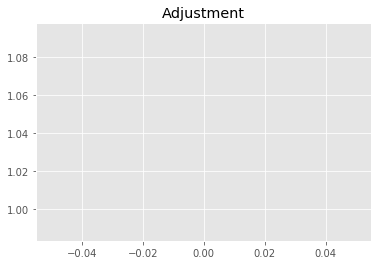

7114405921.980918
1


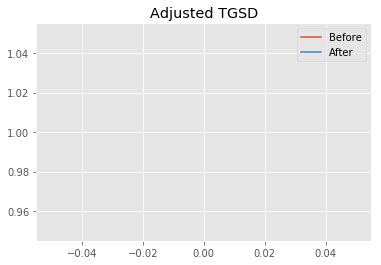

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.87043 	1.10723 	9614.63 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.98387 	1.02495 	9501.38 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.0083
New Misfit: 13.3196
Convergence:
0.049161958010602774

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.01e+03 	1.13e+03 	1.1236 		1.0000


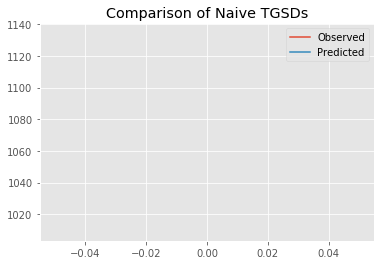

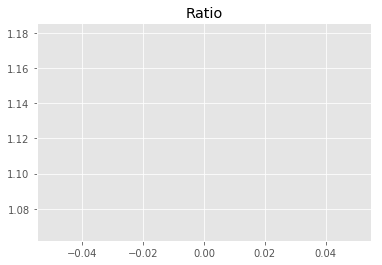

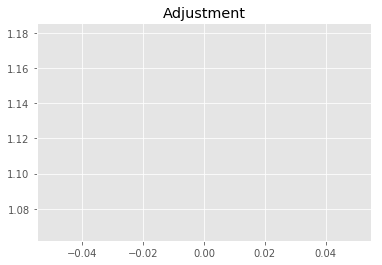

7681040530.397524
1


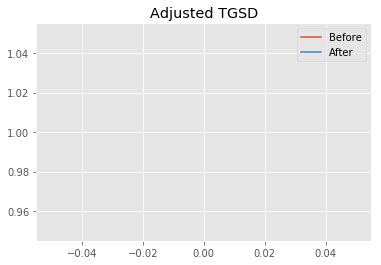

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.98387 	1.02495 	9501.38 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.50636 	1.03493 	9364.66 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.3196
New Misfit: 13.2818
Convergence:
0.0028358317655028838

____________________
a = 4.50636	b = 1.03493	            h1 = 9364.66353	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 13.281810729408033
Prior Misfit: 709.812,	 Post Misfit: 13.2818


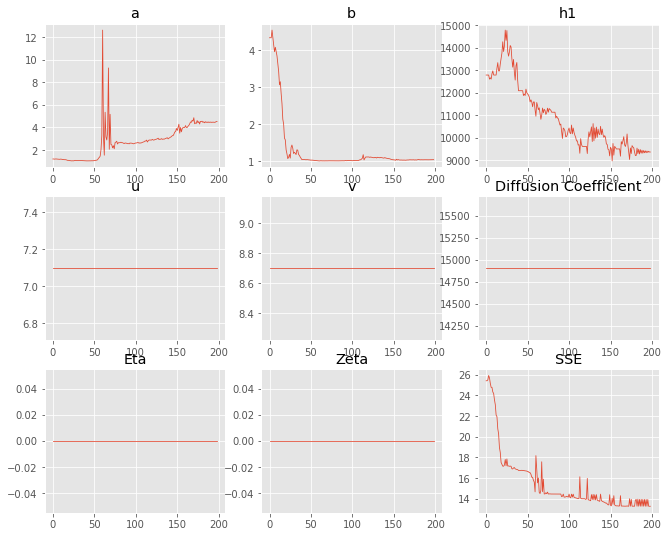

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.19288,4.50636
b,4.33147,1.03493
eta,0,0
ftt,"6,458","6,458"
h1,"12,789.6","9,364.66"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 15 Time: 0.103 minutes


Estimated remaining run time: 0.348 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.39e+02 	1.13e+03 	1.2074 		1.0000


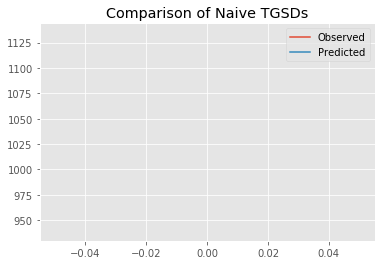

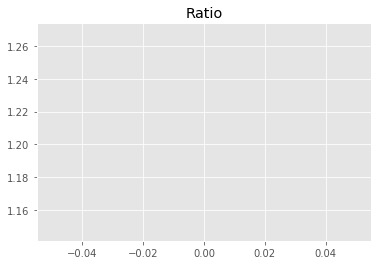

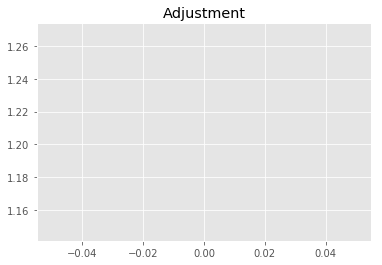

8254295007.585248
1


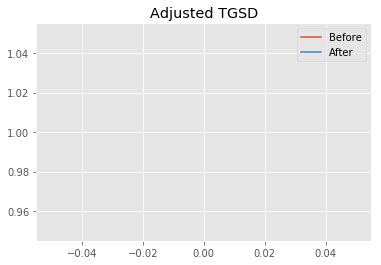

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.84011 	4.65221 	21497.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.34877 	2.73999 	13160.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.9077
New Misfit: 15.6518
Convergence:
0.07428349839697532

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0881 		1.0000


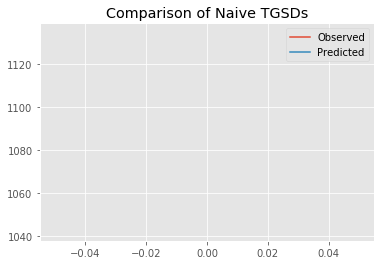

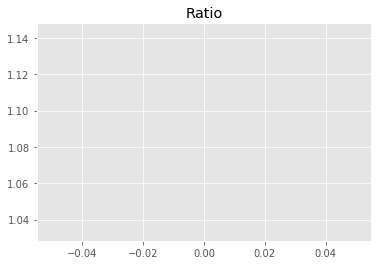

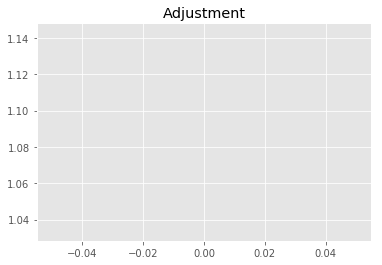

7438701096.171845
1


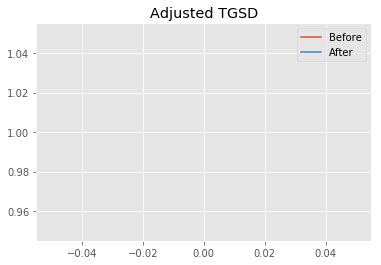

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.34877 	2.73999 	13160.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.77587 	1.51326 	10659.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.6518
New Misfit: 14.3446
Convergence:
0.08351275346739308

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1127 		1.0000


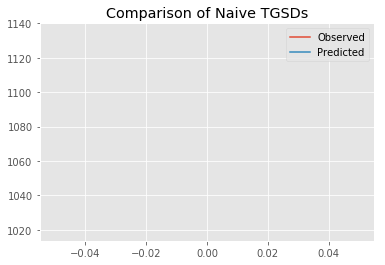

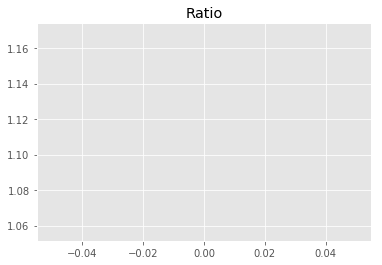

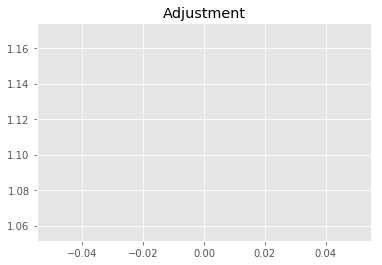

7606337526.326916
1


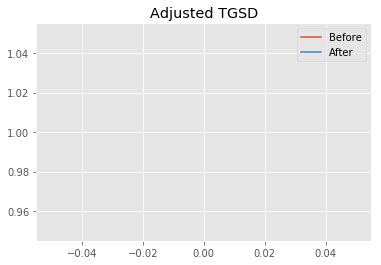

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.77587 	1.51326 	10659.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|6.42845 	1.69289 	9471.75 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.3446
New Misfit: 13.1019
Convergence:
0.08663319871059753

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.00e+03 	1.13e+03 	1.1340 		1.0000


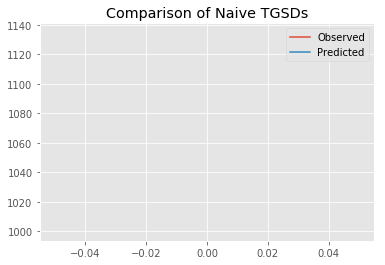

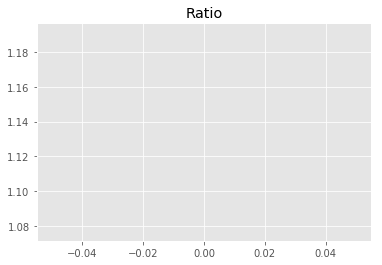

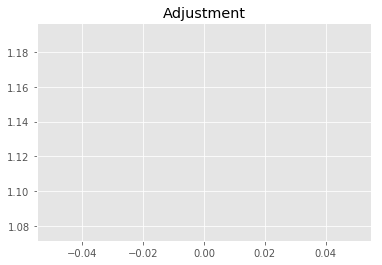

7752003903.766218
1


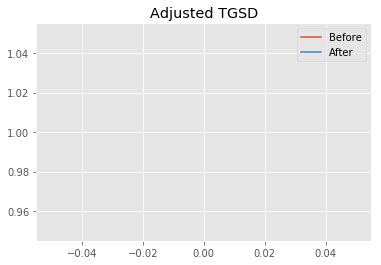

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.42845 	1.69289 	9471.75 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|6.44043 	1.71954 	9363.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.1019
New Misfit: 13.057
Convergence:
0.0034305526482007248

____________________
a = 6.44043	b = 1.71954	            h1 = 9363.40121	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 13.056967191270937
Prior Misfit: 432.489,	 Post Misfit: 13.057


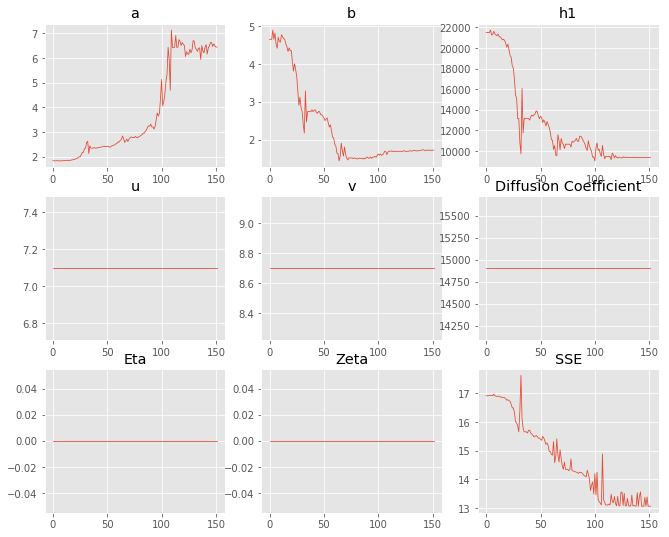

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.84011,6.44043
b,4.65221,1.71954
eta,0,0
ftt,"6,458","6,458"
h1,"21,497.8","9,363.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 16 Time: 0.084 minutes


Estimated remaining run time: 0.260 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.21e+03 	1.13e+03 	0.9366 		1.0000


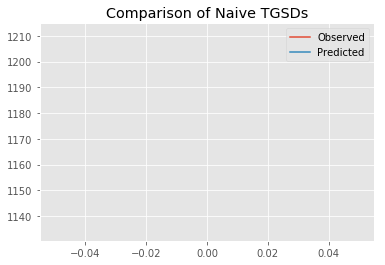

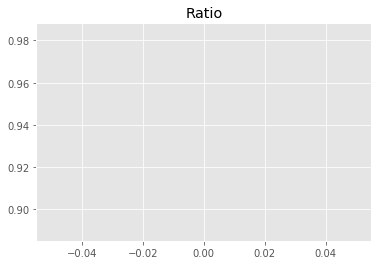

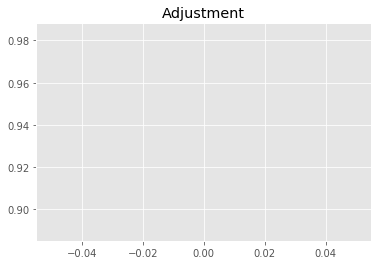

6402764652.515016
1


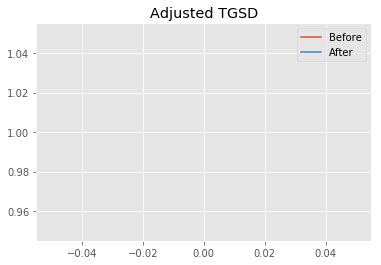

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.25681 	2.8545 	10409 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|6.27553 	3.95868 	10956.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.3691
New Misfit: 13.423
Convergence:
0.17998026827916516

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.05e+03 	1.13e+03 	1.0829 		1.0000


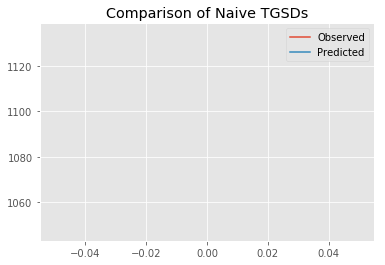

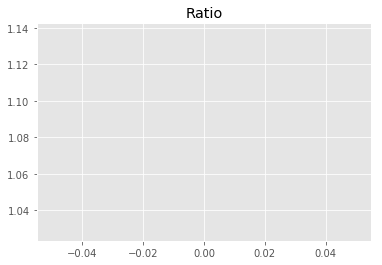

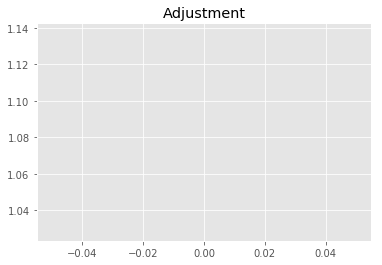

7402914440.257862
1


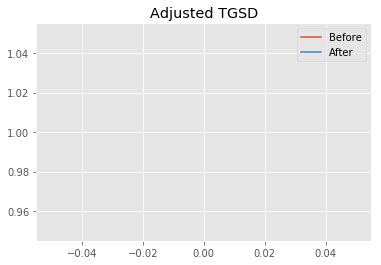

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.27553 	3.95868 	10956.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|9.38475 	3.03035 	9432.26 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.423
New Misfit: 12.8919
Convergence:
0.039569070819114635

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.05e+03 	1.13e+03 	1.0769 		1.0000


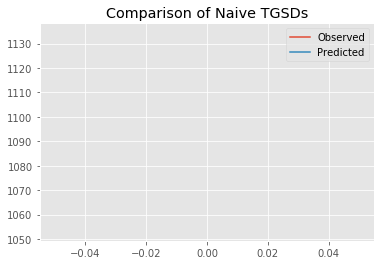

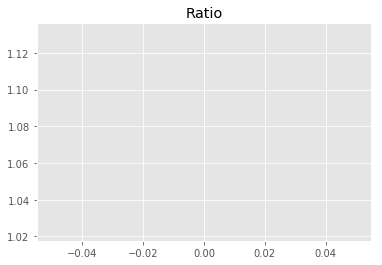

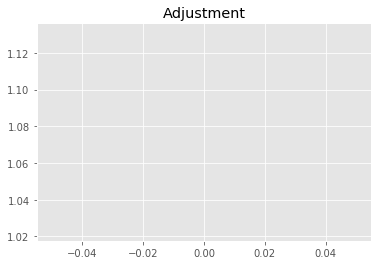

7361673290.6956
1


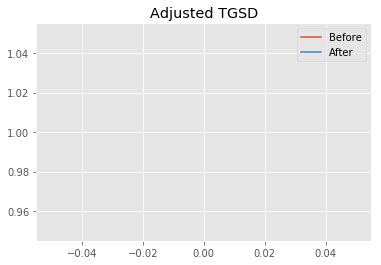

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.38475 	3.03035 	9432.26 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|10.5523 	3.06423 	9359.74 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.8919
New Misfit: 12.8482
Convergence:
0.0033882284620403436

____________________
a = 10.55232	b = 3.06423	            h1 = 9359.73843	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 12.848184861951946
Prior Misfit: 322.072,	 Post Misfit: 12.8482


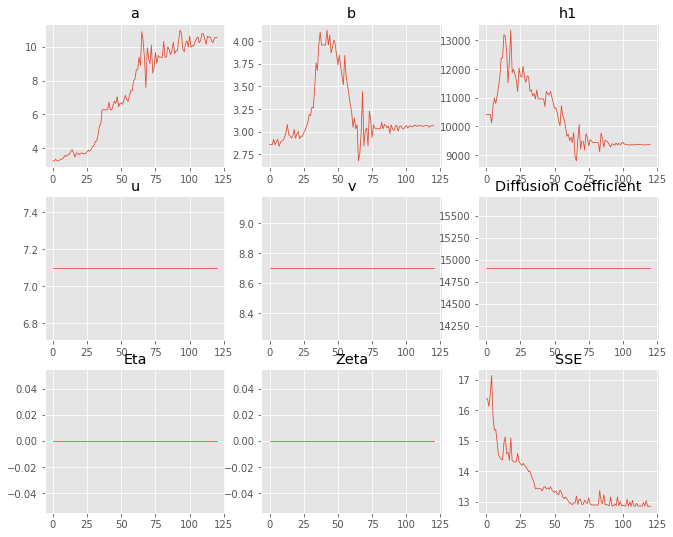

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.25681,10.5523
b,2.8545,3.06423
eta,0,0
ftt,"6,458","6,458"
h1,"10,409","9,359.74"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 17 Time: 0.067 minutes


Estimated remaining run time: 0.171 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.31e+03 	1.13e+03 	0.8681 		1.0000


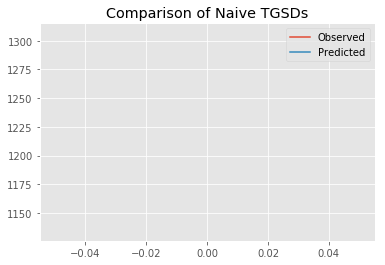

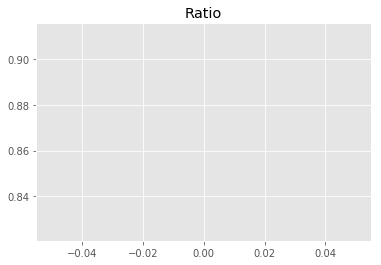

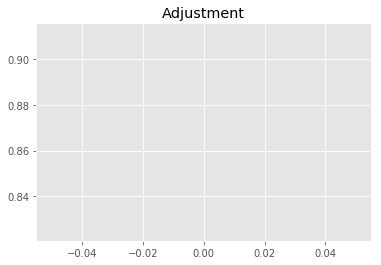

5934425156.821825
1


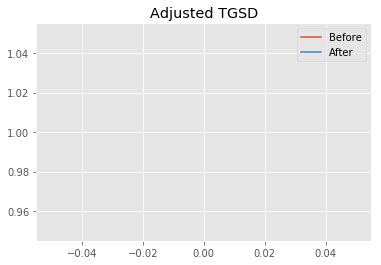

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.72855 	2.41019 	10195.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.80264 	2.38644 	13846.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 21.2438
New Misfit: 16.3255
Convergence:
0.23152019222802372

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1115 		1.0000


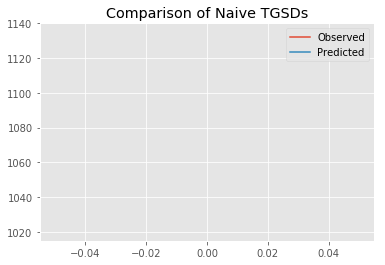

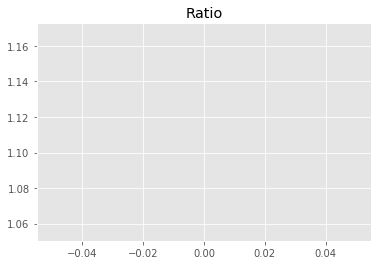

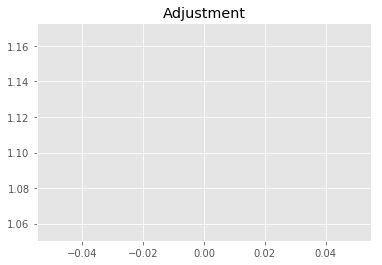

7598268175.944286
1


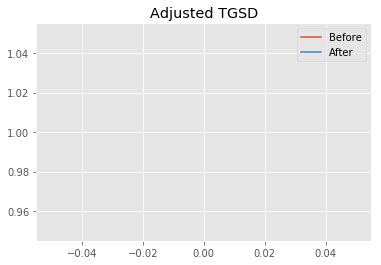

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.80264 	2.38644 	13846.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.2167 	2.00034 	12019.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.3255
New Misfit: 15.3935
Convergence:
0.05708683597337311

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0920 		1.0000


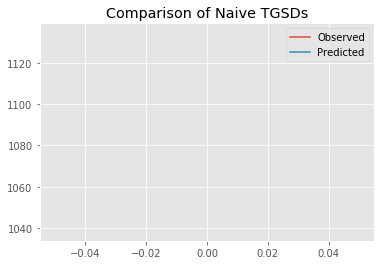

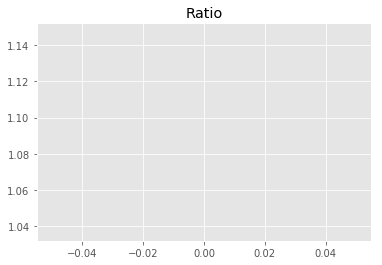

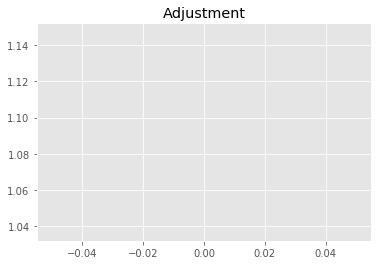

7465114319.785782
1


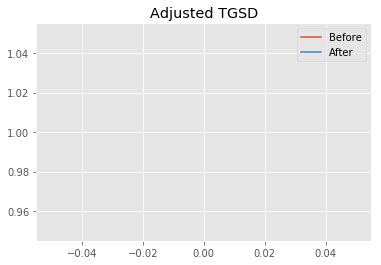

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.2167 	2.00034 	12019.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.47609 	2 	12254.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 15.3935
New Misfit: 14.9994
Convergence:
0.025603212937077655

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.88e+02 	1.13e+03 	1.1477 		1.0000


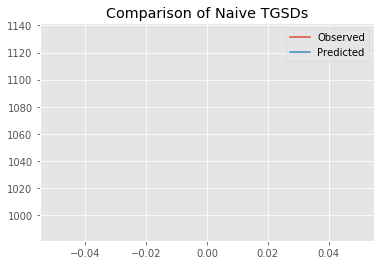

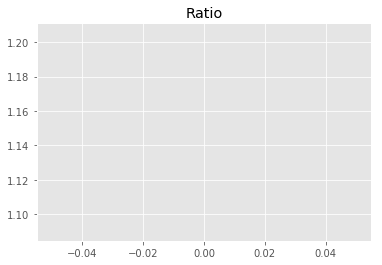

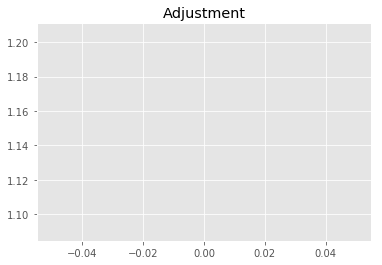

7846165526.445812
1


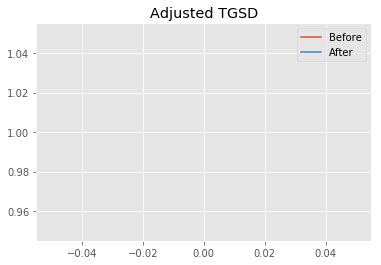

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.47609 	2 	12254.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|6.40185 	2 	9468.11 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 14.9994
New Misfit: 13.0613
Convergence:
0.12920742786955358

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0901 		1.0000


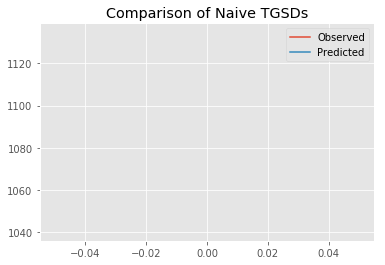

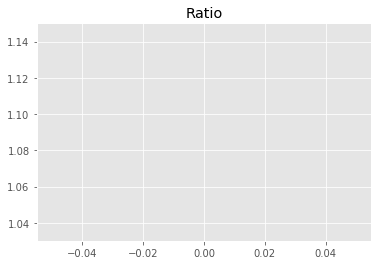

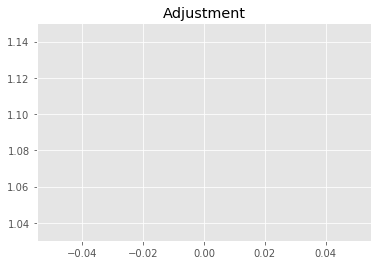

7451898623.121321
1


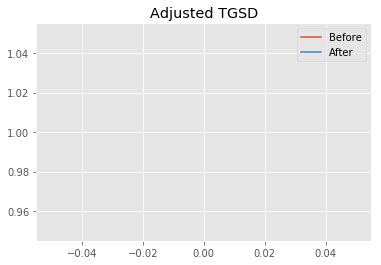

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.40185 	2 	9468.11 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.38132 	2 	9361.85 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.0613
New Misfit: 12.9963
Convergence:
0.004977614632758437

____________________
a = 7.38132	b = 2.00000	            h1 = 9361.85491	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 12.996319073974714
Prior Misfit: 500.508,	 Post Misfit: 12.9963


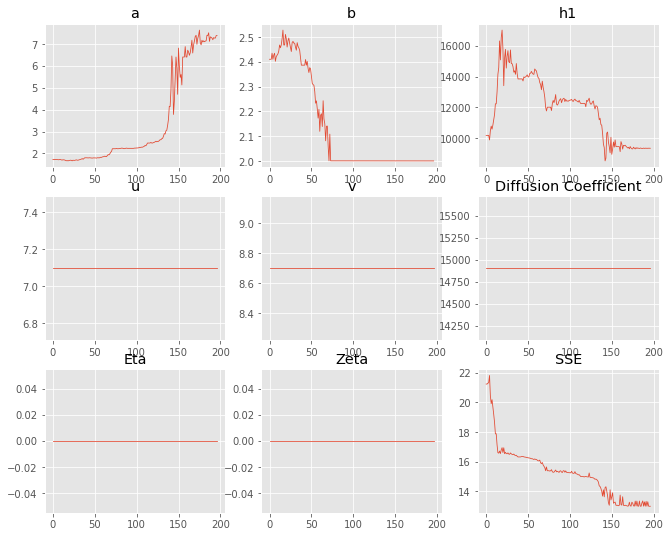

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.72855,7.38132
b,2.41019,2
eta,0,0
ftt,"6,458","6,458"
h1,"10,195.9","9,361.85"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 18 Time: 0.104 minutes


Estimated remaining run time: 0.087 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.17e+03 	1.13e+03 	0.9736 		1.0000


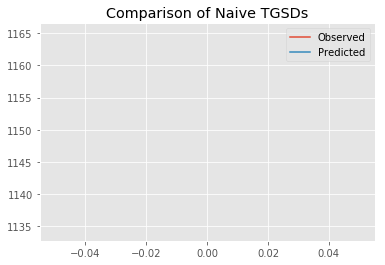

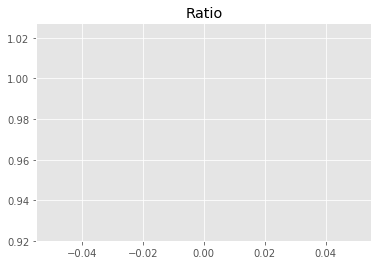

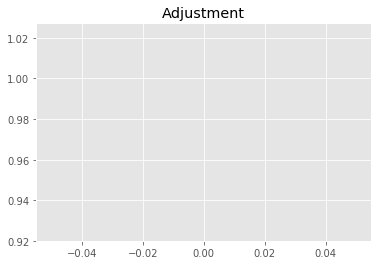

6655731603.683656
1


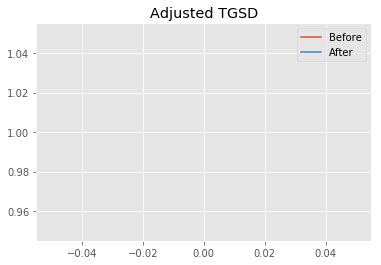

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.68667 	4.39983 	16139.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.73718 	2.79296 	16109 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 18.8802
New Misfit: 16.5933
Convergence:
0.12112296979682258

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.61e+02 	1.13e+03 	1.1799 		1.0000


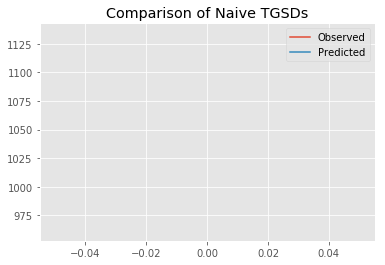

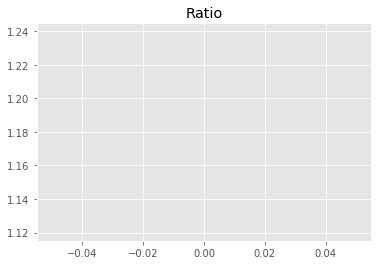

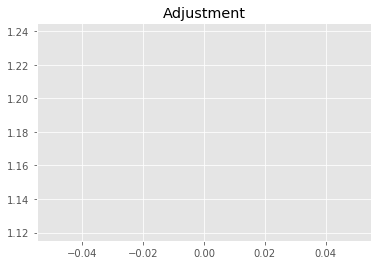

8066282998.43247
1


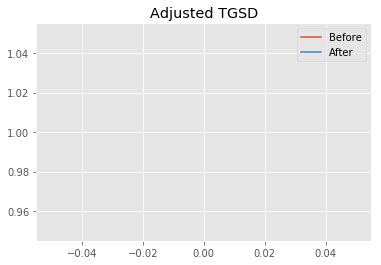

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.73718 	2.79296 	16109 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|10.2668 	11.9228 	14211.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.5933
New Misfit: 13.445
Convergence:
0.18973367158851728

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.78e+02 	1.13e+03 	1.1596 		1.0000


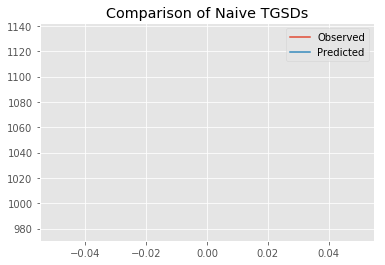

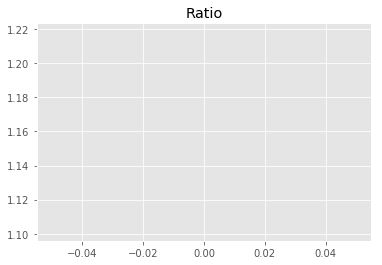

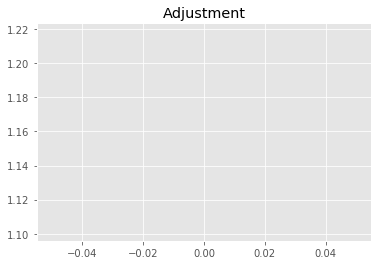

7927359432.135385
1


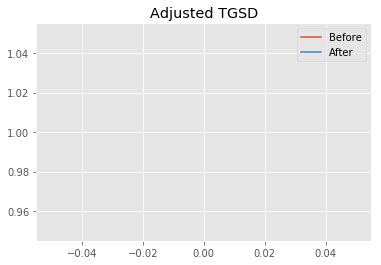

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.2668 	11.9228 	14211.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1462.91 	2756.64 	16105.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.445
New Misfit: 12.4558
Convergence:
0.07357668399768685

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0552 		1.0000


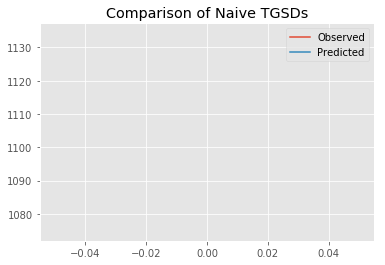

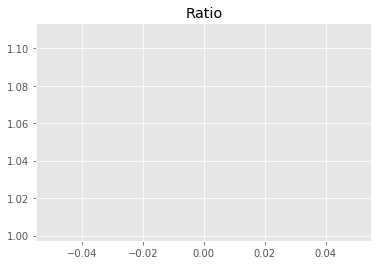

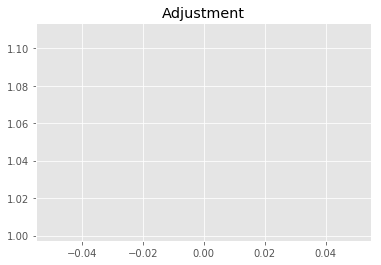

7213799777.53198
1


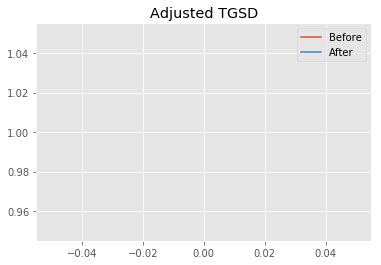

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1462.91 	2756.64 	16105.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1529.2 	2705.43 	16099.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 12.4558
New Misfit: 12.4556
Convergence:
1.5940445343157652e-05

____________________
a = 1529.20468	b = 2705.43327	            h1 = 16099.72591	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 12.45558243645538
Prior Misfit: 448.686,	 Post Misfit: 12.4556


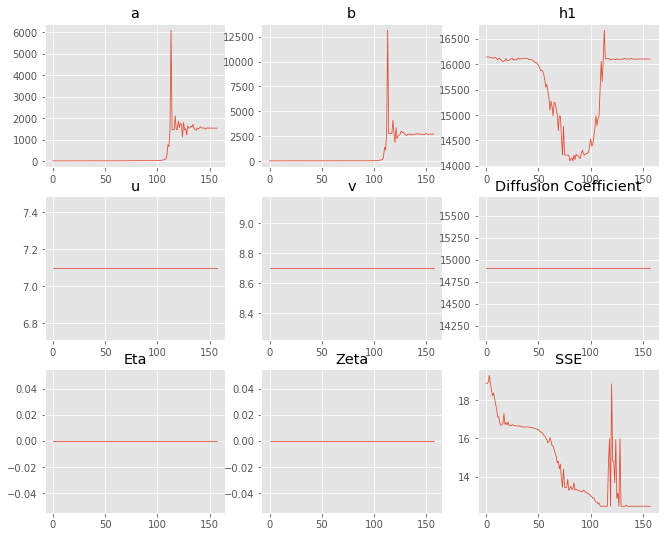

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.68667,"1,529.2"
b,4.39983,"2,705.43"
eta,0,0
ftt,"6,458","6,458"
h1,"16,139.4","16,099.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 19 Time: 0.084 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	7.54e+02 	1.13e+03 	1.5037 		1.0000


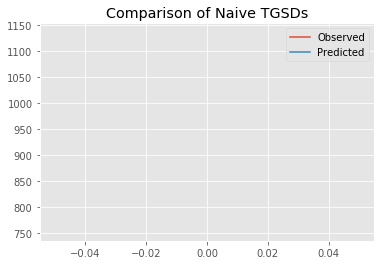

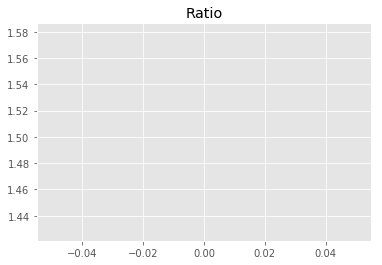

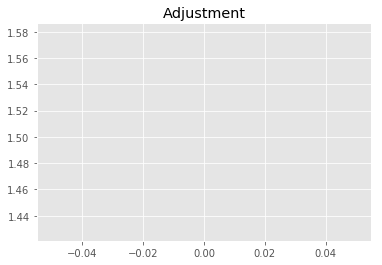

10279334736.467274
1


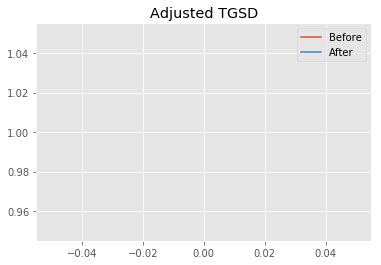

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.72719 	2.68787 	12957 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.1253 	2.16532 	10826.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 16.434
New Misfit: 13.8289
Convergence:
0.1585149114936072

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.94e+02 	1.13e+03 	1.1405 		1.0000


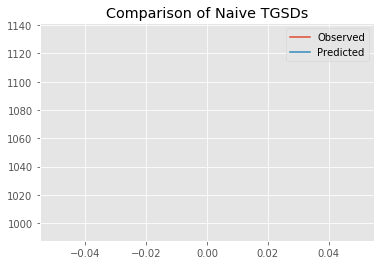

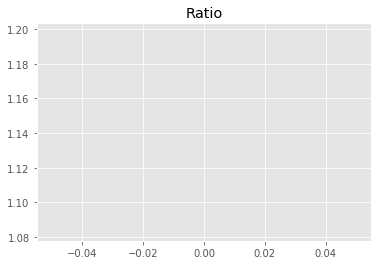

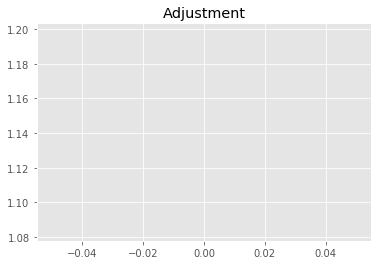

7796935274.55095
1


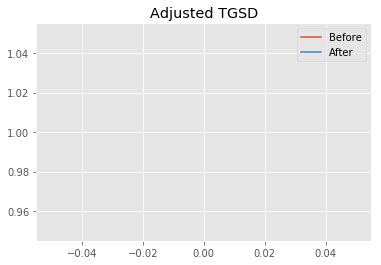

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.1253 	2.16532 	10826.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.52048 	2.13329 	9460.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.8289
New Misfit: 13.0062
Convergence:
0.05949383097750564

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1167 		1.0000


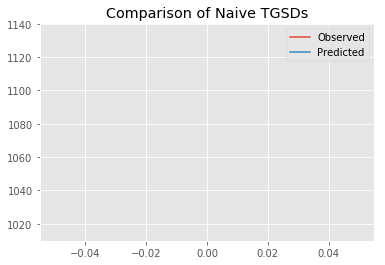

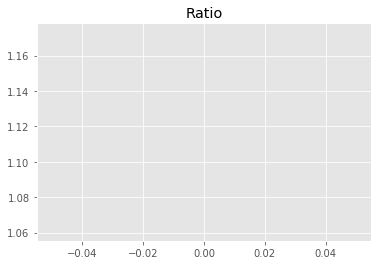

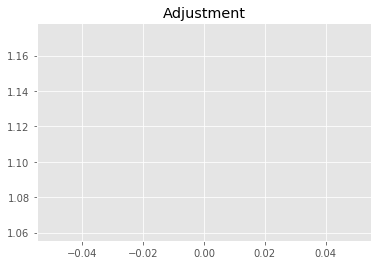

7634174919.720027
1


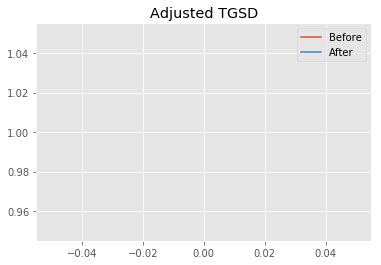

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.52048 	2.13329 	9460.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.81174 	2.14357 	9359.76 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 13.0062
New Misfit: 12.9693
Convergence:
0.002836281390863874

____________________
a = 7.81174	b = 2.14357	            h1 = 9359.76054	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 12.969321635504185
Prior Misfit: 436.625,	 Post Misfit: 12.9693


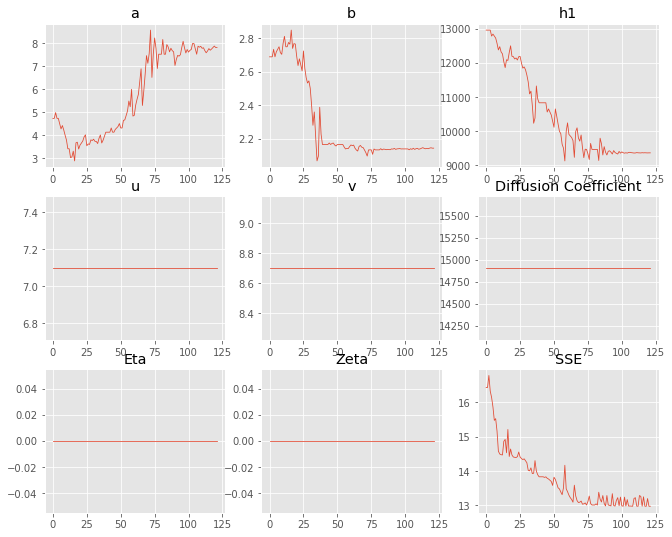

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.72719,7.81174
b,2.68787,2.14357
eta,0,0
ftt,"6,458","6,458"
h1,"12,957","9,359.76"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 20 Time: 0.067 minutes


Estimated remaining run time: -0.086 minutes


Total Run Time: 1.79609 minutes


[{'a': 8.631119046986555,
  'b': 2.413672718294044,
  'h1': 9361.125710867494,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 3041.850420516085,
  'b': 5629.867246210223,
  'h1': 16521.416611556473,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 7.292382673830042,
  'b': 1.9883733765081741,
  'h1': 9359.676879775947,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 219.26861754690955,
  'b': 375.41753643888416,
  'h1': 15982.620921077902,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 7.360323011441084,
  'b': 2.0114344105920523,
  'h1': 9360.112108427802,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 9.7530295331

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
9,255.775,2.02976,"8,626.07",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
13,180.636,1.97513,"9,202.71",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
7,"1,237.13",287.478,"9,183.19",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
11,238.33,10.0331,"9,046.5",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
10,196.742,1.96885,"8,755.81",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
1,"3,041.85","5,629.87","16,521.4",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
18,"1,529.2","2,705.43","16,099.7",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
6,279.812,84.2446,"9,254.17",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
3,219.269,375.418,"15,982.6",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4802
16,10.5523,3.06423,"9,359.74",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.8482


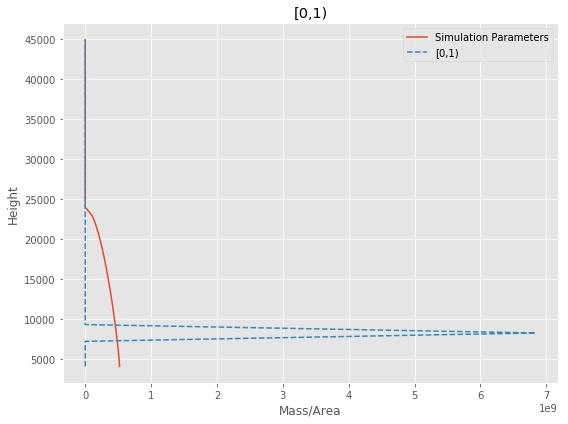

[0,1) Run Time: 1.79948 minutes


Mass Test: 52635102777.88889
========[1,2)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.19e+02 	2.64e+02 	2.2187 		1.0000


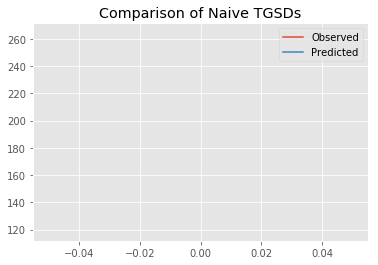

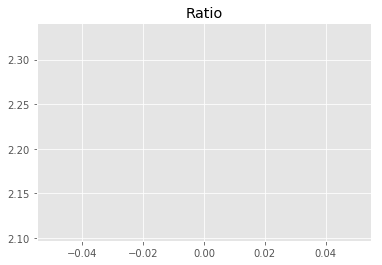

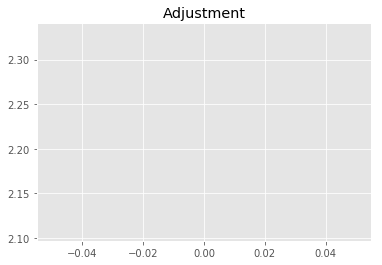

3531388729.7368126
1


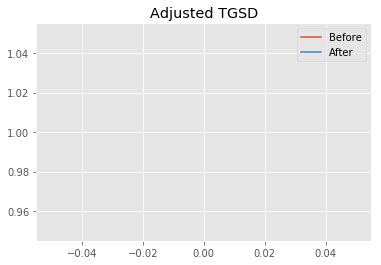

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.80343 	2.44614 	13918.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.87744 	2.96029 	9547.56 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 5.16815
New Misfit: 3.96021
Convergence:
0.2337266038305611

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.24e+02 	2.64e+02 	1.1766 		1.0000


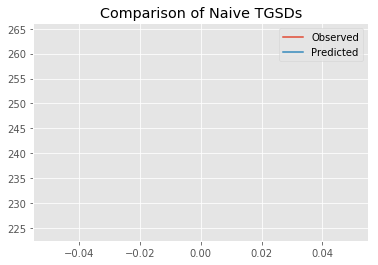

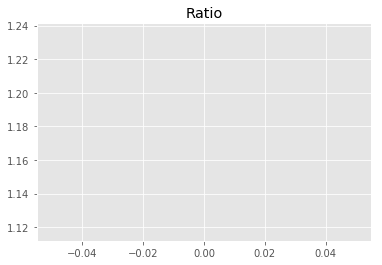

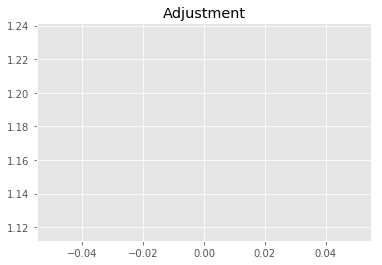

1872759199.3176847
1


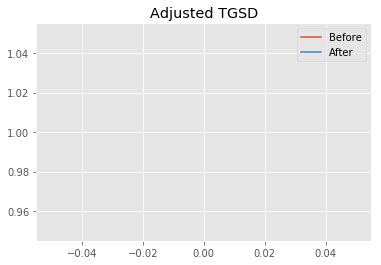

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.87744 	2.96029 	9547.56 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.87024 	1.59298 	7550.38 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.96021
New Misfit: 3.89069
Convergence:
0.017556090433041863

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.41e+02 	2.64e+02 	1.0976 		1.0000


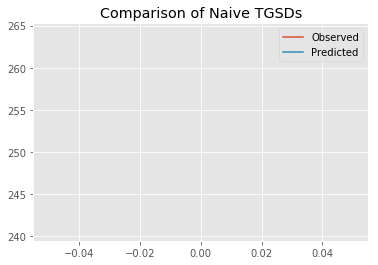

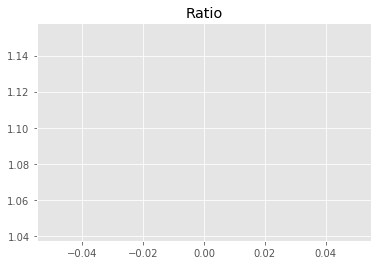

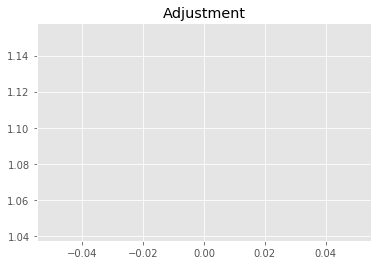

1746918953.3307652
1


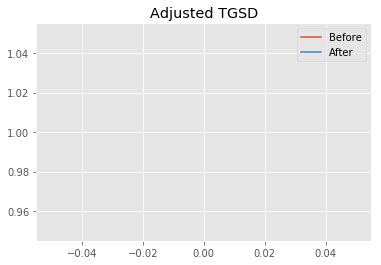

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.87024 	1.59298 	7550.38 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.87534 	1.49058 	8300.14 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.89069
New Misfit: 3.8433
Convergence:
0.012179159166144975

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.28e+02 	2.64e+02 	1.1569 		1.0000


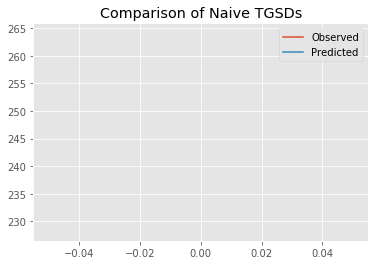

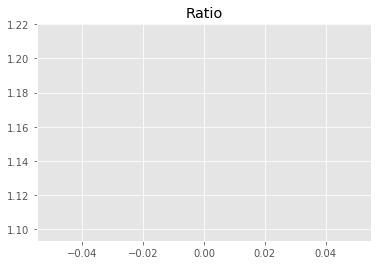

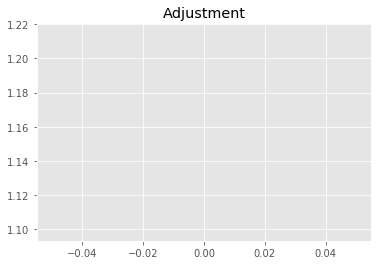

1841347290.8889587
1


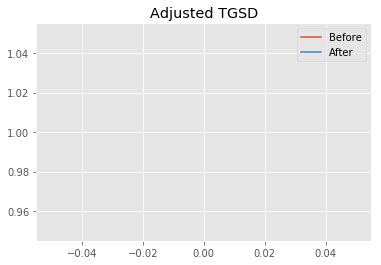

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.87534 	1.49058 	8300.14 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.00648 	1.12612 	7722.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.8433
New Misfit: 3.82556
Convergence:
0.0046172965185369425

____________________
a = 2.00648	b = 1.12612	            h1 = 7722.90163	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.8255577163419994
Prior Misfit: 312.685,	 Post Misfit: 3.82556


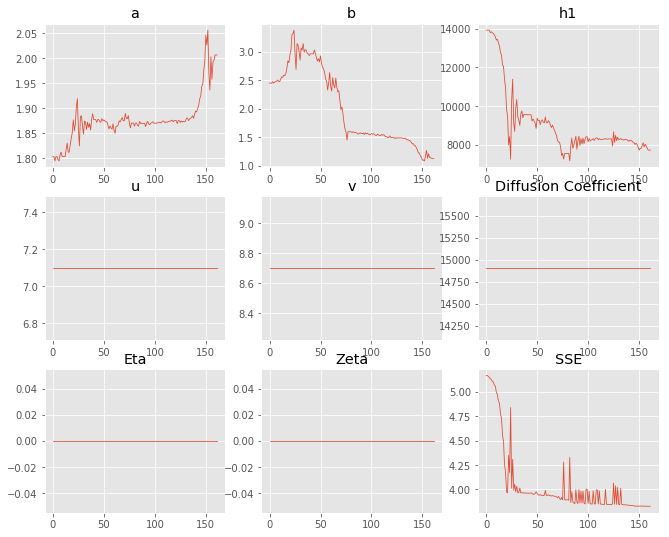

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.80343,2.00648
b,2.44614,1.12612
eta,0,0
ftt,"6,458","6,458"
h1,"13,918.5","7,722.9"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 1 Time: 0.084 minutes


Estimated remaining run time: 0.757 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	8.94e+01 	2.64e+02 	2.9543 		1.0000


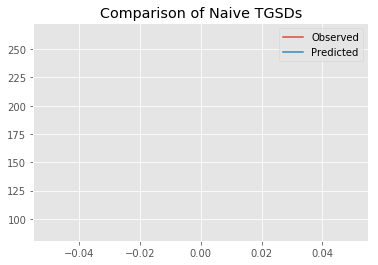

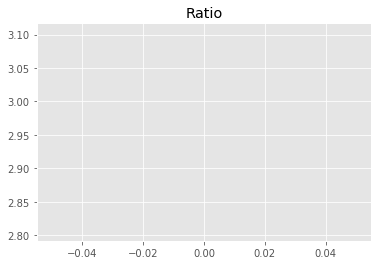

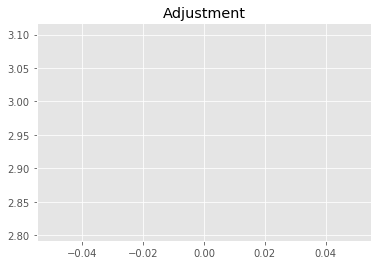

4702146077.4120035
1


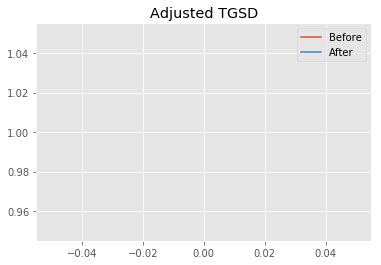

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.2452 	4.6491 	13610.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.39785 	10.6768 	14289.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 5.67503
New Misfit: 3.94334
Convergence:
0.30514278412995754

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.23e+02 	2.64e+02 	1.1823 		1.0000


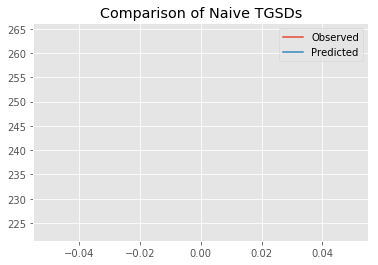

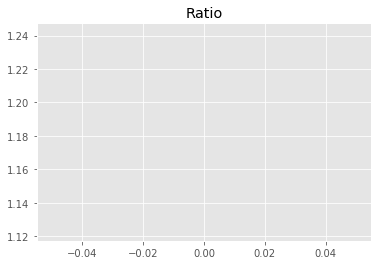

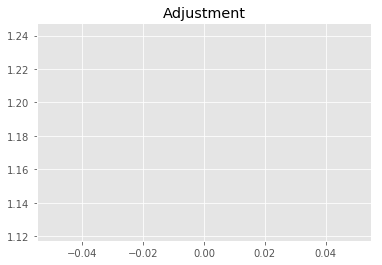

1881736508.9298651
1


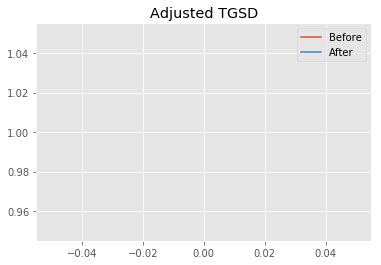

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.39785 	10.6768 	14289.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|85.0303 	64.1359 	7494.83 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.94334
New Misfit: 3.57317
Convergence:
0.0938715256583978

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.38e+02 	2.64e+02 	1.1105 		1.0000


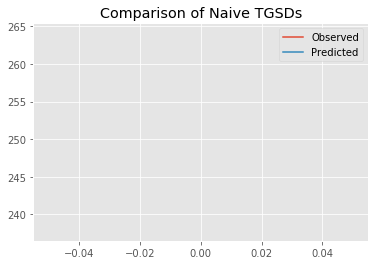

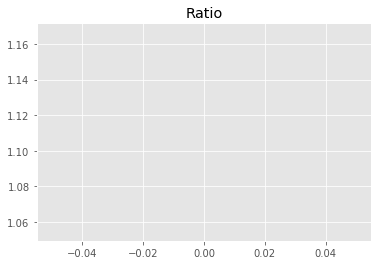

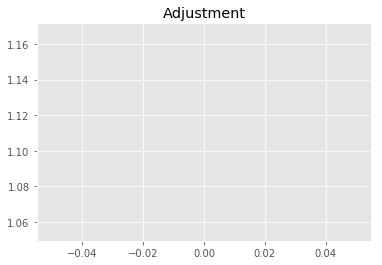

1767529157.744071
1


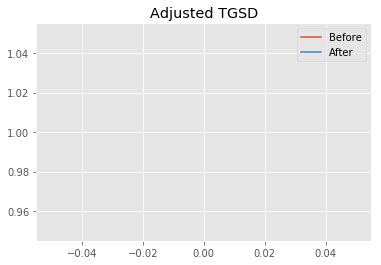

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|85.0303 	64.1359 	7494.83 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|190.343 	30.5274 	6981.82 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.57317
New Misfit: 3.56576
Convergence:
0.0020729878085376657

____________________
a = 190.34294	b = 30.52743	            h1 = 6981.81540	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 3.5657631090792976
Prior Misfit: 501.077,	 Post Misfit: 3.56576


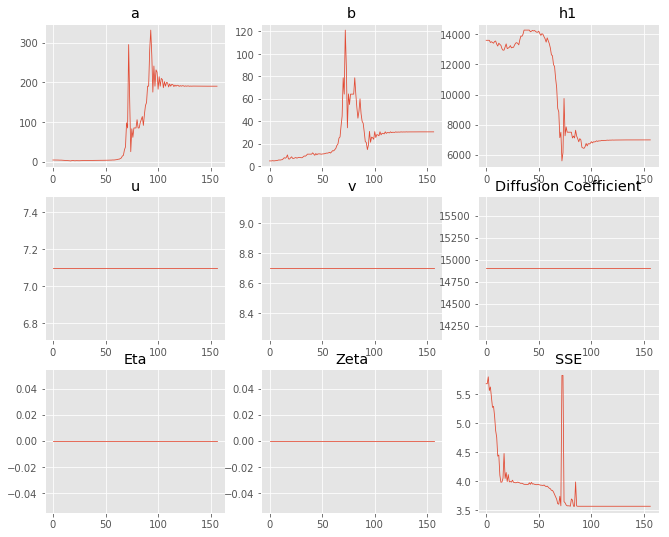

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.2452,190.343
b,4.6491,30.5274
eta,0,0
ftt,"6,458","6,458"
h1,"13,610.4","6,981.82"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 2 Time: 0.076 minutes


Estimated remaining run time: 0.909 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.54e+02 	2.64e+02 	1.7159 		1.0000


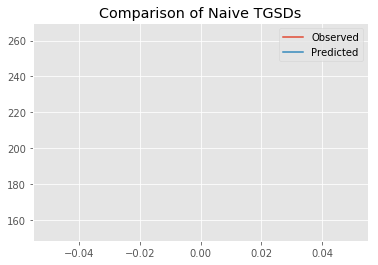

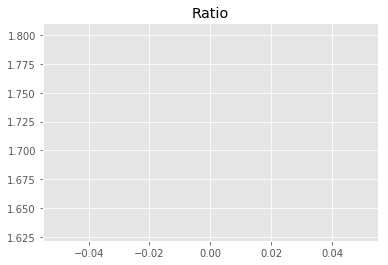

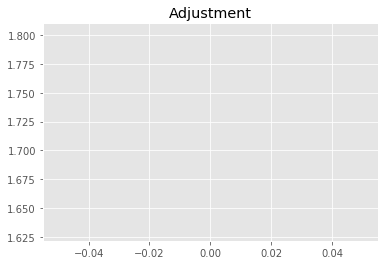

2731153608.8617296
1


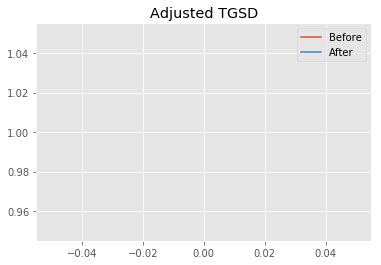

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.88716 	2.07287 	10804.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.88162 	2.05812 	8318.36 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.53855
New Misfit: 3.9169
Convergence:
0.13697205763528955

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.27e+02 	2.64e+02 	1.1658 		1.0000


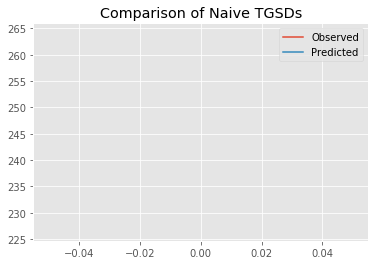

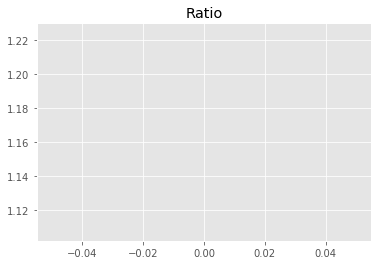

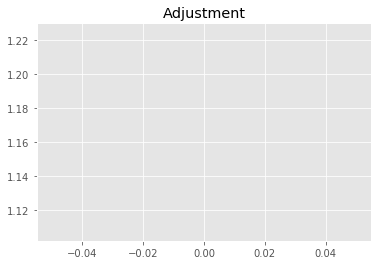

1855469341.3604622
1


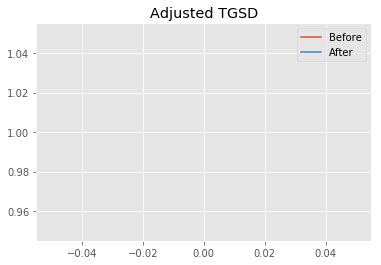

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.88162 	2.05812 	8318.36 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.27002 	2.05829 	8257.37 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.9169
New Misfit: 3.85425
Convergence:
0.0159955701906059

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.34e+02 	2.64e+02 	1.1281 		1.0000


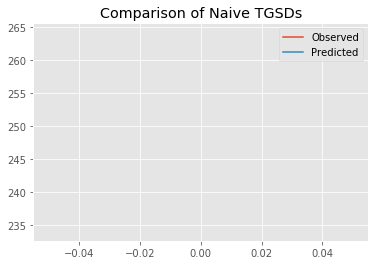

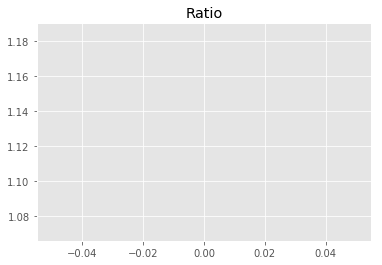

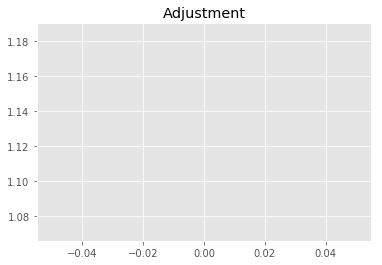

1795503143.9682744
1


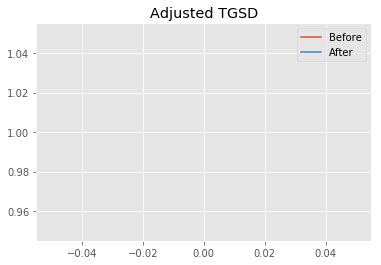

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.27002 	2.05829 	8257.37 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.99203 	1.8977 	8083.57 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.85425
New Misfit: 3.80849
Convergence:
0.011870248153864773

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.14e+02 	2.64e+02 	1.2368 		1.0000


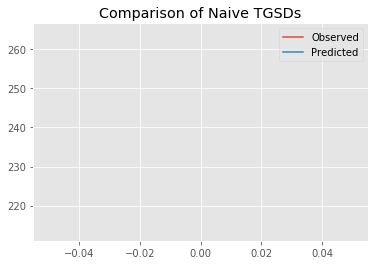

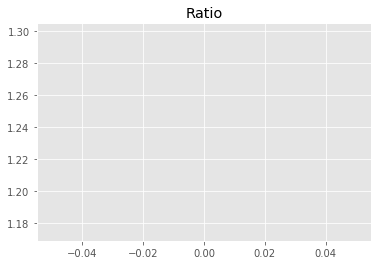

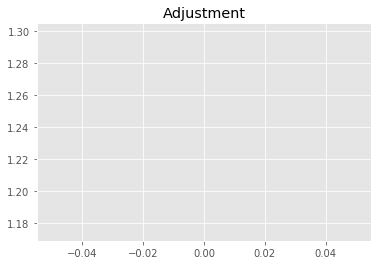

1968549490.478276
1


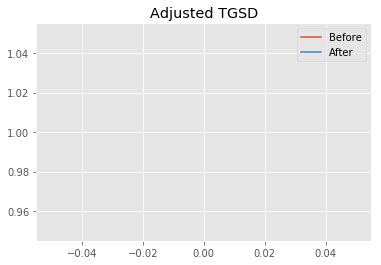

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.99203 	1.8977 	8083.57 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.60687 	1.90785 	7307.67 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.80849
New Misfit: 3.7804
Convergence:
0.007377761301049315

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.20e+02 	2.64e+02 	1.2026 		1.0000


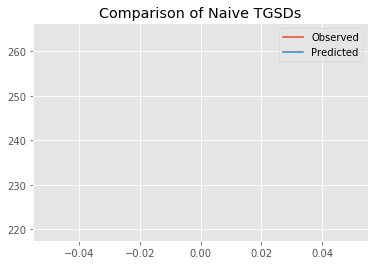

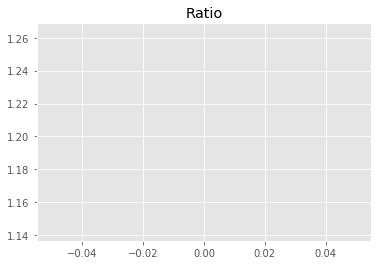

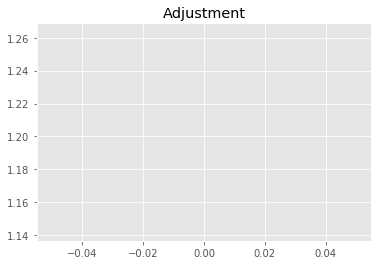

1914145262.630843
1


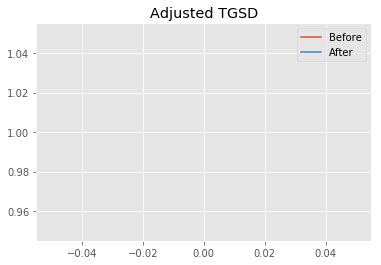

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.60687 	1.90785 	7307.67 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.88395 	1.91836 	7269.87 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.7804
New Misfit: 3.77494
Convergence:
0.0014425385212695984

____________________
a = 3.88395	b = 1.91836	            h1 = 7269.87056	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.7749431563644027
Prior Misfit: 188.236,	 Post Misfit: 3.77494


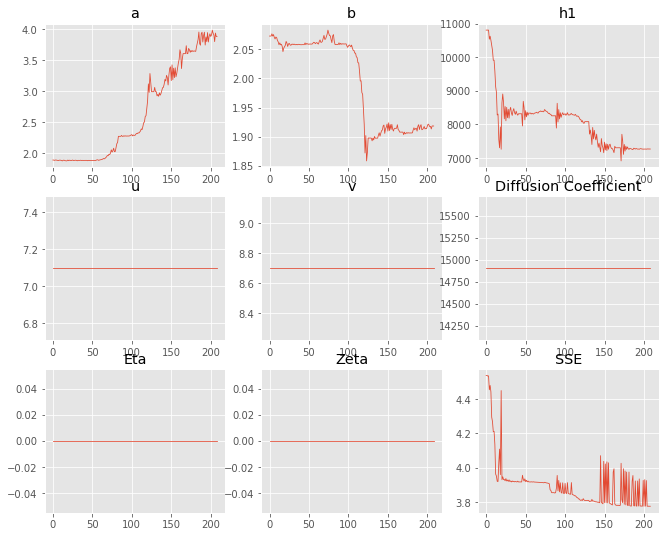

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.88716,3.88395
b,2.07287,1.91836
eta,0,0
ftt,"6,458","6,458"
h1,"10,804.4","7,269.87"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 3 Time: 0.105 minutes


Estimated remaining run time: 1.060 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	9.92e+01 	2.64e+02 	2.6635 		1.0000


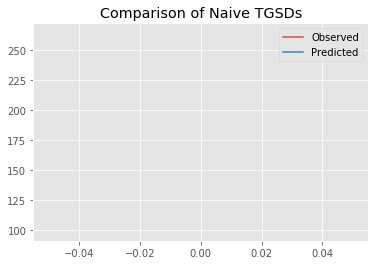

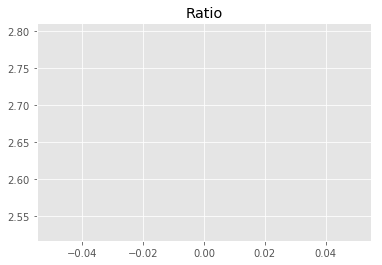

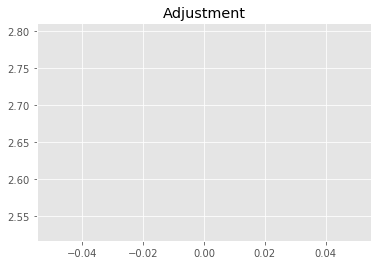

4239270878.8459506
1


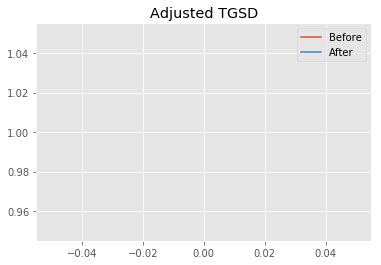

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.55003 	4.87414 	12866.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.8358 	7.03357 	12263.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 5.45239
New Misfit: 3.95339
Convergence:
0.27492489005926346

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.25e+02 	2.64e+02 	1.1738 		1.0000


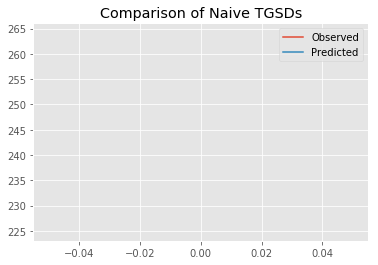

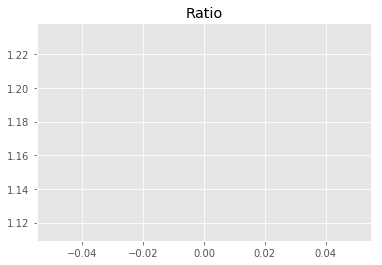

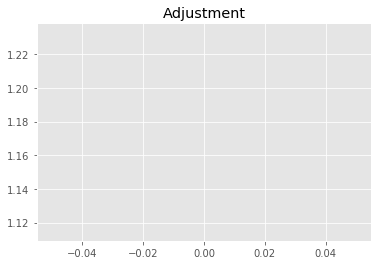

1868195363.9160137
1


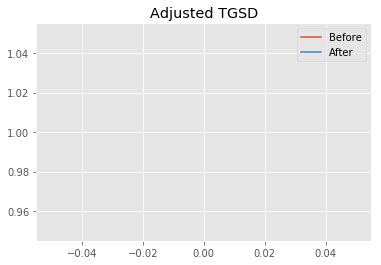

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.8358 	7.03357 	12263.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.9041 	5.9146 	8017.73 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.95339
New Misfit: 3.75779
Convergence:
0.049477073662796155

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.34e+02 	2.64e+02 	1.1288 		1.0000


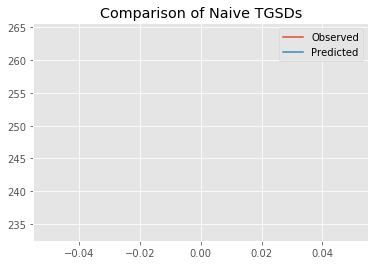

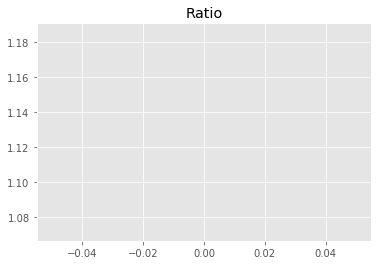

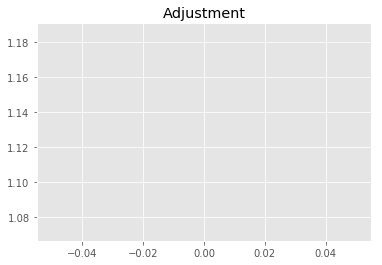

1796600364.1454375
1


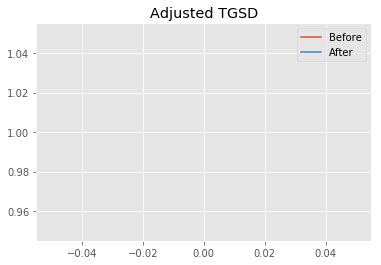

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.9041 	5.9146 	8017.73 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|8.43426 	4.403 	7293 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.75779
New Misfit: 3.69399
Convergence:
0.016978928875046866

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.22e+02 	2.64e+02 	1.1888 		1.0000


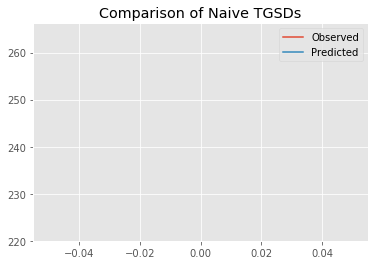

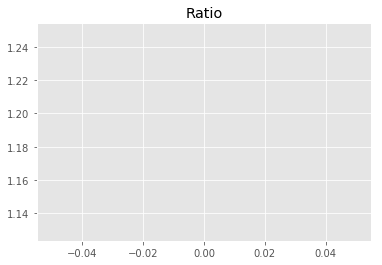

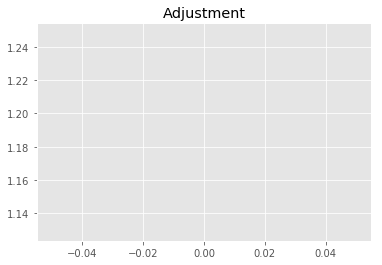

1892099812.5869236
1


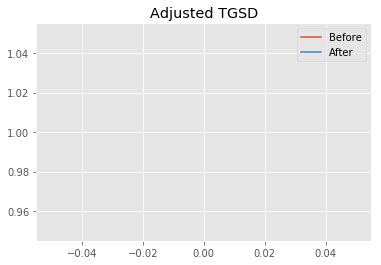

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.43426 	4.403 	7293 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|24.6751 	13.4422 	7289.01 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.69399
New Misfit: 3.59644
Convergence:
0.026407465871834734

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.30e+02 	2.64e+02 	1.1469 		1.0000


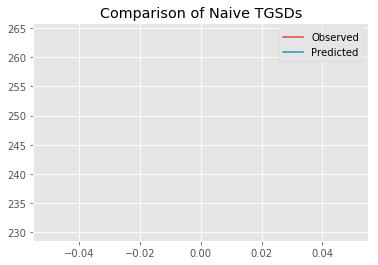

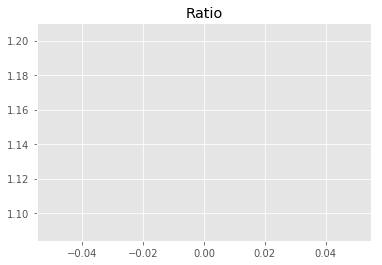

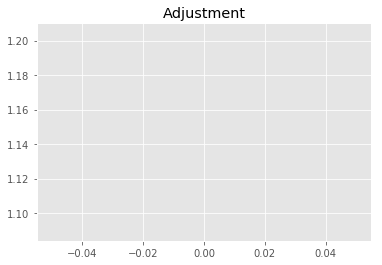

1825516635.3329973
1


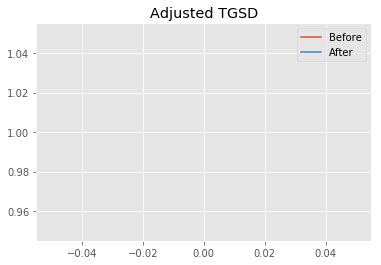

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|24.6751 	13.4422 	7289.01 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|107.886 	3.27996 	6255.09 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.59644
New Misfit: 3.56576
Convergence:
0.00852979285512227

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.37e+02 	2.64e+02 	1.1154 		1.0000


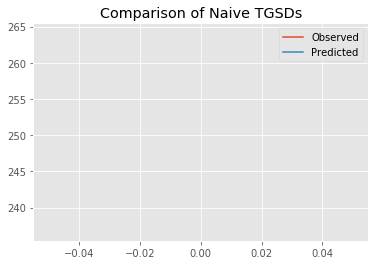

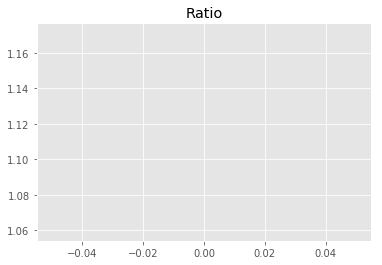

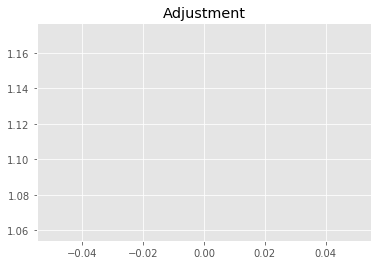

1775317556.9628353
1


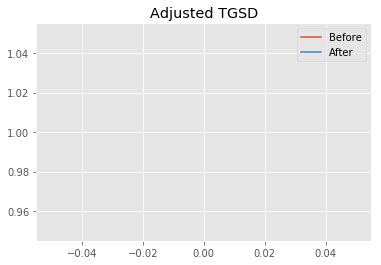

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|107.886 	3.27996 	6255.09 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Optimization terminated successfully.
         Current function value: 3.565763
         Iterations: 16
         Function evaluations: 66
New Total Mass: 1.59164e+09
After: 		|107.886 	3.27996 	6255.09 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.56576
New Misfit: 3.56576
Convergence:
0.0

____________________
a = 107.88640	b = 3.27996	            h1 = 6255.08747	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 3.5657631090792976
Prior Misfit: 418.914,	 Post Misfit: 3.56576


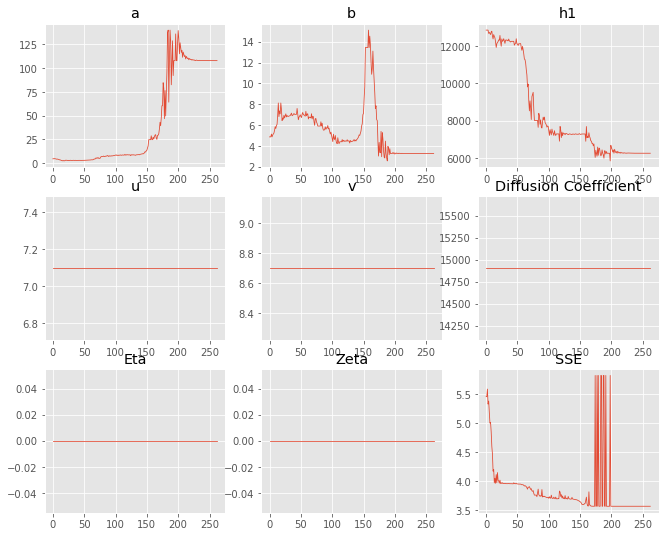

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.55003,107.886
b,4.87414,3.27996
eta,0,0
ftt,"6,458","6,458"
h1,"12,866.4","6,255.09"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 4 Time: 0.134 minutes


Estimated remaining run time: 1.198 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	5.10e+01 	2.64e+02 	5.1796 		1.0000


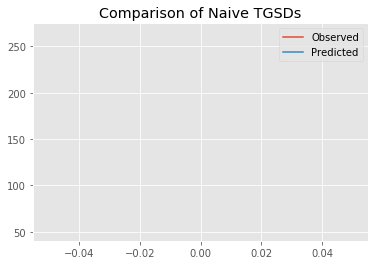

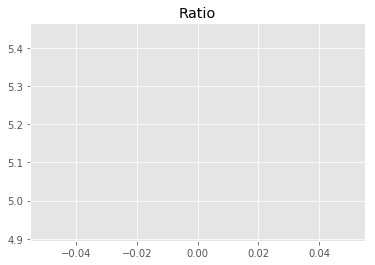

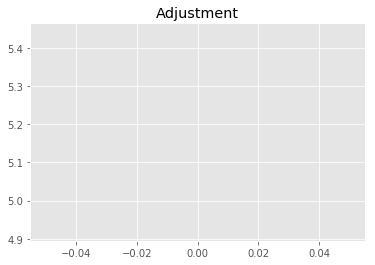

8244039257.043734
1


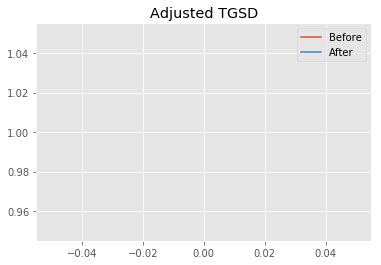

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.86038 	4.84719 	23322.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.52355 	13.0733 	19299.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 6.62128
New Misfit: 4.00711
Convergence:
0.39481298796027253

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.23e+02 	2.64e+02 	1.1831 		1.0000


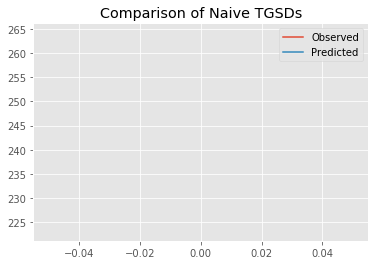

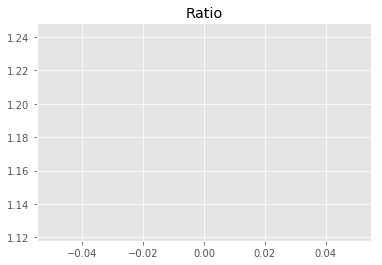

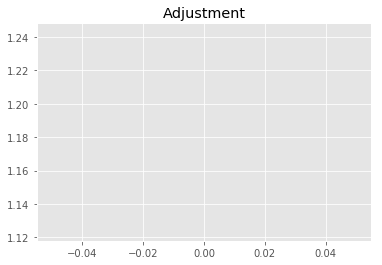

1883056719.4420152
1


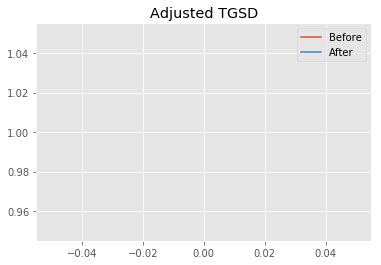

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.52355 	13.0733 	19299.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|9.94691 	12.7289 	9281.56 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.00711
New Misfit: 3.7306
Convergence:
0.06900518338993127

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.28e+02 	2.64e+02 	1.1589 		1.0000


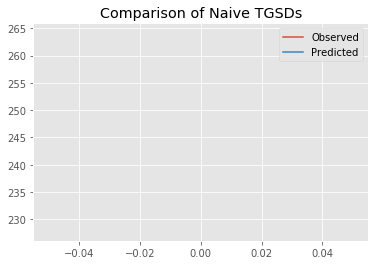

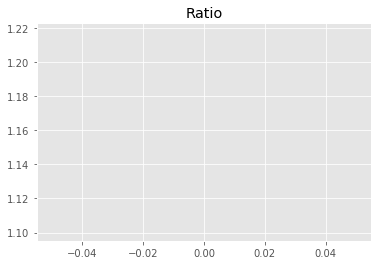

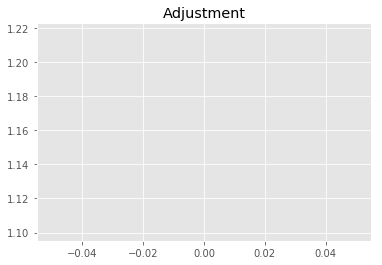

1844564647.007162
1


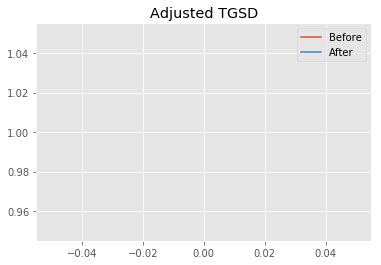

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.94691 	12.7289 	9281.56 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|15.4318 	10.9676 	7556.43 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.7306
New Misfit: 3.66428
Convergence:
0.017776064016169046

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.38e+02 	2.64e+02 	1.1088 		1.0000


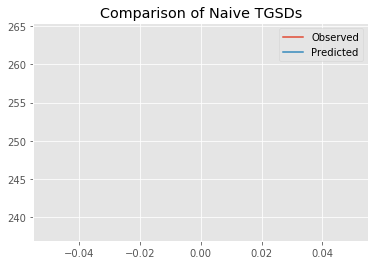

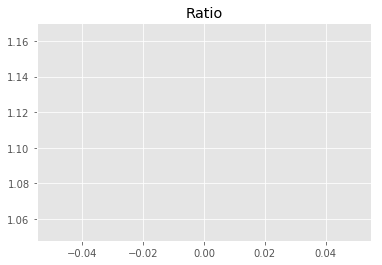

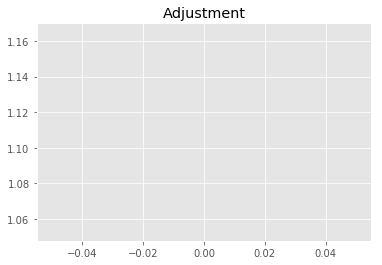

1764875629.9896252
1


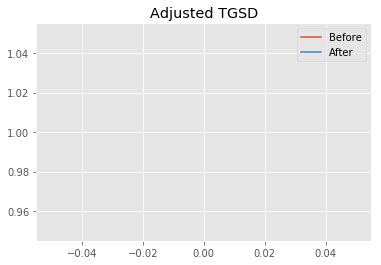

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|15.4318 	10.9676 	7556.43 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|43.5448 	10.6351 	6765.34 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.66428
New Misfit: 3.56586
Convergence:
0.026860578658596035

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.37e+02 	2.64e+02 	1.1153 		1.0000


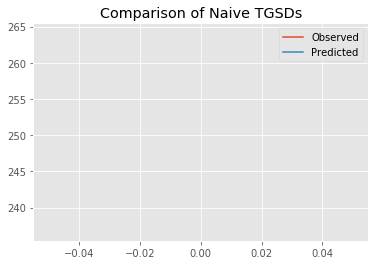

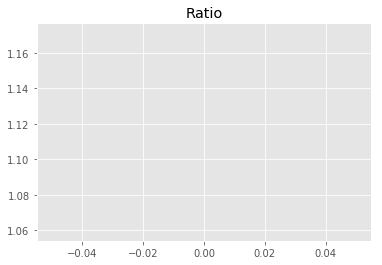

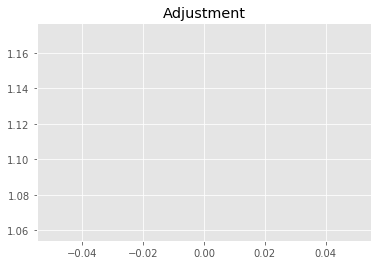

1775212212.12558
1


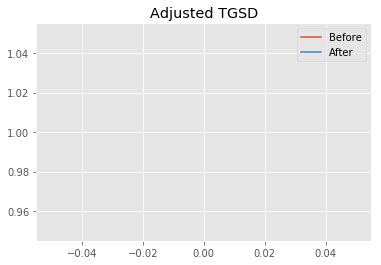

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|43.5448 	10.6351 	6765.34 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|103.073 	5.41543 	7040.32 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.56586
New Misfit: 3.56576
Convergence:
2.6917015276528625e-05

____________________
a = 103.07294	b = 5.41543	            h1 = 7040.32082	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.5657631090792976
Prior Misfit: 1167.44,	 Post Misfit: 3.56576


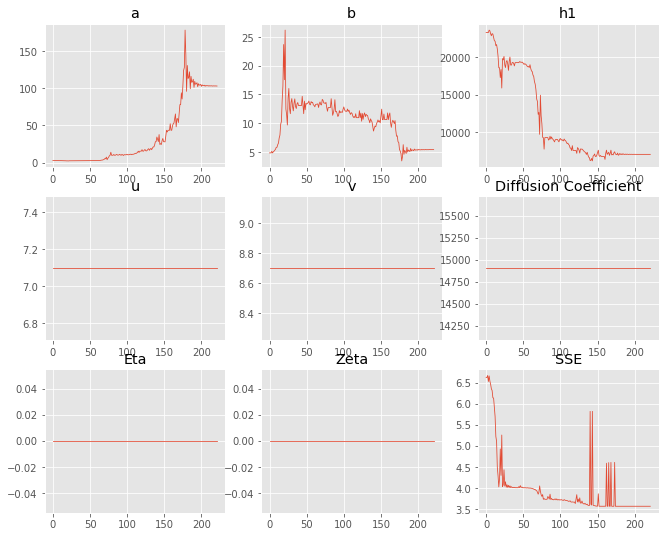

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.86038,103.073
b,4.84719,5.41543
eta,0,0
ftt,"6,458","6,458"
h1,"23,322.8","7,040.32"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 5 Time: 0.111 minutes


Estimated remaining run time: 1.192 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	5.70e+01 	2.64e+02 	4.6341 		1.0000


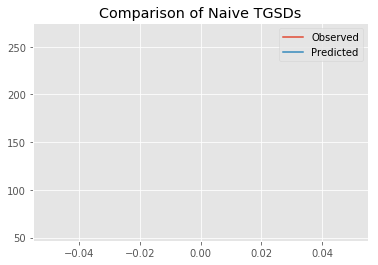

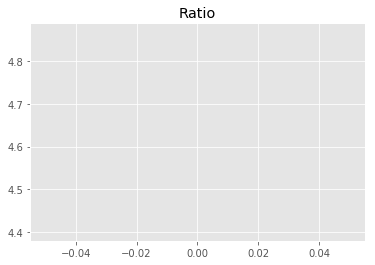

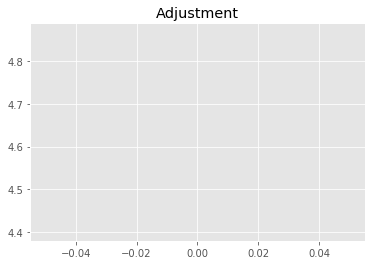

7375818311.768392
1


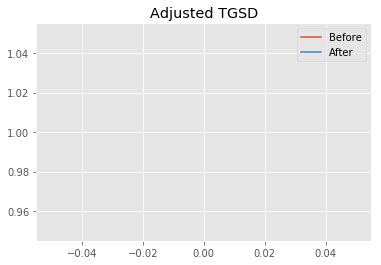

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.30767 	3.73077 	41593.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.19167 	6.86611 	17171.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 6.54529
New Misfit: 4.08671
Convergence:
0.37562523836752126

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.32e+02 	2.64e+02 	1.1397 		1.0000


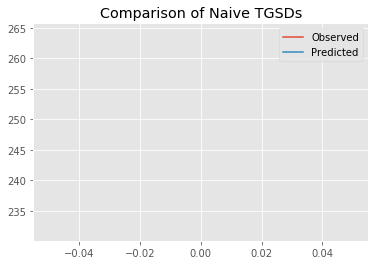

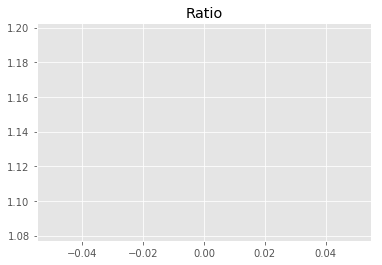

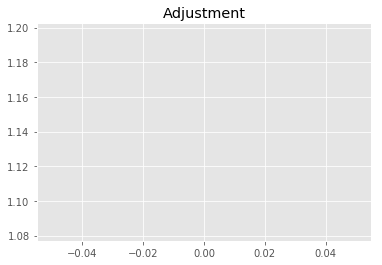

1814006132.0278187
1


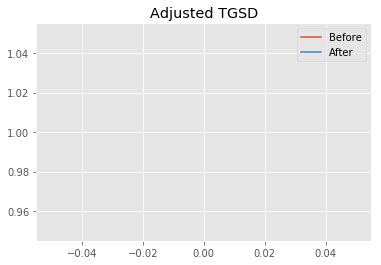

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19167 	6.86611 	17171.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.85686 	8.44431 	17462 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.08671
New Misfit: 4.04814
Convergence:
0.009438886394743147

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.17e+02 	2.64e+02 	1.2151 		1.0000


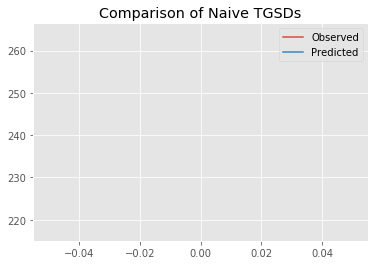

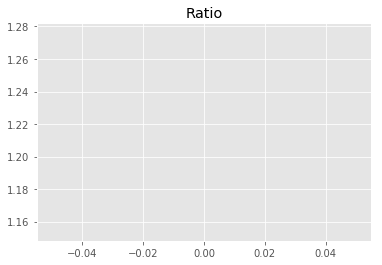

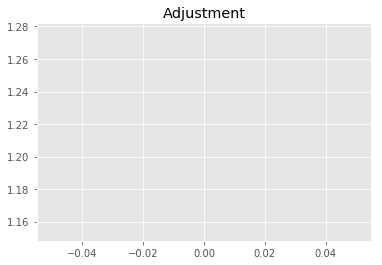

1933943091.6886075
1


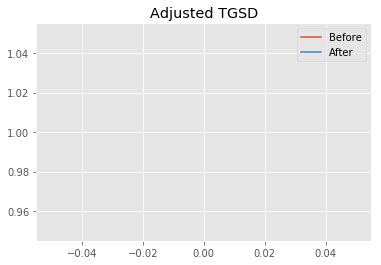

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.85686 	8.44431 	17462 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.88388 	9.13801 	17496.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.04814
New Misfit: 4.03802
Convergence:
0.0024985504607914063

____________________
a = 1.88388	b = 9.13801	            h1 = 17496.65746	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 4.038022806727595
Prior Misfit: 1039.13,	 Post Misfit: 4.03802


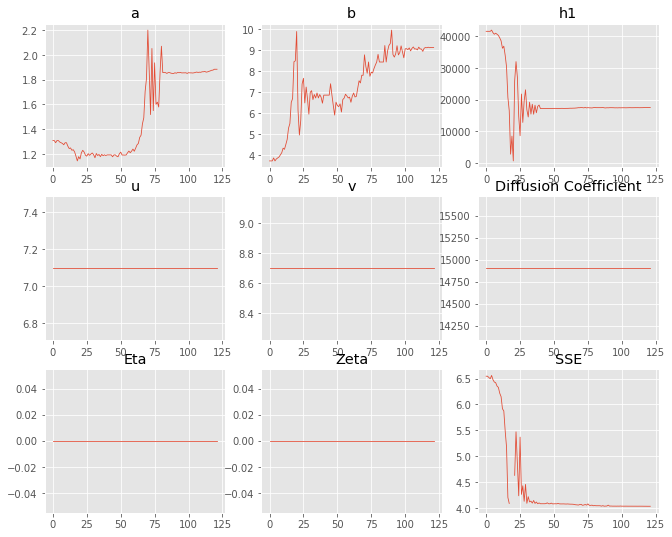

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.30767,1.88388
b,3.73077,9.13801
eta,0,0
ftt,"6,458","6,458"
h1,"41,593.7","17,496.7"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 6 Time: 0.067 minutes


Estimated remaining run time: 1.073 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.42e+02 	2.64e+02 	1.8566 		1.0000


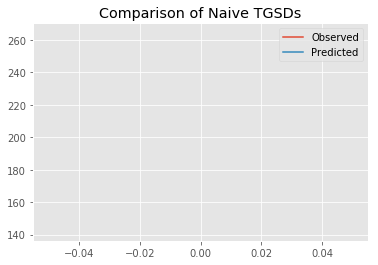

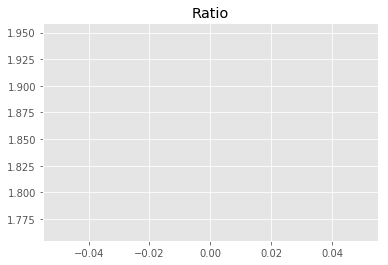

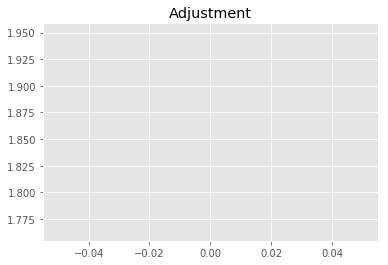

2955030695.0369763
1


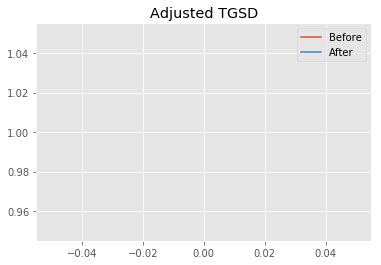

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.4736 	4.51938 	19951.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.4365 	7.61505 	17841.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.81331
New Misfit: 4.06955
Convergence:
0.1545211019640326

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.24e+02 	2.64e+02 	1.1807 		1.0000


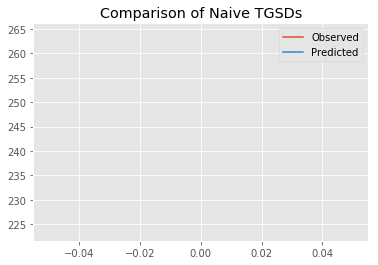

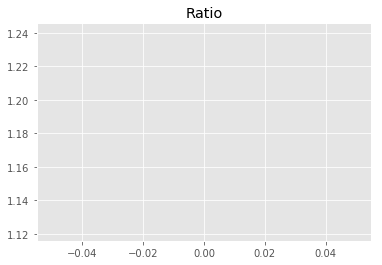

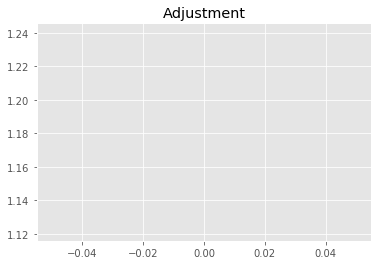

1879309579.019086
1


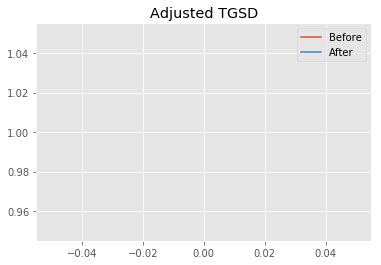

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.4365 	7.61505 	17841.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.20988 	18.6837 	18584.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.06955
New Misfit: 3.93673
Convergence:
0.0326385484498777

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.16e+02 	2.64e+02 	1.2246 		1.0000


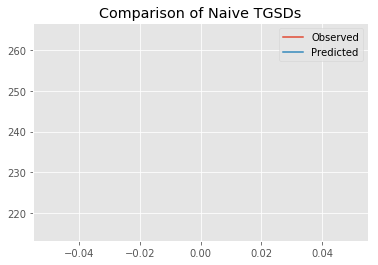

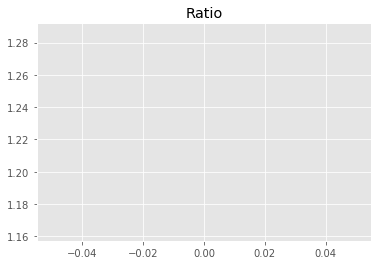

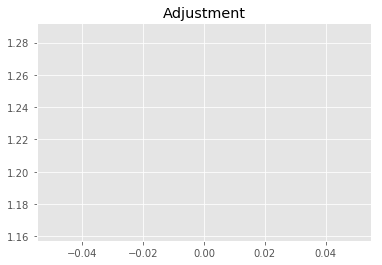

1949058655.5142283
1


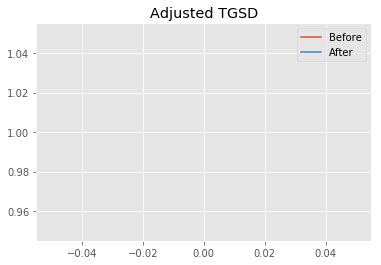

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.20988 	18.6837 	18584.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|15.1044 	62.0112 	17357.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.93673
New Misfit: 3.72221
Convergence:
0.05449200720503239

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.21e+02 	2.64e+02 	1.1965 		1.0000


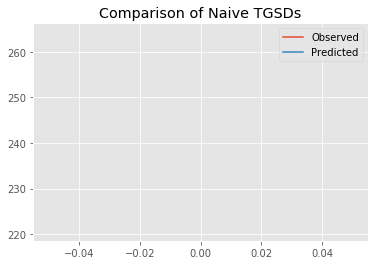

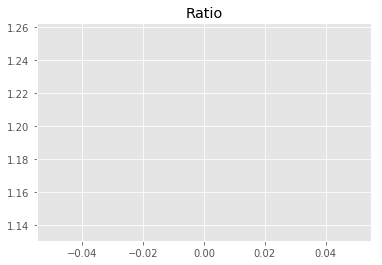

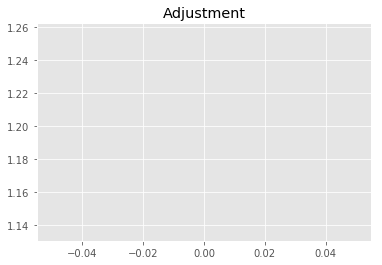

1904388233.1496842
1


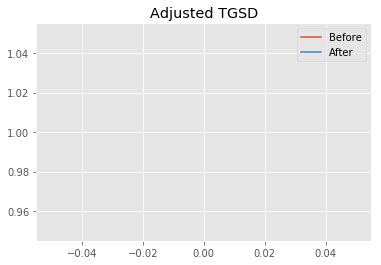

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|15.1044 	62.0112 	17357.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|31.8328 	135.231 	17422.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.72221
New Misfit: 3.63533
Convergence:
0.023339839665938725

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.26e+02 	2.64e+02 	1.1703 		1.0000


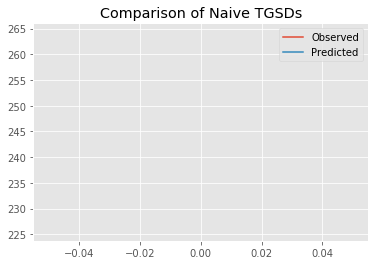

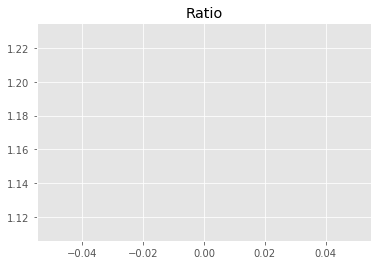

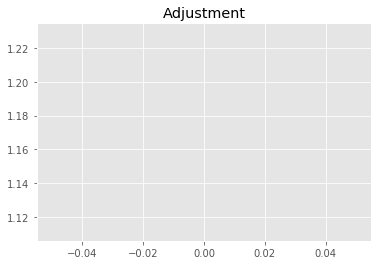

1862661399.4482563
1


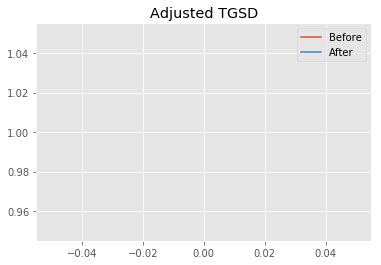

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|31.8328 	135.231 	17422.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4330.09 	13010 	13359.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.63533
New Misfit: 3.56576
Convergence:
0.019137095373050392

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.37e+02 	2.64e+02 	1.1154 		1.0000


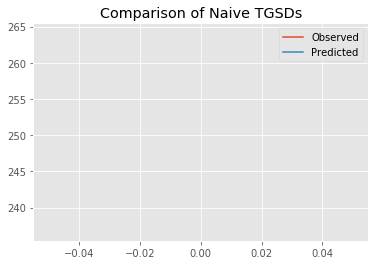

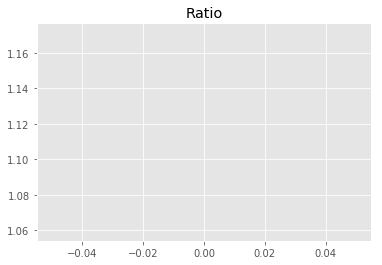

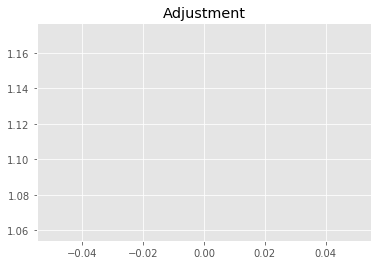

1775317556.9628358
1


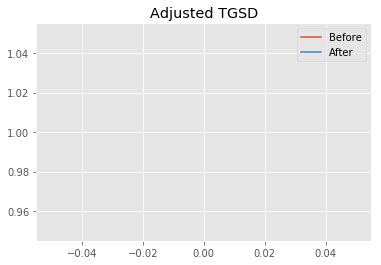

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4330.09 	13010 	13359.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Optimization terminated successfully.
         Current function value: 3.565763
         Iterations: 17
         Function evaluations: 68
New Total Mass: 1.59164e+09
After: 		|4330.09 	13010 	13359.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.56576
New Misfit: 3.56576
Convergence:
0.0

____________________
a = 4330.09314	b = 13010.04456	            h1 = 13359.76607	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 3.5657631090792976
Prior Misfit: 232.991,	 Post Misfit: 3.56576


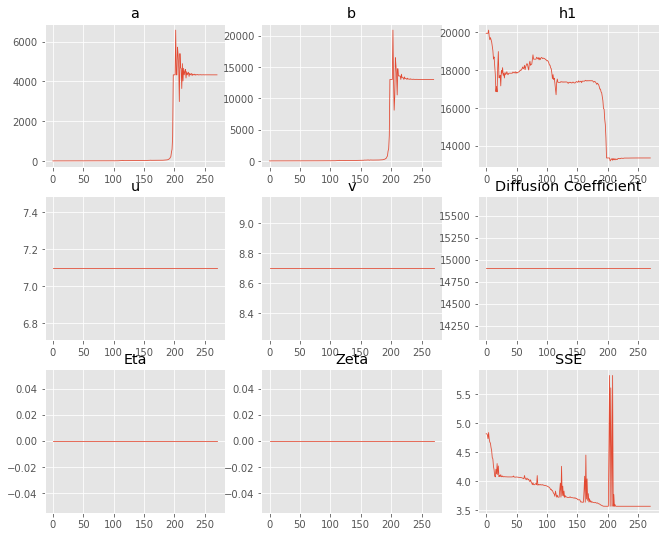

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.4736,"4,330.09"
b,4.51938,"13,010"
eta,0,0
ftt,"6,458","6,458"
h1,"19,951.9","13,359.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 7 Time: 0.133 minutes


Estimated remaining run time: 1.065 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.86e+02 	2.64e+02 	1.4198 		1.0000


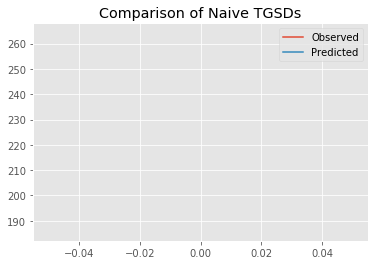

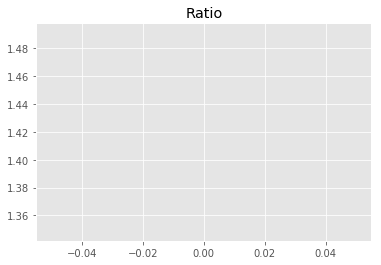

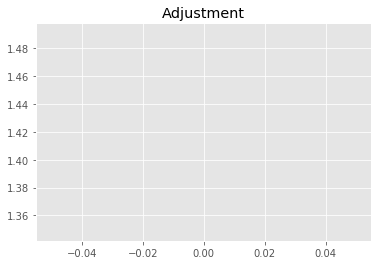

2259861360.5589643
1


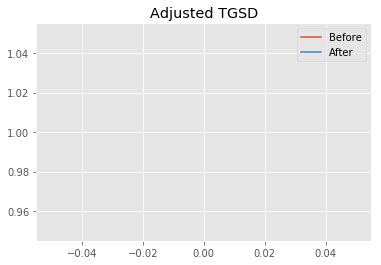

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.23647 	2.19853 	11306 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.23465 	2.16241 	9338.13 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.21407
New Misfit: 3.9808
Convergence:
0.05535527044258308

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.33e+02 	2.64e+02 	1.1355 		1.0000


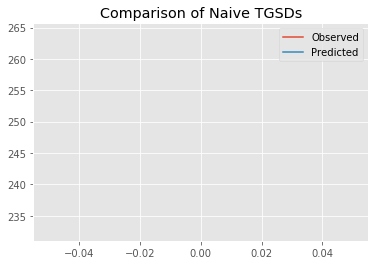

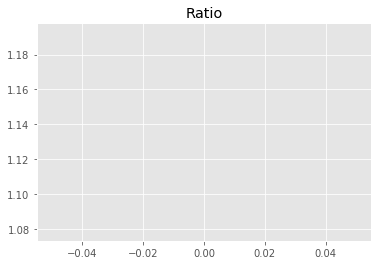

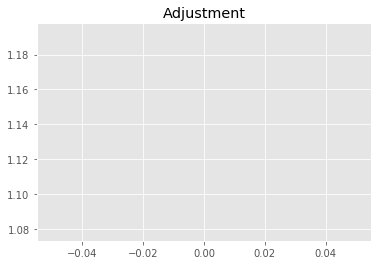

1807336859.2717416
1


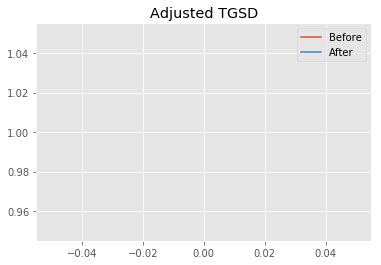

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.23465 	2.16241 	9338.13 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.8112 	2.20954 	9132.53 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.9808
New Misfit: 3.94386
Convergence:
0.009278929268723481

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.15e+02 	2.64e+02 	1.2302 		1.0000


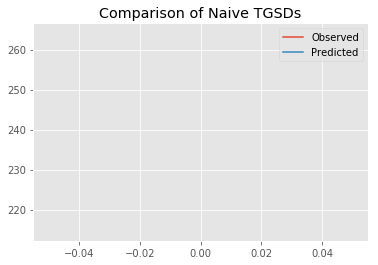

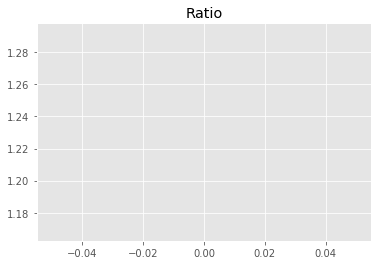

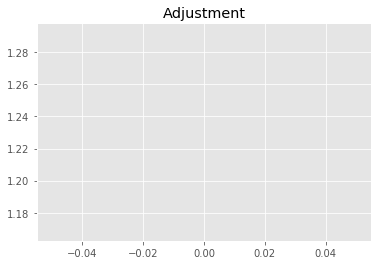

1958084474.3262107
1


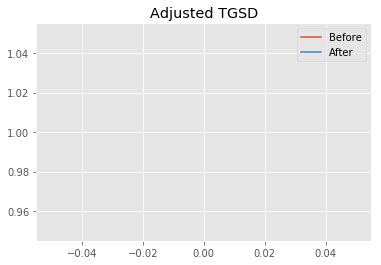

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.8112 	2.20954 	9132.53 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.41904 	2.70201 	8471.74 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.94386
New Misfit: 3.90033
Convergence:
0.011036324788647233

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.30e+02 	2.64e+02 	1.1496 		1.0000


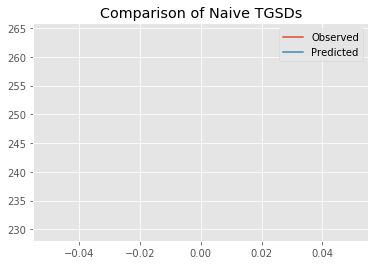

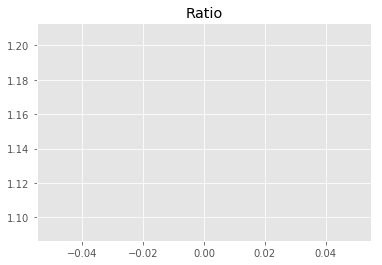

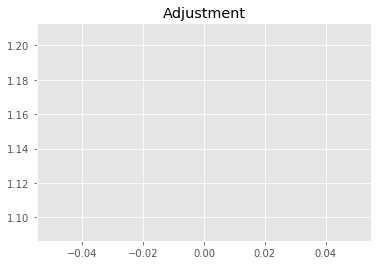

1829741288.8950815
1


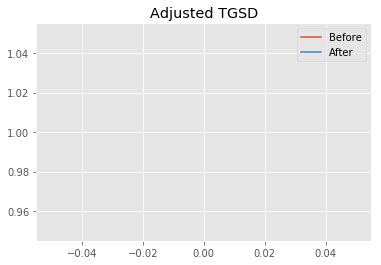

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.41904 	2.70201 	8471.74 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.17979 	1.61582 	7312.91 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.90033
New Misfit: 3.79393
Convergence:
0.027280868428940168

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.15e+02 	2.64e+02 	1.2262 		1.0000


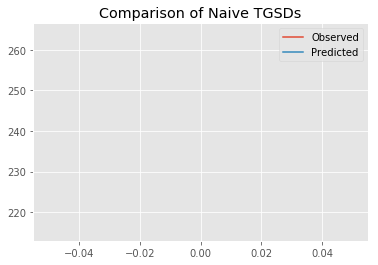

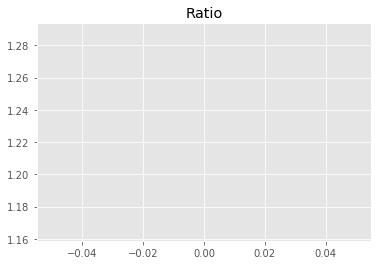

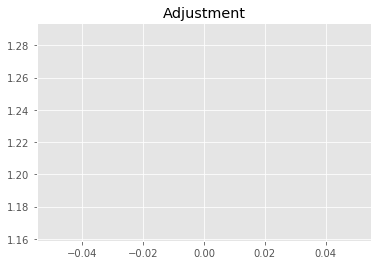

1951689085.8082676
1


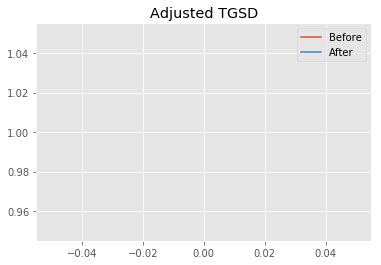

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.17979 	1.61582 	7312.91 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.58781 	2.39422 	7283.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.79393
New Misfit: 3.75708
Convergence:
0.00971144289262352

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.21e+02 	2.64e+02 	1.1945 		1.0000


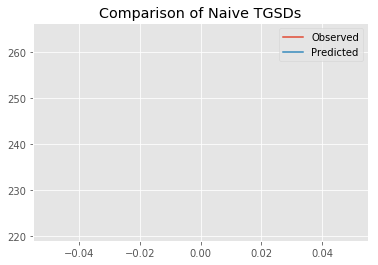

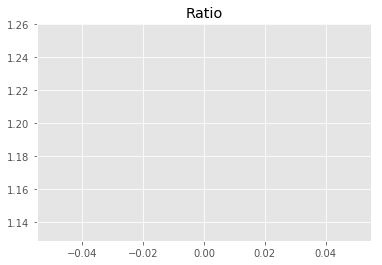

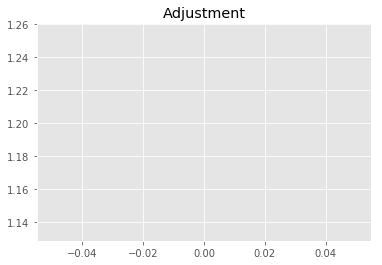

1901214571.87155
1


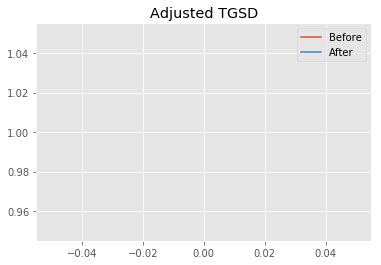

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.58781 	2.39422 	7283.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.94769 	2.46948 	7272.84 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.75708
New Misfit: 3.75088
Convergence:
0.0016509974295189306

____________________
a = 4.94769	b = 2.46948	            h1 = 7272.83883	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 3.7508810811996356
Prior Misfit: 138.488,	 Post Misfit: 3.75088


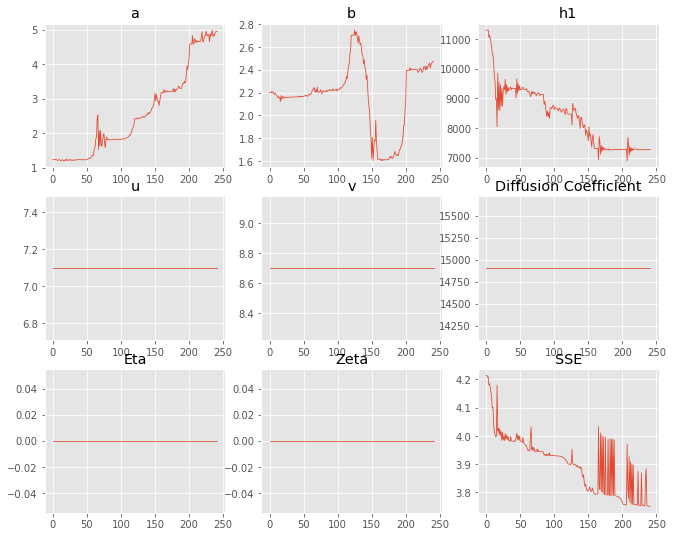

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.23647,4.94769
b,2.19853,2.46948
eta,0,0
ftt,"6,458","6,458"
h1,"11,306","7,272.84"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 8 Time: 0.123 minutes


Estimated remaining run time: 1.019 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	6.35e+01 	2.64e+02 	4.1561 		1.0000


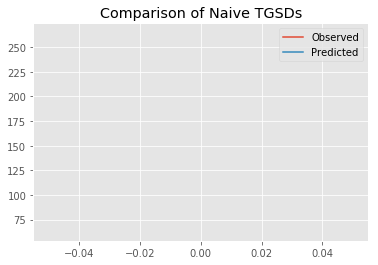

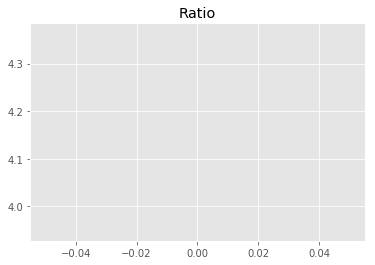

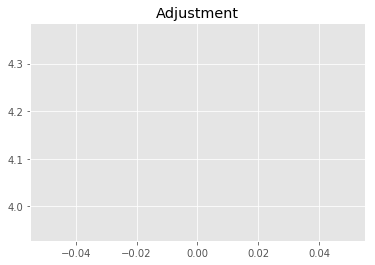

6615028301.769539
1


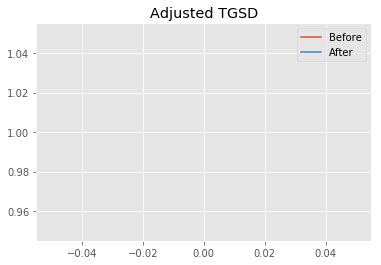

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.72455 	1.79151 	13328.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.36158 	1.65905 	8367.75 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 6.29911
New Misfit: 3.94682
Convergence:
0.37343090607378776

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.24e+02 	2.64e+02 	1.1773 		1.0000


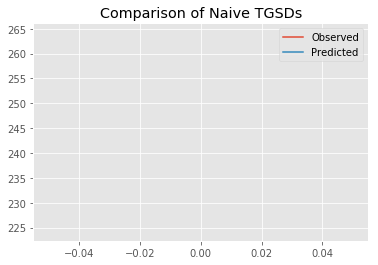

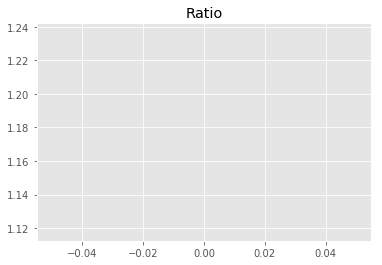

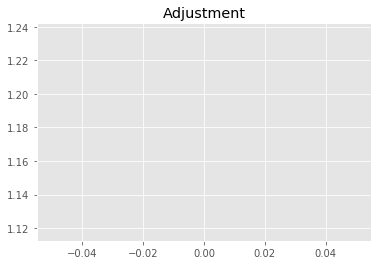

1873762391.690372
1


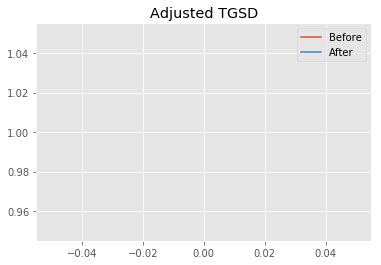

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.36158 	1.65905 	8367.75 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.32977 	1.48751 	8207.89 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.94682
New Misfit: 3.81929
Convergence:
0.032312390483860025

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.17e+02 	2.64e+02 	1.2192 		1.0000


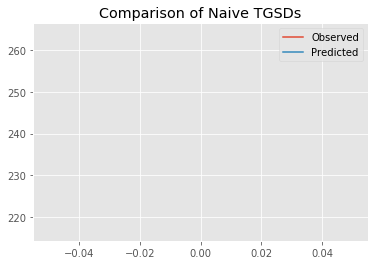

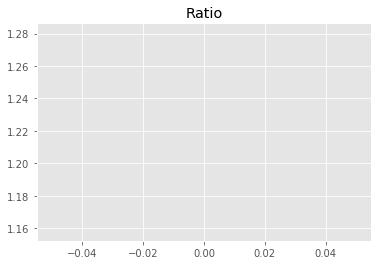

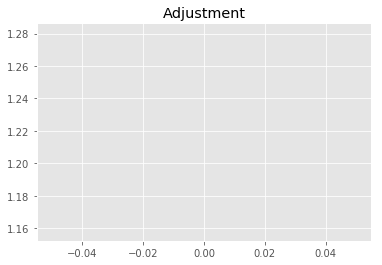

1940557292.1781642
1


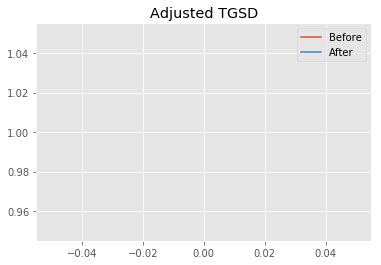

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.32977 	1.48751 	8207.89 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.87492 	2.99382 	8170.61 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.81929
New Misfit: 3.78969
Convergence:
0.007750805937897423

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.21e+02 	2.64e+02 	1.1930 		1.0000


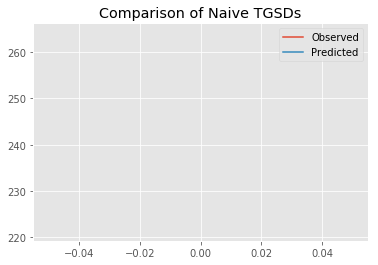

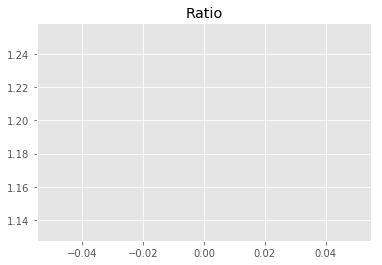

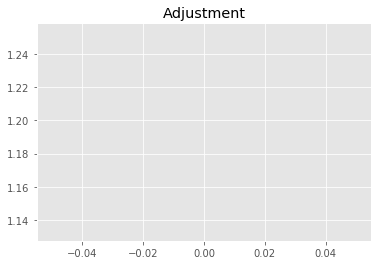

1898804746.2674253
1


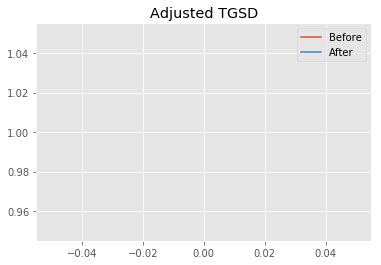

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.87492 	2.99382 	8170.61 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.36791 	2.69351 	7274.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.78969
New Misfit: 3.74241
Convergence:
0.012477131342603538

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.19e+02 	2.64e+02 	1.2077 		1.0000


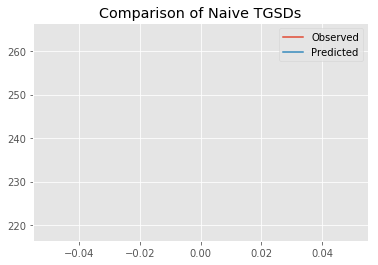

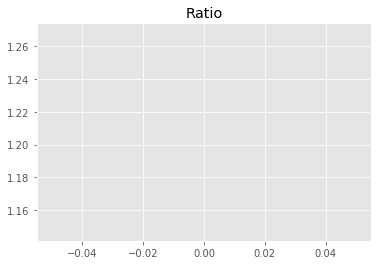

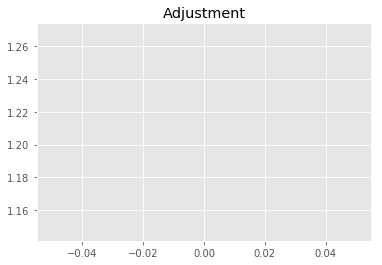

1922162174.0720787
1


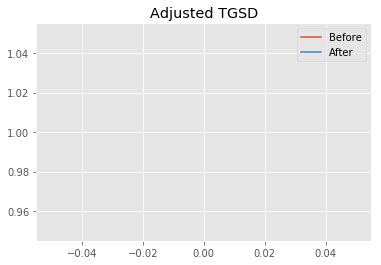

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.36791 	2.69351 	7274.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|8.14432 	3.99161 	7300.19 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.74241
New Misfit: 3.70709
Convergence:
0.009436393907222297

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.15e+02 	2.64e+02 	1.2257 		1.0000


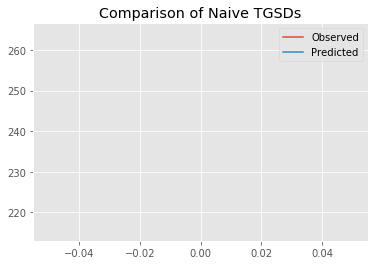

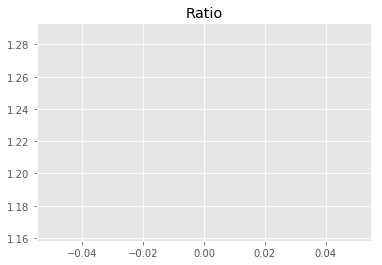

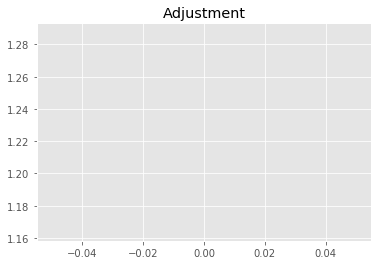

1950821517.3570426
1


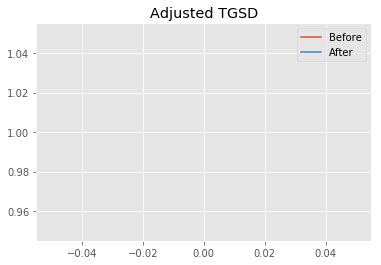

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.14432 	3.99161 	7300.19 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|8.85576 	4.54446 	7269.51 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.70709
New Misfit: 3.68787
Convergence:
0.005185270713643011

____________________
a = 8.85576	b = 4.54446	            h1 = 7269.50620	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 3.6878690937073926
Prior Misfit: 854.367,	 Post Misfit: 3.68787


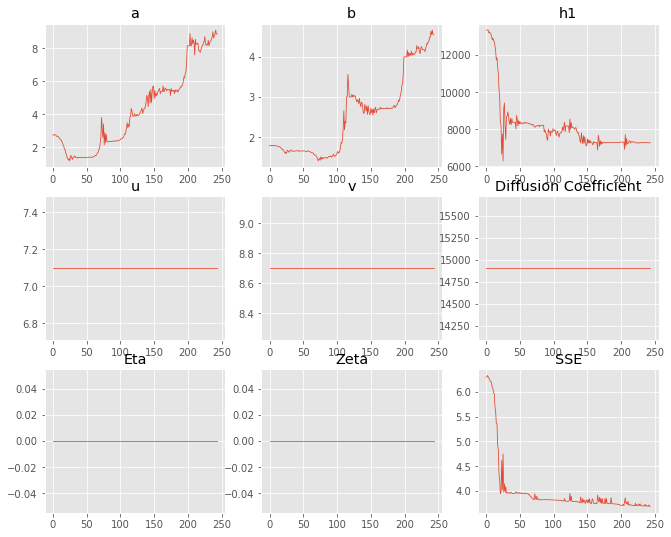

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.72455,8.85576
b,1.79151,4.54446
eta,0,0
ftt,"6,458","6,458"
h1,"13,328.5","7,269.51"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 9 Time: 0.124 minutes


Estimated remaining run time: 0.957 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.30e+02 	2.64e+02 	2.0338 		1.0000


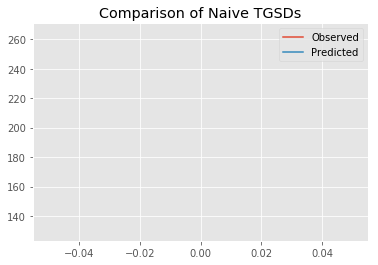

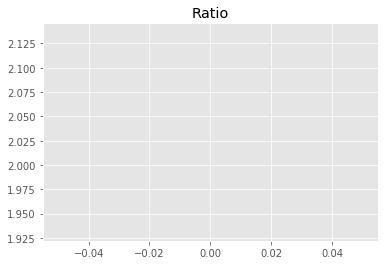

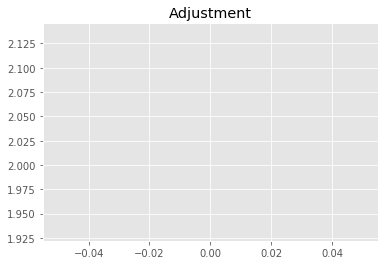

3237138398.7585855
1


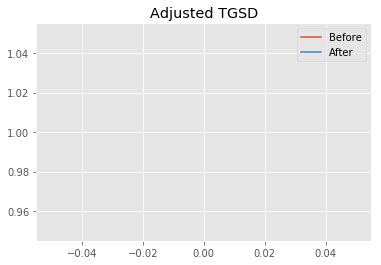

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.17496 	4.64572 	13486 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.56266 	6.83788 	12791.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.89656
New Misfit: 3.97291
Convergence:
0.1886320676401523

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.22e+02 	2.64e+02 	1.1885 		1.0000


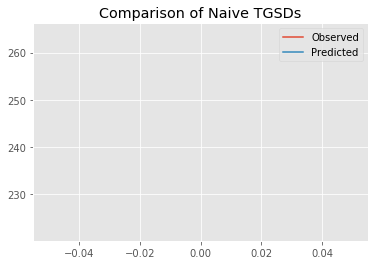

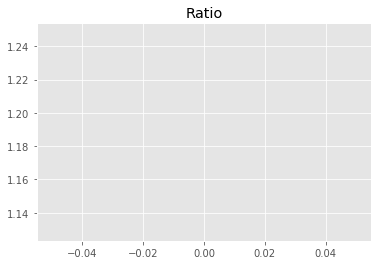

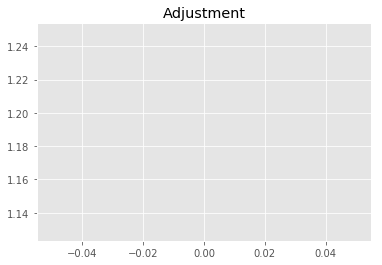

1891599608.8824637
1


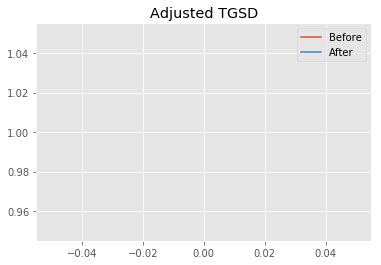

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.56266 	6.83788 	12791.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|11.8697 	7.65296 	7273.59 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.97291
New Misfit: 3.7185
Convergence:
0.06403622063935757

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.45e+02 	2.64e+02 	1.0777 		1.0000


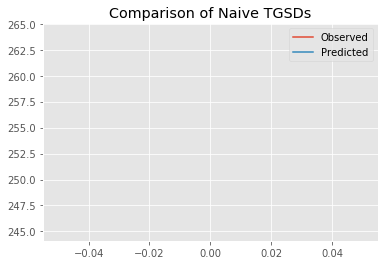

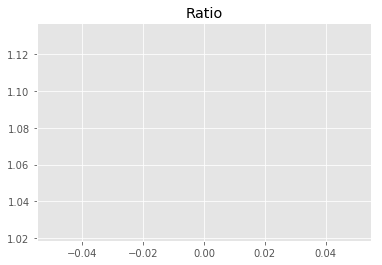

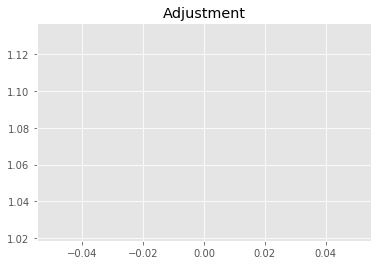

1715284542.3188975
1


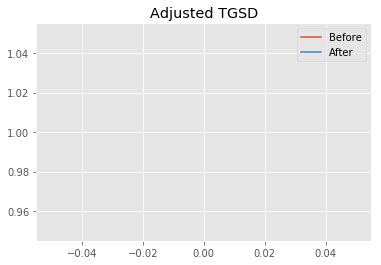

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|11.8697 	7.65296 	7273.59 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|14.2962 	7.62982 	7280.93 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.7185
New Misfit: 3.63891
Convergence:
0.021403390703601824

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.27e+02 	2.64e+02 	1.1659 		1.0000


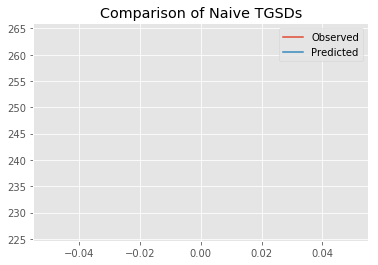

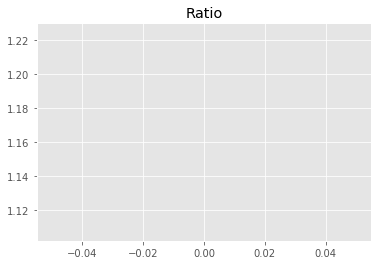

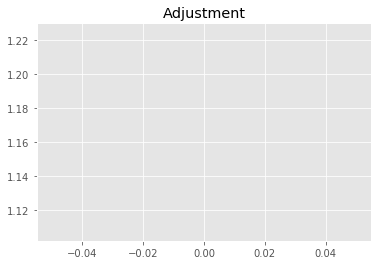

1855741609.4929538
1


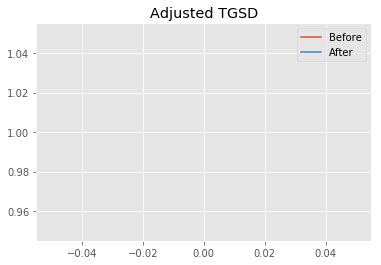

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|14.2962 	7.62982 	7280.93 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|30.0162 	20.5174 	7724.96 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.63891
New Misfit: 3.59489
Convergence:
0.012097017810262187

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.27e+02 	2.64e+02 	1.1627 		1.0000


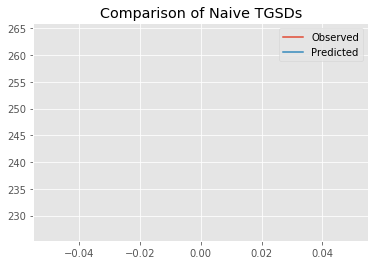

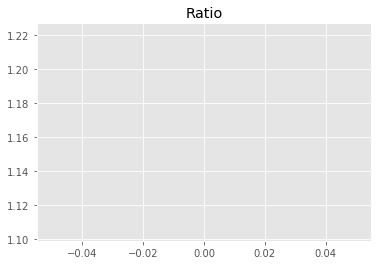

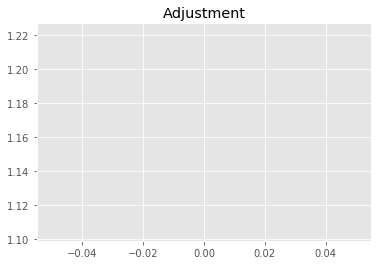

1850665213.241054
1


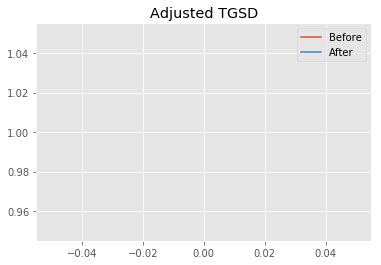

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|30.0162 	20.5174 	7724.96 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|130.882 	14.5537 	6567.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.59489
New Misfit: 3.56576
Convergence:
0.008103113170771737

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.37e+02 	2.64e+02 	1.1154 		1.0000


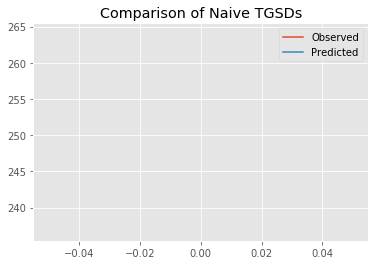

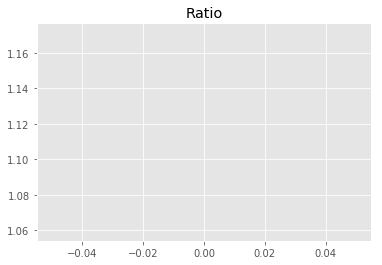

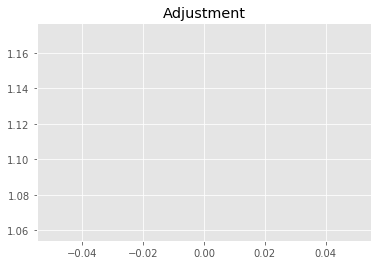

1775317556.962835
1


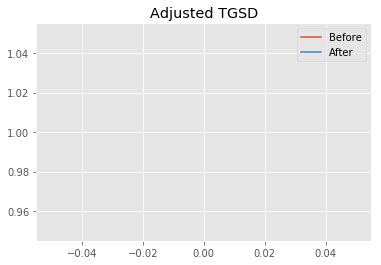

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|130.882 	14.5537 	6567.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Optimization terminated successfully.
         Current function value: 3.565763
         Iterations: 14
         Function evaluations: 58
New Total Mass: 1.59164e+09
After: 		|166.664 	14.5537 	6567.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.56576
New Misfit: 3.56576
Convergence:
1.245425442647336e-16

____________________
a = 166.66362	b = 14.55368	            h1 = 6567.49744	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 3.5657631090792976
Prior Misfit: 256.827,	 Post Misfit: 3.56576


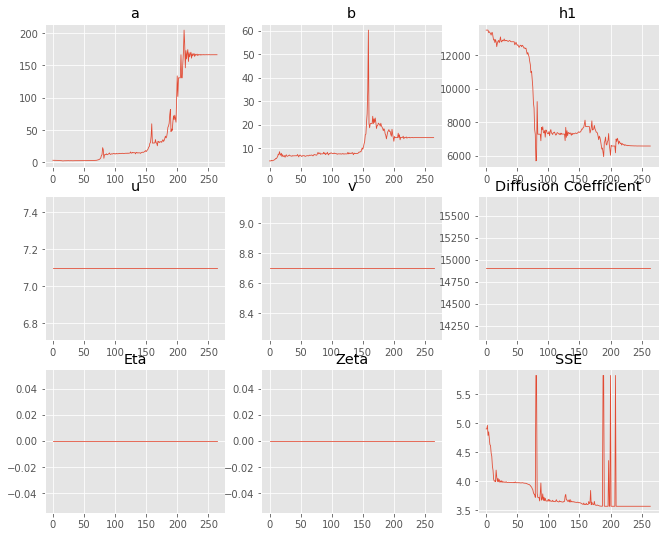

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.17496,166.664
b,4.64572,14.5537
eta,0,0
ftt,"6,458","6,458"
h1,"13,486","6,567.5"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 10 Time: 0.132 minutes


Estimated remaining run time: 0.891 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.17e+02 	2.64e+02 	2.2599 		1.0000


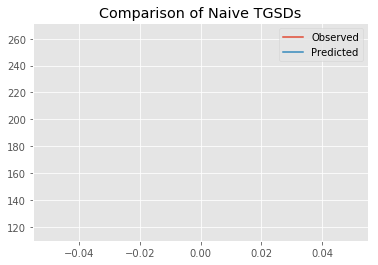

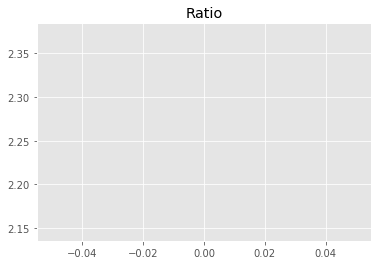

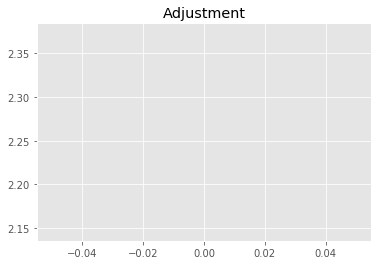

3596997783.5466757
1


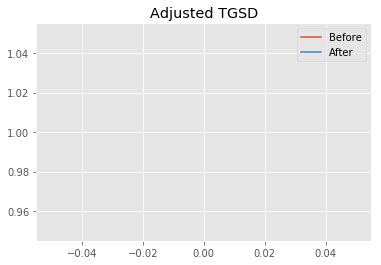

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.2068 	2.30779 	10521.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.62435 	2.36584 	8303.74 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 5.10391
New Misfit: 3.83994
Convergence:
0.24764755769770846

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.32e+02 	2.64e+02 	1.1363 		1.0000


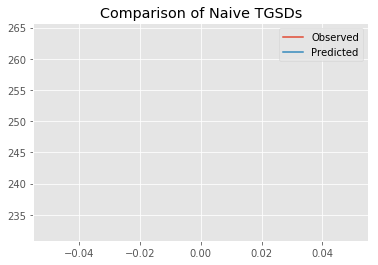

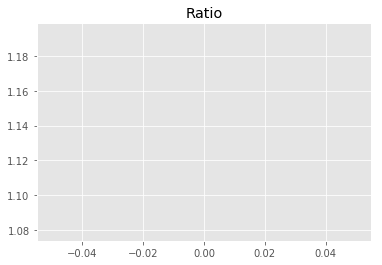

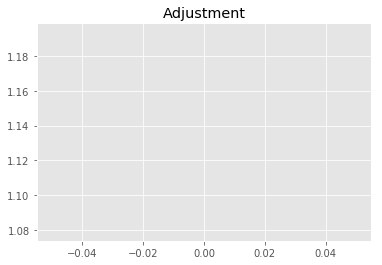

1808553497.4034092
1


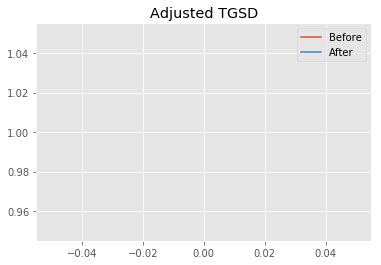

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.62435 	2.36584 	8303.74 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.37209 	2.20476 	8058.66 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.83994
New Misfit: 3.80077
Convergence:
0.010200765861351942

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.14e+02 	2.64e+02 	1.2344 		1.0000


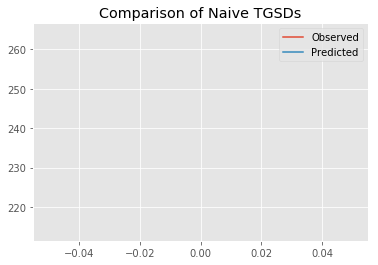

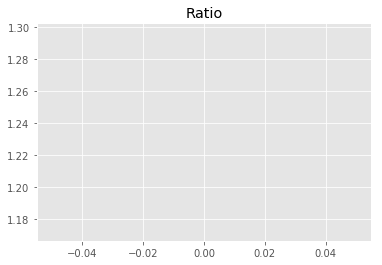

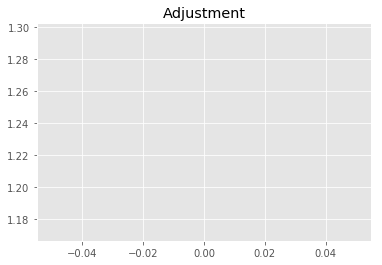

1964768041.5347502
1


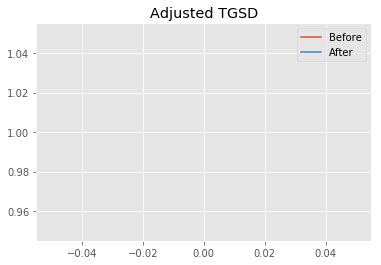

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.37209 	2.20476 	8058.66 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.2858 	2.1477 	7271.18 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.80077
New Misfit: 3.7645
Convergence:
0.009541406312954477

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.18e+02 	2.64e+02 	1.2117 		1.0000


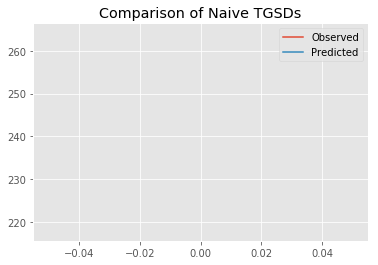

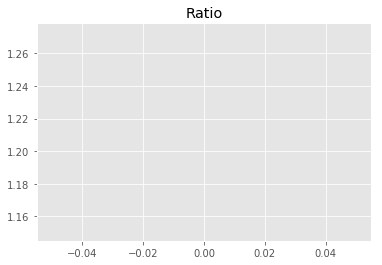

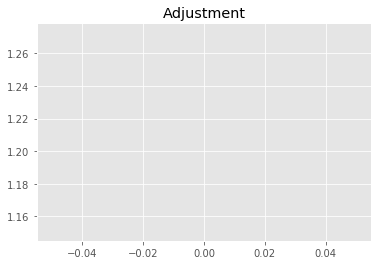

1928604628.9280574
1


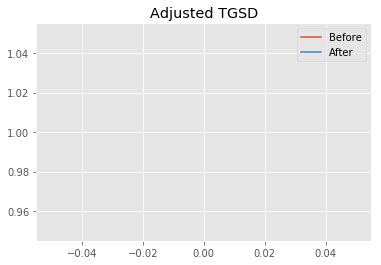

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.2858 	2.1477 	7271.18 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.46645 	2.18533 	7270.18 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.7645
New Misfit: 3.76264
Convergence:
0.0004943400088097688

____________________
a = 4.46645	b = 2.18533	            h1 = 7270.18360	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.7626433824410843
Prior Misfit: 310.185,	 Post Misfit: 3.76264


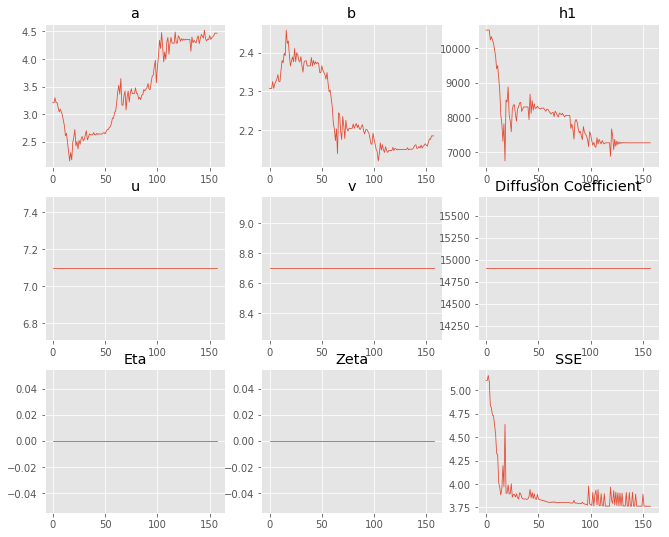

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,3.2068,4.46645
b,2.30779,2.18533
eta,0,0
ftt,"6,458","6,458"
h1,"10,521.4","7,270.18"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 11 Time: 0.082 minutes


Estimated remaining run time: 0.781 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.25e+02 	2.64e+02 	2.1211 		1.0000


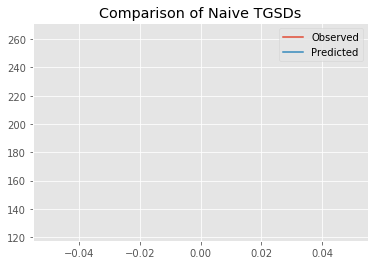

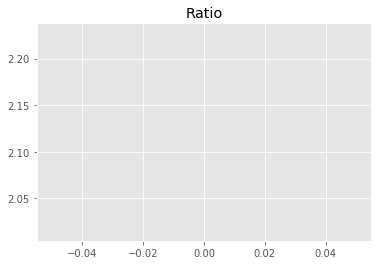

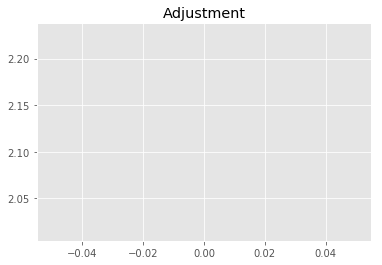

3376064860.3620696
1


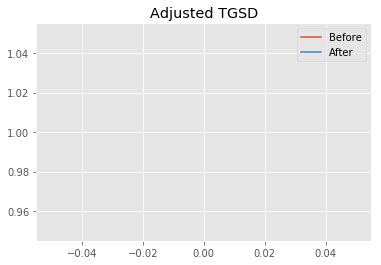

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0422 	4.68151 	29989.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.01779 	8.25811 	21659 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 5.16212
New Misfit: 4.10896
Convergence:
0.20401643711992673

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.27e+02 	2.64e+02 	1.1636 		1.0000


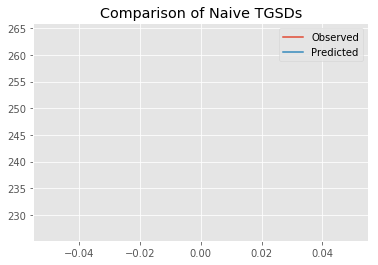

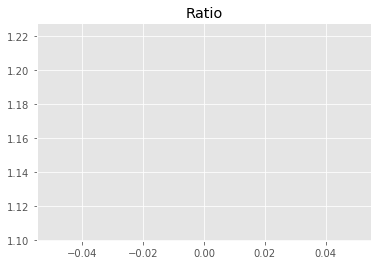

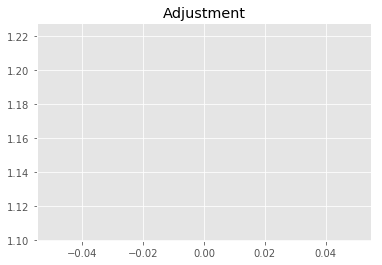

1851985787.7494388
1


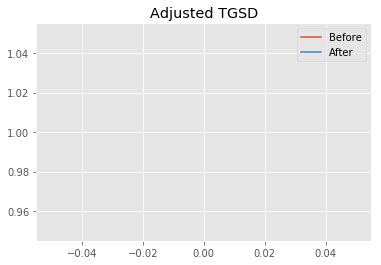

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01779 	8.25811 	21659 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.39327 	8.55228 	20532.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.10896
New Misfit: 4.09096
Convergence:
0.0043797743321377465

____________________
a = 1.39327	b = 8.55228	            h1 = 20532.21352	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 4.090963582949554
Prior Misfit: 308.429,	 Post Misfit: 4.09096


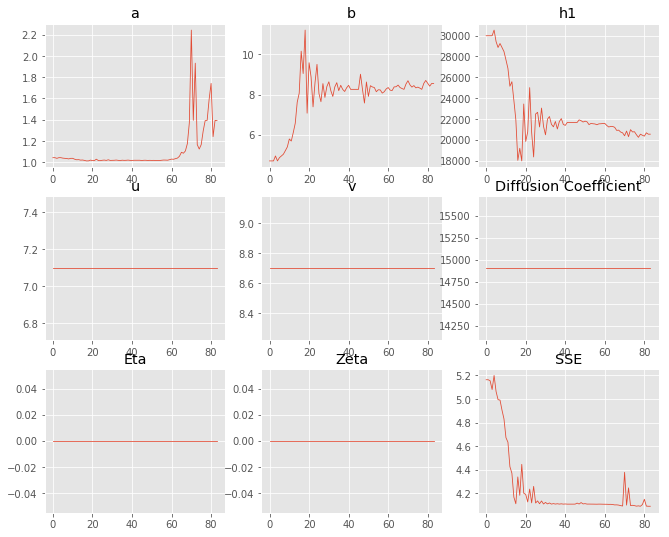

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.0422,1.39327
b,4.68151,8.55228
eta,0,0
ftt,"6,458","6,458"
h1,"29,989.3","20,532.2"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 12 Time: 0.048 minutes


Estimated remaining run time: 0.657 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.04e+02 	2.64e+02 	1.2930 		1.0000


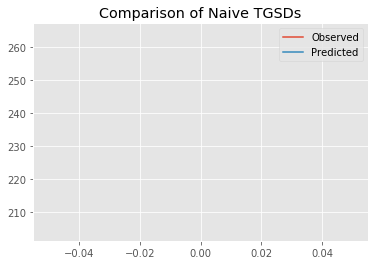

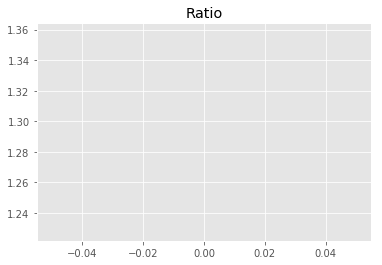

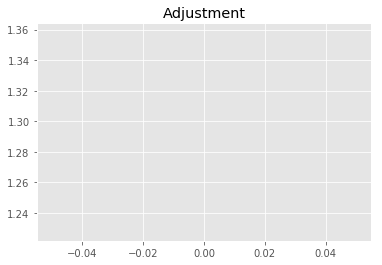

2057937602.1910992
1


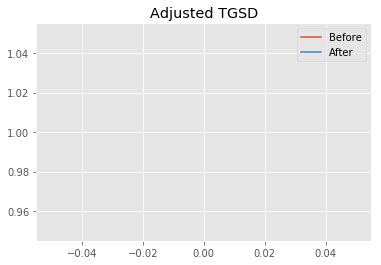

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.09312 	3.17672 	10293 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.0753 	3.04029 	9328.13 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.00941
New Misfit: 3.93391
Convergence:
0.018829691429807033

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.29e+02 	2.64e+02 	1.1530 		1.0000


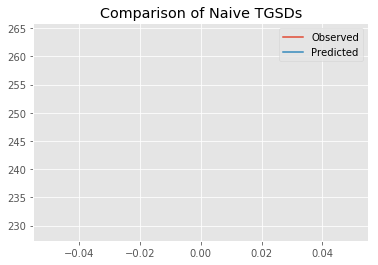

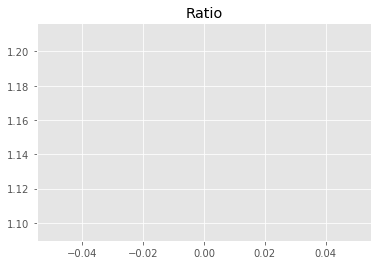

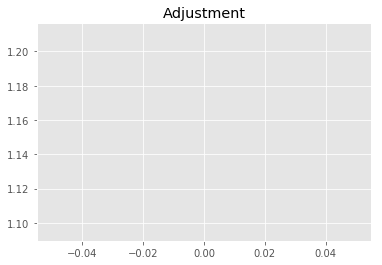

1835086017.1077414
1


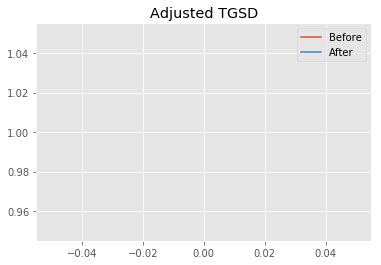

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0753 	3.04029 	9328.13 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.09821 	1.99631 	8065.45 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.93391
New Misfit: 3.88475
Convergence:
0.012496198184275008

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.40e+02 	2.64e+02 	1.1013 		1.0000


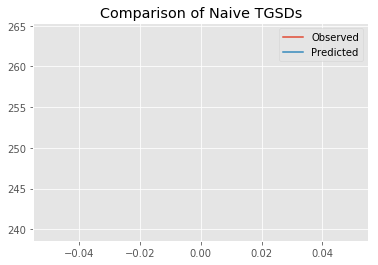

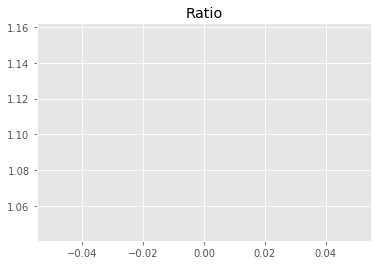

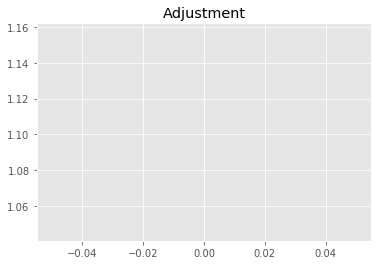

1752913310.913041
1


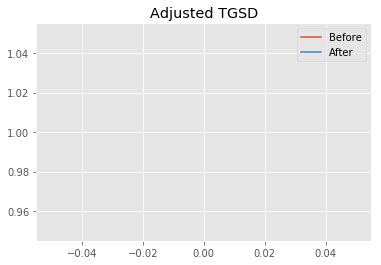

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.09821 	1.99631 	8065.45 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.10709 	1.9964 	8312.71 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.88475
New Misfit: 3.86719
Convergence:
0.0045204353899819414

____________________
a = 2.10709	b = 1.99640	            h1 = 8312.71005	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 3.867189515780926
Prior Misfit: 113.084,	 Post Misfit: 3.86719


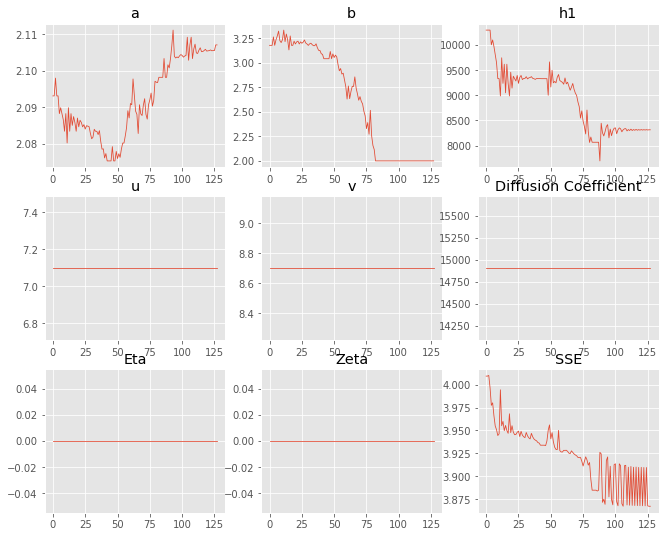

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.09312,2.10709
b,3.17672,1.9964
eta,0,0
ftt,"6,458","6,458"
h1,"10,293","8,312.71"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 13 Time: 0.068 minutes


Estimated remaining run time: 0.552 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	8.04e+01 	2.64e+02 	3.2828 		1.0000


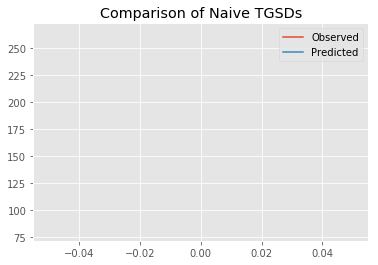

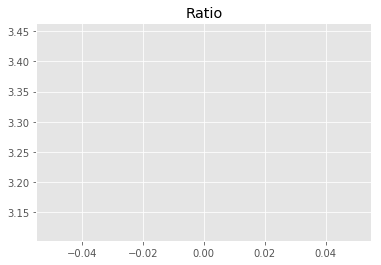

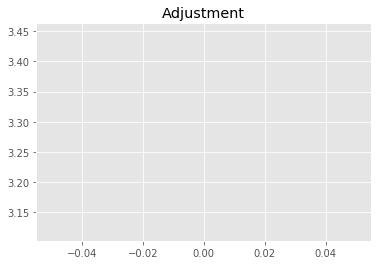

5224996988.287636
1


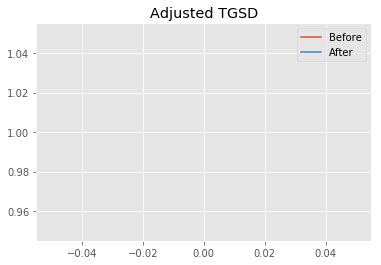

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.13159 	4.33068 	40914.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.06663 	8.39444 	21605.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 6.03357
New Misfit: 4.10526
Convergence:
0.31959780088975215

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.26e+02 	2.64e+02 	1.1678 		1.0000


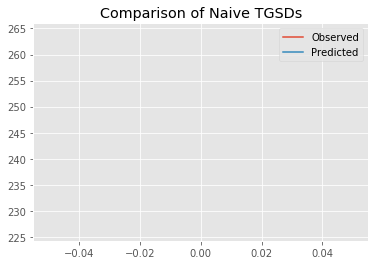

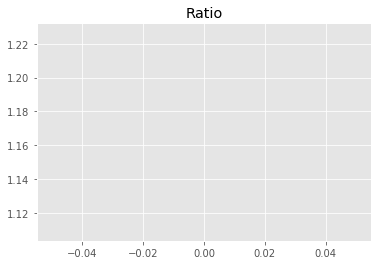

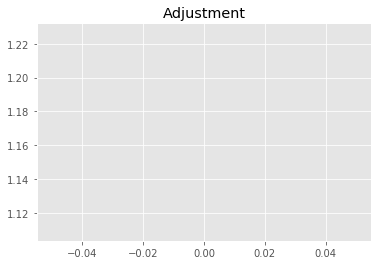

1858761967.4393413
1


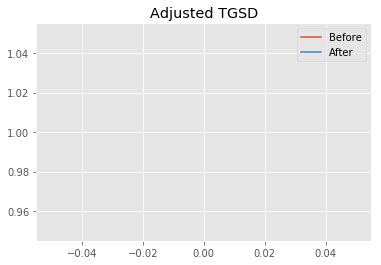

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.06663 	8.39444 	21605.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.91945 	10.251 	20055.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.10526
New Misfit: 4.06219
Convergence:
0.010489708848044432

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.13e+02 	2.64e+02 	1.2381 		1.0000


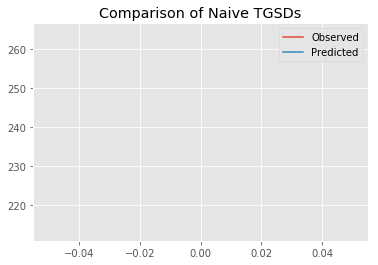

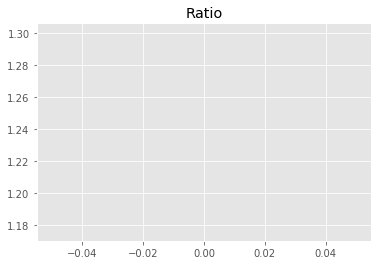

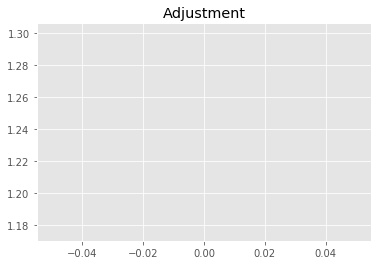

1970688517.2435157
1


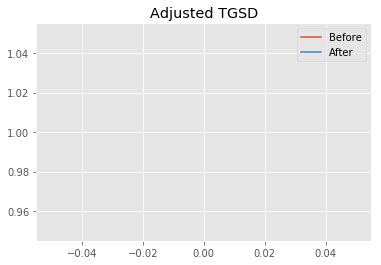

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.91945 	10.251 	20055.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.88615 	7.80979 	15241.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.06219
New Misfit: 4.03318
Convergence:
0.0071419885329268105

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.32e+02 	2.64e+02 	1.1383 		1.0000


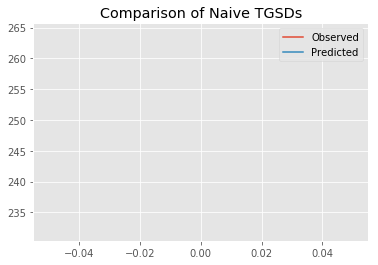

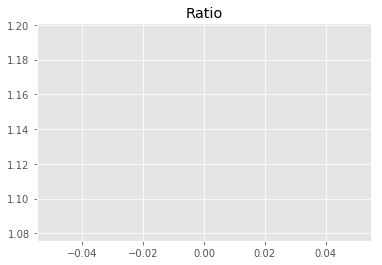

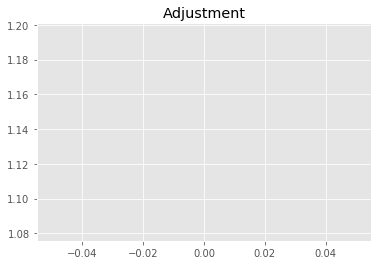

1811751629.3759155
1


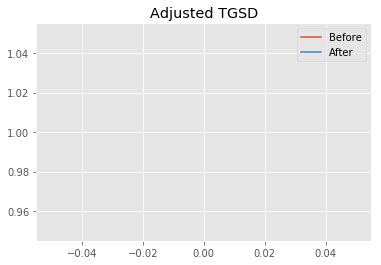

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.88615 	7.80979 	15241.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.04517 	5.73821 	12788.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.03318
New Misfit: 4.00174
Convergence:
0.007795525082485122

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.23e+02 	2.64e+02 	1.1844 		1.0000


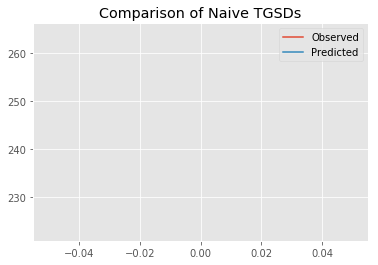

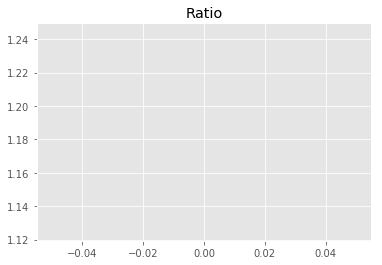

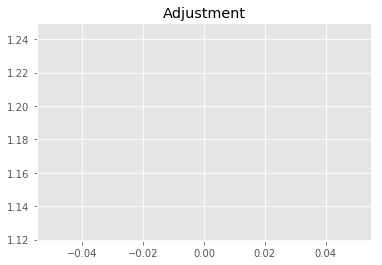

1885130772.5141096
1


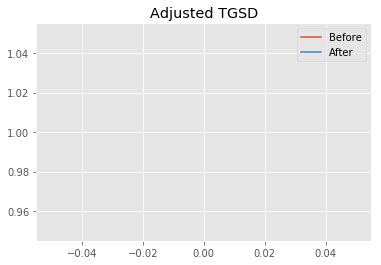

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.04517 	5.73821 	12788.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.04844 	3.27448 	9349.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.00174
New Misfit: 3.95561
Convergence:
0.011528623648774855

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.37e+02 	2.64e+02 	1.1161 		1.0000


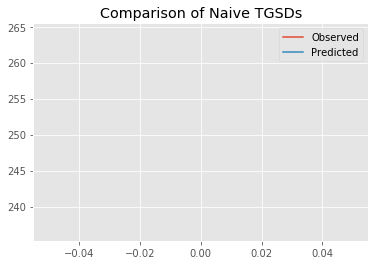

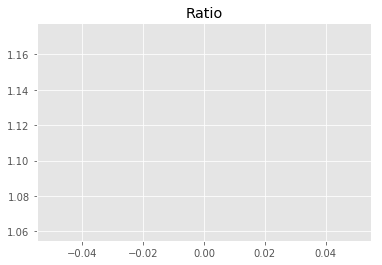

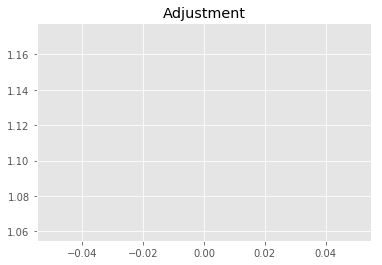

1776467260.6466007
1


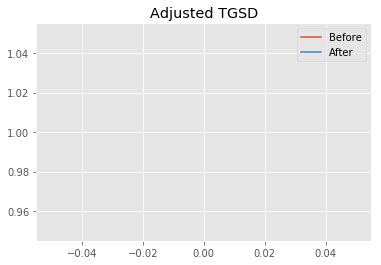

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.04844 	3.27448 	9349.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.09054 	1.76935 	7622.52 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.95561
New Misfit: 3.88302
Convergence:
0.018351312818546104

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.40e+02 	2.64e+02 	1.0993 		1.0000


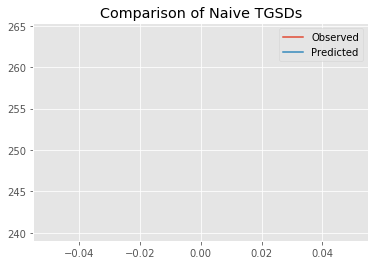

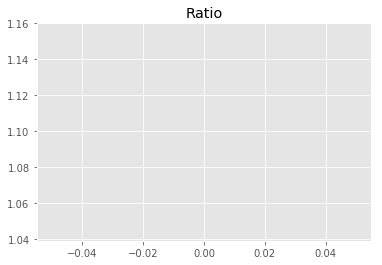

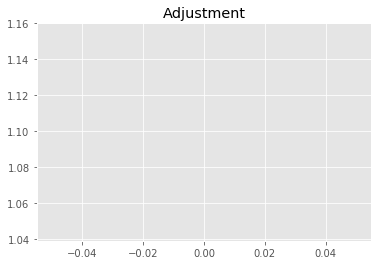

1749712530.793396
1


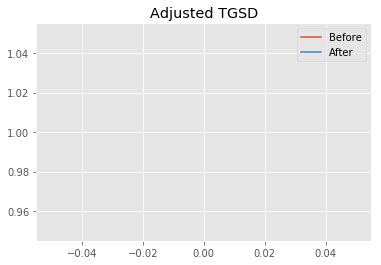

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.09054 	1.76935 	7622.52 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.09162 	1.74493 	8312.31 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.88302
New Misfit: 3.84199
Convergence:
0.010564485146213698

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.29e+02 	2.64e+02 	1.1508 		1.0000


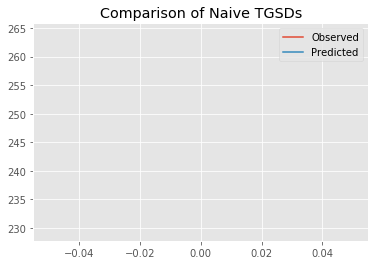

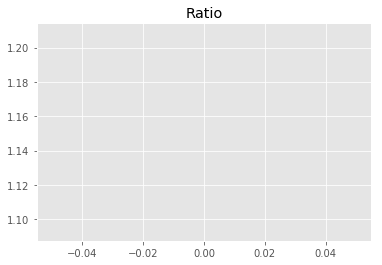

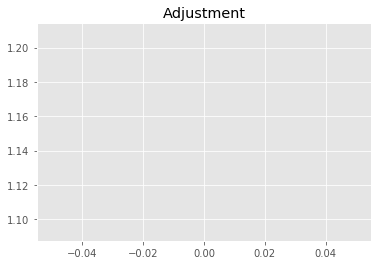

1831681688.1106606
1


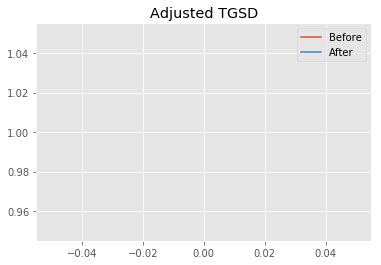

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.09162 	1.74493 	8312.31 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.22164 	1.38778 	8037.92 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.84199
New Misfit: 3.82087
Convergence:
0.00549923019618385

____________________
a = 2.22164	b = 1.38778	            h1 = 8037.91765	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 8
Misfit: 3.8208662683146284
Prior Misfit: 635.97,	 Post Misfit: 3.82087


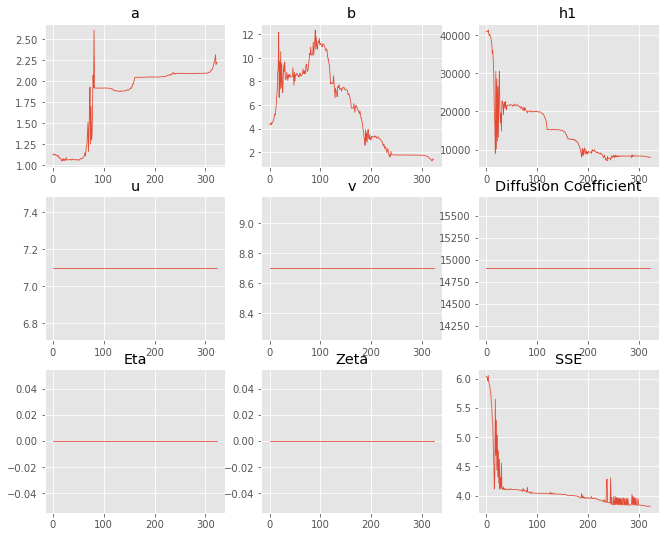

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.13159,2.22164
b,4.33068,1.38778
eta,0,0
ftt,"6,458","6,458"
h1,"40,914.6","8,037.92"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 14 Time: 0.171 minutes


Estimated remaining run time: 0.486 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.36e+02 	2.64e+02 	1.9408 		1.0000


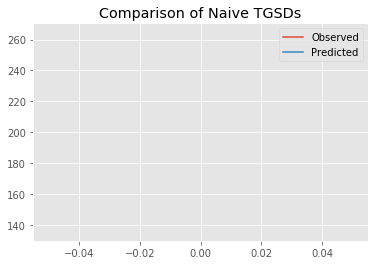

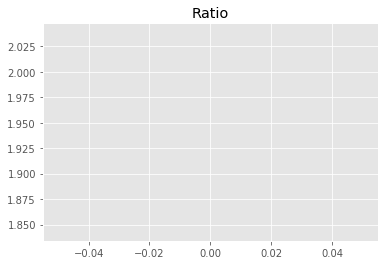

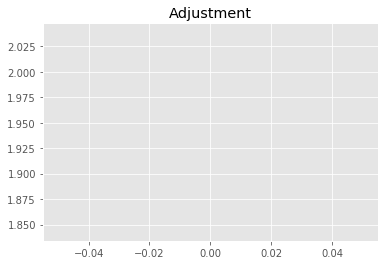

3089060537.409975
1


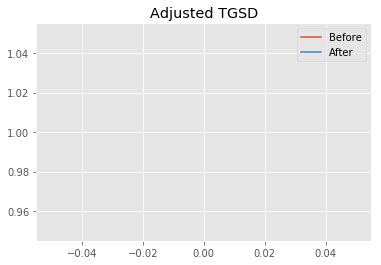

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.35476 	4.4145 	21623.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.27074 	7.41745 	18356.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.92691
New Misfit: 4.08231
Convergence:
0.1714266695853604

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.25e+02 	2.64e+02 	1.1723 		1.0000


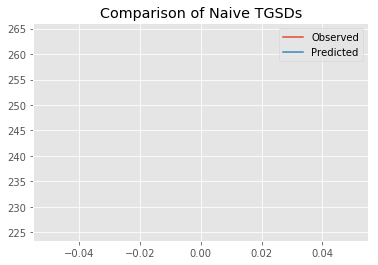

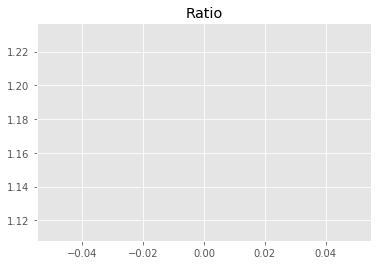

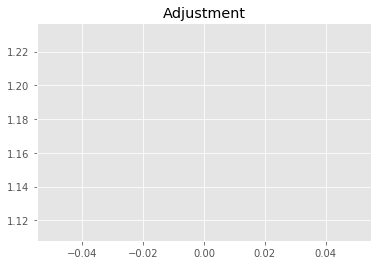

1865880304.7749724
1


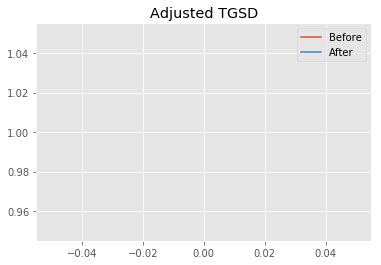

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.27074 	7.41745 	18356.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.03716 	14.2649 	19008.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.08231
New Misfit: 3.98978
Convergence:
0.022665439141284355

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.16e+02 	2.64e+02 	1.2249 		1.0000


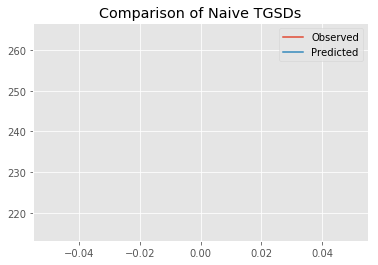

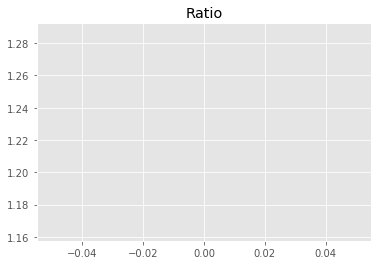

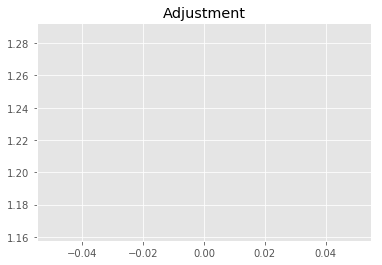

1949659088.9741042
1


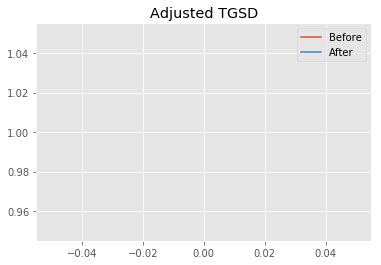

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.03716 	14.2649 	19008.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.76501 	16.3679 	18035 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.98978
New Misfit: 3.94827
Convergence:
0.010403806849853842

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.18e+02 	2.64e+02 	1.2090 		1.0000


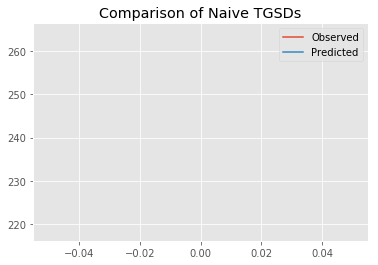

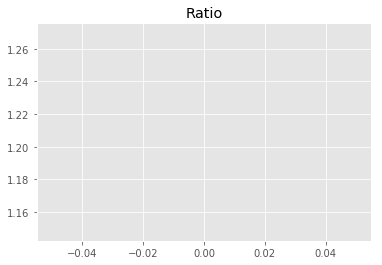

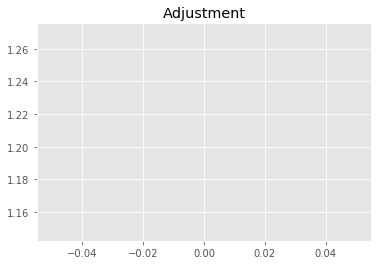

1924295651.2580292
1


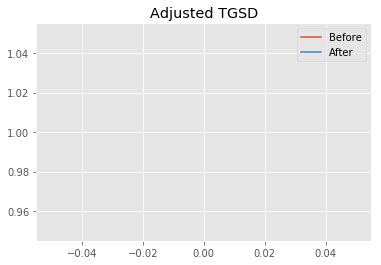

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.76501 	16.3679 	18035 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|10.5998 	39.2803 	16674.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.94827
New Misfit: 3.78436
Convergence:
0.041515442459521275

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.13e+02 	2.64e+02 	1.2384 		1.0000


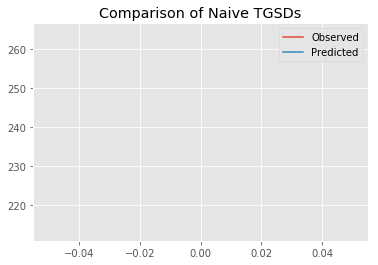

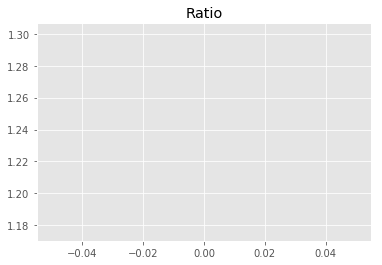

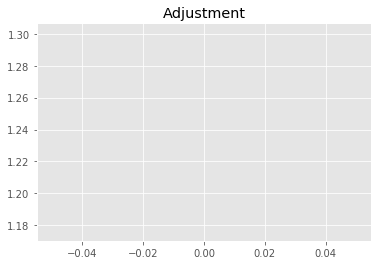

1971095627.1351256
1


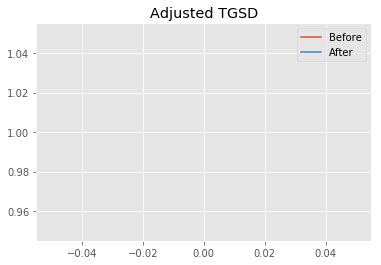

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.5998 	39.2803 	16674.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|947.033 	3634.9 	16317.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.78436
New Misfit: 3.56576
Convergence:
0.05776280616269662

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.37e+02 	2.64e+02 	1.1154 		1.0000


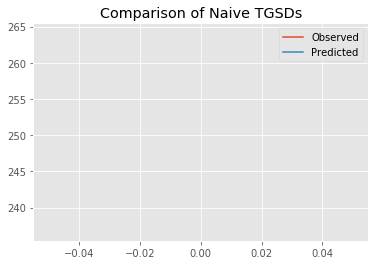

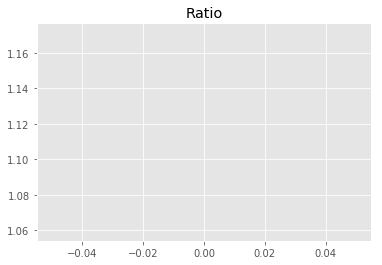

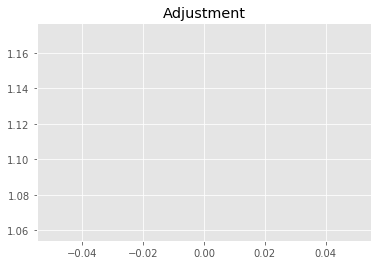

1775317890.2348323
1


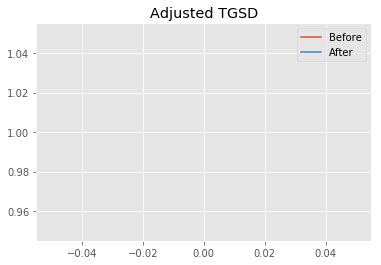

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|947.033 	3634.9 	16317.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|951.783 	3888.13 	16312.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.56576
New Misfit: 3.56576
Convergence:
3.5316793182610982e-09

____________________
a = 951.78284	b = 3888.13490	            h1 = 16312.82171	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 3.5657631090798816
Prior Misfit: 255.324,	 Post Misfit: 3.56576


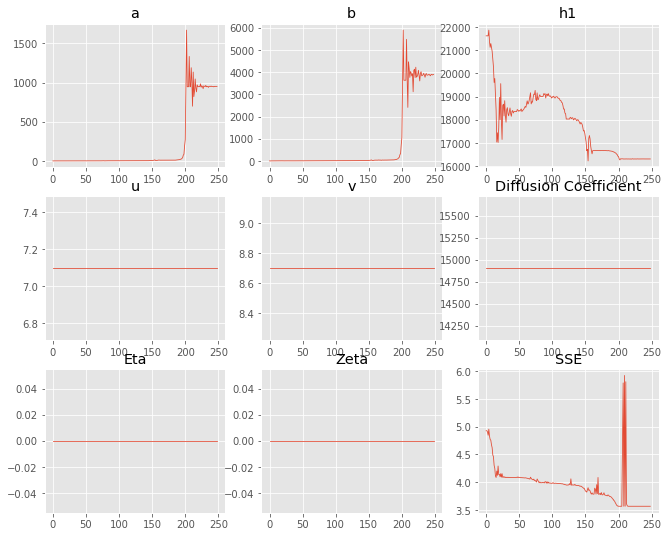

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.35476,951.783
b,4.4145,"3,888.13"
eta,0,0
ftt,"6,458","6,458"
h1,"21,623.9","16,312.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 15 Time: 0.126 minutes


Estimated remaining run time: 0.396 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	9.89e+01 	2.64e+02 	2.6696 		1.0000


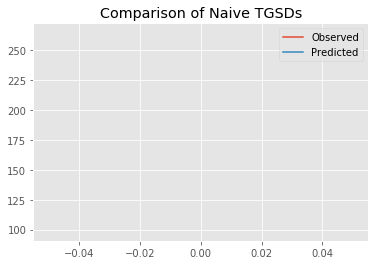

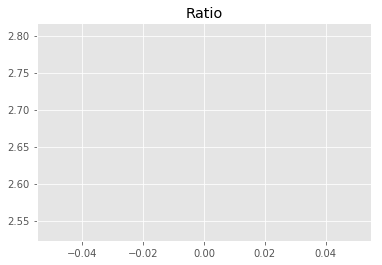

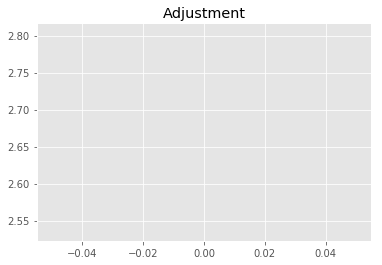

4249043647.331695
1


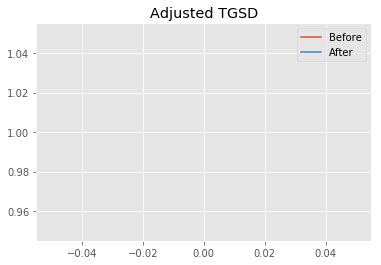

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.58199 	2.48352 	10373.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.69482 	2.41519 	7980.14 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 5.42252
New Misfit: 3.7937
Convergence:
0.3003808096520255

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.14e+02 	2.64e+02 	1.2321 		1.0000


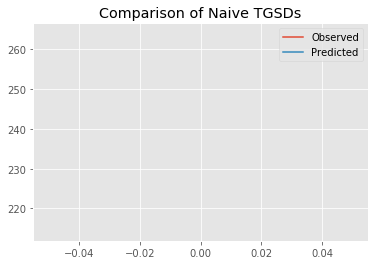

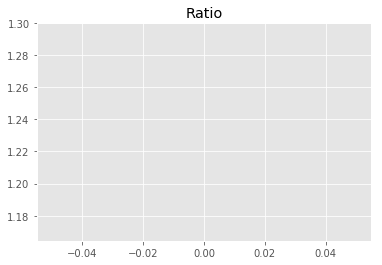

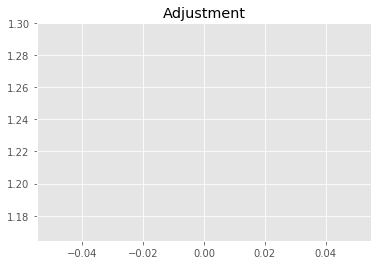

1961063054.3209429
1


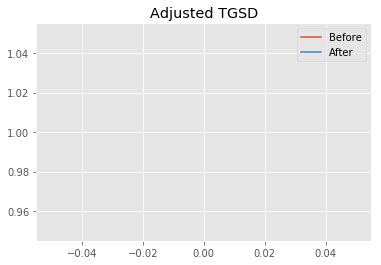

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.69482 	2.41519 	7980.14 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.55054 	2.32284 	7299.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.7937
New Misfit: 3.75976
Convergence:
0.008946282913689384

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.18e+02 	2.64e+02 	1.2102 		1.0000


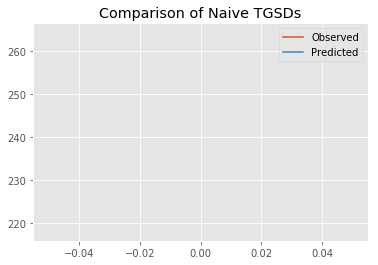

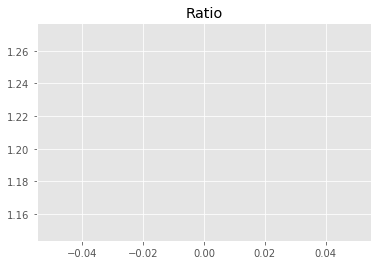

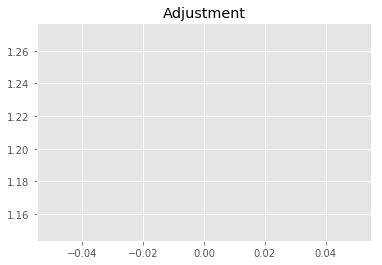

1926152952.0608425
1


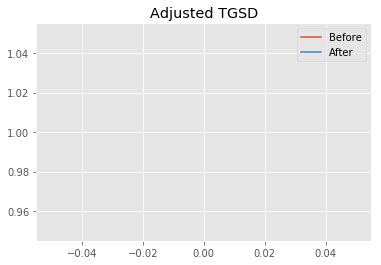

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.55054 	2.32284 	7299.2 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.03585 	2.40722 	7270.25 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.75976
New Misfit: 3.75422
Convergence:
0.0014721873441921746

____________________
a = 5.03585	b = 2.40722	            h1 = 7270.25386	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 3.7542226101380125
Prior Misfit: 421.789,	 Post Misfit: 3.75422


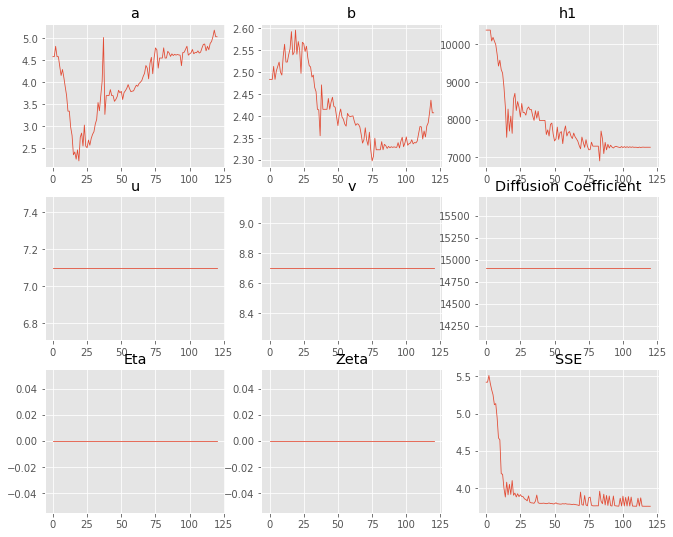

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,4.58199,5.03585
b,2.48352,2.40722
eta,0,0
ftt,"6,458","6,458"
h1,"10,373.4","7,270.25"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 16 Time: 0.068 minutes


Estimated remaining run time: 0.292 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	5.87e+01 	2.64e+02 	4.4967 		1.0000


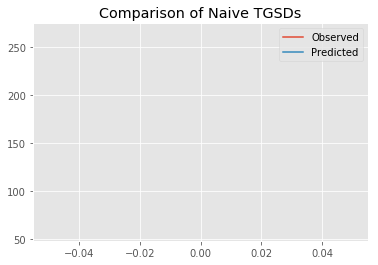

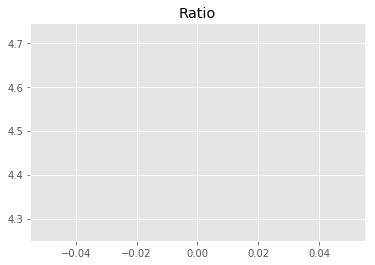

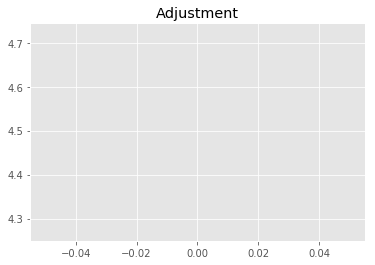

7157155023.481564
1


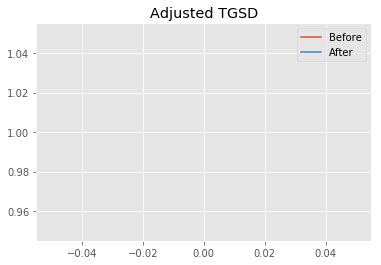

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.16313 	1.55049 	23496.5 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.01499 	1.43356 	8343.05 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 6.50463
New Misfit: 3.96863
Convergence:
0.3898750760763573

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.26e+02 	2.64e+02 	1.1673 		1.0000


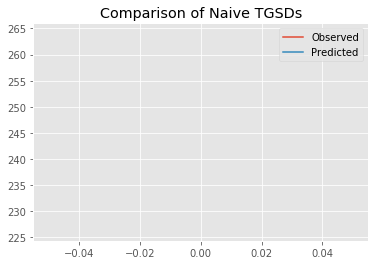

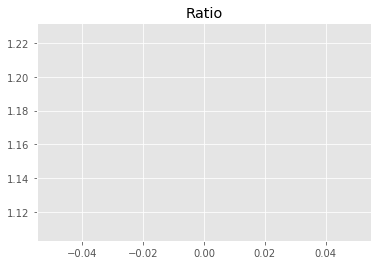

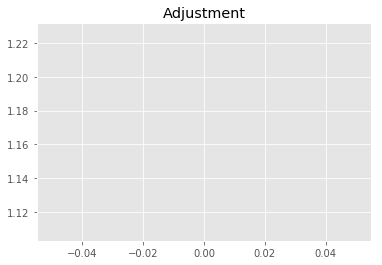

1857904423.4615006
1


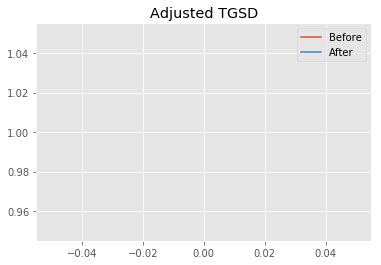

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01499 	1.43356 	8343.05 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.04875 	1.38892 	8313.8 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.96863
New Misfit: 3.96443
Convergence:
0.0010598997973318522

____________________
a = 1.04875	b = 1.38892	            h1 = 8313.80264	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 3.9644276739211524
Prior Misfit: 995.89,	 Post Misfit: 3.96443


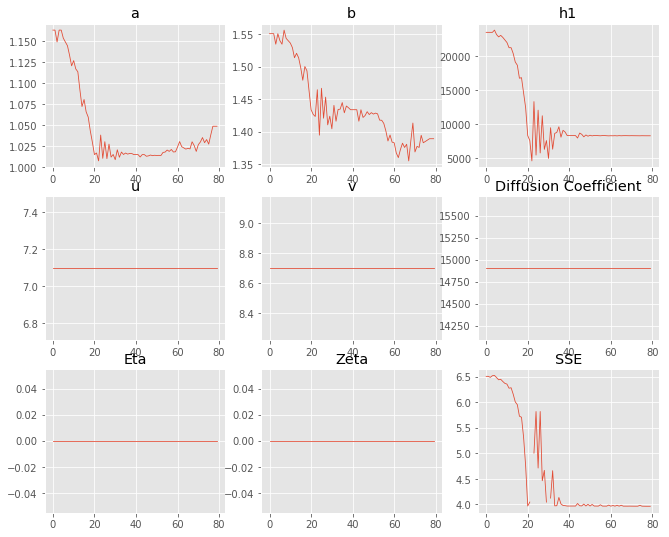

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.16313,1.04875
b,1.55049,1.38892
eta,0,0
ftt,"6,458","6,458"
h1,"23,496.5","8,313.8"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 17 Time: 0.049 minutes


Estimated remaining run time: 0.189 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	6.49e+01 	2.64e+02 	4.0671 		1.0000


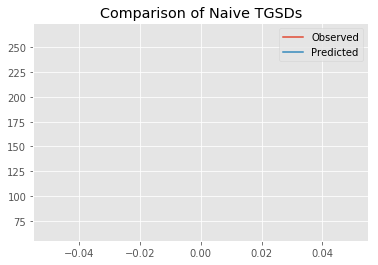

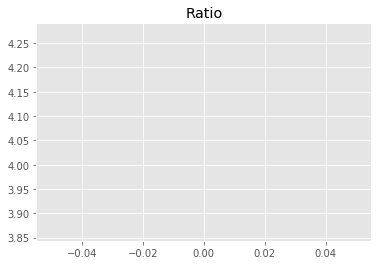

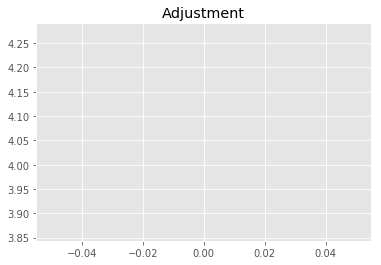

6473394744.6695385
1


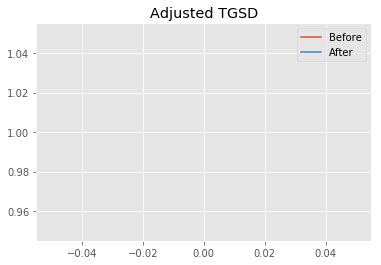

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.36558 	2.28305 	24519.3 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.13404 	2.46524 	10188.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 6.35428
New Misfit: 4.01942
Convergence:
0.3674473642424155

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.25e+02 	2.64e+02 	1.1742 		1.0000


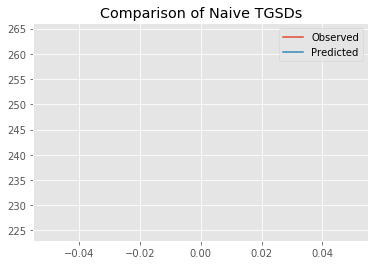

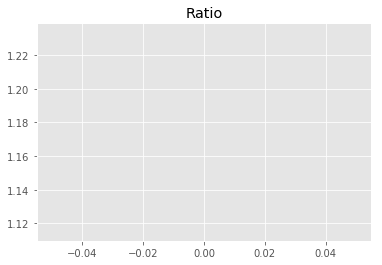

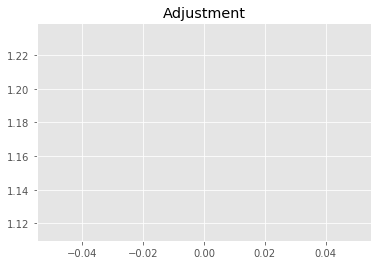

1868980020.762093
1


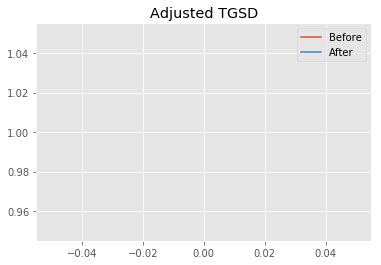

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.13404 	2.46524 	10188.9 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.12029 	2.53199 	8243.77 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.01942
New Misfit: 3.80979
Convergence:
0.05215270560287544

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.25e+02 	2.64e+02 	1.1719 		1.0000


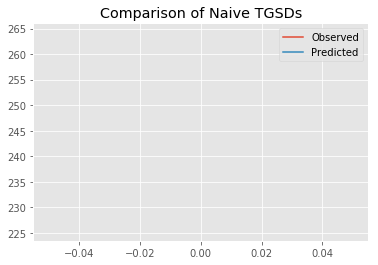

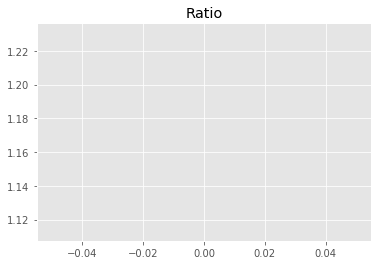

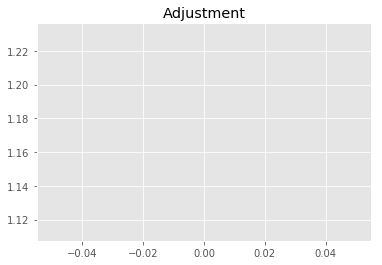

1865173055.124491
1


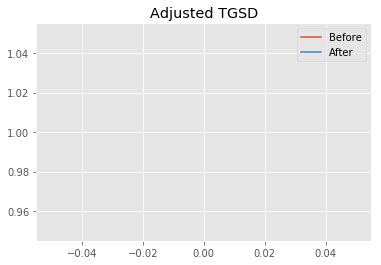

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.12029 	2.53199 	8243.77 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.78089 	2.96484 	7406.41 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.80979
New Misfit: 3.7685
Convergence:
0.010838337975513456

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.30e+02 	2.64e+02 	1.1468 		1.0000


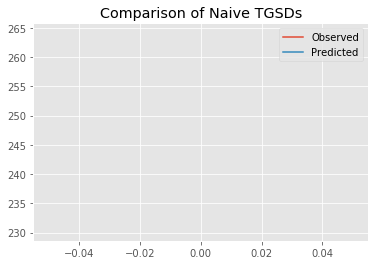

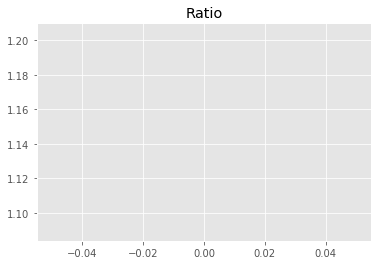

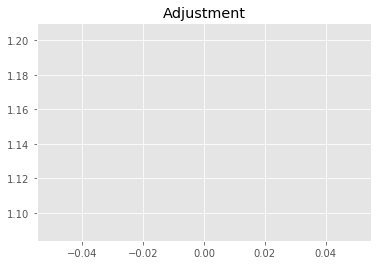

1825304985.5268369
1


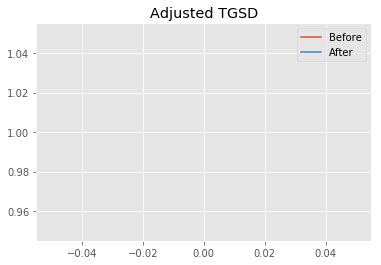

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.78089 	2.96484 	7406.41 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.76774 	2.83531 	7269.61 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.7685
New Misfit: 3.73661
Convergence:
0.008461949226950337

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.17e+02 	2.64e+02 	1.2153 		1.0000


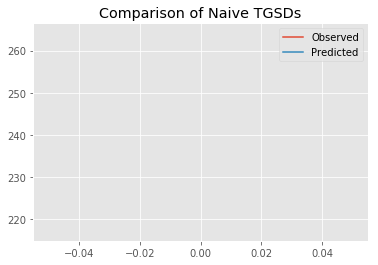

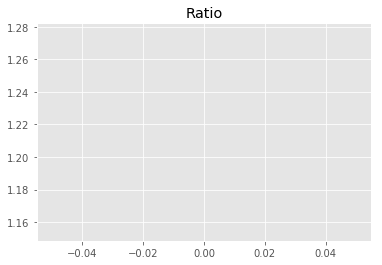

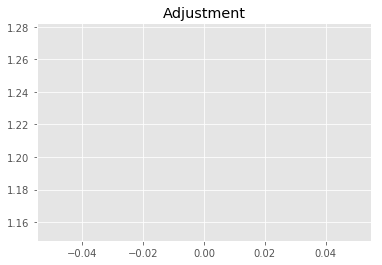

1934370068.7417066
1


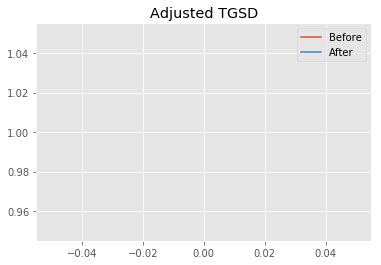

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.76774 	2.83531 	7269.61 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.19441 	3.23109 	7272.11 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.73661
New Misfit: 3.72588
Convergence:
0.002871527559255056

____________________
a = 6.19441	b = 3.23109	            h1 = 7272.10556	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.7258824677929447
Prior Misfit: 857.746,	 Post Misfit: 3.72588


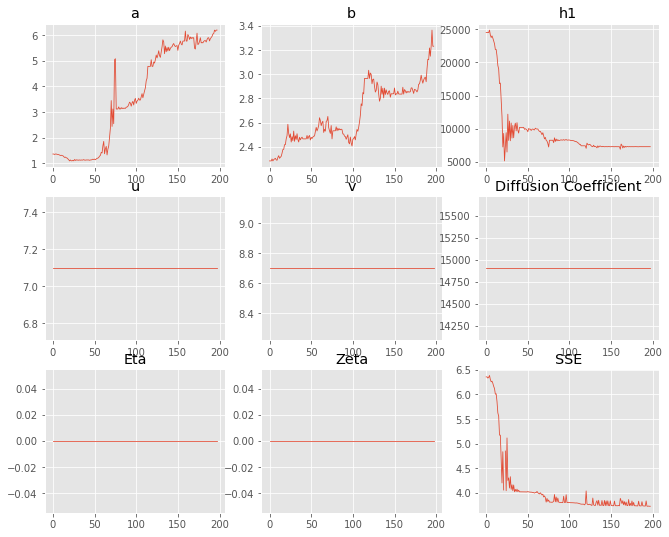

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.36558,6.19441
b,2.28305,3.23109
eta,0,0
ftt,"6,458","6,458"
h1,"24,519.3","7,272.11"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 18 Time: 0.103 minutes


Estimated remaining run time: 0.095 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.13e+02 	2.64e+02 	2.3419 		1.0000


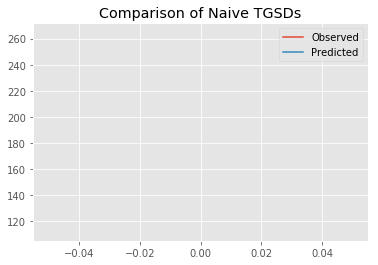

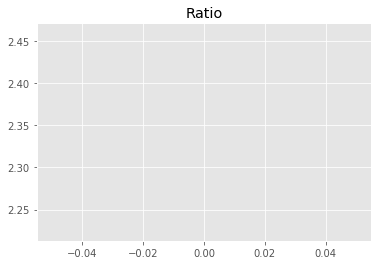

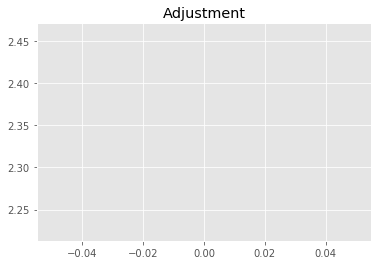

3727443899.3669143
1


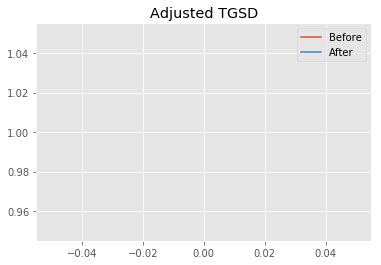

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03316 	3.33439 	15889.6 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.01443 	8.32122 	15774.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 5.28559
New Misfit: 4.02323
Convergence:
0.23882986330718106

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.27e+02 	2.64e+02 	1.1630 		1.0000


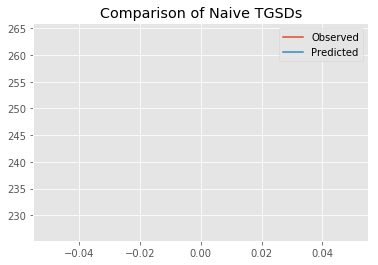

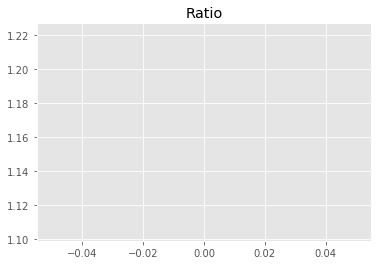

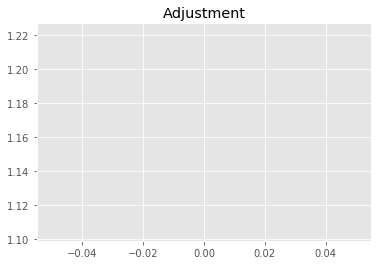

1851123755.2496707
1


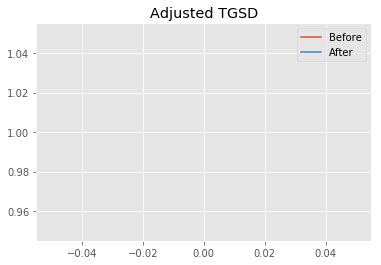

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01443 	8.32122 	15774.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.00035 	5.53917 	12176.4 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.02323
New Misfit: 4.00325
Convergence:
0.004966866315186441

____________________
a = 2.00035	b = 5.53917	            h1 = 12176.36918	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 4.003250911641697
Prior Misfit: 344.13,	 Post Misfit: 4.00325


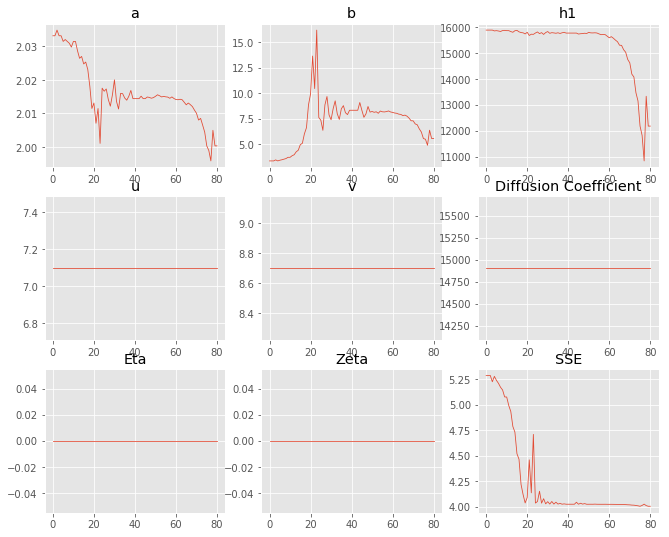

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,2.03316,2.00035
b,3.33439,5.53917
eta,0,0
ftt,"6,458","6,458"
h1,"15,889.6","12,176.4"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 19 Time: 0.054 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	6.44e+01 	2.64e+02 	4.0999 		1.0000


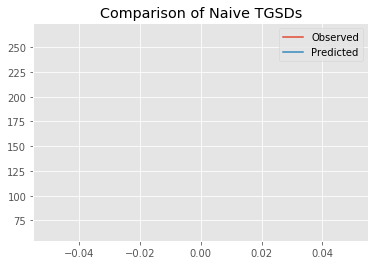

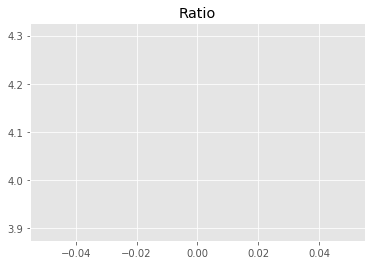

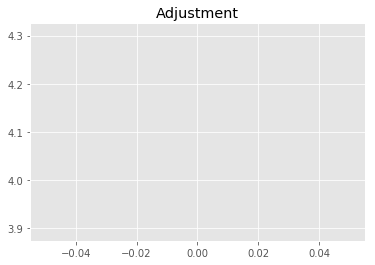

6525539325.083369
1


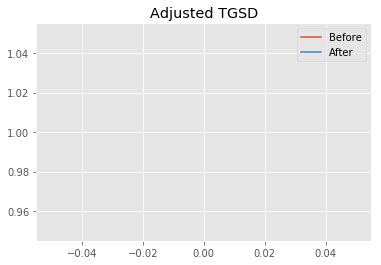

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.98427 	1.67349 	15349.7 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.97529 	5.17683 	12243.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 6.31744
New Misfit: 4.00033
Convergence:
0.3667796663436181

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.23e+02 	2.64e+02 	1.1821 		1.0000


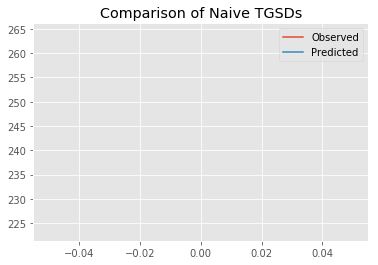

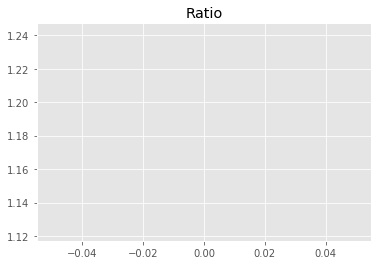

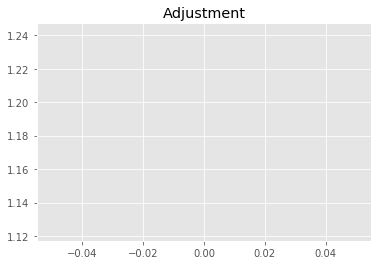

1881503330.412766
1


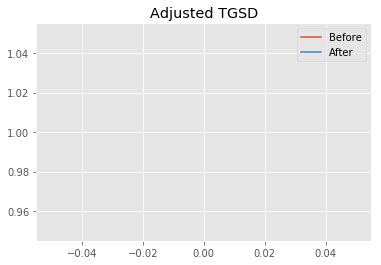

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97529 	5.17683 	12243.1 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.0043 	2.86756 	9319.87 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 4.00033
New Misfit: 3.93323
Convergence:
0.016775075993834525

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.26e+02 	2.64e+02 	1.1664 		1.0000


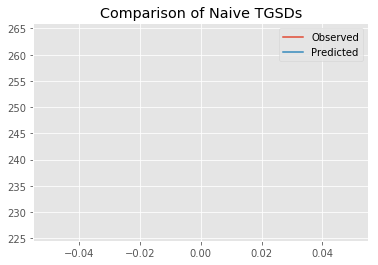

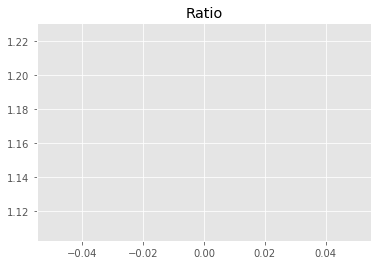

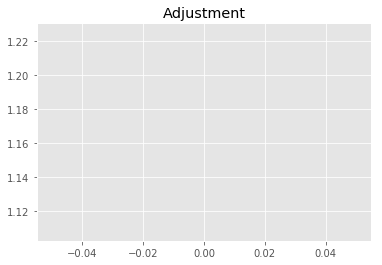

1856521571.0195103
1


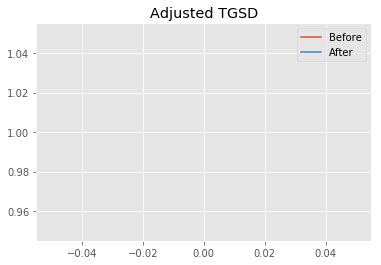

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0043 	2.86756 	9319.87 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.01002 	1.65429 	7507.03 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.93323
New Misfit: 3.88417
Convergence:
0.012473381768918917

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.40e+02 	2.64e+02 	1.0989 		1.0000


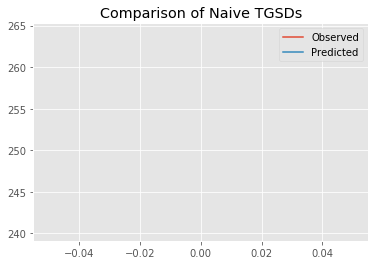

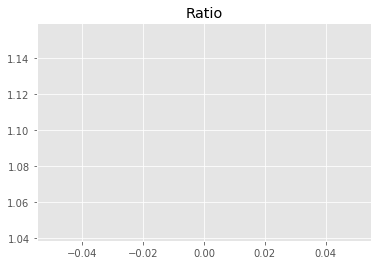

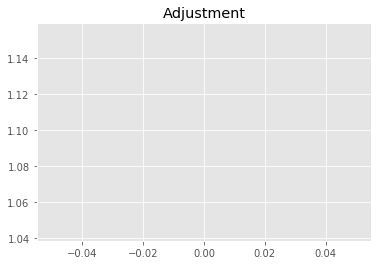

1749134382.5076916
1


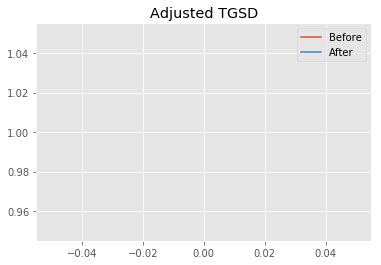

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01002 	1.65429 	7507.03 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.01056 	1.63785 	8313.06 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.88417
New Misfit: 3.84141
Convergence:
0.011006686521317685

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.29e+02 	2.64e+02 	1.1549 		1.0000


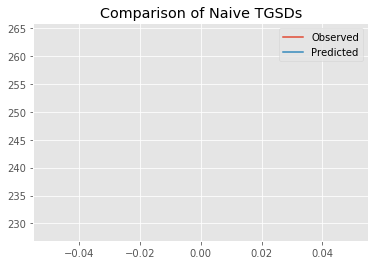

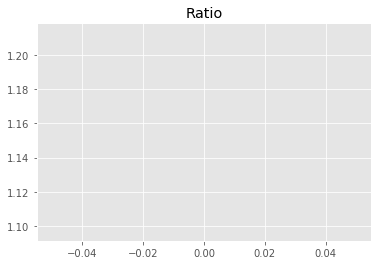

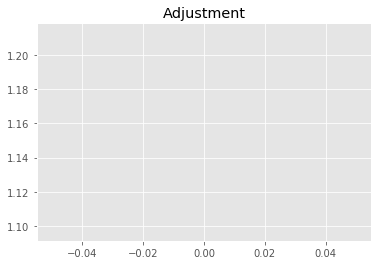

1838223475.421621
1


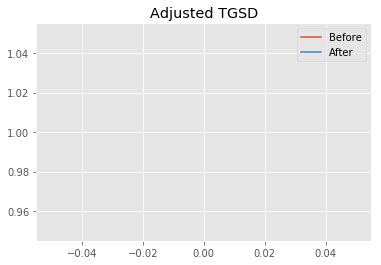

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01056 	1.63785 	8313.06 	7.09778 	8.69934 	14903.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.00188 	1.24757 	8241.47 	7.09778 	8.69934 	14903.6 	6458 	0 	0
Old Misfit: 3.84141
New Misfit: 3.82579
Convergence:
0.004067555467739173

____________________
a = 2.00188	b = 1.24757	            h1 = 8241.46953	u = 7.09778	v = 8.69934	            D = 14903.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.825788491368793
Prior Misfit: 843.44,	 Post Misfit: 3.82579


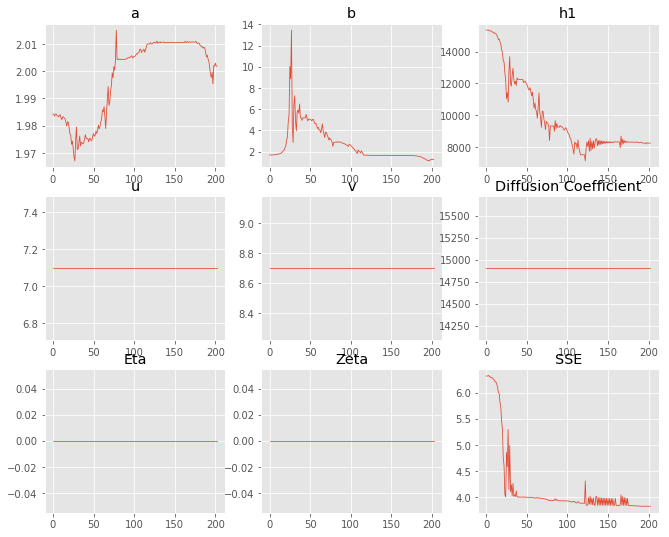

,Priors,Posteriors
D,"14,903.6","14,903.6"
a,1.98427,2.00188
b,1.67349,1.24757
eta,0,0
ftt,"6,458","6,458"
h1,"15,349.7","8,241.47"
u,7.09778,7.09778
v,8.69934,8.69934
zeta,0,0


Run 20 Time: 0.111 minutes


Estimated remaining run time: -0.094 minutes


Total Run Time: 1.96823 minutes


[{'a': 2.0064801831810932,
  'b': 1.1261190595526998,
  'h1': 7722.901626035972,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 190.3429428418632,
  'b': 30.527426673817896,
  'h1': 6981.815401379499,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 3.8839509557800604,
  'b': 1.9183573453461458,
  'h1': 7269.870562561566,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 107.88639545398577,
  'b': 3.279957117658881,
  'h1': 6255.087472513375,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 103.0729398251319,
  'b': 5.415431003338037,
  'h1': 7040.320823837225,
  'u': 7.09778,
  'v': 8.69934,
  'D': 14903.60000000001,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.8838780736

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
9,166.664,14.5537,"6,567.5",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
1,190.343,30.5274,"6,981.82",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
3,107.886,3.27996,"6,255.09",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
4,103.073,5.41543,"7,040.32",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
6,"4,330.09","13,010","13,359.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
14,951.783,"3,888.13","16,312.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
8,8.85576,4.54446,"7,269.51",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.68787
17,6.19441,3.23109,"7,272.11",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.72588
7,4.94769,2.46948,"7,272.84",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.75088
15,5.03585,2.40722,"7,270.25",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.75422


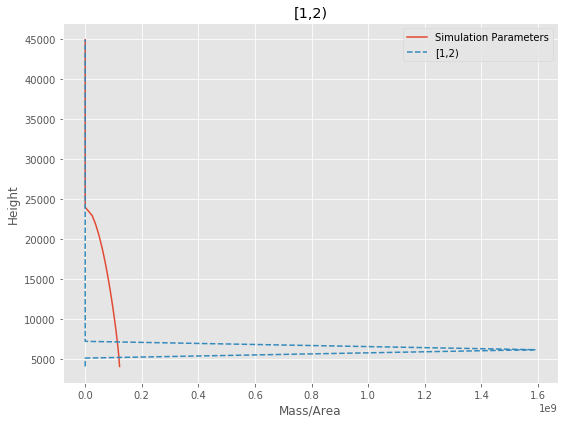

[1,2) Run Time: 1.97188 minutes


Mass Test: 54226745681.1571
Total Run Time: 10.28307 minutes


In [16]:
data_set = obs_df
t_tot = process_time()
single_run_time = 0
inverted_masses_list = []
params_list = []
iterations = 20
log="verb"
tgsd = get_tgsd(data_set, naive_phi_steps)


prior_phi_steps = copy.deepcopy(naive_phi_steps)

del prior_phi_steps[-1]
del prior_phi_steps[-1]

# for j, phi in enumerate(prior_phi_steps):
# #     phi["probability"] = 1/8
#     phi["probability"] = phi_probs[j]
params_dfs = []
all_misfits = []

phi_masses = []

mass_test = 0

for phi_step in prior_phi_steps:
    t = process_time()
    
    phi_df = data_set.copy()
    
    phi_df["MassArea"] = phi_df["MassArea"]*phi_df[phi_step["interval"]]/100
    phi_df[phi_step["interval"]] = 100
    mass_in_phi = config["ERUPTION_MASS"] * phi_step["probability"]
    mass_test += mass_in_phi

    
    print("========%s========"%phi_step["interval"])
    
#     out = gaussian_stack_inversion(
#         phi_df, len(phi_df), 20, config["VENT_ELEVATION"], 
#         H, 2500, [phi_step],
#         invert_params=invert_params,
#         priors=priors_vals,
#         column_cap=H)
#     inversion_table, params, sol, sse, plume_trace, param_trace, sse_trace = out
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    out = gaussian_stack_multi_run(
        phi_df, len(phi_df), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], 
        config["THEO_MAX_COL"], 2500, [iso_step], mass_in_phi, param_config, runs=iterations, column_cap = config["THEO_MAX_COL"], pre_samples=5,
        sol_iter=20, max_iter=40, tol=0.006, 
        adjust_TGSD=False, adjust_mass=False,
        adjustment_factor=0.5, gof="RMSE"
    )
    
    masses_list, misfit_list, params_runs, priors_list, heights, tgsd_list, mass_list = out
    best = np.argsort(misfit_list)
    
    params_df = pd.DataFrame(params_runs)
    display.display(params_runs)
    params_df["M"] = mass_list
    params_df["Misfit"] = misfit_list
    params_df = params_df.sort_values("Misfit")
    params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "eta", "zeta", "M", "Misfit"]]
    display.display(params_df)
    params_dfs += [params_df]
    
    all_misfits += [misfit_list]
    
    params = params_runs[best[0]]    
    params_list += [params]
    best_mass = mass_list[best[0]]
    phi_masses += [best_mass]
    
    inv_mass = mass_dist_in_plume(params["a"],params["b"], 
                                config["VENT_ELEVATION"], 
                                params["h1"], 
                                heights,
                                mass_in_phi)
    inverted_masses_list += [inv_mass]


     
    fig, ax1 = plt.subplots(1,1, figsize=(
    8, 6), facecolor='w', edgecolor='k')

    q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], 
                                config["VENT_ELEVATION"], 
                                config["PLUME_HEIGHT"], 
                                heights,
                                mass_in_phi)

    ax1.plot(q_mass, heights, label="Simulation Parameters")
    
    ax1.plot(inv_mass, heights, 
             '--', label=phi_step["interval"])
    ax1.legend()
    ax1.set_title("%s"%phi_step["interval"])
    ax1.set_ylabel("Height")
    ax1.set_xlabel("Mass/Area")

    plt.tight_layout()
    plt.show()
    run_time = process_time() - t
    print("%s Run Time: %.5f minutes\n\n"%(phi_step["interval"], run_time/60))
    print("Mass Test:", mass_test)
total_run_time = process_time() - t_tot

print("Total Run Time: %.5f minutes"%(total_run_time/60))

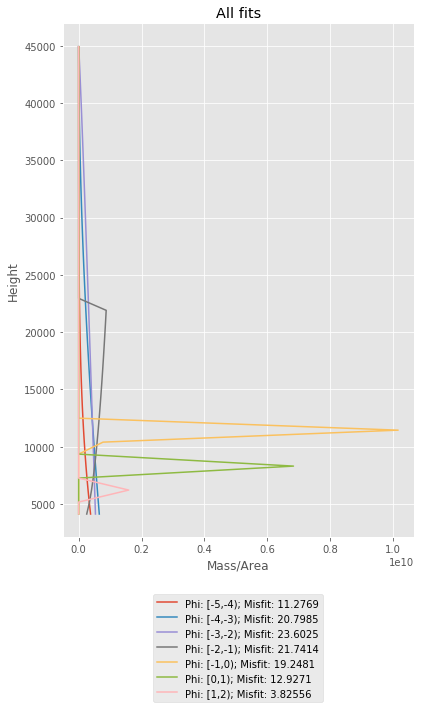

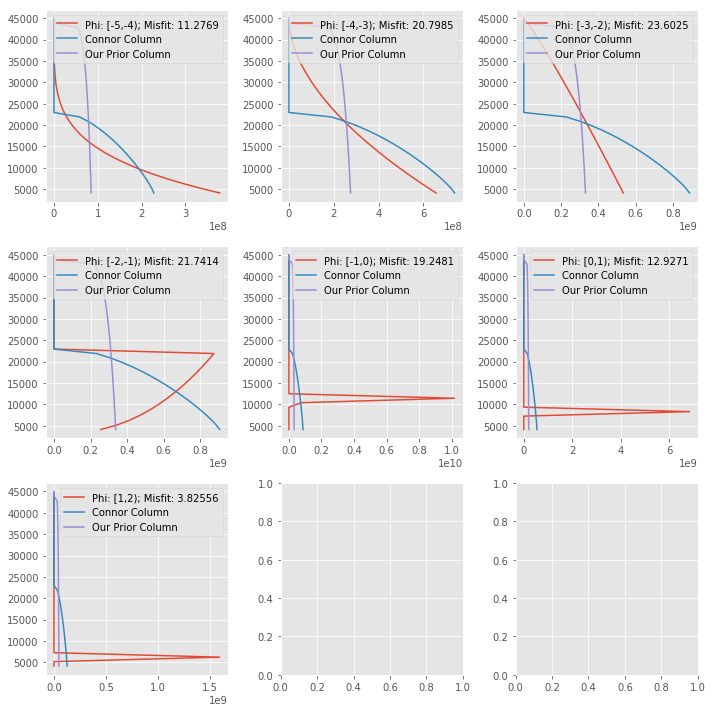

Phi Class: [-5,-4)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
18,1,5.497,"44,914.2",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2769
0,1,5.52901,"44,912.3",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2769
17,1,5.50181,"44,894.1",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2769
15,1.00006,5.46079,"44,877.7",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2771
7,1.0006,5.51872,"44,908.3",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2772
1,1.00043,5.55382,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2773
3,1.00055,5.45376,"44,883.4",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2774
4,1,5.44382,"44,787.5",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2774
11,1,5.5768,"44,708.8",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2782
19,1.00054,5.4016,"44,505",7.09778,8.69934,"14,903.6","6,458",0,0,2.8774e+09,11.2787


Phi Class: [-4,-3)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
19,1,2.84532,"44,911.8",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6848
14,1.00004,2.85661,"44,907.4",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6851
17,1.00003,2.85669,"44,894",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6853
7,1.00014,2.84497,"44,856.6",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6857
15,1.00011,2.82804,"44,898.7",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6858
6,1.00024,2.86654,"44,847.9",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6868
12,1.00062,2.86162,"44,831.1",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6872
2,1.00055,2.86592,"44,841.9",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6872
10,1,2.8506,"44,732.6",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6876
16,1.00029,2.8322,"44,530.6",7.09778,8.69934,"14,903.6","6,458",0,0,9.31979e+09,20.6905


Phi Class: [-3,-2)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
0,1,1.9015,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6025
3,1,1.90333,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6025
1,1.00002,1.9047,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6025
13,1.00006,1.90413,"44,915",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6025
2,1.00001,1.90624,"44,910.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6026
17,1.00005,1.90442,"44,907.7",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6026
6,1.00003,1.89403,"44,914.1",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6026
11,1.00025,1.90231,"44,898.9",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6028
10,1.00032,1.89087,"44,903.2",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6031
5,1.00007,1.91218,"44,884.2",7.09778,8.69934,"14,903.6","6,458",0,0,1.1215e+10,23.6031


Phi Class: [-2,-1)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
7,1.42486,1.00011,"22,356.5",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.6808
13,1.6537,1.7057,"26,276.9",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7276
19,1.6872,1.79456,"26,818.4",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7306
9,1.73403,1.97918,"27,872.1",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7393
0,1.66257,1.91339,"27,934.6",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7414
10,1.79523,1.94771,"26,934",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7443
11,1.70112,1.99279,"28,866.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7554
18,1.84685,2.38491,"29,742.7",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7557
12,1.88422,2.67173,"31,058.3",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7661
17,1.88538,2.68305,"31,058.9",7.09778,8.69934,"14,903.6","6,458",0,0,1.14451e+10,21.7676


Phi Class: [-1,0)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
10,639.707,436.644,"16,452.6",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2226
1,32.6358,7.69278,"12,844.2",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2338
15,54.0679,30.1413,"15,341.1",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2353
3,17.5969,3.42265,"12,522.5",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2405
12,42.1924,33.256,"17,170.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2427
9,33.062,23.5244,"16,614.7",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2466
2,15.247,3.8612,"13,091.6",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2472
0,12.1268,2.2859,"12,503.4",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2481
14,11.2336,2.51534,"12,842.7",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2524
16,49.5151,196.907,"42,472.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.09416e+10,19.2543


Phi Class: [0,1)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
9,255.775,2.02976,"8,626.07",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
13,180.636,1.97513,"9,202.71",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
7,"1,237.13",287.478,"9,183.19",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
11,238.33,10.0331,"9,046.5",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
10,196.742,1.96885,"8,755.81",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
1,"3,041.85","5,629.87","16,521.4",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
18,"1,529.2","2,705.43","16,099.7",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
6,279.812,84.2446,"9,254.17",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4556
3,219.269,375.418,"15,982.6",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.4802
16,10.5523,3.06423,"9,359.74",7.09778,8.69934,"14,903.6","6,458",0,0,6.83614e+09,12.8482


Phi Class: [1,2)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
9,166.664,14.5537,"6,567.5",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
1,190.343,30.5274,"6,981.82",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
3,107.886,3.27996,"6,255.09",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
4,103.073,5.41543,"7,040.32",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
6,"4,330.09","13,010","13,359.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
14,951.783,"3,888.13","16,312.8",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.56576
8,8.85576,4.54446,"7,269.51",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.68787
17,6.19441,3.23109,"7,272.11",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.72588
7,4.94769,2.46948,"7,272.84",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.75088
15,5.03585,2.40722,"7,270.25",7.09778,8.69934,"14,903.6","6,458",0,0,1.59164e+09,3.75422


In [17]:
fig, ax1 = plt.subplots(1,1, figsize=(6, 10), facecolor='w', edgecolor='k')

for i, phi_step in enumerate(prior_phi_steps):
    label = "Phi: %s; Misfit: %g"%(phi_step["interval"], params_dfs[i]["Misfit"][0])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("All fits")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                config["ERUPTION_MASS"],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

q_mass_prior = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                config["ERUPTION_MASS"],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                phi_masses[j],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

    q_mass_prior = beta_plume(1.00002,1.13405 ,44908,
                phi_masses[j],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])
    
    label = "Phi: %s; Misfit: %g"%(phi_step["interval"], params_dfs[j]["Misfit"][0])
    axs[j].plot(inverted_masses_list[j],
             heights, 
             '-', label=label)
    axs[j].plot(q_mass, heights, label="Connor Column")
    axs[j].plot(q_mass_prior, heights, label="Our Prior Column")
    axs[j].legend()
plt.tight_layout()
plt.show()


for j, phi_step in enumerate(prior_phi_steps):
    display.display_markdown(display.Markdown('''Phi Class: %s'''%phi_step['interval']))
    display.display(params_dfs[j])




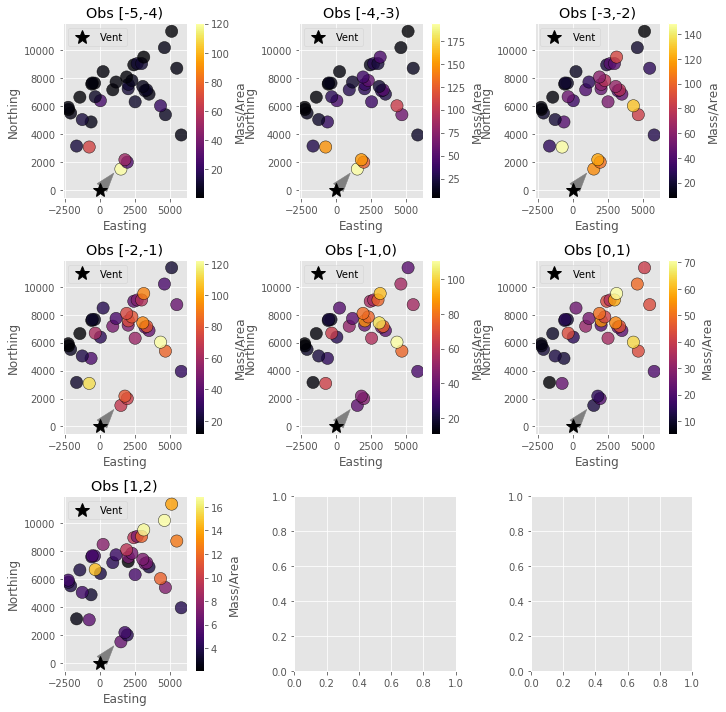

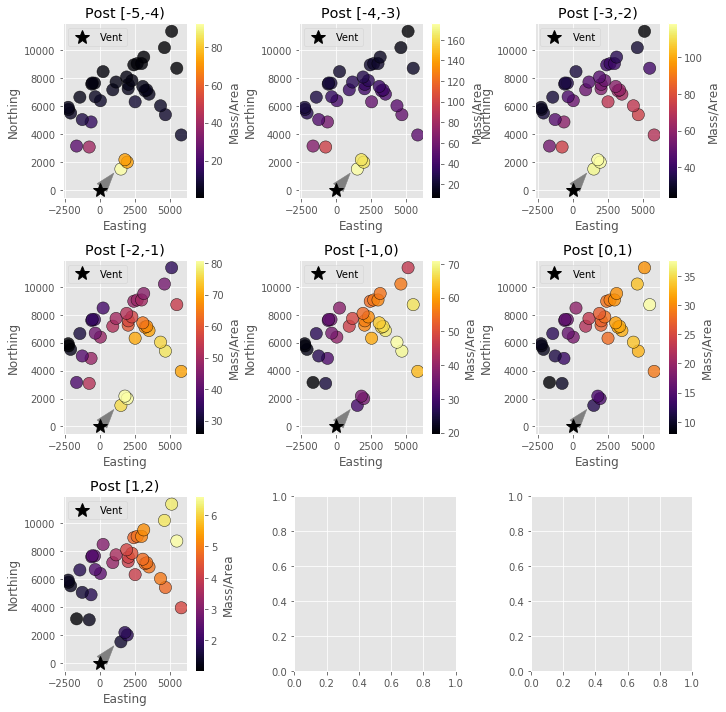

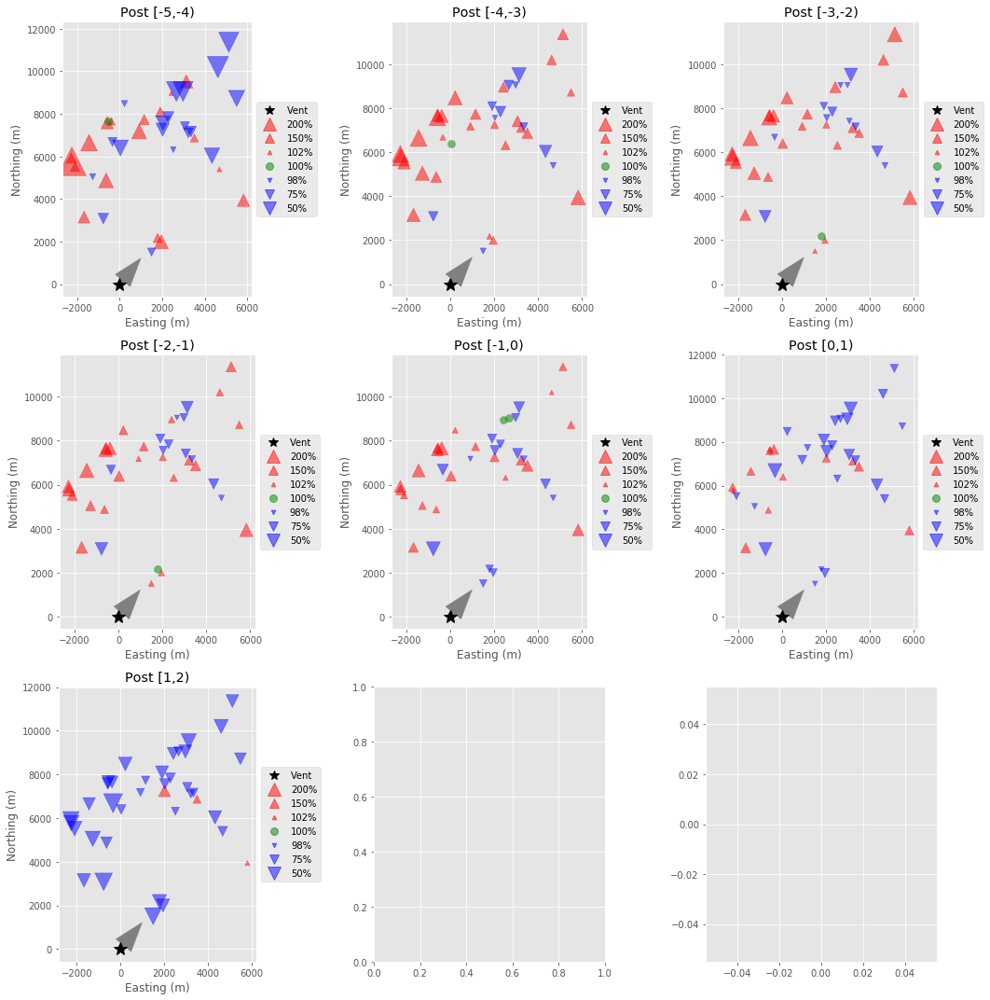

In [18]:
observation_phis = []
posterior_phis = []

for j, phi_step in enumerate(prior_phi_steps):
    phi_obs = data_set.copy()
    phi_obs["MassArea"] = phi_obs["MassArea"]*phi_obs[phi_step["interval"]]/100
    phi_obs[phi_step["interval"]] = 100
    bounds=(0, 200)

    observation_phis += [phi_obs]
    _, phi_post, _, _, _ = gaussian_stack_single_phi(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params_list[j]["h1"], (params_list[j]["a"],params_list[j]["b"]), 
        phi_masses[j], (params_list[j]["u"],params_list[j]["v"]), phi_step["lower"], 
        phi_step["density"],2500,
        params_list[j]["D"], config["EDDY_CONST"],
        params_list[j]["ftt"], params_list[j]["eta"], params_list[j]["zeta"]
    )
    phi_post["radius"] = np.sqrt(phi_post["Easting"]**2 + phi_post["Northing"]**2)
    phi_post = phi_post.sort_values(by=['radius'])
    phi_post["Residual"] = phi_post["MassArea"].values/phi_obs["MassArea"].values
    
    posterior_phis += [phi_post]

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_sample(observation_phis[j], vent=(0,0), log=False,#bounds=bounds, 
                   title="Obs %s"%phi_step["interval"], cbar_label="Mass/Area", ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))


plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_sample(posterior_phis[j], vent=(0,0), log=False,#bounds=bounds, 
                   title="Post %s"%phi_step["interval"], cbar_label="Mass/Area", ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))
    
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_residuals(posterior_phis[j], vent=(0,0), plot_type="size",
                   title="Post %s"%phi_step["interval"], ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))
    
plt.tight_layout()
plt.show()

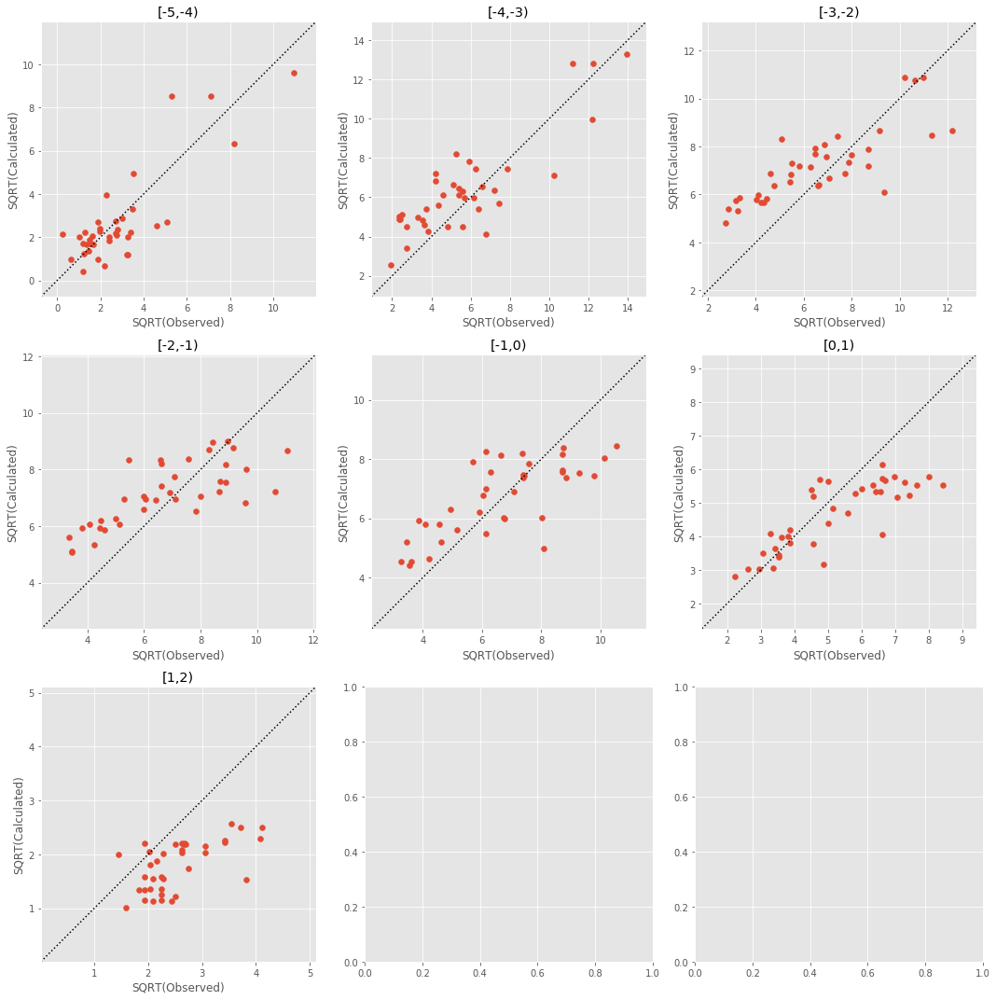

In [19]:
fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    min_mass = min((min(observation_phis[j]["MassArea"].values), min(posterior_phis[j]["MassArea"].values)))
    max_mass = max((max(observation_phis[j]["MassArea"].values), max(posterior_phis[j]["MassArea"].values)))
    axs[j].scatter(np.sqrt(observation_phis[j]["MassArea"].values), np.sqrt(posterior_phis[j]["MassArea"].values))
    axs[j].plot([-100,100],[-100,100], "k:")
    axs[j].set_xlabel("SQRT(Observed)")
    axs[j].set_ylabel("SQRT(Calculated)")
    axs[j].set_aspect('equal', 'box')
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    axs[j].set_ylim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    
plt.tight_layout()
plt.show()

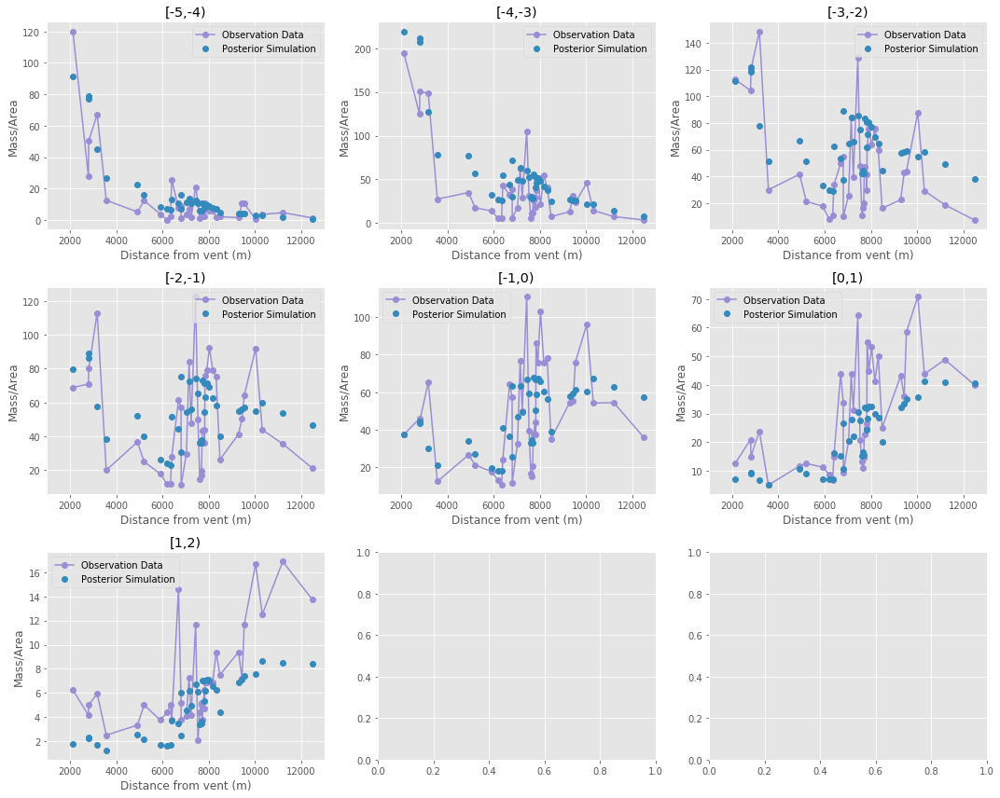

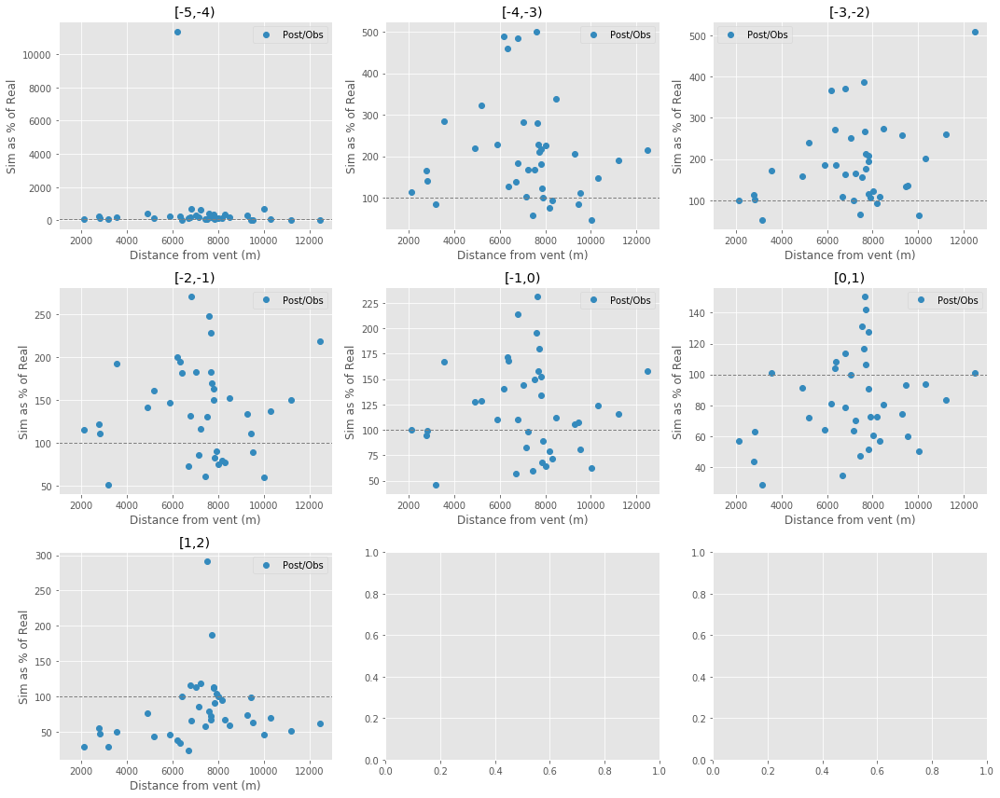

In [44]:
fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(observation_phis[j]["radius"].values, observation_phis[j]["MassArea"].values, 'C2o-', label="Observation Data")
    axs[j].plot(posterior_phis[j]["radius"].values, posterior_phis[j]["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[j].legend()
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlabel("Distance from vent (m)")
    axs[j].set_ylabel("Mass/Area")
    axs[j].set_xlim(1000, 13000)
    
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(posterior_phis[j]["radius"].values, posterior_phis[j]["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[j].axhline(100, linestyle="--", lw=1, c="gray")  
    axs[j].legend()
    axs[j].set_xlabel("Distance from vent (m)")
    axs[j].set_title(phi_step["interval"])
    axs[j].set_ylabel("Sim as % of Real")
    axs[j].set_xlim(1000, 13000)
    
plt.tight_layout()
plt.show()

[-5,-4) 188.26163052074378
[-4,-3) 423.5774494456573
[-3,-2) 446.70702257432055
[-2,-1) 313.1737203239374
[-1,0) 252.4040744989375
[0,1) 134.4085059510007
[1,2) 61.688730991011354
Full Misfit:  1820.2211343056083


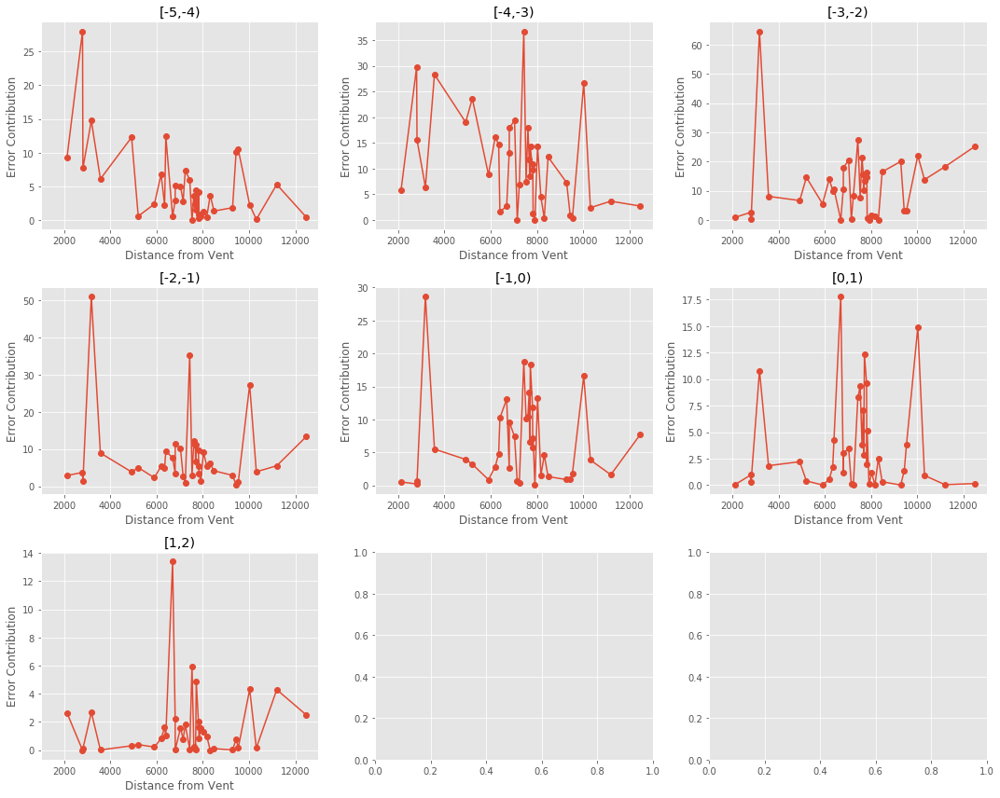

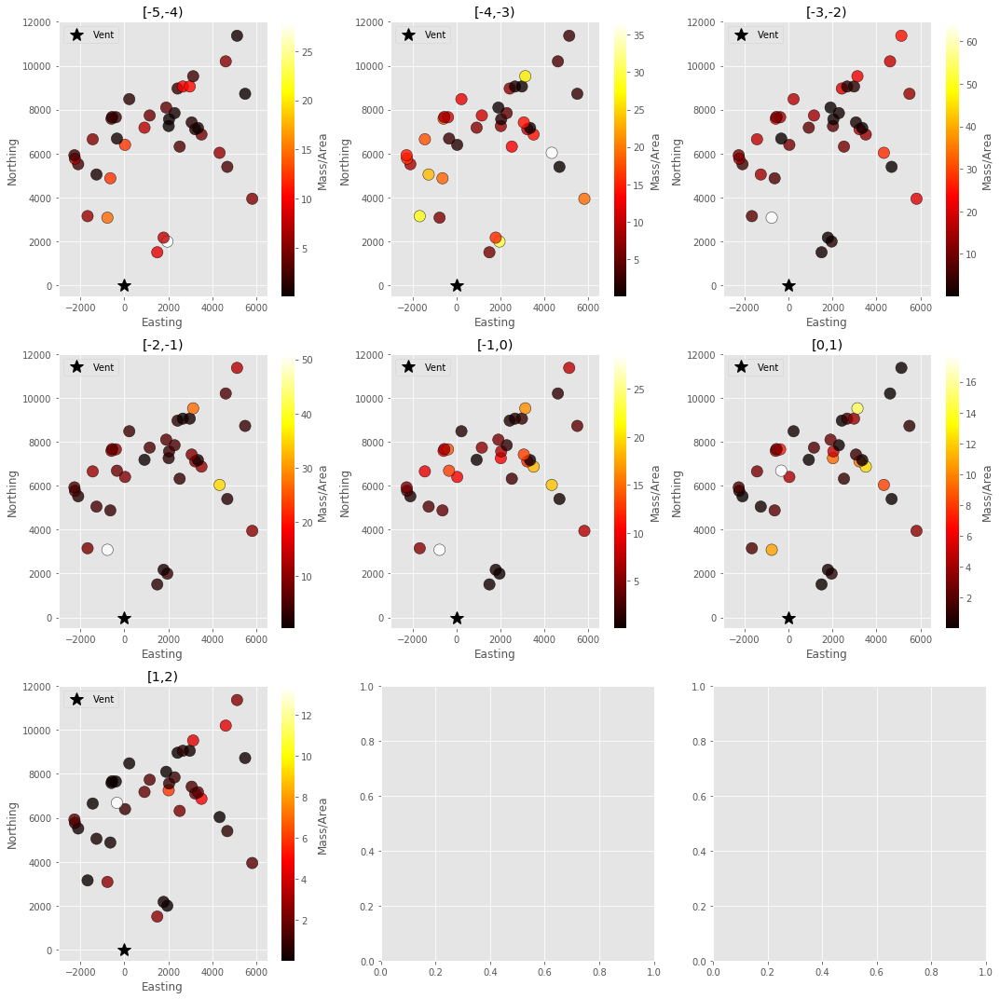

In [50]:


all_point_conts = []
all_phi_conts = []

for j, phi_step in enumerate(prior_phi_steps):
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    misfit, contributions, setup = get_error_contributions(
        observation_phis[j], len(observation_phis[j]), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, [iso_step], 
        params_list[j], phi_masses[j], column_cap = config["THEO_MAX_COL"])
    
    print(phi_step["interval"], misfit)
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    
    all_point_conts += [point_contributions]
    all_phi_conts += [phi_contributions]
print("Full Misfit: ", sum(sum(all_point_conts)))

fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(observation_phis[j]["radius"], all_point_conts[j], "C0o-")
    axs[j].set_xlabel("Distance from Vent")
    axs[j].set_ylabel("Error Contribution")
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlim(1000, 13000)

plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    observation_phis[j]["Contributions"] = all_point_conts[j]
    vis.plot_sample(observation_phis[j], vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = axs[j], cmap="hot")
    axs[j].set_xlim([-3000, 6500])
    axs[j].set_ylim([-500, 12000])
    axs[j].set_title(phi_step["interval"])

plt.tight_layout()
plt.show()

In [46]:
sum(sum(all_point_conts))

1820.2211343056083

[-5,-4) 244.44499987853646
[-4,-3) 470.9430416458195
[-3,-2) 593.0623978419296
[-2,-1) 467.2821114707371
[-1,0) 361.8198542828056
[0,1) 471.73287137914497
[1,2) 555.2302652457236
Full Misfit:  3164.515541744697


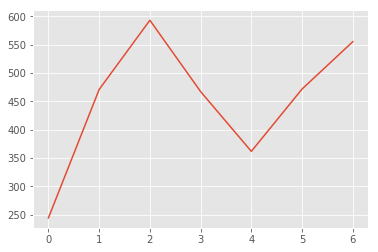

In [47]:
all_point_conts = []
all_phi_conts = []

for j, phi_step in enumerate(prior_phi_steps):
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    misfit, contributions, setup = get_error_contributions(
        observation_phis[j], len(observation_phis[j]), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, [iso_step], 
        full_inversion_priors, phi_masses[j], column_cap = config["THEO_MAX_COL"])
    
    print(phi_step["interval"], misfit)
    
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    all_point_conts += [point_contributions]
    all_phi_conts += [phi_contributions]
    
print("Full Misfit: ", sum(sum(all_point_conts)))
plt.plot(all_phi_conts)
plt.show()


In [48]:
misfit, contributions, setup = get_error_contributions(
        data_set, len(data_set), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, prior_phi_steps, 
        full_inversion_priors, config["ERUPTION_MASS"], column_cap = config["THEO_MAX_COL"])
print("Full misfit", misfit)
point_contributions = np.sum(contributions, 0)
phi_contributions = np.sum(contributions, 1)
print("Point Contributions", point_contributions)
print("Phi Contributions", phi_contributions)

print("Sum of Point Conts:", sum(point_contributions))
print("Sum of Phi Conts:", sum(phi_contributions))

Full misfit 3164.5155417446967
Point Contributions [163.35274457 200.02571389 152.18302505  48.87098672 128.16739944
  94.11453909  93.9503987   40.79673277  70.11854723  66.17287921
  77.55745155 144.15813168  47.50543456  75.51258791  72.3893694
  15.21925872  29.13931857 188.5233464   32.75047217  68.50857429
  60.52900923  39.49367024  60.35896466  49.47002463  39.13022476
  54.01205478  14.81722462  61.15006198  36.20088955  62.66942088
  46.18756974  50.17933628  50.69701863 120.79538777 374.67059546
  45.53763126 117.15914271  72.44040264]
Phi Contributions [244.44499988 470.94304165 593.06239784 467.28211147 361.81985428
 471.73287138 555.23026525]
Sum of Point Conts: 3164.5155417446977
Sum of Phi Conts: 3164.5155417446967


In [222]:
print(sum(phi_masses))
print(config["ERUPTION_MASS"])
print(55000000000.0)

55000000000.0
55000000000.0
55000000000.0
